In [27]:
# This Python 3 environment comes with many helpful analytics libraries installed
# It is defined by the kaggle/python docker image: https://github.com/kaggle/docker-python
# For example, here's several helpful packages to load in 

import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)

# Input data files are available in the "../input/" directory.
# For example, running this (by clicking run or pressing Shift+Enter) will list all files under the input directory

import os
for dirname, _, filenames in os.walk('/kaggle/input'):
    for filename in filenames:
        print(os.path.join(dirname, filename))
#uncomment to delete the patches generated in the output directory

import os
for i in ["FL","MCL","CLL"]:
    for j in os.listdir(os.path.join("/kaggle/working/",i)):
        os.unlink(os.path.join(os.path.join("/kaggle/working/",i),j))
        
#for i in ["CLL","FL","MCL"]:
#    os.mkdir(os.path.join("/kaggle/working",i))
# Any results you write to the current directory are saved as output.

/kaggle/input/lymphoma-classification/lymphoma/CLL/sj-03-4957_009.tif
/kaggle/input/lymphoma-classification/lymphoma/CLL/sj-05-3874-R2_001.tif
/kaggle/input/lymphoma-classification/lymphoma/CLL/sj-05-5269-R10_015.tif
/kaggle/input/lymphoma-classification/lymphoma/CLL/sj-03-5521_010.tif
/kaggle/input/lymphoma-classification/lymphoma/CLL/sj-03-852-R2_012.tif
/kaggle/input/lymphoma-classification/lymphoma/CLL/sj-05-3874-R2_006.tif
/kaggle/input/lymphoma-classification/lymphoma/CLL/sj-03-4957_001.tif
/kaggle/input/lymphoma-classification/lymphoma/CLL/sj-05-3165_005.tif
/kaggle/input/lymphoma-classification/lymphoma/CLL/sj-05-1396-R3_008.tif
/kaggle/input/lymphoma-classification/lymphoma/CLL/sj-05-3874-R2_003.tif
/kaggle/input/lymphoma-classification/lymphoma/CLL/sj-03-852-R2_003.tif
/kaggle/input/lymphoma-classification/lymphoma/CLL/sj-05-3344_003.tif
/kaggle/input/lymphoma-classification/lymphoma/CLL/sj-03-5521_008.tif
/kaggle/input/lymphoma-classification/lymphoma/CLL/sj-03-476_002.tif
/

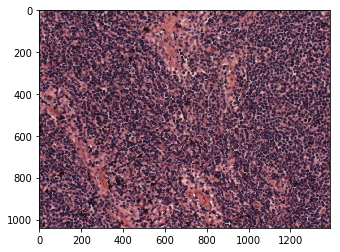

In [28]:
import matplotlib.pyplot as plt
import matplotlib.image as im

img = im.imread("/kaggle/input/lymphoma-classification/lymphoma/MCL/sj-05-4179-R1_009.tif")
plt.imshow(img)

In [29]:
dim = img.shape
dim


(1040, 1388, 3)

In [30]:
#To find the number of images per class



total_number_of_images=0



for i in os.listdir("/kaggle/input/lymphoma-classification/lymphoma/"):
    count   = 0
    for j in os.listdir(os.path.join("/kaggle/input/lymphoma-classification/lymphoma",i)):
        count = count + 1
    print(i,count) 
    total_number_of_images+=count
    
print("total_number_of_images ",total_number_of_images)

CLL 113
FL 139
MCL 122
total_number_of_images  374


In [31]:
from keras.utils import Sequence
import random
import cv2
from PIL import Image
import PIL
class Data_Generator(Sequence):
    
    def __init__(self,train_dir,label_dictionary,total_number_of_images=374,batch_size=32,
                 number_of_class=3,number_of_channels=3,shuffle=True,dim=(1040, 1388),new_dim=(32,32),
                 labels={0:"MCL",1:"CLL",2:"FL"}):
        #print("train_dir")
        self.train_dir=train_dir
        self.label_dictionary=label_dictionary
        self.batch_size=batch_size
        self.number_of_class=number_of_class
        self.number_of_channels=number_of_channels
        self.shuffle=shuffle
        self.total_number_of_images=total_number_of_images
        self.dim=dim
        self.new_dim=new_dim
        self.labels=labels
        self.len = self.__len__()
        if self.shuffle:
            self.shuffle_data()
        
    def  shuffle_data(self):
        random.shuffle(self.train_dir)
      
            
            
    def __len__(self):
        return (self.total_number_of_images//self.batch_size)
    
    def __getitem__(self,index):
        #print("HELLo")
        for i in range(self.batch_size):
            if(index*self.batch_size+i+1==374):
                break
              
            self.x_generator(self.train_dir[index*self.batch_size+i+1],
                             self.label_dictionary[self.train_dir[index*self.batch_size+i+1]])
    
    def x_generator(self,path,label):
        img  = self.read_image(path)
        count   = 0 
        for i in range(32,dim[0],32):
            
            for j in range(32,dim[1],32):
                patch_image = cv2.resize(img[i-32:i,j-32:j],(32,32),interpolation=cv2.INTER_AREA)
                #img = img[i-32:i,j-32:j]
                #print(patch_image.shape)
                count=count+1
                print(os.path.join(os.path.join("/kaggle/working",self.labels[label]),str(count)+path[path.rindex("/")+1:].replace(".tif",".png")))
                cv2.imwrite(os.path.join(os.path.join("/kaggle/working",self.labels[label]),str(count)+path[path.rindex("/")+1:]).replace(".tif",".png"),
                            patch_image)
                #print(os.path.join(os.path.join("/kaggle/working",self.labels[label]),str(count)+path[path.rindex("/")+1:].replace(".tif","png")))
                         
    
        #return x
    
    def read_image(self,path):
        img = im.imread(path)
        return img/255

In [32]:
dictionary_of_label={}
train_dir = []
def get_path_of_images(root_path):
    for dirname in os.listdir(root_path):
        for images in os.listdir(os.path.join(root_path,dirname)):
            train_dir.append(os.path.join(os.path.join(root_path,dirname),images))
            if dirname=="MCL":
                dictionary_of_label[os.path.join(os.path.join(root_path,dirname),images)] = 0
            elif dirname=="CLL":
                dictionary_of_label[os.path.join(os.path.join(root_path,dirname),images)] = 1
                
            else:
                dictionary_of_label[os.path.join(os.path.join(root_path,dirname),images)] = 2
                
            
get_path_of_images('/kaggle/input/lymphoma-classification/lymphoma')            

In [33]:
print(train_dir[0][train_dir[0].rindex("/")+1:])

sj-03-4957_009.tif


In [34]:
train_generator = Data_Generator(train_dir,dictionary_of_label)
for i in range(train_generator.len):
    train_generator.__getitem__(i)
    #train_data.extend(x)
    #validation_data.extend(y)

/kaggle/working/MCL/1sj-05-1374_003.png
/kaggle/working/MCL/2sj-05-1374_003.png
/kaggle/working/MCL/3sj-05-1374_003.png
/kaggle/working/MCL/4sj-05-1374_003.png
/kaggle/working/MCL/5sj-05-1374_003.png
/kaggle/working/MCL/6sj-05-1374_003.png
/kaggle/working/MCL/7sj-05-1374_003.png
/kaggle/working/MCL/8sj-05-1374_003.png
/kaggle/working/MCL/9sj-05-1374_003.png
/kaggle/working/MCL/10sj-05-1374_003.png
/kaggle/working/MCL/11sj-05-1374_003.png
/kaggle/working/MCL/12sj-05-1374_003.png
/kaggle/working/MCL/13sj-05-1374_003.png
/kaggle/working/MCL/14sj-05-1374_003.png
/kaggle/working/MCL/15sj-05-1374_003.png
/kaggle/working/MCL/16sj-05-1374_003.png
/kaggle/working/MCL/17sj-05-1374_003.png
/kaggle/working/MCL/18sj-05-1374_003.png
/kaggle/working/MCL/19sj-05-1374_003.png
/kaggle/working/MCL/20sj-05-1374_003.png
/kaggle/working/MCL/21sj-05-1374_003.png
/kaggle/working/MCL/22sj-05-1374_003.png
/kaggle/working/MCL/23sj-05-1374_003.png
/kaggle/working/MCL/24sj-05-1374_003.png
/kaggle/working/MCL/25sj-

/kaggle/working/MCL/209sj-05-1374_003.png
/kaggle/working/MCL/210sj-05-1374_003.png
/kaggle/working/MCL/211sj-05-1374_003.png
/kaggle/working/MCL/212sj-05-1374_003.png
/kaggle/working/MCL/213sj-05-1374_003.png
/kaggle/working/MCL/214sj-05-1374_003.png
/kaggle/working/MCL/215sj-05-1374_003.png
/kaggle/working/MCL/216sj-05-1374_003.png
/kaggle/working/MCL/217sj-05-1374_003.png
/kaggle/working/MCL/218sj-05-1374_003.png
/kaggle/working/MCL/219sj-05-1374_003.png
/kaggle/working/MCL/220sj-05-1374_003.png
/kaggle/working/MCL/221sj-05-1374_003.png
/kaggle/working/MCL/222sj-05-1374_003.png
/kaggle/working/MCL/223sj-05-1374_003.png
/kaggle/working/MCL/224sj-05-1374_003.png
/kaggle/working/MCL/225sj-05-1374_003.png
/kaggle/working/MCL/226sj-05-1374_003.png
/kaggle/working/MCL/227sj-05-1374_003.png
/kaggle/working/MCL/228sj-05-1374_003.png
/kaggle/working/MCL/229sj-05-1374_003.png
/kaggle/working/MCL/230sj-05-1374_003.png
/kaggle/working/MCL/231sj-05-1374_003.png
/kaggle/working/MCL/232sj-05-1374_

/kaggle/working/MCL/423sj-05-1374_003.png
/kaggle/working/MCL/424sj-05-1374_003.png
/kaggle/working/MCL/425sj-05-1374_003.png
/kaggle/working/MCL/426sj-05-1374_003.png
/kaggle/working/MCL/427sj-05-1374_003.png
/kaggle/working/MCL/428sj-05-1374_003.png
/kaggle/working/MCL/429sj-05-1374_003.png
/kaggle/working/MCL/430sj-05-1374_003.png
/kaggle/working/MCL/431sj-05-1374_003.png
/kaggle/working/MCL/432sj-05-1374_003.png
/kaggle/working/MCL/433sj-05-1374_003.png
/kaggle/working/MCL/434sj-05-1374_003.png
/kaggle/working/MCL/435sj-05-1374_003.png
/kaggle/working/MCL/436sj-05-1374_003.png
/kaggle/working/MCL/437sj-05-1374_003.png
/kaggle/working/MCL/438sj-05-1374_003.png
/kaggle/working/MCL/439sj-05-1374_003.png
/kaggle/working/MCL/440sj-05-1374_003.png
/kaggle/working/MCL/441sj-05-1374_003.png
/kaggle/working/MCL/442sj-05-1374_003.png
/kaggle/working/MCL/443sj-05-1374_003.png
/kaggle/working/MCL/444sj-05-1374_003.png
/kaggle/working/MCL/445sj-05-1374_003.png
/kaggle/working/MCL/446sj-05-1374_

/kaggle/working/MCL/669sj-05-1374_003.png
/kaggle/working/MCL/670sj-05-1374_003.png
/kaggle/working/MCL/671sj-05-1374_003.png
/kaggle/working/MCL/672sj-05-1374_003.png
/kaggle/working/MCL/673sj-05-1374_003.png
/kaggle/working/MCL/674sj-05-1374_003.png
/kaggle/working/MCL/675sj-05-1374_003.png
/kaggle/working/MCL/676sj-05-1374_003.png
/kaggle/working/MCL/677sj-05-1374_003.png
/kaggle/working/MCL/678sj-05-1374_003.png
/kaggle/working/MCL/679sj-05-1374_003.png
/kaggle/working/MCL/680sj-05-1374_003.png
/kaggle/working/MCL/681sj-05-1374_003.png
/kaggle/working/MCL/682sj-05-1374_003.png
/kaggle/working/MCL/683sj-05-1374_003.png
/kaggle/working/MCL/684sj-05-1374_003.png
/kaggle/working/MCL/685sj-05-1374_003.png
/kaggle/working/MCL/686sj-05-1374_003.png
/kaggle/working/MCL/687sj-05-1374_003.png
/kaggle/working/MCL/688sj-05-1374_003.png
/kaggle/working/MCL/689sj-05-1374_003.png
/kaggle/working/MCL/690sj-05-1374_003.png
/kaggle/working/MCL/691sj-05-1374_003.png
/kaggle/working/MCL/692sj-05-1374_

/kaggle/working/MCL/1015sj-05-1374_003.png
/kaggle/working/MCL/1016sj-05-1374_003.png
/kaggle/working/MCL/1017sj-05-1374_003.png
/kaggle/working/MCL/1018sj-05-1374_003.png
/kaggle/working/MCL/1019sj-05-1374_003.png
/kaggle/working/MCL/1020sj-05-1374_003.png
/kaggle/working/MCL/1021sj-05-1374_003.png
/kaggle/working/MCL/1022sj-05-1374_003.png
/kaggle/working/MCL/1023sj-05-1374_003.png
/kaggle/working/MCL/1024sj-05-1374_003.png
/kaggle/working/MCL/1025sj-05-1374_003.png
/kaggle/working/MCL/1026sj-05-1374_003.png
/kaggle/working/MCL/1027sj-05-1374_003.png
/kaggle/working/MCL/1028sj-05-1374_003.png
/kaggle/working/MCL/1029sj-05-1374_003.png
/kaggle/working/MCL/1030sj-05-1374_003.png
/kaggle/working/MCL/1031sj-05-1374_003.png
/kaggle/working/MCL/1032sj-05-1374_003.png
/kaggle/working/MCL/1033sj-05-1374_003.png
/kaggle/working/MCL/1034sj-05-1374_003.png
/kaggle/working/MCL/1035sj-05-1374_003.png
/kaggle/working/MCL/1036sj-05-1374_003.png
/kaggle/working/MCL/1037sj-05-1374_003.png
/kaggle/wor

/kaggle/working/MCL/1253sj-05-1374_003.png
/kaggle/working/MCL/1254sj-05-1374_003.png
/kaggle/working/MCL/1255sj-05-1374_003.png
/kaggle/working/MCL/1256sj-05-1374_003.png
/kaggle/working/MCL/1257sj-05-1374_003.png
/kaggle/working/MCL/1258sj-05-1374_003.png
/kaggle/working/MCL/1259sj-05-1374_003.png
/kaggle/working/MCL/1260sj-05-1374_003.png
/kaggle/working/MCL/1261sj-05-1374_003.png
/kaggle/working/MCL/1262sj-05-1374_003.png
/kaggle/working/MCL/1263sj-05-1374_003.png
/kaggle/working/MCL/1264sj-05-1374_003.png
/kaggle/working/MCL/1265sj-05-1374_003.png
/kaggle/working/MCL/1266sj-05-1374_003.png
/kaggle/working/MCL/1267sj-05-1374_003.png
/kaggle/working/MCL/1268sj-05-1374_003.png
/kaggle/working/MCL/1269sj-05-1374_003.png
/kaggle/working/MCL/1270sj-05-1374_003.png
/kaggle/working/MCL/1271sj-05-1374_003.png
/kaggle/working/MCL/1272sj-05-1374_003.png
/kaggle/working/MCL/1273sj-05-1374_003.png
/kaggle/working/MCL/1274sj-05-1374_003.png
/kaggle/working/MCL/1275sj-05-1374_003.png
/kaggle/wor

/kaggle/working/CLL/185sj-05-3344_007.png
/kaggle/working/CLL/186sj-05-3344_007.png
/kaggle/working/CLL/187sj-05-3344_007.png
/kaggle/working/CLL/188sj-05-3344_007.png
/kaggle/working/CLL/189sj-05-3344_007.png
/kaggle/working/CLL/190sj-05-3344_007.png
/kaggle/working/CLL/191sj-05-3344_007.png
/kaggle/working/CLL/192sj-05-3344_007.png
/kaggle/working/CLL/193sj-05-3344_007.png
/kaggle/working/CLL/194sj-05-3344_007.png
/kaggle/working/CLL/195sj-05-3344_007.png
/kaggle/working/CLL/196sj-05-3344_007.png
/kaggle/working/CLL/197sj-05-3344_007.png
/kaggle/working/CLL/198sj-05-3344_007.png
/kaggle/working/CLL/199sj-05-3344_007.png
/kaggle/working/CLL/200sj-05-3344_007.png
/kaggle/working/CLL/201sj-05-3344_007.png
/kaggle/working/CLL/202sj-05-3344_007.png
/kaggle/working/CLL/203sj-05-3344_007.png
/kaggle/working/CLL/204sj-05-3344_007.png
/kaggle/working/CLL/205sj-05-3344_007.png
/kaggle/working/CLL/206sj-05-3344_007.png
/kaggle/working/CLL/207sj-05-3344_007.png
/kaggle/working/CLL/208sj-05-3344_

/kaggle/working/CLL/425sj-05-3344_007.png
/kaggle/working/CLL/426sj-05-3344_007.png
/kaggle/working/CLL/427sj-05-3344_007.png
/kaggle/working/CLL/428sj-05-3344_007.png
/kaggle/working/CLL/429sj-05-3344_007.png
/kaggle/working/CLL/430sj-05-3344_007.png
/kaggle/working/CLL/431sj-05-3344_007.png
/kaggle/working/CLL/432sj-05-3344_007.png
/kaggle/working/CLL/433sj-05-3344_007.png
/kaggle/working/CLL/434sj-05-3344_007.png
/kaggle/working/CLL/435sj-05-3344_007.png
/kaggle/working/CLL/436sj-05-3344_007.png
/kaggle/working/CLL/437sj-05-3344_007.png
/kaggle/working/CLL/438sj-05-3344_007.png
/kaggle/working/CLL/439sj-05-3344_007.png
/kaggle/working/CLL/440sj-05-3344_007.png
/kaggle/working/CLL/441sj-05-3344_007.png
/kaggle/working/CLL/442sj-05-3344_007.png
/kaggle/working/CLL/443sj-05-3344_007.png
/kaggle/working/CLL/444sj-05-3344_007.png
/kaggle/working/CLL/445sj-05-3344_007.png
/kaggle/working/CLL/446sj-05-3344_007.png
/kaggle/working/CLL/447sj-05-3344_007.png
/kaggle/working/CLL/448sj-05-3344_

/kaggle/working/CLL/667sj-05-3344_007.png
/kaggle/working/CLL/668sj-05-3344_007.png
/kaggle/working/CLL/669sj-05-3344_007.png
/kaggle/working/CLL/670sj-05-3344_007.png
/kaggle/working/CLL/671sj-05-3344_007.png
/kaggle/working/CLL/672sj-05-3344_007.png
/kaggle/working/CLL/673sj-05-3344_007.png
/kaggle/working/CLL/674sj-05-3344_007.png
/kaggle/working/CLL/675sj-05-3344_007.png
/kaggle/working/CLL/676sj-05-3344_007.png
/kaggle/working/CLL/677sj-05-3344_007.png
/kaggle/working/CLL/678sj-05-3344_007.png
/kaggle/working/CLL/679sj-05-3344_007.png
/kaggle/working/CLL/680sj-05-3344_007.png
/kaggle/working/CLL/681sj-05-3344_007.png
/kaggle/working/CLL/682sj-05-3344_007.png
/kaggle/working/CLL/683sj-05-3344_007.png
/kaggle/working/CLL/684sj-05-3344_007.png
/kaggle/working/CLL/685sj-05-3344_007.png
/kaggle/working/CLL/686sj-05-3344_007.png
/kaggle/working/CLL/687sj-05-3344_007.png
/kaggle/working/CLL/688sj-05-3344_007.png
/kaggle/working/CLL/689sj-05-3344_007.png
/kaggle/working/CLL/690sj-05-3344_

/kaggle/working/CLL/864sj-05-3344_007.png
/kaggle/working/CLL/865sj-05-3344_007.png
/kaggle/working/CLL/866sj-05-3344_007.png
/kaggle/working/CLL/867sj-05-3344_007.png
/kaggle/working/CLL/868sj-05-3344_007.png
/kaggle/working/CLL/869sj-05-3344_007.png
/kaggle/working/CLL/870sj-05-3344_007.png
/kaggle/working/CLL/871sj-05-3344_007.png
/kaggle/working/CLL/872sj-05-3344_007.png
/kaggle/working/CLL/873sj-05-3344_007.png
/kaggle/working/CLL/874sj-05-3344_007.png
/kaggle/working/CLL/875sj-05-3344_007.png
/kaggle/working/CLL/876sj-05-3344_007.png
/kaggle/working/CLL/877sj-05-3344_007.png
/kaggle/working/CLL/878sj-05-3344_007.png
/kaggle/working/CLL/879sj-05-3344_007.png
/kaggle/working/CLL/880sj-05-3344_007.png
/kaggle/working/CLL/881sj-05-3344_007.png
/kaggle/working/CLL/882sj-05-3344_007.png
/kaggle/working/CLL/883sj-05-3344_007.png
/kaggle/working/CLL/884sj-05-3344_007.png
/kaggle/working/CLL/885sj-05-3344_007.png
/kaggle/working/CLL/886sj-05-3344_007.png
/kaggle/working/CLL/887sj-05-3344_

/kaggle/working/CLL/1096sj-05-3344_007.png
/kaggle/working/CLL/1097sj-05-3344_007.png
/kaggle/working/CLL/1098sj-05-3344_007.png
/kaggle/working/CLL/1099sj-05-3344_007.png
/kaggle/working/CLL/1100sj-05-3344_007.png
/kaggle/working/CLL/1101sj-05-3344_007.png
/kaggle/working/CLL/1102sj-05-3344_007.png
/kaggle/working/CLL/1103sj-05-3344_007.png
/kaggle/working/CLL/1104sj-05-3344_007.png
/kaggle/working/CLL/1105sj-05-3344_007.png
/kaggle/working/CLL/1106sj-05-3344_007.png
/kaggle/working/CLL/1107sj-05-3344_007.png
/kaggle/working/CLL/1108sj-05-3344_007.png
/kaggle/working/CLL/1109sj-05-3344_007.png
/kaggle/working/CLL/1110sj-05-3344_007.png
/kaggle/working/CLL/1111sj-05-3344_007.png
/kaggle/working/CLL/1112sj-05-3344_007.png
/kaggle/working/CLL/1113sj-05-3344_007.png
/kaggle/working/CLL/1114sj-05-3344_007.png
/kaggle/working/CLL/1115sj-05-3344_007.png
/kaggle/working/CLL/1116sj-05-3344_007.png
/kaggle/working/CLL/1117sj-05-3344_007.png
/kaggle/working/CLL/1118sj-05-3344_007.png
/kaggle/wor

/kaggle/working/CLL/1335sj-05-3344_007.png
/kaggle/working/CLL/1336sj-05-3344_007.png
/kaggle/working/CLL/1337sj-05-3344_007.png
/kaggle/working/CLL/1338sj-05-3344_007.png
/kaggle/working/CLL/1339sj-05-3344_007.png
/kaggle/working/CLL/1340sj-05-3344_007.png
/kaggle/working/CLL/1341sj-05-3344_007.png
/kaggle/working/CLL/1342sj-05-3344_007.png
/kaggle/working/CLL/1343sj-05-3344_007.png
/kaggle/working/CLL/1344sj-05-3344_007.png
/kaggle/working/CLL/1345sj-05-3344_007.png
/kaggle/working/CLL/1346sj-05-3344_007.png
/kaggle/working/CLL/1347sj-05-3344_007.png
/kaggle/working/CLL/1348sj-05-3344_007.png
/kaggle/working/CLL/1349sj-05-3344_007.png
/kaggle/working/CLL/1350sj-05-3344_007.png
/kaggle/working/CLL/1351sj-05-3344_007.png
/kaggle/working/CLL/1352sj-05-3344_007.png
/kaggle/working/CLL/1353sj-05-3344_007.png
/kaggle/working/CLL/1354sj-05-3344_007.png
/kaggle/working/CLL/1355sj-05-3344_007.png
/kaggle/working/CLL/1356sj-05-3344_007.png
/kaggle/working/CLL/1357sj-05-3344_007.png
/kaggle/wor

/kaggle/working/FL/233sj-05-5311-R1_009.png
/kaggle/working/FL/234sj-05-5311-R1_009.png
/kaggle/working/FL/235sj-05-5311-R1_009.png
/kaggle/working/FL/236sj-05-5311-R1_009.png
/kaggle/working/FL/237sj-05-5311-R1_009.png
/kaggle/working/FL/238sj-05-5311-R1_009.png
/kaggle/working/FL/239sj-05-5311-R1_009.png
/kaggle/working/FL/240sj-05-5311-R1_009.png
/kaggle/working/FL/241sj-05-5311-R1_009.png
/kaggle/working/FL/242sj-05-5311-R1_009.png
/kaggle/working/FL/243sj-05-5311-R1_009.png
/kaggle/working/FL/244sj-05-5311-R1_009.png
/kaggle/working/FL/245sj-05-5311-R1_009.png
/kaggle/working/FL/246sj-05-5311-R1_009.png
/kaggle/working/FL/247sj-05-5311-R1_009.png
/kaggle/working/FL/248sj-05-5311-R1_009.png
/kaggle/working/FL/249sj-05-5311-R1_009.png
/kaggle/working/FL/250sj-05-5311-R1_009.png
/kaggle/working/FL/251sj-05-5311-R1_009.png
/kaggle/working/FL/252sj-05-5311-R1_009.png
/kaggle/working/FL/253sj-05-5311-R1_009.png
/kaggle/working/FL/254sj-05-5311-R1_009.png
/kaggle/working/FL/255sj-05-5311

/kaggle/working/FL/936sj-05-5311-R1_009.png
/kaggle/working/FL/937sj-05-5311-R1_009.png
/kaggle/working/FL/938sj-05-5311-R1_009.png
/kaggle/working/FL/939sj-05-5311-R1_009.png
/kaggle/working/FL/940sj-05-5311-R1_009.png
/kaggle/working/FL/941sj-05-5311-R1_009.png
/kaggle/working/FL/942sj-05-5311-R1_009.png
/kaggle/working/FL/943sj-05-5311-R1_009.png
/kaggle/working/FL/944sj-05-5311-R1_009.png
/kaggle/working/FL/945sj-05-5311-R1_009.png
/kaggle/working/FL/946sj-05-5311-R1_009.png
/kaggle/working/FL/947sj-05-5311-R1_009.png
/kaggle/working/FL/948sj-05-5311-R1_009.png
/kaggle/working/FL/949sj-05-5311-R1_009.png
/kaggle/working/FL/950sj-05-5311-R1_009.png
/kaggle/working/FL/951sj-05-5311-R1_009.png
/kaggle/working/FL/952sj-05-5311-R1_009.png
/kaggle/working/FL/953sj-05-5311-R1_009.png
/kaggle/working/FL/954sj-05-5311-R1_009.png
/kaggle/working/FL/955sj-05-5311-R1_009.png
/kaggle/working/FL/956sj-05-5311-R1_009.png
/kaggle/working/FL/957sj-05-5311-R1_009.png
/kaggle/working/FL/958sj-05-5311

/kaggle/working/FL/1sj-05-894-R3_008.png
/kaggle/working/FL/2sj-05-894-R3_008.png
/kaggle/working/FL/3sj-05-894-R3_008.png
/kaggle/working/FL/4sj-05-894-R3_008.png
/kaggle/working/FL/5sj-05-894-R3_008.png
/kaggle/working/FL/6sj-05-894-R3_008.png
/kaggle/working/FL/7sj-05-894-R3_008.png
/kaggle/working/FL/8sj-05-894-R3_008.png
/kaggle/working/FL/9sj-05-894-R3_008.png
/kaggle/working/FL/10sj-05-894-R3_008.png
/kaggle/working/FL/11sj-05-894-R3_008.png
/kaggle/working/FL/12sj-05-894-R3_008.png
/kaggle/working/FL/13sj-05-894-R3_008.png
/kaggle/working/FL/14sj-05-894-R3_008.png
/kaggle/working/FL/15sj-05-894-R3_008.png
/kaggle/working/FL/16sj-05-894-R3_008.png
/kaggle/working/FL/17sj-05-894-R3_008.png
/kaggle/working/FL/18sj-05-894-R3_008.png
/kaggle/working/FL/19sj-05-894-R3_008.png
/kaggle/working/FL/20sj-05-894-R3_008.png
/kaggle/working/FL/21sj-05-894-R3_008.png
/kaggle/working/FL/22sj-05-894-R3_008.png
/kaggle/working/FL/23sj-05-894-R3_008.png
/kaggle/working/FL/24sj-05-894-R3_008.png
/

/kaggle/working/FL/620sj-05-894-R3_008.png
/kaggle/working/FL/621sj-05-894-R3_008.png
/kaggle/working/FL/622sj-05-894-R3_008.png
/kaggle/working/FL/623sj-05-894-R3_008.png
/kaggle/working/FL/624sj-05-894-R3_008.png
/kaggle/working/FL/625sj-05-894-R3_008.png
/kaggle/working/FL/626sj-05-894-R3_008.png
/kaggle/working/FL/627sj-05-894-R3_008.png
/kaggle/working/FL/628sj-05-894-R3_008.png
/kaggle/working/FL/629sj-05-894-R3_008.png
/kaggle/working/FL/630sj-05-894-R3_008.png
/kaggle/working/FL/631sj-05-894-R3_008.png
/kaggle/working/FL/632sj-05-894-R3_008.png
/kaggle/working/FL/633sj-05-894-R3_008.png
/kaggle/working/FL/634sj-05-894-R3_008.png
/kaggle/working/FL/635sj-05-894-R3_008.png
/kaggle/working/FL/636sj-05-894-R3_008.png
/kaggle/working/FL/637sj-05-894-R3_008.png
/kaggle/working/FL/638sj-05-894-R3_008.png
/kaggle/working/FL/639sj-05-894-R3_008.png
/kaggle/working/FL/640sj-05-894-R3_008.png
/kaggle/working/FL/641sj-05-894-R3_008.png
/kaggle/working/FL/642sj-05-894-R3_008.png
/kaggle/wor

/kaggle/working/FL/1274sj-05-894-R3_008.png
/kaggle/working/FL/1275sj-05-894-R3_008.png
/kaggle/working/FL/1276sj-05-894-R3_008.png
/kaggle/working/FL/1277sj-05-894-R3_008.png
/kaggle/working/FL/1278sj-05-894-R3_008.png
/kaggle/working/FL/1279sj-05-894-R3_008.png
/kaggle/working/FL/1280sj-05-894-R3_008.png
/kaggle/working/FL/1281sj-05-894-R3_008.png
/kaggle/working/FL/1282sj-05-894-R3_008.png
/kaggle/working/FL/1283sj-05-894-R3_008.png
/kaggle/working/FL/1284sj-05-894-R3_008.png
/kaggle/working/FL/1285sj-05-894-R3_008.png
/kaggle/working/FL/1286sj-05-894-R3_008.png
/kaggle/working/FL/1287sj-05-894-R3_008.png
/kaggle/working/FL/1288sj-05-894-R3_008.png
/kaggle/working/FL/1289sj-05-894-R3_008.png
/kaggle/working/FL/1290sj-05-894-R3_008.png
/kaggle/working/FL/1291sj-05-894-R3_008.png
/kaggle/working/FL/1292sj-05-894-R3_008.png
/kaggle/working/FL/1293sj-05-894-R3_008.png
/kaggle/working/FL/1294sj-05-894-R3_008.png
/kaggle/working/FL/1295sj-05-894-R3_008.png
/kaggle/working/FL/1296sj-05-894

/kaggle/working/MCL/437sj-05-3362-R2_011.png
/kaggle/working/MCL/438sj-05-3362-R2_011.png
/kaggle/working/MCL/439sj-05-3362-R2_011.png
/kaggle/working/MCL/440sj-05-3362-R2_011.png
/kaggle/working/MCL/441sj-05-3362-R2_011.png
/kaggle/working/MCL/442sj-05-3362-R2_011.png
/kaggle/working/MCL/443sj-05-3362-R2_011.png
/kaggle/working/MCL/444sj-05-3362-R2_011.png
/kaggle/working/MCL/445sj-05-3362-R2_011.png
/kaggle/working/MCL/446sj-05-3362-R2_011.png
/kaggle/working/MCL/447sj-05-3362-R2_011.png
/kaggle/working/MCL/448sj-05-3362-R2_011.png
/kaggle/working/MCL/449sj-05-3362-R2_011.png
/kaggle/working/MCL/450sj-05-3362-R2_011.png
/kaggle/working/MCL/451sj-05-3362-R2_011.png
/kaggle/working/MCL/452sj-05-3362-R2_011.png
/kaggle/working/MCL/453sj-05-3362-R2_011.png
/kaggle/working/MCL/454sj-05-3362-R2_011.png
/kaggle/working/MCL/455sj-05-3362-R2_011.png
/kaggle/working/MCL/456sj-05-3362-R2_011.png
/kaggle/working/MCL/457sj-05-3362-R2_011.png
/kaggle/working/MCL/458sj-05-3362-R2_011.png
/kaggle/wo

/kaggle/working/MCL/980sj-05-3362-R2_011.png
/kaggle/working/MCL/981sj-05-3362-R2_011.png
/kaggle/working/MCL/982sj-05-3362-R2_011.png
/kaggle/working/MCL/983sj-05-3362-R2_011.png
/kaggle/working/MCL/984sj-05-3362-R2_011.png
/kaggle/working/MCL/985sj-05-3362-R2_011.png
/kaggle/working/MCL/986sj-05-3362-R2_011.png
/kaggle/working/MCL/987sj-05-3362-R2_011.png
/kaggle/working/MCL/988sj-05-3362-R2_011.png
/kaggle/working/MCL/989sj-05-3362-R2_011.png
/kaggle/working/MCL/990sj-05-3362-R2_011.png
/kaggle/working/MCL/991sj-05-3362-R2_011.png
/kaggle/working/MCL/992sj-05-3362-R2_011.png
/kaggle/working/MCL/993sj-05-3362-R2_011.png
/kaggle/working/MCL/994sj-05-3362-R2_011.png
/kaggle/working/MCL/995sj-05-3362-R2_011.png
/kaggle/working/MCL/996sj-05-3362-R2_011.png
/kaggle/working/MCL/997sj-05-3362-R2_011.png
/kaggle/working/MCL/998sj-05-3362-R2_011.png
/kaggle/working/MCL/999sj-05-3362-R2_011.png
/kaggle/working/MCL/1000sj-05-3362-R2_011.png
/kaggle/working/MCL/1001sj-05-3362-R2_011.png
/kaggle/

/kaggle/working/CLL/111sj-05-5269-R10_009.png
/kaggle/working/CLL/112sj-05-5269-R10_009.png
/kaggle/working/CLL/113sj-05-5269-R10_009.png
/kaggle/working/CLL/114sj-05-5269-R10_009.png
/kaggle/working/CLL/115sj-05-5269-R10_009.png
/kaggle/working/CLL/116sj-05-5269-R10_009.png
/kaggle/working/CLL/117sj-05-5269-R10_009.png
/kaggle/working/CLL/118sj-05-5269-R10_009.png
/kaggle/working/CLL/119sj-05-5269-R10_009.png
/kaggle/working/CLL/120sj-05-5269-R10_009.png
/kaggle/working/CLL/121sj-05-5269-R10_009.png
/kaggle/working/CLL/122sj-05-5269-R10_009.png
/kaggle/working/CLL/123sj-05-5269-R10_009.png
/kaggle/working/CLL/124sj-05-5269-R10_009.png
/kaggle/working/CLL/125sj-05-5269-R10_009.png
/kaggle/working/CLL/126sj-05-5269-R10_009.png
/kaggle/working/CLL/127sj-05-5269-R10_009.png
/kaggle/working/CLL/128sj-05-5269-R10_009.png
/kaggle/working/CLL/129sj-05-5269-R10_009.png
/kaggle/working/CLL/130sj-05-5269-R10_009.png
/kaggle/working/CLL/131sj-05-5269-R10_009.png
/kaggle/working/CLL/132sj-05-5269-

/kaggle/working/CLL/685sj-05-5269-R10_009.png
/kaggle/working/CLL/686sj-05-5269-R10_009.png
/kaggle/working/CLL/687sj-05-5269-R10_009.png
/kaggle/working/CLL/688sj-05-5269-R10_009.png
/kaggle/working/CLL/689sj-05-5269-R10_009.png
/kaggle/working/CLL/690sj-05-5269-R10_009.png
/kaggle/working/CLL/691sj-05-5269-R10_009.png
/kaggle/working/CLL/692sj-05-5269-R10_009.png
/kaggle/working/CLL/693sj-05-5269-R10_009.png
/kaggle/working/CLL/694sj-05-5269-R10_009.png
/kaggle/working/CLL/695sj-05-5269-R10_009.png
/kaggle/working/CLL/696sj-05-5269-R10_009.png
/kaggle/working/CLL/697sj-05-5269-R10_009.png
/kaggle/working/CLL/698sj-05-5269-R10_009.png
/kaggle/working/CLL/699sj-05-5269-R10_009.png
/kaggle/working/CLL/700sj-05-5269-R10_009.png
/kaggle/working/CLL/701sj-05-5269-R10_009.png
/kaggle/working/CLL/702sj-05-5269-R10_009.png
/kaggle/working/CLL/703sj-05-5269-R10_009.png
/kaggle/working/CLL/704sj-05-5269-R10_009.png
/kaggle/working/CLL/705sj-05-5269-R10_009.png
/kaggle/working/CLL/706sj-05-5269-

/kaggle/working/CLL/1257sj-05-5269-R10_009.png
/kaggle/working/CLL/1258sj-05-5269-R10_009.png
/kaggle/working/CLL/1259sj-05-5269-R10_009.png
/kaggle/working/CLL/1260sj-05-5269-R10_009.png
/kaggle/working/CLL/1261sj-05-5269-R10_009.png
/kaggle/working/CLL/1262sj-05-5269-R10_009.png
/kaggle/working/CLL/1263sj-05-5269-R10_009.png
/kaggle/working/CLL/1264sj-05-5269-R10_009.png
/kaggle/working/CLL/1265sj-05-5269-R10_009.png
/kaggle/working/CLL/1266sj-05-5269-R10_009.png
/kaggle/working/CLL/1267sj-05-5269-R10_009.png
/kaggle/working/CLL/1268sj-05-5269-R10_009.png
/kaggle/working/CLL/1269sj-05-5269-R10_009.png
/kaggle/working/CLL/1270sj-05-5269-R10_009.png
/kaggle/working/CLL/1271sj-05-5269-R10_009.png
/kaggle/working/CLL/1272sj-05-5269-R10_009.png
/kaggle/working/CLL/1273sj-05-5269-R10_009.png
/kaggle/working/CLL/1274sj-05-5269-R10_009.png
/kaggle/working/CLL/1275sj-05-5269-R10_009.png
/kaggle/working/CLL/1276sj-05-5269-R10_009.png
/kaggle/working/CLL/1277sj-05-5269-R10_009.png
/kaggle/worki

/kaggle/working/FL/446sj-05-5829_006.png
/kaggle/working/FL/447sj-05-5829_006.png
/kaggle/working/FL/448sj-05-5829_006.png
/kaggle/working/FL/449sj-05-5829_006.png
/kaggle/working/FL/450sj-05-5829_006.png
/kaggle/working/FL/451sj-05-5829_006.png
/kaggle/working/FL/452sj-05-5829_006.png
/kaggle/working/FL/453sj-05-5829_006.png
/kaggle/working/FL/454sj-05-5829_006.png
/kaggle/working/FL/455sj-05-5829_006.png
/kaggle/working/FL/456sj-05-5829_006.png
/kaggle/working/FL/457sj-05-5829_006.png
/kaggle/working/FL/458sj-05-5829_006.png
/kaggle/working/FL/459sj-05-5829_006.png
/kaggle/working/FL/460sj-05-5829_006.png
/kaggle/working/FL/461sj-05-5829_006.png
/kaggle/working/FL/462sj-05-5829_006.png
/kaggle/working/FL/463sj-05-5829_006.png
/kaggle/working/FL/464sj-05-5829_006.png
/kaggle/working/FL/465sj-05-5829_006.png
/kaggle/working/FL/466sj-05-5829_006.png
/kaggle/working/FL/467sj-05-5829_006.png
/kaggle/working/FL/468sj-05-5829_006.png
/kaggle/working/FL/469sj-05-5829_006.png
/kaggle/working/

/kaggle/working/FL/1086sj-05-5829_006.png
/kaggle/working/FL/1087sj-05-5829_006.png
/kaggle/working/FL/1088sj-05-5829_006.png
/kaggle/working/FL/1089sj-05-5829_006.png
/kaggle/working/FL/1090sj-05-5829_006.png
/kaggle/working/FL/1091sj-05-5829_006.png
/kaggle/working/FL/1092sj-05-5829_006.png
/kaggle/working/FL/1093sj-05-5829_006.png
/kaggle/working/FL/1094sj-05-5829_006.png
/kaggle/working/FL/1095sj-05-5829_006.png
/kaggle/working/FL/1096sj-05-5829_006.png
/kaggle/working/FL/1097sj-05-5829_006.png
/kaggle/working/FL/1098sj-05-5829_006.png
/kaggle/working/FL/1099sj-05-5829_006.png
/kaggle/working/FL/1100sj-05-5829_006.png
/kaggle/working/FL/1101sj-05-5829_006.png
/kaggle/working/FL/1102sj-05-5829_006.png
/kaggle/working/FL/1103sj-05-5829_006.png
/kaggle/working/FL/1104sj-05-5829_006.png
/kaggle/working/FL/1105sj-05-5829_006.png
/kaggle/working/FL/1106sj-05-5829_006.png
/kaggle/working/FL/1107sj-05-5829_006.png
/kaggle/working/FL/1108sj-05-5829_006.png
/kaggle/working/FL/1109sj-05-5829_

/kaggle/working/FL/165sj-05-894-R3_003.png
/kaggle/working/FL/166sj-05-894-R3_003.png
/kaggle/working/FL/167sj-05-894-R3_003.png
/kaggle/working/FL/168sj-05-894-R3_003.png
/kaggle/working/FL/169sj-05-894-R3_003.png
/kaggle/working/FL/170sj-05-894-R3_003.png
/kaggle/working/FL/171sj-05-894-R3_003.png
/kaggle/working/FL/172sj-05-894-R3_003.png
/kaggle/working/FL/173sj-05-894-R3_003.png
/kaggle/working/FL/174sj-05-894-R3_003.png
/kaggle/working/FL/175sj-05-894-R3_003.png
/kaggle/working/FL/176sj-05-894-R3_003.png
/kaggle/working/FL/177sj-05-894-R3_003.png
/kaggle/working/FL/178sj-05-894-R3_003.png
/kaggle/working/FL/179sj-05-894-R3_003.png
/kaggle/working/FL/180sj-05-894-R3_003.png
/kaggle/working/FL/181sj-05-894-R3_003.png
/kaggle/working/FL/182sj-05-894-R3_003.png
/kaggle/working/FL/183sj-05-894-R3_003.png
/kaggle/working/FL/184sj-05-894-R3_003.png
/kaggle/working/FL/185sj-05-894-R3_003.png
/kaggle/working/FL/186sj-05-894-R3_003.png
/kaggle/working/FL/187sj-05-894-R3_003.png
/kaggle/wor

/kaggle/working/FL/782sj-05-894-R3_003.png
/kaggle/working/FL/783sj-05-894-R3_003.png
/kaggle/working/FL/784sj-05-894-R3_003.png
/kaggle/working/FL/785sj-05-894-R3_003.png
/kaggle/working/FL/786sj-05-894-R3_003.png
/kaggle/working/FL/787sj-05-894-R3_003.png
/kaggle/working/FL/788sj-05-894-R3_003.png
/kaggle/working/FL/789sj-05-894-R3_003.png
/kaggle/working/FL/790sj-05-894-R3_003.png
/kaggle/working/FL/791sj-05-894-R3_003.png
/kaggle/working/FL/792sj-05-894-R3_003.png
/kaggle/working/FL/793sj-05-894-R3_003.png
/kaggle/working/FL/794sj-05-894-R3_003.png
/kaggle/working/FL/795sj-05-894-R3_003.png
/kaggle/working/FL/796sj-05-894-R3_003.png
/kaggle/working/FL/797sj-05-894-R3_003.png
/kaggle/working/FL/798sj-05-894-R3_003.png
/kaggle/working/FL/799sj-05-894-R3_003.png
/kaggle/working/FL/800sj-05-894-R3_003.png
/kaggle/working/FL/801sj-05-894-R3_003.png
/kaggle/working/FL/802sj-05-894-R3_003.png
/kaggle/working/FL/803sj-05-894-R3_003.png
/kaggle/working/FL/804sj-05-894-R3_003.png
/kaggle/wor

/kaggle/working/MCL/1sj-04-6010-R3_004.png
/kaggle/working/MCL/2sj-04-6010-R3_004.png
/kaggle/working/MCL/3sj-04-6010-R3_004.png
/kaggle/working/MCL/4sj-04-6010-R3_004.png
/kaggle/working/MCL/5sj-04-6010-R3_004.png
/kaggle/working/MCL/6sj-04-6010-R3_004.png
/kaggle/working/MCL/7sj-04-6010-R3_004.png
/kaggle/working/MCL/8sj-04-6010-R3_004.png
/kaggle/working/MCL/9sj-04-6010-R3_004.png
/kaggle/working/MCL/10sj-04-6010-R3_004.png
/kaggle/working/MCL/11sj-04-6010-R3_004.png
/kaggle/working/MCL/12sj-04-6010-R3_004.png
/kaggle/working/MCL/13sj-04-6010-R3_004.png
/kaggle/working/MCL/14sj-04-6010-R3_004.png
/kaggle/working/MCL/15sj-04-6010-R3_004.png
/kaggle/working/MCL/16sj-04-6010-R3_004.png
/kaggle/working/MCL/17sj-04-6010-R3_004.png
/kaggle/working/MCL/18sj-04-6010-R3_004.png
/kaggle/working/MCL/19sj-04-6010-R3_004.png
/kaggle/working/MCL/20sj-04-6010-R3_004.png
/kaggle/working/MCL/21sj-04-6010-R3_004.png
/kaggle/working/MCL/22sj-04-6010-R3_004.png
/kaggle/working/MCL/23sj-04-6010-R3_004.p

/kaggle/working/MCL/603sj-04-6010-R3_004.png
/kaggle/working/MCL/604sj-04-6010-R3_004.png
/kaggle/working/MCL/605sj-04-6010-R3_004.png
/kaggle/working/MCL/606sj-04-6010-R3_004.png
/kaggle/working/MCL/607sj-04-6010-R3_004.png
/kaggle/working/MCL/608sj-04-6010-R3_004.png
/kaggle/working/MCL/609sj-04-6010-R3_004.png
/kaggle/working/MCL/610sj-04-6010-R3_004.png
/kaggle/working/MCL/611sj-04-6010-R3_004.png
/kaggle/working/MCL/612sj-04-6010-R3_004.png
/kaggle/working/MCL/613sj-04-6010-R3_004.png
/kaggle/working/MCL/614sj-04-6010-R3_004.png
/kaggle/working/MCL/615sj-04-6010-R3_004.png
/kaggle/working/MCL/616sj-04-6010-R3_004.png
/kaggle/working/MCL/617sj-04-6010-R3_004.png
/kaggle/working/MCL/618sj-04-6010-R3_004.png
/kaggle/working/MCL/619sj-04-6010-R3_004.png
/kaggle/working/MCL/620sj-04-6010-R3_004.png
/kaggle/working/MCL/621sj-04-6010-R3_004.png
/kaggle/working/MCL/622sj-04-6010-R3_004.png
/kaggle/working/MCL/623sj-04-6010-R3_004.png
/kaggle/working/MCL/624sj-04-6010-R3_004.png
/kaggle/wo

/kaggle/working/MCL/1160sj-04-6010-R3_004.png
/kaggle/working/MCL/1161sj-04-6010-R3_004.png
/kaggle/working/MCL/1162sj-04-6010-R3_004.png
/kaggle/working/MCL/1163sj-04-6010-R3_004.png
/kaggle/working/MCL/1164sj-04-6010-R3_004.png
/kaggle/working/MCL/1165sj-04-6010-R3_004.png
/kaggle/working/MCL/1166sj-04-6010-R3_004.png
/kaggle/working/MCL/1167sj-04-6010-R3_004.png
/kaggle/working/MCL/1168sj-04-6010-R3_004.png
/kaggle/working/MCL/1169sj-04-6010-R3_004.png
/kaggle/working/MCL/1170sj-04-6010-R3_004.png
/kaggle/working/MCL/1171sj-04-6010-R3_004.png
/kaggle/working/MCL/1172sj-04-6010-R3_004.png
/kaggle/working/MCL/1173sj-04-6010-R3_004.png
/kaggle/working/MCL/1174sj-04-6010-R3_004.png
/kaggle/working/MCL/1175sj-04-6010-R3_004.png
/kaggle/working/MCL/1176sj-04-6010-R3_004.png
/kaggle/working/MCL/1177sj-04-6010-R3_004.png
/kaggle/working/MCL/1178sj-04-6010-R3_004.png
/kaggle/working/MCL/1179sj-04-6010-R3_004.png
/kaggle/working/MCL/1180sj-04-6010-R3_004.png
/kaggle/working/MCL/1181sj-04-6010

/kaggle/working/FL/375sj-05-1467-R1_011.png
/kaggle/working/FL/376sj-05-1467-R1_011.png
/kaggle/working/FL/377sj-05-1467-R1_011.png
/kaggle/working/FL/378sj-05-1467-R1_011.png
/kaggle/working/FL/379sj-05-1467-R1_011.png
/kaggle/working/FL/380sj-05-1467-R1_011.png
/kaggle/working/FL/381sj-05-1467-R1_011.png
/kaggle/working/FL/382sj-05-1467-R1_011.png
/kaggle/working/FL/383sj-05-1467-R1_011.png
/kaggle/working/FL/384sj-05-1467-R1_011.png
/kaggle/working/FL/385sj-05-1467-R1_011.png
/kaggle/working/FL/386sj-05-1467-R1_011.png
/kaggle/working/FL/387sj-05-1467-R1_011.png
/kaggle/working/FL/388sj-05-1467-R1_011.png
/kaggle/working/FL/389sj-05-1467-R1_011.png
/kaggle/working/FL/390sj-05-1467-R1_011.png
/kaggle/working/FL/391sj-05-1467-R1_011.png
/kaggle/working/FL/392sj-05-1467-R1_011.png
/kaggle/working/FL/393sj-05-1467-R1_011.png
/kaggle/working/FL/394sj-05-1467-R1_011.png
/kaggle/working/FL/395sj-05-1467-R1_011.png
/kaggle/working/FL/396sj-05-1467-R1_011.png
/kaggle/working/FL/397sj-05-1467

/kaggle/working/FL/993sj-05-1467-R1_011.png
/kaggle/working/FL/994sj-05-1467-R1_011.png
/kaggle/working/FL/995sj-05-1467-R1_011.png
/kaggle/working/FL/996sj-05-1467-R1_011.png
/kaggle/working/FL/997sj-05-1467-R1_011.png
/kaggle/working/FL/998sj-05-1467-R1_011.png
/kaggle/working/FL/999sj-05-1467-R1_011.png
/kaggle/working/FL/1000sj-05-1467-R1_011.png
/kaggle/working/FL/1001sj-05-1467-R1_011.png
/kaggle/working/FL/1002sj-05-1467-R1_011.png
/kaggle/working/FL/1003sj-05-1467-R1_011.png
/kaggle/working/FL/1004sj-05-1467-R1_011.png
/kaggle/working/FL/1005sj-05-1467-R1_011.png
/kaggle/working/FL/1006sj-05-1467-R1_011.png
/kaggle/working/FL/1007sj-05-1467-R1_011.png
/kaggle/working/FL/1008sj-05-1467-R1_011.png
/kaggle/working/FL/1009sj-05-1467-R1_011.png
/kaggle/working/FL/1010sj-05-1467-R1_011.png
/kaggle/working/FL/1011sj-05-1467-R1_011.png
/kaggle/working/FL/1012sj-05-1467-R1_011.png
/kaggle/working/FL/1013sj-05-1467-R1_011.png
/kaggle/working/FL/1014sj-05-1467-R1_011.png
/kaggle/working/F

/kaggle/working/MCL/142sj-05-768_001.png
/kaggle/working/MCL/143sj-05-768_001.png
/kaggle/working/MCL/144sj-05-768_001.png
/kaggle/working/MCL/145sj-05-768_001.png
/kaggle/working/MCL/146sj-05-768_001.png
/kaggle/working/MCL/147sj-05-768_001.png
/kaggle/working/MCL/148sj-05-768_001.png
/kaggle/working/MCL/149sj-05-768_001.png
/kaggle/working/MCL/150sj-05-768_001.png
/kaggle/working/MCL/151sj-05-768_001.png
/kaggle/working/MCL/152sj-05-768_001.png
/kaggle/working/MCL/153sj-05-768_001.png
/kaggle/working/MCL/154sj-05-768_001.png
/kaggle/working/MCL/155sj-05-768_001.png
/kaggle/working/MCL/156sj-05-768_001.png
/kaggle/working/MCL/157sj-05-768_001.png
/kaggle/working/MCL/158sj-05-768_001.png
/kaggle/working/MCL/159sj-05-768_001.png
/kaggle/working/MCL/160sj-05-768_001.png
/kaggle/working/MCL/161sj-05-768_001.png
/kaggle/working/MCL/162sj-05-768_001.png
/kaggle/working/MCL/163sj-05-768_001.png
/kaggle/working/MCL/164sj-05-768_001.png
/kaggle/working/MCL/165sj-05-768_001.png
/kaggle/working/

/kaggle/working/MCL/713sj-05-768_001.png
/kaggle/working/MCL/714sj-05-768_001.png
/kaggle/working/MCL/715sj-05-768_001.png
/kaggle/working/MCL/716sj-05-768_001.png
/kaggle/working/MCL/717sj-05-768_001.png
/kaggle/working/MCL/718sj-05-768_001.png
/kaggle/working/MCL/719sj-05-768_001.png
/kaggle/working/MCL/720sj-05-768_001.png
/kaggle/working/MCL/721sj-05-768_001.png
/kaggle/working/MCL/722sj-05-768_001.png
/kaggle/working/MCL/723sj-05-768_001.png
/kaggle/working/MCL/724sj-05-768_001.png
/kaggle/working/MCL/725sj-05-768_001.png
/kaggle/working/MCL/726sj-05-768_001.png
/kaggle/working/MCL/727sj-05-768_001.png
/kaggle/working/MCL/728sj-05-768_001.png
/kaggle/working/MCL/729sj-05-768_001.png
/kaggle/working/MCL/730sj-05-768_001.png
/kaggle/working/MCL/731sj-05-768_001.png
/kaggle/working/MCL/732sj-05-768_001.png
/kaggle/working/MCL/733sj-05-768_001.png
/kaggle/working/MCL/734sj-05-768_001.png
/kaggle/working/MCL/735sj-05-768_001.png
/kaggle/working/MCL/736sj-05-768_001.png
/kaggle/working/

/kaggle/working/MCL/1263sj-05-768_001.png
/kaggle/working/MCL/1264sj-05-768_001.png
/kaggle/working/MCL/1265sj-05-768_001.png
/kaggle/working/MCL/1266sj-05-768_001.png
/kaggle/working/MCL/1267sj-05-768_001.png
/kaggle/working/MCL/1268sj-05-768_001.png
/kaggle/working/MCL/1269sj-05-768_001.png
/kaggle/working/MCL/1270sj-05-768_001.png
/kaggle/working/MCL/1271sj-05-768_001.png
/kaggle/working/MCL/1272sj-05-768_001.png
/kaggle/working/MCL/1273sj-05-768_001.png
/kaggle/working/MCL/1274sj-05-768_001.png
/kaggle/working/MCL/1275sj-05-768_001.png
/kaggle/working/MCL/1276sj-05-768_001.png
/kaggle/working/MCL/1277sj-05-768_001.png
/kaggle/working/MCL/1278sj-05-768_001.png
/kaggle/working/MCL/1279sj-05-768_001.png
/kaggle/working/MCL/1280sj-05-768_001.png
/kaggle/working/MCL/1281sj-05-768_001.png
/kaggle/working/MCL/1282sj-05-768_001.png
/kaggle/working/MCL/1283sj-05-768_001.png
/kaggle/working/MCL/1284sj-05-768_001.png
/kaggle/working/MCL/1285sj-05-768_001.png
/kaggle/working/MCL/1286sj-05-768_

/kaggle/working/FL/443sj-05-1467-R1_003.png
/kaggle/working/FL/444sj-05-1467-R1_003.png
/kaggle/working/FL/445sj-05-1467-R1_003.png
/kaggle/working/FL/446sj-05-1467-R1_003.png
/kaggle/working/FL/447sj-05-1467-R1_003.png
/kaggle/working/FL/448sj-05-1467-R1_003.png
/kaggle/working/FL/449sj-05-1467-R1_003.png
/kaggle/working/FL/450sj-05-1467-R1_003.png
/kaggle/working/FL/451sj-05-1467-R1_003.png
/kaggle/working/FL/452sj-05-1467-R1_003.png
/kaggle/working/FL/453sj-05-1467-R1_003.png
/kaggle/working/FL/454sj-05-1467-R1_003.png
/kaggle/working/FL/455sj-05-1467-R1_003.png
/kaggle/working/FL/456sj-05-1467-R1_003.png
/kaggle/working/FL/457sj-05-1467-R1_003.png
/kaggle/working/FL/458sj-05-1467-R1_003.png
/kaggle/working/FL/459sj-05-1467-R1_003.png
/kaggle/working/FL/460sj-05-1467-R1_003.png
/kaggle/working/FL/461sj-05-1467-R1_003.png
/kaggle/working/FL/462sj-05-1467-R1_003.png
/kaggle/working/FL/463sj-05-1467-R1_003.png
/kaggle/working/FL/464sj-05-1467-R1_003.png
/kaggle/working/FL/465sj-05-1467

/kaggle/working/FL/1105sj-05-1467-R1_003.png
/kaggle/working/FL/1106sj-05-1467-R1_003.png
/kaggle/working/FL/1107sj-05-1467-R1_003.png
/kaggle/working/FL/1108sj-05-1467-R1_003.png
/kaggle/working/FL/1109sj-05-1467-R1_003.png
/kaggle/working/FL/1110sj-05-1467-R1_003.png
/kaggle/working/FL/1111sj-05-1467-R1_003.png
/kaggle/working/FL/1112sj-05-1467-R1_003.png
/kaggle/working/FL/1113sj-05-1467-R1_003.png
/kaggle/working/FL/1114sj-05-1467-R1_003.png
/kaggle/working/FL/1115sj-05-1467-R1_003.png
/kaggle/working/FL/1116sj-05-1467-R1_003.png
/kaggle/working/FL/1117sj-05-1467-R1_003.png
/kaggle/working/FL/1118sj-05-1467-R1_003.png
/kaggle/working/FL/1119sj-05-1467-R1_003.png
/kaggle/working/FL/1120sj-05-1467-R1_003.png
/kaggle/working/FL/1121sj-05-1467-R1_003.png
/kaggle/working/FL/1122sj-05-1467-R1_003.png
/kaggle/working/FL/1123sj-05-1467-R1_003.png
/kaggle/working/FL/1124sj-05-1467-R1_003.png
/kaggle/working/FL/1125sj-05-1467-R1_003.png
/kaggle/working/FL/1126sj-05-1467-R1_003.png
/kaggle/wo

/kaggle/working/MCL/179sj-05-901-R1_005.png
/kaggle/working/MCL/180sj-05-901-R1_005.png
/kaggle/working/MCL/181sj-05-901-R1_005.png
/kaggle/working/MCL/182sj-05-901-R1_005.png
/kaggle/working/MCL/183sj-05-901-R1_005.png
/kaggle/working/MCL/184sj-05-901-R1_005.png
/kaggle/working/MCL/185sj-05-901-R1_005.png
/kaggle/working/MCL/186sj-05-901-R1_005.png
/kaggle/working/MCL/187sj-05-901-R1_005.png
/kaggle/working/MCL/188sj-05-901-R1_005.png
/kaggle/working/MCL/189sj-05-901-R1_005.png
/kaggle/working/MCL/190sj-05-901-R1_005.png
/kaggle/working/MCL/191sj-05-901-R1_005.png
/kaggle/working/MCL/192sj-05-901-R1_005.png
/kaggle/working/MCL/193sj-05-901-R1_005.png
/kaggle/working/MCL/194sj-05-901-R1_005.png
/kaggle/working/MCL/195sj-05-901-R1_005.png
/kaggle/working/MCL/196sj-05-901-R1_005.png
/kaggle/working/MCL/197sj-05-901-R1_005.png
/kaggle/working/MCL/198sj-05-901-R1_005.png
/kaggle/working/MCL/199sj-05-901-R1_005.png
/kaggle/working/MCL/200sj-05-901-R1_005.png
/kaggle/working/MCL/201sj-05-901

/kaggle/working/MCL/796sj-05-901-R1_005.png
/kaggle/working/MCL/797sj-05-901-R1_005.png
/kaggle/working/MCL/798sj-05-901-R1_005.png
/kaggle/working/MCL/799sj-05-901-R1_005.png
/kaggle/working/MCL/800sj-05-901-R1_005.png
/kaggle/working/MCL/801sj-05-901-R1_005.png
/kaggle/working/MCL/802sj-05-901-R1_005.png
/kaggle/working/MCL/803sj-05-901-R1_005.png
/kaggle/working/MCL/804sj-05-901-R1_005.png
/kaggle/working/MCL/805sj-05-901-R1_005.png
/kaggle/working/MCL/806sj-05-901-R1_005.png
/kaggle/working/MCL/807sj-05-901-R1_005.png
/kaggle/working/MCL/808sj-05-901-R1_005.png
/kaggle/working/MCL/809sj-05-901-R1_005.png
/kaggle/working/MCL/810sj-05-901-R1_005.png
/kaggle/working/MCL/811sj-05-901-R1_005.png
/kaggle/working/MCL/812sj-05-901-R1_005.png
/kaggle/working/MCL/813sj-05-901-R1_005.png
/kaggle/working/MCL/814sj-05-901-R1_005.png
/kaggle/working/MCL/815sj-05-901-R1_005.png
/kaggle/working/MCL/816sj-05-901-R1_005.png
/kaggle/working/MCL/817sj-05-901-R1_005.png
/kaggle/working/MCL/818sj-05-901

/kaggle/working/CLL/1sj-05-5269-R10_003.png
/kaggle/working/CLL/2sj-05-5269-R10_003.png
/kaggle/working/CLL/3sj-05-5269-R10_003.png
/kaggle/working/CLL/4sj-05-5269-R10_003.png
/kaggle/working/CLL/5sj-05-5269-R10_003.png
/kaggle/working/CLL/6sj-05-5269-R10_003.png
/kaggle/working/CLL/7sj-05-5269-R10_003.png
/kaggle/working/CLL/8sj-05-5269-R10_003.png
/kaggle/working/CLL/9sj-05-5269-R10_003.png
/kaggle/working/CLL/10sj-05-5269-R10_003.png
/kaggle/working/CLL/11sj-05-5269-R10_003.png
/kaggle/working/CLL/12sj-05-5269-R10_003.png
/kaggle/working/CLL/13sj-05-5269-R10_003.png
/kaggle/working/CLL/14sj-05-5269-R10_003.png
/kaggle/working/CLL/15sj-05-5269-R10_003.png
/kaggle/working/CLL/16sj-05-5269-R10_003.png
/kaggle/working/CLL/17sj-05-5269-R10_003.png
/kaggle/working/CLL/18sj-05-5269-R10_003.png
/kaggle/working/CLL/19sj-05-5269-R10_003.png
/kaggle/working/CLL/20sj-05-5269-R10_003.png
/kaggle/working/CLL/21sj-05-5269-R10_003.png
/kaggle/working/CLL/22sj-05-5269-R10_003.png
/kaggle/working/CLL

/kaggle/working/CLL/720sj-05-5269-R10_003.png
/kaggle/working/CLL/721sj-05-5269-R10_003.png
/kaggle/working/CLL/722sj-05-5269-R10_003.png
/kaggle/working/CLL/723sj-05-5269-R10_003.png
/kaggle/working/CLL/724sj-05-5269-R10_003.png
/kaggle/working/CLL/725sj-05-5269-R10_003.png
/kaggle/working/CLL/726sj-05-5269-R10_003.png
/kaggle/working/CLL/727sj-05-5269-R10_003.png
/kaggle/working/CLL/728sj-05-5269-R10_003.png
/kaggle/working/CLL/729sj-05-5269-R10_003.png
/kaggle/working/CLL/730sj-05-5269-R10_003.png
/kaggle/working/CLL/731sj-05-5269-R10_003.png
/kaggle/working/CLL/732sj-05-5269-R10_003.png
/kaggle/working/CLL/733sj-05-5269-R10_003.png
/kaggle/working/CLL/734sj-05-5269-R10_003.png
/kaggle/working/CLL/735sj-05-5269-R10_003.png
/kaggle/working/CLL/736sj-05-5269-R10_003.png
/kaggle/working/CLL/737sj-05-5269-R10_003.png
/kaggle/working/CLL/738sj-05-5269-R10_003.png
/kaggle/working/CLL/739sj-05-5269-R10_003.png
/kaggle/working/CLL/740sj-05-5269-R10_003.png
/kaggle/working/CLL/741sj-05-5269-

/kaggle/working/FL/1sj-05-1881-R1_015.png
/kaggle/working/FL/2sj-05-1881-R1_015.png
/kaggle/working/FL/3sj-05-1881-R1_015.png
/kaggle/working/FL/4sj-05-1881-R1_015.png
/kaggle/working/FL/5sj-05-1881-R1_015.png
/kaggle/working/FL/6sj-05-1881-R1_015.png
/kaggle/working/FL/7sj-05-1881-R1_015.png
/kaggle/working/FL/8sj-05-1881-R1_015.png
/kaggle/working/FL/9sj-05-1881-R1_015.png
/kaggle/working/FL/10sj-05-1881-R1_015.png
/kaggle/working/FL/11sj-05-1881-R1_015.png
/kaggle/working/FL/12sj-05-1881-R1_015.png
/kaggle/working/FL/13sj-05-1881-R1_015.png
/kaggle/working/FL/14sj-05-1881-R1_015.png
/kaggle/working/FL/15sj-05-1881-R1_015.png
/kaggle/working/FL/16sj-05-1881-R1_015.png
/kaggle/working/FL/17sj-05-1881-R1_015.png
/kaggle/working/FL/18sj-05-1881-R1_015.png
/kaggle/working/FL/19sj-05-1881-R1_015.png
/kaggle/working/FL/20sj-05-1881-R1_015.png
/kaggle/working/FL/21sj-05-1881-R1_015.png
/kaggle/working/FL/22sj-05-1881-R1_015.png
/kaggle/working/FL/23sj-05-1881-R1_015.png
/kaggle/working/FL/2

/kaggle/working/FL/694sj-05-1881-R1_015.png
/kaggle/working/FL/695sj-05-1881-R1_015.png
/kaggle/working/FL/696sj-05-1881-R1_015.png
/kaggle/working/FL/697sj-05-1881-R1_015.png
/kaggle/working/FL/698sj-05-1881-R1_015.png
/kaggle/working/FL/699sj-05-1881-R1_015.png
/kaggle/working/FL/700sj-05-1881-R1_015.png
/kaggle/working/FL/701sj-05-1881-R1_015.png
/kaggle/working/FL/702sj-05-1881-R1_015.png
/kaggle/working/FL/703sj-05-1881-R1_015.png
/kaggle/working/FL/704sj-05-1881-R1_015.png
/kaggle/working/FL/705sj-05-1881-R1_015.png
/kaggle/working/FL/706sj-05-1881-R1_015.png
/kaggle/working/FL/707sj-05-1881-R1_015.png
/kaggle/working/FL/708sj-05-1881-R1_015.png
/kaggle/working/FL/709sj-05-1881-R1_015.png
/kaggle/working/FL/710sj-05-1881-R1_015.png
/kaggle/working/FL/711sj-05-1881-R1_015.png
/kaggle/working/FL/712sj-05-1881-R1_015.png
/kaggle/working/FL/713sj-05-1881-R1_015.png
/kaggle/working/FL/714sj-05-1881-R1_015.png
/kaggle/working/FL/715sj-05-1881-R1_015.png
/kaggle/working/FL/716sj-05-1881

/kaggle/working/FL/1318sj-05-1881-R1_015.png
/kaggle/working/FL/1319sj-05-1881-R1_015.png
/kaggle/working/FL/1320sj-05-1881-R1_015.png
/kaggle/working/FL/1321sj-05-1881-R1_015.png
/kaggle/working/FL/1322sj-05-1881-R1_015.png
/kaggle/working/FL/1323sj-05-1881-R1_015.png
/kaggle/working/FL/1324sj-05-1881-R1_015.png
/kaggle/working/FL/1325sj-05-1881-R1_015.png
/kaggle/working/FL/1326sj-05-1881-R1_015.png
/kaggle/working/FL/1327sj-05-1881-R1_015.png
/kaggle/working/FL/1328sj-05-1881-R1_015.png
/kaggle/working/FL/1329sj-05-1881-R1_015.png
/kaggle/working/FL/1330sj-05-1881-R1_015.png
/kaggle/working/FL/1331sj-05-1881-R1_015.png
/kaggle/working/FL/1332sj-05-1881-R1_015.png
/kaggle/working/FL/1333sj-05-1881-R1_015.png
/kaggle/working/FL/1334sj-05-1881-R1_015.png
/kaggle/working/FL/1335sj-05-1881-R1_015.png
/kaggle/working/FL/1336sj-05-1881-R1_015.png
/kaggle/working/FL/1337sj-05-1881-R1_015.png
/kaggle/working/FL/1338sj-05-1881-R1_015.png
/kaggle/working/FL/1339sj-05-1881-R1_015.png
/kaggle/wo

/kaggle/working/CLL/467sj-03-5521_003.png
/kaggle/working/CLL/468sj-03-5521_003.png
/kaggle/working/CLL/469sj-03-5521_003.png
/kaggle/working/CLL/470sj-03-5521_003.png
/kaggle/working/CLL/471sj-03-5521_003.png
/kaggle/working/CLL/472sj-03-5521_003.png
/kaggle/working/CLL/473sj-03-5521_003.png
/kaggle/working/CLL/474sj-03-5521_003.png
/kaggle/working/CLL/475sj-03-5521_003.png
/kaggle/working/CLL/476sj-03-5521_003.png
/kaggle/working/CLL/477sj-03-5521_003.png
/kaggle/working/CLL/478sj-03-5521_003.png
/kaggle/working/CLL/479sj-03-5521_003.png
/kaggle/working/CLL/480sj-03-5521_003.png
/kaggle/working/CLL/481sj-03-5521_003.png
/kaggle/working/CLL/482sj-03-5521_003.png
/kaggle/working/CLL/483sj-03-5521_003.png
/kaggle/working/CLL/484sj-03-5521_003.png
/kaggle/working/CLL/485sj-03-5521_003.png
/kaggle/working/CLL/486sj-03-5521_003.png
/kaggle/working/CLL/487sj-03-5521_003.png
/kaggle/working/CLL/488sj-03-5521_003.png
/kaggle/working/CLL/489sj-03-5521_003.png
/kaggle/working/CLL/490sj-03-5521_

/kaggle/working/CLL/1220sj-03-5521_003.png
/kaggle/working/CLL/1221sj-03-5521_003.png
/kaggle/working/CLL/1222sj-03-5521_003.png
/kaggle/working/CLL/1223sj-03-5521_003.png
/kaggle/working/CLL/1224sj-03-5521_003.png
/kaggle/working/CLL/1225sj-03-5521_003.png
/kaggle/working/CLL/1226sj-03-5521_003.png
/kaggle/working/CLL/1227sj-03-5521_003.png
/kaggle/working/CLL/1228sj-03-5521_003.png
/kaggle/working/CLL/1229sj-03-5521_003.png
/kaggle/working/CLL/1230sj-03-5521_003.png
/kaggle/working/CLL/1231sj-03-5521_003.png
/kaggle/working/CLL/1232sj-03-5521_003.png
/kaggle/working/CLL/1233sj-03-5521_003.png
/kaggle/working/CLL/1234sj-03-5521_003.png
/kaggle/working/CLL/1235sj-03-5521_003.png
/kaggle/working/CLL/1236sj-03-5521_003.png
/kaggle/working/CLL/1237sj-03-5521_003.png
/kaggle/working/CLL/1238sj-03-5521_003.png
/kaggle/working/CLL/1239sj-03-5521_003.png
/kaggle/working/CLL/1240sj-03-5521_003.png
/kaggle/working/CLL/1241sj-03-5521_003.png
/kaggle/working/CLL/1242sj-03-5521_003.png
/kaggle/wor

/kaggle/working/MCL/296sj-05-1374_007.png
/kaggle/working/MCL/297sj-05-1374_007.png
/kaggle/working/MCL/298sj-05-1374_007.png
/kaggle/working/MCL/299sj-05-1374_007.png
/kaggle/working/MCL/300sj-05-1374_007.png
/kaggle/working/MCL/301sj-05-1374_007.png
/kaggle/working/MCL/302sj-05-1374_007.png
/kaggle/working/MCL/303sj-05-1374_007.png
/kaggle/working/MCL/304sj-05-1374_007.png
/kaggle/working/MCL/305sj-05-1374_007.png
/kaggle/working/MCL/306sj-05-1374_007.png
/kaggle/working/MCL/307sj-05-1374_007.png
/kaggle/working/MCL/308sj-05-1374_007.png
/kaggle/working/MCL/309sj-05-1374_007.png
/kaggle/working/MCL/310sj-05-1374_007.png
/kaggle/working/MCL/311sj-05-1374_007.png
/kaggle/working/MCL/312sj-05-1374_007.png
/kaggle/working/MCL/313sj-05-1374_007.png
/kaggle/working/MCL/314sj-05-1374_007.png
/kaggle/working/MCL/315sj-05-1374_007.png
/kaggle/working/MCL/316sj-05-1374_007.png
/kaggle/working/MCL/317sj-05-1374_007.png
/kaggle/working/MCL/318sj-05-1374_007.png
/kaggle/working/MCL/319sj-05-1374_

/kaggle/working/MCL/957sj-05-1374_007.png
/kaggle/working/MCL/958sj-05-1374_007.png
/kaggle/working/MCL/959sj-05-1374_007.png
/kaggle/working/MCL/960sj-05-1374_007.png
/kaggle/working/MCL/961sj-05-1374_007.png
/kaggle/working/MCL/962sj-05-1374_007.png
/kaggle/working/MCL/963sj-05-1374_007.png
/kaggle/working/MCL/964sj-05-1374_007.png
/kaggle/working/MCL/965sj-05-1374_007.png
/kaggle/working/MCL/966sj-05-1374_007.png
/kaggle/working/MCL/967sj-05-1374_007.png
/kaggle/working/MCL/968sj-05-1374_007.png
/kaggle/working/MCL/969sj-05-1374_007.png
/kaggle/working/MCL/970sj-05-1374_007.png
/kaggle/working/MCL/971sj-05-1374_007.png
/kaggle/working/MCL/972sj-05-1374_007.png
/kaggle/working/MCL/973sj-05-1374_007.png
/kaggle/working/MCL/974sj-05-1374_007.png
/kaggle/working/MCL/975sj-05-1374_007.png
/kaggle/working/MCL/976sj-05-1374_007.png
/kaggle/working/MCL/977sj-05-1374_007.png
/kaggle/working/MCL/978sj-05-1374_007.png
/kaggle/working/MCL/979sj-05-1374_007.png
/kaggle/working/MCL/980sj-05-1374_

/kaggle/working/FL/124sj-05-894-R3_004.png
/kaggle/working/FL/125sj-05-894-R3_004.png
/kaggle/working/FL/126sj-05-894-R3_004.png
/kaggle/working/FL/127sj-05-894-R3_004.png
/kaggle/working/FL/128sj-05-894-R3_004.png
/kaggle/working/FL/129sj-05-894-R3_004.png
/kaggle/working/FL/130sj-05-894-R3_004.png
/kaggle/working/FL/131sj-05-894-R3_004.png
/kaggle/working/FL/132sj-05-894-R3_004.png
/kaggle/working/FL/133sj-05-894-R3_004.png
/kaggle/working/FL/134sj-05-894-R3_004.png
/kaggle/working/FL/135sj-05-894-R3_004.png
/kaggle/working/FL/136sj-05-894-R3_004.png
/kaggle/working/FL/137sj-05-894-R3_004.png
/kaggle/working/FL/138sj-05-894-R3_004.png
/kaggle/working/FL/139sj-05-894-R3_004.png
/kaggle/working/FL/140sj-05-894-R3_004.png
/kaggle/working/FL/141sj-05-894-R3_004.png
/kaggle/working/FL/142sj-05-894-R3_004.png
/kaggle/working/FL/143sj-05-894-R3_004.png
/kaggle/working/FL/144sj-05-894-R3_004.png
/kaggle/working/FL/145sj-05-894-R3_004.png
/kaggle/working/FL/146sj-05-894-R3_004.png
/kaggle/wor

/kaggle/working/FL/772sj-05-894-R3_004.png
/kaggle/working/FL/773sj-05-894-R3_004.png
/kaggle/working/FL/774sj-05-894-R3_004.png
/kaggle/working/FL/775sj-05-894-R3_004.png
/kaggle/working/FL/776sj-05-894-R3_004.png
/kaggle/working/FL/777sj-05-894-R3_004.png
/kaggle/working/FL/778sj-05-894-R3_004.png
/kaggle/working/FL/779sj-05-894-R3_004.png
/kaggle/working/FL/780sj-05-894-R3_004.png
/kaggle/working/FL/781sj-05-894-R3_004.png
/kaggle/working/FL/782sj-05-894-R3_004.png
/kaggle/working/FL/783sj-05-894-R3_004.png
/kaggle/working/FL/784sj-05-894-R3_004.png
/kaggle/working/FL/785sj-05-894-R3_004.png
/kaggle/working/FL/786sj-05-894-R3_004.png
/kaggle/working/FL/787sj-05-894-R3_004.png
/kaggle/working/FL/788sj-05-894-R3_004.png
/kaggle/working/FL/789sj-05-894-R3_004.png
/kaggle/working/FL/790sj-05-894-R3_004.png
/kaggle/working/FL/791sj-05-894-R3_004.png
/kaggle/working/FL/792sj-05-894-R3_004.png
/kaggle/working/FL/793sj-05-894-R3_004.png
/kaggle/working/FL/794sj-05-894-R3_004.png
/kaggle/wor

/kaggle/working/MCL/1sj-05-4179-R1_010.png
/kaggle/working/MCL/2sj-05-4179-R1_010.png
/kaggle/working/MCL/3sj-05-4179-R1_010.png
/kaggle/working/MCL/4sj-05-4179-R1_010.png
/kaggle/working/MCL/5sj-05-4179-R1_010.png
/kaggle/working/MCL/6sj-05-4179-R1_010.png
/kaggle/working/MCL/7sj-05-4179-R1_010.png
/kaggle/working/MCL/8sj-05-4179-R1_010.png
/kaggle/working/MCL/9sj-05-4179-R1_010.png
/kaggle/working/MCL/10sj-05-4179-R1_010.png
/kaggle/working/MCL/11sj-05-4179-R1_010.png
/kaggle/working/MCL/12sj-05-4179-R1_010.png
/kaggle/working/MCL/13sj-05-4179-R1_010.png
/kaggle/working/MCL/14sj-05-4179-R1_010.png
/kaggle/working/MCL/15sj-05-4179-R1_010.png
/kaggle/working/MCL/16sj-05-4179-R1_010.png
/kaggle/working/MCL/17sj-05-4179-R1_010.png
/kaggle/working/MCL/18sj-05-4179-R1_010.png
/kaggle/working/MCL/19sj-05-4179-R1_010.png
/kaggle/working/MCL/20sj-05-4179-R1_010.png
/kaggle/working/MCL/21sj-05-4179-R1_010.png
/kaggle/working/MCL/22sj-05-4179-R1_010.png
/kaggle/working/MCL/23sj-05-4179-R1_010.p

/kaggle/working/MCL/618sj-05-4179-R1_010.png
/kaggle/working/MCL/619sj-05-4179-R1_010.png
/kaggle/working/MCL/620sj-05-4179-R1_010.png
/kaggle/working/MCL/621sj-05-4179-R1_010.png
/kaggle/working/MCL/622sj-05-4179-R1_010.png
/kaggle/working/MCL/623sj-05-4179-R1_010.png
/kaggle/working/MCL/624sj-05-4179-R1_010.png
/kaggle/working/MCL/625sj-05-4179-R1_010.png
/kaggle/working/MCL/626sj-05-4179-R1_010.png
/kaggle/working/MCL/627sj-05-4179-R1_010.png
/kaggle/working/MCL/628sj-05-4179-R1_010.png
/kaggle/working/MCL/629sj-05-4179-R1_010.png
/kaggle/working/MCL/630sj-05-4179-R1_010.png
/kaggle/working/MCL/631sj-05-4179-R1_010.png
/kaggle/working/MCL/632sj-05-4179-R1_010.png
/kaggle/working/MCL/633sj-05-4179-R1_010.png
/kaggle/working/MCL/634sj-05-4179-R1_010.png
/kaggle/working/MCL/635sj-05-4179-R1_010.png
/kaggle/working/MCL/636sj-05-4179-R1_010.png
/kaggle/working/MCL/637sj-05-4179-R1_010.png
/kaggle/working/MCL/638sj-05-4179-R1_010.png
/kaggle/working/MCL/639sj-05-4179-R1_010.png
/kaggle/wo

/kaggle/working/MCL/1265sj-05-4179-R1_010.png
/kaggle/working/MCL/1266sj-05-4179-R1_010.png
/kaggle/working/MCL/1267sj-05-4179-R1_010.png
/kaggle/working/MCL/1268sj-05-4179-R1_010.png
/kaggle/working/MCL/1269sj-05-4179-R1_010.png
/kaggle/working/MCL/1270sj-05-4179-R1_010.png
/kaggle/working/MCL/1271sj-05-4179-R1_010.png
/kaggle/working/MCL/1272sj-05-4179-R1_010.png
/kaggle/working/MCL/1273sj-05-4179-R1_010.png
/kaggle/working/MCL/1274sj-05-4179-R1_010.png
/kaggle/working/MCL/1275sj-05-4179-R1_010.png
/kaggle/working/MCL/1276sj-05-4179-R1_010.png
/kaggle/working/MCL/1277sj-05-4179-R1_010.png
/kaggle/working/MCL/1278sj-05-4179-R1_010.png
/kaggle/working/MCL/1279sj-05-4179-R1_010.png
/kaggle/working/MCL/1280sj-05-4179-R1_010.png
/kaggle/working/MCL/1281sj-05-4179-R1_010.png
/kaggle/working/MCL/1282sj-05-4179-R1_010.png
/kaggle/working/MCL/1283sj-05-4179-R1_010.png
/kaggle/working/MCL/1284sj-05-4179-R1_010.png
/kaggle/working/MCL/1285sj-05-4179-R1_010.png
/kaggle/working/MCL/1286sj-05-4179

/kaggle/working/CLL/310sj-05-3344_008.png
/kaggle/working/CLL/311sj-05-3344_008.png
/kaggle/working/CLL/312sj-05-3344_008.png
/kaggle/working/CLL/313sj-05-3344_008.png
/kaggle/working/CLL/314sj-05-3344_008.png
/kaggle/working/CLL/315sj-05-3344_008.png
/kaggle/working/CLL/316sj-05-3344_008.png
/kaggle/working/CLL/317sj-05-3344_008.png
/kaggle/working/CLL/318sj-05-3344_008.png
/kaggle/working/CLL/319sj-05-3344_008.png
/kaggle/working/CLL/320sj-05-3344_008.png
/kaggle/working/CLL/321sj-05-3344_008.png
/kaggle/working/CLL/322sj-05-3344_008.png
/kaggle/working/CLL/323sj-05-3344_008.png
/kaggle/working/CLL/324sj-05-3344_008.png
/kaggle/working/CLL/325sj-05-3344_008.png
/kaggle/working/CLL/326sj-05-3344_008.png
/kaggle/working/CLL/327sj-05-3344_008.png
/kaggle/working/CLL/328sj-05-3344_008.png
/kaggle/working/CLL/329sj-05-3344_008.png
/kaggle/working/CLL/330sj-05-3344_008.png
/kaggle/working/CLL/331sj-05-3344_008.png
/kaggle/working/CLL/332sj-05-3344_008.png
/kaggle/working/CLL/333sj-05-3344_

/kaggle/working/CLL/918sj-05-3344_008.png
/kaggle/working/CLL/919sj-05-3344_008.png
/kaggle/working/CLL/920sj-05-3344_008.png
/kaggle/working/CLL/921sj-05-3344_008.png
/kaggle/working/CLL/922sj-05-3344_008.png
/kaggle/working/CLL/923sj-05-3344_008.png
/kaggle/working/CLL/924sj-05-3344_008.png
/kaggle/working/CLL/925sj-05-3344_008.png
/kaggle/working/CLL/926sj-05-3344_008.png
/kaggle/working/CLL/927sj-05-3344_008.png
/kaggle/working/CLL/928sj-05-3344_008.png
/kaggle/working/CLL/929sj-05-3344_008.png
/kaggle/working/CLL/930sj-05-3344_008.png
/kaggle/working/CLL/931sj-05-3344_008.png
/kaggle/working/CLL/932sj-05-3344_008.png
/kaggle/working/CLL/933sj-05-3344_008.png
/kaggle/working/CLL/934sj-05-3344_008.png
/kaggle/working/CLL/935sj-05-3344_008.png
/kaggle/working/CLL/936sj-05-3344_008.png
/kaggle/working/CLL/937sj-05-3344_008.png
/kaggle/working/CLL/938sj-05-3344_008.png
/kaggle/working/CLL/939sj-05-3344_008.png
/kaggle/working/CLL/940sj-05-3344_008.png
/kaggle/working/CLL/941sj-05-3344_

/kaggle/working/FL/208sj-05-4881-R3_006.png
/kaggle/working/FL/209sj-05-4881-R3_006.png
/kaggle/working/FL/210sj-05-4881-R3_006.png
/kaggle/working/FL/211sj-05-4881-R3_006.png
/kaggle/working/FL/212sj-05-4881-R3_006.png
/kaggle/working/FL/213sj-05-4881-R3_006.png
/kaggle/working/FL/214sj-05-4881-R3_006.png
/kaggle/working/FL/215sj-05-4881-R3_006.png
/kaggle/working/FL/216sj-05-4881-R3_006.png
/kaggle/working/FL/217sj-05-4881-R3_006.png
/kaggle/working/FL/218sj-05-4881-R3_006.png
/kaggle/working/FL/219sj-05-4881-R3_006.png
/kaggle/working/FL/220sj-05-4881-R3_006.png
/kaggle/working/FL/221sj-05-4881-R3_006.png
/kaggle/working/FL/222sj-05-4881-R3_006.png
/kaggle/working/FL/223sj-05-4881-R3_006.png
/kaggle/working/FL/224sj-05-4881-R3_006.png
/kaggle/working/FL/225sj-05-4881-R3_006.png
/kaggle/working/FL/226sj-05-4881-R3_006.png
/kaggle/working/FL/227sj-05-4881-R3_006.png
/kaggle/working/FL/228sj-05-4881-R3_006.png
/kaggle/working/FL/229sj-05-4881-R3_006.png
/kaggle/working/FL/230sj-05-4881

/kaggle/working/FL/903sj-05-4881-R3_006.png
/kaggle/working/FL/904sj-05-4881-R3_006.png
/kaggle/working/FL/905sj-05-4881-R3_006.png
/kaggle/working/FL/906sj-05-4881-R3_006.png
/kaggle/working/FL/907sj-05-4881-R3_006.png
/kaggle/working/FL/908sj-05-4881-R3_006.png
/kaggle/working/FL/909sj-05-4881-R3_006.png
/kaggle/working/FL/910sj-05-4881-R3_006.png
/kaggle/working/FL/911sj-05-4881-R3_006.png
/kaggle/working/FL/912sj-05-4881-R3_006.png
/kaggle/working/FL/913sj-05-4881-R3_006.png
/kaggle/working/FL/914sj-05-4881-R3_006.png
/kaggle/working/FL/915sj-05-4881-R3_006.png
/kaggle/working/FL/916sj-05-4881-R3_006.png
/kaggle/working/FL/917sj-05-4881-R3_006.png
/kaggle/working/FL/918sj-05-4881-R3_006.png
/kaggle/working/FL/919sj-05-4881-R3_006.png
/kaggle/working/FL/920sj-05-4881-R3_006.png
/kaggle/working/FL/921sj-05-4881-R3_006.png
/kaggle/working/FL/922sj-05-4881-R3_006.png
/kaggle/working/FL/923sj-05-4881-R3_006.png
/kaggle/working/FL/924sj-05-4881-R3_006.png
/kaggle/working/FL/925sj-05-4881

/kaggle/working/CLL/1sj-05-5269-R10_011.png
/kaggle/working/CLL/2sj-05-5269-R10_011.png
/kaggle/working/CLL/3sj-05-5269-R10_011.png
/kaggle/working/CLL/4sj-05-5269-R10_011.png
/kaggle/working/CLL/5sj-05-5269-R10_011.png
/kaggle/working/CLL/6sj-05-5269-R10_011.png
/kaggle/working/CLL/7sj-05-5269-R10_011.png
/kaggle/working/CLL/8sj-05-5269-R10_011.png
/kaggle/working/CLL/9sj-05-5269-R10_011.png
/kaggle/working/CLL/10sj-05-5269-R10_011.png
/kaggle/working/CLL/11sj-05-5269-R10_011.png
/kaggle/working/CLL/12sj-05-5269-R10_011.png
/kaggle/working/CLL/13sj-05-5269-R10_011.png
/kaggle/working/CLL/14sj-05-5269-R10_011.png
/kaggle/working/CLL/15sj-05-5269-R10_011.png
/kaggle/working/CLL/16sj-05-5269-R10_011.png
/kaggle/working/CLL/17sj-05-5269-R10_011.png
/kaggle/working/CLL/18sj-05-5269-R10_011.png
/kaggle/working/CLL/19sj-05-5269-R10_011.png
/kaggle/working/CLL/20sj-05-5269-R10_011.png
/kaggle/working/CLL/21sj-05-5269-R10_011.png
/kaggle/working/CLL/22sj-05-5269-R10_011.png
/kaggle/working/CLL

/kaggle/working/CLL/503sj-05-5269-R10_011.png
/kaggle/working/CLL/504sj-05-5269-R10_011.png
/kaggle/working/CLL/505sj-05-5269-R10_011.png
/kaggle/working/CLL/506sj-05-5269-R10_011.png
/kaggle/working/CLL/507sj-05-5269-R10_011.png
/kaggle/working/CLL/508sj-05-5269-R10_011.png
/kaggle/working/CLL/509sj-05-5269-R10_011.png
/kaggle/working/CLL/510sj-05-5269-R10_011.png
/kaggle/working/CLL/511sj-05-5269-R10_011.png
/kaggle/working/CLL/512sj-05-5269-R10_011.png
/kaggle/working/CLL/513sj-05-5269-R10_011.png
/kaggle/working/CLL/514sj-05-5269-R10_011.png
/kaggle/working/CLL/515sj-05-5269-R10_011.png
/kaggle/working/CLL/516sj-05-5269-R10_011.png
/kaggle/working/CLL/517sj-05-5269-R10_011.png
/kaggle/working/CLL/518sj-05-5269-R10_011.png
/kaggle/working/CLL/519sj-05-5269-R10_011.png
/kaggle/working/CLL/520sj-05-5269-R10_011.png
/kaggle/working/CLL/521sj-05-5269-R10_011.png
/kaggle/working/CLL/522sj-05-5269-R10_011.png
/kaggle/working/CLL/523sj-05-5269-R10_011.png
/kaggle/working/CLL/524sj-05-5269-

/kaggle/working/CLL/1054sj-05-5269-R10_011.png
/kaggle/working/CLL/1055sj-05-5269-R10_011.png
/kaggle/working/CLL/1056sj-05-5269-R10_011.png
/kaggle/working/CLL/1057sj-05-5269-R10_011.png
/kaggle/working/CLL/1058sj-05-5269-R10_011.png
/kaggle/working/CLL/1059sj-05-5269-R10_011.png
/kaggle/working/CLL/1060sj-05-5269-R10_011.png
/kaggle/working/CLL/1061sj-05-5269-R10_011.png
/kaggle/working/CLL/1062sj-05-5269-R10_011.png
/kaggle/working/CLL/1063sj-05-5269-R10_011.png
/kaggle/working/CLL/1064sj-05-5269-R10_011.png
/kaggle/working/CLL/1065sj-05-5269-R10_011.png
/kaggle/working/CLL/1066sj-05-5269-R10_011.png
/kaggle/working/CLL/1067sj-05-5269-R10_011.png
/kaggle/working/CLL/1068sj-05-5269-R10_011.png
/kaggle/working/CLL/1069sj-05-5269-R10_011.png
/kaggle/working/CLL/1070sj-05-5269-R10_011.png
/kaggle/working/CLL/1071sj-05-5269-R10_011.png
/kaggle/working/CLL/1072sj-05-5269-R10_011.png
/kaggle/working/CLL/1073sj-05-5269-R10_011.png
/kaggle/working/CLL/1074sj-05-5269-R10_011.png
/kaggle/worki

/kaggle/working/MCL/148sj-05-5326-R1_009.png
/kaggle/working/MCL/149sj-05-5326-R1_009.png
/kaggle/working/MCL/150sj-05-5326-R1_009.png
/kaggle/working/MCL/151sj-05-5326-R1_009.png
/kaggle/working/MCL/152sj-05-5326-R1_009.png
/kaggle/working/MCL/153sj-05-5326-R1_009.png
/kaggle/working/MCL/154sj-05-5326-R1_009.png
/kaggle/working/MCL/155sj-05-5326-R1_009.png
/kaggle/working/MCL/156sj-05-5326-R1_009.png
/kaggle/working/MCL/157sj-05-5326-R1_009.png
/kaggle/working/MCL/158sj-05-5326-R1_009.png
/kaggle/working/MCL/159sj-05-5326-R1_009.png
/kaggle/working/MCL/160sj-05-5326-R1_009.png
/kaggle/working/MCL/161sj-05-5326-R1_009.png
/kaggle/working/MCL/162sj-05-5326-R1_009.png
/kaggle/working/MCL/163sj-05-5326-R1_009.png
/kaggle/working/MCL/164sj-05-5326-R1_009.png
/kaggle/working/MCL/165sj-05-5326-R1_009.png
/kaggle/working/MCL/166sj-05-5326-R1_009.png
/kaggle/working/MCL/167sj-05-5326-R1_009.png
/kaggle/working/MCL/168sj-05-5326-R1_009.png
/kaggle/working/MCL/169sj-05-5326-R1_009.png
/kaggle/wo

/kaggle/working/MCL/825sj-05-5326-R1_009.png
/kaggle/working/MCL/826sj-05-5326-R1_009.png
/kaggle/working/MCL/827sj-05-5326-R1_009.png
/kaggle/working/MCL/828sj-05-5326-R1_009.png
/kaggle/working/MCL/829sj-05-5326-R1_009.png
/kaggle/working/MCL/830sj-05-5326-R1_009.png
/kaggle/working/MCL/831sj-05-5326-R1_009.png
/kaggle/working/MCL/832sj-05-5326-R1_009.png
/kaggle/working/MCL/833sj-05-5326-R1_009.png
/kaggle/working/MCL/834sj-05-5326-R1_009.png
/kaggle/working/MCL/835sj-05-5326-R1_009.png
/kaggle/working/MCL/836sj-05-5326-R1_009.png
/kaggle/working/MCL/837sj-05-5326-R1_009.png
/kaggle/working/MCL/838sj-05-5326-R1_009.png
/kaggle/working/MCL/839sj-05-5326-R1_009.png
/kaggle/working/MCL/840sj-05-5326-R1_009.png
/kaggle/working/MCL/841sj-05-5326-R1_009.png
/kaggle/working/MCL/842sj-05-5326-R1_009.png
/kaggle/working/MCL/843sj-05-5326-R1_009.png
/kaggle/working/MCL/844sj-05-5326-R1_009.png
/kaggle/working/MCL/845sj-05-5326-R1_009.png
/kaggle/working/MCL/846sj-05-5326-R1_009.png
/kaggle/wo

/kaggle/working/MCL/1sj-04-4967-R2_003.png
/kaggle/working/MCL/2sj-04-4967-R2_003.png
/kaggle/working/MCL/3sj-04-4967-R2_003.png
/kaggle/working/MCL/4sj-04-4967-R2_003.png
/kaggle/working/MCL/5sj-04-4967-R2_003.png
/kaggle/working/MCL/6sj-04-4967-R2_003.png
/kaggle/working/MCL/7sj-04-4967-R2_003.png
/kaggle/working/MCL/8sj-04-4967-R2_003.png
/kaggle/working/MCL/9sj-04-4967-R2_003.png
/kaggle/working/MCL/10sj-04-4967-R2_003.png
/kaggle/working/MCL/11sj-04-4967-R2_003.png
/kaggle/working/MCL/12sj-04-4967-R2_003.png
/kaggle/working/MCL/13sj-04-4967-R2_003.png
/kaggle/working/MCL/14sj-04-4967-R2_003.png
/kaggle/working/MCL/15sj-04-4967-R2_003.png
/kaggle/working/MCL/16sj-04-4967-R2_003.png
/kaggle/working/MCL/17sj-04-4967-R2_003.png
/kaggle/working/MCL/18sj-04-4967-R2_003.png
/kaggle/working/MCL/19sj-04-4967-R2_003.png
/kaggle/working/MCL/20sj-04-4967-R2_003.png
/kaggle/working/MCL/21sj-04-4967-R2_003.png
/kaggle/working/MCL/22sj-04-4967-R2_003.png
/kaggle/working/MCL/23sj-04-4967-R2_003.p

/kaggle/working/MCL/703sj-04-4967-R2_003.png
/kaggle/working/MCL/704sj-04-4967-R2_003.png
/kaggle/working/MCL/705sj-04-4967-R2_003.png
/kaggle/working/MCL/706sj-04-4967-R2_003.png
/kaggle/working/MCL/707sj-04-4967-R2_003.png
/kaggle/working/MCL/708sj-04-4967-R2_003.png
/kaggle/working/MCL/709sj-04-4967-R2_003.png
/kaggle/working/MCL/710sj-04-4967-R2_003.png
/kaggle/working/MCL/711sj-04-4967-R2_003.png
/kaggle/working/MCL/712sj-04-4967-R2_003.png
/kaggle/working/MCL/713sj-04-4967-R2_003.png
/kaggle/working/MCL/714sj-04-4967-R2_003.png
/kaggle/working/MCL/715sj-04-4967-R2_003.png
/kaggle/working/MCL/716sj-04-4967-R2_003.png
/kaggle/working/MCL/717sj-04-4967-R2_003.png
/kaggle/working/MCL/718sj-04-4967-R2_003.png
/kaggle/working/MCL/719sj-04-4967-R2_003.png
/kaggle/working/MCL/720sj-04-4967-R2_003.png
/kaggle/working/MCL/721sj-04-4967-R2_003.png
/kaggle/working/MCL/722sj-04-4967-R2_003.png
/kaggle/working/MCL/723sj-04-4967-R2_003.png
/kaggle/working/MCL/724sj-04-4967-R2_003.png
/kaggle/wo

/kaggle/working/MCL/1376sj-04-4967-R2_003.png
/kaggle/working/CLL/1sj-05-1396-R3_001.png
/kaggle/working/CLL/2sj-05-1396-R3_001.png
/kaggle/working/CLL/3sj-05-1396-R3_001.png
/kaggle/working/CLL/4sj-05-1396-R3_001.png
/kaggle/working/CLL/5sj-05-1396-R3_001.png
/kaggle/working/CLL/6sj-05-1396-R3_001.png
/kaggle/working/CLL/7sj-05-1396-R3_001.png
/kaggle/working/CLL/8sj-05-1396-R3_001.png
/kaggle/working/CLL/9sj-05-1396-R3_001.png
/kaggle/working/CLL/10sj-05-1396-R3_001.png
/kaggle/working/CLL/11sj-05-1396-R3_001.png
/kaggle/working/CLL/12sj-05-1396-R3_001.png
/kaggle/working/CLL/13sj-05-1396-R3_001.png
/kaggle/working/CLL/14sj-05-1396-R3_001.png
/kaggle/working/CLL/15sj-05-1396-R3_001.png
/kaggle/working/CLL/16sj-05-1396-R3_001.png
/kaggle/working/CLL/17sj-05-1396-R3_001.png
/kaggle/working/CLL/18sj-05-1396-R3_001.png
/kaggle/working/CLL/19sj-05-1396-R3_001.png
/kaggle/working/CLL/20sj-05-1396-R3_001.png
/kaggle/working/CLL/21sj-05-1396-R3_001.png
/kaggle/working/CLL/22sj-05-1396-R3_001

/kaggle/working/CLL/563sj-05-1396-R3_001.png
/kaggle/working/CLL/564sj-05-1396-R3_001.png
/kaggle/working/CLL/565sj-05-1396-R3_001.png
/kaggle/working/CLL/566sj-05-1396-R3_001.png
/kaggle/working/CLL/567sj-05-1396-R3_001.png
/kaggle/working/CLL/568sj-05-1396-R3_001.png
/kaggle/working/CLL/569sj-05-1396-R3_001.png
/kaggle/working/CLL/570sj-05-1396-R3_001.png
/kaggle/working/CLL/571sj-05-1396-R3_001.png
/kaggle/working/CLL/572sj-05-1396-R3_001.png
/kaggle/working/CLL/573sj-05-1396-R3_001.png
/kaggle/working/CLL/574sj-05-1396-R3_001.png
/kaggle/working/CLL/575sj-05-1396-R3_001.png
/kaggle/working/CLL/576sj-05-1396-R3_001.png
/kaggle/working/CLL/577sj-05-1396-R3_001.png
/kaggle/working/CLL/578sj-05-1396-R3_001.png
/kaggle/working/CLL/579sj-05-1396-R3_001.png
/kaggle/working/CLL/580sj-05-1396-R3_001.png
/kaggle/working/CLL/581sj-05-1396-R3_001.png
/kaggle/working/CLL/582sj-05-1396-R3_001.png
/kaggle/working/CLL/583sj-05-1396-R3_001.png
/kaggle/working/CLL/584sj-05-1396-R3_001.png
/kaggle/wo

/kaggle/working/CLL/1193sj-05-1396-R3_001.png
/kaggle/working/CLL/1194sj-05-1396-R3_001.png
/kaggle/working/CLL/1195sj-05-1396-R3_001.png
/kaggle/working/CLL/1196sj-05-1396-R3_001.png
/kaggle/working/CLL/1197sj-05-1396-R3_001.png
/kaggle/working/CLL/1198sj-05-1396-R3_001.png
/kaggle/working/CLL/1199sj-05-1396-R3_001.png
/kaggle/working/CLL/1200sj-05-1396-R3_001.png
/kaggle/working/CLL/1201sj-05-1396-R3_001.png
/kaggle/working/CLL/1202sj-05-1396-R3_001.png
/kaggle/working/CLL/1203sj-05-1396-R3_001.png
/kaggle/working/CLL/1204sj-05-1396-R3_001.png
/kaggle/working/CLL/1205sj-05-1396-R3_001.png
/kaggle/working/CLL/1206sj-05-1396-R3_001.png
/kaggle/working/CLL/1207sj-05-1396-R3_001.png
/kaggle/working/CLL/1208sj-05-1396-R3_001.png
/kaggle/working/CLL/1209sj-05-1396-R3_001.png
/kaggle/working/CLL/1210sj-05-1396-R3_001.png
/kaggle/working/CLL/1211sj-05-1396-R3_001.png
/kaggle/working/CLL/1212sj-05-1396-R3_001.png
/kaggle/working/CLL/1213sj-05-1396-R3_001.png
/kaggle/working/CLL/1214sj-05-1396

/kaggle/working/CLL/339sj-05-3344_005.png
/kaggle/working/CLL/340sj-05-3344_005.png
/kaggle/working/CLL/341sj-05-3344_005.png
/kaggle/working/CLL/342sj-05-3344_005.png
/kaggle/working/CLL/343sj-05-3344_005.png
/kaggle/working/CLL/344sj-05-3344_005.png
/kaggle/working/CLL/345sj-05-3344_005.png
/kaggle/working/CLL/346sj-05-3344_005.png
/kaggle/working/CLL/347sj-05-3344_005.png
/kaggle/working/CLL/348sj-05-3344_005.png
/kaggle/working/CLL/349sj-05-3344_005.png
/kaggle/working/CLL/350sj-05-3344_005.png
/kaggle/working/CLL/351sj-05-3344_005.png
/kaggle/working/CLL/352sj-05-3344_005.png
/kaggle/working/CLL/353sj-05-3344_005.png
/kaggle/working/CLL/354sj-05-3344_005.png
/kaggle/working/CLL/355sj-05-3344_005.png
/kaggle/working/CLL/356sj-05-3344_005.png
/kaggle/working/CLL/357sj-05-3344_005.png
/kaggle/working/CLL/358sj-05-3344_005.png
/kaggle/working/CLL/359sj-05-3344_005.png
/kaggle/working/CLL/360sj-05-3344_005.png
/kaggle/working/CLL/361sj-05-3344_005.png
/kaggle/working/CLL/362sj-05-3344_

/kaggle/working/CLL/1011sj-05-3344_005.png
/kaggle/working/CLL/1012sj-05-3344_005.png
/kaggle/working/CLL/1013sj-05-3344_005.png
/kaggle/working/CLL/1014sj-05-3344_005.png
/kaggle/working/CLL/1015sj-05-3344_005.png
/kaggle/working/CLL/1016sj-05-3344_005.png
/kaggle/working/CLL/1017sj-05-3344_005.png
/kaggle/working/CLL/1018sj-05-3344_005.png
/kaggle/working/CLL/1019sj-05-3344_005.png
/kaggle/working/CLL/1020sj-05-3344_005.png
/kaggle/working/CLL/1021sj-05-3344_005.png
/kaggle/working/CLL/1022sj-05-3344_005.png
/kaggle/working/CLL/1023sj-05-3344_005.png
/kaggle/working/CLL/1024sj-05-3344_005.png
/kaggle/working/CLL/1025sj-05-3344_005.png
/kaggle/working/CLL/1026sj-05-3344_005.png
/kaggle/working/CLL/1027sj-05-3344_005.png
/kaggle/working/CLL/1028sj-05-3344_005.png
/kaggle/working/CLL/1029sj-05-3344_005.png
/kaggle/working/CLL/1030sj-05-3344_005.png
/kaggle/working/CLL/1031sj-05-3344_005.png
/kaggle/working/CLL/1032sj-05-3344_005.png
/kaggle/working/CLL/1033sj-05-3344_005.png
/kaggle/wor

/kaggle/working/FL/61sj-05-5829_007.png
/kaggle/working/FL/62sj-05-5829_007.png
/kaggle/working/FL/63sj-05-5829_007.png
/kaggle/working/FL/64sj-05-5829_007.png
/kaggle/working/FL/65sj-05-5829_007.png
/kaggle/working/FL/66sj-05-5829_007.png
/kaggle/working/FL/67sj-05-5829_007.png
/kaggle/working/FL/68sj-05-5829_007.png
/kaggle/working/FL/69sj-05-5829_007.png
/kaggle/working/FL/70sj-05-5829_007.png
/kaggle/working/FL/71sj-05-5829_007.png
/kaggle/working/FL/72sj-05-5829_007.png
/kaggle/working/FL/73sj-05-5829_007.png
/kaggle/working/FL/74sj-05-5829_007.png
/kaggle/working/FL/75sj-05-5829_007.png
/kaggle/working/FL/76sj-05-5829_007.png
/kaggle/working/FL/77sj-05-5829_007.png
/kaggle/working/FL/78sj-05-5829_007.png
/kaggle/working/FL/79sj-05-5829_007.png
/kaggle/working/FL/80sj-05-5829_007.png
/kaggle/working/FL/81sj-05-5829_007.png
/kaggle/working/FL/82sj-05-5829_007.png
/kaggle/working/FL/83sj-05-5829_007.png
/kaggle/working/FL/84sj-05-5829_007.png
/kaggle/working/FL/85sj-05-5829_007.png


/kaggle/working/FL/748sj-05-5829_007.png
/kaggle/working/FL/749sj-05-5829_007.png
/kaggle/working/FL/750sj-05-5829_007.png
/kaggle/working/FL/751sj-05-5829_007.png
/kaggle/working/FL/752sj-05-5829_007.png
/kaggle/working/FL/753sj-05-5829_007.png
/kaggle/working/FL/754sj-05-5829_007.png
/kaggle/working/FL/755sj-05-5829_007.png
/kaggle/working/FL/756sj-05-5829_007.png
/kaggle/working/FL/757sj-05-5829_007.png
/kaggle/working/FL/758sj-05-5829_007.png
/kaggle/working/FL/759sj-05-5829_007.png
/kaggle/working/FL/760sj-05-5829_007.png
/kaggle/working/FL/761sj-05-5829_007.png
/kaggle/working/FL/762sj-05-5829_007.png
/kaggle/working/FL/763sj-05-5829_007.png
/kaggle/working/FL/764sj-05-5829_007.png
/kaggle/working/FL/765sj-05-5829_007.png
/kaggle/working/FL/766sj-05-5829_007.png
/kaggle/working/FL/767sj-05-5829_007.png
/kaggle/working/FL/768sj-05-5829_007.png
/kaggle/working/FL/769sj-05-5829_007.png
/kaggle/working/FL/770sj-05-5829_007.png
/kaggle/working/FL/771sj-05-5829_007.png
/kaggle/working/

/kaggle/working/FL/1346sj-05-5829_007.png
/kaggle/working/FL/1347sj-05-5829_007.png
/kaggle/working/FL/1348sj-05-5829_007.png
/kaggle/working/FL/1349sj-05-5829_007.png
/kaggle/working/FL/1350sj-05-5829_007.png
/kaggle/working/FL/1351sj-05-5829_007.png
/kaggle/working/FL/1352sj-05-5829_007.png
/kaggle/working/FL/1353sj-05-5829_007.png
/kaggle/working/FL/1354sj-05-5829_007.png
/kaggle/working/FL/1355sj-05-5829_007.png
/kaggle/working/FL/1356sj-05-5829_007.png
/kaggle/working/FL/1357sj-05-5829_007.png
/kaggle/working/FL/1358sj-05-5829_007.png
/kaggle/working/FL/1359sj-05-5829_007.png
/kaggle/working/FL/1360sj-05-5829_007.png
/kaggle/working/FL/1361sj-05-5829_007.png
/kaggle/working/FL/1362sj-05-5829_007.png
/kaggle/working/FL/1363sj-05-5829_007.png
/kaggle/working/FL/1364sj-05-5829_007.png
/kaggle/working/FL/1365sj-05-5829_007.png
/kaggle/working/FL/1366sj-05-5829_007.png
/kaggle/working/FL/1367sj-05-5829_007.png
/kaggle/working/FL/1368sj-05-5829_007.png
/kaggle/working/FL/1369sj-05-5829_

/kaggle/working/CLL/461sj-03-5521_008.png
/kaggle/working/CLL/462sj-03-5521_008.png
/kaggle/working/CLL/463sj-03-5521_008.png
/kaggle/working/CLL/464sj-03-5521_008.png
/kaggle/working/CLL/465sj-03-5521_008.png
/kaggle/working/CLL/466sj-03-5521_008.png
/kaggle/working/CLL/467sj-03-5521_008.png
/kaggle/working/CLL/468sj-03-5521_008.png
/kaggle/working/CLL/469sj-03-5521_008.png
/kaggle/working/CLL/470sj-03-5521_008.png
/kaggle/working/CLL/471sj-03-5521_008.png
/kaggle/working/CLL/472sj-03-5521_008.png
/kaggle/working/CLL/473sj-03-5521_008.png
/kaggle/working/CLL/474sj-03-5521_008.png
/kaggle/working/CLL/475sj-03-5521_008.png
/kaggle/working/CLL/476sj-03-5521_008.png
/kaggle/working/CLL/477sj-03-5521_008.png
/kaggle/working/CLL/478sj-03-5521_008.png
/kaggle/working/CLL/479sj-03-5521_008.png
/kaggle/working/CLL/480sj-03-5521_008.png
/kaggle/working/CLL/481sj-03-5521_008.png
/kaggle/working/CLL/482sj-03-5521_008.png
/kaggle/working/CLL/483sj-03-5521_008.png
/kaggle/working/CLL/484sj-03-5521_

/kaggle/working/CLL/845sj-03-5521_008.png
/kaggle/working/CLL/846sj-03-5521_008.png
/kaggle/working/CLL/847sj-03-5521_008.png
/kaggle/working/CLL/848sj-03-5521_008.png
/kaggle/working/CLL/849sj-03-5521_008.png
/kaggle/working/CLL/850sj-03-5521_008.png
/kaggle/working/CLL/851sj-03-5521_008.png
/kaggle/working/CLL/852sj-03-5521_008.png
/kaggle/working/CLL/853sj-03-5521_008.png
/kaggle/working/CLL/854sj-03-5521_008.png
/kaggle/working/CLL/855sj-03-5521_008.png
/kaggle/working/CLL/856sj-03-5521_008.png
/kaggle/working/CLL/857sj-03-5521_008.png
/kaggle/working/CLL/858sj-03-5521_008.png
/kaggle/working/CLL/859sj-03-5521_008.png
/kaggle/working/CLL/860sj-03-5521_008.png
/kaggle/working/CLL/861sj-03-5521_008.png
/kaggle/working/CLL/862sj-03-5521_008.png
/kaggle/working/CLL/863sj-03-5521_008.png
/kaggle/working/CLL/864sj-03-5521_008.png
/kaggle/working/CLL/865sj-03-5521_008.png
/kaggle/working/CLL/866sj-03-5521_008.png
/kaggle/working/CLL/867sj-03-5521_008.png
/kaggle/working/CLL/868sj-03-5521_

/kaggle/working/CLL/1320sj-03-5521_008.png
/kaggle/working/CLL/1321sj-03-5521_008.png
/kaggle/working/CLL/1322sj-03-5521_008.png
/kaggle/working/CLL/1323sj-03-5521_008.png
/kaggle/working/CLL/1324sj-03-5521_008.png
/kaggle/working/CLL/1325sj-03-5521_008.png
/kaggle/working/CLL/1326sj-03-5521_008.png
/kaggle/working/CLL/1327sj-03-5521_008.png
/kaggle/working/CLL/1328sj-03-5521_008.png
/kaggle/working/CLL/1329sj-03-5521_008.png
/kaggle/working/CLL/1330sj-03-5521_008.png
/kaggle/working/CLL/1331sj-03-5521_008.png
/kaggle/working/CLL/1332sj-03-5521_008.png
/kaggle/working/CLL/1333sj-03-5521_008.png
/kaggle/working/CLL/1334sj-03-5521_008.png
/kaggle/working/CLL/1335sj-03-5521_008.png
/kaggle/working/CLL/1336sj-03-5521_008.png
/kaggle/working/CLL/1337sj-03-5521_008.png
/kaggle/working/CLL/1338sj-03-5521_008.png
/kaggle/working/CLL/1339sj-03-5521_008.png
/kaggle/working/CLL/1340sj-03-5521_008.png
/kaggle/working/CLL/1341sj-03-5521_008.png
/kaggle/working/CLL/1342sj-03-5521_008.png
/kaggle/wor

/kaggle/working/FL/454sj-05-5829_001.png
/kaggle/working/FL/455sj-05-5829_001.png
/kaggle/working/FL/456sj-05-5829_001.png
/kaggle/working/FL/457sj-05-5829_001.png
/kaggle/working/FL/458sj-05-5829_001.png
/kaggle/working/FL/459sj-05-5829_001.png
/kaggle/working/FL/460sj-05-5829_001.png
/kaggle/working/FL/461sj-05-5829_001.png
/kaggle/working/FL/462sj-05-5829_001.png
/kaggle/working/FL/463sj-05-5829_001.png
/kaggle/working/FL/464sj-05-5829_001.png
/kaggle/working/FL/465sj-05-5829_001.png
/kaggle/working/FL/466sj-05-5829_001.png
/kaggle/working/FL/467sj-05-5829_001.png
/kaggle/working/FL/468sj-05-5829_001.png
/kaggle/working/FL/469sj-05-5829_001.png
/kaggle/working/FL/470sj-05-5829_001.png
/kaggle/working/FL/471sj-05-5829_001.png
/kaggle/working/FL/472sj-05-5829_001.png
/kaggle/working/FL/473sj-05-5829_001.png
/kaggle/working/FL/474sj-05-5829_001.png
/kaggle/working/FL/475sj-05-5829_001.png
/kaggle/working/FL/476sj-05-5829_001.png
/kaggle/working/FL/477sj-05-5829_001.png
/kaggle/working/

/kaggle/working/FL/1070sj-05-5829_001.png
/kaggle/working/FL/1071sj-05-5829_001.png
/kaggle/working/FL/1072sj-05-5829_001.png
/kaggle/working/FL/1073sj-05-5829_001.png
/kaggle/working/FL/1074sj-05-5829_001.png
/kaggle/working/FL/1075sj-05-5829_001.png
/kaggle/working/FL/1076sj-05-5829_001.png
/kaggle/working/FL/1077sj-05-5829_001.png
/kaggle/working/FL/1078sj-05-5829_001.png
/kaggle/working/FL/1079sj-05-5829_001.png
/kaggle/working/FL/1080sj-05-5829_001.png
/kaggle/working/FL/1081sj-05-5829_001.png
/kaggle/working/FL/1082sj-05-5829_001.png
/kaggle/working/FL/1083sj-05-5829_001.png
/kaggle/working/FL/1084sj-05-5829_001.png
/kaggle/working/FL/1085sj-05-5829_001.png
/kaggle/working/FL/1086sj-05-5829_001.png
/kaggle/working/FL/1087sj-05-5829_001.png
/kaggle/working/FL/1088sj-05-5829_001.png
/kaggle/working/FL/1089sj-05-5829_001.png
/kaggle/working/FL/1090sj-05-5829_001.png
/kaggle/working/FL/1091sj-05-5829_001.png
/kaggle/working/FL/1092sj-05-5829_001.png
/kaggle/working/FL/1093sj-05-5829_

/kaggle/working/CLL/118sj-05-5269-R10_008.png
/kaggle/working/CLL/119sj-05-5269-R10_008.png
/kaggle/working/CLL/120sj-05-5269-R10_008.png
/kaggle/working/CLL/121sj-05-5269-R10_008.png
/kaggle/working/CLL/122sj-05-5269-R10_008.png
/kaggle/working/CLL/123sj-05-5269-R10_008.png
/kaggle/working/CLL/124sj-05-5269-R10_008.png
/kaggle/working/CLL/125sj-05-5269-R10_008.png
/kaggle/working/CLL/126sj-05-5269-R10_008.png
/kaggle/working/CLL/127sj-05-5269-R10_008.png
/kaggle/working/CLL/128sj-05-5269-R10_008.png
/kaggle/working/CLL/129sj-05-5269-R10_008.png
/kaggle/working/CLL/130sj-05-5269-R10_008.png
/kaggle/working/CLL/131sj-05-5269-R10_008.png
/kaggle/working/CLL/132sj-05-5269-R10_008.png
/kaggle/working/CLL/133sj-05-5269-R10_008.png
/kaggle/working/CLL/134sj-05-5269-R10_008.png
/kaggle/working/CLL/135sj-05-5269-R10_008.png
/kaggle/working/CLL/136sj-05-5269-R10_008.png
/kaggle/working/CLL/137sj-05-5269-R10_008.png
/kaggle/working/CLL/138sj-05-5269-R10_008.png
/kaggle/working/CLL/139sj-05-5269-

/kaggle/working/CLL/745sj-05-5269-R10_008.png
/kaggle/working/CLL/746sj-05-5269-R10_008.png
/kaggle/working/CLL/747sj-05-5269-R10_008.png
/kaggle/working/CLL/748sj-05-5269-R10_008.png
/kaggle/working/CLL/749sj-05-5269-R10_008.png
/kaggle/working/CLL/750sj-05-5269-R10_008.png
/kaggle/working/CLL/751sj-05-5269-R10_008.png
/kaggle/working/CLL/752sj-05-5269-R10_008.png
/kaggle/working/CLL/753sj-05-5269-R10_008.png
/kaggle/working/CLL/754sj-05-5269-R10_008.png
/kaggle/working/CLL/755sj-05-5269-R10_008.png
/kaggle/working/CLL/756sj-05-5269-R10_008.png
/kaggle/working/CLL/757sj-05-5269-R10_008.png
/kaggle/working/CLL/758sj-05-5269-R10_008.png
/kaggle/working/CLL/759sj-05-5269-R10_008.png
/kaggle/working/CLL/760sj-05-5269-R10_008.png
/kaggle/working/CLL/761sj-05-5269-R10_008.png
/kaggle/working/CLL/762sj-05-5269-R10_008.png
/kaggle/working/CLL/763sj-05-5269-R10_008.png
/kaggle/working/CLL/764sj-05-5269-R10_008.png
/kaggle/working/CLL/765sj-05-5269-R10_008.png
/kaggle/working/CLL/766sj-05-5269-

/kaggle/working/CLL/1293sj-05-5269-R10_008.png
/kaggle/working/CLL/1294sj-05-5269-R10_008.png
/kaggle/working/CLL/1295sj-05-5269-R10_008.png
/kaggle/working/CLL/1296sj-05-5269-R10_008.png
/kaggle/working/CLL/1297sj-05-5269-R10_008.png
/kaggle/working/CLL/1298sj-05-5269-R10_008.png
/kaggle/working/CLL/1299sj-05-5269-R10_008.png
/kaggle/working/CLL/1300sj-05-5269-R10_008.png
/kaggle/working/CLL/1301sj-05-5269-R10_008.png
/kaggle/working/CLL/1302sj-05-5269-R10_008.png
/kaggle/working/CLL/1303sj-05-5269-R10_008.png
/kaggle/working/CLL/1304sj-05-5269-R10_008.png
/kaggle/working/CLL/1305sj-05-5269-R10_008.png
/kaggle/working/CLL/1306sj-05-5269-R10_008.png
/kaggle/working/CLL/1307sj-05-5269-R10_008.png
/kaggle/working/CLL/1308sj-05-5269-R10_008.png
/kaggle/working/CLL/1309sj-05-5269-R10_008.png
/kaggle/working/CLL/1310sj-05-5269-R10_008.png
/kaggle/working/CLL/1311sj-05-5269-R10_008.png
/kaggle/working/CLL/1312sj-05-5269-R10_008.png
/kaggle/working/CLL/1313sj-05-5269-R10_008.png
/kaggle/worki

/kaggle/working/FL/413sj-05-6124-R3_006.png
/kaggle/working/FL/414sj-05-6124-R3_006.png
/kaggle/working/FL/415sj-05-6124-R3_006.png
/kaggle/working/FL/416sj-05-6124-R3_006.png
/kaggle/working/FL/417sj-05-6124-R3_006.png
/kaggle/working/FL/418sj-05-6124-R3_006.png
/kaggle/working/FL/419sj-05-6124-R3_006.png
/kaggle/working/FL/420sj-05-6124-R3_006.png
/kaggle/working/FL/421sj-05-6124-R3_006.png
/kaggle/working/FL/422sj-05-6124-R3_006.png
/kaggle/working/FL/423sj-05-6124-R3_006.png
/kaggle/working/FL/424sj-05-6124-R3_006.png
/kaggle/working/FL/425sj-05-6124-R3_006.png
/kaggle/working/FL/426sj-05-6124-R3_006.png
/kaggle/working/FL/427sj-05-6124-R3_006.png
/kaggle/working/FL/428sj-05-6124-R3_006.png
/kaggle/working/FL/429sj-05-6124-R3_006.png
/kaggle/working/FL/430sj-05-6124-R3_006.png
/kaggle/working/FL/431sj-05-6124-R3_006.png
/kaggle/working/FL/432sj-05-6124-R3_006.png
/kaggle/working/FL/433sj-05-6124-R3_006.png
/kaggle/working/FL/434sj-05-6124-R3_006.png
/kaggle/working/FL/435sj-05-6124

/kaggle/working/FL/1056sj-05-6124-R3_006.png
/kaggle/working/FL/1057sj-05-6124-R3_006.png
/kaggle/working/FL/1058sj-05-6124-R3_006.png
/kaggle/working/FL/1059sj-05-6124-R3_006.png
/kaggle/working/FL/1060sj-05-6124-R3_006.png
/kaggle/working/FL/1061sj-05-6124-R3_006.png
/kaggle/working/FL/1062sj-05-6124-R3_006.png
/kaggle/working/FL/1063sj-05-6124-R3_006.png
/kaggle/working/FL/1064sj-05-6124-R3_006.png
/kaggle/working/FL/1065sj-05-6124-R3_006.png
/kaggle/working/FL/1066sj-05-6124-R3_006.png
/kaggle/working/FL/1067sj-05-6124-R3_006.png
/kaggle/working/FL/1068sj-05-6124-R3_006.png
/kaggle/working/FL/1069sj-05-6124-R3_006.png
/kaggle/working/FL/1070sj-05-6124-R3_006.png
/kaggle/working/FL/1071sj-05-6124-R3_006.png
/kaggle/working/FL/1072sj-05-6124-R3_006.png
/kaggle/working/FL/1073sj-05-6124-R3_006.png
/kaggle/working/FL/1074sj-05-6124-R3_006.png
/kaggle/working/FL/1075sj-05-6124-R3_006.png
/kaggle/working/FL/1076sj-05-6124-R3_006.png
/kaggle/working/FL/1077sj-05-6124-R3_006.png
/kaggle/wo

/kaggle/working/CLL/217sj-03-5521_009.png
/kaggle/working/CLL/218sj-03-5521_009.png
/kaggle/working/CLL/219sj-03-5521_009.png
/kaggle/working/CLL/220sj-03-5521_009.png
/kaggle/working/CLL/221sj-03-5521_009.png
/kaggle/working/CLL/222sj-03-5521_009.png
/kaggle/working/CLL/223sj-03-5521_009.png
/kaggle/working/CLL/224sj-03-5521_009.png
/kaggle/working/CLL/225sj-03-5521_009.png
/kaggle/working/CLL/226sj-03-5521_009.png
/kaggle/working/CLL/227sj-03-5521_009.png
/kaggle/working/CLL/228sj-03-5521_009.png
/kaggle/working/CLL/229sj-03-5521_009.png
/kaggle/working/CLL/230sj-03-5521_009.png
/kaggle/working/CLL/231sj-03-5521_009.png
/kaggle/working/CLL/232sj-03-5521_009.png
/kaggle/working/CLL/233sj-03-5521_009.png
/kaggle/working/CLL/234sj-03-5521_009.png
/kaggle/working/CLL/235sj-03-5521_009.png
/kaggle/working/CLL/236sj-03-5521_009.png
/kaggle/working/CLL/237sj-03-5521_009.png
/kaggle/working/CLL/238sj-03-5521_009.png
/kaggle/working/CLL/239sj-03-5521_009.png
/kaggle/working/CLL/240sj-03-5521_

/kaggle/working/CLL/804sj-03-5521_009.png
/kaggle/working/CLL/805sj-03-5521_009.png
/kaggle/working/CLL/806sj-03-5521_009.png
/kaggle/working/CLL/807sj-03-5521_009.png
/kaggle/working/CLL/808sj-03-5521_009.png
/kaggle/working/CLL/809sj-03-5521_009.png
/kaggle/working/CLL/810sj-03-5521_009.png
/kaggle/working/CLL/811sj-03-5521_009.png
/kaggle/working/CLL/812sj-03-5521_009.png
/kaggle/working/CLL/813sj-03-5521_009.png
/kaggle/working/CLL/814sj-03-5521_009.png
/kaggle/working/CLL/815sj-03-5521_009.png
/kaggle/working/CLL/816sj-03-5521_009.png
/kaggle/working/CLL/817sj-03-5521_009.png
/kaggle/working/CLL/818sj-03-5521_009.png
/kaggle/working/CLL/819sj-03-5521_009.png
/kaggle/working/CLL/820sj-03-5521_009.png
/kaggle/working/CLL/821sj-03-5521_009.png
/kaggle/working/CLL/822sj-03-5521_009.png
/kaggle/working/CLL/823sj-03-5521_009.png
/kaggle/working/CLL/824sj-03-5521_009.png
/kaggle/working/CLL/825sj-03-5521_009.png
/kaggle/working/CLL/826sj-03-5521_009.png
/kaggle/working/CLL/827sj-03-5521_

/kaggle/working/CLL/1sj-03-5521_007.png
/kaggle/working/CLL/2sj-03-5521_007.png
/kaggle/working/CLL/3sj-03-5521_007.png
/kaggle/working/CLL/4sj-03-5521_007.png
/kaggle/working/CLL/5sj-03-5521_007.png
/kaggle/working/CLL/6sj-03-5521_007.png
/kaggle/working/CLL/7sj-03-5521_007.png
/kaggle/working/CLL/8sj-03-5521_007.png
/kaggle/working/CLL/9sj-03-5521_007.png
/kaggle/working/CLL/10sj-03-5521_007.png
/kaggle/working/CLL/11sj-03-5521_007.png
/kaggle/working/CLL/12sj-03-5521_007.png
/kaggle/working/CLL/13sj-03-5521_007.png
/kaggle/working/CLL/14sj-03-5521_007.png
/kaggle/working/CLL/15sj-03-5521_007.png
/kaggle/working/CLL/16sj-03-5521_007.png
/kaggle/working/CLL/17sj-03-5521_007.png
/kaggle/working/CLL/18sj-03-5521_007.png
/kaggle/working/CLL/19sj-03-5521_007.png
/kaggle/working/CLL/20sj-03-5521_007.png
/kaggle/working/CLL/21sj-03-5521_007.png
/kaggle/working/CLL/22sj-03-5521_007.png
/kaggle/working/CLL/23sj-03-5521_007.png
/kaggle/working/CLL/24sj-03-5521_007.png
/kaggle/working/CLL/25sj-

/kaggle/working/CLL/643sj-03-5521_007.png
/kaggle/working/CLL/644sj-03-5521_007.png
/kaggle/working/CLL/645sj-03-5521_007.png
/kaggle/working/CLL/646sj-03-5521_007.png
/kaggle/working/CLL/647sj-03-5521_007.png
/kaggle/working/CLL/648sj-03-5521_007.png
/kaggle/working/CLL/649sj-03-5521_007.png
/kaggle/working/CLL/650sj-03-5521_007.png
/kaggle/working/CLL/651sj-03-5521_007.png
/kaggle/working/CLL/652sj-03-5521_007.png
/kaggle/working/CLL/653sj-03-5521_007.png
/kaggle/working/CLL/654sj-03-5521_007.png
/kaggle/working/CLL/655sj-03-5521_007.png
/kaggle/working/CLL/656sj-03-5521_007.png
/kaggle/working/CLL/657sj-03-5521_007.png
/kaggle/working/CLL/658sj-03-5521_007.png
/kaggle/working/CLL/659sj-03-5521_007.png
/kaggle/working/CLL/660sj-03-5521_007.png
/kaggle/working/CLL/661sj-03-5521_007.png
/kaggle/working/CLL/662sj-03-5521_007.png
/kaggle/working/CLL/663sj-03-5521_007.png
/kaggle/working/CLL/664sj-03-5521_007.png
/kaggle/working/CLL/665sj-03-5521_007.png
/kaggle/working/CLL/666sj-03-5521_

/kaggle/working/CLL/1237sj-03-5521_007.png
/kaggle/working/CLL/1238sj-03-5521_007.png
/kaggle/working/CLL/1239sj-03-5521_007.png
/kaggle/working/CLL/1240sj-03-5521_007.png
/kaggle/working/CLL/1241sj-03-5521_007.png
/kaggle/working/CLL/1242sj-03-5521_007.png
/kaggle/working/CLL/1243sj-03-5521_007.png
/kaggle/working/CLL/1244sj-03-5521_007.png
/kaggle/working/CLL/1245sj-03-5521_007.png
/kaggle/working/CLL/1246sj-03-5521_007.png
/kaggle/working/CLL/1247sj-03-5521_007.png
/kaggle/working/CLL/1248sj-03-5521_007.png
/kaggle/working/CLL/1249sj-03-5521_007.png
/kaggle/working/CLL/1250sj-03-5521_007.png
/kaggle/working/CLL/1251sj-03-5521_007.png
/kaggle/working/CLL/1252sj-03-5521_007.png
/kaggle/working/CLL/1253sj-03-5521_007.png
/kaggle/working/CLL/1254sj-03-5521_007.png
/kaggle/working/CLL/1255sj-03-5521_007.png
/kaggle/working/CLL/1256sj-03-5521_007.png
/kaggle/working/CLL/1257sj-03-5521_007.png
/kaggle/working/CLL/1258sj-03-5521_007.png
/kaggle/working/CLL/1259sj-03-5521_007.png
/kaggle/wor

/kaggle/working/CLL/305sj-05-5269-R10_005.png
/kaggle/working/CLL/306sj-05-5269-R10_005.png
/kaggle/working/CLL/307sj-05-5269-R10_005.png
/kaggle/working/CLL/308sj-05-5269-R10_005.png
/kaggle/working/CLL/309sj-05-5269-R10_005.png
/kaggle/working/CLL/310sj-05-5269-R10_005.png
/kaggle/working/CLL/311sj-05-5269-R10_005.png
/kaggle/working/CLL/312sj-05-5269-R10_005.png
/kaggle/working/CLL/313sj-05-5269-R10_005.png
/kaggle/working/CLL/314sj-05-5269-R10_005.png
/kaggle/working/CLL/315sj-05-5269-R10_005.png
/kaggle/working/CLL/316sj-05-5269-R10_005.png
/kaggle/working/CLL/317sj-05-5269-R10_005.png
/kaggle/working/CLL/318sj-05-5269-R10_005.png
/kaggle/working/CLL/319sj-05-5269-R10_005.png
/kaggle/working/CLL/320sj-05-5269-R10_005.png
/kaggle/working/CLL/321sj-05-5269-R10_005.png
/kaggle/working/CLL/322sj-05-5269-R10_005.png
/kaggle/working/CLL/323sj-05-5269-R10_005.png
/kaggle/working/CLL/324sj-05-5269-R10_005.png
/kaggle/working/CLL/325sj-05-5269-R10_005.png
/kaggle/working/CLL/326sj-05-5269-

/kaggle/working/CLL/912sj-05-5269-R10_005.png
/kaggle/working/CLL/913sj-05-5269-R10_005.png
/kaggle/working/CLL/914sj-05-5269-R10_005.png
/kaggle/working/CLL/915sj-05-5269-R10_005.png
/kaggle/working/CLL/916sj-05-5269-R10_005.png
/kaggle/working/CLL/917sj-05-5269-R10_005.png
/kaggle/working/CLL/918sj-05-5269-R10_005.png
/kaggle/working/CLL/919sj-05-5269-R10_005.png
/kaggle/working/CLL/920sj-05-5269-R10_005.png
/kaggle/working/CLL/921sj-05-5269-R10_005.png
/kaggle/working/CLL/922sj-05-5269-R10_005.png
/kaggle/working/CLL/923sj-05-5269-R10_005.png
/kaggle/working/CLL/924sj-05-5269-R10_005.png
/kaggle/working/CLL/925sj-05-5269-R10_005.png
/kaggle/working/CLL/926sj-05-5269-R10_005.png
/kaggle/working/CLL/927sj-05-5269-R10_005.png
/kaggle/working/CLL/928sj-05-5269-R10_005.png
/kaggle/working/CLL/929sj-05-5269-R10_005.png
/kaggle/working/CLL/930sj-05-5269-R10_005.png
/kaggle/working/CLL/931sj-05-5269-R10_005.png
/kaggle/working/CLL/932sj-05-5269-R10_005.png
/kaggle/working/CLL/933sj-05-5269-

/kaggle/working/FL/130sj-05-5311-R1_002.png
/kaggle/working/FL/131sj-05-5311-R1_002.png
/kaggle/working/FL/132sj-05-5311-R1_002.png
/kaggle/working/FL/133sj-05-5311-R1_002.png
/kaggle/working/FL/134sj-05-5311-R1_002.png
/kaggle/working/FL/135sj-05-5311-R1_002.png
/kaggle/working/FL/136sj-05-5311-R1_002.png
/kaggle/working/FL/137sj-05-5311-R1_002.png
/kaggle/working/FL/138sj-05-5311-R1_002.png
/kaggle/working/FL/139sj-05-5311-R1_002.png
/kaggle/working/FL/140sj-05-5311-R1_002.png
/kaggle/working/FL/141sj-05-5311-R1_002.png
/kaggle/working/FL/142sj-05-5311-R1_002.png
/kaggle/working/FL/143sj-05-5311-R1_002.png
/kaggle/working/FL/144sj-05-5311-R1_002.png
/kaggle/working/FL/145sj-05-5311-R1_002.png
/kaggle/working/FL/146sj-05-5311-R1_002.png
/kaggle/working/FL/147sj-05-5311-R1_002.png
/kaggle/working/FL/148sj-05-5311-R1_002.png
/kaggle/working/FL/149sj-05-5311-R1_002.png
/kaggle/working/FL/150sj-05-5311-R1_002.png
/kaggle/working/FL/151sj-05-5311-R1_002.png
/kaggle/working/FL/152sj-05-5311

/kaggle/working/FL/799sj-05-5311-R1_002.png
/kaggle/working/FL/800sj-05-5311-R1_002.png
/kaggle/working/FL/801sj-05-5311-R1_002.png
/kaggle/working/FL/802sj-05-5311-R1_002.png
/kaggle/working/FL/803sj-05-5311-R1_002.png
/kaggle/working/FL/804sj-05-5311-R1_002.png
/kaggle/working/FL/805sj-05-5311-R1_002.png
/kaggle/working/FL/806sj-05-5311-R1_002.png
/kaggle/working/FL/807sj-05-5311-R1_002.png
/kaggle/working/FL/808sj-05-5311-R1_002.png
/kaggle/working/FL/809sj-05-5311-R1_002.png
/kaggle/working/FL/810sj-05-5311-R1_002.png
/kaggle/working/FL/811sj-05-5311-R1_002.png
/kaggle/working/FL/812sj-05-5311-R1_002.png
/kaggle/working/FL/813sj-05-5311-R1_002.png
/kaggle/working/FL/814sj-05-5311-R1_002.png
/kaggle/working/FL/815sj-05-5311-R1_002.png
/kaggle/working/FL/816sj-05-5311-R1_002.png
/kaggle/working/FL/817sj-05-5311-R1_002.png
/kaggle/working/FL/818sj-05-5311-R1_002.png
/kaggle/working/FL/819sj-05-5311-R1_002.png
/kaggle/working/FL/820sj-05-5311-R1_002.png
/kaggle/working/FL/821sj-05-5311

/kaggle/working/CLL/1sj-05-3165_004.png
/kaggle/working/CLL/2sj-05-3165_004.png
/kaggle/working/CLL/3sj-05-3165_004.png
/kaggle/working/CLL/4sj-05-3165_004.png
/kaggle/working/CLL/5sj-05-3165_004.png
/kaggle/working/CLL/6sj-05-3165_004.png
/kaggle/working/CLL/7sj-05-3165_004.png
/kaggle/working/CLL/8sj-05-3165_004.png
/kaggle/working/CLL/9sj-05-3165_004.png
/kaggle/working/CLL/10sj-05-3165_004.png
/kaggle/working/CLL/11sj-05-3165_004.png
/kaggle/working/CLL/12sj-05-3165_004.png
/kaggle/working/CLL/13sj-05-3165_004.png
/kaggle/working/CLL/14sj-05-3165_004.png
/kaggle/working/CLL/15sj-05-3165_004.png
/kaggle/working/CLL/16sj-05-3165_004.png
/kaggle/working/CLL/17sj-05-3165_004.png
/kaggle/working/CLL/18sj-05-3165_004.png
/kaggle/working/CLL/19sj-05-3165_004.png
/kaggle/working/CLL/20sj-05-3165_004.png
/kaggle/working/CLL/21sj-05-3165_004.png
/kaggle/working/CLL/22sj-05-3165_004.png
/kaggle/working/CLL/23sj-05-3165_004.png
/kaggle/working/CLL/24sj-05-3165_004.png
/kaggle/working/CLL/25sj-

/kaggle/working/CLL/593sj-05-3165_004.png
/kaggle/working/CLL/594sj-05-3165_004.png
/kaggle/working/CLL/595sj-05-3165_004.png
/kaggle/working/CLL/596sj-05-3165_004.png
/kaggle/working/CLL/597sj-05-3165_004.png
/kaggle/working/CLL/598sj-05-3165_004.png
/kaggle/working/CLL/599sj-05-3165_004.png
/kaggle/working/CLL/600sj-05-3165_004.png
/kaggle/working/CLL/601sj-05-3165_004.png
/kaggle/working/CLL/602sj-05-3165_004.png
/kaggle/working/CLL/603sj-05-3165_004.png
/kaggle/working/CLL/604sj-05-3165_004.png
/kaggle/working/CLL/605sj-05-3165_004.png
/kaggle/working/CLL/606sj-05-3165_004.png
/kaggle/working/CLL/607sj-05-3165_004.png
/kaggle/working/CLL/608sj-05-3165_004.png
/kaggle/working/CLL/609sj-05-3165_004.png
/kaggle/working/CLL/610sj-05-3165_004.png
/kaggle/working/CLL/611sj-05-3165_004.png
/kaggle/working/CLL/612sj-05-3165_004.png
/kaggle/working/CLL/613sj-05-3165_004.png
/kaggle/working/CLL/614sj-05-3165_004.png
/kaggle/working/CLL/615sj-05-3165_004.png
/kaggle/working/CLL/616sj-05-3165_

/kaggle/working/CLL/1272sj-05-3165_004.png
/kaggle/working/CLL/1273sj-05-3165_004.png
/kaggle/working/CLL/1274sj-05-3165_004.png
/kaggle/working/CLL/1275sj-05-3165_004.png
/kaggle/working/CLL/1276sj-05-3165_004.png
/kaggle/working/CLL/1277sj-05-3165_004.png
/kaggle/working/CLL/1278sj-05-3165_004.png
/kaggle/working/CLL/1279sj-05-3165_004.png
/kaggle/working/CLL/1280sj-05-3165_004.png
/kaggle/working/CLL/1281sj-05-3165_004.png
/kaggle/working/CLL/1282sj-05-3165_004.png
/kaggle/working/CLL/1283sj-05-3165_004.png
/kaggle/working/CLL/1284sj-05-3165_004.png
/kaggle/working/CLL/1285sj-05-3165_004.png
/kaggle/working/CLL/1286sj-05-3165_004.png
/kaggle/working/CLL/1287sj-05-3165_004.png
/kaggle/working/CLL/1288sj-05-3165_004.png
/kaggle/working/CLL/1289sj-05-3165_004.png
/kaggle/working/CLL/1290sj-05-3165_004.png
/kaggle/working/CLL/1291sj-05-3165_004.png
/kaggle/working/CLL/1292sj-05-3165_004.png
/kaggle/working/CLL/1293sj-05-3165_004.png
/kaggle/working/CLL/1294sj-05-3165_004.png
/kaggle/wor

/kaggle/working/CLL/428sj-03-4957_003.png
/kaggle/working/CLL/429sj-03-4957_003.png
/kaggle/working/CLL/430sj-03-4957_003.png
/kaggle/working/CLL/431sj-03-4957_003.png
/kaggle/working/CLL/432sj-03-4957_003.png
/kaggle/working/CLL/433sj-03-4957_003.png
/kaggle/working/CLL/434sj-03-4957_003.png
/kaggle/working/CLL/435sj-03-4957_003.png
/kaggle/working/CLL/436sj-03-4957_003.png
/kaggle/working/CLL/437sj-03-4957_003.png
/kaggle/working/CLL/438sj-03-4957_003.png
/kaggle/working/CLL/439sj-03-4957_003.png
/kaggle/working/CLL/440sj-03-4957_003.png
/kaggle/working/CLL/441sj-03-4957_003.png
/kaggle/working/CLL/442sj-03-4957_003.png
/kaggle/working/CLL/443sj-03-4957_003.png
/kaggle/working/CLL/444sj-03-4957_003.png
/kaggle/working/CLL/445sj-03-4957_003.png
/kaggle/working/CLL/446sj-03-4957_003.png
/kaggle/working/CLL/447sj-03-4957_003.png
/kaggle/working/CLL/448sj-03-4957_003.png
/kaggle/working/CLL/449sj-03-4957_003.png
/kaggle/working/CLL/450sj-03-4957_003.png
/kaggle/working/CLL/451sj-03-4957_

/kaggle/working/CLL/1057sj-03-4957_003.png
/kaggle/working/CLL/1058sj-03-4957_003.png
/kaggle/working/CLL/1059sj-03-4957_003.png
/kaggle/working/CLL/1060sj-03-4957_003.png
/kaggle/working/CLL/1061sj-03-4957_003.png
/kaggle/working/CLL/1062sj-03-4957_003.png
/kaggle/working/CLL/1063sj-03-4957_003.png
/kaggle/working/CLL/1064sj-03-4957_003.png
/kaggle/working/CLL/1065sj-03-4957_003.png
/kaggle/working/CLL/1066sj-03-4957_003.png
/kaggle/working/CLL/1067sj-03-4957_003.png
/kaggle/working/CLL/1068sj-03-4957_003.png
/kaggle/working/CLL/1069sj-03-4957_003.png
/kaggle/working/CLL/1070sj-03-4957_003.png
/kaggle/working/CLL/1071sj-03-4957_003.png
/kaggle/working/CLL/1072sj-03-4957_003.png
/kaggle/working/CLL/1073sj-03-4957_003.png
/kaggle/working/CLL/1074sj-03-4957_003.png
/kaggle/working/CLL/1075sj-03-4957_003.png
/kaggle/working/CLL/1076sj-03-4957_003.png
/kaggle/working/CLL/1077sj-03-4957_003.png
/kaggle/working/CLL/1078sj-03-4957_003.png
/kaggle/working/CLL/1079sj-03-4957_003.png
/kaggle/wor

/kaggle/working/MCL/197sj-05-3362-R2_015.png
/kaggle/working/MCL/198sj-05-3362-R2_015.png
/kaggle/working/MCL/199sj-05-3362-R2_015.png
/kaggle/working/MCL/200sj-05-3362-R2_015.png
/kaggle/working/MCL/201sj-05-3362-R2_015.png
/kaggle/working/MCL/202sj-05-3362-R2_015.png
/kaggle/working/MCL/203sj-05-3362-R2_015.png
/kaggle/working/MCL/204sj-05-3362-R2_015.png
/kaggle/working/MCL/205sj-05-3362-R2_015.png
/kaggle/working/MCL/206sj-05-3362-R2_015.png
/kaggle/working/MCL/207sj-05-3362-R2_015.png
/kaggle/working/MCL/208sj-05-3362-R2_015.png
/kaggle/working/MCL/209sj-05-3362-R2_015.png
/kaggle/working/MCL/210sj-05-3362-R2_015.png
/kaggle/working/MCL/211sj-05-3362-R2_015.png
/kaggle/working/MCL/212sj-05-3362-R2_015.png
/kaggle/working/MCL/213sj-05-3362-R2_015.png
/kaggle/working/MCL/214sj-05-3362-R2_015.png
/kaggle/working/MCL/215sj-05-3362-R2_015.png
/kaggle/working/MCL/216sj-05-3362-R2_015.png
/kaggle/working/MCL/217sj-05-3362-R2_015.png
/kaggle/working/MCL/218sj-05-3362-R2_015.png
/kaggle/wo

/kaggle/working/MCL/746sj-05-3362-R2_015.png
/kaggle/working/MCL/747sj-05-3362-R2_015.png
/kaggle/working/MCL/748sj-05-3362-R2_015.png
/kaggle/working/MCL/749sj-05-3362-R2_015.png
/kaggle/working/MCL/750sj-05-3362-R2_015.png
/kaggle/working/MCL/751sj-05-3362-R2_015.png
/kaggle/working/MCL/752sj-05-3362-R2_015.png
/kaggle/working/MCL/753sj-05-3362-R2_015.png
/kaggle/working/MCL/754sj-05-3362-R2_015.png
/kaggle/working/MCL/755sj-05-3362-R2_015.png
/kaggle/working/MCL/756sj-05-3362-R2_015.png
/kaggle/working/MCL/757sj-05-3362-R2_015.png
/kaggle/working/MCL/758sj-05-3362-R2_015.png
/kaggle/working/MCL/759sj-05-3362-R2_015.png
/kaggle/working/MCL/760sj-05-3362-R2_015.png
/kaggle/working/MCL/761sj-05-3362-R2_015.png
/kaggle/working/MCL/762sj-05-3362-R2_015.png
/kaggle/working/MCL/763sj-05-3362-R2_015.png
/kaggle/working/MCL/764sj-05-3362-R2_015.png
/kaggle/working/MCL/765sj-05-3362-R2_015.png
/kaggle/working/MCL/766sj-05-3362-R2_015.png
/kaggle/working/MCL/767sj-05-3362-R2_015.png
/kaggle/wo

/kaggle/working/MCL/1sj-05-1374_012.png
/kaggle/working/MCL/2sj-05-1374_012.png
/kaggle/working/MCL/3sj-05-1374_012.png
/kaggle/working/MCL/4sj-05-1374_012.png
/kaggle/working/MCL/5sj-05-1374_012.png
/kaggle/working/MCL/6sj-05-1374_012.png
/kaggle/working/MCL/7sj-05-1374_012.png
/kaggle/working/MCL/8sj-05-1374_012.png
/kaggle/working/MCL/9sj-05-1374_012.png
/kaggle/working/MCL/10sj-05-1374_012.png
/kaggle/working/MCL/11sj-05-1374_012.png
/kaggle/working/MCL/12sj-05-1374_012.png
/kaggle/working/MCL/13sj-05-1374_012.png
/kaggle/working/MCL/14sj-05-1374_012.png
/kaggle/working/MCL/15sj-05-1374_012.png
/kaggle/working/MCL/16sj-05-1374_012.png
/kaggle/working/MCL/17sj-05-1374_012.png
/kaggle/working/MCL/18sj-05-1374_012.png
/kaggle/working/MCL/19sj-05-1374_012.png
/kaggle/working/MCL/20sj-05-1374_012.png
/kaggle/working/MCL/21sj-05-1374_012.png
/kaggle/working/MCL/22sj-05-1374_012.png
/kaggle/working/MCL/23sj-05-1374_012.png
/kaggle/working/MCL/24sj-05-1374_012.png
/kaggle/working/MCL/25sj-

/kaggle/working/MCL/687sj-05-1374_012.png
/kaggle/working/MCL/688sj-05-1374_012.png
/kaggle/working/MCL/689sj-05-1374_012.png
/kaggle/working/MCL/690sj-05-1374_012.png
/kaggle/working/MCL/691sj-05-1374_012.png
/kaggle/working/MCL/692sj-05-1374_012.png
/kaggle/working/MCL/693sj-05-1374_012.png
/kaggle/working/MCL/694sj-05-1374_012.png
/kaggle/working/MCL/695sj-05-1374_012.png
/kaggle/working/MCL/696sj-05-1374_012.png
/kaggle/working/MCL/697sj-05-1374_012.png
/kaggle/working/MCL/698sj-05-1374_012.png
/kaggle/working/MCL/699sj-05-1374_012.png
/kaggle/working/MCL/700sj-05-1374_012.png
/kaggle/working/MCL/701sj-05-1374_012.png
/kaggle/working/MCL/702sj-05-1374_012.png
/kaggle/working/MCL/703sj-05-1374_012.png
/kaggle/working/MCL/704sj-05-1374_012.png
/kaggle/working/MCL/705sj-05-1374_012.png
/kaggle/working/MCL/706sj-05-1374_012.png
/kaggle/working/MCL/707sj-05-1374_012.png
/kaggle/working/MCL/708sj-05-1374_012.png
/kaggle/working/MCL/709sj-05-1374_012.png
/kaggle/working/MCL/710sj-05-1374_

/kaggle/working/MCL/1270sj-05-1374_012.png
/kaggle/working/MCL/1271sj-05-1374_012.png
/kaggle/working/MCL/1272sj-05-1374_012.png
/kaggle/working/MCL/1273sj-05-1374_012.png
/kaggle/working/MCL/1274sj-05-1374_012.png
/kaggle/working/MCL/1275sj-05-1374_012.png
/kaggle/working/MCL/1276sj-05-1374_012.png
/kaggle/working/MCL/1277sj-05-1374_012.png
/kaggle/working/MCL/1278sj-05-1374_012.png
/kaggle/working/MCL/1279sj-05-1374_012.png
/kaggle/working/MCL/1280sj-05-1374_012.png
/kaggle/working/MCL/1281sj-05-1374_012.png
/kaggle/working/MCL/1282sj-05-1374_012.png
/kaggle/working/MCL/1283sj-05-1374_012.png
/kaggle/working/MCL/1284sj-05-1374_012.png
/kaggle/working/MCL/1285sj-05-1374_012.png
/kaggle/working/MCL/1286sj-05-1374_012.png
/kaggle/working/MCL/1287sj-05-1374_012.png
/kaggle/working/MCL/1288sj-05-1374_012.png
/kaggle/working/MCL/1289sj-05-1374_012.png
/kaggle/working/MCL/1290sj-05-1374_012.png
/kaggle/working/MCL/1291sj-05-1374_012.png
/kaggle/working/MCL/1292sj-05-1374_012.png
/kaggle/wor

/kaggle/working/FL/465sj-05-5311-R1_012.png
/kaggle/working/FL/466sj-05-5311-R1_012.png
/kaggle/working/FL/467sj-05-5311-R1_012.png
/kaggle/working/FL/468sj-05-5311-R1_012.png
/kaggle/working/FL/469sj-05-5311-R1_012.png
/kaggle/working/FL/470sj-05-5311-R1_012.png
/kaggle/working/FL/471sj-05-5311-R1_012.png
/kaggle/working/FL/472sj-05-5311-R1_012.png
/kaggle/working/FL/473sj-05-5311-R1_012.png
/kaggle/working/FL/474sj-05-5311-R1_012.png
/kaggle/working/FL/475sj-05-5311-R1_012.png
/kaggle/working/FL/476sj-05-5311-R1_012.png
/kaggle/working/FL/477sj-05-5311-R1_012.png
/kaggle/working/FL/478sj-05-5311-R1_012.png
/kaggle/working/FL/479sj-05-5311-R1_012.png
/kaggle/working/FL/480sj-05-5311-R1_012.png
/kaggle/working/FL/481sj-05-5311-R1_012.png
/kaggle/working/FL/482sj-05-5311-R1_012.png
/kaggle/working/FL/483sj-05-5311-R1_012.png
/kaggle/working/FL/484sj-05-5311-R1_012.png
/kaggle/working/FL/485sj-05-5311-R1_012.png
/kaggle/working/FL/486sj-05-5311-R1_012.png
/kaggle/working/FL/487sj-05-5311

/kaggle/working/FL/1090sj-05-5311-R1_012.png
/kaggle/working/FL/1091sj-05-5311-R1_012.png
/kaggle/working/FL/1092sj-05-5311-R1_012.png
/kaggle/working/FL/1093sj-05-5311-R1_012.png
/kaggle/working/FL/1094sj-05-5311-R1_012.png
/kaggle/working/FL/1095sj-05-5311-R1_012.png
/kaggle/working/FL/1096sj-05-5311-R1_012.png
/kaggle/working/FL/1097sj-05-5311-R1_012.png
/kaggle/working/FL/1098sj-05-5311-R1_012.png
/kaggle/working/FL/1099sj-05-5311-R1_012.png
/kaggle/working/FL/1100sj-05-5311-R1_012.png
/kaggle/working/FL/1101sj-05-5311-R1_012.png
/kaggle/working/FL/1102sj-05-5311-R1_012.png
/kaggle/working/FL/1103sj-05-5311-R1_012.png
/kaggle/working/FL/1104sj-05-5311-R1_012.png
/kaggle/working/FL/1105sj-05-5311-R1_012.png
/kaggle/working/FL/1106sj-05-5311-R1_012.png
/kaggle/working/FL/1107sj-05-5311-R1_012.png
/kaggle/working/FL/1108sj-05-5311-R1_012.png
/kaggle/working/FL/1109sj-05-5311-R1_012.png
/kaggle/working/FL/1110sj-05-5311-R1_012.png
/kaggle/working/FL/1111sj-05-5311-R1_012.png
/kaggle/wo

/kaggle/working/FL/242sj-05-6124-R4_005.png
/kaggle/working/FL/243sj-05-6124-R4_005.png
/kaggle/working/FL/244sj-05-6124-R4_005.png
/kaggle/working/FL/245sj-05-6124-R4_005.png
/kaggle/working/FL/246sj-05-6124-R4_005.png
/kaggle/working/FL/247sj-05-6124-R4_005.png
/kaggle/working/FL/248sj-05-6124-R4_005.png
/kaggle/working/FL/249sj-05-6124-R4_005.png
/kaggle/working/FL/250sj-05-6124-R4_005.png
/kaggle/working/FL/251sj-05-6124-R4_005.png
/kaggle/working/FL/252sj-05-6124-R4_005.png
/kaggle/working/FL/253sj-05-6124-R4_005.png
/kaggle/working/FL/254sj-05-6124-R4_005.png
/kaggle/working/FL/255sj-05-6124-R4_005.png
/kaggle/working/FL/256sj-05-6124-R4_005.png
/kaggle/working/FL/257sj-05-6124-R4_005.png
/kaggle/working/FL/258sj-05-6124-R4_005.png
/kaggle/working/FL/259sj-05-6124-R4_005.png
/kaggle/working/FL/260sj-05-6124-R4_005.png
/kaggle/working/FL/261sj-05-6124-R4_005.png
/kaggle/working/FL/262sj-05-6124-R4_005.png
/kaggle/working/FL/263sj-05-6124-R4_005.png
/kaggle/working/FL/264sj-05-6124

/kaggle/working/FL/875sj-05-6124-R4_005.png
/kaggle/working/FL/876sj-05-6124-R4_005.png
/kaggle/working/FL/877sj-05-6124-R4_005.png
/kaggle/working/FL/878sj-05-6124-R4_005.png
/kaggle/working/FL/879sj-05-6124-R4_005.png
/kaggle/working/FL/880sj-05-6124-R4_005.png
/kaggle/working/FL/881sj-05-6124-R4_005.png
/kaggle/working/FL/882sj-05-6124-R4_005.png
/kaggle/working/FL/883sj-05-6124-R4_005.png
/kaggle/working/FL/884sj-05-6124-R4_005.png
/kaggle/working/FL/885sj-05-6124-R4_005.png
/kaggle/working/FL/886sj-05-6124-R4_005.png
/kaggle/working/FL/887sj-05-6124-R4_005.png
/kaggle/working/FL/888sj-05-6124-R4_005.png
/kaggle/working/FL/889sj-05-6124-R4_005.png
/kaggle/working/FL/890sj-05-6124-R4_005.png
/kaggle/working/FL/891sj-05-6124-R4_005.png
/kaggle/working/FL/892sj-05-6124-R4_005.png
/kaggle/working/FL/893sj-05-6124-R4_005.png
/kaggle/working/FL/894sj-05-6124-R4_005.png
/kaggle/working/FL/895sj-05-6124-R4_005.png
/kaggle/working/FL/896sj-05-6124-R4_005.png
/kaggle/working/FL/897sj-05-6124

/kaggle/working/MCL/20sj-05-3362-R2_003.png
/kaggle/working/MCL/21sj-05-3362-R2_003.png
/kaggle/working/MCL/22sj-05-3362-R2_003.png
/kaggle/working/MCL/23sj-05-3362-R2_003.png
/kaggle/working/MCL/24sj-05-3362-R2_003.png
/kaggle/working/MCL/25sj-05-3362-R2_003.png
/kaggle/working/MCL/26sj-05-3362-R2_003.png
/kaggle/working/MCL/27sj-05-3362-R2_003.png
/kaggle/working/MCL/28sj-05-3362-R2_003.png
/kaggle/working/MCL/29sj-05-3362-R2_003.png
/kaggle/working/MCL/30sj-05-3362-R2_003.png
/kaggle/working/MCL/31sj-05-3362-R2_003.png
/kaggle/working/MCL/32sj-05-3362-R2_003.png
/kaggle/working/MCL/33sj-05-3362-R2_003.png
/kaggle/working/MCL/34sj-05-3362-R2_003.png
/kaggle/working/MCL/35sj-05-3362-R2_003.png
/kaggle/working/MCL/36sj-05-3362-R2_003.png
/kaggle/working/MCL/37sj-05-3362-R2_003.png
/kaggle/working/MCL/38sj-05-3362-R2_003.png
/kaggle/working/MCL/39sj-05-3362-R2_003.png
/kaggle/working/MCL/40sj-05-3362-R2_003.png
/kaggle/working/MCL/41sj-05-3362-R2_003.png
/kaggle/working/MCL/42sj-05-3362

/kaggle/working/MCL/705sj-05-3362-R2_003.png
/kaggle/working/MCL/706sj-05-3362-R2_003.png
/kaggle/working/MCL/707sj-05-3362-R2_003.png
/kaggle/working/MCL/708sj-05-3362-R2_003.png
/kaggle/working/MCL/709sj-05-3362-R2_003.png
/kaggle/working/MCL/710sj-05-3362-R2_003.png
/kaggle/working/MCL/711sj-05-3362-R2_003.png
/kaggle/working/MCL/712sj-05-3362-R2_003.png
/kaggle/working/MCL/713sj-05-3362-R2_003.png
/kaggle/working/MCL/714sj-05-3362-R2_003.png
/kaggle/working/MCL/715sj-05-3362-R2_003.png
/kaggle/working/MCL/716sj-05-3362-R2_003.png
/kaggle/working/MCL/717sj-05-3362-R2_003.png
/kaggle/working/MCL/718sj-05-3362-R2_003.png
/kaggle/working/MCL/719sj-05-3362-R2_003.png
/kaggle/working/MCL/720sj-05-3362-R2_003.png
/kaggle/working/MCL/721sj-05-3362-R2_003.png
/kaggle/working/MCL/722sj-05-3362-R2_003.png
/kaggle/working/MCL/723sj-05-3362-R2_003.png
/kaggle/working/MCL/724sj-05-3362-R2_003.png
/kaggle/working/MCL/725sj-05-3362-R2_003.png
/kaggle/working/MCL/726sj-05-3362-R2_003.png
/kaggle/wo

/kaggle/working/MCL/1285sj-05-3362-R2_003.png
/kaggle/working/MCL/1286sj-05-3362-R2_003.png
/kaggle/working/MCL/1287sj-05-3362-R2_003.png
/kaggle/working/MCL/1288sj-05-3362-R2_003.png
/kaggle/working/MCL/1289sj-05-3362-R2_003.png
/kaggle/working/MCL/1290sj-05-3362-R2_003.png
/kaggle/working/MCL/1291sj-05-3362-R2_003.png
/kaggle/working/MCL/1292sj-05-3362-R2_003.png
/kaggle/working/MCL/1293sj-05-3362-R2_003.png
/kaggle/working/MCL/1294sj-05-3362-R2_003.png
/kaggle/working/MCL/1295sj-05-3362-R2_003.png
/kaggle/working/MCL/1296sj-05-3362-R2_003.png
/kaggle/working/MCL/1297sj-05-3362-R2_003.png
/kaggle/working/MCL/1298sj-05-3362-R2_003.png
/kaggle/working/MCL/1299sj-05-3362-R2_003.png
/kaggle/working/MCL/1300sj-05-3362-R2_003.png
/kaggle/working/MCL/1301sj-05-3362-R2_003.png
/kaggle/working/MCL/1302sj-05-3362-R2_003.png
/kaggle/working/MCL/1303sj-05-3362-R2_003.png
/kaggle/working/MCL/1304sj-05-3362-R2_003.png
/kaggle/working/MCL/1305sj-05-3362-R2_003.png
/kaggle/working/MCL/1306sj-05-3362

/kaggle/working/MCL/448sj-04-3077-R2_010.png
/kaggle/working/MCL/449sj-04-3077-R2_010.png
/kaggle/working/MCL/450sj-04-3077-R2_010.png
/kaggle/working/MCL/451sj-04-3077-R2_010.png
/kaggle/working/MCL/452sj-04-3077-R2_010.png
/kaggle/working/MCL/453sj-04-3077-R2_010.png
/kaggle/working/MCL/454sj-04-3077-R2_010.png
/kaggle/working/MCL/455sj-04-3077-R2_010.png
/kaggle/working/MCL/456sj-04-3077-R2_010.png
/kaggle/working/MCL/457sj-04-3077-R2_010.png
/kaggle/working/MCL/458sj-04-3077-R2_010.png
/kaggle/working/MCL/459sj-04-3077-R2_010.png
/kaggle/working/MCL/460sj-04-3077-R2_010.png
/kaggle/working/MCL/461sj-04-3077-R2_010.png
/kaggle/working/MCL/462sj-04-3077-R2_010.png
/kaggle/working/MCL/463sj-04-3077-R2_010.png
/kaggle/working/MCL/464sj-04-3077-R2_010.png
/kaggle/working/MCL/465sj-04-3077-R2_010.png
/kaggle/working/MCL/466sj-04-3077-R2_010.png
/kaggle/working/MCL/467sj-04-3077-R2_010.png
/kaggle/working/MCL/468sj-04-3077-R2_010.png
/kaggle/working/MCL/469sj-04-3077-R2_010.png
/kaggle/wo

/kaggle/working/MCL/1086sj-04-3077-R2_010.png
/kaggle/working/MCL/1087sj-04-3077-R2_010.png
/kaggle/working/MCL/1088sj-04-3077-R2_010.png
/kaggle/working/MCL/1089sj-04-3077-R2_010.png
/kaggle/working/MCL/1090sj-04-3077-R2_010.png
/kaggle/working/MCL/1091sj-04-3077-R2_010.png
/kaggle/working/MCL/1092sj-04-3077-R2_010.png
/kaggle/working/MCL/1093sj-04-3077-R2_010.png
/kaggle/working/MCL/1094sj-04-3077-R2_010.png
/kaggle/working/MCL/1095sj-04-3077-R2_010.png
/kaggle/working/MCL/1096sj-04-3077-R2_010.png
/kaggle/working/MCL/1097sj-04-3077-R2_010.png
/kaggle/working/MCL/1098sj-04-3077-R2_010.png
/kaggle/working/MCL/1099sj-04-3077-R2_010.png
/kaggle/working/MCL/1100sj-04-3077-R2_010.png
/kaggle/working/MCL/1101sj-04-3077-R2_010.png
/kaggle/working/MCL/1102sj-04-3077-R2_010.png
/kaggle/working/MCL/1103sj-04-3077-R2_010.png
/kaggle/working/MCL/1104sj-04-3077-R2_010.png
/kaggle/working/MCL/1105sj-04-3077-R2_010.png
/kaggle/working/MCL/1106sj-04-3077-R2_010.png
/kaggle/working/MCL/1107sj-04-3077

/kaggle/working/FL/284sj-05-6124-R3_015.png
/kaggle/working/FL/285sj-05-6124-R3_015.png
/kaggle/working/FL/286sj-05-6124-R3_015.png
/kaggle/working/FL/287sj-05-6124-R3_015.png
/kaggle/working/FL/288sj-05-6124-R3_015.png
/kaggle/working/FL/289sj-05-6124-R3_015.png
/kaggle/working/FL/290sj-05-6124-R3_015.png
/kaggle/working/FL/291sj-05-6124-R3_015.png
/kaggle/working/FL/292sj-05-6124-R3_015.png
/kaggle/working/FL/293sj-05-6124-R3_015.png
/kaggle/working/FL/294sj-05-6124-R3_015.png
/kaggle/working/FL/295sj-05-6124-R3_015.png
/kaggle/working/FL/296sj-05-6124-R3_015.png
/kaggle/working/FL/297sj-05-6124-R3_015.png
/kaggle/working/FL/298sj-05-6124-R3_015.png
/kaggle/working/FL/299sj-05-6124-R3_015.png
/kaggle/working/FL/300sj-05-6124-R3_015.png
/kaggle/working/FL/301sj-05-6124-R3_015.png
/kaggle/working/FL/302sj-05-6124-R3_015.png
/kaggle/working/FL/303sj-05-6124-R3_015.png
/kaggle/working/FL/304sj-05-6124-R3_015.png
/kaggle/working/FL/305sj-05-6124-R3_015.png
/kaggle/working/FL/306sj-05-6124

/kaggle/working/FL/939sj-05-6124-R3_015.png
/kaggle/working/FL/940sj-05-6124-R3_015.png
/kaggle/working/FL/941sj-05-6124-R3_015.png
/kaggle/working/FL/942sj-05-6124-R3_015.png
/kaggle/working/FL/943sj-05-6124-R3_015.png
/kaggle/working/FL/944sj-05-6124-R3_015.png
/kaggle/working/FL/945sj-05-6124-R3_015.png
/kaggle/working/FL/946sj-05-6124-R3_015.png
/kaggle/working/FL/947sj-05-6124-R3_015.png
/kaggle/working/FL/948sj-05-6124-R3_015.png
/kaggle/working/FL/949sj-05-6124-R3_015.png
/kaggle/working/FL/950sj-05-6124-R3_015.png
/kaggle/working/FL/951sj-05-6124-R3_015.png
/kaggle/working/FL/952sj-05-6124-R3_015.png
/kaggle/working/FL/953sj-05-6124-R3_015.png
/kaggle/working/FL/954sj-05-6124-R3_015.png
/kaggle/working/FL/955sj-05-6124-R3_015.png
/kaggle/working/FL/956sj-05-6124-R3_015.png
/kaggle/working/FL/957sj-05-6124-R3_015.png
/kaggle/working/FL/958sj-05-6124-R3_015.png
/kaggle/working/FL/959sj-05-6124-R3_015.png
/kaggle/working/FL/960sj-05-6124-R3_015.png
/kaggle/working/FL/961sj-05-6124

/kaggle/working/FL/45sj-05-6124-R4_014.png
/kaggle/working/FL/46sj-05-6124-R4_014.png
/kaggle/working/FL/47sj-05-6124-R4_014.png
/kaggle/working/FL/48sj-05-6124-R4_014.png
/kaggle/working/FL/49sj-05-6124-R4_014.png
/kaggle/working/FL/50sj-05-6124-R4_014.png
/kaggle/working/FL/51sj-05-6124-R4_014.png
/kaggle/working/FL/52sj-05-6124-R4_014.png
/kaggle/working/FL/53sj-05-6124-R4_014.png
/kaggle/working/FL/54sj-05-6124-R4_014.png
/kaggle/working/FL/55sj-05-6124-R4_014.png
/kaggle/working/FL/56sj-05-6124-R4_014.png
/kaggle/working/FL/57sj-05-6124-R4_014.png
/kaggle/working/FL/58sj-05-6124-R4_014.png
/kaggle/working/FL/59sj-05-6124-R4_014.png
/kaggle/working/FL/60sj-05-6124-R4_014.png
/kaggle/working/FL/61sj-05-6124-R4_014.png
/kaggle/working/FL/62sj-05-6124-R4_014.png
/kaggle/working/FL/63sj-05-6124-R4_014.png
/kaggle/working/FL/64sj-05-6124-R4_014.png
/kaggle/working/FL/65sj-05-6124-R4_014.png
/kaggle/working/FL/66sj-05-6124-R4_014.png
/kaggle/working/FL/67sj-05-6124-R4_014.png
/kaggle/wor

/kaggle/working/FL/653sj-05-6124-R4_014.png
/kaggle/working/FL/654sj-05-6124-R4_014.png
/kaggle/working/FL/655sj-05-6124-R4_014.png
/kaggle/working/FL/656sj-05-6124-R4_014.png
/kaggle/working/FL/657sj-05-6124-R4_014.png
/kaggle/working/FL/658sj-05-6124-R4_014.png
/kaggle/working/FL/659sj-05-6124-R4_014.png
/kaggle/working/FL/660sj-05-6124-R4_014.png
/kaggle/working/FL/661sj-05-6124-R4_014.png
/kaggle/working/FL/662sj-05-6124-R4_014.png
/kaggle/working/FL/663sj-05-6124-R4_014.png
/kaggle/working/FL/664sj-05-6124-R4_014.png
/kaggle/working/FL/665sj-05-6124-R4_014.png
/kaggle/working/FL/666sj-05-6124-R4_014.png
/kaggle/working/FL/667sj-05-6124-R4_014.png
/kaggle/working/FL/668sj-05-6124-R4_014.png
/kaggle/working/FL/669sj-05-6124-R4_014.png
/kaggle/working/FL/670sj-05-6124-R4_014.png
/kaggle/working/FL/671sj-05-6124-R4_014.png
/kaggle/working/FL/672sj-05-6124-R4_014.png
/kaggle/working/FL/673sj-05-6124-R4_014.png
/kaggle/working/FL/674sj-05-6124-R4_014.png
/kaggle/working/FL/675sj-05-6124

/kaggle/working/FL/1333sj-05-6124-R4_014.png
/kaggle/working/FL/1334sj-05-6124-R4_014.png
/kaggle/working/FL/1335sj-05-6124-R4_014.png
/kaggle/working/FL/1336sj-05-6124-R4_014.png
/kaggle/working/FL/1337sj-05-6124-R4_014.png
/kaggle/working/FL/1338sj-05-6124-R4_014.png
/kaggle/working/FL/1339sj-05-6124-R4_014.png
/kaggle/working/FL/1340sj-05-6124-R4_014.png
/kaggle/working/FL/1341sj-05-6124-R4_014.png
/kaggle/working/FL/1342sj-05-6124-R4_014.png
/kaggle/working/FL/1343sj-05-6124-R4_014.png
/kaggle/working/FL/1344sj-05-6124-R4_014.png
/kaggle/working/FL/1345sj-05-6124-R4_014.png
/kaggle/working/FL/1346sj-05-6124-R4_014.png
/kaggle/working/FL/1347sj-05-6124-R4_014.png
/kaggle/working/FL/1348sj-05-6124-R4_014.png
/kaggle/working/FL/1349sj-05-6124-R4_014.png
/kaggle/working/FL/1350sj-05-6124-R4_014.png
/kaggle/working/FL/1351sj-05-6124-R4_014.png
/kaggle/working/FL/1352sj-05-6124-R4_014.png
/kaggle/working/FL/1353sj-05-6124-R4_014.png
/kaggle/working/FL/1354sj-05-6124-R4_014.png
/kaggle/wo

/kaggle/working/FL/352sj-05-1467-R1_002.png
/kaggle/working/FL/353sj-05-1467-R1_002.png
/kaggle/working/FL/354sj-05-1467-R1_002.png
/kaggle/working/FL/355sj-05-1467-R1_002.png
/kaggle/working/FL/356sj-05-1467-R1_002.png
/kaggle/working/FL/357sj-05-1467-R1_002.png
/kaggle/working/FL/358sj-05-1467-R1_002.png
/kaggle/working/FL/359sj-05-1467-R1_002.png
/kaggle/working/FL/360sj-05-1467-R1_002.png
/kaggle/working/FL/361sj-05-1467-R1_002.png
/kaggle/working/FL/362sj-05-1467-R1_002.png
/kaggle/working/FL/363sj-05-1467-R1_002.png
/kaggle/working/FL/364sj-05-1467-R1_002.png
/kaggle/working/FL/365sj-05-1467-R1_002.png
/kaggle/working/FL/366sj-05-1467-R1_002.png
/kaggle/working/FL/367sj-05-1467-R1_002.png
/kaggle/working/FL/368sj-05-1467-R1_002.png
/kaggle/working/FL/369sj-05-1467-R1_002.png
/kaggle/working/FL/370sj-05-1467-R1_002.png
/kaggle/working/FL/371sj-05-1467-R1_002.png
/kaggle/working/FL/372sj-05-1467-R1_002.png
/kaggle/working/FL/373sj-05-1467-R1_002.png
/kaggle/working/FL/374sj-05-1467

/kaggle/working/FL/1000sj-05-1467-R1_002.png
/kaggle/working/FL/1001sj-05-1467-R1_002.png
/kaggle/working/FL/1002sj-05-1467-R1_002.png
/kaggle/working/FL/1003sj-05-1467-R1_002.png
/kaggle/working/FL/1004sj-05-1467-R1_002.png
/kaggle/working/FL/1005sj-05-1467-R1_002.png
/kaggle/working/FL/1006sj-05-1467-R1_002.png
/kaggle/working/FL/1007sj-05-1467-R1_002.png
/kaggle/working/FL/1008sj-05-1467-R1_002.png
/kaggle/working/FL/1009sj-05-1467-R1_002.png
/kaggle/working/FL/1010sj-05-1467-R1_002.png
/kaggle/working/FL/1011sj-05-1467-R1_002.png
/kaggle/working/FL/1012sj-05-1467-R1_002.png
/kaggle/working/FL/1013sj-05-1467-R1_002.png
/kaggle/working/FL/1014sj-05-1467-R1_002.png
/kaggle/working/FL/1015sj-05-1467-R1_002.png
/kaggle/working/FL/1016sj-05-1467-R1_002.png
/kaggle/working/FL/1017sj-05-1467-R1_002.png
/kaggle/working/FL/1018sj-05-1467-R1_002.png
/kaggle/working/FL/1019sj-05-1467-R1_002.png
/kaggle/working/FL/1020sj-05-1467-R1_002.png
/kaggle/working/FL/1021sj-05-1467-R1_002.png
/kaggle/wo

/kaggle/working/CLL/131sj-03-4957_009.png
/kaggle/working/CLL/132sj-03-4957_009.png
/kaggle/working/CLL/133sj-03-4957_009.png
/kaggle/working/CLL/134sj-03-4957_009.png
/kaggle/working/CLL/135sj-03-4957_009.png
/kaggle/working/CLL/136sj-03-4957_009.png
/kaggle/working/CLL/137sj-03-4957_009.png
/kaggle/working/CLL/138sj-03-4957_009.png
/kaggle/working/CLL/139sj-03-4957_009.png
/kaggle/working/CLL/140sj-03-4957_009.png
/kaggle/working/CLL/141sj-03-4957_009.png
/kaggle/working/CLL/142sj-03-4957_009.png
/kaggle/working/CLL/143sj-03-4957_009.png
/kaggle/working/CLL/144sj-03-4957_009.png
/kaggle/working/CLL/145sj-03-4957_009.png
/kaggle/working/CLL/146sj-03-4957_009.png
/kaggle/working/CLL/147sj-03-4957_009.png
/kaggle/working/CLL/148sj-03-4957_009.png
/kaggle/working/CLL/149sj-03-4957_009.png
/kaggle/working/CLL/150sj-03-4957_009.png
/kaggle/working/CLL/151sj-03-4957_009.png
/kaggle/working/CLL/152sj-03-4957_009.png
/kaggle/working/CLL/153sj-03-4957_009.png
/kaggle/working/CLL/154sj-03-4957_

/kaggle/working/CLL/840sj-03-4957_009.png
/kaggle/working/CLL/841sj-03-4957_009.png
/kaggle/working/CLL/842sj-03-4957_009.png
/kaggle/working/CLL/843sj-03-4957_009.png
/kaggle/working/CLL/844sj-03-4957_009.png
/kaggle/working/CLL/845sj-03-4957_009.png
/kaggle/working/CLL/846sj-03-4957_009.png
/kaggle/working/CLL/847sj-03-4957_009.png
/kaggle/working/CLL/848sj-03-4957_009.png
/kaggle/working/CLL/849sj-03-4957_009.png
/kaggle/working/CLL/850sj-03-4957_009.png
/kaggle/working/CLL/851sj-03-4957_009.png
/kaggle/working/CLL/852sj-03-4957_009.png
/kaggle/working/CLL/853sj-03-4957_009.png
/kaggle/working/CLL/854sj-03-4957_009.png
/kaggle/working/CLL/855sj-03-4957_009.png
/kaggle/working/CLL/856sj-03-4957_009.png
/kaggle/working/CLL/857sj-03-4957_009.png
/kaggle/working/CLL/858sj-03-4957_009.png
/kaggle/working/CLL/859sj-03-4957_009.png
/kaggle/working/CLL/860sj-03-4957_009.png
/kaggle/working/CLL/861sj-03-4957_009.png
/kaggle/working/CLL/862sj-03-4957_009.png
/kaggle/working/CLL/863sj-03-4957_

/kaggle/working/CLL/1316sj-03-4957_009.png
/kaggle/working/CLL/1317sj-03-4957_009.png
/kaggle/working/CLL/1318sj-03-4957_009.png
/kaggle/working/CLL/1319sj-03-4957_009.png
/kaggle/working/CLL/1320sj-03-4957_009.png
/kaggle/working/CLL/1321sj-03-4957_009.png
/kaggle/working/CLL/1322sj-03-4957_009.png
/kaggle/working/CLL/1323sj-03-4957_009.png
/kaggle/working/CLL/1324sj-03-4957_009.png
/kaggle/working/CLL/1325sj-03-4957_009.png
/kaggle/working/CLL/1326sj-03-4957_009.png
/kaggle/working/CLL/1327sj-03-4957_009.png
/kaggle/working/CLL/1328sj-03-4957_009.png
/kaggle/working/CLL/1329sj-03-4957_009.png
/kaggle/working/CLL/1330sj-03-4957_009.png
/kaggle/working/CLL/1331sj-03-4957_009.png
/kaggle/working/CLL/1332sj-03-4957_009.png
/kaggle/working/CLL/1333sj-03-4957_009.png
/kaggle/working/CLL/1334sj-03-4957_009.png
/kaggle/working/CLL/1335sj-03-4957_009.png
/kaggle/working/CLL/1336sj-03-4957_009.png
/kaggle/working/CLL/1337sj-03-4957_009.png
/kaggle/working/CLL/1338sj-03-4957_009.png
/kaggle/wor

/kaggle/working/MCL/378sj-04-4525-R4_007.png
/kaggle/working/MCL/379sj-04-4525-R4_007.png
/kaggle/working/MCL/380sj-04-4525-R4_007.png
/kaggle/working/MCL/381sj-04-4525-R4_007.png
/kaggle/working/MCL/382sj-04-4525-R4_007.png
/kaggle/working/MCL/383sj-04-4525-R4_007.png
/kaggle/working/MCL/384sj-04-4525-R4_007.png
/kaggle/working/MCL/385sj-04-4525-R4_007.png
/kaggle/working/MCL/386sj-04-4525-R4_007.png
/kaggle/working/MCL/387sj-04-4525-R4_007.png
/kaggle/working/MCL/388sj-04-4525-R4_007.png
/kaggle/working/MCL/389sj-04-4525-R4_007.png
/kaggle/working/MCL/390sj-04-4525-R4_007.png
/kaggle/working/MCL/391sj-04-4525-R4_007.png
/kaggle/working/MCL/392sj-04-4525-R4_007.png
/kaggle/working/MCL/393sj-04-4525-R4_007.png
/kaggle/working/MCL/394sj-04-4525-R4_007.png
/kaggle/working/MCL/395sj-04-4525-R4_007.png
/kaggle/working/MCL/396sj-04-4525-R4_007.png
/kaggle/working/MCL/397sj-04-4525-R4_007.png
/kaggle/working/MCL/398sj-04-4525-R4_007.png
/kaggle/working/MCL/399sj-04-4525-R4_007.png
/kaggle/wo

/kaggle/working/MCL/974sj-04-4525-R4_007.png
/kaggle/working/MCL/975sj-04-4525-R4_007.png
/kaggle/working/MCL/976sj-04-4525-R4_007.png
/kaggle/working/MCL/977sj-04-4525-R4_007.png
/kaggle/working/MCL/978sj-04-4525-R4_007.png
/kaggle/working/MCL/979sj-04-4525-R4_007.png
/kaggle/working/MCL/980sj-04-4525-R4_007.png
/kaggle/working/MCL/981sj-04-4525-R4_007.png
/kaggle/working/MCL/982sj-04-4525-R4_007.png
/kaggle/working/MCL/983sj-04-4525-R4_007.png
/kaggle/working/MCL/984sj-04-4525-R4_007.png
/kaggle/working/MCL/985sj-04-4525-R4_007.png
/kaggle/working/MCL/986sj-04-4525-R4_007.png
/kaggle/working/MCL/987sj-04-4525-R4_007.png
/kaggle/working/MCL/988sj-04-4525-R4_007.png
/kaggle/working/MCL/989sj-04-4525-R4_007.png
/kaggle/working/MCL/990sj-04-4525-R4_007.png
/kaggle/working/MCL/991sj-04-4525-R4_007.png
/kaggle/working/MCL/992sj-04-4525-R4_007.png
/kaggle/working/MCL/993sj-04-4525-R4_007.png
/kaggle/working/MCL/994sj-04-4525-R4_007.png
/kaggle/working/MCL/995sj-04-4525-R4_007.png
/kaggle/wo

/kaggle/working/MCL/112sj-05-768_002.png
/kaggle/working/MCL/113sj-05-768_002.png
/kaggle/working/MCL/114sj-05-768_002.png
/kaggle/working/MCL/115sj-05-768_002.png
/kaggle/working/MCL/116sj-05-768_002.png
/kaggle/working/MCL/117sj-05-768_002.png
/kaggle/working/MCL/118sj-05-768_002.png
/kaggle/working/MCL/119sj-05-768_002.png
/kaggle/working/MCL/120sj-05-768_002.png
/kaggle/working/MCL/121sj-05-768_002.png
/kaggle/working/MCL/122sj-05-768_002.png
/kaggle/working/MCL/123sj-05-768_002.png
/kaggle/working/MCL/124sj-05-768_002.png
/kaggle/working/MCL/125sj-05-768_002.png
/kaggle/working/MCL/126sj-05-768_002.png
/kaggle/working/MCL/127sj-05-768_002.png
/kaggle/working/MCL/128sj-05-768_002.png
/kaggle/working/MCL/129sj-05-768_002.png
/kaggle/working/MCL/130sj-05-768_002.png
/kaggle/working/MCL/131sj-05-768_002.png
/kaggle/working/MCL/132sj-05-768_002.png
/kaggle/working/MCL/133sj-05-768_002.png
/kaggle/working/MCL/134sj-05-768_002.png
/kaggle/working/MCL/135sj-05-768_002.png
/kaggle/working/

/kaggle/working/MCL/839sj-05-768_002.png
/kaggle/working/MCL/840sj-05-768_002.png
/kaggle/working/MCL/841sj-05-768_002.png
/kaggle/working/MCL/842sj-05-768_002.png
/kaggle/working/MCL/843sj-05-768_002.png
/kaggle/working/MCL/844sj-05-768_002.png
/kaggle/working/MCL/845sj-05-768_002.png
/kaggle/working/MCL/846sj-05-768_002.png
/kaggle/working/MCL/847sj-05-768_002.png
/kaggle/working/MCL/848sj-05-768_002.png
/kaggle/working/MCL/849sj-05-768_002.png
/kaggle/working/MCL/850sj-05-768_002.png
/kaggle/working/MCL/851sj-05-768_002.png
/kaggle/working/MCL/852sj-05-768_002.png
/kaggle/working/MCL/853sj-05-768_002.png
/kaggle/working/MCL/854sj-05-768_002.png
/kaggle/working/MCL/855sj-05-768_002.png
/kaggle/working/MCL/856sj-05-768_002.png
/kaggle/working/MCL/857sj-05-768_002.png
/kaggle/working/MCL/858sj-05-768_002.png
/kaggle/working/MCL/859sj-05-768_002.png
/kaggle/working/MCL/860sj-05-768_002.png
/kaggle/working/MCL/861sj-05-768_002.png
/kaggle/working/MCL/862sj-05-768_002.png
/kaggle/working/

/kaggle/working/FL/5sj-05-588-R1_006.png
/kaggle/working/FL/6sj-05-588-R1_006.png
/kaggle/working/FL/7sj-05-588-R1_006.png
/kaggle/working/FL/8sj-05-588-R1_006.png
/kaggle/working/FL/9sj-05-588-R1_006.png
/kaggle/working/FL/10sj-05-588-R1_006.png
/kaggle/working/FL/11sj-05-588-R1_006.png
/kaggle/working/FL/12sj-05-588-R1_006.png
/kaggle/working/FL/13sj-05-588-R1_006.png
/kaggle/working/FL/14sj-05-588-R1_006.png
/kaggle/working/FL/15sj-05-588-R1_006.png
/kaggle/working/FL/16sj-05-588-R1_006.png
/kaggle/working/FL/17sj-05-588-R1_006.png
/kaggle/working/FL/18sj-05-588-R1_006.png
/kaggle/working/FL/19sj-05-588-R1_006.png
/kaggle/working/FL/20sj-05-588-R1_006.png
/kaggle/working/FL/21sj-05-588-R1_006.png
/kaggle/working/FL/22sj-05-588-R1_006.png
/kaggle/working/FL/23sj-05-588-R1_006.png
/kaggle/working/FL/24sj-05-588-R1_006.png
/kaggle/working/FL/25sj-05-588-R1_006.png
/kaggle/working/FL/26sj-05-588-R1_006.png
/kaggle/working/FL/27sj-05-588-R1_006.png
/kaggle/working/FL/28sj-05-588-R1_006.p

/kaggle/working/FL/682sj-05-588-R1_006.png
/kaggle/working/FL/683sj-05-588-R1_006.png
/kaggle/working/FL/684sj-05-588-R1_006.png
/kaggle/working/FL/685sj-05-588-R1_006.png
/kaggle/working/FL/686sj-05-588-R1_006.png
/kaggle/working/FL/687sj-05-588-R1_006.png
/kaggle/working/FL/688sj-05-588-R1_006.png
/kaggle/working/FL/689sj-05-588-R1_006.png
/kaggle/working/FL/690sj-05-588-R1_006.png
/kaggle/working/FL/691sj-05-588-R1_006.png
/kaggle/working/FL/692sj-05-588-R1_006.png
/kaggle/working/FL/693sj-05-588-R1_006.png
/kaggle/working/FL/694sj-05-588-R1_006.png
/kaggle/working/FL/695sj-05-588-R1_006.png
/kaggle/working/FL/696sj-05-588-R1_006.png
/kaggle/working/FL/697sj-05-588-R1_006.png
/kaggle/working/FL/698sj-05-588-R1_006.png
/kaggle/working/FL/699sj-05-588-R1_006.png
/kaggle/working/FL/700sj-05-588-R1_006.png
/kaggle/working/FL/701sj-05-588-R1_006.png
/kaggle/working/FL/702sj-05-588-R1_006.png
/kaggle/working/FL/703sj-05-588-R1_006.png
/kaggle/working/FL/704sj-05-588-R1_006.png
/kaggle/wor

/kaggle/working/FL/1372sj-05-588-R1_006.png
/kaggle/working/FL/1373sj-05-588-R1_006.png
/kaggle/working/FL/1374sj-05-588-R1_006.png
/kaggle/working/FL/1375sj-05-588-R1_006.png
/kaggle/working/FL/1376sj-05-588-R1_006.png
/kaggle/working/CLL/1sj-05-3165_011.png
/kaggle/working/CLL/2sj-05-3165_011.png
/kaggle/working/CLL/3sj-05-3165_011.png
/kaggle/working/CLL/4sj-05-3165_011.png
/kaggle/working/CLL/5sj-05-3165_011.png
/kaggle/working/CLL/6sj-05-3165_011.png
/kaggle/working/CLL/7sj-05-3165_011.png
/kaggle/working/CLL/8sj-05-3165_011.png
/kaggle/working/CLL/9sj-05-3165_011.png
/kaggle/working/CLL/10sj-05-3165_011.png
/kaggle/working/CLL/11sj-05-3165_011.png
/kaggle/working/CLL/12sj-05-3165_011.png
/kaggle/working/CLL/13sj-05-3165_011.png
/kaggle/working/CLL/14sj-05-3165_011.png
/kaggle/working/CLL/15sj-05-3165_011.png
/kaggle/working/CLL/16sj-05-3165_011.png
/kaggle/working/CLL/17sj-05-3165_011.png
/kaggle/working/CLL/18sj-05-3165_011.png
/kaggle/working/CLL/19sj-05-3165_011.png
/kaggle/wo

/kaggle/working/CLL/559sj-05-3165_011.png
/kaggle/working/CLL/560sj-05-3165_011.png
/kaggle/working/CLL/561sj-05-3165_011.png
/kaggle/working/CLL/562sj-05-3165_011.png
/kaggle/working/CLL/563sj-05-3165_011.png
/kaggle/working/CLL/564sj-05-3165_011.png
/kaggle/working/CLL/565sj-05-3165_011.png
/kaggle/working/CLL/566sj-05-3165_011.png
/kaggle/working/CLL/567sj-05-3165_011.png
/kaggle/working/CLL/568sj-05-3165_011.png
/kaggle/working/CLL/569sj-05-3165_011.png
/kaggle/working/CLL/570sj-05-3165_011.png
/kaggle/working/CLL/571sj-05-3165_011.png
/kaggle/working/CLL/572sj-05-3165_011.png
/kaggle/working/CLL/573sj-05-3165_011.png
/kaggle/working/CLL/574sj-05-3165_011.png
/kaggle/working/CLL/575sj-05-3165_011.png
/kaggle/working/CLL/576sj-05-3165_011.png
/kaggle/working/CLL/577sj-05-3165_011.png
/kaggle/working/CLL/578sj-05-3165_011.png
/kaggle/working/CLL/579sj-05-3165_011.png
/kaggle/working/CLL/580sj-05-3165_011.png
/kaggle/working/CLL/581sj-05-3165_011.png
/kaggle/working/CLL/582sj-05-3165_

/kaggle/working/CLL/1157sj-05-3165_011.png
/kaggle/working/CLL/1158sj-05-3165_011.png
/kaggle/working/CLL/1159sj-05-3165_011.png
/kaggle/working/CLL/1160sj-05-3165_011.png
/kaggle/working/CLL/1161sj-05-3165_011.png
/kaggle/working/CLL/1162sj-05-3165_011.png
/kaggle/working/CLL/1163sj-05-3165_011.png
/kaggle/working/CLL/1164sj-05-3165_011.png
/kaggle/working/CLL/1165sj-05-3165_011.png
/kaggle/working/CLL/1166sj-05-3165_011.png
/kaggle/working/CLL/1167sj-05-3165_011.png
/kaggle/working/CLL/1168sj-05-3165_011.png
/kaggle/working/CLL/1169sj-05-3165_011.png
/kaggle/working/CLL/1170sj-05-3165_011.png
/kaggle/working/CLL/1171sj-05-3165_011.png
/kaggle/working/CLL/1172sj-05-3165_011.png
/kaggle/working/CLL/1173sj-05-3165_011.png
/kaggle/working/CLL/1174sj-05-3165_011.png
/kaggle/working/CLL/1175sj-05-3165_011.png
/kaggle/working/CLL/1176sj-05-3165_011.png
/kaggle/working/CLL/1177sj-05-3165_011.png
/kaggle/working/CLL/1178sj-05-3165_011.png
/kaggle/working/CLL/1179sj-05-3165_011.png
/kaggle/wor

/kaggle/working/MCL/341sj-04-4967-R2_011.png
/kaggle/working/MCL/342sj-04-4967-R2_011.png
/kaggle/working/MCL/343sj-04-4967-R2_011.png
/kaggle/working/MCL/344sj-04-4967-R2_011.png
/kaggle/working/MCL/345sj-04-4967-R2_011.png
/kaggle/working/MCL/346sj-04-4967-R2_011.png
/kaggle/working/MCL/347sj-04-4967-R2_011.png
/kaggle/working/MCL/348sj-04-4967-R2_011.png
/kaggle/working/MCL/349sj-04-4967-R2_011.png
/kaggle/working/MCL/350sj-04-4967-R2_011.png
/kaggle/working/MCL/351sj-04-4967-R2_011.png
/kaggle/working/MCL/352sj-04-4967-R2_011.png
/kaggle/working/MCL/353sj-04-4967-R2_011.png
/kaggle/working/MCL/354sj-04-4967-R2_011.png
/kaggle/working/MCL/355sj-04-4967-R2_011.png
/kaggle/working/MCL/356sj-04-4967-R2_011.png
/kaggle/working/MCL/357sj-04-4967-R2_011.png
/kaggle/working/MCL/358sj-04-4967-R2_011.png
/kaggle/working/MCL/359sj-04-4967-R2_011.png
/kaggle/working/MCL/360sj-04-4967-R2_011.png
/kaggle/working/MCL/361sj-04-4967-R2_011.png
/kaggle/working/MCL/362sj-04-4967-R2_011.png
/kaggle/wo

/kaggle/working/MCL/987sj-04-4967-R2_011.png
/kaggle/working/MCL/988sj-04-4967-R2_011.png
/kaggle/working/MCL/989sj-04-4967-R2_011.png
/kaggle/working/MCL/990sj-04-4967-R2_011.png
/kaggle/working/MCL/991sj-04-4967-R2_011.png
/kaggle/working/MCL/992sj-04-4967-R2_011.png
/kaggle/working/MCL/993sj-04-4967-R2_011.png
/kaggle/working/MCL/994sj-04-4967-R2_011.png
/kaggle/working/MCL/995sj-04-4967-R2_011.png
/kaggle/working/MCL/996sj-04-4967-R2_011.png
/kaggle/working/MCL/997sj-04-4967-R2_011.png
/kaggle/working/MCL/998sj-04-4967-R2_011.png
/kaggle/working/MCL/999sj-04-4967-R2_011.png
/kaggle/working/MCL/1000sj-04-4967-R2_011.png
/kaggle/working/MCL/1001sj-04-4967-R2_011.png
/kaggle/working/MCL/1002sj-04-4967-R2_011.png
/kaggle/working/MCL/1003sj-04-4967-R2_011.png
/kaggle/working/MCL/1004sj-04-4967-R2_011.png
/kaggle/working/MCL/1005sj-04-4967-R2_011.png
/kaggle/working/MCL/1006sj-04-4967-R2_011.png
/kaggle/working/MCL/1007sj-04-4967-R2_011.png
/kaggle/working/MCL/1008sj-04-4967-R2_011.png
/

/kaggle/working/CLL/128sj-03-2810_011.png
/kaggle/working/CLL/129sj-03-2810_011.png
/kaggle/working/CLL/130sj-03-2810_011.png
/kaggle/working/CLL/131sj-03-2810_011.png
/kaggle/working/CLL/132sj-03-2810_011.png
/kaggle/working/CLL/133sj-03-2810_011.png
/kaggle/working/CLL/134sj-03-2810_011.png
/kaggle/working/CLL/135sj-03-2810_011.png
/kaggle/working/CLL/136sj-03-2810_011.png
/kaggle/working/CLL/137sj-03-2810_011.png
/kaggle/working/CLL/138sj-03-2810_011.png
/kaggle/working/CLL/139sj-03-2810_011.png
/kaggle/working/CLL/140sj-03-2810_011.png
/kaggle/working/CLL/141sj-03-2810_011.png
/kaggle/working/CLL/142sj-03-2810_011.png
/kaggle/working/CLL/143sj-03-2810_011.png
/kaggle/working/CLL/144sj-03-2810_011.png
/kaggle/working/CLL/145sj-03-2810_011.png
/kaggle/working/CLL/146sj-03-2810_011.png
/kaggle/working/CLL/147sj-03-2810_011.png
/kaggle/working/CLL/148sj-03-2810_011.png
/kaggle/working/CLL/149sj-03-2810_011.png
/kaggle/working/CLL/150sj-03-2810_011.png
/kaggle/working/CLL/151sj-03-2810_

/kaggle/working/CLL/815sj-03-2810_011.png
/kaggle/working/CLL/816sj-03-2810_011.png
/kaggle/working/CLL/817sj-03-2810_011.png
/kaggle/working/CLL/818sj-03-2810_011.png
/kaggle/working/CLL/819sj-03-2810_011.png
/kaggle/working/CLL/820sj-03-2810_011.png
/kaggle/working/CLL/821sj-03-2810_011.png
/kaggle/working/CLL/822sj-03-2810_011.png
/kaggle/working/CLL/823sj-03-2810_011.png
/kaggle/working/CLL/824sj-03-2810_011.png
/kaggle/working/CLL/825sj-03-2810_011.png
/kaggle/working/CLL/826sj-03-2810_011.png
/kaggle/working/CLL/827sj-03-2810_011.png
/kaggle/working/CLL/828sj-03-2810_011.png
/kaggle/working/CLL/829sj-03-2810_011.png
/kaggle/working/CLL/830sj-03-2810_011.png
/kaggle/working/CLL/831sj-03-2810_011.png
/kaggle/working/CLL/832sj-03-2810_011.png
/kaggle/working/CLL/833sj-03-2810_011.png
/kaggle/working/CLL/834sj-03-2810_011.png
/kaggle/working/CLL/835sj-03-2810_011.png
/kaggle/working/CLL/836sj-03-2810_011.png
/kaggle/working/CLL/837sj-03-2810_011.png
/kaggle/working/CLL/838sj-03-2810_

/kaggle/working/CLL/1sj-03-2810_001.png
/kaggle/working/CLL/2sj-03-2810_001.png
/kaggle/working/CLL/3sj-03-2810_001.png
/kaggle/working/CLL/4sj-03-2810_001.png
/kaggle/working/CLL/5sj-03-2810_001.png
/kaggle/working/CLL/6sj-03-2810_001.png
/kaggle/working/CLL/7sj-03-2810_001.png
/kaggle/working/CLL/8sj-03-2810_001.png
/kaggle/working/CLL/9sj-03-2810_001.png
/kaggle/working/CLL/10sj-03-2810_001.png
/kaggle/working/CLL/11sj-03-2810_001.png
/kaggle/working/CLL/12sj-03-2810_001.png
/kaggle/working/CLL/13sj-03-2810_001.png
/kaggle/working/CLL/14sj-03-2810_001.png
/kaggle/working/CLL/15sj-03-2810_001.png
/kaggle/working/CLL/16sj-03-2810_001.png
/kaggle/working/CLL/17sj-03-2810_001.png
/kaggle/working/CLL/18sj-03-2810_001.png
/kaggle/working/CLL/19sj-03-2810_001.png
/kaggle/working/CLL/20sj-03-2810_001.png
/kaggle/working/CLL/21sj-03-2810_001.png
/kaggle/working/CLL/22sj-03-2810_001.png
/kaggle/working/CLL/23sj-03-2810_001.png
/kaggle/working/CLL/24sj-03-2810_001.png
/kaggle/working/CLL/25sj-

/kaggle/working/CLL/683sj-03-2810_001.png
/kaggle/working/CLL/684sj-03-2810_001.png
/kaggle/working/CLL/685sj-03-2810_001.png
/kaggle/working/CLL/686sj-03-2810_001.png
/kaggle/working/CLL/687sj-03-2810_001.png
/kaggle/working/CLL/688sj-03-2810_001.png
/kaggle/working/CLL/689sj-03-2810_001.png
/kaggle/working/CLL/690sj-03-2810_001.png
/kaggle/working/CLL/691sj-03-2810_001.png
/kaggle/working/CLL/692sj-03-2810_001.png
/kaggle/working/CLL/693sj-03-2810_001.png
/kaggle/working/CLL/694sj-03-2810_001.png
/kaggle/working/CLL/695sj-03-2810_001.png
/kaggle/working/CLL/696sj-03-2810_001.png
/kaggle/working/CLL/697sj-03-2810_001.png
/kaggle/working/CLL/698sj-03-2810_001.png
/kaggle/working/CLL/699sj-03-2810_001.png
/kaggle/working/CLL/700sj-03-2810_001.png
/kaggle/working/CLL/701sj-03-2810_001.png
/kaggle/working/CLL/702sj-03-2810_001.png
/kaggle/working/CLL/703sj-03-2810_001.png
/kaggle/working/CLL/704sj-03-2810_001.png
/kaggle/working/CLL/705sj-03-2810_001.png
/kaggle/working/CLL/706sj-03-2810_

/kaggle/working/CLL/1239sj-03-2810_001.png
/kaggle/working/CLL/1240sj-03-2810_001.png
/kaggle/working/CLL/1241sj-03-2810_001.png
/kaggle/working/CLL/1242sj-03-2810_001.png
/kaggle/working/CLL/1243sj-03-2810_001.png
/kaggle/working/CLL/1244sj-03-2810_001.png
/kaggle/working/CLL/1245sj-03-2810_001.png
/kaggle/working/CLL/1246sj-03-2810_001.png
/kaggle/working/CLL/1247sj-03-2810_001.png
/kaggle/working/CLL/1248sj-03-2810_001.png
/kaggle/working/CLL/1249sj-03-2810_001.png
/kaggle/working/CLL/1250sj-03-2810_001.png
/kaggle/working/CLL/1251sj-03-2810_001.png
/kaggle/working/CLL/1252sj-03-2810_001.png
/kaggle/working/CLL/1253sj-03-2810_001.png
/kaggle/working/CLL/1254sj-03-2810_001.png
/kaggle/working/CLL/1255sj-03-2810_001.png
/kaggle/working/CLL/1256sj-03-2810_001.png
/kaggle/working/CLL/1257sj-03-2810_001.png
/kaggle/working/CLL/1258sj-03-2810_001.png
/kaggle/working/CLL/1259sj-03-2810_001.png
/kaggle/working/CLL/1260sj-03-2810_001.png
/kaggle/working/CLL/1261sj-03-2810_001.png
/kaggle/wor

/kaggle/working/CLL/369sj-05-3874-R2_001.png
/kaggle/working/CLL/370sj-05-3874-R2_001.png
/kaggle/working/CLL/371sj-05-3874-R2_001.png
/kaggle/working/CLL/372sj-05-3874-R2_001.png
/kaggle/working/CLL/373sj-05-3874-R2_001.png
/kaggle/working/CLL/374sj-05-3874-R2_001.png
/kaggle/working/CLL/375sj-05-3874-R2_001.png
/kaggle/working/CLL/376sj-05-3874-R2_001.png
/kaggle/working/CLL/377sj-05-3874-R2_001.png
/kaggle/working/CLL/378sj-05-3874-R2_001.png
/kaggle/working/CLL/379sj-05-3874-R2_001.png
/kaggle/working/CLL/380sj-05-3874-R2_001.png
/kaggle/working/CLL/381sj-05-3874-R2_001.png
/kaggle/working/CLL/382sj-05-3874-R2_001.png
/kaggle/working/CLL/383sj-05-3874-R2_001.png
/kaggle/working/CLL/384sj-05-3874-R2_001.png
/kaggle/working/CLL/385sj-05-3874-R2_001.png
/kaggle/working/CLL/386sj-05-3874-R2_001.png
/kaggle/working/CLL/387sj-05-3874-R2_001.png
/kaggle/working/CLL/388sj-05-3874-R2_001.png
/kaggle/working/CLL/389sj-05-3874-R2_001.png
/kaggle/working/CLL/390sj-05-3874-R2_001.png
/kaggle/wo

/kaggle/working/CLL/997sj-05-3874-R2_001.png
/kaggle/working/CLL/998sj-05-3874-R2_001.png
/kaggle/working/CLL/999sj-05-3874-R2_001.png
/kaggle/working/CLL/1000sj-05-3874-R2_001.png
/kaggle/working/CLL/1001sj-05-3874-R2_001.png
/kaggle/working/CLL/1002sj-05-3874-R2_001.png
/kaggle/working/CLL/1003sj-05-3874-R2_001.png
/kaggle/working/CLL/1004sj-05-3874-R2_001.png
/kaggle/working/CLL/1005sj-05-3874-R2_001.png
/kaggle/working/CLL/1006sj-05-3874-R2_001.png
/kaggle/working/CLL/1007sj-05-3874-R2_001.png
/kaggle/working/CLL/1008sj-05-3874-R2_001.png
/kaggle/working/CLL/1009sj-05-3874-R2_001.png
/kaggle/working/CLL/1010sj-05-3874-R2_001.png
/kaggle/working/CLL/1011sj-05-3874-R2_001.png
/kaggle/working/CLL/1012sj-05-3874-R2_001.png
/kaggle/working/CLL/1013sj-05-3874-R2_001.png
/kaggle/working/CLL/1014sj-05-3874-R2_001.png
/kaggle/working/CLL/1015sj-05-3874-R2_001.png
/kaggle/working/CLL/1016sj-05-3874-R2_001.png
/kaggle/working/CLL/1017sj-05-3874-R2_001.png
/kaggle/working/CLL/1018sj-05-3874-R2

/kaggle/working/MCL/113sj-04-4967-R2_004.png
/kaggle/working/MCL/114sj-04-4967-R2_004.png
/kaggle/working/MCL/115sj-04-4967-R2_004.png
/kaggle/working/MCL/116sj-04-4967-R2_004.png
/kaggle/working/MCL/117sj-04-4967-R2_004.png
/kaggle/working/MCL/118sj-04-4967-R2_004.png
/kaggle/working/MCL/119sj-04-4967-R2_004.png
/kaggle/working/MCL/120sj-04-4967-R2_004.png
/kaggle/working/MCL/121sj-04-4967-R2_004.png
/kaggle/working/MCL/122sj-04-4967-R2_004.png
/kaggle/working/MCL/123sj-04-4967-R2_004.png
/kaggle/working/MCL/124sj-04-4967-R2_004.png
/kaggle/working/MCL/125sj-04-4967-R2_004.png
/kaggle/working/MCL/126sj-04-4967-R2_004.png
/kaggle/working/MCL/127sj-04-4967-R2_004.png
/kaggle/working/MCL/128sj-04-4967-R2_004.png
/kaggle/working/MCL/129sj-04-4967-R2_004.png
/kaggle/working/MCL/130sj-04-4967-R2_004.png
/kaggle/working/MCL/131sj-04-4967-R2_004.png
/kaggle/working/MCL/132sj-04-4967-R2_004.png
/kaggle/working/MCL/133sj-04-4967-R2_004.png
/kaggle/working/MCL/134sj-04-4967-R2_004.png
/kaggle/wo

/kaggle/working/MCL/781sj-04-4967-R2_004.png
/kaggle/working/MCL/782sj-04-4967-R2_004.png
/kaggle/working/MCL/783sj-04-4967-R2_004.png
/kaggle/working/MCL/784sj-04-4967-R2_004.png
/kaggle/working/MCL/785sj-04-4967-R2_004.png
/kaggle/working/MCL/786sj-04-4967-R2_004.png
/kaggle/working/MCL/787sj-04-4967-R2_004.png
/kaggle/working/MCL/788sj-04-4967-R2_004.png
/kaggle/working/MCL/789sj-04-4967-R2_004.png
/kaggle/working/MCL/790sj-04-4967-R2_004.png
/kaggle/working/MCL/791sj-04-4967-R2_004.png
/kaggle/working/MCL/792sj-04-4967-R2_004.png
/kaggle/working/MCL/793sj-04-4967-R2_004.png
/kaggle/working/MCL/794sj-04-4967-R2_004.png
/kaggle/working/MCL/795sj-04-4967-R2_004.png
/kaggle/working/MCL/796sj-04-4967-R2_004.png
/kaggle/working/MCL/797sj-04-4967-R2_004.png
/kaggle/working/MCL/798sj-04-4967-R2_004.png
/kaggle/working/MCL/799sj-04-4967-R2_004.png
/kaggle/working/MCL/800sj-04-4967-R2_004.png
/kaggle/working/MCL/801sj-04-4967-R2_004.png
/kaggle/working/MCL/802sj-04-4967-R2_004.png
/kaggle/wo

/kaggle/working/CLL/1sj-03-852-R2_001.png
/kaggle/working/CLL/2sj-03-852-R2_001.png
/kaggle/working/CLL/3sj-03-852-R2_001.png
/kaggle/working/CLL/4sj-03-852-R2_001.png
/kaggle/working/CLL/5sj-03-852-R2_001.png
/kaggle/working/CLL/6sj-03-852-R2_001.png
/kaggle/working/CLL/7sj-03-852-R2_001.png
/kaggle/working/CLL/8sj-03-852-R2_001.png
/kaggle/working/CLL/9sj-03-852-R2_001.png
/kaggle/working/CLL/10sj-03-852-R2_001.png
/kaggle/working/CLL/11sj-03-852-R2_001.png
/kaggle/working/CLL/12sj-03-852-R2_001.png
/kaggle/working/CLL/13sj-03-852-R2_001.png
/kaggle/working/CLL/14sj-03-852-R2_001.png
/kaggle/working/CLL/15sj-03-852-R2_001.png
/kaggle/working/CLL/16sj-03-852-R2_001.png
/kaggle/working/CLL/17sj-03-852-R2_001.png
/kaggle/working/CLL/18sj-03-852-R2_001.png
/kaggle/working/CLL/19sj-03-852-R2_001.png
/kaggle/working/CLL/20sj-03-852-R2_001.png
/kaggle/working/CLL/21sj-03-852-R2_001.png
/kaggle/working/CLL/22sj-03-852-R2_001.png
/kaggle/working/CLL/23sj-03-852-R2_001.png
/kaggle/working/CLL/

/kaggle/working/CLL/579sj-03-852-R2_001.png
/kaggle/working/CLL/580sj-03-852-R2_001.png
/kaggle/working/CLL/581sj-03-852-R2_001.png
/kaggle/working/CLL/582sj-03-852-R2_001.png
/kaggle/working/CLL/583sj-03-852-R2_001.png
/kaggle/working/CLL/584sj-03-852-R2_001.png
/kaggle/working/CLL/585sj-03-852-R2_001.png
/kaggle/working/CLL/586sj-03-852-R2_001.png
/kaggle/working/CLL/587sj-03-852-R2_001.png
/kaggle/working/CLL/588sj-03-852-R2_001.png
/kaggle/working/CLL/589sj-03-852-R2_001.png
/kaggle/working/CLL/590sj-03-852-R2_001.png
/kaggle/working/CLL/591sj-03-852-R2_001.png
/kaggle/working/CLL/592sj-03-852-R2_001.png
/kaggle/working/CLL/593sj-03-852-R2_001.png
/kaggle/working/CLL/594sj-03-852-R2_001.png
/kaggle/working/CLL/595sj-03-852-R2_001.png
/kaggle/working/CLL/596sj-03-852-R2_001.png
/kaggle/working/CLL/597sj-03-852-R2_001.png
/kaggle/working/CLL/598sj-03-852-R2_001.png
/kaggle/working/CLL/599sj-03-852-R2_001.png
/kaggle/working/CLL/600sj-03-852-R2_001.png
/kaggle/working/CLL/601sj-03-852

/kaggle/working/CLL/1183sj-03-852-R2_001.png
/kaggle/working/CLL/1184sj-03-852-R2_001.png
/kaggle/working/CLL/1185sj-03-852-R2_001.png
/kaggle/working/CLL/1186sj-03-852-R2_001.png
/kaggle/working/CLL/1187sj-03-852-R2_001.png
/kaggle/working/CLL/1188sj-03-852-R2_001.png
/kaggle/working/CLL/1189sj-03-852-R2_001.png
/kaggle/working/CLL/1190sj-03-852-R2_001.png
/kaggle/working/CLL/1191sj-03-852-R2_001.png
/kaggle/working/CLL/1192sj-03-852-R2_001.png
/kaggle/working/CLL/1193sj-03-852-R2_001.png
/kaggle/working/CLL/1194sj-03-852-R2_001.png
/kaggle/working/CLL/1195sj-03-852-R2_001.png
/kaggle/working/CLL/1196sj-03-852-R2_001.png
/kaggle/working/CLL/1197sj-03-852-R2_001.png
/kaggle/working/CLL/1198sj-03-852-R2_001.png
/kaggle/working/CLL/1199sj-03-852-R2_001.png
/kaggle/working/CLL/1200sj-03-852-R2_001.png
/kaggle/working/CLL/1201sj-03-852-R2_001.png
/kaggle/working/CLL/1202sj-03-852-R2_001.png
/kaggle/working/CLL/1203sj-03-852-R2_001.png
/kaggle/working/CLL/1204sj-03-852-R2_001.png
/kaggle/wo

/kaggle/working/FL/42sj-05-1881-R1_009.png
/kaggle/working/FL/43sj-05-1881-R1_009.png
/kaggle/working/FL/44sj-05-1881-R1_009.png
/kaggle/working/FL/45sj-05-1881-R1_009.png
/kaggle/working/FL/46sj-05-1881-R1_009.png
/kaggle/working/FL/47sj-05-1881-R1_009.png
/kaggle/working/FL/48sj-05-1881-R1_009.png
/kaggle/working/FL/49sj-05-1881-R1_009.png
/kaggle/working/FL/50sj-05-1881-R1_009.png
/kaggle/working/FL/51sj-05-1881-R1_009.png
/kaggle/working/FL/52sj-05-1881-R1_009.png
/kaggle/working/FL/53sj-05-1881-R1_009.png
/kaggle/working/FL/54sj-05-1881-R1_009.png
/kaggle/working/FL/55sj-05-1881-R1_009.png
/kaggle/working/FL/56sj-05-1881-R1_009.png
/kaggle/working/FL/57sj-05-1881-R1_009.png
/kaggle/working/FL/58sj-05-1881-R1_009.png
/kaggle/working/FL/59sj-05-1881-R1_009.png
/kaggle/working/FL/60sj-05-1881-R1_009.png
/kaggle/working/FL/61sj-05-1881-R1_009.png
/kaggle/working/FL/62sj-05-1881-R1_009.png
/kaggle/working/FL/63sj-05-1881-R1_009.png
/kaggle/working/FL/64sj-05-1881-R1_009.png
/kaggle/wor

/kaggle/working/FL/719sj-05-1881-R1_009.png
/kaggle/working/FL/720sj-05-1881-R1_009.png
/kaggle/working/FL/721sj-05-1881-R1_009.png
/kaggle/working/FL/722sj-05-1881-R1_009.png
/kaggle/working/FL/723sj-05-1881-R1_009.png
/kaggle/working/FL/724sj-05-1881-R1_009.png
/kaggle/working/FL/725sj-05-1881-R1_009.png
/kaggle/working/FL/726sj-05-1881-R1_009.png
/kaggle/working/FL/727sj-05-1881-R1_009.png
/kaggle/working/FL/728sj-05-1881-R1_009.png
/kaggle/working/FL/729sj-05-1881-R1_009.png
/kaggle/working/FL/730sj-05-1881-R1_009.png
/kaggle/working/FL/731sj-05-1881-R1_009.png
/kaggle/working/FL/732sj-05-1881-R1_009.png
/kaggle/working/FL/733sj-05-1881-R1_009.png
/kaggle/working/FL/734sj-05-1881-R1_009.png
/kaggle/working/FL/735sj-05-1881-R1_009.png
/kaggle/working/FL/736sj-05-1881-R1_009.png
/kaggle/working/FL/737sj-05-1881-R1_009.png
/kaggle/working/FL/738sj-05-1881-R1_009.png
/kaggle/working/FL/739sj-05-1881-R1_009.png
/kaggle/working/FL/740sj-05-1881-R1_009.png
/kaggle/working/FL/741sj-05-1881

/kaggle/working/FL/1290sj-05-1881-R1_009.png
/kaggle/working/FL/1291sj-05-1881-R1_009.png
/kaggle/working/FL/1292sj-05-1881-R1_009.png
/kaggle/working/FL/1293sj-05-1881-R1_009.png
/kaggle/working/FL/1294sj-05-1881-R1_009.png
/kaggle/working/FL/1295sj-05-1881-R1_009.png
/kaggle/working/FL/1296sj-05-1881-R1_009.png
/kaggle/working/FL/1297sj-05-1881-R1_009.png
/kaggle/working/FL/1298sj-05-1881-R1_009.png
/kaggle/working/FL/1299sj-05-1881-R1_009.png
/kaggle/working/FL/1300sj-05-1881-R1_009.png
/kaggle/working/FL/1301sj-05-1881-R1_009.png
/kaggle/working/FL/1302sj-05-1881-R1_009.png
/kaggle/working/FL/1303sj-05-1881-R1_009.png
/kaggle/working/FL/1304sj-05-1881-R1_009.png
/kaggle/working/FL/1305sj-05-1881-R1_009.png
/kaggle/working/FL/1306sj-05-1881-R1_009.png
/kaggle/working/FL/1307sj-05-1881-R1_009.png
/kaggle/working/FL/1308sj-05-1881-R1_009.png
/kaggle/working/FL/1309sj-05-1881-R1_009.png
/kaggle/working/FL/1310sj-05-1881-R1_009.png
/kaggle/working/FL/1311sj-05-1881-R1_009.png
/kaggle/wo

/kaggle/working/CLL/285sj-05-3344_002.png
/kaggle/working/CLL/286sj-05-3344_002.png
/kaggle/working/CLL/287sj-05-3344_002.png
/kaggle/working/CLL/288sj-05-3344_002.png
/kaggle/working/CLL/289sj-05-3344_002.png
/kaggle/working/CLL/290sj-05-3344_002.png
/kaggle/working/CLL/291sj-05-3344_002.png
/kaggle/working/CLL/292sj-05-3344_002.png
/kaggle/working/CLL/293sj-05-3344_002.png
/kaggle/working/CLL/294sj-05-3344_002.png
/kaggle/working/CLL/295sj-05-3344_002.png
/kaggle/working/CLL/296sj-05-3344_002.png
/kaggle/working/CLL/297sj-05-3344_002.png
/kaggle/working/CLL/298sj-05-3344_002.png
/kaggle/working/CLL/299sj-05-3344_002.png
/kaggle/working/CLL/300sj-05-3344_002.png
/kaggle/working/CLL/301sj-05-3344_002.png
/kaggle/working/CLL/302sj-05-3344_002.png
/kaggle/working/CLL/303sj-05-3344_002.png
/kaggle/working/CLL/304sj-05-3344_002.png
/kaggle/working/CLL/305sj-05-3344_002.png
/kaggle/working/CLL/306sj-05-3344_002.png
/kaggle/working/CLL/307sj-05-3344_002.png
/kaggle/working/CLL/308sj-05-3344_

/kaggle/working/CLL/920sj-05-3344_002.png
/kaggle/working/CLL/921sj-05-3344_002.png
/kaggle/working/CLL/922sj-05-3344_002.png
/kaggle/working/CLL/923sj-05-3344_002.png
/kaggle/working/CLL/924sj-05-3344_002.png
/kaggle/working/CLL/925sj-05-3344_002.png
/kaggle/working/CLL/926sj-05-3344_002.png
/kaggle/working/CLL/927sj-05-3344_002.png
/kaggle/working/CLL/928sj-05-3344_002.png
/kaggle/working/CLL/929sj-05-3344_002.png
/kaggle/working/CLL/930sj-05-3344_002.png
/kaggle/working/CLL/931sj-05-3344_002.png
/kaggle/working/CLL/932sj-05-3344_002.png
/kaggle/working/CLL/933sj-05-3344_002.png
/kaggle/working/CLL/934sj-05-3344_002.png
/kaggle/working/CLL/935sj-05-3344_002.png
/kaggle/working/CLL/936sj-05-3344_002.png
/kaggle/working/CLL/937sj-05-3344_002.png
/kaggle/working/CLL/938sj-05-3344_002.png
/kaggle/working/CLL/939sj-05-3344_002.png
/kaggle/working/CLL/940sj-05-3344_002.png
/kaggle/working/CLL/941sj-05-3344_002.png
/kaggle/working/CLL/942sj-05-3344_002.png
/kaggle/working/CLL/943sj-05-3344_

/kaggle/working/MCL/5sj-05-768_015.png
/kaggle/working/MCL/6sj-05-768_015.png
/kaggle/working/MCL/7sj-05-768_015.png
/kaggle/working/MCL/8sj-05-768_015.png
/kaggle/working/MCL/9sj-05-768_015.png
/kaggle/working/MCL/10sj-05-768_015.png
/kaggle/working/MCL/11sj-05-768_015.png
/kaggle/working/MCL/12sj-05-768_015.png
/kaggle/working/MCL/13sj-05-768_015.png
/kaggle/working/MCL/14sj-05-768_015.png
/kaggle/working/MCL/15sj-05-768_015.png
/kaggle/working/MCL/16sj-05-768_015.png
/kaggle/working/MCL/17sj-05-768_015.png
/kaggle/working/MCL/18sj-05-768_015.png
/kaggle/working/MCL/19sj-05-768_015.png
/kaggle/working/MCL/20sj-05-768_015.png
/kaggle/working/MCL/21sj-05-768_015.png
/kaggle/working/MCL/22sj-05-768_015.png
/kaggle/working/MCL/23sj-05-768_015.png
/kaggle/working/MCL/24sj-05-768_015.png
/kaggle/working/MCL/25sj-05-768_015.png
/kaggle/working/MCL/26sj-05-768_015.png
/kaggle/working/MCL/27sj-05-768_015.png
/kaggle/working/MCL/28sj-05-768_015.png
/kaggle/working/MCL/29sj-05-768_015.png
/kagg

/kaggle/working/MCL/694sj-05-768_015.png
/kaggle/working/MCL/695sj-05-768_015.png
/kaggle/working/MCL/696sj-05-768_015.png
/kaggle/working/MCL/697sj-05-768_015.png
/kaggle/working/MCL/698sj-05-768_015.png
/kaggle/working/MCL/699sj-05-768_015.png
/kaggle/working/MCL/700sj-05-768_015.png
/kaggle/working/MCL/701sj-05-768_015.png
/kaggle/working/MCL/702sj-05-768_015.png
/kaggle/working/MCL/703sj-05-768_015.png
/kaggle/working/MCL/704sj-05-768_015.png
/kaggle/working/MCL/705sj-05-768_015.png
/kaggle/working/MCL/706sj-05-768_015.png
/kaggle/working/MCL/707sj-05-768_015.png
/kaggle/working/MCL/708sj-05-768_015.png
/kaggle/working/MCL/709sj-05-768_015.png
/kaggle/working/MCL/710sj-05-768_015.png
/kaggle/working/MCL/711sj-05-768_015.png
/kaggle/working/MCL/712sj-05-768_015.png
/kaggle/working/MCL/713sj-05-768_015.png
/kaggle/working/MCL/714sj-05-768_015.png
/kaggle/working/MCL/715sj-05-768_015.png
/kaggle/working/MCL/716sj-05-768_015.png
/kaggle/working/MCL/717sj-05-768_015.png
/kaggle/working/

/kaggle/working/MCL/1352sj-05-768_015.png
/kaggle/working/MCL/1353sj-05-768_015.png
/kaggle/working/MCL/1354sj-05-768_015.png
/kaggle/working/MCL/1355sj-05-768_015.png
/kaggle/working/MCL/1356sj-05-768_015.png
/kaggle/working/MCL/1357sj-05-768_015.png
/kaggle/working/MCL/1358sj-05-768_015.png
/kaggle/working/MCL/1359sj-05-768_015.png
/kaggle/working/MCL/1360sj-05-768_015.png
/kaggle/working/MCL/1361sj-05-768_015.png
/kaggle/working/MCL/1362sj-05-768_015.png
/kaggle/working/MCL/1363sj-05-768_015.png
/kaggle/working/MCL/1364sj-05-768_015.png
/kaggle/working/MCL/1365sj-05-768_015.png
/kaggle/working/MCL/1366sj-05-768_015.png
/kaggle/working/MCL/1367sj-05-768_015.png
/kaggle/working/MCL/1368sj-05-768_015.png
/kaggle/working/MCL/1369sj-05-768_015.png
/kaggle/working/MCL/1370sj-05-768_015.png
/kaggle/working/MCL/1371sj-05-768_015.png
/kaggle/working/MCL/1372sj-05-768_015.png
/kaggle/working/MCL/1373sj-05-768_015.png
/kaggle/working/MCL/1374sj-05-768_015.png
/kaggle/working/MCL/1375sj-05-768_

/kaggle/working/FL/516sj-05-1881-R1_007.png
/kaggle/working/FL/517sj-05-1881-R1_007.png
/kaggle/working/FL/518sj-05-1881-R1_007.png
/kaggle/working/FL/519sj-05-1881-R1_007.png
/kaggle/working/FL/520sj-05-1881-R1_007.png
/kaggle/working/FL/521sj-05-1881-R1_007.png
/kaggle/working/FL/522sj-05-1881-R1_007.png
/kaggle/working/FL/523sj-05-1881-R1_007.png
/kaggle/working/FL/524sj-05-1881-R1_007.png
/kaggle/working/FL/525sj-05-1881-R1_007.png
/kaggle/working/FL/526sj-05-1881-R1_007.png
/kaggle/working/FL/527sj-05-1881-R1_007.png
/kaggle/working/FL/528sj-05-1881-R1_007.png
/kaggle/working/FL/529sj-05-1881-R1_007.png
/kaggle/working/FL/530sj-05-1881-R1_007.png
/kaggle/working/FL/531sj-05-1881-R1_007.png
/kaggle/working/FL/532sj-05-1881-R1_007.png
/kaggle/working/FL/533sj-05-1881-R1_007.png
/kaggle/working/FL/534sj-05-1881-R1_007.png
/kaggle/working/FL/535sj-05-1881-R1_007.png
/kaggle/working/FL/536sj-05-1881-R1_007.png
/kaggle/working/FL/537sj-05-1881-R1_007.png
/kaggle/working/FL/538sj-05-1881

/kaggle/working/FL/1181sj-05-1881-R1_007.png
/kaggle/working/FL/1182sj-05-1881-R1_007.png
/kaggle/working/FL/1183sj-05-1881-R1_007.png
/kaggle/working/FL/1184sj-05-1881-R1_007.png
/kaggle/working/FL/1185sj-05-1881-R1_007.png
/kaggle/working/FL/1186sj-05-1881-R1_007.png
/kaggle/working/FL/1187sj-05-1881-R1_007.png
/kaggle/working/FL/1188sj-05-1881-R1_007.png
/kaggle/working/FL/1189sj-05-1881-R1_007.png
/kaggle/working/FL/1190sj-05-1881-R1_007.png
/kaggle/working/FL/1191sj-05-1881-R1_007.png
/kaggle/working/FL/1192sj-05-1881-R1_007.png
/kaggle/working/FL/1193sj-05-1881-R1_007.png
/kaggle/working/FL/1194sj-05-1881-R1_007.png
/kaggle/working/FL/1195sj-05-1881-R1_007.png
/kaggle/working/FL/1196sj-05-1881-R1_007.png
/kaggle/working/FL/1197sj-05-1881-R1_007.png
/kaggle/working/FL/1198sj-05-1881-R1_007.png
/kaggle/working/FL/1199sj-05-1881-R1_007.png
/kaggle/working/FL/1200sj-05-1881-R1_007.png
/kaggle/working/FL/1201sj-05-1881-R1_007.png
/kaggle/working/FL/1202sj-05-1881-R1_007.png
/kaggle/wo

/kaggle/working/CLL/254sj-05-3165_002.png
/kaggle/working/CLL/255sj-05-3165_002.png
/kaggle/working/CLL/256sj-05-3165_002.png
/kaggle/working/CLL/257sj-05-3165_002.png
/kaggle/working/CLL/258sj-05-3165_002.png
/kaggle/working/CLL/259sj-05-3165_002.png
/kaggle/working/CLL/260sj-05-3165_002.png
/kaggle/working/CLL/261sj-05-3165_002.png
/kaggle/working/CLL/262sj-05-3165_002.png
/kaggle/working/CLL/263sj-05-3165_002.png
/kaggle/working/CLL/264sj-05-3165_002.png
/kaggle/working/CLL/265sj-05-3165_002.png
/kaggle/working/CLL/266sj-05-3165_002.png
/kaggle/working/CLL/267sj-05-3165_002.png
/kaggle/working/CLL/268sj-05-3165_002.png
/kaggle/working/CLL/269sj-05-3165_002.png
/kaggle/working/CLL/270sj-05-3165_002.png
/kaggle/working/CLL/271sj-05-3165_002.png
/kaggle/working/CLL/272sj-05-3165_002.png
/kaggle/working/CLL/273sj-05-3165_002.png
/kaggle/working/CLL/274sj-05-3165_002.png
/kaggle/working/CLL/275sj-05-3165_002.png
/kaggle/working/CLL/276sj-05-3165_002.png
/kaggle/working/CLL/277sj-05-3165_

/kaggle/working/CLL/832sj-05-3165_002.png
/kaggle/working/CLL/833sj-05-3165_002.png
/kaggle/working/CLL/834sj-05-3165_002.png
/kaggle/working/CLL/835sj-05-3165_002.png
/kaggle/working/CLL/836sj-05-3165_002.png
/kaggle/working/CLL/837sj-05-3165_002.png
/kaggle/working/CLL/838sj-05-3165_002.png
/kaggle/working/CLL/839sj-05-3165_002.png
/kaggle/working/CLL/840sj-05-3165_002.png
/kaggle/working/CLL/841sj-05-3165_002.png
/kaggle/working/CLL/842sj-05-3165_002.png
/kaggle/working/CLL/843sj-05-3165_002.png
/kaggle/working/CLL/844sj-05-3165_002.png
/kaggle/working/CLL/845sj-05-3165_002.png
/kaggle/working/CLL/846sj-05-3165_002.png
/kaggle/working/CLL/847sj-05-3165_002.png
/kaggle/working/CLL/848sj-05-3165_002.png
/kaggle/working/CLL/849sj-05-3165_002.png
/kaggle/working/CLL/850sj-05-3165_002.png
/kaggle/working/CLL/851sj-05-3165_002.png
/kaggle/working/CLL/852sj-05-3165_002.png
/kaggle/working/CLL/853sj-05-3165_002.png
/kaggle/working/CLL/854sj-05-3165_002.png
/kaggle/working/CLL/855sj-05-3165_

/kaggle/working/CLL/28sj-05-5269-R10_012.png
/kaggle/working/CLL/29sj-05-5269-R10_012.png
/kaggle/working/CLL/30sj-05-5269-R10_012.png
/kaggle/working/CLL/31sj-05-5269-R10_012.png
/kaggle/working/CLL/32sj-05-5269-R10_012.png
/kaggle/working/CLL/33sj-05-5269-R10_012.png
/kaggle/working/CLL/34sj-05-5269-R10_012.png
/kaggle/working/CLL/35sj-05-5269-R10_012.png
/kaggle/working/CLL/36sj-05-5269-R10_012.png
/kaggle/working/CLL/37sj-05-5269-R10_012.png
/kaggle/working/CLL/38sj-05-5269-R10_012.png
/kaggle/working/CLL/39sj-05-5269-R10_012.png
/kaggle/working/CLL/40sj-05-5269-R10_012.png
/kaggle/working/CLL/41sj-05-5269-R10_012.png
/kaggle/working/CLL/42sj-05-5269-R10_012.png
/kaggle/working/CLL/43sj-05-5269-R10_012.png
/kaggle/working/CLL/44sj-05-5269-R10_012.png
/kaggle/working/CLL/45sj-05-5269-R10_012.png
/kaggle/working/CLL/46sj-05-5269-R10_012.png
/kaggle/working/CLL/47sj-05-5269-R10_012.png
/kaggle/working/CLL/48sj-05-5269-R10_012.png
/kaggle/working/CLL/49sj-05-5269-R10_012.png
/kaggle/wo

/kaggle/working/CLL/548sj-05-5269-R10_012.png
/kaggle/working/CLL/549sj-05-5269-R10_012.png
/kaggle/working/CLL/550sj-05-5269-R10_012.png
/kaggle/working/CLL/551sj-05-5269-R10_012.png
/kaggle/working/CLL/552sj-05-5269-R10_012.png
/kaggle/working/CLL/553sj-05-5269-R10_012.png
/kaggle/working/CLL/554sj-05-5269-R10_012.png
/kaggle/working/CLL/555sj-05-5269-R10_012.png
/kaggle/working/CLL/556sj-05-5269-R10_012.png
/kaggle/working/CLL/557sj-05-5269-R10_012.png
/kaggle/working/CLL/558sj-05-5269-R10_012.png
/kaggle/working/CLL/559sj-05-5269-R10_012.png
/kaggle/working/CLL/560sj-05-5269-R10_012.png
/kaggle/working/CLL/561sj-05-5269-R10_012.png
/kaggle/working/CLL/562sj-05-5269-R10_012.png
/kaggle/working/CLL/563sj-05-5269-R10_012.png
/kaggle/working/CLL/564sj-05-5269-R10_012.png
/kaggle/working/CLL/565sj-05-5269-R10_012.png
/kaggle/working/CLL/566sj-05-5269-R10_012.png
/kaggle/working/CLL/567sj-05-5269-R10_012.png
/kaggle/working/CLL/568sj-05-5269-R10_012.png
/kaggle/working/CLL/569sj-05-5269-

/kaggle/working/CLL/1096sj-05-5269-R10_012.png
/kaggle/working/CLL/1097sj-05-5269-R10_012.png
/kaggle/working/CLL/1098sj-05-5269-R10_012.png
/kaggle/working/CLL/1099sj-05-5269-R10_012.png
/kaggle/working/CLL/1100sj-05-5269-R10_012.png
/kaggle/working/CLL/1101sj-05-5269-R10_012.png
/kaggle/working/CLL/1102sj-05-5269-R10_012.png
/kaggle/working/CLL/1103sj-05-5269-R10_012.png
/kaggle/working/CLL/1104sj-05-5269-R10_012.png
/kaggle/working/CLL/1105sj-05-5269-R10_012.png
/kaggle/working/CLL/1106sj-05-5269-R10_012.png
/kaggle/working/CLL/1107sj-05-5269-R10_012.png
/kaggle/working/CLL/1108sj-05-5269-R10_012.png
/kaggle/working/CLL/1109sj-05-5269-R10_012.png
/kaggle/working/CLL/1110sj-05-5269-R10_012.png
/kaggle/working/CLL/1111sj-05-5269-R10_012.png
/kaggle/working/CLL/1112sj-05-5269-R10_012.png
/kaggle/working/CLL/1113sj-05-5269-R10_012.png
/kaggle/working/CLL/1114sj-05-5269-R10_012.png
/kaggle/working/CLL/1115sj-05-5269-R10_012.png
/kaggle/working/CLL/1116sj-05-5269-R10_012.png
/kaggle/worki

/kaggle/working/MCL/179sj-04-4967-R2_010.png
/kaggle/working/MCL/180sj-04-4967-R2_010.png
/kaggle/working/MCL/181sj-04-4967-R2_010.png
/kaggle/working/MCL/182sj-04-4967-R2_010.png
/kaggle/working/MCL/183sj-04-4967-R2_010.png
/kaggle/working/MCL/184sj-04-4967-R2_010.png
/kaggle/working/MCL/185sj-04-4967-R2_010.png
/kaggle/working/MCL/186sj-04-4967-R2_010.png
/kaggle/working/MCL/187sj-04-4967-R2_010.png
/kaggle/working/MCL/188sj-04-4967-R2_010.png
/kaggle/working/MCL/189sj-04-4967-R2_010.png
/kaggle/working/MCL/190sj-04-4967-R2_010.png
/kaggle/working/MCL/191sj-04-4967-R2_010.png
/kaggle/working/MCL/192sj-04-4967-R2_010.png
/kaggle/working/MCL/193sj-04-4967-R2_010.png
/kaggle/working/MCL/194sj-04-4967-R2_010.png
/kaggle/working/MCL/195sj-04-4967-R2_010.png
/kaggle/working/MCL/196sj-04-4967-R2_010.png
/kaggle/working/MCL/197sj-04-4967-R2_010.png
/kaggle/working/MCL/198sj-04-4967-R2_010.png
/kaggle/working/MCL/199sj-04-4967-R2_010.png
/kaggle/working/MCL/200sj-04-4967-R2_010.png
/kaggle/wo

/kaggle/working/MCL/824sj-04-4967-R2_010.png
/kaggle/working/MCL/825sj-04-4967-R2_010.png
/kaggle/working/MCL/826sj-04-4967-R2_010.png
/kaggle/working/MCL/827sj-04-4967-R2_010.png
/kaggle/working/MCL/828sj-04-4967-R2_010.png
/kaggle/working/MCL/829sj-04-4967-R2_010.png
/kaggle/working/MCL/830sj-04-4967-R2_010.png
/kaggle/working/MCL/831sj-04-4967-R2_010.png
/kaggle/working/MCL/832sj-04-4967-R2_010.png
/kaggle/working/MCL/833sj-04-4967-R2_010.png
/kaggle/working/MCL/834sj-04-4967-R2_010.png
/kaggle/working/MCL/835sj-04-4967-R2_010.png
/kaggle/working/MCL/836sj-04-4967-R2_010.png
/kaggle/working/MCL/837sj-04-4967-R2_010.png
/kaggle/working/MCL/838sj-04-4967-R2_010.png
/kaggle/working/MCL/839sj-04-4967-R2_010.png
/kaggle/working/MCL/840sj-04-4967-R2_010.png
/kaggle/working/MCL/841sj-04-4967-R2_010.png
/kaggle/working/MCL/842sj-04-4967-R2_010.png
/kaggle/working/MCL/843sj-04-4967-R2_010.png
/kaggle/working/MCL/844sj-04-4967-R2_010.png
/kaggle/working/MCL/845sj-04-4967-R2_010.png
/kaggle/wo

/kaggle/working/FL/1sj-05-894-R3_010.png
/kaggle/working/FL/2sj-05-894-R3_010.png
/kaggle/working/FL/3sj-05-894-R3_010.png
/kaggle/working/FL/4sj-05-894-R3_010.png
/kaggle/working/FL/5sj-05-894-R3_010.png
/kaggle/working/FL/6sj-05-894-R3_010.png
/kaggle/working/FL/7sj-05-894-R3_010.png
/kaggle/working/FL/8sj-05-894-R3_010.png
/kaggle/working/FL/9sj-05-894-R3_010.png
/kaggle/working/FL/10sj-05-894-R3_010.png
/kaggle/working/FL/11sj-05-894-R3_010.png
/kaggle/working/FL/12sj-05-894-R3_010.png
/kaggle/working/FL/13sj-05-894-R3_010.png
/kaggle/working/FL/14sj-05-894-R3_010.png
/kaggle/working/FL/15sj-05-894-R3_010.png
/kaggle/working/FL/16sj-05-894-R3_010.png
/kaggle/working/FL/17sj-05-894-R3_010.png
/kaggle/working/FL/18sj-05-894-R3_010.png
/kaggle/working/FL/19sj-05-894-R3_010.png
/kaggle/working/FL/20sj-05-894-R3_010.png
/kaggle/working/FL/21sj-05-894-R3_010.png
/kaggle/working/FL/22sj-05-894-R3_010.png
/kaggle/working/FL/23sj-05-894-R3_010.png
/kaggle/working/FL/24sj-05-894-R3_010.png
/

/kaggle/working/FL/494sj-05-894-R3_010.png
/kaggle/working/FL/495sj-05-894-R3_010.png
/kaggle/working/FL/496sj-05-894-R3_010.png
/kaggle/working/FL/497sj-05-894-R3_010.png
/kaggle/working/FL/498sj-05-894-R3_010.png
/kaggle/working/FL/499sj-05-894-R3_010.png
/kaggle/working/FL/500sj-05-894-R3_010.png
/kaggle/working/FL/501sj-05-894-R3_010.png
/kaggle/working/FL/502sj-05-894-R3_010.png
/kaggle/working/FL/503sj-05-894-R3_010.png
/kaggle/working/FL/504sj-05-894-R3_010.png
/kaggle/working/FL/505sj-05-894-R3_010.png
/kaggle/working/FL/506sj-05-894-R3_010.png
/kaggle/working/FL/507sj-05-894-R3_010.png
/kaggle/working/FL/508sj-05-894-R3_010.png
/kaggle/working/FL/509sj-05-894-R3_010.png
/kaggle/working/FL/510sj-05-894-R3_010.png
/kaggle/working/FL/511sj-05-894-R3_010.png
/kaggle/working/FL/512sj-05-894-R3_010.png
/kaggle/working/FL/513sj-05-894-R3_010.png
/kaggle/working/FL/514sj-05-894-R3_010.png
/kaggle/working/FL/515sj-05-894-R3_010.png
/kaggle/working/FL/516sj-05-894-R3_010.png
/kaggle/wor

/kaggle/working/FL/1029sj-05-894-R3_010.png
/kaggle/working/FL/1030sj-05-894-R3_010.png
/kaggle/working/FL/1031sj-05-894-R3_010.png
/kaggle/working/FL/1032sj-05-894-R3_010.png
/kaggle/working/FL/1033sj-05-894-R3_010.png
/kaggle/working/FL/1034sj-05-894-R3_010.png
/kaggle/working/FL/1035sj-05-894-R3_010.png
/kaggle/working/FL/1036sj-05-894-R3_010.png
/kaggle/working/FL/1037sj-05-894-R3_010.png
/kaggle/working/FL/1038sj-05-894-R3_010.png
/kaggle/working/FL/1039sj-05-894-R3_010.png
/kaggle/working/FL/1040sj-05-894-R3_010.png
/kaggle/working/FL/1041sj-05-894-R3_010.png
/kaggle/working/FL/1042sj-05-894-R3_010.png
/kaggle/working/FL/1043sj-05-894-R3_010.png
/kaggle/working/FL/1044sj-05-894-R3_010.png
/kaggle/working/FL/1045sj-05-894-R3_010.png
/kaggle/working/FL/1046sj-05-894-R3_010.png
/kaggle/working/FL/1047sj-05-894-R3_010.png
/kaggle/working/FL/1048sj-05-894-R3_010.png
/kaggle/working/FL/1049sj-05-894-R3_010.png
/kaggle/working/FL/1050sj-05-894-R3_010.png
/kaggle/working/FL/1051sj-05-894

/kaggle/working/FL/267sj-05-5389-R1_005.png
/kaggle/working/FL/268sj-05-5389-R1_005.png
/kaggle/working/FL/269sj-05-5389-R1_005.png
/kaggle/working/FL/270sj-05-5389-R1_005.png
/kaggle/working/FL/271sj-05-5389-R1_005.png
/kaggle/working/FL/272sj-05-5389-R1_005.png
/kaggle/working/FL/273sj-05-5389-R1_005.png
/kaggle/working/FL/274sj-05-5389-R1_005.png
/kaggle/working/FL/275sj-05-5389-R1_005.png
/kaggle/working/FL/276sj-05-5389-R1_005.png
/kaggle/working/FL/277sj-05-5389-R1_005.png
/kaggle/working/FL/278sj-05-5389-R1_005.png
/kaggle/working/FL/279sj-05-5389-R1_005.png
/kaggle/working/FL/280sj-05-5389-R1_005.png
/kaggle/working/FL/281sj-05-5389-R1_005.png
/kaggle/working/FL/282sj-05-5389-R1_005.png
/kaggle/working/FL/283sj-05-5389-R1_005.png
/kaggle/working/FL/284sj-05-5389-R1_005.png
/kaggle/working/FL/285sj-05-5389-R1_005.png
/kaggle/working/FL/286sj-05-5389-R1_005.png
/kaggle/working/FL/287sj-05-5389-R1_005.png
/kaggle/working/FL/288sj-05-5389-R1_005.png
/kaggle/working/FL/289sj-05-5389

/kaggle/working/FL/943sj-05-5389-R1_005.png
/kaggle/working/FL/944sj-05-5389-R1_005.png
/kaggle/working/FL/945sj-05-5389-R1_005.png
/kaggle/working/FL/946sj-05-5389-R1_005.png
/kaggle/working/FL/947sj-05-5389-R1_005.png
/kaggle/working/FL/948sj-05-5389-R1_005.png
/kaggle/working/FL/949sj-05-5389-R1_005.png
/kaggle/working/FL/950sj-05-5389-R1_005.png
/kaggle/working/FL/951sj-05-5389-R1_005.png
/kaggle/working/FL/952sj-05-5389-R1_005.png
/kaggle/working/FL/953sj-05-5389-R1_005.png
/kaggle/working/FL/954sj-05-5389-R1_005.png
/kaggle/working/FL/955sj-05-5389-R1_005.png
/kaggle/working/FL/956sj-05-5389-R1_005.png
/kaggle/working/FL/957sj-05-5389-R1_005.png
/kaggle/working/FL/958sj-05-5389-R1_005.png
/kaggle/working/FL/959sj-05-5389-R1_005.png
/kaggle/working/FL/960sj-05-5389-R1_005.png
/kaggle/working/FL/961sj-05-5389-R1_005.png
/kaggle/working/FL/962sj-05-5389-R1_005.png
/kaggle/working/FL/963sj-05-5389-R1_005.png
/kaggle/working/FL/964sj-05-5389-R1_005.png
/kaggle/working/FL/965sj-05-5389

/kaggle/working/FL/90sj-05-6124-R3_010.png
/kaggle/working/FL/91sj-05-6124-R3_010.png
/kaggle/working/FL/92sj-05-6124-R3_010.png
/kaggle/working/FL/93sj-05-6124-R3_010.png
/kaggle/working/FL/94sj-05-6124-R3_010.png
/kaggle/working/FL/95sj-05-6124-R3_010.png
/kaggle/working/FL/96sj-05-6124-R3_010.png
/kaggle/working/FL/97sj-05-6124-R3_010.png
/kaggle/working/FL/98sj-05-6124-R3_010.png
/kaggle/working/FL/99sj-05-6124-R3_010.png
/kaggle/working/FL/100sj-05-6124-R3_010.png
/kaggle/working/FL/101sj-05-6124-R3_010.png
/kaggle/working/FL/102sj-05-6124-R3_010.png
/kaggle/working/FL/103sj-05-6124-R3_010.png
/kaggle/working/FL/104sj-05-6124-R3_010.png
/kaggle/working/FL/105sj-05-6124-R3_010.png
/kaggle/working/FL/106sj-05-6124-R3_010.png
/kaggle/working/FL/107sj-05-6124-R3_010.png
/kaggle/working/FL/108sj-05-6124-R3_010.png
/kaggle/working/FL/109sj-05-6124-R3_010.png
/kaggle/working/FL/110sj-05-6124-R3_010.png
/kaggle/working/FL/111sj-05-6124-R3_010.png
/kaggle/working/FL/112sj-05-6124-R3_010.pn

/kaggle/working/FL/798sj-05-6124-R3_010.png
/kaggle/working/FL/799sj-05-6124-R3_010.png
/kaggle/working/FL/800sj-05-6124-R3_010.png
/kaggle/working/FL/801sj-05-6124-R3_010.png
/kaggle/working/FL/802sj-05-6124-R3_010.png
/kaggle/working/FL/803sj-05-6124-R3_010.png
/kaggle/working/FL/804sj-05-6124-R3_010.png
/kaggle/working/FL/805sj-05-6124-R3_010.png
/kaggle/working/FL/806sj-05-6124-R3_010.png
/kaggle/working/FL/807sj-05-6124-R3_010.png
/kaggle/working/FL/808sj-05-6124-R3_010.png
/kaggle/working/FL/809sj-05-6124-R3_010.png
/kaggle/working/FL/810sj-05-6124-R3_010.png
/kaggle/working/FL/811sj-05-6124-R3_010.png
/kaggle/working/FL/812sj-05-6124-R3_010.png
/kaggle/working/FL/813sj-05-6124-R3_010.png
/kaggle/working/FL/814sj-05-6124-R3_010.png
/kaggle/working/FL/815sj-05-6124-R3_010.png
/kaggle/working/FL/816sj-05-6124-R3_010.png
/kaggle/working/FL/817sj-05-6124-R3_010.png
/kaggle/working/FL/818sj-05-6124-R3_010.png
/kaggle/working/FL/819sj-05-6124-R3_010.png
/kaggle/working/FL/820sj-05-6124

/kaggle/working/CLL/1sj-05-3874-R2_010.png
/kaggle/working/CLL/2sj-05-3874-R2_010.png
/kaggle/working/CLL/3sj-05-3874-R2_010.png
/kaggle/working/CLL/4sj-05-3874-R2_010.png
/kaggle/working/CLL/5sj-05-3874-R2_010.png
/kaggle/working/CLL/6sj-05-3874-R2_010.png
/kaggle/working/CLL/7sj-05-3874-R2_010.png
/kaggle/working/CLL/8sj-05-3874-R2_010.png
/kaggle/working/CLL/9sj-05-3874-R2_010.png
/kaggle/working/CLL/10sj-05-3874-R2_010.png
/kaggle/working/CLL/11sj-05-3874-R2_010.png
/kaggle/working/CLL/12sj-05-3874-R2_010.png
/kaggle/working/CLL/13sj-05-3874-R2_010.png
/kaggle/working/CLL/14sj-05-3874-R2_010.png
/kaggle/working/CLL/15sj-05-3874-R2_010.png
/kaggle/working/CLL/16sj-05-3874-R2_010.png
/kaggle/working/CLL/17sj-05-3874-R2_010.png
/kaggle/working/CLL/18sj-05-3874-R2_010.png
/kaggle/working/CLL/19sj-05-3874-R2_010.png
/kaggle/working/CLL/20sj-05-3874-R2_010.png
/kaggle/working/CLL/21sj-05-3874-R2_010.png
/kaggle/working/CLL/22sj-05-3874-R2_010.png
/kaggle/working/CLL/23sj-05-3874-R2_010.p

/kaggle/working/CLL/718sj-05-3874-R2_010.png
/kaggle/working/CLL/719sj-05-3874-R2_010.png
/kaggle/working/CLL/720sj-05-3874-R2_010.png
/kaggle/working/CLL/721sj-05-3874-R2_010.png
/kaggle/working/CLL/722sj-05-3874-R2_010.png
/kaggle/working/CLL/723sj-05-3874-R2_010.png
/kaggle/working/CLL/724sj-05-3874-R2_010.png
/kaggle/working/CLL/725sj-05-3874-R2_010.png
/kaggle/working/CLL/726sj-05-3874-R2_010.png
/kaggle/working/CLL/727sj-05-3874-R2_010.png
/kaggle/working/CLL/728sj-05-3874-R2_010.png
/kaggle/working/CLL/729sj-05-3874-R2_010.png
/kaggle/working/CLL/730sj-05-3874-R2_010.png
/kaggle/working/CLL/731sj-05-3874-R2_010.png
/kaggle/working/CLL/732sj-05-3874-R2_010.png
/kaggle/working/CLL/733sj-05-3874-R2_010.png
/kaggle/working/CLL/734sj-05-3874-R2_010.png
/kaggle/working/CLL/735sj-05-3874-R2_010.png
/kaggle/working/CLL/736sj-05-3874-R2_010.png
/kaggle/working/CLL/737sj-05-3874-R2_010.png
/kaggle/working/CLL/738sj-05-3874-R2_010.png
/kaggle/working/CLL/739sj-05-3874-R2_010.png
/kaggle/wo

/kaggle/working/CLL/1sj-05-1396-R3_004.png
/kaggle/working/CLL/2sj-05-1396-R3_004.png
/kaggle/working/CLL/3sj-05-1396-R3_004.png
/kaggle/working/CLL/4sj-05-1396-R3_004.png
/kaggle/working/CLL/5sj-05-1396-R3_004.png
/kaggle/working/CLL/6sj-05-1396-R3_004.png
/kaggle/working/CLL/7sj-05-1396-R3_004.png
/kaggle/working/CLL/8sj-05-1396-R3_004.png
/kaggle/working/CLL/9sj-05-1396-R3_004.png
/kaggle/working/CLL/10sj-05-1396-R3_004.png
/kaggle/working/CLL/11sj-05-1396-R3_004.png
/kaggle/working/CLL/12sj-05-1396-R3_004.png
/kaggle/working/CLL/13sj-05-1396-R3_004.png
/kaggle/working/CLL/14sj-05-1396-R3_004.png
/kaggle/working/CLL/15sj-05-1396-R3_004.png
/kaggle/working/CLL/16sj-05-1396-R3_004.png
/kaggle/working/CLL/17sj-05-1396-R3_004.png
/kaggle/working/CLL/18sj-05-1396-R3_004.png
/kaggle/working/CLL/19sj-05-1396-R3_004.png
/kaggle/working/CLL/20sj-05-1396-R3_004.png
/kaggle/working/CLL/21sj-05-1396-R3_004.png
/kaggle/working/CLL/22sj-05-1396-R3_004.png
/kaggle/working/CLL/23sj-05-1396-R3_004.p

/kaggle/working/CLL/706sj-05-1396-R3_004.png
/kaggle/working/CLL/707sj-05-1396-R3_004.png
/kaggle/working/CLL/708sj-05-1396-R3_004.png
/kaggle/working/CLL/709sj-05-1396-R3_004.png
/kaggle/working/CLL/710sj-05-1396-R3_004.png
/kaggle/working/CLL/711sj-05-1396-R3_004.png
/kaggle/working/CLL/712sj-05-1396-R3_004.png
/kaggle/working/CLL/713sj-05-1396-R3_004.png
/kaggle/working/CLL/714sj-05-1396-R3_004.png
/kaggle/working/CLL/715sj-05-1396-R3_004.png
/kaggle/working/CLL/716sj-05-1396-R3_004.png
/kaggle/working/CLL/717sj-05-1396-R3_004.png
/kaggle/working/CLL/718sj-05-1396-R3_004.png
/kaggle/working/CLL/719sj-05-1396-R3_004.png
/kaggle/working/CLL/720sj-05-1396-R3_004.png
/kaggle/working/CLL/721sj-05-1396-R3_004.png
/kaggle/working/CLL/722sj-05-1396-R3_004.png
/kaggle/working/CLL/723sj-05-1396-R3_004.png
/kaggle/working/CLL/724sj-05-1396-R3_004.png
/kaggle/working/CLL/725sj-05-1396-R3_004.png
/kaggle/working/CLL/726sj-05-1396-R3_004.png
/kaggle/working/CLL/727sj-05-1396-R3_004.png
/kaggle/wo

/kaggle/working/CLL/1372sj-05-1396-R3_004.png
/kaggle/working/CLL/1373sj-05-1396-R3_004.png
/kaggle/working/CLL/1374sj-05-1396-R3_004.png
/kaggle/working/CLL/1375sj-05-1396-R3_004.png
/kaggle/working/CLL/1376sj-05-1396-R3_004.png
/kaggle/working/MCL/1sj-05-1374_011.png
/kaggle/working/MCL/2sj-05-1374_011.png
/kaggle/working/MCL/3sj-05-1374_011.png
/kaggle/working/MCL/4sj-05-1374_011.png
/kaggle/working/MCL/5sj-05-1374_011.png
/kaggle/working/MCL/6sj-05-1374_011.png
/kaggle/working/MCL/7sj-05-1374_011.png
/kaggle/working/MCL/8sj-05-1374_011.png
/kaggle/working/MCL/9sj-05-1374_011.png
/kaggle/working/MCL/10sj-05-1374_011.png
/kaggle/working/MCL/11sj-05-1374_011.png
/kaggle/working/MCL/12sj-05-1374_011.png
/kaggle/working/MCL/13sj-05-1374_011.png
/kaggle/working/MCL/14sj-05-1374_011.png
/kaggle/working/MCL/15sj-05-1374_011.png
/kaggle/working/MCL/16sj-05-1374_011.png
/kaggle/working/MCL/17sj-05-1374_011.png
/kaggle/working/MCL/18sj-05-1374_011.png
/kaggle/working/MCL/19sj-05-1374_011.png


/kaggle/working/MCL/405sj-05-1374_011.png
/kaggle/working/MCL/406sj-05-1374_011.png
/kaggle/working/MCL/407sj-05-1374_011.png
/kaggle/working/MCL/408sj-05-1374_011.png
/kaggle/working/MCL/409sj-05-1374_011.png
/kaggle/working/MCL/410sj-05-1374_011.png
/kaggle/working/MCL/411sj-05-1374_011.png
/kaggle/working/MCL/412sj-05-1374_011.png
/kaggle/working/MCL/413sj-05-1374_011.png
/kaggle/working/MCL/414sj-05-1374_011.png
/kaggle/working/MCL/415sj-05-1374_011.png
/kaggle/working/MCL/416sj-05-1374_011.png
/kaggle/working/MCL/417sj-05-1374_011.png
/kaggle/working/MCL/418sj-05-1374_011.png
/kaggle/working/MCL/419sj-05-1374_011.png
/kaggle/working/MCL/420sj-05-1374_011.png
/kaggle/working/MCL/421sj-05-1374_011.png
/kaggle/working/MCL/422sj-05-1374_011.png
/kaggle/working/MCL/423sj-05-1374_011.png
/kaggle/working/MCL/424sj-05-1374_011.png
/kaggle/working/MCL/425sj-05-1374_011.png
/kaggle/working/MCL/426sj-05-1374_011.png
/kaggle/working/MCL/427sj-05-1374_011.png
/kaggle/working/MCL/428sj-05-1374_

/kaggle/working/MCL/1157sj-05-1374_011.png
/kaggle/working/MCL/1158sj-05-1374_011.png
/kaggle/working/MCL/1159sj-05-1374_011.png
/kaggle/working/MCL/1160sj-05-1374_011.png
/kaggle/working/MCL/1161sj-05-1374_011.png
/kaggle/working/MCL/1162sj-05-1374_011.png
/kaggle/working/MCL/1163sj-05-1374_011.png
/kaggle/working/MCL/1164sj-05-1374_011.png
/kaggle/working/MCL/1165sj-05-1374_011.png
/kaggle/working/MCL/1166sj-05-1374_011.png
/kaggle/working/MCL/1167sj-05-1374_011.png
/kaggle/working/MCL/1168sj-05-1374_011.png
/kaggle/working/MCL/1169sj-05-1374_011.png
/kaggle/working/MCL/1170sj-05-1374_011.png
/kaggle/working/MCL/1171sj-05-1374_011.png
/kaggle/working/MCL/1172sj-05-1374_011.png
/kaggle/working/MCL/1173sj-05-1374_011.png
/kaggle/working/MCL/1174sj-05-1374_011.png
/kaggle/working/MCL/1175sj-05-1374_011.png
/kaggle/working/MCL/1176sj-05-1374_011.png
/kaggle/working/MCL/1177sj-05-1374_011.png
/kaggle/working/MCL/1178sj-05-1374_011.png
/kaggle/working/MCL/1179sj-05-1374_011.png
/kaggle/wor

/kaggle/working/FL/247sj-05-894-R3_012.png
/kaggle/working/FL/248sj-05-894-R3_012.png
/kaggle/working/FL/249sj-05-894-R3_012.png
/kaggle/working/FL/250sj-05-894-R3_012.png
/kaggle/working/FL/251sj-05-894-R3_012.png
/kaggle/working/FL/252sj-05-894-R3_012.png
/kaggle/working/FL/253sj-05-894-R3_012.png
/kaggle/working/FL/254sj-05-894-R3_012.png
/kaggle/working/FL/255sj-05-894-R3_012.png
/kaggle/working/FL/256sj-05-894-R3_012.png
/kaggle/working/FL/257sj-05-894-R3_012.png
/kaggle/working/FL/258sj-05-894-R3_012.png
/kaggle/working/FL/259sj-05-894-R3_012.png
/kaggle/working/FL/260sj-05-894-R3_012.png
/kaggle/working/FL/261sj-05-894-R3_012.png
/kaggle/working/FL/262sj-05-894-R3_012.png
/kaggle/working/FL/263sj-05-894-R3_012.png
/kaggle/working/FL/264sj-05-894-R3_012.png
/kaggle/working/FL/265sj-05-894-R3_012.png
/kaggle/working/FL/266sj-05-894-R3_012.png
/kaggle/working/FL/267sj-05-894-R3_012.png
/kaggle/working/FL/268sj-05-894-R3_012.png
/kaggle/working/FL/269sj-05-894-R3_012.png
/kaggle/wor

/kaggle/working/FL/993sj-05-894-R3_012.png
/kaggle/working/FL/994sj-05-894-R3_012.png
/kaggle/working/FL/995sj-05-894-R3_012.png
/kaggle/working/FL/996sj-05-894-R3_012.png
/kaggle/working/FL/997sj-05-894-R3_012.png
/kaggle/working/FL/998sj-05-894-R3_012.png
/kaggle/working/FL/999sj-05-894-R3_012.png
/kaggle/working/FL/1000sj-05-894-R3_012.png
/kaggle/working/FL/1001sj-05-894-R3_012.png
/kaggle/working/FL/1002sj-05-894-R3_012.png
/kaggle/working/FL/1003sj-05-894-R3_012.png
/kaggle/working/FL/1004sj-05-894-R3_012.png
/kaggle/working/FL/1005sj-05-894-R3_012.png
/kaggle/working/FL/1006sj-05-894-R3_012.png
/kaggle/working/FL/1007sj-05-894-R3_012.png
/kaggle/working/FL/1008sj-05-894-R3_012.png
/kaggle/working/FL/1009sj-05-894-R3_012.png
/kaggle/working/FL/1010sj-05-894-R3_012.png
/kaggle/working/FL/1011sj-05-894-R3_012.png
/kaggle/working/FL/1012sj-05-894-R3_012.png
/kaggle/working/FL/1013sj-05-894-R3_012.png
/kaggle/working/FL/1014sj-05-894-R3_012.png
/kaggle/working/FL/1015sj-05-894-R3_012

/kaggle/working/MCL/165sj-04-6010-R3_003.png
/kaggle/working/MCL/166sj-04-6010-R3_003.png
/kaggle/working/MCL/167sj-04-6010-R3_003.png
/kaggle/working/MCL/168sj-04-6010-R3_003.png
/kaggle/working/MCL/169sj-04-6010-R3_003.png
/kaggle/working/MCL/170sj-04-6010-R3_003.png
/kaggle/working/MCL/171sj-04-6010-R3_003.png
/kaggle/working/MCL/172sj-04-6010-R3_003.png
/kaggle/working/MCL/173sj-04-6010-R3_003.png
/kaggle/working/MCL/174sj-04-6010-R3_003.png
/kaggle/working/MCL/175sj-04-6010-R3_003.png
/kaggle/working/MCL/176sj-04-6010-R3_003.png
/kaggle/working/MCL/177sj-04-6010-R3_003.png
/kaggle/working/MCL/178sj-04-6010-R3_003.png
/kaggle/working/MCL/179sj-04-6010-R3_003.png
/kaggle/working/MCL/180sj-04-6010-R3_003.png
/kaggle/working/MCL/181sj-04-6010-R3_003.png
/kaggle/working/MCL/182sj-04-6010-R3_003.png
/kaggle/working/MCL/183sj-04-6010-R3_003.png
/kaggle/working/MCL/184sj-04-6010-R3_003.png
/kaggle/working/MCL/185sj-04-6010-R3_003.png
/kaggle/working/MCL/186sj-04-6010-R3_003.png
/kaggle/wo

/kaggle/working/MCL/799sj-04-6010-R3_003.png
/kaggle/working/MCL/800sj-04-6010-R3_003.png
/kaggle/working/MCL/801sj-04-6010-R3_003.png
/kaggle/working/MCL/802sj-04-6010-R3_003.png
/kaggle/working/MCL/803sj-04-6010-R3_003.png
/kaggle/working/MCL/804sj-04-6010-R3_003.png
/kaggle/working/MCL/805sj-04-6010-R3_003.png
/kaggle/working/MCL/806sj-04-6010-R3_003.png
/kaggle/working/MCL/807sj-04-6010-R3_003.png
/kaggle/working/MCL/808sj-04-6010-R3_003.png
/kaggle/working/MCL/809sj-04-6010-R3_003.png
/kaggle/working/MCL/810sj-04-6010-R3_003.png
/kaggle/working/MCL/811sj-04-6010-R3_003.png
/kaggle/working/MCL/812sj-04-6010-R3_003.png
/kaggle/working/MCL/813sj-04-6010-R3_003.png
/kaggle/working/MCL/814sj-04-6010-R3_003.png
/kaggle/working/MCL/815sj-04-6010-R3_003.png
/kaggle/working/MCL/816sj-04-6010-R3_003.png
/kaggle/working/MCL/817sj-04-6010-R3_003.png
/kaggle/working/MCL/818sj-04-6010-R3_003.png
/kaggle/working/MCL/819sj-04-6010-R3_003.png
/kaggle/working/MCL/820sj-04-6010-R3_003.png
/kaggle/wo

/kaggle/working/MCL/1sj-05-901-R1_004.png
/kaggle/working/MCL/2sj-05-901-R1_004.png
/kaggle/working/MCL/3sj-05-901-R1_004.png
/kaggle/working/MCL/4sj-05-901-R1_004.png
/kaggle/working/MCL/5sj-05-901-R1_004.png
/kaggle/working/MCL/6sj-05-901-R1_004.png
/kaggle/working/MCL/7sj-05-901-R1_004.png
/kaggle/working/MCL/8sj-05-901-R1_004.png
/kaggle/working/MCL/9sj-05-901-R1_004.png
/kaggle/working/MCL/10sj-05-901-R1_004.png
/kaggle/working/MCL/11sj-05-901-R1_004.png
/kaggle/working/MCL/12sj-05-901-R1_004.png
/kaggle/working/MCL/13sj-05-901-R1_004.png
/kaggle/working/MCL/14sj-05-901-R1_004.png
/kaggle/working/MCL/15sj-05-901-R1_004.png
/kaggle/working/MCL/16sj-05-901-R1_004.png
/kaggle/working/MCL/17sj-05-901-R1_004.png
/kaggle/working/MCL/18sj-05-901-R1_004.png
/kaggle/working/MCL/19sj-05-901-R1_004.png
/kaggle/working/MCL/20sj-05-901-R1_004.png
/kaggle/working/MCL/21sj-05-901-R1_004.png
/kaggle/working/MCL/22sj-05-901-R1_004.png
/kaggle/working/MCL/23sj-05-901-R1_004.png
/kaggle/working/MCL/

/kaggle/working/MCL/305sj-05-901-R1_004.png
/kaggle/working/MCL/306sj-05-901-R1_004.png
/kaggle/working/MCL/307sj-05-901-R1_004.png
/kaggle/working/MCL/308sj-05-901-R1_004.png
/kaggle/working/MCL/309sj-05-901-R1_004.png
/kaggle/working/MCL/310sj-05-901-R1_004.png
/kaggle/working/MCL/311sj-05-901-R1_004.png
/kaggle/working/MCL/312sj-05-901-R1_004.png
/kaggle/working/MCL/313sj-05-901-R1_004.png
/kaggle/working/MCL/314sj-05-901-R1_004.png
/kaggle/working/MCL/315sj-05-901-R1_004.png
/kaggle/working/MCL/316sj-05-901-R1_004.png
/kaggle/working/MCL/317sj-05-901-R1_004.png
/kaggle/working/MCL/318sj-05-901-R1_004.png
/kaggle/working/MCL/319sj-05-901-R1_004.png
/kaggle/working/MCL/320sj-05-901-R1_004.png
/kaggle/working/MCL/321sj-05-901-R1_004.png
/kaggle/working/MCL/322sj-05-901-R1_004.png
/kaggle/working/MCL/323sj-05-901-R1_004.png
/kaggle/working/MCL/324sj-05-901-R1_004.png
/kaggle/working/MCL/325sj-05-901-R1_004.png
/kaggle/working/MCL/326sj-05-901-R1_004.png
/kaggle/working/MCL/327sj-05-901

/kaggle/working/MCL/825sj-05-901-R1_004.png
/kaggle/working/MCL/826sj-05-901-R1_004.png
/kaggle/working/MCL/827sj-05-901-R1_004.png
/kaggle/working/MCL/828sj-05-901-R1_004.png
/kaggle/working/MCL/829sj-05-901-R1_004.png
/kaggle/working/MCL/830sj-05-901-R1_004.png
/kaggle/working/MCL/831sj-05-901-R1_004.png
/kaggle/working/MCL/832sj-05-901-R1_004.png
/kaggle/working/MCL/833sj-05-901-R1_004.png
/kaggle/working/MCL/834sj-05-901-R1_004.png
/kaggle/working/MCL/835sj-05-901-R1_004.png
/kaggle/working/MCL/836sj-05-901-R1_004.png
/kaggle/working/MCL/837sj-05-901-R1_004.png
/kaggle/working/MCL/838sj-05-901-R1_004.png
/kaggle/working/MCL/839sj-05-901-R1_004.png
/kaggle/working/MCL/840sj-05-901-R1_004.png
/kaggle/working/MCL/841sj-05-901-R1_004.png
/kaggle/working/MCL/842sj-05-901-R1_004.png
/kaggle/working/MCL/843sj-05-901-R1_004.png
/kaggle/working/MCL/844sj-05-901-R1_004.png
/kaggle/working/MCL/845sj-05-901-R1_004.png
/kaggle/working/MCL/846sj-05-901-R1_004.png
/kaggle/working/MCL/847sj-05-901

/kaggle/working/CLL/1sj-05-1396-R3_011.png
/kaggle/working/CLL/2sj-05-1396-R3_011.png
/kaggle/working/CLL/3sj-05-1396-R3_011.png
/kaggle/working/CLL/4sj-05-1396-R3_011.png
/kaggle/working/CLL/5sj-05-1396-R3_011.png
/kaggle/working/CLL/6sj-05-1396-R3_011.png
/kaggle/working/CLL/7sj-05-1396-R3_011.png
/kaggle/working/CLL/8sj-05-1396-R3_011.png
/kaggle/working/CLL/9sj-05-1396-R3_011.png
/kaggle/working/CLL/10sj-05-1396-R3_011.png
/kaggle/working/CLL/11sj-05-1396-R3_011.png
/kaggle/working/CLL/12sj-05-1396-R3_011.png
/kaggle/working/CLL/13sj-05-1396-R3_011.png
/kaggle/working/CLL/14sj-05-1396-R3_011.png
/kaggle/working/CLL/15sj-05-1396-R3_011.png
/kaggle/working/CLL/16sj-05-1396-R3_011.png
/kaggle/working/CLL/17sj-05-1396-R3_011.png
/kaggle/working/CLL/18sj-05-1396-R3_011.png
/kaggle/working/CLL/19sj-05-1396-R3_011.png
/kaggle/working/CLL/20sj-05-1396-R3_011.png
/kaggle/working/CLL/21sj-05-1396-R3_011.png
/kaggle/working/CLL/22sj-05-1396-R3_011.png
/kaggle/working/CLL/23sj-05-1396-R3_011.p

/kaggle/working/CLL/626sj-05-1396-R3_011.png
/kaggle/working/CLL/627sj-05-1396-R3_011.png
/kaggle/working/CLL/628sj-05-1396-R3_011.png
/kaggle/working/CLL/629sj-05-1396-R3_011.png
/kaggle/working/CLL/630sj-05-1396-R3_011.png
/kaggle/working/CLL/631sj-05-1396-R3_011.png
/kaggle/working/CLL/632sj-05-1396-R3_011.png
/kaggle/working/CLL/633sj-05-1396-R3_011.png
/kaggle/working/CLL/634sj-05-1396-R3_011.png
/kaggle/working/CLL/635sj-05-1396-R3_011.png
/kaggle/working/CLL/636sj-05-1396-R3_011.png
/kaggle/working/CLL/637sj-05-1396-R3_011.png
/kaggle/working/CLL/638sj-05-1396-R3_011.png
/kaggle/working/CLL/639sj-05-1396-R3_011.png
/kaggle/working/CLL/640sj-05-1396-R3_011.png
/kaggle/working/CLL/641sj-05-1396-R3_011.png
/kaggle/working/CLL/642sj-05-1396-R3_011.png
/kaggle/working/CLL/643sj-05-1396-R3_011.png
/kaggle/working/CLL/644sj-05-1396-R3_011.png
/kaggle/working/CLL/645sj-05-1396-R3_011.png
/kaggle/working/CLL/646sj-05-1396-R3_011.png
/kaggle/working/CLL/647sj-05-1396-R3_011.png
/kaggle/wo

/kaggle/working/CLL/1276sj-05-1396-R3_011.png
/kaggle/working/CLL/1277sj-05-1396-R3_011.png
/kaggle/working/CLL/1278sj-05-1396-R3_011.png
/kaggle/working/CLL/1279sj-05-1396-R3_011.png
/kaggle/working/CLL/1280sj-05-1396-R3_011.png
/kaggle/working/CLL/1281sj-05-1396-R3_011.png
/kaggle/working/CLL/1282sj-05-1396-R3_011.png
/kaggle/working/CLL/1283sj-05-1396-R3_011.png
/kaggle/working/CLL/1284sj-05-1396-R3_011.png
/kaggle/working/CLL/1285sj-05-1396-R3_011.png
/kaggle/working/CLL/1286sj-05-1396-R3_011.png
/kaggle/working/CLL/1287sj-05-1396-R3_011.png
/kaggle/working/CLL/1288sj-05-1396-R3_011.png
/kaggle/working/CLL/1289sj-05-1396-R3_011.png
/kaggle/working/CLL/1290sj-05-1396-R3_011.png
/kaggle/working/CLL/1291sj-05-1396-R3_011.png
/kaggle/working/CLL/1292sj-05-1396-R3_011.png
/kaggle/working/CLL/1293sj-05-1396-R3_011.png
/kaggle/working/CLL/1294sj-05-1396-R3_011.png
/kaggle/working/CLL/1295sj-05-1396-R3_011.png
/kaggle/working/CLL/1296sj-05-1396-R3_011.png
/kaggle/working/CLL/1297sj-05-1396

/kaggle/working/FL/504sj-05-4881-R3_009.png
/kaggle/working/FL/505sj-05-4881-R3_009.png
/kaggle/working/FL/506sj-05-4881-R3_009.png
/kaggle/working/FL/507sj-05-4881-R3_009.png
/kaggle/working/FL/508sj-05-4881-R3_009.png
/kaggle/working/FL/509sj-05-4881-R3_009.png
/kaggle/working/FL/510sj-05-4881-R3_009.png
/kaggle/working/FL/511sj-05-4881-R3_009.png
/kaggle/working/FL/512sj-05-4881-R3_009.png
/kaggle/working/FL/513sj-05-4881-R3_009.png
/kaggle/working/FL/514sj-05-4881-R3_009.png
/kaggle/working/FL/515sj-05-4881-R3_009.png
/kaggle/working/FL/516sj-05-4881-R3_009.png
/kaggle/working/FL/517sj-05-4881-R3_009.png
/kaggle/working/FL/518sj-05-4881-R3_009.png
/kaggle/working/FL/519sj-05-4881-R3_009.png
/kaggle/working/FL/520sj-05-4881-R3_009.png
/kaggle/working/FL/521sj-05-4881-R3_009.png
/kaggle/working/FL/522sj-05-4881-R3_009.png
/kaggle/working/FL/523sj-05-4881-R3_009.png
/kaggle/working/FL/524sj-05-4881-R3_009.png
/kaggle/working/FL/525sj-05-4881-R3_009.png
/kaggle/working/FL/526sj-05-4881

/kaggle/working/FL/1071sj-05-4881-R3_009.png
/kaggle/working/FL/1072sj-05-4881-R3_009.png
/kaggle/working/FL/1073sj-05-4881-R3_009.png
/kaggle/working/FL/1074sj-05-4881-R3_009.png
/kaggle/working/FL/1075sj-05-4881-R3_009.png
/kaggle/working/FL/1076sj-05-4881-R3_009.png
/kaggle/working/FL/1077sj-05-4881-R3_009.png
/kaggle/working/FL/1078sj-05-4881-R3_009.png
/kaggle/working/FL/1079sj-05-4881-R3_009.png
/kaggle/working/FL/1080sj-05-4881-R3_009.png
/kaggle/working/FL/1081sj-05-4881-R3_009.png
/kaggle/working/FL/1082sj-05-4881-R3_009.png
/kaggle/working/FL/1083sj-05-4881-R3_009.png
/kaggle/working/FL/1084sj-05-4881-R3_009.png
/kaggle/working/FL/1085sj-05-4881-R3_009.png
/kaggle/working/FL/1086sj-05-4881-R3_009.png
/kaggle/working/FL/1087sj-05-4881-R3_009.png
/kaggle/working/FL/1088sj-05-4881-R3_009.png
/kaggle/working/FL/1089sj-05-4881-R3_009.png
/kaggle/working/FL/1090sj-05-4881-R3_009.png
/kaggle/working/FL/1091sj-05-4881-R3_009.png
/kaggle/working/FL/1092sj-05-4881-R3_009.png
/kaggle/wo

/kaggle/working/MCL/253sj-04-3077-R2_011.png
/kaggle/working/MCL/254sj-04-3077-R2_011.png
/kaggle/working/MCL/255sj-04-3077-R2_011.png
/kaggle/working/MCL/256sj-04-3077-R2_011.png
/kaggle/working/MCL/257sj-04-3077-R2_011.png
/kaggle/working/MCL/258sj-04-3077-R2_011.png
/kaggle/working/MCL/259sj-04-3077-R2_011.png
/kaggle/working/MCL/260sj-04-3077-R2_011.png
/kaggle/working/MCL/261sj-04-3077-R2_011.png
/kaggle/working/MCL/262sj-04-3077-R2_011.png
/kaggle/working/MCL/263sj-04-3077-R2_011.png
/kaggle/working/MCL/264sj-04-3077-R2_011.png
/kaggle/working/MCL/265sj-04-3077-R2_011.png
/kaggle/working/MCL/266sj-04-3077-R2_011.png
/kaggle/working/MCL/267sj-04-3077-R2_011.png
/kaggle/working/MCL/268sj-04-3077-R2_011.png
/kaggle/working/MCL/269sj-04-3077-R2_011.png
/kaggle/working/MCL/270sj-04-3077-R2_011.png
/kaggle/working/MCL/271sj-04-3077-R2_011.png
/kaggle/working/MCL/272sj-04-3077-R2_011.png
/kaggle/working/MCL/273sj-04-3077-R2_011.png
/kaggle/working/MCL/274sj-04-3077-R2_011.png
/kaggle/wo

/kaggle/working/MCL/954sj-04-3077-R2_011.png
/kaggle/working/MCL/955sj-04-3077-R2_011.png
/kaggle/working/MCL/956sj-04-3077-R2_011.png
/kaggle/working/MCL/957sj-04-3077-R2_011.png
/kaggle/working/MCL/958sj-04-3077-R2_011.png
/kaggle/working/MCL/959sj-04-3077-R2_011.png
/kaggle/working/MCL/960sj-04-3077-R2_011.png
/kaggle/working/MCL/961sj-04-3077-R2_011.png
/kaggle/working/MCL/962sj-04-3077-R2_011.png
/kaggle/working/MCL/963sj-04-3077-R2_011.png
/kaggle/working/MCL/964sj-04-3077-R2_011.png
/kaggle/working/MCL/965sj-04-3077-R2_011.png
/kaggle/working/MCL/966sj-04-3077-R2_011.png
/kaggle/working/MCL/967sj-04-3077-R2_011.png
/kaggle/working/MCL/968sj-04-3077-R2_011.png
/kaggle/working/MCL/969sj-04-3077-R2_011.png
/kaggle/working/MCL/970sj-04-3077-R2_011.png
/kaggle/working/MCL/971sj-04-3077-R2_011.png
/kaggle/working/MCL/972sj-04-3077-R2_011.png
/kaggle/working/MCL/973sj-04-3077-R2_011.png
/kaggle/working/MCL/974sj-04-3077-R2_011.png
/kaggle/working/MCL/975sj-04-3077-R2_011.png
/kaggle/wo

/kaggle/working/CLL/25sj-05-3874-R2_002.png
/kaggle/working/CLL/26sj-05-3874-R2_002.png
/kaggle/working/CLL/27sj-05-3874-R2_002.png
/kaggle/working/CLL/28sj-05-3874-R2_002.png
/kaggle/working/CLL/29sj-05-3874-R2_002.png
/kaggle/working/CLL/30sj-05-3874-R2_002.png
/kaggle/working/CLL/31sj-05-3874-R2_002.png
/kaggle/working/CLL/32sj-05-3874-R2_002.png
/kaggle/working/CLL/33sj-05-3874-R2_002.png
/kaggle/working/CLL/34sj-05-3874-R2_002.png
/kaggle/working/CLL/35sj-05-3874-R2_002.png
/kaggle/working/CLL/36sj-05-3874-R2_002.png
/kaggle/working/CLL/37sj-05-3874-R2_002.png
/kaggle/working/CLL/38sj-05-3874-R2_002.png
/kaggle/working/CLL/39sj-05-3874-R2_002.png
/kaggle/working/CLL/40sj-05-3874-R2_002.png
/kaggle/working/CLL/41sj-05-3874-R2_002.png
/kaggle/working/CLL/42sj-05-3874-R2_002.png
/kaggle/working/CLL/43sj-05-3874-R2_002.png
/kaggle/working/CLL/44sj-05-3874-R2_002.png
/kaggle/working/CLL/45sj-05-3874-R2_002.png
/kaggle/working/CLL/46sj-05-3874-R2_002.png
/kaggle/working/CLL/47sj-05-3874

/kaggle/working/CLL/661sj-05-3874-R2_002.png
/kaggle/working/CLL/662sj-05-3874-R2_002.png
/kaggle/working/CLL/663sj-05-3874-R2_002.png
/kaggle/working/CLL/664sj-05-3874-R2_002.png
/kaggle/working/CLL/665sj-05-3874-R2_002.png
/kaggle/working/CLL/666sj-05-3874-R2_002.png
/kaggle/working/CLL/667sj-05-3874-R2_002.png
/kaggle/working/CLL/668sj-05-3874-R2_002.png
/kaggle/working/CLL/669sj-05-3874-R2_002.png
/kaggle/working/CLL/670sj-05-3874-R2_002.png
/kaggle/working/CLL/671sj-05-3874-R2_002.png
/kaggle/working/CLL/672sj-05-3874-R2_002.png
/kaggle/working/CLL/673sj-05-3874-R2_002.png
/kaggle/working/CLL/674sj-05-3874-R2_002.png
/kaggle/working/CLL/675sj-05-3874-R2_002.png
/kaggle/working/CLL/676sj-05-3874-R2_002.png
/kaggle/working/CLL/677sj-05-3874-R2_002.png
/kaggle/working/CLL/678sj-05-3874-R2_002.png
/kaggle/working/CLL/679sj-05-3874-R2_002.png
/kaggle/working/CLL/680sj-05-3874-R2_002.png
/kaggle/working/CLL/681sj-05-3874-R2_002.png
/kaggle/working/CLL/682sj-05-3874-R2_002.png
/kaggle/wo

/kaggle/working/CLL/1368sj-05-3874-R2_002.png
/kaggle/working/CLL/1369sj-05-3874-R2_002.png
/kaggle/working/CLL/1370sj-05-3874-R2_002.png
/kaggle/working/CLL/1371sj-05-3874-R2_002.png
/kaggle/working/CLL/1372sj-05-3874-R2_002.png
/kaggle/working/CLL/1373sj-05-3874-R2_002.png
/kaggle/working/CLL/1374sj-05-3874-R2_002.png
/kaggle/working/CLL/1375sj-05-3874-R2_002.png
/kaggle/working/CLL/1376sj-05-3874-R2_002.png
/kaggle/working/FL/1sj-05-4881-R3_005.png
/kaggle/working/FL/2sj-05-4881-R3_005.png
/kaggle/working/FL/3sj-05-4881-R3_005.png
/kaggle/working/FL/4sj-05-4881-R3_005.png
/kaggle/working/FL/5sj-05-4881-R3_005.png
/kaggle/working/FL/6sj-05-4881-R3_005.png
/kaggle/working/FL/7sj-05-4881-R3_005.png
/kaggle/working/FL/8sj-05-4881-R3_005.png
/kaggle/working/FL/9sj-05-4881-R3_005.png
/kaggle/working/FL/10sj-05-4881-R3_005.png
/kaggle/working/FL/11sj-05-4881-R3_005.png
/kaggle/working/FL/12sj-05-4881-R3_005.png
/kaggle/working/FL/13sj-05-4881-R3_005.png
/kaggle/working/FL/14sj-05-4881-R3_0

/kaggle/working/FL/504sj-05-4881-R3_005.png
/kaggle/working/FL/505sj-05-4881-R3_005.png
/kaggle/working/FL/506sj-05-4881-R3_005.png
/kaggle/working/FL/507sj-05-4881-R3_005.png
/kaggle/working/FL/508sj-05-4881-R3_005.png
/kaggle/working/FL/509sj-05-4881-R3_005.png
/kaggle/working/FL/510sj-05-4881-R3_005.png
/kaggle/working/FL/511sj-05-4881-R3_005.png
/kaggle/working/FL/512sj-05-4881-R3_005.png
/kaggle/working/FL/513sj-05-4881-R3_005.png
/kaggle/working/FL/514sj-05-4881-R3_005.png
/kaggle/working/FL/515sj-05-4881-R3_005.png
/kaggle/working/FL/516sj-05-4881-R3_005.png
/kaggle/working/FL/517sj-05-4881-R3_005.png
/kaggle/working/FL/518sj-05-4881-R3_005.png
/kaggle/working/FL/519sj-05-4881-R3_005.png
/kaggle/working/FL/520sj-05-4881-R3_005.png
/kaggle/working/FL/521sj-05-4881-R3_005.png
/kaggle/working/FL/522sj-05-4881-R3_005.png
/kaggle/working/FL/523sj-05-4881-R3_005.png
/kaggle/working/FL/524sj-05-4881-R3_005.png
/kaggle/working/FL/525sj-05-4881-R3_005.png
/kaggle/working/FL/526sj-05-4881

/kaggle/working/FL/1208sj-05-4881-R3_005.png
/kaggle/working/FL/1209sj-05-4881-R3_005.png
/kaggle/working/FL/1210sj-05-4881-R3_005.png
/kaggle/working/FL/1211sj-05-4881-R3_005.png
/kaggle/working/FL/1212sj-05-4881-R3_005.png
/kaggle/working/FL/1213sj-05-4881-R3_005.png
/kaggle/working/FL/1214sj-05-4881-R3_005.png
/kaggle/working/FL/1215sj-05-4881-R3_005.png
/kaggle/working/FL/1216sj-05-4881-R3_005.png
/kaggle/working/FL/1217sj-05-4881-R3_005.png
/kaggle/working/FL/1218sj-05-4881-R3_005.png
/kaggle/working/FL/1219sj-05-4881-R3_005.png
/kaggle/working/FL/1220sj-05-4881-R3_005.png
/kaggle/working/FL/1221sj-05-4881-R3_005.png
/kaggle/working/FL/1222sj-05-4881-R3_005.png
/kaggle/working/FL/1223sj-05-4881-R3_005.png
/kaggle/working/FL/1224sj-05-4881-R3_005.png
/kaggle/working/FL/1225sj-05-4881-R3_005.png
/kaggle/working/FL/1226sj-05-4881-R3_005.png
/kaggle/working/FL/1227sj-05-4881-R3_005.png
/kaggle/working/FL/1228sj-05-4881-R3_005.png
/kaggle/working/FL/1229sj-05-4881-R3_005.png
/kaggle/wo

/kaggle/working/CLL/333sj-05-1396-R3_005.png
/kaggle/working/CLL/334sj-05-1396-R3_005.png
/kaggle/working/CLL/335sj-05-1396-R3_005.png
/kaggle/working/CLL/336sj-05-1396-R3_005.png
/kaggle/working/CLL/337sj-05-1396-R3_005.png
/kaggle/working/CLL/338sj-05-1396-R3_005.png
/kaggle/working/CLL/339sj-05-1396-R3_005.png
/kaggle/working/CLL/340sj-05-1396-R3_005.png
/kaggle/working/CLL/341sj-05-1396-R3_005.png
/kaggle/working/CLL/342sj-05-1396-R3_005.png
/kaggle/working/CLL/343sj-05-1396-R3_005.png
/kaggle/working/CLL/344sj-05-1396-R3_005.png
/kaggle/working/CLL/345sj-05-1396-R3_005.png
/kaggle/working/CLL/346sj-05-1396-R3_005.png
/kaggle/working/CLL/347sj-05-1396-R3_005.png
/kaggle/working/CLL/348sj-05-1396-R3_005.png
/kaggle/working/CLL/349sj-05-1396-R3_005.png
/kaggle/working/CLL/350sj-05-1396-R3_005.png
/kaggle/working/CLL/351sj-05-1396-R3_005.png
/kaggle/working/CLL/352sj-05-1396-R3_005.png
/kaggle/working/CLL/353sj-05-1396-R3_005.png
/kaggle/working/CLL/354sj-05-1396-R3_005.png
/kaggle/wo

/kaggle/working/CLL/1004sj-05-1396-R3_005.png
/kaggle/working/CLL/1005sj-05-1396-R3_005.png
/kaggle/working/CLL/1006sj-05-1396-R3_005.png
/kaggle/working/CLL/1007sj-05-1396-R3_005.png
/kaggle/working/CLL/1008sj-05-1396-R3_005.png
/kaggle/working/CLL/1009sj-05-1396-R3_005.png
/kaggle/working/CLL/1010sj-05-1396-R3_005.png
/kaggle/working/CLL/1011sj-05-1396-R3_005.png
/kaggle/working/CLL/1012sj-05-1396-R3_005.png
/kaggle/working/CLL/1013sj-05-1396-R3_005.png
/kaggle/working/CLL/1014sj-05-1396-R3_005.png
/kaggle/working/CLL/1015sj-05-1396-R3_005.png
/kaggle/working/CLL/1016sj-05-1396-R3_005.png
/kaggle/working/CLL/1017sj-05-1396-R3_005.png
/kaggle/working/CLL/1018sj-05-1396-R3_005.png
/kaggle/working/CLL/1019sj-05-1396-R3_005.png
/kaggle/working/CLL/1020sj-05-1396-R3_005.png
/kaggle/working/CLL/1021sj-05-1396-R3_005.png
/kaggle/working/CLL/1022sj-05-1396-R3_005.png
/kaggle/working/CLL/1023sj-05-1396-R3_005.png
/kaggle/working/CLL/1024sj-05-1396-R3_005.png
/kaggle/working/CLL/1025sj-05-1396

/kaggle/working/CLL/143sj-03-852-R2_011.png
/kaggle/working/CLL/144sj-03-852-R2_011.png
/kaggle/working/CLL/145sj-03-852-R2_011.png
/kaggle/working/CLL/146sj-03-852-R2_011.png
/kaggle/working/CLL/147sj-03-852-R2_011.png
/kaggle/working/CLL/148sj-03-852-R2_011.png
/kaggle/working/CLL/149sj-03-852-R2_011.png
/kaggle/working/CLL/150sj-03-852-R2_011.png
/kaggle/working/CLL/151sj-03-852-R2_011.png
/kaggle/working/CLL/152sj-03-852-R2_011.png
/kaggle/working/CLL/153sj-03-852-R2_011.png
/kaggle/working/CLL/154sj-03-852-R2_011.png
/kaggle/working/CLL/155sj-03-852-R2_011.png
/kaggle/working/CLL/156sj-03-852-R2_011.png
/kaggle/working/CLL/157sj-03-852-R2_011.png
/kaggle/working/CLL/158sj-03-852-R2_011.png
/kaggle/working/CLL/159sj-03-852-R2_011.png
/kaggle/working/CLL/160sj-03-852-R2_011.png
/kaggle/working/CLL/161sj-03-852-R2_011.png
/kaggle/working/CLL/162sj-03-852-R2_011.png
/kaggle/working/CLL/163sj-03-852-R2_011.png
/kaggle/working/CLL/164sj-03-852-R2_011.png
/kaggle/working/CLL/165sj-03-852

/kaggle/working/CLL/839sj-03-852-R2_011.png
/kaggle/working/CLL/840sj-03-852-R2_011.png
/kaggle/working/CLL/841sj-03-852-R2_011.png
/kaggle/working/CLL/842sj-03-852-R2_011.png
/kaggle/working/CLL/843sj-03-852-R2_011.png
/kaggle/working/CLL/844sj-03-852-R2_011.png
/kaggle/working/CLL/845sj-03-852-R2_011.png
/kaggle/working/CLL/846sj-03-852-R2_011.png
/kaggle/working/CLL/847sj-03-852-R2_011.png
/kaggle/working/CLL/848sj-03-852-R2_011.png
/kaggle/working/CLL/849sj-03-852-R2_011.png
/kaggle/working/CLL/850sj-03-852-R2_011.png
/kaggle/working/CLL/851sj-03-852-R2_011.png
/kaggle/working/CLL/852sj-03-852-R2_011.png
/kaggle/working/CLL/853sj-03-852-R2_011.png
/kaggle/working/CLL/854sj-03-852-R2_011.png
/kaggle/working/CLL/855sj-03-852-R2_011.png
/kaggle/working/CLL/856sj-03-852-R2_011.png
/kaggle/working/CLL/857sj-03-852-R2_011.png
/kaggle/working/CLL/858sj-03-852-R2_011.png
/kaggle/working/CLL/859sj-03-852-R2_011.png
/kaggle/working/CLL/860sj-03-852-R2_011.png
/kaggle/working/CLL/861sj-03-852

/kaggle/working/FL/42sj-05-1881-R1_016.png
/kaggle/working/FL/43sj-05-1881-R1_016.png
/kaggle/working/FL/44sj-05-1881-R1_016.png
/kaggle/working/FL/45sj-05-1881-R1_016.png
/kaggle/working/FL/46sj-05-1881-R1_016.png
/kaggle/working/FL/47sj-05-1881-R1_016.png
/kaggle/working/FL/48sj-05-1881-R1_016.png
/kaggle/working/FL/49sj-05-1881-R1_016.png
/kaggle/working/FL/50sj-05-1881-R1_016.png
/kaggle/working/FL/51sj-05-1881-R1_016.png
/kaggle/working/FL/52sj-05-1881-R1_016.png
/kaggle/working/FL/53sj-05-1881-R1_016.png
/kaggle/working/FL/54sj-05-1881-R1_016.png
/kaggle/working/FL/55sj-05-1881-R1_016.png
/kaggle/working/FL/56sj-05-1881-R1_016.png
/kaggle/working/FL/57sj-05-1881-R1_016.png
/kaggle/working/FL/58sj-05-1881-R1_016.png
/kaggle/working/FL/59sj-05-1881-R1_016.png
/kaggle/working/FL/60sj-05-1881-R1_016.png
/kaggle/working/FL/61sj-05-1881-R1_016.png
/kaggle/working/FL/62sj-05-1881-R1_016.png
/kaggle/working/FL/63sj-05-1881-R1_016.png
/kaggle/working/FL/64sj-05-1881-R1_016.png
/kaggle/wor

/kaggle/working/FL/664sj-05-1881-R1_016.png
/kaggle/working/FL/665sj-05-1881-R1_016.png
/kaggle/working/FL/666sj-05-1881-R1_016.png
/kaggle/working/FL/667sj-05-1881-R1_016.png
/kaggle/working/FL/668sj-05-1881-R1_016.png
/kaggle/working/FL/669sj-05-1881-R1_016.png
/kaggle/working/FL/670sj-05-1881-R1_016.png
/kaggle/working/FL/671sj-05-1881-R1_016.png
/kaggle/working/FL/672sj-05-1881-R1_016.png
/kaggle/working/FL/673sj-05-1881-R1_016.png
/kaggle/working/FL/674sj-05-1881-R1_016.png
/kaggle/working/FL/675sj-05-1881-R1_016.png
/kaggle/working/FL/676sj-05-1881-R1_016.png
/kaggle/working/FL/677sj-05-1881-R1_016.png
/kaggle/working/FL/678sj-05-1881-R1_016.png
/kaggle/working/FL/679sj-05-1881-R1_016.png
/kaggle/working/FL/680sj-05-1881-R1_016.png
/kaggle/working/FL/681sj-05-1881-R1_016.png
/kaggle/working/FL/682sj-05-1881-R1_016.png
/kaggle/working/FL/683sj-05-1881-R1_016.png
/kaggle/working/FL/684sj-05-1881-R1_016.png
/kaggle/working/FL/685sj-05-1881-R1_016.png
/kaggle/working/FL/686sj-05-1881

/kaggle/working/FL/1289sj-05-1881-R1_016.png
/kaggle/working/FL/1290sj-05-1881-R1_016.png
/kaggle/working/FL/1291sj-05-1881-R1_016.png
/kaggle/working/FL/1292sj-05-1881-R1_016.png
/kaggle/working/FL/1293sj-05-1881-R1_016.png
/kaggle/working/FL/1294sj-05-1881-R1_016.png
/kaggle/working/FL/1295sj-05-1881-R1_016.png
/kaggle/working/FL/1296sj-05-1881-R1_016.png
/kaggle/working/FL/1297sj-05-1881-R1_016.png
/kaggle/working/FL/1298sj-05-1881-R1_016.png
/kaggle/working/FL/1299sj-05-1881-R1_016.png
/kaggle/working/FL/1300sj-05-1881-R1_016.png
/kaggle/working/FL/1301sj-05-1881-R1_016.png
/kaggle/working/FL/1302sj-05-1881-R1_016.png
/kaggle/working/FL/1303sj-05-1881-R1_016.png
/kaggle/working/FL/1304sj-05-1881-R1_016.png
/kaggle/working/FL/1305sj-05-1881-R1_016.png
/kaggle/working/FL/1306sj-05-1881-R1_016.png
/kaggle/working/FL/1307sj-05-1881-R1_016.png
/kaggle/working/FL/1308sj-05-1881-R1_016.png
/kaggle/working/FL/1309sj-05-1881-R1_016.png
/kaggle/working/FL/1310sj-05-1881-R1_016.png
/kaggle/wo

/kaggle/working/CLL/315sj-03-2810_009.png
/kaggle/working/CLL/316sj-03-2810_009.png
/kaggle/working/CLL/317sj-03-2810_009.png
/kaggle/working/CLL/318sj-03-2810_009.png
/kaggle/working/CLL/319sj-03-2810_009.png
/kaggle/working/CLL/320sj-03-2810_009.png
/kaggle/working/CLL/321sj-03-2810_009.png
/kaggle/working/CLL/322sj-03-2810_009.png
/kaggle/working/CLL/323sj-03-2810_009.png
/kaggle/working/CLL/324sj-03-2810_009.png
/kaggle/working/CLL/325sj-03-2810_009.png
/kaggle/working/CLL/326sj-03-2810_009.png
/kaggle/working/CLL/327sj-03-2810_009.png
/kaggle/working/CLL/328sj-03-2810_009.png
/kaggle/working/CLL/329sj-03-2810_009.png
/kaggle/working/CLL/330sj-03-2810_009.png
/kaggle/working/CLL/331sj-03-2810_009.png
/kaggle/working/CLL/332sj-03-2810_009.png
/kaggle/working/CLL/333sj-03-2810_009.png
/kaggle/working/CLL/334sj-03-2810_009.png
/kaggle/working/CLL/335sj-03-2810_009.png
/kaggle/working/CLL/336sj-03-2810_009.png
/kaggle/working/CLL/337sj-03-2810_009.png
/kaggle/working/CLL/338sj-03-2810_

/kaggle/working/CLL/933sj-03-2810_009.png
/kaggle/working/CLL/934sj-03-2810_009.png
/kaggle/working/CLL/935sj-03-2810_009.png
/kaggle/working/CLL/936sj-03-2810_009.png
/kaggle/working/CLL/937sj-03-2810_009.png
/kaggle/working/CLL/938sj-03-2810_009.png
/kaggle/working/CLL/939sj-03-2810_009.png
/kaggle/working/CLL/940sj-03-2810_009.png
/kaggle/working/CLL/941sj-03-2810_009.png
/kaggle/working/CLL/942sj-03-2810_009.png
/kaggle/working/CLL/943sj-03-2810_009.png
/kaggle/working/CLL/944sj-03-2810_009.png
/kaggle/working/CLL/945sj-03-2810_009.png
/kaggle/working/CLL/946sj-03-2810_009.png
/kaggle/working/CLL/947sj-03-2810_009.png
/kaggle/working/CLL/948sj-03-2810_009.png
/kaggle/working/CLL/949sj-03-2810_009.png
/kaggle/working/CLL/950sj-03-2810_009.png
/kaggle/working/CLL/951sj-03-2810_009.png
/kaggle/working/CLL/952sj-03-2810_009.png
/kaggle/working/CLL/953sj-03-2810_009.png
/kaggle/working/CLL/954sj-03-2810_009.png
/kaggle/working/CLL/955sj-03-2810_009.png
/kaggle/working/CLL/956sj-03-2810_

/kaggle/working/FL/106sj-05-5389-R1_004.png
/kaggle/working/FL/107sj-05-5389-R1_004.png
/kaggle/working/FL/108sj-05-5389-R1_004.png
/kaggle/working/FL/109sj-05-5389-R1_004.png
/kaggle/working/FL/110sj-05-5389-R1_004.png
/kaggle/working/FL/111sj-05-5389-R1_004.png
/kaggle/working/FL/112sj-05-5389-R1_004.png
/kaggle/working/FL/113sj-05-5389-R1_004.png
/kaggle/working/FL/114sj-05-5389-R1_004.png
/kaggle/working/FL/115sj-05-5389-R1_004.png
/kaggle/working/FL/116sj-05-5389-R1_004.png
/kaggle/working/FL/117sj-05-5389-R1_004.png
/kaggle/working/FL/118sj-05-5389-R1_004.png
/kaggle/working/FL/119sj-05-5389-R1_004.png
/kaggle/working/FL/120sj-05-5389-R1_004.png
/kaggle/working/FL/121sj-05-5389-R1_004.png
/kaggle/working/FL/122sj-05-5389-R1_004.png
/kaggle/working/FL/123sj-05-5389-R1_004.png
/kaggle/working/FL/124sj-05-5389-R1_004.png
/kaggle/working/FL/125sj-05-5389-R1_004.png
/kaggle/working/FL/126sj-05-5389-R1_004.png
/kaggle/working/FL/127sj-05-5389-R1_004.png
/kaggle/working/FL/128sj-05-5389

/kaggle/working/FL/751sj-05-5389-R1_004.png
/kaggle/working/FL/752sj-05-5389-R1_004.png
/kaggle/working/FL/753sj-05-5389-R1_004.png
/kaggle/working/FL/754sj-05-5389-R1_004.png
/kaggle/working/FL/755sj-05-5389-R1_004.png
/kaggle/working/FL/756sj-05-5389-R1_004.png
/kaggle/working/FL/757sj-05-5389-R1_004.png
/kaggle/working/FL/758sj-05-5389-R1_004.png
/kaggle/working/FL/759sj-05-5389-R1_004.png
/kaggle/working/FL/760sj-05-5389-R1_004.png
/kaggle/working/FL/761sj-05-5389-R1_004.png
/kaggle/working/FL/762sj-05-5389-R1_004.png
/kaggle/working/FL/763sj-05-5389-R1_004.png
/kaggle/working/FL/764sj-05-5389-R1_004.png
/kaggle/working/FL/765sj-05-5389-R1_004.png
/kaggle/working/FL/766sj-05-5389-R1_004.png
/kaggle/working/FL/767sj-05-5389-R1_004.png
/kaggle/working/FL/768sj-05-5389-R1_004.png
/kaggle/working/FL/769sj-05-5389-R1_004.png
/kaggle/working/FL/770sj-05-5389-R1_004.png
/kaggle/working/FL/771sj-05-5389-R1_004.png
/kaggle/working/FL/772sj-05-5389-R1_004.png
/kaggle/working/FL/773sj-05-5389

/kaggle/working/CLL/1sj-03-476_002.png
/kaggle/working/CLL/2sj-03-476_002.png
/kaggle/working/CLL/3sj-03-476_002.png
/kaggle/working/CLL/4sj-03-476_002.png
/kaggle/working/CLL/5sj-03-476_002.png
/kaggle/working/CLL/6sj-03-476_002.png
/kaggle/working/CLL/7sj-03-476_002.png
/kaggle/working/CLL/8sj-03-476_002.png
/kaggle/working/CLL/9sj-03-476_002.png
/kaggle/working/CLL/10sj-03-476_002.png
/kaggle/working/CLL/11sj-03-476_002.png
/kaggle/working/CLL/12sj-03-476_002.png
/kaggle/working/CLL/13sj-03-476_002.png
/kaggle/working/CLL/14sj-03-476_002.png
/kaggle/working/CLL/15sj-03-476_002.png
/kaggle/working/CLL/16sj-03-476_002.png
/kaggle/working/CLL/17sj-03-476_002.png
/kaggle/working/CLL/18sj-03-476_002.png
/kaggle/working/CLL/19sj-03-476_002.png
/kaggle/working/CLL/20sj-03-476_002.png
/kaggle/working/CLL/21sj-03-476_002.png
/kaggle/working/CLL/22sj-03-476_002.png
/kaggle/working/CLL/23sj-03-476_002.png
/kaggle/working/CLL/24sj-03-476_002.png
/kaggle/working/CLL/25sj-03-476_002.png
/kaggle/w

/kaggle/working/CLL/652sj-03-476_002.png
/kaggle/working/CLL/653sj-03-476_002.png
/kaggle/working/CLL/654sj-03-476_002.png
/kaggle/working/CLL/655sj-03-476_002.png
/kaggle/working/CLL/656sj-03-476_002.png
/kaggle/working/CLL/657sj-03-476_002.png
/kaggle/working/CLL/658sj-03-476_002.png
/kaggle/working/CLL/659sj-03-476_002.png
/kaggle/working/CLL/660sj-03-476_002.png
/kaggle/working/CLL/661sj-03-476_002.png
/kaggle/working/CLL/662sj-03-476_002.png
/kaggle/working/CLL/663sj-03-476_002.png
/kaggle/working/CLL/664sj-03-476_002.png
/kaggle/working/CLL/665sj-03-476_002.png
/kaggle/working/CLL/666sj-03-476_002.png
/kaggle/working/CLL/667sj-03-476_002.png
/kaggle/working/CLL/668sj-03-476_002.png
/kaggle/working/CLL/669sj-03-476_002.png
/kaggle/working/CLL/670sj-03-476_002.png
/kaggle/working/CLL/671sj-03-476_002.png
/kaggle/working/CLL/672sj-03-476_002.png
/kaggle/working/CLL/673sj-03-476_002.png
/kaggle/working/CLL/674sj-03-476_002.png
/kaggle/working/CLL/675sj-03-476_002.png
/kaggle/working/

/kaggle/working/CLL/1232sj-03-476_002.png
/kaggle/working/CLL/1233sj-03-476_002.png
/kaggle/working/CLL/1234sj-03-476_002.png
/kaggle/working/CLL/1235sj-03-476_002.png
/kaggle/working/CLL/1236sj-03-476_002.png
/kaggle/working/CLL/1237sj-03-476_002.png
/kaggle/working/CLL/1238sj-03-476_002.png
/kaggle/working/CLL/1239sj-03-476_002.png
/kaggle/working/CLL/1240sj-03-476_002.png
/kaggle/working/CLL/1241sj-03-476_002.png
/kaggle/working/CLL/1242sj-03-476_002.png
/kaggle/working/CLL/1243sj-03-476_002.png
/kaggle/working/CLL/1244sj-03-476_002.png
/kaggle/working/CLL/1245sj-03-476_002.png
/kaggle/working/CLL/1246sj-03-476_002.png
/kaggle/working/CLL/1247sj-03-476_002.png
/kaggle/working/CLL/1248sj-03-476_002.png
/kaggle/working/CLL/1249sj-03-476_002.png
/kaggle/working/CLL/1250sj-03-476_002.png
/kaggle/working/CLL/1251sj-03-476_002.png
/kaggle/working/CLL/1252sj-03-476_002.png
/kaggle/working/CLL/1253sj-03-476_002.png
/kaggle/working/CLL/1254sj-03-476_002.png
/kaggle/working/CLL/1255sj-03-476_

/kaggle/working/MCL/377sj-04-6010-R3_006.png
/kaggle/working/MCL/378sj-04-6010-R3_006.png
/kaggle/working/MCL/379sj-04-6010-R3_006.png
/kaggle/working/MCL/380sj-04-6010-R3_006.png
/kaggle/working/MCL/381sj-04-6010-R3_006.png
/kaggle/working/MCL/382sj-04-6010-R3_006.png
/kaggle/working/MCL/383sj-04-6010-R3_006.png
/kaggle/working/MCL/384sj-04-6010-R3_006.png
/kaggle/working/MCL/385sj-04-6010-R3_006.png
/kaggle/working/MCL/386sj-04-6010-R3_006.png
/kaggle/working/MCL/387sj-04-6010-R3_006.png
/kaggle/working/MCL/388sj-04-6010-R3_006.png
/kaggle/working/MCL/389sj-04-6010-R3_006.png
/kaggle/working/MCL/390sj-04-6010-R3_006.png
/kaggle/working/MCL/391sj-04-6010-R3_006.png
/kaggle/working/MCL/392sj-04-6010-R3_006.png
/kaggle/working/MCL/393sj-04-6010-R3_006.png
/kaggle/working/MCL/394sj-04-6010-R3_006.png
/kaggle/working/MCL/395sj-04-6010-R3_006.png
/kaggle/working/MCL/396sj-04-6010-R3_006.png
/kaggle/working/MCL/397sj-04-6010-R3_006.png
/kaggle/working/MCL/398sj-04-6010-R3_006.png
/kaggle/wo

/kaggle/working/MCL/999sj-04-6010-R3_006.png
/kaggle/working/MCL/1000sj-04-6010-R3_006.png
/kaggle/working/MCL/1001sj-04-6010-R3_006.png
/kaggle/working/MCL/1002sj-04-6010-R3_006.png
/kaggle/working/MCL/1003sj-04-6010-R3_006.png
/kaggle/working/MCL/1004sj-04-6010-R3_006.png
/kaggle/working/MCL/1005sj-04-6010-R3_006.png
/kaggle/working/MCL/1006sj-04-6010-R3_006.png
/kaggle/working/MCL/1007sj-04-6010-R3_006.png
/kaggle/working/MCL/1008sj-04-6010-R3_006.png
/kaggle/working/MCL/1009sj-04-6010-R3_006.png
/kaggle/working/MCL/1010sj-04-6010-R3_006.png
/kaggle/working/MCL/1011sj-04-6010-R3_006.png
/kaggle/working/MCL/1012sj-04-6010-R3_006.png
/kaggle/working/MCL/1013sj-04-6010-R3_006.png
/kaggle/working/MCL/1014sj-04-6010-R3_006.png
/kaggle/working/MCL/1015sj-04-6010-R3_006.png
/kaggle/working/MCL/1016sj-04-6010-R3_006.png
/kaggle/working/MCL/1017sj-04-6010-R3_006.png
/kaggle/working/MCL/1018sj-04-6010-R3_006.png
/kaggle/working/MCL/1019sj-04-6010-R3_006.png
/kaggle/working/MCL/1020sj-04-6010-

/kaggle/working/FL/196sj-05-5311-R1_008.png
/kaggle/working/FL/197sj-05-5311-R1_008.png
/kaggle/working/FL/198sj-05-5311-R1_008.png
/kaggle/working/FL/199sj-05-5311-R1_008.png
/kaggle/working/FL/200sj-05-5311-R1_008.png
/kaggle/working/FL/201sj-05-5311-R1_008.png
/kaggle/working/FL/202sj-05-5311-R1_008.png
/kaggle/working/FL/203sj-05-5311-R1_008.png
/kaggle/working/FL/204sj-05-5311-R1_008.png
/kaggle/working/FL/205sj-05-5311-R1_008.png
/kaggle/working/FL/206sj-05-5311-R1_008.png
/kaggle/working/FL/207sj-05-5311-R1_008.png
/kaggle/working/FL/208sj-05-5311-R1_008.png
/kaggle/working/FL/209sj-05-5311-R1_008.png
/kaggle/working/FL/210sj-05-5311-R1_008.png
/kaggle/working/FL/211sj-05-5311-R1_008.png
/kaggle/working/FL/212sj-05-5311-R1_008.png
/kaggle/working/FL/213sj-05-5311-R1_008.png
/kaggle/working/FL/214sj-05-5311-R1_008.png
/kaggle/working/FL/215sj-05-5311-R1_008.png
/kaggle/working/FL/216sj-05-5311-R1_008.png
/kaggle/working/FL/217sj-05-5311-R1_008.png
/kaggle/working/FL/218sj-05-5311

/kaggle/working/FL/960sj-05-5311-R1_008.png
/kaggle/working/FL/961sj-05-5311-R1_008.png
/kaggle/working/FL/962sj-05-5311-R1_008.png
/kaggle/working/FL/963sj-05-5311-R1_008.png
/kaggle/working/FL/964sj-05-5311-R1_008.png
/kaggle/working/FL/965sj-05-5311-R1_008.png
/kaggle/working/FL/966sj-05-5311-R1_008.png
/kaggle/working/FL/967sj-05-5311-R1_008.png
/kaggle/working/FL/968sj-05-5311-R1_008.png
/kaggle/working/FL/969sj-05-5311-R1_008.png
/kaggle/working/FL/970sj-05-5311-R1_008.png
/kaggle/working/FL/971sj-05-5311-R1_008.png
/kaggle/working/FL/972sj-05-5311-R1_008.png
/kaggle/working/FL/973sj-05-5311-R1_008.png
/kaggle/working/FL/974sj-05-5311-R1_008.png
/kaggle/working/FL/975sj-05-5311-R1_008.png
/kaggle/working/FL/976sj-05-5311-R1_008.png
/kaggle/working/FL/977sj-05-5311-R1_008.png
/kaggle/working/FL/978sj-05-5311-R1_008.png
/kaggle/working/FL/979sj-05-5311-R1_008.png
/kaggle/working/FL/980sj-05-5311-R1_008.png
/kaggle/working/FL/981sj-05-5311-R1_008.png
/kaggle/working/FL/982sj-05-5311

/kaggle/working/MCL/97sj-05-3362-R2_013.png
/kaggle/working/MCL/98sj-05-3362-R2_013.png
/kaggle/working/MCL/99sj-05-3362-R2_013.png
/kaggle/working/MCL/100sj-05-3362-R2_013.png
/kaggle/working/MCL/101sj-05-3362-R2_013.png
/kaggle/working/MCL/102sj-05-3362-R2_013.png
/kaggle/working/MCL/103sj-05-3362-R2_013.png
/kaggle/working/MCL/104sj-05-3362-R2_013.png
/kaggle/working/MCL/105sj-05-3362-R2_013.png
/kaggle/working/MCL/106sj-05-3362-R2_013.png
/kaggle/working/MCL/107sj-05-3362-R2_013.png
/kaggle/working/MCL/108sj-05-3362-R2_013.png
/kaggle/working/MCL/109sj-05-3362-R2_013.png
/kaggle/working/MCL/110sj-05-3362-R2_013.png
/kaggle/working/MCL/111sj-05-3362-R2_013.png
/kaggle/working/MCL/112sj-05-3362-R2_013.png
/kaggle/working/MCL/113sj-05-3362-R2_013.png
/kaggle/working/MCL/114sj-05-3362-R2_013.png
/kaggle/working/MCL/115sj-05-3362-R2_013.png
/kaggle/working/MCL/116sj-05-3362-R2_013.png
/kaggle/working/MCL/117sj-05-3362-R2_013.png
/kaggle/working/MCL/118sj-05-3362-R2_013.png
/kaggle/worki

/kaggle/working/MCL/721sj-05-3362-R2_013.png
/kaggle/working/MCL/722sj-05-3362-R2_013.png
/kaggle/working/MCL/723sj-05-3362-R2_013.png
/kaggle/working/MCL/724sj-05-3362-R2_013.png
/kaggle/working/MCL/725sj-05-3362-R2_013.png
/kaggle/working/MCL/726sj-05-3362-R2_013.png
/kaggle/working/MCL/727sj-05-3362-R2_013.png
/kaggle/working/MCL/728sj-05-3362-R2_013.png
/kaggle/working/MCL/729sj-05-3362-R2_013.png
/kaggle/working/MCL/730sj-05-3362-R2_013.png
/kaggle/working/MCL/731sj-05-3362-R2_013.png
/kaggle/working/MCL/732sj-05-3362-R2_013.png
/kaggle/working/MCL/733sj-05-3362-R2_013.png
/kaggle/working/MCL/734sj-05-3362-R2_013.png
/kaggle/working/MCL/735sj-05-3362-R2_013.png
/kaggle/working/MCL/736sj-05-3362-R2_013.png
/kaggle/working/MCL/737sj-05-3362-R2_013.png
/kaggle/working/MCL/738sj-05-3362-R2_013.png
/kaggle/working/MCL/739sj-05-3362-R2_013.png
/kaggle/working/MCL/740sj-05-3362-R2_013.png
/kaggle/working/MCL/741sj-05-3362-R2_013.png
/kaggle/working/MCL/742sj-05-3362-R2_013.png
/kaggle/wo

/kaggle/working/MCL/1349sj-05-3362-R2_013.png
/kaggle/working/MCL/1350sj-05-3362-R2_013.png
/kaggle/working/MCL/1351sj-05-3362-R2_013.png
/kaggle/working/MCL/1352sj-05-3362-R2_013.png
/kaggle/working/MCL/1353sj-05-3362-R2_013.png
/kaggle/working/MCL/1354sj-05-3362-R2_013.png
/kaggle/working/MCL/1355sj-05-3362-R2_013.png
/kaggle/working/MCL/1356sj-05-3362-R2_013.png
/kaggle/working/MCL/1357sj-05-3362-R2_013.png
/kaggle/working/MCL/1358sj-05-3362-R2_013.png
/kaggle/working/MCL/1359sj-05-3362-R2_013.png
/kaggle/working/MCL/1360sj-05-3362-R2_013.png
/kaggle/working/MCL/1361sj-05-3362-R2_013.png
/kaggle/working/MCL/1362sj-05-3362-R2_013.png
/kaggle/working/MCL/1363sj-05-3362-R2_013.png
/kaggle/working/MCL/1364sj-05-3362-R2_013.png
/kaggle/working/MCL/1365sj-05-3362-R2_013.png
/kaggle/working/MCL/1366sj-05-3362-R2_013.png
/kaggle/working/MCL/1367sj-05-3362-R2_013.png
/kaggle/working/MCL/1368sj-05-3362-R2_013.png
/kaggle/working/MCL/1369sj-05-3362-R2_013.png
/kaggle/working/MCL/1370sj-05-3362

/kaggle/working/CLL/504sj-03-476_003.png
/kaggle/working/CLL/505sj-03-476_003.png
/kaggle/working/CLL/506sj-03-476_003.png
/kaggle/working/CLL/507sj-03-476_003.png
/kaggle/working/CLL/508sj-03-476_003.png
/kaggle/working/CLL/509sj-03-476_003.png
/kaggle/working/CLL/510sj-03-476_003.png
/kaggle/working/CLL/511sj-03-476_003.png
/kaggle/working/CLL/512sj-03-476_003.png
/kaggle/working/CLL/513sj-03-476_003.png
/kaggle/working/CLL/514sj-03-476_003.png
/kaggle/working/CLL/515sj-03-476_003.png
/kaggle/working/CLL/516sj-03-476_003.png
/kaggle/working/CLL/517sj-03-476_003.png
/kaggle/working/CLL/518sj-03-476_003.png
/kaggle/working/CLL/519sj-03-476_003.png
/kaggle/working/CLL/520sj-03-476_003.png
/kaggle/working/CLL/521sj-03-476_003.png
/kaggle/working/CLL/522sj-03-476_003.png
/kaggle/working/CLL/523sj-03-476_003.png
/kaggle/working/CLL/524sj-03-476_003.png
/kaggle/working/CLL/525sj-03-476_003.png
/kaggle/working/CLL/526sj-03-476_003.png
/kaggle/working/CLL/527sj-03-476_003.png
/kaggle/working/

/kaggle/working/CLL/932sj-03-476_003.png
/kaggle/working/CLL/933sj-03-476_003.png
/kaggle/working/CLL/934sj-03-476_003.png
/kaggle/working/CLL/935sj-03-476_003.png
/kaggle/working/CLL/936sj-03-476_003.png
/kaggle/working/CLL/937sj-03-476_003.png
/kaggle/working/CLL/938sj-03-476_003.png
/kaggle/working/CLL/939sj-03-476_003.png
/kaggle/working/CLL/940sj-03-476_003.png
/kaggle/working/CLL/941sj-03-476_003.png
/kaggle/working/CLL/942sj-03-476_003.png
/kaggle/working/CLL/943sj-03-476_003.png
/kaggle/working/CLL/944sj-03-476_003.png
/kaggle/working/CLL/945sj-03-476_003.png
/kaggle/working/CLL/946sj-03-476_003.png
/kaggle/working/CLL/947sj-03-476_003.png
/kaggle/working/CLL/948sj-03-476_003.png
/kaggle/working/CLL/949sj-03-476_003.png
/kaggle/working/CLL/950sj-03-476_003.png
/kaggle/working/CLL/951sj-03-476_003.png
/kaggle/working/CLL/952sj-03-476_003.png
/kaggle/working/CLL/953sj-03-476_003.png
/kaggle/working/CLL/954sj-03-476_003.png
/kaggle/working/CLL/955sj-03-476_003.png
/kaggle/working/

/kaggle/working/CLL/1340sj-03-476_003.png
/kaggle/working/CLL/1341sj-03-476_003.png
/kaggle/working/CLL/1342sj-03-476_003.png
/kaggle/working/CLL/1343sj-03-476_003.png
/kaggle/working/CLL/1344sj-03-476_003.png
/kaggle/working/CLL/1345sj-03-476_003.png
/kaggle/working/CLL/1346sj-03-476_003.png
/kaggle/working/CLL/1347sj-03-476_003.png
/kaggle/working/CLL/1348sj-03-476_003.png
/kaggle/working/CLL/1349sj-03-476_003.png
/kaggle/working/CLL/1350sj-03-476_003.png
/kaggle/working/CLL/1351sj-03-476_003.png
/kaggle/working/CLL/1352sj-03-476_003.png
/kaggle/working/CLL/1353sj-03-476_003.png
/kaggle/working/CLL/1354sj-03-476_003.png
/kaggle/working/CLL/1355sj-03-476_003.png
/kaggle/working/CLL/1356sj-03-476_003.png
/kaggle/working/CLL/1357sj-03-476_003.png
/kaggle/working/CLL/1358sj-03-476_003.png
/kaggle/working/CLL/1359sj-03-476_003.png
/kaggle/working/CLL/1360sj-03-476_003.png
/kaggle/working/CLL/1361sj-03-476_003.png
/kaggle/working/CLL/1362sj-03-476_003.png
/kaggle/working/CLL/1363sj-03-476_

/kaggle/working/CLL/470sj-03-852-R2_004.png
/kaggle/working/CLL/471sj-03-852-R2_004.png
/kaggle/working/CLL/472sj-03-852-R2_004.png
/kaggle/working/CLL/473sj-03-852-R2_004.png
/kaggle/working/CLL/474sj-03-852-R2_004.png
/kaggle/working/CLL/475sj-03-852-R2_004.png
/kaggle/working/CLL/476sj-03-852-R2_004.png
/kaggle/working/CLL/477sj-03-852-R2_004.png
/kaggle/working/CLL/478sj-03-852-R2_004.png
/kaggle/working/CLL/479sj-03-852-R2_004.png
/kaggle/working/CLL/480sj-03-852-R2_004.png
/kaggle/working/CLL/481sj-03-852-R2_004.png
/kaggle/working/CLL/482sj-03-852-R2_004.png
/kaggle/working/CLL/483sj-03-852-R2_004.png
/kaggle/working/CLL/484sj-03-852-R2_004.png
/kaggle/working/CLL/485sj-03-852-R2_004.png
/kaggle/working/CLL/486sj-03-852-R2_004.png
/kaggle/working/CLL/487sj-03-852-R2_004.png
/kaggle/working/CLL/488sj-03-852-R2_004.png
/kaggle/working/CLL/489sj-03-852-R2_004.png
/kaggle/working/CLL/490sj-03-852-R2_004.png
/kaggle/working/CLL/491sj-03-852-R2_004.png
/kaggle/working/CLL/492sj-03-852

/kaggle/working/CLL/1065sj-03-852-R2_004.png
/kaggle/working/CLL/1066sj-03-852-R2_004.png
/kaggle/working/CLL/1067sj-03-852-R2_004.png
/kaggle/working/CLL/1068sj-03-852-R2_004.png
/kaggle/working/CLL/1069sj-03-852-R2_004.png
/kaggle/working/CLL/1070sj-03-852-R2_004.png
/kaggle/working/CLL/1071sj-03-852-R2_004.png
/kaggle/working/CLL/1072sj-03-852-R2_004.png
/kaggle/working/CLL/1073sj-03-852-R2_004.png
/kaggle/working/CLL/1074sj-03-852-R2_004.png
/kaggle/working/CLL/1075sj-03-852-R2_004.png
/kaggle/working/CLL/1076sj-03-852-R2_004.png
/kaggle/working/CLL/1077sj-03-852-R2_004.png
/kaggle/working/CLL/1078sj-03-852-R2_004.png
/kaggle/working/CLL/1079sj-03-852-R2_004.png
/kaggle/working/CLL/1080sj-03-852-R2_004.png
/kaggle/working/CLL/1081sj-03-852-R2_004.png
/kaggle/working/CLL/1082sj-03-852-R2_004.png
/kaggle/working/CLL/1083sj-03-852-R2_004.png
/kaggle/working/CLL/1084sj-03-852-R2_004.png
/kaggle/working/CLL/1085sj-03-852-R2_004.png
/kaggle/working/CLL/1086sj-03-852-R2_004.png
/kaggle/wo

/kaggle/working/FL/120sj-05-6124-R4_015.png
/kaggle/working/FL/121sj-05-6124-R4_015.png
/kaggle/working/FL/122sj-05-6124-R4_015.png
/kaggle/working/FL/123sj-05-6124-R4_015.png
/kaggle/working/FL/124sj-05-6124-R4_015.png
/kaggle/working/FL/125sj-05-6124-R4_015.png
/kaggle/working/FL/126sj-05-6124-R4_015.png
/kaggle/working/FL/127sj-05-6124-R4_015.png
/kaggle/working/FL/128sj-05-6124-R4_015.png
/kaggle/working/FL/129sj-05-6124-R4_015.png
/kaggle/working/FL/130sj-05-6124-R4_015.png
/kaggle/working/FL/131sj-05-6124-R4_015.png
/kaggle/working/FL/132sj-05-6124-R4_015.png
/kaggle/working/FL/133sj-05-6124-R4_015.png
/kaggle/working/FL/134sj-05-6124-R4_015.png
/kaggle/working/FL/135sj-05-6124-R4_015.png
/kaggle/working/FL/136sj-05-6124-R4_015.png
/kaggle/working/FL/137sj-05-6124-R4_015.png
/kaggle/working/FL/138sj-05-6124-R4_015.png
/kaggle/working/FL/139sj-05-6124-R4_015.png
/kaggle/working/FL/140sj-05-6124-R4_015.png
/kaggle/working/FL/141sj-05-6124-R4_015.png
/kaggle/working/FL/142sj-05-6124

/kaggle/working/FL/570sj-05-6124-R4_015.png
/kaggle/working/FL/571sj-05-6124-R4_015.png
/kaggle/working/FL/572sj-05-6124-R4_015.png
/kaggle/working/FL/573sj-05-6124-R4_015.png
/kaggle/working/FL/574sj-05-6124-R4_015.png
/kaggle/working/FL/575sj-05-6124-R4_015.png
/kaggle/working/FL/576sj-05-6124-R4_015.png
/kaggle/working/FL/577sj-05-6124-R4_015.png
/kaggle/working/FL/578sj-05-6124-R4_015.png
/kaggle/working/FL/579sj-05-6124-R4_015.png
/kaggle/working/FL/580sj-05-6124-R4_015.png
/kaggle/working/FL/581sj-05-6124-R4_015.png
/kaggle/working/FL/582sj-05-6124-R4_015.png
/kaggle/working/FL/583sj-05-6124-R4_015.png
/kaggle/working/FL/584sj-05-6124-R4_015.png
/kaggle/working/FL/585sj-05-6124-R4_015.png
/kaggle/working/FL/586sj-05-6124-R4_015.png
/kaggle/working/FL/587sj-05-6124-R4_015.png
/kaggle/working/FL/588sj-05-6124-R4_015.png
/kaggle/working/FL/589sj-05-6124-R4_015.png
/kaggle/working/FL/590sj-05-6124-R4_015.png
/kaggle/working/FL/591sj-05-6124-R4_015.png
/kaggle/working/FL/592sj-05-6124

/kaggle/working/FL/1059sj-05-6124-R4_015.png
/kaggle/working/FL/1060sj-05-6124-R4_015.png
/kaggle/working/FL/1061sj-05-6124-R4_015.png
/kaggle/working/FL/1062sj-05-6124-R4_015.png
/kaggle/working/FL/1063sj-05-6124-R4_015.png
/kaggle/working/FL/1064sj-05-6124-R4_015.png
/kaggle/working/FL/1065sj-05-6124-R4_015.png
/kaggle/working/FL/1066sj-05-6124-R4_015.png
/kaggle/working/FL/1067sj-05-6124-R4_015.png
/kaggle/working/FL/1068sj-05-6124-R4_015.png
/kaggle/working/FL/1069sj-05-6124-R4_015.png
/kaggle/working/FL/1070sj-05-6124-R4_015.png
/kaggle/working/FL/1071sj-05-6124-R4_015.png
/kaggle/working/FL/1072sj-05-6124-R4_015.png
/kaggle/working/FL/1073sj-05-6124-R4_015.png
/kaggle/working/FL/1074sj-05-6124-R4_015.png
/kaggle/working/FL/1075sj-05-6124-R4_015.png
/kaggle/working/FL/1076sj-05-6124-R4_015.png
/kaggle/working/FL/1077sj-05-6124-R4_015.png
/kaggle/working/FL/1078sj-05-6124-R4_015.png
/kaggle/working/FL/1079sj-05-6124-R4_015.png
/kaggle/working/FL/1080sj-05-6124-R4_015.png
/kaggle/wo

/kaggle/working/FL/1sj-05-5829_011.png
/kaggle/working/FL/2sj-05-5829_011.png
/kaggle/working/FL/3sj-05-5829_011.png
/kaggle/working/FL/4sj-05-5829_011.png
/kaggle/working/FL/5sj-05-5829_011.png
/kaggle/working/FL/6sj-05-5829_011.png
/kaggle/working/FL/7sj-05-5829_011.png
/kaggle/working/FL/8sj-05-5829_011.png
/kaggle/working/FL/9sj-05-5829_011.png
/kaggle/working/FL/10sj-05-5829_011.png
/kaggle/working/FL/11sj-05-5829_011.png
/kaggle/working/FL/12sj-05-5829_011.png
/kaggle/working/FL/13sj-05-5829_011.png
/kaggle/working/FL/14sj-05-5829_011.png
/kaggle/working/FL/15sj-05-5829_011.png
/kaggle/working/FL/16sj-05-5829_011.png
/kaggle/working/FL/17sj-05-5829_011.png
/kaggle/working/FL/18sj-05-5829_011.png
/kaggle/working/FL/19sj-05-5829_011.png
/kaggle/working/FL/20sj-05-5829_011.png
/kaggle/working/FL/21sj-05-5829_011.png
/kaggle/working/FL/22sj-05-5829_011.png
/kaggle/working/FL/23sj-05-5829_011.png
/kaggle/working/FL/24sj-05-5829_011.png
/kaggle/working/FL/25sj-05-5829_011.png
/kaggle/w

/kaggle/working/FL/478sj-05-5829_011.png
/kaggle/working/FL/479sj-05-5829_011.png
/kaggle/working/FL/480sj-05-5829_011.png
/kaggle/working/FL/481sj-05-5829_011.png
/kaggle/working/FL/482sj-05-5829_011.png
/kaggle/working/FL/483sj-05-5829_011.png
/kaggle/working/FL/484sj-05-5829_011.png
/kaggle/working/FL/485sj-05-5829_011.png
/kaggle/working/FL/486sj-05-5829_011.png
/kaggle/working/FL/487sj-05-5829_011.png
/kaggle/working/FL/488sj-05-5829_011.png
/kaggle/working/FL/489sj-05-5829_011.png
/kaggle/working/FL/490sj-05-5829_011.png
/kaggle/working/FL/491sj-05-5829_011.png
/kaggle/working/FL/492sj-05-5829_011.png
/kaggle/working/FL/493sj-05-5829_011.png
/kaggle/working/FL/494sj-05-5829_011.png
/kaggle/working/FL/495sj-05-5829_011.png
/kaggle/working/FL/496sj-05-5829_011.png
/kaggle/working/FL/497sj-05-5829_011.png
/kaggle/working/FL/498sj-05-5829_011.png
/kaggle/working/FL/499sj-05-5829_011.png
/kaggle/working/FL/500sj-05-5829_011.png
/kaggle/working/FL/501sj-05-5829_011.png
/kaggle/working/

/kaggle/working/FL/929sj-05-5829_011.png
/kaggle/working/FL/930sj-05-5829_011.png
/kaggle/working/FL/931sj-05-5829_011.png
/kaggle/working/FL/932sj-05-5829_011.png
/kaggle/working/FL/933sj-05-5829_011.png
/kaggle/working/FL/934sj-05-5829_011.png
/kaggle/working/FL/935sj-05-5829_011.png
/kaggle/working/FL/936sj-05-5829_011.png
/kaggle/working/FL/937sj-05-5829_011.png
/kaggle/working/FL/938sj-05-5829_011.png
/kaggle/working/FL/939sj-05-5829_011.png
/kaggle/working/FL/940sj-05-5829_011.png
/kaggle/working/FL/941sj-05-5829_011.png
/kaggle/working/FL/942sj-05-5829_011.png
/kaggle/working/FL/943sj-05-5829_011.png
/kaggle/working/FL/944sj-05-5829_011.png
/kaggle/working/FL/945sj-05-5829_011.png
/kaggle/working/FL/946sj-05-5829_011.png
/kaggle/working/FL/947sj-05-5829_011.png
/kaggle/working/FL/948sj-05-5829_011.png
/kaggle/working/FL/949sj-05-5829_011.png
/kaggle/working/FL/950sj-05-5829_011.png
/kaggle/working/FL/951sj-05-5829_011.png
/kaggle/working/FL/952sj-05-5829_011.png
/kaggle/working/

/kaggle/working/FL/1239sj-05-5829_011.png
/kaggle/working/FL/1240sj-05-5829_011.png
/kaggle/working/FL/1241sj-05-5829_011.png
/kaggle/working/FL/1242sj-05-5829_011.png
/kaggle/working/FL/1243sj-05-5829_011.png
/kaggle/working/FL/1244sj-05-5829_011.png
/kaggle/working/FL/1245sj-05-5829_011.png
/kaggle/working/FL/1246sj-05-5829_011.png
/kaggle/working/FL/1247sj-05-5829_011.png
/kaggle/working/FL/1248sj-05-5829_011.png
/kaggle/working/FL/1249sj-05-5829_011.png
/kaggle/working/FL/1250sj-05-5829_011.png
/kaggle/working/FL/1251sj-05-5829_011.png
/kaggle/working/FL/1252sj-05-5829_011.png
/kaggle/working/FL/1253sj-05-5829_011.png
/kaggle/working/FL/1254sj-05-5829_011.png
/kaggle/working/FL/1255sj-05-5829_011.png
/kaggle/working/FL/1256sj-05-5829_011.png
/kaggle/working/FL/1257sj-05-5829_011.png
/kaggle/working/FL/1258sj-05-5829_011.png
/kaggle/working/FL/1259sj-05-5829_011.png
/kaggle/working/FL/1260sj-05-5829_011.png
/kaggle/working/FL/1261sj-05-5829_011.png
/kaggle/working/FL/1262sj-05-5829_

/kaggle/working/FL/132sj-05-1881-R1_013.png
/kaggle/working/FL/133sj-05-1881-R1_013.png
/kaggle/working/FL/134sj-05-1881-R1_013.png
/kaggle/working/FL/135sj-05-1881-R1_013.png
/kaggle/working/FL/136sj-05-1881-R1_013.png
/kaggle/working/FL/137sj-05-1881-R1_013.png
/kaggle/working/FL/138sj-05-1881-R1_013.png
/kaggle/working/FL/139sj-05-1881-R1_013.png
/kaggle/working/FL/140sj-05-1881-R1_013.png
/kaggle/working/FL/141sj-05-1881-R1_013.png
/kaggle/working/FL/142sj-05-1881-R1_013.png
/kaggle/working/FL/143sj-05-1881-R1_013.png
/kaggle/working/FL/144sj-05-1881-R1_013.png
/kaggle/working/FL/145sj-05-1881-R1_013.png
/kaggle/working/FL/146sj-05-1881-R1_013.png
/kaggle/working/FL/147sj-05-1881-R1_013.png
/kaggle/working/FL/148sj-05-1881-R1_013.png
/kaggle/working/FL/149sj-05-1881-R1_013.png
/kaggle/working/FL/150sj-05-1881-R1_013.png
/kaggle/working/FL/151sj-05-1881-R1_013.png
/kaggle/working/FL/152sj-05-1881-R1_013.png
/kaggle/working/FL/153sj-05-1881-R1_013.png
/kaggle/working/FL/154sj-05-1881

/kaggle/working/FL/475sj-05-1881-R1_013.png
/kaggle/working/FL/476sj-05-1881-R1_013.png
/kaggle/working/FL/477sj-05-1881-R1_013.png
/kaggle/working/FL/478sj-05-1881-R1_013.png
/kaggle/working/FL/479sj-05-1881-R1_013.png
/kaggle/working/FL/480sj-05-1881-R1_013.png
/kaggle/working/FL/481sj-05-1881-R1_013.png
/kaggle/working/FL/482sj-05-1881-R1_013.png
/kaggle/working/FL/483sj-05-1881-R1_013.png
/kaggle/working/FL/484sj-05-1881-R1_013.png
/kaggle/working/FL/485sj-05-1881-R1_013.png
/kaggle/working/FL/486sj-05-1881-R1_013.png
/kaggle/working/FL/487sj-05-1881-R1_013.png
/kaggle/working/FL/488sj-05-1881-R1_013.png
/kaggle/working/FL/489sj-05-1881-R1_013.png
/kaggle/working/FL/490sj-05-1881-R1_013.png
/kaggle/working/FL/491sj-05-1881-R1_013.png
/kaggle/working/FL/492sj-05-1881-R1_013.png
/kaggle/working/FL/493sj-05-1881-R1_013.png
/kaggle/working/FL/494sj-05-1881-R1_013.png
/kaggle/working/FL/495sj-05-1881-R1_013.png
/kaggle/working/FL/496sj-05-1881-R1_013.png
/kaggle/working/FL/497sj-05-1881

/kaggle/working/FL/837sj-05-1881-R1_013.png
/kaggle/working/FL/838sj-05-1881-R1_013.png
/kaggle/working/FL/839sj-05-1881-R1_013.png
/kaggle/working/FL/840sj-05-1881-R1_013.png
/kaggle/working/FL/841sj-05-1881-R1_013.png
/kaggle/working/FL/842sj-05-1881-R1_013.png
/kaggle/working/FL/843sj-05-1881-R1_013.png
/kaggle/working/FL/844sj-05-1881-R1_013.png
/kaggle/working/FL/845sj-05-1881-R1_013.png
/kaggle/working/FL/846sj-05-1881-R1_013.png
/kaggle/working/FL/847sj-05-1881-R1_013.png
/kaggle/working/FL/848sj-05-1881-R1_013.png
/kaggle/working/FL/849sj-05-1881-R1_013.png
/kaggle/working/FL/850sj-05-1881-R1_013.png
/kaggle/working/FL/851sj-05-1881-R1_013.png
/kaggle/working/FL/852sj-05-1881-R1_013.png
/kaggle/working/FL/853sj-05-1881-R1_013.png
/kaggle/working/FL/854sj-05-1881-R1_013.png
/kaggle/working/FL/855sj-05-1881-R1_013.png
/kaggle/working/FL/856sj-05-1881-R1_013.png
/kaggle/working/FL/857sj-05-1881-R1_013.png
/kaggle/working/FL/858sj-05-1881-R1_013.png
/kaggle/working/FL/859sj-05-1881

/kaggle/working/FL/1081sj-05-1881-R1_013.png
/kaggle/working/FL/1082sj-05-1881-R1_013.png
/kaggle/working/FL/1083sj-05-1881-R1_013.png
/kaggle/working/FL/1084sj-05-1881-R1_013.png
/kaggle/working/FL/1085sj-05-1881-R1_013.png
/kaggle/working/FL/1086sj-05-1881-R1_013.png
/kaggle/working/FL/1087sj-05-1881-R1_013.png
/kaggle/working/FL/1088sj-05-1881-R1_013.png
/kaggle/working/FL/1089sj-05-1881-R1_013.png
/kaggle/working/FL/1090sj-05-1881-R1_013.png
/kaggle/working/FL/1091sj-05-1881-R1_013.png
/kaggle/working/FL/1092sj-05-1881-R1_013.png
/kaggle/working/FL/1093sj-05-1881-R1_013.png
/kaggle/working/FL/1094sj-05-1881-R1_013.png
/kaggle/working/FL/1095sj-05-1881-R1_013.png
/kaggle/working/FL/1096sj-05-1881-R1_013.png
/kaggle/working/FL/1097sj-05-1881-R1_013.png
/kaggle/working/FL/1098sj-05-1881-R1_013.png
/kaggle/working/FL/1099sj-05-1881-R1_013.png
/kaggle/working/FL/1100sj-05-1881-R1_013.png
/kaggle/working/FL/1101sj-05-1881-R1_013.png
/kaggle/working/FL/1102sj-05-1881-R1_013.png
/kaggle/wo

/kaggle/working/MCL/1sj-04-4525-R4_005.png
/kaggle/working/MCL/2sj-04-4525-R4_005.png
/kaggle/working/MCL/3sj-04-4525-R4_005.png
/kaggle/working/MCL/4sj-04-4525-R4_005.png
/kaggle/working/MCL/5sj-04-4525-R4_005.png
/kaggle/working/MCL/6sj-04-4525-R4_005.png
/kaggle/working/MCL/7sj-04-4525-R4_005.png
/kaggle/working/MCL/8sj-04-4525-R4_005.png
/kaggle/working/MCL/9sj-04-4525-R4_005.png
/kaggle/working/MCL/10sj-04-4525-R4_005.png
/kaggle/working/MCL/11sj-04-4525-R4_005.png
/kaggle/working/MCL/12sj-04-4525-R4_005.png
/kaggle/working/MCL/13sj-04-4525-R4_005.png
/kaggle/working/MCL/14sj-04-4525-R4_005.png
/kaggle/working/MCL/15sj-04-4525-R4_005.png
/kaggle/working/MCL/16sj-04-4525-R4_005.png
/kaggle/working/MCL/17sj-04-4525-R4_005.png
/kaggle/working/MCL/18sj-04-4525-R4_005.png
/kaggle/working/MCL/19sj-04-4525-R4_005.png
/kaggle/working/MCL/20sj-04-4525-R4_005.png
/kaggle/working/MCL/21sj-04-4525-R4_005.png
/kaggle/working/MCL/22sj-04-4525-R4_005.png
/kaggle/working/MCL/23sj-04-4525-R4_005.p

/kaggle/working/MCL/253sj-04-4525-R4_005.png
/kaggle/working/MCL/254sj-04-4525-R4_005.png
/kaggle/working/MCL/255sj-04-4525-R4_005.png
/kaggle/working/MCL/256sj-04-4525-R4_005.png
/kaggle/working/MCL/257sj-04-4525-R4_005.png
/kaggle/working/MCL/258sj-04-4525-R4_005.png
/kaggle/working/MCL/259sj-04-4525-R4_005.png
/kaggle/working/MCL/260sj-04-4525-R4_005.png
/kaggle/working/MCL/261sj-04-4525-R4_005.png
/kaggle/working/MCL/262sj-04-4525-R4_005.png
/kaggle/working/MCL/263sj-04-4525-R4_005.png
/kaggle/working/MCL/264sj-04-4525-R4_005.png
/kaggle/working/MCL/265sj-04-4525-R4_005.png
/kaggle/working/MCL/266sj-04-4525-R4_005.png
/kaggle/working/MCL/267sj-04-4525-R4_005.png
/kaggle/working/MCL/268sj-04-4525-R4_005.png
/kaggle/working/MCL/269sj-04-4525-R4_005.png
/kaggle/working/MCL/270sj-04-4525-R4_005.png
/kaggle/working/MCL/271sj-04-4525-R4_005.png
/kaggle/working/MCL/272sj-04-4525-R4_005.png
/kaggle/working/MCL/273sj-04-4525-R4_005.png
/kaggle/working/MCL/274sj-04-4525-R4_005.png
/kaggle/wo

/kaggle/working/MCL/558sj-04-4525-R4_005.png
/kaggle/working/MCL/559sj-04-4525-R4_005.png
/kaggle/working/MCL/560sj-04-4525-R4_005.png
/kaggle/working/MCL/561sj-04-4525-R4_005.png
/kaggle/working/MCL/562sj-04-4525-R4_005.png
/kaggle/working/MCL/563sj-04-4525-R4_005.png
/kaggle/working/MCL/564sj-04-4525-R4_005.png
/kaggle/working/MCL/565sj-04-4525-R4_005.png
/kaggle/working/MCL/566sj-04-4525-R4_005.png
/kaggle/working/MCL/567sj-04-4525-R4_005.png
/kaggle/working/MCL/568sj-04-4525-R4_005.png
/kaggle/working/MCL/569sj-04-4525-R4_005.png
/kaggle/working/MCL/570sj-04-4525-R4_005.png
/kaggle/working/MCL/571sj-04-4525-R4_005.png
/kaggle/working/MCL/572sj-04-4525-R4_005.png
/kaggle/working/MCL/573sj-04-4525-R4_005.png
/kaggle/working/MCL/574sj-04-4525-R4_005.png
/kaggle/working/MCL/575sj-04-4525-R4_005.png
/kaggle/working/MCL/576sj-04-4525-R4_005.png
/kaggle/working/MCL/577sj-04-4525-R4_005.png
/kaggle/working/MCL/578sj-04-4525-R4_005.png
/kaggle/working/MCL/579sj-04-4525-R4_005.png
/kaggle/wo

/kaggle/working/MCL/872sj-04-4525-R4_005.png
/kaggle/working/MCL/873sj-04-4525-R4_005.png
/kaggle/working/MCL/874sj-04-4525-R4_005.png
/kaggle/working/MCL/875sj-04-4525-R4_005.png
/kaggle/working/MCL/876sj-04-4525-R4_005.png
/kaggle/working/MCL/877sj-04-4525-R4_005.png
/kaggle/working/MCL/878sj-04-4525-R4_005.png
/kaggle/working/MCL/879sj-04-4525-R4_005.png
/kaggle/working/MCL/880sj-04-4525-R4_005.png
/kaggle/working/MCL/881sj-04-4525-R4_005.png
/kaggle/working/MCL/882sj-04-4525-R4_005.png
/kaggle/working/MCL/883sj-04-4525-R4_005.png
/kaggle/working/MCL/884sj-04-4525-R4_005.png
/kaggle/working/MCL/885sj-04-4525-R4_005.png
/kaggle/working/MCL/886sj-04-4525-R4_005.png
/kaggle/working/MCL/887sj-04-4525-R4_005.png
/kaggle/working/MCL/888sj-04-4525-R4_005.png
/kaggle/working/MCL/889sj-04-4525-R4_005.png
/kaggle/working/MCL/890sj-04-4525-R4_005.png
/kaggle/working/MCL/891sj-04-4525-R4_005.png
/kaggle/working/MCL/892sj-04-4525-R4_005.png
/kaggle/working/MCL/893sj-04-4525-R4_005.png
/kaggle/wo

/kaggle/working/MCL/1137sj-04-4525-R4_005.png
/kaggle/working/MCL/1138sj-04-4525-R4_005.png
/kaggle/working/MCL/1139sj-04-4525-R4_005.png
/kaggle/working/MCL/1140sj-04-4525-R4_005.png
/kaggle/working/MCL/1141sj-04-4525-R4_005.png
/kaggle/working/MCL/1142sj-04-4525-R4_005.png
/kaggle/working/MCL/1143sj-04-4525-R4_005.png
/kaggle/working/MCL/1144sj-04-4525-R4_005.png
/kaggle/working/MCL/1145sj-04-4525-R4_005.png
/kaggle/working/MCL/1146sj-04-4525-R4_005.png
/kaggle/working/MCL/1147sj-04-4525-R4_005.png
/kaggle/working/MCL/1148sj-04-4525-R4_005.png
/kaggle/working/MCL/1149sj-04-4525-R4_005.png
/kaggle/working/MCL/1150sj-04-4525-R4_005.png
/kaggle/working/MCL/1151sj-04-4525-R4_005.png
/kaggle/working/MCL/1152sj-04-4525-R4_005.png
/kaggle/working/MCL/1153sj-04-4525-R4_005.png
/kaggle/working/MCL/1154sj-04-4525-R4_005.png
/kaggle/working/MCL/1155sj-04-4525-R4_005.png
/kaggle/working/MCL/1156sj-04-4525-R4_005.png
/kaggle/working/MCL/1157sj-04-4525-R4_005.png
/kaggle/working/MCL/1158sj-04-4525

/kaggle/working/FL/1sj-05-4881-R3_001.png
/kaggle/working/FL/2sj-05-4881-R3_001.png
/kaggle/working/FL/3sj-05-4881-R3_001.png
/kaggle/working/FL/4sj-05-4881-R3_001.png
/kaggle/working/FL/5sj-05-4881-R3_001.png
/kaggle/working/FL/6sj-05-4881-R3_001.png
/kaggle/working/FL/7sj-05-4881-R3_001.png
/kaggle/working/FL/8sj-05-4881-R3_001.png
/kaggle/working/FL/9sj-05-4881-R3_001.png
/kaggle/working/FL/10sj-05-4881-R3_001.png
/kaggle/working/FL/11sj-05-4881-R3_001.png
/kaggle/working/FL/12sj-05-4881-R3_001.png
/kaggle/working/FL/13sj-05-4881-R3_001.png
/kaggle/working/FL/14sj-05-4881-R3_001.png
/kaggle/working/FL/15sj-05-4881-R3_001.png
/kaggle/working/FL/16sj-05-4881-R3_001.png
/kaggle/working/FL/17sj-05-4881-R3_001.png
/kaggle/working/FL/18sj-05-4881-R3_001.png
/kaggle/working/FL/19sj-05-4881-R3_001.png
/kaggle/working/FL/20sj-05-4881-R3_001.png
/kaggle/working/FL/21sj-05-4881-R3_001.png
/kaggle/working/FL/22sj-05-4881-R3_001.png
/kaggle/working/FL/23sj-05-4881-R3_001.png
/kaggle/working/FL/2

/kaggle/working/FL/369sj-05-4881-R3_001.png
/kaggle/working/FL/370sj-05-4881-R3_001.png
/kaggle/working/FL/371sj-05-4881-R3_001.png
/kaggle/working/FL/372sj-05-4881-R3_001.png
/kaggle/working/FL/373sj-05-4881-R3_001.png
/kaggle/working/FL/374sj-05-4881-R3_001.png
/kaggle/working/FL/375sj-05-4881-R3_001.png
/kaggle/working/FL/376sj-05-4881-R3_001.png
/kaggle/working/FL/377sj-05-4881-R3_001.png
/kaggle/working/FL/378sj-05-4881-R3_001.png
/kaggle/working/FL/379sj-05-4881-R3_001.png
/kaggle/working/FL/380sj-05-4881-R3_001.png
/kaggle/working/FL/381sj-05-4881-R3_001.png
/kaggle/working/FL/382sj-05-4881-R3_001.png
/kaggle/working/FL/383sj-05-4881-R3_001.png
/kaggle/working/FL/384sj-05-4881-R3_001.png
/kaggle/working/FL/385sj-05-4881-R3_001.png
/kaggle/working/FL/386sj-05-4881-R3_001.png
/kaggle/working/FL/387sj-05-4881-R3_001.png
/kaggle/working/FL/388sj-05-4881-R3_001.png
/kaggle/working/FL/389sj-05-4881-R3_001.png
/kaggle/working/FL/390sj-05-4881-R3_001.png
/kaggle/working/FL/391sj-05-4881

/kaggle/working/FL/730sj-05-4881-R3_001.png
/kaggle/working/FL/731sj-05-4881-R3_001.png
/kaggle/working/FL/732sj-05-4881-R3_001.png
/kaggle/working/FL/733sj-05-4881-R3_001.png
/kaggle/working/FL/734sj-05-4881-R3_001.png
/kaggle/working/FL/735sj-05-4881-R3_001.png
/kaggle/working/FL/736sj-05-4881-R3_001.png
/kaggle/working/FL/737sj-05-4881-R3_001.png
/kaggle/working/FL/738sj-05-4881-R3_001.png
/kaggle/working/FL/739sj-05-4881-R3_001.png
/kaggle/working/FL/740sj-05-4881-R3_001.png
/kaggle/working/FL/741sj-05-4881-R3_001.png
/kaggle/working/FL/742sj-05-4881-R3_001.png
/kaggle/working/FL/743sj-05-4881-R3_001.png
/kaggle/working/FL/744sj-05-4881-R3_001.png
/kaggle/working/FL/745sj-05-4881-R3_001.png
/kaggle/working/FL/746sj-05-4881-R3_001.png
/kaggle/working/FL/747sj-05-4881-R3_001.png
/kaggle/working/FL/748sj-05-4881-R3_001.png
/kaggle/working/FL/749sj-05-4881-R3_001.png
/kaggle/working/FL/750sj-05-4881-R3_001.png
/kaggle/working/FL/751sj-05-4881-R3_001.png
/kaggle/working/FL/752sj-05-4881

/kaggle/working/FL/989sj-05-4881-R3_001.png
/kaggle/working/FL/990sj-05-4881-R3_001.png
/kaggle/working/FL/991sj-05-4881-R3_001.png
/kaggle/working/FL/992sj-05-4881-R3_001.png
/kaggle/working/FL/993sj-05-4881-R3_001.png
/kaggle/working/FL/994sj-05-4881-R3_001.png
/kaggle/working/FL/995sj-05-4881-R3_001.png
/kaggle/working/FL/996sj-05-4881-R3_001.png
/kaggle/working/FL/997sj-05-4881-R3_001.png
/kaggle/working/FL/998sj-05-4881-R3_001.png
/kaggle/working/FL/999sj-05-4881-R3_001.png
/kaggle/working/FL/1000sj-05-4881-R3_001.png
/kaggle/working/FL/1001sj-05-4881-R3_001.png
/kaggle/working/FL/1002sj-05-4881-R3_001.png
/kaggle/working/FL/1003sj-05-4881-R3_001.png
/kaggle/working/FL/1004sj-05-4881-R3_001.png
/kaggle/working/FL/1005sj-05-4881-R3_001.png
/kaggle/working/FL/1006sj-05-4881-R3_001.png
/kaggle/working/FL/1007sj-05-4881-R3_001.png
/kaggle/working/FL/1008sj-05-4881-R3_001.png
/kaggle/working/FL/1009sj-05-4881-R3_001.png
/kaggle/working/FL/1010sj-05-4881-R3_001.png
/kaggle/working/FL/10

/kaggle/working/FL/1347sj-05-4881-R3_001.png
/kaggle/working/FL/1348sj-05-4881-R3_001.png
/kaggle/working/FL/1349sj-05-4881-R3_001.png
/kaggle/working/FL/1350sj-05-4881-R3_001.png
/kaggle/working/FL/1351sj-05-4881-R3_001.png
/kaggle/working/FL/1352sj-05-4881-R3_001.png
/kaggle/working/FL/1353sj-05-4881-R3_001.png
/kaggle/working/FL/1354sj-05-4881-R3_001.png
/kaggle/working/FL/1355sj-05-4881-R3_001.png
/kaggle/working/FL/1356sj-05-4881-R3_001.png
/kaggle/working/FL/1357sj-05-4881-R3_001.png
/kaggle/working/FL/1358sj-05-4881-R3_001.png
/kaggle/working/FL/1359sj-05-4881-R3_001.png
/kaggle/working/FL/1360sj-05-4881-R3_001.png
/kaggle/working/FL/1361sj-05-4881-R3_001.png
/kaggle/working/FL/1362sj-05-4881-R3_001.png
/kaggle/working/FL/1363sj-05-4881-R3_001.png
/kaggle/working/FL/1364sj-05-4881-R3_001.png
/kaggle/working/FL/1365sj-05-4881-R3_001.png
/kaggle/working/FL/1366sj-05-4881-R3_001.png
/kaggle/working/FL/1367sj-05-4881-R3_001.png
/kaggle/working/FL/1368sj-05-4881-R3_001.png
/kaggle/wo

/kaggle/working/MCL/235sj-05-1374_010.png
/kaggle/working/MCL/236sj-05-1374_010.png
/kaggle/working/MCL/237sj-05-1374_010.png
/kaggle/working/MCL/238sj-05-1374_010.png
/kaggle/working/MCL/239sj-05-1374_010.png
/kaggle/working/MCL/240sj-05-1374_010.png
/kaggle/working/MCL/241sj-05-1374_010.png
/kaggle/working/MCL/242sj-05-1374_010.png
/kaggle/working/MCL/243sj-05-1374_010.png
/kaggle/working/MCL/244sj-05-1374_010.png
/kaggle/working/MCL/245sj-05-1374_010.png
/kaggle/working/MCL/246sj-05-1374_010.png
/kaggle/working/MCL/247sj-05-1374_010.png
/kaggle/working/MCL/248sj-05-1374_010.png
/kaggle/working/MCL/249sj-05-1374_010.png
/kaggle/working/MCL/250sj-05-1374_010.png
/kaggle/working/MCL/251sj-05-1374_010.png
/kaggle/working/MCL/252sj-05-1374_010.png
/kaggle/working/MCL/253sj-05-1374_010.png
/kaggle/working/MCL/254sj-05-1374_010.png
/kaggle/working/MCL/255sj-05-1374_010.png
/kaggle/working/MCL/256sj-05-1374_010.png
/kaggle/working/MCL/257sj-05-1374_010.png
/kaggle/working/MCL/258sj-05-1374_

/kaggle/working/MCL/555sj-05-1374_010.png
/kaggle/working/MCL/556sj-05-1374_010.png
/kaggle/working/MCL/557sj-05-1374_010.png
/kaggle/working/MCL/558sj-05-1374_010.png
/kaggle/working/MCL/559sj-05-1374_010.png
/kaggle/working/MCL/560sj-05-1374_010.png
/kaggle/working/MCL/561sj-05-1374_010.png
/kaggle/working/MCL/562sj-05-1374_010.png
/kaggle/working/MCL/563sj-05-1374_010.png
/kaggle/working/MCL/564sj-05-1374_010.png
/kaggle/working/MCL/565sj-05-1374_010.png
/kaggle/working/MCL/566sj-05-1374_010.png
/kaggle/working/MCL/567sj-05-1374_010.png
/kaggle/working/MCL/568sj-05-1374_010.png
/kaggle/working/MCL/569sj-05-1374_010.png
/kaggle/working/MCL/570sj-05-1374_010.png
/kaggle/working/MCL/571sj-05-1374_010.png
/kaggle/working/MCL/572sj-05-1374_010.png
/kaggle/working/MCL/573sj-05-1374_010.png
/kaggle/working/MCL/574sj-05-1374_010.png
/kaggle/working/MCL/575sj-05-1374_010.png
/kaggle/working/MCL/576sj-05-1374_010.png
/kaggle/working/MCL/577sj-05-1374_010.png
/kaggle/working/MCL/578sj-05-1374_

/kaggle/working/MCL/896sj-05-1374_010.png
/kaggle/working/MCL/897sj-05-1374_010.png
/kaggle/working/MCL/898sj-05-1374_010.png
/kaggle/working/MCL/899sj-05-1374_010.png
/kaggle/working/MCL/900sj-05-1374_010.png
/kaggle/working/MCL/901sj-05-1374_010.png
/kaggle/working/MCL/902sj-05-1374_010.png
/kaggle/working/MCL/903sj-05-1374_010.png
/kaggle/working/MCL/904sj-05-1374_010.png
/kaggle/working/MCL/905sj-05-1374_010.png
/kaggle/working/MCL/906sj-05-1374_010.png
/kaggle/working/MCL/907sj-05-1374_010.png
/kaggle/working/MCL/908sj-05-1374_010.png
/kaggle/working/MCL/909sj-05-1374_010.png
/kaggle/working/MCL/910sj-05-1374_010.png
/kaggle/working/MCL/911sj-05-1374_010.png
/kaggle/working/MCL/912sj-05-1374_010.png
/kaggle/working/MCL/913sj-05-1374_010.png
/kaggle/working/MCL/914sj-05-1374_010.png
/kaggle/working/MCL/915sj-05-1374_010.png
/kaggle/working/MCL/916sj-05-1374_010.png
/kaggle/working/MCL/917sj-05-1374_010.png
/kaggle/working/MCL/918sj-05-1374_010.png
/kaggle/working/MCL/919sj-05-1374_

/kaggle/working/MCL/34sj-05-3362-R2_014.png
/kaggle/working/MCL/35sj-05-3362-R2_014.png
/kaggle/working/MCL/36sj-05-3362-R2_014.png
/kaggle/working/MCL/37sj-05-3362-R2_014.png
/kaggle/working/MCL/38sj-05-3362-R2_014.png
/kaggle/working/MCL/39sj-05-3362-R2_014.png
/kaggle/working/MCL/40sj-05-3362-R2_014.png
/kaggle/working/MCL/41sj-05-3362-R2_014.png
/kaggle/working/MCL/42sj-05-3362-R2_014.png
/kaggle/working/MCL/43sj-05-3362-R2_014.png
/kaggle/working/MCL/44sj-05-3362-R2_014.png
/kaggle/working/MCL/45sj-05-3362-R2_014.png
/kaggle/working/MCL/46sj-05-3362-R2_014.png
/kaggle/working/MCL/47sj-05-3362-R2_014.png
/kaggle/working/MCL/48sj-05-3362-R2_014.png
/kaggle/working/MCL/49sj-05-3362-R2_014.png
/kaggle/working/MCL/50sj-05-3362-R2_014.png
/kaggle/working/MCL/51sj-05-3362-R2_014.png
/kaggle/working/MCL/52sj-05-3362-R2_014.png
/kaggle/working/MCL/53sj-05-3362-R2_014.png
/kaggle/working/MCL/54sj-05-3362-R2_014.png
/kaggle/working/MCL/55sj-05-3362-R2_014.png
/kaggle/working/MCL/56sj-05-3362

/kaggle/working/MCL/679sj-05-3362-R2_014.png
/kaggle/working/MCL/680sj-05-3362-R2_014.png
/kaggle/working/MCL/681sj-05-3362-R2_014.png
/kaggle/working/MCL/682sj-05-3362-R2_014.png
/kaggle/working/MCL/683sj-05-3362-R2_014.png
/kaggle/working/MCL/684sj-05-3362-R2_014.png
/kaggle/working/MCL/685sj-05-3362-R2_014.png
/kaggle/working/MCL/686sj-05-3362-R2_014.png
/kaggle/working/MCL/687sj-05-3362-R2_014.png
/kaggle/working/MCL/688sj-05-3362-R2_014.png
/kaggle/working/MCL/689sj-05-3362-R2_014.png
/kaggle/working/MCL/690sj-05-3362-R2_014.png
/kaggle/working/MCL/691sj-05-3362-R2_014.png
/kaggle/working/MCL/692sj-05-3362-R2_014.png
/kaggle/working/MCL/693sj-05-3362-R2_014.png
/kaggle/working/MCL/694sj-05-3362-R2_014.png
/kaggle/working/MCL/695sj-05-3362-R2_014.png
/kaggle/working/MCL/696sj-05-3362-R2_014.png
/kaggle/working/MCL/697sj-05-3362-R2_014.png
/kaggle/working/MCL/698sj-05-3362-R2_014.png
/kaggle/working/MCL/699sj-05-3362-R2_014.png
/kaggle/working/MCL/700sj-05-3362-R2_014.png
/kaggle/wo

/kaggle/working/MCL/1sj-05-768_012.png
/kaggle/working/MCL/2sj-05-768_012.png
/kaggle/working/MCL/3sj-05-768_012.png
/kaggle/working/MCL/4sj-05-768_012.png
/kaggle/working/MCL/5sj-05-768_012.png
/kaggle/working/MCL/6sj-05-768_012.png
/kaggle/working/MCL/7sj-05-768_012.png
/kaggle/working/MCL/8sj-05-768_012.png
/kaggle/working/MCL/9sj-05-768_012.png
/kaggle/working/MCL/10sj-05-768_012.png
/kaggle/working/MCL/11sj-05-768_012.png
/kaggle/working/MCL/12sj-05-768_012.png
/kaggle/working/MCL/13sj-05-768_012.png
/kaggle/working/MCL/14sj-05-768_012.png
/kaggle/working/MCL/15sj-05-768_012.png
/kaggle/working/MCL/16sj-05-768_012.png
/kaggle/working/MCL/17sj-05-768_012.png
/kaggle/working/MCL/18sj-05-768_012.png
/kaggle/working/MCL/19sj-05-768_012.png
/kaggle/working/MCL/20sj-05-768_012.png
/kaggle/working/MCL/21sj-05-768_012.png
/kaggle/working/MCL/22sj-05-768_012.png
/kaggle/working/MCL/23sj-05-768_012.png
/kaggle/working/MCL/24sj-05-768_012.png
/kaggle/working/MCL/25sj-05-768_012.png
/kaggle/w

/kaggle/working/MCL/561sj-05-768_012.png
/kaggle/working/MCL/562sj-05-768_012.png
/kaggle/working/MCL/563sj-05-768_012.png
/kaggle/working/MCL/564sj-05-768_012.png
/kaggle/working/MCL/565sj-05-768_012.png
/kaggle/working/MCL/566sj-05-768_012.png
/kaggle/working/MCL/567sj-05-768_012.png
/kaggle/working/MCL/568sj-05-768_012.png
/kaggle/working/MCL/569sj-05-768_012.png
/kaggle/working/MCL/570sj-05-768_012.png
/kaggle/working/MCL/571sj-05-768_012.png
/kaggle/working/MCL/572sj-05-768_012.png
/kaggle/working/MCL/573sj-05-768_012.png
/kaggle/working/MCL/574sj-05-768_012.png
/kaggle/working/MCL/575sj-05-768_012.png
/kaggle/working/MCL/576sj-05-768_012.png
/kaggle/working/MCL/577sj-05-768_012.png
/kaggle/working/MCL/578sj-05-768_012.png
/kaggle/working/MCL/579sj-05-768_012.png
/kaggle/working/MCL/580sj-05-768_012.png
/kaggle/working/MCL/581sj-05-768_012.png
/kaggle/working/MCL/582sj-05-768_012.png
/kaggle/working/MCL/583sj-05-768_012.png
/kaggle/working/MCL/584sj-05-768_012.png
/kaggle/working/

/kaggle/working/MCL/1231sj-05-768_012.png
/kaggle/working/MCL/1232sj-05-768_012.png
/kaggle/working/MCL/1233sj-05-768_012.png
/kaggle/working/MCL/1234sj-05-768_012.png
/kaggle/working/MCL/1235sj-05-768_012.png
/kaggle/working/MCL/1236sj-05-768_012.png
/kaggle/working/MCL/1237sj-05-768_012.png
/kaggle/working/MCL/1238sj-05-768_012.png
/kaggle/working/MCL/1239sj-05-768_012.png
/kaggle/working/MCL/1240sj-05-768_012.png
/kaggle/working/MCL/1241sj-05-768_012.png
/kaggle/working/MCL/1242sj-05-768_012.png
/kaggle/working/MCL/1243sj-05-768_012.png
/kaggle/working/MCL/1244sj-05-768_012.png
/kaggle/working/MCL/1245sj-05-768_012.png
/kaggle/working/MCL/1246sj-05-768_012.png
/kaggle/working/MCL/1247sj-05-768_012.png
/kaggle/working/MCL/1248sj-05-768_012.png
/kaggle/working/MCL/1249sj-05-768_012.png
/kaggle/working/MCL/1250sj-05-768_012.png
/kaggle/working/MCL/1251sj-05-768_012.png
/kaggle/working/MCL/1252sj-05-768_012.png
/kaggle/working/MCL/1253sj-05-768_012.png
/kaggle/working/MCL/1254sj-05-768_

/kaggle/working/CLL/336sj-03-476_004.png
/kaggle/working/CLL/337sj-03-476_004.png
/kaggle/working/CLL/338sj-03-476_004.png
/kaggle/working/CLL/339sj-03-476_004.png
/kaggle/working/CLL/340sj-03-476_004.png
/kaggle/working/CLL/341sj-03-476_004.png
/kaggle/working/CLL/342sj-03-476_004.png
/kaggle/working/CLL/343sj-03-476_004.png
/kaggle/working/CLL/344sj-03-476_004.png
/kaggle/working/CLL/345sj-03-476_004.png
/kaggle/working/CLL/346sj-03-476_004.png
/kaggle/working/CLL/347sj-03-476_004.png
/kaggle/working/CLL/348sj-03-476_004.png
/kaggle/working/CLL/349sj-03-476_004.png
/kaggle/working/CLL/350sj-03-476_004.png
/kaggle/working/CLL/351sj-03-476_004.png
/kaggle/working/CLL/352sj-03-476_004.png
/kaggle/working/CLL/353sj-03-476_004.png
/kaggle/working/CLL/354sj-03-476_004.png
/kaggle/working/CLL/355sj-03-476_004.png
/kaggle/working/CLL/356sj-03-476_004.png
/kaggle/working/CLL/357sj-03-476_004.png
/kaggle/working/CLL/358sj-03-476_004.png
/kaggle/working/CLL/359sj-03-476_004.png
/kaggle/working/

/kaggle/working/CLL/895sj-03-476_004.png
/kaggle/working/CLL/896sj-03-476_004.png
/kaggle/working/CLL/897sj-03-476_004.png
/kaggle/working/CLL/898sj-03-476_004.png
/kaggle/working/CLL/899sj-03-476_004.png
/kaggle/working/CLL/900sj-03-476_004.png
/kaggle/working/CLL/901sj-03-476_004.png
/kaggle/working/CLL/902sj-03-476_004.png
/kaggle/working/CLL/903sj-03-476_004.png
/kaggle/working/CLL/904sj-03-476_004.png
/kaggle/working/CLL/905sj-03-476_004.png
/kaggle/working/CLL/906sj-03-476_004.png
/kaggle/working/CLL/907sj-03-476_004.png
/kaggle/working/CLL/908sj-03-476_004.png
/kaggle/working/CLL/909sj-03-476_004.png
/kaggle/working/CLL/910sj-03-476_004.png
/kaggle/working/CLL/911sj-03-476_004.png
/kaggle/working/CLL/912sj-03-476_004.png
/kaggle/working/CLL/913sj-03-476_004.png
/kaggle/working/CLL/914sj-03-476_004.png
/kaggle/working/CLL/915sj-03-476_004.png
/kaggle/working/CLL/916sj-03-476_004.png
/kaggle/working/CLL/917sj-03-476_004.png
/kaggle/working/CLL/918sj-03-476_004.png
/kaggle/working/

/kaggle/working/MCL/15sj-04-3077-R2_005.png
/kaggle/working/MCL/16sj-04-3077-R2_005.png
/kaggle/working/MCL/17sj-04-3077-R2_005.png
/kaggle/working/MCL/18sj-04-3077-R2_005.png
/kaggle/working/MCL/19sj-04-3077-R2_005.png
/kaggle/working/MCL/20sj-04-3077-R2_005.png
/kaggle/working/MCL/21sj-04-3077-R2_005.png
/kaggle/working/MCL/22sj-04-3077-R2_005.png
/kaggle/working/MCL/23sj-04-3077-R2_005.png
/kaggle/working/MCL/24sj-04-3077-R2_005.png
/kaggle/working/MCL/25sj-04-3077-R2_005.png
/kaggle/working/MCL/26sj-04-3077-R2_005.png
/kaggle/working/MCL/27sj-04-3077-R2_005.png
/kaggle/working/MCL/28sj-04-3077-R2_005.png
/kaggle/working/MCL/29sj-04-3077-R2_005.png
/kaggle/working/MCL/30sj-04-3077-R2_005.png
/kaggle/working/MCL/31sj-04-3077-R2_005.png
/kaggle/working/MCL/32sj-04-3077-R2_005.png
/kaggle/working/MCL/33sj-04-3077-R2_005.png
/kaggle/working/MCL/34sj-04-3077-R2_005.png
/kaggle/working/MCL/35sj-04-3077-R2_005.png
/kaggle/working/MCL/36sj-04-3077-R2_005.png
/kaggle/working/MCL/37sj-04-3077

/kaggle/working/MCL/613sj-04-3077-R2_005.png
/kaggle/working/MCL/614sj-04-3077-R2_005.png
/kaggle/working/MCL/615sj-04-3077-R2_005.png
/kaggle/working/MCL/616sj-04-3077-R2_005.png
/kaggle/working/MCL/617sj-04-3077-R2_005.png
/kaggle/working/MCL/618sj-04-3077-R2_005.png
/kaggle/working/MCL/619sj-04-3077-R2_005.png
/kaggle/working/MCL/620sj-04-3077-R2_005.png
/kaggle/working/MCL/621sj-04-3077-R2_005.png
/kaggle/working/MCL/622sj-04-3077-R2_005.png
/kaggle/working/MCL/623sj-04-3077-R2_005.png
/kaggle/working/MCL/624sj-04-3077-R2_005.png
/kaggle/working/MCL/625sj-04-3077-R2_005.png
/kaggle/working/MCL/626sj-04-3077-R2_005.png
/kaggle/working/MCL/627sj-04-3077-R2_005.png
/kaggle/working/MCL/628sj-04-3077-R2_005.png
/kaggle/working/MCL/629sj-04-3077-R2_005.png
/kaggle/working/MCL/630sj-04-3077-R2_005.png
/kaggle/working/MCL/631sj-04-3077-R2_005.png
/kaggle/working/MCL/632sj-04-3077-R2_005.png
/kaggle/working/MCL/633sj-04-3077-R2_005.png
/kaggle/working/MCL/634sj-04-3077-R2_005.png
/kaggle/wo

/kaggle/working/MCL/1331sj-04-3077-R2_005.png
/kaggle/working/MCL/1332sj-04-3077-R2_005.png
/kaggle/working/MCL/1333sj-04-3077-R2_005.png
/kaggle/working/MCL/1334sj-04-3077-R2_005.png
/kaggle/working/MCL/1335sj-04-3077-R2_005.png
/kaggle/working/MCL/1336sj-04-3077-R2_005.png
/kaggle/working/MCL/1337sj-04-3077-R2_005.png
/kaggle/working/MCL/1338sj-04-3077-R2_005.png
/kaggle/working/MCL/1339sj-04-3077-R2_005.png
/kaggle/working/MCL/1340sj-04-3077-R2_005.png
/kaggle/working/MCL/1341sj-04-3077-R2_005.png
/kaggle/working/MCL/1342sj-04-3077-R2_005.png
/kaggle/working/MCL/1343sj-04-3077-R2_005.png
/kaggle/working/MCL/1344sj-04-3077-R2_005.png
/kaggle/working/MCL/1345sj-04-3077-R2_005.png
/kaggle/working/MCL/1346sj-04-3077-R2_005.png
/kaggle/working/MCL/1347sj-04-3077-R2_005.png
/kaggle/working/MCL/1348sj-04-3077-R2_005.png
/kaggle/working/MCL/1349sj-04-3077-R2_005.png
/kaggle/working/MCL/1350sj-04-3077-R2_005.png
/kaggle/working/MCL/1351sj-04-3077-R2_005.png
/kaggle/working/MCL/1352sj-04-3077

/kaggle/working/CLL/509sj-03-476_008.png
/kaggle/working/CLL/510sj-03-476_008.png
/kaggle/working/CLL/511sj-03-476_008.png
/kaggle/working/CLL/512sj-03-476_008.png
/kaggle/working/CLL/513sj-03-476_008.png
/kaggle/working/CLL/514sj-03-476_008.png
/kaggle/working/CLL/515sj-03-476_008.png
/kaggle/working/CLL/516sj-03-476_008.png
/kaggle/working/CLL/517sj-03-476_008.png
/kaggle/working/CLL/518sj-03-476_008.png
/kaggle/working/CLL/519sj-03-476_008.png
/kaggle/working/CLL/520sj-03-476_008.png
/kaggle/working/CLL/521sj-03-476_008.png
/kaggle/working/CLL/522sj-03-476_008.png
/kaggle/working/CLL/523sj-03-476_008.png
/kaggle/working/CLL/524sj-03-476_008.png
/kaggle/working/CLL/525sj-03-476_008.png
/kaggle/working/CLL/526sj-03-476_008.png
/kaggle/working/CLL/527sj-03-476_008.png
/kaggle/working/CLL/528sj-03-476_008.png
/kaggle/working/CLL/529sj-03-476_008.png
/kaggle/working/CLL/530sj-03-476_008.png
/kaggle/working/CLL/531sj-03-476_008.png
/kaggle/working/CLL/532sj-03-476_008.png
/kaggle/working/

/kaggle/working/CLL/1122sj-03-476_008.png
/kaggle/working/CLL/1123sj-03-476_008.png
/kaggle/working/CLL/1124sj-03-476_008.png
/kaggle/working/CLL/1125sj-03-476_008.png
/kaggle/working/CLL/1126sj-03-476_008.png
/kaggle/working/CLL/1127sj-03-476_008.png
/kaggle/working/CLL/1128sj-03-476_008.png
/kaggle/working/CLL/1129sj-03-476_008.png
/kaggle/working/CLL/1130sj-03-476_008.png
/kaggle/working/CLL/1131sj-03-476_008.png
/kaggle/working/CLL/1132sj-03-476_008.png
/kaggle/working/CLL/1133sj-03-476_008.png
/kaggle/working/CLL/1134sj-03-476_008.png
/kaggle/working/CLL/1135sj-03-476_008.png
/kaggle/working/CLL/1136sj-03-476_008.png
/kaggle/working/CLL/1137sj-03-476_008.png
/kaggle/working/CLL/1138sj-03-476_008.png
/kaggle/working/CLL/1139sj-03-476_008.png
/kaggle/working/CLL/1140sj-03-476_008.png
/kaggle/working/CLL/1141sj-03-476_008.png
/kaggle/working/CLL/1142sj-03-476_008.png
/kaggle/working/CLL/1143sj-03-476_008.png
/kaggle/working/CLL/1144sj-03-476_008.png
/kaggle/working/CLL/1145sj-03-476_

/kaggle/working/FL/277sj-05-588-R1_004.png
/kaggle/working/FL/278sj-05-588-R1_004.png
/kaggle/working/FL/279sj-05-588-R1_004.png
/kaggle/working/FL/280sj-05-588-R1_004.png
/kaggle/working/FL/281sj-05-588-R1_004.png
/kaggle/working/FL/282sj-05-588-R1_004.png
/kaggle/working/FL/283sj-05-588-R1_004.png
/kaggle/working/FL/284sj-05-588-R1_004.png
/kaggle/working/FL/285sj-05-588-R1_004.png
/kaggle/working/FL/286sj-05-588-R1_004.png
/kaggle/working/FL/287sj-05-588-R1_004.png
/kaggle/working/FL/288sj-05-588-R1_004.png
/kaggle/working/FL/289sj-05-588-R1_004.png
/kaggle/working/FL/290sj-05-588-R1_004.png
/kaggle/working/FL/291sj-05-588-R1_004.png
/kaggle/working/FL/292sj-05-588-R1_004.png
/kaggle/working/FL/293sj-05-588-R1_004.png
/kaggle/working/FL/294sj-05-588-R1_004.png
/kaggle/working/FL/295sj-05-588-R1_004.png
/kaggle/working/FL/296sj-05-588-R1_004.png
/kaggle/working/FL/297sj-05-588-R1_004.png
/kaggle/working/FL/298sj-05-588-R1_004.png
/kaggle/working/FL/299sj-05-588-R1_004.png
/kaggle/wor

/kaggle/working/FL/856sj-05-588-R1_004.png
/kaggle/working/FL/857sj-05-588-R1_004.png
/kaggle/working/FL/858sj-05-588-R1_004.png
/kaggle/working/FL/859sj-05-588-R1_004.png
/kaggle/working/FL/860sj-05-588-R1_004.png
/kaggle/working/FL/861sj-05-588-R1_004.png
/kaggle/working/FL/862sj-05-588-R1_004.png
/kaggle/working/FL/863sj-05-588-R1_004.png
/kaggle/working/FL/864sj-05-588-R1_004.png
/kaggle/working/FL/865sj-05-588-R1_004.png
/kaggle/working/FL/866sj-05-588-R1_004.png
/kaggle/working/FL/867sj-05-588-R1_004.png
/kaggle/working/FL/868sj-05-588-R1_004.png
/kaggle/working/FL/869sj-05-588-R1_004.png
/kaggle/working/FL/870sj-05-588-R1_004.png
/kaggle/working/FL/871sj-05-588-R1_004.png
/kaggle/working/FL/872sj-05-588-R1_004.png
/kaggle/working/FL/873sj-05-588-R1_004.png
/kaggle/working/FL/874sj-05-588-R1_004.png
/kaggle/working/FL/875sj-05-588-R1_004.png
/kaggle/working/FL/876sj-05-588-R1_004.png
/kaggle/working/FL/877sj-05-588-R1_004.png
/kaggle/working/FL/878sj-05-588-R1_004.png
/kaggle/wor

/kaggle/working/MCL/25sj-05-768_011.png
/kaggle/working/MCL/26sj-05-768_011.png
/kaggle/working/MCL/27sj-05-768_011.png
/kaggle/working/MCL/28sj-05-768_011.png
/kaggle/working/MCL/29sj-05-768_011.png
/kaggle/working/MCL/30sj-05-768_011.png
/kaggle/working/MCL/31sj-05-768_011.png
/kaggle/working/MCL/32sj-05-768_011.png
/kaggle/working/MCL/33sj-05-768_011.png
/kaggle/working/MCL/34sj-05-768_011.png
/kaggle/working/MCL/35sj-05-768_011.png
/kaggle/working/MCL/36sj-05-768_011.png
/kaggle/working/MCL/37sj-05-768_011.png
/kaggle/working/MCL/38sj-05-768_011.png
/kaggle/working/MCL/39sj-05-768_011.png
/kaggle/working/MCL/40sj-05-768_011.png
/kaggle/working/MCL/41sj-05-768_011.png
/kaggle/working/MCL/42sj-05-768_011.png
/kaggle/working/MCL/43sj-05-768_011.png
/kaggle/working/MCL/44sj-05-768_011.png
/kaggle/working/MCL/45sj-05-768_011.png
/kaggle/working/MCL/46sj-05-768_011.png
/kaggle/working/MCL/47sj-05-768_011.png
/kaggle/working/MCL/48sj-05-768_011.png
/kaggle/working/MCL/49sj-05-768_011.png


/kaggle/working/MCL/638sj-05-768_011.png
/kaggle/working/MCL/639sj-05-768_011.png
/kaggle/working/MCL/640sj-05-768_011.png
/kaggle/working/MCL/641sj-05-768_011.png
/kaggle/working/MCL/642sj-05-768_011.png
/kaggle/working/MCL/643sj-05-768_011.png
/kaggle/working/MCL/644sj-05-768_011.png
/kaggle/working/MCL/645sj-05-768_011.png
/kaggle/working/MCL/646sj-05-768_011.png
/kaggle/working/MCL/647sj-05-768_011.png
/kaggle/working/MCL/648sj-05-768_011.png
/kaggle/working/MCL/649sj-05-768_011.png
/kaggle/working/MCL/650sj-05-768_011.png
/kaggle/working/MCL/651sj-05-768_011.png
/kaggle/working/MCL/652sj-05-768_011.png
/kaggle/working/MCL/653sj-05-768_011.png
/kaggle/working/MCL/654sj-05-768_011.png
/kaggle/working/MCL/655sj-05-768_011.png
/kaggle/working/MCL/656sj-05-768_011.png
/kaggle/working/MCL/657sj-05-768_011.png
/kaggle/working/MCL/658sj-05-768_011.png
/kaggle/working/MCL/659sj-05-768_011.png
/kaggle/working/MCL/660sj-05-768_011.png
/kaggle/working/MCL/661sj-05-768_011.png
/kaggle/working/

/kaggle/working/MCL/1200sj-05-768_011.png
/kaggle/working/MCL/1201sj-05-768_011.png
/kaggle/working/MCL/1202sj-05-768_011.png
/kaggle/working/MCL/1203sj-05-768_011.png
/kaggle/working/MCL/1204sj-05-768_011.png
/kaggle/working/MCL/1205sj-05-768_011.png
/kaggle/working/MCL/1206sj-05-768_011.png
/kaggle/working/MCL/1207sj-05-768_011.png
/kaggle/working/MCL/1208sj-05-768_011.png
/kaggle/working/MCL/1209sj-05-768_011.png
/kaggle/working/MCL/1210sj-05-768_011.png
/kaggle/working/MCL/1211sj-05-768_011.png
/kaggle/working/MCL/1212sj-05-768_011.png
/kaggle/working/MCL/1213sj-05-768_011.png
/kaggle/working/MCL/1214sj-05-768_011.png
/kaggle/working/MCL/1215sj-05-768_011.png
/kaggle/working/MCL/1216sj-05-768_011.png
/kaggle/working/MCL/1217sj-05-768_011.png
/kaggle/working/MCL/1218sj-05-768_011.png
/kaggle/working/MCL/1219sj-05-768_011.png
/kaggle/working/MCL/1220sj-05-768_011.png
/kaggle/working/MCL/1221sj-05-768_011.png
/kaggle/working/MCL/1222sj-05-768_011.png
/kaggle/working/MCL/1223sj-05-768_

/kaggle/working/MCL/337sj-04-4525-R4_006.png
/kaggle/working/MCL/338sj-04-4525-R4_006.png
/kaggle/working/MCL/339sj-04-4525-R4_006.png
/kaggle/working/MCL/340sj-04-4525-R4_006.png
/kaggle/working/MCL/341sj-04-4525-R4_006.png
/kaggle/working/MCL/342sj-04-4525-R4_006.png
/kaggle/working/MCL/343sj-04-4525-R4_006.png
/kaggle/working/MCL/344sj-04-4525-R4_006.png
/kaggle/working/MCL/345sj-04-4525-R4_006.png
/kaggle/working/MCL/346sj-04-4525-R4_006.png
/kaggle/working/MCL/347sj-04-4525-R4_006.png
/kaggle/working/MCL/348sj-04-4525-R4_006.png
/kaggle/working/MCL/349sj-04-4525-R4_006.png
/kaggle/working/MCL/350sj-04-4525-R4_006.png
/kaggle/working/MCL/351sj-04-4525-R4_006.png
/kaggle/working/MCL/352sj-04-4525-R4_006.png
/kaggle/working/MCL/353sj-04-4525-R4_006.png
/kaggle/working/MCL/354sj-04-4525-R4_006.png
/kaggle/working/MCL/355sj-04-4525-R4_006.png
/kaggle/working/MCL/356sj-04-4525-R4_006.png
/kaggle/working/MCL/357sj-04-4525-R4_006.png
/kaggle/working/MCL/358sj-04-4525-R4_006.png
/kaggle/wo

/kaggle/working/MCL/962sj-04-4525-R4_006.png
/kaggle/working/MCL/963sj-04-4525-R4_006.png
/kaggle/working/MCL/964sj-04-4525-R4_006.png
/kaggle/working/MCL/965sj-04-4525-R4_006.png
/kaggle/working/MCL/966sj-04-4525-R4_006.png
/kaggle/working/MCL/967sj-04-4525-R4_006.png
/kaggle/working/MCL/968sj-04-4525-R4_006.png
/kaggle/working/MCL/969sj-04-4525-R4_006.png
/kaggle/working/MCL/970sj-04-4525-R4_006.png
/kaggle/working/MCL/971sj-04-4525-R4_006.png
/kaggle/working/MCL/972sj-04-4525-R4_006.png
/kaggle/working/MCL/973sj-04-4525-R4_006.png
/kaggle/working/MCL/974sj-04-4525-R4_006.png
/kaggle/working/MCL/975sj-04-4525-R4_006.png
/kaggle/working/MCL/976sj-04-4525-R4_006.png
/kaggle/working/MCL/977sj-04-4525-R4_006.png
/kaggle/working/MCL/978sj-04-4525-R4_006.png
/kaggle/working/MCL/979sj-04-4525-R4_006.png
/kaggle/working/MCL/980sj-04-4525-R4_006.png
/kaggle/working/MCL/981sj-04-4525-R4_006.png
/kaggle/working/MCL/982sj-04-4525-R4_006.png
/kaggle/working/MCL/983sj-04-4525-R4_006.png
/kaggle/wo

/kaggle/working/CLL/126sj-05-5269-R10_014.png
/kaggle/working/CLL/127sj-05-5269-R10_014.png
/kaggle/working/CLL/128sj-05-5269-R10_014.png
/kaggle/working/CLL/129sj-05-5269-R10_014.png
/kaggle/working/CLL/130sj-05-5269-R10_014.png
/kaggle/working/CLL/131sj-05-5269-R10_014.png
/kaggle/working/CLL/132sj-05-5269-R10_014.png
/kaggle/working/CLL/133sj-05-5269-R10_014.png
/kaggle/working/CLL/134sj-05-5269-R10_014.png
/kaggle/working/CLL/135sj-05-5269-R10_014.png
/kaggle/working/CLL/136sj-05-5269-R10_014.png
/kaggle/working/CLL/137sj-05-5269-R10_014.png
/kaggle/working/CLL/138sj-05-5269-R10_014.png
/kaggle/working/CLL/139sj-05-5269-R10_014.png
/kaggle/working/CLL/140sj-05-5269-R10_014.png
/kaggle/working/CLL/141sj-05-5269-R10_014.png
/kaggle/working/CLL/142sj-05-5269-R10_014.png
/kaggle/working/CLL/143sj-05-5269-R10_014.png
/kaggle/working/CLL/144sj-05-5269-R10_014.png
/kaggle/working/CLL/145sj-05-5269-R10_014.png
/kaggle/working/CLL/146sj-05-5269-R10_014.png
/kaggle/working/CLL/147sj-05-5269-

/kaggle/working/CLL/461sj-05-5269-R10_014.png
/kaggle/working/CLL/462sj-05-5269-R10_014.png
/kaggle/working/CLL/463sj-05-5269-R10_014.png
/kaggle/working/CLL/464sj-05-5269-R10_014.png
/kaggle/working/CLL/465sj-05-5269-R10_014.png
/kaggle/working/CLL/466sj-05-5269-R10_014.png
/kaggle/working/CLL/467sj-05-5269-R10_014.png
/kaggle/working/CLL/468sj-05-5269-R10_014.png
/kaggle/working/CLL/469sj-05-5269-R10_014.png
/kaggle/working/CLL/470sj-05-5269-R10_014.png
/kaggle/working/CLL/471sj-05-5269-R10_014.png
/kaggle/working/CLL/472sj-05-5269-R10_014.png
/kaggle/working/CLL/473sj-05-5269-R10_014.png
/kaggle/working/CLL/474sj-05-5269-R10_014.png
/kaggle/working/CLL/475sj-05-5269-R10_014.png
/kaggle/working/CLL/476sj-05-5269-R10_014.png
/kaggle/working/CLL/477sj-05-5269-R10_014.png
/kaggle/working/CLL/478sj-05-5269-R10_014.png
/kaggle/working/CLL/479sj-05-5269-R10_014.png
/kaggle/working/CLL/480sj-05-5269-R10_014.png
/kaggle/working/CLL/481sj-05-5269-R10_014.png
/kaggle/working/CLL/482sj-05-5269-

/kaggle/working/CLL/1036sj-05-5269-R10_014.png
/kaggle/working/CLL/1037sj-05-5269-R10_014.png
/kaggle/working/CLL/1038sj-05-5269-R10_014.png
/kaggle/working/CLL/1039sj-05-5269-R10_014.png
/kaggle/working/CLL/1040sj-05-5269-R10_014.png
/kaggle/working/CLL/1041sj-05-5269-R10_014.png
/kaggle/working/CLL/1042sj-05-5269-R10_014.png
/kaggle/working/CLL/1043sj-05-5269-R10_014.png
/kaggle/working/CLL/1044sj-05-5269-R10_014.png
/kaggle/working/CLL/1045sj-05-5269-R10_014.png
/kaggle/working/CLL/1046sj-05-5269-R10_014.png
/kaggle/working/CLL/1047sj-05-5269-R10_014.png
/kaggle/working/CLL/1048sj-05-5269-R10_014.png
/kaggle/working/CLL/1049sj-05-5269-R10_014.png
/kaggle/working/CLL/1050sj-05-5269-R10_014.png
/kaggle/working/CLL/1051sj-05-5269-R10_014.png
/kaggle/working/CLL/1052sj-05-5269-R10_014.png
/kaggle/working/CLL/1053sj-05-5269-R10_014.png
/kaggle/working/CLL/1054sj-05-5269-R10_014.png
/kaggle/working/CLL/1055sj-05-5269-R10_014.png
/kaggle/working/CLL/1056sj-05-5269-R10_014.png
/kaggle/worki

/kaggle/working/FL/173sj-05-5389-R1_019.png
/kaggle/working/FL/174sj-05-5389-R1_019.png
/kaggle/working/FL/175sj-05-5389-R1_019.png
/kaggle/working/FL/176sj-05-5389-R1_019.png
/kaggle/working/FL/177sj-05-5389-R1_019.png
/kaggle/working/FL/178sj-05-5389-R1_019.png
/kaggle/working/FL/179sj-05-5389-R1_019.png
/kaggle/working/FL/180sj-05-5389-R1_019.png
/kaggle/working/FL/181sj-05-5389-R1_019.png
/kaggle/working/FL/182sj-05-5389-R1_019.png
/kaggle/working/FL/183sj-05-5389-R1_019.png
/kaggle/working/FL/184sj-05-5389-R1_019.png
/kaggle/working/FL/185sj-05-5389-R1_019.png
/kaggle/working/FL/186sj-05-5389-R1_019.png
/kaggle/working/FL/187sj-05-5389-R1_019.png
/kaggle/working/FL/188sj-05-5389-R1_019.png
/kaggle/working/FL/189sj-05-5389-R1_019.png
/kaggle/working/FL/190sj-05-5389-R1_019.png
/kaggle/working/FL/191sj-05-5389-R1_019.png
/kaggle/working/FL/192sj-05-5389-R1_019.png
/kaggle/working/FL/193sj-05-5389-R1_019.png
/kaggle/working/FL/194sj-05-5389-R1_019.png
/kaggle/working/FL/195sj-05-5389

/kaggle/working/FL/866sj-05-5389-R1_019.png
/kaggle/working/FL/867sj-05-5389-R1_019.png
/kaggle/working/FL/868sj-05-5389-R1_019.png
/kaggle/working/FL/869sj-05-5389-R1_019.png
/kaggle/working/FL/870sj-05-5389-R1_019.png
/kaggle/working/FL/871sj-05-5389-R1_019.png
/kaggle/working/FL/872sj-05-5389-R1_019.png
/kaggle/working/FL/873sj-05-5389-R1_019.png
/kaggle/working/FL/874sj-05-5389-R1_019.png
/kaggle/working/FL/875sj-05-5389-R1_019.png
/kaggle/working/FL/876sj-05-5389-R1_019.png
/kaggle/working/FL/877sj-05-5389-R1_019.png
/kaggle/working/FL/878sj-05-5389-R1_019.png
/kaggle/working/FL/879sj-05-5389-R1_019.png
/kaggle/working/FL/880sj-05-5389-R1_019.png
/kaggle/working/FL/881sj-05-5389-R1_019.png
/kaggle/working/FL/882sj-05-5389-R1_019.png
/kaggle/working/FL/883sj-05-5389-R1_019.png
/kaggle/working/FL/884sj-05-5389-R1_019.png
/kaggle/working/FL/885sj-05-5389-R1_019.png
/kaggle/working/FL/886sj-05-5389-R1_019.png
/kaggle/working/FL/887sj-05-5389-R1_019.png
/kaggle/working/FL/888sj-05-5389

/kaggle/working/MCL/1sj-05-1374_009.png
/kaggle/working/MCL/2sj-05-1374_009.png
/kaggle/working/MCL/3sj-05-1374_009.png
/kaggle/working/MCL/4sj-05-1374_009.png
/kaggle/working/MCL/5sj-05-1374_009.png
/kaggle/working/MCL/6sj-05-1374_009.png
/kaggle/working/MCL/7sj-05-1374_009.png
/kaggle/working/MCL/8sj-05-1374_009.png
/kaggle/working/MCL/9sj-05-1374_009.png
/kaggle/working/MCL/10sj-05-1374_009.png
/kaggle/working/MCL/11sj-05-1374_009.png
/kaggle/working/MCL/12sj-05-1374_009.png
/kaggle/working/MCL/13sj-05-1374_009.png
/kaggle/working/MCL/14sj-05-1374_009.png
/kaggle/working/MCL/15sj-05-1374_009.png
/kaggle/working/MCL/16sj-05-1374_009.png
/kaggle/working/MCL/17sj-05-1374_009.png
/kaggle/working/MCL/18sj-05-1374_009.png
/kaggle/working/MCL/19sj-05-1374_009.png
/kaggle/working/MCL/20sj-05-1374_009.png
/kaggle/working/MCL/21sj-05-1374_009.png
/kaggle/working/MCL/22sj-05-1374_009.png
/kaggle/working/MCL/23sj-05-1374_009.png
/kaggle/working/MCL/24sj-05-1374_009.png
/kaggle/working/MCL/25sj-

/kaggle/working/MCL/770sj-05-1374_009.png
/kaggle/working/MCL/771sj-05-1374_009.png
/kaggle/working/MCL/772sj-05-1374_009.png
/kaggle/working/MCL/773sj-05-1374_009.png
/kaggle/working/MCL/774sj-05-1374_009.png
/kaggle/working/MCL/775sj-05-1374_009.png
/kaggle/working/MCL/776sj-05-1374_009.png
/kaggle/working/MCL/777sj-05-1374_009.png
/kaggle/working/MCL/778sj-05-1374_009.png
/kaggle/working/MCL/779sj-05-1374_009.png
/kaggle/working/MCL/780sj-05-1374_009.png
/kaggle/working/MCL/781sj-05-1374_009.png
/kaggle/working/MCL/782sj-05-1374_009.png
/kaggle/working/MCL/783sj-05-1374_009.png
/kaggle/working/MCL/784sj-05-1374_009.png
/kaggle/working/MCL/785sj-05-1374_009.png
/kaggle/working/MCL/786sj-05-1374_009.png
/kaggle/working/MCL/787sj-05-1374_009.png
/kaggle/working/MCL/788sj-05-1374_009.png
/kaggle/working/MCL/789sj-05-1374_009.png
/kaggle/working/MCL/790sj-05-1374_009.png
/kaggle/working/MCL/791sj-05-1374_009.png
/kaggle/working/MCL/792sj-05-1374_009.png
/kaggle/working/MCL/793sj-05-1374_

/kaggle/working/MCL/17sj-04-3077-R2_004.png
/kaggle/working/MCL/18sj-04-3077-R2_004.png
/kaggle/working/MCL/19sj-04-3077-R2_004.png
/kaggle/working/MCL/20sj-04-3077-R2_004.png
/kaggle/working/MCL/21sj-04-3077-R2_004.png
/kaggle/working/MCL/22sj-04-3077-R2_004.png
/kaggle/working/MCL/23sj-04-3077-R2_004.png
/kaggle/working/MCL/24sj-04-3077-R2_004.png
/kaggle/working/MCL/25sj-04-3077-R2_004.png
/kaggle/working/MCL/26sj-04-3077-R2_004.png
/kaggle/working/MCL/27sj-04-3077-R2_004.png
/kaggle/working/MCL/28sj-04-3077-R2_004.png
/kaggle/working/MCL/29sj-04-3077-R2_004.png
/kaggle/working/MCL/30sj-04-3077-R2_004.png
/kaggle/working/MCL/31sj-04-3077-R2_004.png
/kaggle/working/MCL/32sj-04-3077-R2_004.png
/kaggle/working/MCL/33sj-04-3077-R2_004.png
/kaggle/working/MCL/34sj-04-3077-R2_004.png
/kaggle/working/MCL/35sj-04-3077-R2_004.png
/kaggle/working/MCL/36sj-04-3077-R2_004.png
/kaggle/working/MCL/37sj-04-3077-R2_004.png
/kaggle/working/MCL/38sj-04-3077-R2_004.png
/kaggle/working/MCL/39sj-04-3077

/kaggle/working/MCL/640sj-04-3077-R2_004.png
/kaggle/working/MCL/641sj-04-3077-R2_004.png
/kaggle/working/MCL/642sj-04-3077-R2_004.png
/kaggle/working/MCL/643sj-04-3077-R2_004.png
/kaggle/working/MCL/644sj-04-3077-R2_004.png
/kaggle/working/MCL/645sj-04-3077-R2_004.png
/kaggle/working/MCL/646sj-04-3077-R2_004.png
/kaggle/working/MCL/647sj-04-3077-R2_004.png
/kaggle/working/MCL/648sj-04-3077-R2_004.png
/kaggle/working/MCL/649sj-04-3077-R2_004.png
/kaggle/working/MCL/650sj-04-3077-R2_004.png
/kaggle/working/MCL/651sj-04-3077-R2_004.png
/kaggle/working/MCL/652sj-04-3077-R2_004.png
/kaggle/working/MCL/653sj-04-3077-R2_004.png
/kaggle/working/MCL/654sj-04-3077-R2_004.png
/kaggle/working/MCL/655sj-04-3077-R2_004.png
/kaggle/working/MCL/656sj-04-3077-R2_004.png
/kaggle/working/MCL/657sj-04-3077-R2_004.png
/kaggle/working/MCL/658sj-04-3077-R2_004.png
/kaggle/working/MCL/659sj-04-3077-R2_004.png
/kaggle/working/MCL/660sj-04-3077-R2_004.png
/kaggle/working/MCL/661sj-04-3077-R2_004.png
/kaggle/wo

/kaggle/working/MCL/1320sj-04-3077-R2_004.png
/kaggle/working/MCL/1321sj-04-3077-R2_004.png
/kaggle/working/MCL/1322sj-04-3077-R2_004.png
/kaggle/working/MCL/1323sj-04-3077-R2_004.png
/kaggle/working/MCL/1324sj-04-3077-R2_004.png
/kaggle/working/MCL/1325sj-04-3077-R2_004.png
/kaggle/working/MCL/1326sj-04-3077-R2_004.png
/kaggle/working/MCL/1327sj-04-3077-R2_004.png
/kaggle/working/MCL/1328sj-04-3077-R2_004.png
/kaggle/working/MCL/1329sj-04-3077-R2_004.png
/kaggle/working/MCL/1330sj-04-3077-R2_004.png
/kaggle/working/MCL/1331sj-04-3077-R2_004.png
/kaggle/working/MCL/1332sj-04-3077-R2_004.png
/kaggle/working/MCL/1333sj-04-3077-R2_004.png
/kaggle/working/MCL/1334sj-04-3077-R2_004.png
/kaggle/working/MCL/1335sj-04-3077-R2_004.png
/kaggle/working/MCL/1336sj-04-3077-R2_004.png
/kaggle/working/MCL/1337sj-04-3077-R2_004.png
/kaggle/working/MCL/1338sj-04-3077-R2_004.png
/kaggle/working/MCL/1339sj-04-3077-R2_004.png
/kaggle/working/MCL/1340sj-04-3077-R2_004.png
/kaggle/working/MCL/1341sj-04-3077

/kaggle/working/CLL/489sj-05-3165_010.png
/kaggle/working/CLL/490sj-05-3165_010.png
/kaggle/working/CLL/491sj-05-3165_010.png
/kaggle/working/CLL/492sj-05-3165_010.png
/kaggle/working/CLL/493sj-05-3165_010.png
/kaggle/working/CLL/494sj-05-3165_010.png
/kaggle/working/CLL/495sj-05-3165_010.png
/kaggle/working/CLL/496sj-05-3165_010.png
/kaggle/working/CLL/497sj-05-3165_010.png
/kaggle/working/CLL/498sj-05-3165_010.png
/kaggle/working/CLL/499sj-05-3165_010.png
/kaggle/working/CLL/500sj-05-3165_010.png
/kaggle/working/CLL/501sj-05-3165_010.png
/kaggle/working/CLL/502sj-05-3165_010.png
/kaggle/working/CLL/503sj-05-3165_010.png
/kaggle/working/CLL/504sj-05-3165_010.png
/kaggle/working/CLL/505sj-05-3165_010.png
/kaggle/working/CLL/506sj-05-3165_010.png
/kaggle/working/CLL/507sj-05-3165_010.png
/kaggle/working/CLL/508sj-05-3165_010.png
/kaggle/working/CLL/509sj-05-3165_010.png
/kaggle/working/CLL/510sj-05-3165_010.png
/kaggle/working/CLL/511sj-05-3165_010.png
/kaggle/working/CLL/512sj-05-3165_

/kaggle/working/CLL/1191sj-05-3165_010.png
/kaggle/working/CLL/1192sj-05-3165_010.png
/kaggle/working/CLL/1193sj-05-3165_010.png
/kaggle/working/CLL/1194sj-05-3165_010.png
/kaggle/working/CLL/1195sj-05-3165_010.png
/kaggle/working/CLL/1196sj-05-3165_010.png
/kaggle/working/CLL/1197sj-05-3165_010.png
/kaggle/working/CLL/1198sj-05-3165_010.png
/kaggle/working/CLL/1199sj-05-3165_010.png
/kaggle/working/CLL/1200sj-05-3165_010.png
/kaggle/working/CLL/1201sj-05-3165_010.png
/kaggle/working/CLL/1202sj-05-3165_010.png
/kaggle/working/CLL/1203sj-05-3165_010.png
/kaggle/working/CLL/1204sj-05-3165_010.png
/kaggle/working/CLL/1205sj-05-3165_010.png
/kaggle/working/CLL/1206sj-05-3165_010.png
/kaggle/working/CLL/1207sj-05-3165_010.png
/kaggle/working/CLL/1208sj-05-3165_010.png
/kaggle/working/CLL/1209sj-05-3165_010.png
/kaggle/working/CLL/1210sj-05-3165_010.png
/kaggle/working/CLL/1211sj-05-3165_010.png
/kaggle/working/CLL/1212sj-05-3165_010.png
/kaggle/working/CLL/1213sj-05-3165_010.png
/kaggle/wor

/kaggle/working/FL/387sj-05-6124-R4_010.png
/kaggle/working/FL/388sj-05-6124-R4_010.png
/kaggle/working/FL/389sj-05-6124-R4_010.png
/kaggle/working/FL/390sj-05-6124-R4_010.png
/kaggle/working/FL/391sj-05-6124-R4_010.png
/kaggle/working/FL/392sj-05-6124-R4_010.png
/kaggle/working/FL/393sj-05-6124-R4_010.png
/kaggle/working/FL/394sj-05-6124-R4_010.png
/kaggle/working/FL/395sj-05-6124-R4_010.png
/kaggle/working/FL/396sj-05-6124-R4_010.png
/kaggle/working/FL/397sj-05-6124-R4_010.png
/kaggle/working/FL/398sj-05-6124-R4_010.png
/kaggle/working/FL/399sj-05-6124-R4_010.png
/kaggle/working/FL/400sj-05-6124-R4_010.png
/kaggle/working/FL/401sj-05-6124-R4_010.png
/kaggle/working/FL/402sj-05-6124-R4_010.png
/kaggle/working/FL/403sj-05-6124-R4_010.png
/kaggle/working/FL/404sj-05-6124-R4_010.png
/kaggle/working/FL/405sj-05-6124-R4_010.png
/kaggle/working/FL/406sj-05-6124-R4_010.png
/kaggle/working/FL/407sj-05-6124-R4_010.png
/kaggle/working/FL/408sj-05-6124-R4_010.png
/kaggle/working/FL/409sj-05-6124

/kaggle/working/FL/1055sj-05-6124-R4_010.png
/kaggle/working/FL/1056sj-05-6124-R4_010.png
/kaggle/working/FL/1057sj-05-6124-R4_010.png
/kaggle/working/FL/1058sj-05-6124-R4_010.png
/kaggle/working/FL/1059sj-05-6124-R4_010.png
/kaggle/working/FL/1060sj-05-6124-R4_010.png
/kaggle/working/FL/1061sj-05-6124-R4_010.png
/kaggle/working/FL/1062sj-05-6124-R4_010.png
/kaggle/working/FL/1063sj-05-6124-R4_010.png
/kaggle/working/FL/1064sj-05-6124-R4_010.png
/kaggle/working/FL/1065sj-05-6124-R4_010.png
/kaggle/working/FL/1066sj-05-6124-R4_010.png
/kaggle/working/FL/1067sj-05-6124-R4_010.png
/kaggle/working/FL/1068sj-05-6124-R4_010.png
/kaggle/working/FL/1069sj-05-6124-R4_010.png
/kaggle/working/FL/1070sj-05-6124-R4_010.png
/kaggle/working/FL/1071sj-05-6124-R4_010.png
/kaggle/working/FL/1072sj-05-6124-R4_010.png
/kaggle/working/FL/1073sj-05-6124-R4_010.png
/kaggle/working/FL/1074sj-05-6124-R4_010.png
/kaggle/working/FL/1075sj-05-6124-R4_010.png
/kaggle/working/FL/1076sj-05-6124-R4_010.png
/kaggle/wo

/kaggle/working/MCL/220sj-04-4967-R2_001.png
/kaggle/working/MCL/221sj-04-4967-R2_001.png
/kaggle/working/MCL/222sj-04-4967-R2_001.png
/kaggle/working/MCL/223sj-04-4967-R2_001.png
/kaggle/working/MCL/224sj-04-4967-R2_001.png
/kaggle/working/MCL/225sj-04-4967-R2_001.png
/kaggle/working/MCL/226sj-04-4967-R2_001.png
/kaggle/working/MCL/227sj-04-4967-R2_001.png
/kaggle/working/MCL/228sj-04-4967-R2_001.png
/kaggle/working/MCL/229sj-04-4967-R2_001.png
/kaggle/working/MCL/230sj-04-4967-R2_001.png
/kaggle/working/MCL/231sj-04-4967-R2_001.png
/kaggle/working/MCL/232sj-04-4967-R2_001.png
/kaggle/working/MCL/233sj-04-4967-R2_001.png
/kaggle/working/MCL/234sj-04-4967-R2_001.png
/kaggle/working/MCL/235sj-04-4967-R2_001.png
/kaggle/working/MCL/236sj-04-4967-R2_001.png
/kaggle/working/MCL/237sj-04-4967-R2_001.png
/kaggle/working/MCL/238sj-04-4967-R2_001.png
/kaggle/working/MCL/239sj-04-4967-R2_001.png
/kaggle/working/MCL/240sj-04-4967-R2_001.png
/kaggle/working/MCL/241sj-04-4967-R2_001.png
/kaggle/wo

/kaggle/working/MCL/864sj-04-4967-R2_001.png
/kaggle/working/MCL/865sj-04-4967-R2_001.png
/kaggle/working/MCL/866sj-04-4967-R2_001.png
/kaggle/working/MCL/867sj-04-4967-R2_001.png
/kaggle/working/MCL/868sj-04-4967-R2_001.png
/kaggle/working/MCL/869sj-04-4967-R2_001.png
/kaggle/working/MCL/870sj-04-4967-R2_001.png
/kaggle/working/MCL/871sj-04-4967-R2_001.png
/kaggle/working/MCL/872sj-04-4967-R2_001.png
/kaggle/working/MCL/873sj-04-4967-R2_001.png
/kaggle/working/MCL/874sj-04-4967-R2_001.png
/kaggle/working/MCL/875sj-04-4967-R2_001.png
/kaggle/working/MCL/876sj-04-4967-R2_001.png
/kaggle/working/MCL/877sj-04-4967-R2_001.png
/kaggle/working/MCL/878sj-04-4967-R2_001.png
/kaggle/working/MCL/879sj-04-4967-R2_001.png
/kaggle/working/MCL/880sj-04-4967-R2_001.png
/kaggle/working/MCL/881sj-04-4967-R2_001.png
/kaggle/working/MCL/882sj-04-4967-R2_001.png
/kaggle/working/MCL/883sj-04-4967-R2_001.png
/kaggle/working/MCL/884sj-04-4967-R2_001.png
/kaggle/working/MCL/885sj-04-4967-R2_001.png
/kaggle/wo

/kaggle/working/FL/1sj-05-1467-R1_004.png
/kaggle/working/FL/2sj-05-1467-R1_004.png
/kaggle/working/FL/3sj-05-1467-R1_004.png
/kaggle/working/FL/4sj-05-1467-R1_004.png
/kaggle/working/FL/5sj-05-1467-R1_004.png
/kaggle/working/FL/6sj-05-1467-R1_004.png
/kaggle/working/FL/7sj-05-1467-R1_004.png
/kaggle/working/FL/8sj-05-1467-R1_004.png
/kaggle/working/FL/9sj-05-1467-R1_004.png
/kaggle/working/FL/10sj-05-1467-R1_004.png
/kaggle/working/FL/11sj-05-1467-R1_004.png
/kaggle/working/FL/12sj-05-1467-R1_004.png
/kaggle/working/FL/13sj-05-1467-R1_004.png
/kaggle/working/FL/14sj-05-1467-R1_004.png
/kaggle/working/FL/15sj-05-1467-R1_004.png
/kaggle/working/FL/16sj-05-1467-R1_004.png
/kaggle/working/FL/17sj-05-1467-R1_004.png
/kaggle/working/FL/18sj-05-1467-R1_004.png
/kaggle/working/FL/19sj-05-1467-R1_004.png
/kaggle/working/FL/20sj-05-1467-R1_004.png
/kaggle/working/FL/21sj-05-1467-R1_004.png
/kaggle/working/FL/22sj-05-1467-R1_004.png
/kaggle/working/FL/23sj-05-1467-R1_004.png
/kaggle/working/FL/2

/kaggle/working/FL/626sj-05-1467-R1_004.png
/kaggle/working/FL/627sj-05-1467-R1_004.png
/kaggle/working/FL/628sj-05-1467-R1_004.png
/kaggle/working/FL/629sj-05-1467-R1_004.png
/kaggle/working/FL/630sj-05-1467-R1_004.png
/kaggle/working/FL/631sj-05-1467-R1_004.png
/kaggle/working/FL/632sj-05-1467-R1_004.png
/kaggle/working/FL/633sj-05-1467-R1_004.png
/kaggle/working/FL/634sj-05-1467-R1_004.png
/kaggle/working/FL/635sj-05-1467-R1_004.png
/kaggle/working/FL/636sj-05-1467-R1_004.png
/kaggle/working/FL/637sj-05-1467-R1_004.png
/kaggle/working/FL/638sj-05-1467-R1_004.png
/kaggle/working/FL/639sj-05-1467-R1_004.png
/kaggle/working/FL/640sj-05-1467-R1_004.png
/kaggle/working/FL/641sj-05-1467-R1_004.png
/kaggle/working/FL/642sj-05-1467-R1_004.png
/kaggle/working/FL/643sj-05-1467-R1_004.png
/kaggle/working/FL/644sj-05-1467-R1_004.png
/kaggle/working/FL/645sj-05-1467-R1_004.png
/kaggle/working/FL/646sj-05-1467-R1_004.png
/kaggle/working/FL/647sj-05-1467-R1_004.png
/kaggle/working/FL/648sj-05-1467

/kaggle/working/FL/1282sj-05-1467-R1_004.png
/kaggle/working/FL/1283sj-05-1467-R1_004.png
/kaggle/working/FL/1284sj-05-1467-R1_004.png
/kaggle/working/FL/1285sj-05-1467-R1_004.png
/kaggle/working/FL/1286sj-05-1467-R1_004.png
/kaggle/working/FL/1287sj-05-1467-R1_004.png
/kaggle/working/FL/1288sj-05-1467-R1_004.png
/kaggle/working/FL/1289sj-05-1467-R1_004.png
/kaggle/working/FL/1290sj-05-1467-R1_004.png
/kaggle/working/FL/1291sj-05-1467-R1_004.png
/kaggle/working/FL/1292sj-05-1467-R1_004.png
/kaggle/working/FL/1293sj-05-1467-R1_004.png
/kaggle/working/FL/1294sj-05-1467-R1_004.png
/kaggle/working/FL/1295sj-05-1467-R1_004.png
/kaggle/working/FL/1296sj-05-1467-R1_004.png
/kaggle/working/FL/1297sj-05-1467-R1_004.png
/kaggle/working/FL/1298sj-05-1467-R1_004.png
/kaggle/working/FL/1299sj-05-1467-R1_004.png
/kaggle/working/FL/1300sj-05-1467-R1_004.png
/kaggle/working/FL/1301sj-05-1467-R1_004.png
/kaggle/working/FL/1302sj-05-1467-R1_004.png
/kaggle/working/FL/1303sj-05-1467-R1_004.png
/kaggle/wo

/kaggle/working/MCL/474sj-04-6010-R3_011.png
/kaggle/working/MCL/475sj-04-6010-R3_011.png
/kaggle/working/MCL/476sj-04-6010-R3_011.png
/kaggle/working/MCL/477sj-04-6010-R3_011.png
/kaggle/working/MCL/478sj-04-6010-R3_011.png
/kaggle/working/MCL/479sj-04-6010-R3_011.png
/kaggle/working/MCL/480sj-04-6010-R3_011.png
/kaggle/working/MCL/481sj-04-6010-R3_011.png
/kaggle/working/MCL/482sj-04-6010-R3_011.png
/kaggle/working/MCL/483sj-04-6010-R3_011.png
/kaggle/working/MCL/484sj-04-6010-R3_011.png
/kaggle/working/MCL/485sj-04-6010-R3_011.png
/kaggle/working/MCL/486sj-04-6010-R3_011.png
/kaggle/working/MCL/487sj-04-6010-R3_011.png
/kaggle/working/MCL/488sj-04-6010-R3_011.png
/kaggle/working/MCL/489sj-04-6010-R3_011.png
/kaggle/working/MCL/490sj-04-6010-R3_011.png
/kaggle/working/MCL/491sj-04-6010-R3_011.png
/kaggle/working/MCL/492sj-04-6010-R3_011.png
/kaggle/working/MCL/493sj-04-6010-R3_011.png
/kaggle/working/MCL/494sj-04-6010-R3_011.png
/kaggle/working/MCL/495sj-04-6010-R3_011.png
/kaggle/wo

/kaggle/working/MCL/1125sj-04-6010-R3_011.png
/kaggle/working/MCL/1126sj-04-6010-R3_011.png
/kaggle/working/MCL/1127sj-04-6010-R3_011.png
/kaggle/working/MCL/1128sj-04-6010-R3_011.png
/kaggle/working/MCL/1129sj-04-6010-R3_011.png
/kaggle/working/MCL/1130sj-04-6010-R3_011.png
/kaggle/working/MCL/1131sj-04-6010-R3_011.png
/kaggle/working/MCL/1132sj-04-6010-R3_011.png
/kaggle/working/MCL/1133sj-04-6010-R3_011.png
/kaggle/working/MCL/1134sj-04-6010-R3_011.png
/kaggle/working/MCL/1135sj-04-6010-R3_011.png
/kaggle/working/MCL/1136sj-04-6010-R3_011.png
/kaggle/working/MCL/1137sj-04-6010-R3_011.png
/kaggle/working/MCL/1138sj-04-6010-R3_011.png
/kaggle/working/MCL/1139sj-04-6010-R3_011.png
/kaggle/working/MCL/1140sj-04-6010-R3_011.png
/kaggle/working/MCL/1141sj-04-6010-R3_011.png
/kaggle/working/MCL/1142sj-04-6010-R3_011.png
/kaggle/working/MCL/1143sj-04-6010-R3_011.png
/kaggle/working/MCL/1144sj-04-6010-R3_011.png
/kaggle/working/MCL/1145sj-04-6010-R3_011.png
/kaggle/working/MCL/1146sj-04-6010

/kaggle/working/FL/251sj-05-5389-R1_006.png
/kaggle/working/FL/252sj-05-5389-R1_006.png
/kaggle/working/FL/253sj-05-5389-R1_006.png
/kaggle/working/FL/254sj-05-5389-R1_006.png
/kaggle/working/FL/255sj-05-5389-R1_006.png
/kaggle/working/FL/256sj-05-5389-R1_006.png
/kaggle/working/FL/257sj-05-5389-R1_006.png
/kaggle/working/FL/258sj-05-5389-R1_006.png
/kaggle/working/FL/259sj-05-5389-R1_006.png
/kaggle/working/FL/260sj-05-5389-R1_006.png
/kaggle/working/FL/261sj-05-5389-R1_006.png
/kaggle/working/FL/262sj-05-5389-R1_006.png
/kaggle/working/FL/263sj-05-5389-R1_006.png
/kaggle/working/FL/264sj-05-5389-R1_006.png
/kaggle/working/FL/265sj-05-5389-R1_006.png
/kaggle/working/FL/266sj-05-5389-R1_006.png
/kaggle/working/FL/267sj-05-5389-R1_006.png
/kaggle/working/FL/268sj-05-5389-R1_006.png
/kaggle/working/FL/269sj-05-5389-R1_006.png
/kaggle/working/FL/270sj-05-5389-R1_006.png
/kaggle/working/FL/271sj-05-5389-R1_006.png
/kaggle/working/FL/272sj-05-5389-R1_006.png
/kaggle/working/FL/273sj-05-5389

/kaggle/working/FL/971sj-05-5389-R1_006.png
/kaggle/working/FL/972sj-05-5389-R1_006.png
/kaggle/working/FL/973sj-05-5389-R1_006.png
/kaggle/working/FL/974sj-05-5389-R1_006.png
/kaggle/working/FL/975sj-05-5389-R1_006.png
/kaggle/working/FL/976sj-05-5389-R1_006.png
/kaggle/working/FL/977sj-05-5389-R1_006.png
/kaggle/working/FL/978sj-05-5389-R1_006.png
/kaggle/working/FL/979sj-05-5389-R1_006.png
/kaggle/working/FL/980sj-05-5389-R1_006.png
/kaggle/working/FL/981sj-05-5389-R1_006.png
/kaggle/working/FL/982sj-05-5389-R1_006.png
/kaggle/working/FL/983sj-05-5389-R1_006.png
/kaggle/working/FL/984sj-05-5389-R1_006.png
/kaggle/working/FL/985sj-05-5389-R1_006.png
/kaggle/working/FL/986sj-05-5389-R1_006.png
/kaggle/working/FL/987sj-05-5389-R1_006.png
/kaggle/working/FL/988sj-05-5389-R1_006.png
/kaggle/working/FL/989sj-05-5389-R1_006.png
/kaggle/working/FL/990sj-05-5389-R1_006.png
/kaggle/working/FL/991sj-05-5389-R1_006.png
/kaggle/working/FL/992sj-05-5389-R1_006.png
/kaggle/working/FL/993sj-05-5389

/kaggle/working/CLL/108sj-03-5521_010.png
/kaggle/working/CLL/109sj-03-5521_010.png
/kaggle/working/CLL/110sj-03-5521_010.png
/kaggle/working/CLL/111sj-03-5521_010.png
/kaggle/working/CLL/112sj-03-5521_010.png
/kaggle/working/CLL/113sj-03-5521_010.png
/kaggle/working/CLL/114sj-03-5521_010.png
/kaggle/working/CLL/115sj-03-5521_010.png
/kaggle/working/CLL/116sj-03-5521_010.png
/kaggle/working/CLL/117sj-03-5521_010.png
/kaggle/working/CLL/118sj-03-5521_010.png
/kaggle/working/CLL/119sj-03-5521_010.png
/kaggle/working/CLL/120sj-03-5521_010.png
/kaggle/working/CLL/121sj-03-5521_010.png
/kaggle/working/CLL/122sj-03-5521_010.png
/kaggle/working/CLL/123sj-03-5521_010.png
/kaggle/working/CLL/124sj-03-5521_010.png
/kaggle/working/CLL/125sj-03-5521_010.png
/kaggle/working/CLL/126sj-03-5521_010.png
/kaggle/working/CLL/127sj-03-5521_010.png
/kaggle/working/CLL/128sj-03-5521_010.png
/kaggle/working/CLL/129sj-03-5521_010.png
/kaggle/working/CLL/130sj-03-5521_010.png
/kaggle/working/CLL/131sj-03-5521_

/kaggle/working/CLL/748sj-03-5521_010.png
/kaggle/working/CLL/749sj-03-5521_010.png
/kaggle/working/CLL/750sj-03-5521_010.png
/kaggle/working/CLL/751sj-03-5521_010.png
/kaggle/working/CLL/752sj-03-5521_010.png
/kaggle/working/CLL/753sj-03-5521_010.png
/kaggle/working/CLL/754sj-03-5521_010.png
/kaggle/working/CLL/755sj-03-5521_010.png
/kaggle/working/CLL/756sj-03-5521_010.png
/kaggle/working/CLL/757sj-03-5521_010.png
/kaggle/working/CLL/758sj-03-5521_010.png
/kaggle/working/CLL/759sj-03-5521_010.png
/kaggle/working/CLL/760sj-03-5521_010.png
/kaggle/working/CLL/761sj-03-5521_010.png
/kaggle/working/CLL/762sj-03-5521_010.png
/kaggle/working/CLL/763sj-03-5521_010.png
/kaggle/working/CLL/764sj-03-5521_010.png
/kaggle/working/CLL/765sj-03-5521_010.png
/kaggle/working/CLL/766sj-03-5521_010.png
/kaggle/working/CLL/767sj-03-5521_010.png
/kaggle/working/CLL/768sj-03-5521_010.png
/kaggle/working/CLL/769sj-03-5521_010.png
/kaggle/working/CLL/770sj-03-5521_010.png
/kaggle/working/CLL/771sj-03-5521_

/kaggle/working/CLL/1367sj-03-5521_010.png
/kaggle/working/CLL/1368sj-03-5521_010.png
/kaggle/working/CLL/1369sj-03-5521_010.png
/kaggle/working/CLL/1370sj-03-5521_010.png
/kaggle/working/CLL/1371sj-03-5521_010.png
/kaggle/working/CLL/1372sj-03-5521_010.png
/kaggle/working/CLL/1373sj-03-5521_010.png
/kaggle/working/CLL/1374sj-03-5521_010.png
/kaggle/working/CLL/1375sj-03-5521_010.png
/kaggle/working/CLL/1376sj-03-5521_010.png
/kaggle/working/CLL/1sj-03-4957_008.png
/kaggle/working/CLL/2sj-03-4957_008.png
/kaggle/working/CLL/3sj-03-4957_008.png
/kaggle/working/CLL/4sj-03-4957_008.png
/kaggle/working/CLL/5sj-03-4957_008.png
/kaggle/working/CLL/6sj-03-4957_008.png
/kaggle/working/CLL/7sj-03-4957_008.png
/kaggle/working/CLL/8sj-03-4957_008.png
/kaggle/working/CLL/9sj-03-4957_008.png
/kaggle/working/CLL/10sj-03-4957_008.png
/kaggle/working/CLL/11sj-03-4957_008.png
/kaggle/working/CLL/12sj-03-4957_008.png
/kaggle/working/CLL/13sj-03-4957_008.png
/kaggle/working/CLL/14sj-03-4957_008.png
/kagg

/kaggle/working/CLL/477sj-03-4957_008.png
/kaggle/working/CLL/478sj-03-4957_008.png
/kaggle/working/CLL/479sj-03-4957_008.png
/kaggle/working/CLL/480sj-03-4957_008.png
/kaggle/working/CLL/481sj-03-4957_008.png
/kaggle/working/CLL/482sj-03-4957_008.png
/kaggle/working/CLL/483sj-03-4957_008.png
/kaggle/working/CLL/484sj-03-4957_008.png
/kaggle/working/CLL/485sj-03-4957_008.png
/kaggle/working/CLL/486sj-03-4957_008.png
/kaggle/working/CLL/487sj-03-4957_008.png
/kaggle/working/CLL/488sj-03-4957_008.png
/kaggle/working/CLL/489sj-03-4957_008.png
/kaggle/working/CLL/490sj-03-4957_008.png
/kaggle/working/CLL/491sj-03-4957_008.png
/kaggle/working/CLL/492sj-03-4957_008.png
/kaggle/working/CLL/493sj-03-4957_008.png
/kaggle/working/CLL/494sj-03-4957_008.png
/kaggle/working/CLL/495sj-03-4957_008.png
/kaggle/working/CLL/496sj-03-4957_008.png
/kaggle/working/CLL/497sj-03-4957_008.png
/kaggle/working/CLL/498sj-03-4957_008.png
/kaggle/working/CLL/499sj-03-4957_008.png
/kaggle/working/CLL/500sj-03-4957_

/kaggle/working/CLL/1162sj-03-4957_008.png
/kaggle/working/CLL/1163sj-03-4957_008.png
/kaggle/working/CLL/1164sj-03-4957_008.png
/kaggle/working/CLL/1165sj-03-4957_008.png
/kaggle/working/CLL/1166sj-03-4957_008.png
/kaggle/working/CLL/1167sj-03-4957_008.png
/kaggle/working/CLL/1168sj-03-4957_008.png
/kaggle/working/CLL/1169sj-03-4957_008.png
/kaggle/working/CLL/1170sj-03-4957_008.png
/kaggle/working/CLL/1171sj-03-4957_008.png
/kaggle/working/CLL/1172sj-03-4957_008.png
/kaggle/working/CLL/1173sj-03-4957_008.png
/kaggle/working/CLL/1174sj-03-4957_008.png
/kaggle/working/CLL/1175sj-03-4957_008.png
/kaggle/working/CLL/1176sj-03-4957_008.png
/kaggle/working/CLL/1177sj-03-4957_008.png
/kaggle/working/CLL/1178sj-03-4957_008.png
/kaggle/working/CLL/1179sj-03-4957_008.png
/kaggle/working/CLL/1180sj-03-4957_008.png
/kaggle/working/CLL/1181sj-03-4957_008.png
/kaggle/working/CLL/1182sj-03-4957_008.png
/kaggle/working/CLL/1183sj-03-4957_008.png
/kaggle/working/CLL/1184sj-03-4957_008.png
/kaggle/wor

/kaggle/working/MCL/248sj-05-1374_006.png
/kaggle/working/MCL/249sj-05-1374_006.png
/kaggle/working/MCL/250sj-05-1374_006.png
/kaggle/working/MCL/251sj-05-1374_006.png
/kaggle/working/MCL/252sj-05-1374_006.png
/kaggle/working/MCL/253sj-05-1374_006.png
/kaggle/working/MCL/254sj-05-1374_006.png
/kaggle/working/MCL/255sj-05-1374_006.png
/kaggle/working/MCL/256sj-05-1374_006.png
/kaggle/working/MCL/257sj-05-1374_006.png
/kaggle/working/MCL/258sj-05-1374_006.png
/kaggle/working/MCL/259sj-05-1374_006.png
/kaggle/working/MCL/260sj-05-1374_006.png
/kaggle/working/MCL/261sj-05-1374_006.png
/kaggle/working/MCL/262sj-05-1374_006.png
/kaggle/working/MCL/263sj-05-1374_006.png
/kaggle/working/MCL/264sj-05-1374_006.png
/kaggle/working/MCL/265sj-05-1374_006.png
/kaggle/working/MCL/266sj-05-1374_006.png
/kaggle/working/MCL/267sj-05-1374_006.png
/kaggle/working/MCL/268sj-05-1374_006.png
/kaggle/working/MCL/269sj-05-1374_006.png
/kaggle/working/MCL/270sj-05-1374_006.png
/kaggle/working/MCL/271sj-05-1374_

/kaggle/working/MCL/808sj-05-1374_006.png
/kaggle/working/MCL/809sj-05-1374_006.png
/kaggle/working/MCL/810sj-05-1374_006.png
/kaggle/working/MCL/811sj-05-1374_006.png
/kaggle/working/MCL/812sj-05-1374_006.png
/kaggle/working/MCL/813sj-05-1374_006.png
/kaggle/working/MCL/814sj-05-1374_006.png
/kaggle/working/MCL/815sj-05-1374_006.png
/kaggle/working/MCL/816sj-05-1374_006.png
/kaggle/working/MCL/817sj-05-1374_006.png
/kaggle/working/MCL/818sj-05-1374_006.png
/kaggle/working/MCL/819sj-05-1374_006.png
/kaggle/working/MCL/820sj-05-1374_006.png
/kaggle/working/MCL/821sj-05-1374_006.png
/kaggle/working/MCL/822sj-05-1374_006.png
/kaggle/working/MCL/823sj-05-1374_006.png
/kaggle/working/MCL/824sj-05-1374_006.png
/kaggle/working/MCL/825sj-05-1374_006.png
/kaggle/working/MCL/826sj-05-1374_006.png
/kaggle/working/MCL/827sj-05-1374_006.png
/kaggle/working/MCL/828sj-05-1374_006.png
/kaggle/working/MCL/829sj-05-1374_006.png
/kaggle/working/MCL/830sj-05-1374_006.png
/kaggle/working/MCL/831sj-05-1374_

/kaggle/working/MCL/1367sj-05-1374_006.png
/kaggle/working/MCL/1368sj-05-1374_006.png
/kaggle/working/MCL/1369sj-05-1374_006.png
/kaggle/working/MCL/1370sj-05-1374_006.png
/kaggle/working/MCL/1371sj-05-1374_006.png
/kaggle/working/MCL/1372sj-05-1374_006.png
/kaggle/working/MCL/1373sj-05-1374_006.png
/kaggle/working/MCL/1374sj-05-1374_006.png
/kaggle/working/MCL/1375sj-05-1374_006.png
/kaggle/working/MCL/1376sj-05-1374_006.png
/kaggle/working/FL/1sj-05-5389-R1_011.png
/kaggle/working/FL/2sj-05-5389-R1_011.png
/kaggle/working/FL/3sj-05-5389-R1_011.png
/kaggle/working/FL/4sj-05-5389-R1_011.png
/kaggle/working/FL/5sj-05-5389-R1_011.png
/kaggle/working/FL/6sj-05-5389-R1_011.png
/kaggle/working/FL/7sj-05-5389-R1_011.png
/kaggle/working/FL/8sj-05-5389-R1_011.png
/kaggle/working/FL/9sj-05-5389-R1_011.png
/kaggle/working/FL/10sj-05-5389-R1_011.png
/kaggle/working/FL/11sj-05-5389-R1_011.png
/kaggle/working/FL/12sj-05-5389-R1_011.png
/kaggle/working/FL/13sj-05-5389-R1_011.png
/kaggle/working/FL/1

/kaggle/working/FL/458sj-05-5389-R1_011.png
/kaggle/working/FL/459sj-05-5389-R1_011.png
/kaggle/working/FL/460sj-05-5389-R1_011.png
/kaggle/working/FL/461sj-05-5389-R1_011.png
/kaggle/working/FL/462sj-05-5389-R1_011.png
/kaggle/working/FL/463sj-05-5389-R1_011.png
/kaggle/working/FL/464sj-05-5389-R1_011.png
/kaggle/working/FL/465sj-05-5389-R1_011.png
/kaggle/working/FL/466sj-05-5389-R1_011.png
/kaggle/working/FL/467sj-05-5389-R1_011.png
/kaggle/working/FL/468sj-05-5389-R1_011.png
/kaggle/working/FL/469sj-05-5389-R1_011.png
/kaggle/working/FL/470sj-05-5389-R1_011.png
/kaggle/working/FL/471sj-05-5389-R1_011.png
/kaggle/working/FL/472sj-05-5389-R1_011.png
/kaggle/working/FL/473sj-05-5389-R1_011.png
/kaggle/working/FL/474sj-05-5389-R1_011.png
/kaggle/working/FL/475sj-05-5389-R1_011.png
/kaggle/working/FL/476sj-05-5389-R1_011.png
/kaggle/working/FL/477sj-05-5389-R1_011.png
/kaggle/working/FL/478sj-05-5389-R1_011.png
/kaggle/working/FL/479sj-05-5389-R1_011.png
/kaggle/working/FL/480sj-05-5389

/kaggle/working/FL/1016sj-05-5389-R1_011.png
/kaggle/working/FL/1017sj-05-5389-R1_011.png
/kaggle/working/FL/1018sj-05-5389-R1_011.png
/kaggle/working/FL/1019sj-05-5389-R1_011.png
/kaggle/working/FL/1020sj-05-5389-R1_011.png
/kaggle/working/FL/1021sj-05-5389-R1_011.png
/kaggle/working/FL/1022sj-05-5389-R1_011.png
/kaggle/working/FL/1023sj-05-5389-R1_011.png
/kaggle/working/FL/1024sj-05-5389-R1_011.png
/kaggle/working/FL/1025sj-05-5389-R1_011.png
/kaggle/working/FL/1026sj-05-5389-R1_011.png
/kaggle/working/FL/1027sj-05-5389-R1_011.png
/kaggle/working/FL/1028sj-05-5389-R1_011.png
/kaggle/working/FL/1029sj-05-5389-R1_011.png
/kaggle/working/FL/1030sj-05-5389-R1_011.png
/kaggle/working/FL/1031sj-05-5389-R1_011.png
/kaggle/working/FL/1032sj-05-5389-R1_011.png
/kaggle/working/FL/1033sj-05-5389-R1_011.png
/kaggle/working/FL/1034sj-05-5389-R1_011.png
/kaggle/working/FL/1035sj-05-5389-R1_011.png
/kaggle/working/FL/1036sj-05-5389-R1_011.png
/kaggle/working/FL/1037sj-05-5389-R1_011.png
/kaggle/wo

/kaggle/working/FL/89sj-05-6124-R3_014.png
/kaggle/working/FL/90sj-05-6124-R3_014.png
/kaggle/working/FL/91sj-05-6124-R3_014.png
/kaggle/working/FL/92sj-05-6124-R3_014.png
/kaggle/working/FL/93sj-05-6124-R3_014.png
/kaggle/working/FL/94sj-05-6124-R3_014.png
/kaggle/working/FL/95sj-05-6124-R3_014.png
/kaggle/working/FL/96sj-05-6124-R3_014.png
/kaggle/working/FL/97sj-05-6124-R3_014.png
/kaggle/working/FL/98sj-05-6124-R3_014.png
/kaggle/working/FL/99sj-05-6124-R3_014.png
/kaggle/working/FL/100sj-05-6124-R3_014.png
/kaggle/working/FL/101sj-05-6124-R3_014.png
/kaggle/working/FL/102sj-05-6124-R3_014.png
/kaggle/working/FL/103sj-05-6124-R3_014.png
/kaggle/working/FL/104sj-05-6124-R3_014.png
/kaggle/working/FL/105sj-05-6124-R3_014.png
/kaggle/working/FL/106sj-05-6124-R3_014.png
/kaggle/working/FL/107sj-05-6124-R3_014.png
/kaggle/working/FL/108sj-05-6124-R3_014.png
/kaggle/working/FL/109sj-05-6124-R3_014.png
/kaggle/working/FL/110sj-05-6124-R3_014.png
/kaggle/working/FL/111sj-05-6124-R3_014.png

/kaggle/working/FL/721sj-05-6124-R3_014.png
/kaggle/working/FL/722sj-05-6124-R3_014.png
/kaggle/working/FL/723sj-05-6124-R3_014.png
/kaggle/working/FL/724sj-05-6124-R3_014.png
/kaggle/working/FL/725sj-05-6124-R3_014.png
/kaggle/working/FL/726sj-05-6124-R3_014.png
/kaggle/working/FL/727sj-05-6124-R3_014.png
/kaggle/working/FL/728sj-05-6124-R3_014.png
/kaggle/working/FL/729sj-05-6124-R3_014.png
/kaggle/working/FL/730sj-05-6124-R3_014.png
/kaggle/working/FL/731sj-05-6124-R3_014.png
/kaggle/working/FL/732sj-05-6124-R3_014.png
/kaggle/working/FL/733sj-05-6124-R3_014.png
/kaggle/working/FL/734sj-05-6124-R3_014.png
/kaggle/working/FL/735sj-05-6124-R3_014.png
/kaggle/working/FL/736sj-05-6124-R3_014.png
/kaggle/working/FL/737sj-05-6124-R3_014.png
/kaggle/working/FL/738sj-05-6124-R3_014.png
/kaggle/working/FL/739sj-05-6124-R3_014.png
/kaggle/working/FL/740sj-05-6124-R3_014.png
/kaggle/working/FL/741sj-05-6124-R3_014.png
/kaggle/working/FL/742sj-05-6124-R3_014.png
/kaggle/working/FL/743sj-05-6124

/kaggle/working/FL/1347sj-05-6124-R3_014.png
/kaggle/working/FL/1348sj-05-6124-R3_014.png
/kaggle/working/FL/1349sj-05-6124-R3_014.png
/kaggle/working/FL/1350sj-05-6124-R3_014.png
/kaggle/working/FL/1351sj-05-6124-R3_014.png
/kaggle/working/FL/1352sj-05-6124-R3_014.png
/kaggle/working/FL/1353sj-05-6124-R3_014.png
/kaggle/working/FL/1354sj-05-6124-R3_014.png
/kaggle/working/FL/1355sj-05-6124-R3_014.png
/kaggle/working/FL/1356sj-05-6124-R3_014.png
/kaggle/working/FL/1357sj-05-6124-R3_014.png
/kaggle/working/FL/1358sj-05-6124-R3_014.png
/kaggle/working/FL/1359sj-05-6124-R3_014.png
/kaggle/working/FL/1360sj-05-6124-R3_014.png
/kaggle/working/FL/1361sj-05-6124-R3_014.png
/kaggle/working/FL/1362sj-05-6124-R3_014.png
/kaggle/working/FL/1363sj-05-6124-R3_014.png
/kaggle/working/FL/1364sj-05-6124-R3_014.png
/kaggle/working/FL/1365sj-05-6124-R3_014.png
/kaggle/working/FL/1366sj-05-6124-R3_014.png
/kaggle/working/FL/1367sj-05-6124-R3_014.png
/kaggle/working/FL/1368sj-05-6124-R3_014.png
/kaggle/wo

/kaggle/working/FL/450sj-05-588-R1_002.png
/kaggle/working/FL/451sj-05-588-R1_002.png
/kaggle/working/FL/452sj-05-588-R1_002.png
/kaggle/working/FL/453sj-05-588-R1_002.png
/kaggle/working/FL/454sj-05-588-R1_002.png
/kaggle/working/FL/455sj-05-588-R1_002.png
/kaggle/working/FL/456sj-05-588-R1_002.png
/kaggle/working/FL/457sj-05-588-R1_002.png
/kaggle/working/FL/458sj-05-588-R1_002.png
/kaggle/working/FL/459sj-05-588-R1_002.png
/kaggle/working/FL/460sj-05-588-R1_002.png
/kaggle/working/FL/461sj-05-588-R1_002.png
/kaggle/working/FL/462sj-05-588-R1_002.png
/kaggle/working/FL/463sj-05-588-R1_002.png
/kaggle/working/FL/464sj-05-588-R1_002.png
/kaggle/working/FL/465sj-05-588-R1_002.png
/kaggle/working/FL/466sj-05-588-R1_002.png
/kaggle/working/FL/467sj-05-588-R1_002.png
/kaggle/working/FL/468sj-05-588-R1_002.png
/kaggle/working/FL/469sj-05-588-R1_002.png
/kaggle/working/FL/470sj-05-588-R1_002.png
/kaggle/working/FL/471sj-05-588-R1_002.png
/kaggle/working/FL/472sj-05-588-R1_002.png
/kaggle/wor

/kaggle/working/FL/1053sj-05-588-R1_002.png
/kaggle/working/FL/1054sj-05-588-R1_002.png
/kaggle/working/FL/1055sj-05-588-R1_002.png
/kaggle/working/FL/1056sj-05-588-R1_002.png
/kaggle/working/FL/1057sj-05-588-R1_002.png
/kaggle/working/FL/1058sj-05-588-R1_002.png
/kaggle/working/FL/1059sj-05-588-R1_002.png
/kaggle/working/FL/1060sj-05-588-R1_002.png
/kaggle/working/FL/1061sj-05-588-R1_002.png
/kaggle/working/FL/1062sj-05-588-R1_002.png
/kaggle/working/FL/1063sj-05-588-R1_002.png
/kaggle/working/FL/1064sj-05-588-R1_002.png
/kaggle/working/FL/1065sj-05-588-R1_002.png
/kaggle/working/FL/1066sj-05-588-R1_002.png
/kaggle/working/FL/1067sj-05-588-R1_002.png
/kaggle/working/FL/1068sj-05-588-R1_002.png
/kaggle/working/FL/1069sj-05-588-R1_002.png
/kaggle/working/FL/1070sj-05-588-R1_002.png
/kaggle/working/FL/1071sj-05-588-R1_002.png
/kaggle/working/FL/1072sj-05-588-R1_002.png
/kaggle/working/FL/1073sj-05-588-R1_002.png
/kaggle/working/FL/1074sj-05-588-R1_002.png
/kaggle/working/FL/1075sj-05-588

/kaggle/working/CLL/195sj-05-3874-R2_007.png
/kaggle/working/CLL/196sj-05-3874-R2_007.png
/kaggle/working/CLL/197sj-05-3874-R2_007.png
/kaggle/working/CLL/198sj-05-3874-R2_007.png
/kaggle/working/CLL/199sj-05-3874-R2_007.png
/kaggle/working/CLL/200sj-05-3874-R2_007.png
/kaggle/working/CLL/201sj-05-3874-R2_007.png
/kaggle/working/CLL/202sj-05-3874-R2_007.png
/kaggle/working/CLL/203sj-05-3874-R2_007.png
/kaggle/working/CLL/204sj-05-3874-R2_007.png
/kaggle/working/CLL/205sj-05-3874-R2_007.png
/kaggle/working/CLL/206sj-05-3874-R2_007.png
/kaggle/working/CLL/207sj-05-3874-R2_007.png
/kaggle/working/CLL/208sj-05-3874-R2_007.png
/kaggle/working/CLL/209sj-05-3874-R2_007.png
/kaggle/working/CLL/210sj-05-3874-R2_007.png
/kaggle/working/CLL/211sj-05-3874-R2_007.png
/kaggle/working/CLL/212sj-05-3874-R2_007.png
/kaggle/working/CLL/213sj-05-3874-R2_007.png
/kaggle/working/CLL/214sj-05-3874-R2_007.png
/kaggle/working/CLL/215sj-05-3874-R2_007.png
/kaggle/working/CLL/216sj-05-3874-R2_007.png
/kaggle/wo

/kaggle/working/CLL/884sj-05-3874-R2_007.png
/kaggle/working/CLL/885sj-05-3874-R2_007.png
/kaggle/working/CLL/886sj-05-3874-R2_007.png
/kaggle/working/CLL/887sj-05-3874-R2_007.png
/kaggle/working/CLL/888sj-05-3874-R2_007.png
/kaggle/working/CLL/889sj-05-3874-R2_007.png
/kaggle/working/CLL/890sj-05-3874-R2_007.png
/kaggle/working/CLL/891sj-05-3874-R2_007.png
/kaggle/working/CLL/892sj-05-3874-R2_007.png
/kaggle/working/CLL/893sj-05-3874-R2_007.png
/kaggle/working/CLL/894sj-05-3874-R2_007.png
/kaggle/working/CLL/895sj-05-3874-R2_007.png
/kaggle/working/CLL/896sj-05-3874-R2_007.png
/kaggle/working/CLL/897sj-05-3874-R2_007.png
/kaggle/working/CLL/898sj-05-3874-R2_007.png
/kaggle/working/CLL/899sj-05-3874-R2_007.png
/kaggle/working/CLL/900sj-05-3874-R2_007.png
/kaggle/working/CLL/901sj-05-3874-R2_007.png
/kaggle/working/CLL/902sj-05-3874-R2_007.png
/kaggle/working/CLL/903sj-05-3874-R2_007.png
/kaggle/working/CLL/904sj-05-3874-R2_007.png
/kaggle/working/CLL/905sj-05-3874-R2_007.png
/kaggle/wo

/kaggle/working/MCL/88sj-04-3077-R2_002.png
/kaggle/working/MCL/89sj-04-3077-R2_002.png
/kaggle/working/MCL/90sj-04-3077-R2_002.png
/kaggle/working/MCL/91sj-04-3077-R2_002.png
/kaggle/working/MCL/92sj-04-3077-R2_002.png
/kaggle/working/MCL/93sj-04-3077-R2_002.png
/kaggle/working/MCL/94sj-04-3077-R2_002.png
/kaggle/working/MCL/95sj-04-3077-R2_002.png
/kaggle/working/MCL/96sj-04-3077-R2_002.png
/kaggle/working/MCL/97sj-04-3077-R2_002.png
/kaggle/working/MCL/98sj-04-3077-R2_002.png
/kaggle/working/MCL/99sj-04-3077-R2_002.png
/kaggle/working/MCL/100sj-04-3077-R2_002.png
/kaggle/working/MCL/101sj-04-3077-R2_002.png
/kaggle/working/MCL/102sj-04-3077-R2_002.png
/kaggle/working/MCL/103sj-04-3077-R2_002.png
/kaggle/working/MCL/104sj-04-3077-R2_002.png
/kaggle/working/MCL/105sj-04-3077-R2_002.png
/kaggle/working/MCL/106sj-04-3077-R2_002.png
/kaggle/working/MCL/107sj-04-3077-R2_002.png
/kaggle/working/MCL/108sj-04-3077-R2_002.png
/kaggle/working/MCL/109sj-04-3077-R2_002.png
/kaggle/working/MCL/11

/kaggle/working/MCL/706sj-04-3077-R2_002.png
/kaggle/working/MCL/707sj-04-3077-R2_002.png
/kaggle/working/MCL/708sj-04-3077-R2_002.png
/kaggle/working/MCL/709sj-04-3077-R2_002.png
/kaggle/working/MCL/710sj-04-3077-R2_002.png
/kaggle/working/MCL/711sj-04-3077-R2_002.png
/kaggle/working/MCL/712sj-04-3077-R2_002.png
/kaggle/working/MCL/713sj-04-3077-R2_002.png
/kaggle/working/MCL/714sj-04-3077-R2_002.png
/kaggle/working/MCL/715sj-04-3077-R2_002.png
/kaggle/working/MCL/716sj-04-3077-R2_002.png
/kaggle/working/MCL/717sj-04-3077-R2_002.png
/kaggle/working/MCL/718sj-04-3077-R2_002.png
/kaggle/working/MCL/719sj-04-3077-R2_002.png
/kaggle/working/MCL/720sj-04-3077-R2_002.png
/kaggle/working/MCL/721sj-04-3077-R2_002.png
/kaggle/working/MCL/722sj-04-3077-R2_002.png
/kaggle/working/MCL/723sj-04-3077-R2_002.png
/kaggle/working/MCL/724sj-04-3077-R2_002.png
/kaggle/working/MCL/725sj-04-3077-R2_002.png
/kaggle/working/MCL/726sj-04-3077-R2_002.png
/kaggle/working/MCL/727sj-04-3077-R2_002.png
/kaggle/wo

/kaggle/working/CLL/1sj-05-3874-R2_003.png
/kaggle/working/CLL/2sj-05-3874-R2_003.png
/kaggle/working/CLL/3sj-05-3874-R2_003.png
/kaggle/working/CLL/4sj-05-3874-R2_003.png
/kaggle/working/CLL/5sj-05-3874-R2_003.png
/kaggle/working/CLL/6sj-05-3874-R2_003.png
/kaggle/working/CLL/7sj-05-3874-R2_003.png
/kaggle/working/CLL/8sj-05-3874-R2_003.png
/kaggle/working/CLL/9sj-05-3874-R2_003.png
/kaggle/working/CLL/10sj-05-3874-R2_003.png
/kaggle/working/CLL/11sj-05-3874-R2_003.png
/kaggle/working/CLL/12sj-05-3874-R2_003.png
/kaggle/working/CLL/13sj-05-3874-R2_003.png
/kaggle/working/CLL/14sj-05-3874-R2_003.png
/kaggle/working/CLL/15sj-05-3874-R2_003.png
/kaggle/working/CLL/16sj-05-3874-R2_003.png
/kaggle/working/CLL/17sj-05-3874-R2_003.png
/kaggle/working/CLL/18sj-05-3874-R2_003.png
/kaggle/working/CLL/19sj-05-3874-R2_003.png
/kaggle/working/CLL/20sj-05-3874-R2_003.png
/kaggle/working/CLL/21sj-05-3874-R2_003.png
/kaggle/working/CLL/22sj-05-3874-R2_003.png
/kaggle/working/CLL/23sj-05-3874-R2_003.p

/kaggle/working/CLL/642sj-05-3874-R2_003.png
/kaggle/working/CLL/643sj-05-3874-R2_003.png
/kaggle/working/CLL/644sj-05-3874-R2_003.png
/kaggle/working/CLL/645sj-05-3874-R2_003.png
/kaggle/working/CLL/646sj-05-3874-R2_003.png
/kaggle/working/CLL/647sj-05-3874-R2_003.png
/kaggle/working/CLL/648sj-05-3874-R2_003.png
/kaggle/working/CLL/649sj-05-3874-R2_003.png
/kaggle/working/CLL/650sj-05-3874-R2_003.png
/kaggle/working/CLL/651sj-05-3874-R2_003.png
/kaggle/working/CLL/652sj-05-3874-R2_003.png
/kaggle/working/CLL/653sj-05-3874-R2_003.png
/kaggle/working/CLL/654sj-05-3874-R2_003.png
/kaggle/working/CLL/655sj-05-3874-R2_003.png
/kaggle/working/CLL/656sj-05-3874-R2_003.png
/kaggle/working/CLL/657sj-05-3874-R2_003.png
/kaggle/working/CLL/658sj-05-3874-R2_003.png
/kaggle/working/CLL/659sj-05-3874-R2_003.png
/kaggle/working/CLL/660sj-05-3874-R2_003.png
/kaggle/working/CLL/661sj-05-3874-R2_003.png
/kaggle/working/CLL/662sj-05-3874-R2_003.png
/kaggle/working/CLL/663sj-05-3874-R2_003.png
/kaggle/wo

/kaggle/working/CLL/1214sj-05-3874-R2_003.png
/kaggle/working/CLL/1215sj-05-3874-R2_003.png
/kaggle/working/CLL/1216sj-05-3874-R2_003.png
/kaggle/working/CLL/1217sj-05-3874-R2_003.png
/kaggle/working/CLL/1218sj-05-3874-R2_003.png
/kaggle/working/CLL/1219sj-05-3874-R2_003.png
/kaggle/working/CLL/1220sj-05-3874-R2_003.png
/kaggle/working/CLL/1221sj-05-3874-R2_003.png
/kaggle/working/CLL/1222sj-05-3874-R2_003.png
/kaggle/working/CLL/1223sj-05-3874-R2_003.png
/kaggle/working/CLL/1224sj-05-3874-R2_003.png
/kaggle/working/CLL/1225sj-05-3874-R2_003.png
/kaggle/working/CLL/1226sj-05-3874-R2_003.png
/kaggle/working/CLL/1227sj-05-3874-R2_003.png
/kaggle/working/CLL/1228sj-05-3874-R2_003.png
/kaggle/working/CLL/1229sj-05-3874-R2_003.png
/kaggle/working/CLL/1230sj-05-3874-R2_003.png
/kaggle/working/CLL/1231sj-05-3874-R2_003.png
/kaggle/working/CLL/1232sj-05-3874-R2_003.png
/kaggle/working/CLL/1233sj-05-3874-R2_003.png
/kaggle/working/CLL/1234sj-05-3874-R2_003.png
/kaggle/working/CLL/1235sj-05-3874

/kaggle/working/CLL/373sj-05-3344_011.png
/kaggle/working/CLL/374sj-05-3344_011.png
/kaggle/working/CLL/375sj-05-3344_011.png
/kaggle/working/CLL/376sj-05-3344_011.png
/kaggle/working/CLL/377sj-05-3344_011.png
/kaggle/working/CLL/378sj-05-3344_011.png
/kaggle/working/CLL/379sj-05-3344_011.png
/kaggle/working/CLL/380sj-05-3344_011.png
/kaggle/working/CLL/381sj-05-3344_011.png
/kaggle/working/CLL/382sj-05-3344_011.png
/kaggle/working/CLL/383sj-05-3344_011.png
/kaggle/working/CLL/384sj-05-3344_011.png
/kaggle/working/CLL/385sj-05-3344_011.png
/kaggle/working/CLL/386sj-05-3344_011.png
/kaggle/working/CLL/387sj-05-3344_011.png
/kaggle/working/CLL/388sj-05-3344_011.png
/kaggle/working/CLL/389sj-05-3344_011.png
/kaggle/working/CLL/390sj-05-3344_011.png
/kaggle/working/CLL/391sj-05-3344_011.png
/kaggle/working/CLL/392sj-05-3344_011.png
/kaggle/working/CLL/393sj-05-3344_011.png
/kaggle/working/CLL/394sj-05-3344_011.png
/kaggle/working/CLL/395sj-05-3344_011.png
/kaggle/working/CLL/396sj-05-3344_

/kaggle/working/CLL/1015sj-05-3344_011.png
/kaggle/working/CLL/1016sj-05-3344_011.png
/kaggle/working/CLL/1017sj-05-3344_011.png
/kaggle/working/CLL/1018sj-05-3344_011.png
/kaggle/working/CLL/1019sj-05-3344_011.png
/kaggle/working/CLL/1020sj-05-3344_011.png
/kaggle/working/CLL/1021sj-05-3344_011.png
/kaggle/working/CLL/1022sj-05-3344_011.png
/kaggle/working/CLL/1023sj-05-3344_011.png
/kaggle/working/CLL/1024sj-05-3344_011.png
/kaggle/working/CLL/1025sj-05-3344_011.png
/kaggle/working/CLL/1026sj-05-3344_011.png
/kaggle/working/CLL/1027sj-05-3344_011.png
/kaggle/working/CLL/1028sj-05-3344_011.png
/kaggle/working/CLL/1029sj-05-3344_011.png
/kaggle/working/CLL/1030sj-05-3344_011.png
/kaggle/working/CLL/1031sj-05-3344_011.png
/kaggle/working/CLL/1032sj-05-3344_011.png
/kaggle/working/CLL/1033sj-05-3344_011.png
/kaggle/working/CLL/1034sj-05-3344_011.png
/kaggle/working/CLL/1035sj-05-3344_011.png
/kaggle/working/CLL/1036sj-05-3344_011.png
/kaggle/working/CLL/1037sj-05-3344_011.png
/kaggle/wor

/kaggle/working/FL/165sj-05-588-R1_007.png
/kaggle/working/FL/166sj-05-588-R1_007.png
/kaggle/working/FL/167sj-05-588-R1_007.png
/kaggle/working/FL/168sj-05-588-R1_007.png
/kaggle/working/FL/169sj-05-588-R1_007.png
/kaggle/working/FL/170sj-05-588-R1_007.png
/kaggle/working/FL/171sj-05-588-R1_007.png
/kaggle/working/FL/172sj-05-588-R1_007.png
/kaggle/working/FL/173sj-05-588-R1_007.png
/kaggle/working/FL/174sj-05-588-R1_007.png
/kaggle/working/FL/175sj-05-588-R1_007.png
/kaggle/working/FL/176sj-05-588-R1_007.png
/kaggle/working/FL/177sj-05-588-R1_007.png
/kaggle/working/FL/178sj-05-588-R1_007.png
/kaggle/working/FL/179sj-05-588-R1_007.png
/kaggle/working/FL/180sj-05-588-R1_007.png
/kaggle/working/FL/181sj-05-588-R1_007.png
/kaggle/working/FL/182sj-05-588-R1_007.png
/kaggle/working/FL/183sj-05-588-R1_007.png
/kaggle/working/FL/184sj-05-588-R1_007.png
/kaggle/working/FL/185sj-05-588-R1_007.png
/kaggle/working/FL/186sj-05-588-R1_007.png
/kaggle/working/FL/187sj-05-588-R1_007.png
/kaggle/wor

/kaggle/working/FL/840sj-05-588-R1_007.png
/kaggle/working/FL/841sj-05-588-R1_007.png
/kaggle/working/FL/842sj-05-588-R1_007.png
/kaggle/working/FL/843sj-05-588-R1_007.png
/kaggle/working/FL/844sj-05-588-R1_007.png
/kaggle/working/FL/845sj-05-588-R1_007.png
/kaggle/working/FL/846sj-05-588-R1_007.png
/kaggle/working/FL/847sj-05-588-R1_007.png
/kaggle/working/FL/848sj-05-588-R1_007.png
/kaggle/working/FL/849sj-05-588-R1_007.png
/kaggle/working/FL/850sj-05-588-R1_007.png
/kaggle/working/FL/851sj-05-588-R1_007.png
/kaggle/working/FL/852sj-05-588-R1_007.png
/kaggle/working/FL/853sj-05-588-R1_007.png
/kaggle/working/FL/854sj-05-588-R1_007.png
/kaggle/working/FL/855sj-05-588-R1_007.png
/kaggle/working/FL/856sj-05-588-R1_007.png
/kaggle/working/FL/857sj-05-588-R1_007.png
/kaggle/working/FL/858sj-05-588-R1_007.png
/kaggle/working/FL/859sj-05-588-R1_007.png
/kaggle/working/FL/860sj-05-588-R1_007.png
/kaggle/working/FL/861sj-05-588-R1_007.png
/kaggle/working/FL/862sj-05-588-R1_007.png
/kaggle/wor

/kaggle/working/CLL/5sj-03-5521_006.png
/kaggle/working/CLL/6sj-03-5521_006.png
/kaggle/working/CLL/7sj-03-5521_006.png
/kaggle/working/CLL/8sj-03-5521_006.png
/kaggle/working/CLL/9sj-03-5521_006.png
/kaggle/working/CLL/10sj-03-5521_006.png
/kaggle/working/CLL/11sj-03-5521_006.png
/kaggle/working/CLL/12sj-03-5521_006.png
/kaggle/working/CLL/13sj-03-5521_006.png
/kaggle/working/CLL/14sj-03-5521_006.png
/kaggle/working/CLL/15sj-03-5521_006.png
/kaggle/working/CLL/16sj-03-5521_006.png
/kaggle/working/CLL/17sj-03-5521_006.png
/kaggle/working/CLL/18sj-03-5521_006.png
/kaggle/working/CLL/19sj-03-5521_006.png
/kaggle/working/CLL/20sj-03-5521_006.png
/kaggle/working/CLL/21sj-03-5521_006.png
/kaggle/working/CLL/22sj-03-5521_006.png
/kaggle/working/CLL/23sj-03-5521_006.png
/kaggle/working/CLL/24sj-03-5521_006.png
/kaggle/working/CLL/25sj-03-5521_006.png
/kaggle/working/CLL/26sj-03-5521_006.png
/kaggle/working/CLL/27sj-03-5521_006.png
/kaggle/working/CLL/28sj-03-5521_006.png
/kaggle/working/CLL/2

/kaggle/working/CLL/639sj-03-5521_006.png
/kaggle/working/CLL/640sj-03-5521_006.png
/kaggle/working/CLL/641sj-03-5521_006.png
/kaggle/working/CLL/642sj-03-5521_006.png
/kaggle/working/CLL/643sj-03-5521_006.png
/kaggle/working/CLL/644sj-03-5521_006.png
/kaggle/working/CLL/645sj-03-5521_006.png
/kaggle/working/CLL/646sj-03-5521_006.png
/kaggle/working/CLL/647sj-03-5521_006.png
/kaggle/working/CLL/648sj-03-5521_006.png
/kaggle/working/CLL/649sj-03-5521_006.png
/kaggle/working/CLL/650sj-03-5521_006.png
/kaggle/working/CLL/651sj-03-5521_006.png
/kaggle/working/CLL/652sj-03-5521_006.png
/kaggle/working/CLL/653sj-03-5521_006.png
/kaggle/working/CLL/654sj-03-5521_006.png
/kaggle/working/CLL/655sj-03-5521_006.png
/kaggle/working/CLL/656sj-03-5521_006.png
/kaggle/working/CLL/657sj-03-5521_006.png
/kaggle/working/CLL/658sj-03-5521_006.png
/kaggle/working/CLL/659sj-03-5521_006.png
/kaggle/working/CLL/660sj-03-5521_006.png
/kaggle/working/CLL/661sj-03-5521_006.png
/kaggle/working/CLL/662sj-03-5521_

/kaggle/working/CLL/1313sj-03-5521_006.png
/kaggle/working/CLL/1314sj-03-5521_006.png
/kaggle/working/CLL/1315sj-03-5521_006.png
/kaggle/working/CLL/1316sj-03-5521_006.png
/kaggle/working/CLL/1317sj-03-5521_006.png
/kaggle/working/CLL/1318sj-03-5521_006.png
/kaggle/working/CLL/1319sj-03-5521_006.png
/kaggle/working/CLL/1320sj-03-5521_006.png
/kaggle/working/CLL/1321sj-03-5521_006.png
/kaggle/working/CLL/1322sj-03-5521_006.png
/kaggle/working/CLL/1323sj-03-5521_006.png
/kaggle/working/CLL/1324sj-03-5521_006.png
/kaggle/working/CLL/1325sj-03-5521_006.png
/kaggle/working/CLL/1326sj-03-5521_006.png
/kaggle/working/CLL/1327sj-03-5521_006.png
/kaggle/working/CLL/1328sj-03-5521_006.png
/kaggle/working/CLL/1329sj-03-5521_006.png
/kaggle/working/CLL/1330sj-03-5521_006.png
/kaggle/working/CLL/1331sj-03-5521_006.png
/kaggle/working/CLL/1332sj-03-5521_006.png
/kaggle/working/CLL/1333sj-03-5521_006.png
/kaggle/working/CLL/1334sj-03-5521_006.png
/kaggle/working/CLL/1335sj-03-5521_006.png
/kaggle/wor

/kaggle/working/FL/383sj-05-5311-R1_005.png
/kaggle/working/FL/384sj-05-5311-R1_005.png
/kaggle/working/FL/385sj-05-5311-R1_005.png
/kaggle/working/FL/386sj-05-5311-R1_005.png
/kaggle/working/FL/387sj-05-5311-R1_005.png
/kaggle/working/FL/388sj-05-5311-R1_005.png
/kaggle/working/FL/389sj-05-5311-R1_005.png
/kaggle/working/FL/390sj-05-5311-R1_005.png
/kaggle/working/FL/391sj-05-5311-R1_005.png
/kaggle/working/FL/392sj-05-5311-R1_005.png
/kaggle/working/FL/393sj-05-5311-R1_005.png
/kaggle/working/FL/394sj-05-5311-R1_005.png
/kaggle/working/FL/395sj-05-5311-R1_005.png
/kaggle/working/FL/396sj-05-5311-R1_005.png
/kaggle/working/FL/397sj-05-5311-R1_005.png
/kaggle/working/FL/398sj-05-5311-R1_005.png
/kaggle/working/FL/399sj-05-5311-R1_005.png
/kaggle/working/FL/400sj-05-5311-R1_005.png
/kaggle/working/FL/401sj-05-5311-R1_005.png
/kaggle/working/FL/402sj-05-5311-R1_005.png
/kaggle/working/FL/403sj-05-5311-R1_005.png
/kaggle/working/FL/404sj-05-5311-R1_005.png
/kaggle/working/FL/405sj-05-5311

/kaggle/working/FL/1090sj-05-5311-R1_005.png
/kaggle/working/FL/1091sj-05-5311-R1_005.png
/kaggle/working/FL/1092sj-05-5311-R1_005.png
/kaggle/working/FL/1093sj-05-5311-R1_005.png
/kaggle/working/FL/1094sj-05-5311-R1_005.png
/kaggle/working/FL/1095sj-05-5311-R1_005.png
/kaggle/working/FL/1096sj-05-5311-R1_005.png
/kaggle/working/FL/1097sj-05-5311-R1_005.png
/kaggle/working/FL/1098sj-05-5311-R1_005.png
/kaggle/working/FL/1099sj-05-5311-R1_005.png
/kaggle/working/FL/1100sj-05-5311-R1_005.png
/kaggle/working/FL/1101sj-05-5311-R1_005.png
/kaggle/working/FL/1102sj-05-5311-R1_005.png
/kaggle/working/FL/1103sj-05-5311-R1_005.png
/kaggle/working/FL/1104sj-05-5311-R1_005.png
/kaggle/working/FL/1105sj-05-5311-R1_005.png
/kaggle/working/FL/1106sj-05-5311-R1_005.png
/kaggle/working/FL/1107sj-05-5311-R1_005.png
/kaggle/working/FL/1108sj-05-5311-R1_005.png
/kaggle/working/FL/1109sj-05-5311-R1_005.png
/kaggle/working/FL/1110sj-05-5311-R1_005.png
/kaggle/working/FL/1111sj-05-5311-R1_005.png
/kaggle/wo

/kaggle/working/CLL/193sj-05-3874-R2_004.png
/kaggle/working/CLL/194sj-05-3874-R2_004.png
/kaggle/working/CLL/195sj-05-3874-R2_004.png
/kaggle/working/CLL/196sj-05-3874-R2_004.png
/kaggle/working/CLL/197sj-05-3874-R2_004.png
/kaggle/working/CLL/198sj-05-3874-R2_004.png
/kaggle/working/CLL/199sj-05-3874-R2_004.png
/kaggle/working/CLL/200sj-05-3874-R2_004.png
/kaggle/working/CLL/201sj-05-3874-R2_004.png
/kaggle/working/CLL/202sj-05-3874-R2_004.png
/kaggle/working/CLL/203sj-05-3874-R2_004.png
/kaggle/working/CLL/204sj-05-3874-R2_004.png
/kaggle/working/CLL/205sj-05-3874-R2_004.png
/kaggle/working/CLL/206sj-05-3874-R2_004.png
/kaggle/working/CLL/207sj-05-3874-R2_004.png
/kaggle/working/CLL/208sj-05-3874-R2_004.png
/kaggle/working/CLL/209sj-05-3874-R2_004.png
/kaggle/working/CLL/210sj-05-3874-R2_004.png
/kaggle/working/CLL/211sj-05-3874-R2_004.png
/kaggle/working/CLL/212sj-05-3874-R2_004.png
/kaggle/working/CLL/213sj-05-3874-R2_004.png
/kaggle/working/CLL/214sj-05-3874-R2_004.png
/kaggle/wo

/kaggle/working/CLL/887sj-05-3874-R2_004.png
/kaggle/working/CLL/888sj-05-3874-R2_004.png
/kaggle/working/CLL/889sj-05-3874-R2_004.png
/kaggle/working/CLL/890sj-05-3874-R2_004.png
/kaggle/working/CLL/891sj-05-3874-R2_004.png
/kaggle/working/CLL/892sj-05-3874-R2_004.png
/kaggle/working/CLL/893sj-05-3874-R2_004.png
/kaggle/working/CLL/894sj-05-3874-R2_004.png
/kaggle/working/CLL/895sj-05-3874-R2_004.png
/kaggle/working/CLL/896sj-05-3874-R2_004.png
/kaggle/working/CLL/897sj-05-3874-R2_004.png
/kaggle/working/CLL/898sj-05-3874-R2_004.png
/kaggle/working/CLL/899sj-05-3874-R2_004.png
/kaggle/working/CLL/900sj-05-3874-R2_004.png
/kaggle/working/CLL/901sj-05-3874-R2_004.png
/kaggle/working/CLL/902sj-05-3874-R2_004.png
/kaggle/working/CLL/903sj-05-3874-R2_004.png
/kaggle/working/CLL/904sj-05-3874-R2_004.png
/kaggle/working/CLL/905sj-05-3874-R2_004.png
/kaggle/working/CLL/906sj-05-3874-R2_004.png
/kaggle/working/CLL/907sj-05-3874-R2_004.png
/kaggle/working/CLL/908sj-05-3874-R2_004.png
/kaggle/wo

/kaggle/working/FL/59sj-05-6124-R4_016.png
/kaggle/working/FL/60sj-05-6124-R4_016.png
/kaggle/working/FL/61sj-05-6124-R4_016.png
/kaggle/working/FL/62sj-05-6124-R4_016.png
/kaggle/working/FL/63sj-05-6124-R4_016.png
/kaggle/working/FL/64sj-05-6124-R4_016.png
/kaggle/working/FL/65sj-05-6124-R4_016.png
/kaggle/working/FL/66sj-05-6124-R4_016.png
/kaggle/working/FL/67sj-05-6124-R4_016.png
/kaggle/working/FL/68sj-05-6124-R4_016.png
/kaggle/working/FL/69sj-05-6124-R4_016.png
/kaggle/working/FL/70sj-05-6124-R4_016.png
/kaggle/working/FL/71sj-05-6124-R4_016.png
/kaggle/working/FL/72sj-05-6124-R4_016.png
/kaggle/working/FL/73sj-05-6124-R4_016.png
/kaggle/working/FL/74sj-05-6124-R4_016.png
/kaggle/working/FL/75sj-05-6124-R4_016.png
/kaggle/working/FL/76sj-05-6124-R4_016.png
/kaggle/working/FL/77sj-05-6124-R4_016.png
/kaggle/working/FL/78sj-05-6124-R4_016.png
/kaggle/working/FL/79sj-05-6124-R4_016.png
/kaggle/working/FL/80sj-05-6124-R4_016.png
/kaggle/working/FL/81sj-05-6124-R4_016.png
/kaggle/wor

/kaggle/working/FL/775sj-05-6124-R4_016.png
/kaggle/working/FL/776sj-05-6124-R4_016.png
/kaggle/working/FL/777sj-05-6124-R4_016.png
/kaggle/working/FL/778sj-05-6124-R4_016.png
/kaggle/working/FL/779sj-05-6124-R4_016.png
/kaggle/working/FL/780sj-05-6124-R4_016.png
/kaggle/working/FL/781sj-05-6124-R4_016.png
/kaggle/working/FL/782sj-05-6124-R4_016.png
/kaggle/working/FL/783sj-05-6124-R4_016.png
/kaggle/working/FL/784sj-05-6124-R4_016.png
/kaggle/working/FL/785sj-05-6124-R4_016.png
/kaggle/working/FL/786sj-05-6124-R4_016.png
/kaggle/working/FL/787sj-05-6124-R4_016.png
/kaggle/working/FL/788sj-05-6124-R4_016.png
/kaggle/working/FL/789sj-05-6124-R4_016.png
/kaggle/working/FL/790sj-05-6124-R4_016.png
/kaggle/working/FL/791sj-05-6124-R4_016.png
/kaggle/working/FL/792sj-05-6124-R4_016.png
/kaggle/working/FL/793sj-05-6124-R4_016.png
/kaggle/working/FL/794sj-05-6124-R4_016.png
/kaggle/working/FL/795sj-05-6124-R4_016.png
/kaggle/working/FL/796sj-05-6124-R4_016.png
/kaggle/working/FL/797sj-05-6124

/kaggle/working/CLL/1sj-03-852-R2_008.png
/kaggle/working/CLL/2sj-03-852-R2_008.png
/kaggle/working/CLL/3sj-03-852-R2_008.png
/kaggle/working/CLL/4sj-03-852-R2_008.png
/kaggle/working/CLL/5sj-03-852-R2_008.png
/kaggle/working/CLL/6sj-03-852-R2_008.png
/kaggle/working/CLL/7sj-03-852-R2_008.png
/kaggle/working/CLL/8sj-03-852-R2_008.png
/kaggle/working/CLL/9sj-03-852-R2_008.png
/kaggle/working/CLL/10sj-03-852-R2_008.png
/kaggle/working/CLL/11sj-03-852-R2_008.png
/kaggle/working/CLL/12sj-03-852-R2_008.png
/kaggle/working/CLL/13sj-03-852-R2_008.png
/kaggle/working/CLL/14sj-03-852-R2_008.png
/kaggle/working/CLL/15sj-03-852-R2_008.png
/kaggle/working/CLL/16sj-03-852-R2_008.png
/kaggle/working/CLL/17sj-03-852-R2_008.png
/kaggle/working/CLL/18sj-03-852-R2_008.png
/kaggle/working/CLL/19sj-03-852-R2_008.png
/kaggle/working/CLL/20sj-03-852-R2_008.png
/kaggle/working/CLL/21sj-03-852-R2_008.png
/kaggle/working/CLL/22sj-03-852-R2_008.png
/kaggle/working/CLL/23sj-03-852-R2_008.png
/kaggle/working/CLL/

/kaggle/working/CLL/651sj-03-852-R2_008.png
/kaggle/working/CLL/652sj-03-852-R2_008.png
/kaggle/working/CLL/653sj-03-852-R2_008.png
/kaggle/working/CLL/654sj-03-852-R2_008.png
/kaggle/working/CLL/655sj-03-852-R2_008.png
/kaggle/working/CLL/656sj-03-852-R2_008.png
/kaggle/working/CLL/657sj-03-852-R2_008.png
/kaggle/working/CLL/658sj-03-852-R2_008.png
/kaggle/working/CLL/659sj-03-852-R2_008.png
/kaggle/working/CLL/660sj-03-852-R2_008.png
/kaggle/working/CLL/661sj-03-852-R2_008.png
/kaggle/working/CLL/662sj-03-852-R2_008.png
/kaggle/working/CLL/663sj-03-852-R2_008.png
/kaggle/working/CLL/664sj-03-852-R2_008.png
/kaggle/working/CLL/665sj-03-852-R2_008.png
/kaggle/working/CLL/666sj-03-852-R2_008.png
/kaggle/working/CLL/667sj-03-852-R2_008.png
/kaggle/working/CLL/668sj-03-852-R2_008.png
/kaggle/working/CLL/669sj-03-852-R2_008.png
/kaggle/working/CLL/670sj-03-852-R2_008.png
/kaggle/working/CLL/671sj-03-852-R2_008.png
/kaggle/working/CLL/672sj-03-852-R2_008.png
/kaggle/working/CLL/673sj-03-852

/kaggle/working/CLL/1sj-05-5269-R10_004.png
/kaggle/working/CLL/2sj-05-5269-R10_004.png
/kaggle/working/CLL/3sj-05-5269-R10_004.png
/kaggle/working/CLL/4sj-05-5269-R10_004.png
/kaggle/working/CLL/5sj-05-5269-R10_004.png
/kaggle/working/CLL/6sj-05-5269-R10_004.png
/kaggle/working/CLL/7sj-05-5269-R10_004.png
/kaggle/working/CLL/8sj-05-5269-R10_004.png
/kaggle/working/CLL/9sj-05-5269-R10_004.png
/kaggle/working/CLL/10sj-05-5269-R10_004.png
/kaggle/working/CLL/11sj-05-5269-R10_004.png
/kaggle/working/CLL/12sj-05-5269-R10_004.png
/kaggle/working/CLL/13sj-05-5269-R10_004.png
/kaggle/working/CLL/14sj-05-5269-R10_004.png
/kaggle/working/CLL/15sj-05-5269-R10_004.png
/kaggle/working/CLL/16sj-05-5269-R10_004.png
/kaggle/working/CLL/17sj-05-5269-R10_004.png
/kaggle/working/CLL/18sj-05-5269-R10_004.png
/kaggle/working/CLL/19sj-05-5269-R10_004.png
/kaggle/working/CLL/20sj-05-5269-R10_004.png
/kaggle/working/CLL/21sj-05-5269-R10_004.png
/kaggle/working/CLL/22sj-05-5269-R10_004.png
/kaggle/working/CLL

/kaggle/working/CLL/591sj-05-5269-R10_004.png
/kaggle/working/CLL/592sj-05-5269-R10_004.png
/kaggle/working/CLL/593sj-05-5269-R10_004.png
/kaggle/working/CLL/594sj-05-5269-R10_004.png
/kaggle/working/CLL/595sj-05-5269-R10_004.png
/kaggle/working/CLL/596sj-05-5269-R10_004.png
/kaggle/working/CLL/597sj-05-5269-R10_004.png
/kaggle/working/CLL/598sj-05-5269-R10_004.png
/kaggle/working/CLL/599sj-05-5269-R10_004.png
/kaggle/working/CLL/600sj-05-5269-R10_004.png
/kaggle/working/CLL/601sj-05-5269-R10_004.png
/kaggle/working/CLL/602sj-05-5269-R10_004.png
/kaggle/working/CLL/603sj-05-5269-R10_004.png
/kaggle/working/CLL/604sj-05-5269-R10_004.png
/kaggle/working/CLL/605sj-05-5269-R10_004.png
/kaggle/working/CLL/606sj-05-5269-R10_004.png
/kaggle/working/CLL/607sj-05-5269-R10_004.png
/kaggle/working/CLL/608sj-05-5269-R10_004.png
/kaggle/working/CLL/609sj-05-5269-R10_004.png
/kaggle/working/CLL/610sj-05-5269-R10_004.png
/kaggle/working/CLL/611sj-05-5269-R10_004.png
/kaggle/working/CLL/612sj-05-5269-

/kaggle/working/CLL/1305sj-05-5269-R10_004.png
/kaggle/working/CLL/1306sj-05-5269-R10_004.png
/kaggle/working/CLL/1307sj-05-5269-R10_004.png
/kaggle/working/CLL/1308sj-05-5269-R10_004.png
/kaggle/working/CLL/1309sj-05-5269-R10_004.png
/kaggle/working/CLL/1310sj-05-5269-R10_004.png
/kaggle/working/CLL/1311sj-05-5269-R10_004.png
/kaggle/working/CLL/1312sj-05-5269-R10_004.png
/kaggle/working/CLL/1313sj-05-5269-R10_004.png
/kaggle/working/CLL/1314sj-05-5269-R10_004.png
/kaggle/working/CLL/1315sj-05-5269-R10_004.png
/kaggle/working/CLL/1316sj-05-5269-R10_004.png
/kaggle/working/CLL/1317sj-05-5269-R10_004.png
/kaggle/working/CLL/1318sj-05-5269-R10_004.png
/kaggle/working/CLL/1319sj-05-5269-R10_004.png
/kaggle/working/CLL/1320sj-05-5269-R10_004.png
/kaggle/working/CLL/1321sj-05-5269-R10_004.png
/kaggle/working/CLL/1322sj-05-5269-R10_004.png
/kaggle/working/CLL/1323sj-05-5269-R10_004.png
/kaggle/working/CLL/1324sj-05-5269-R10_004.png
/kaggle/working/CLL/1325sj-05-5269-R10_004.png
/kaggle/worki

/kaggle/working/MCL/482sj-05-5326-R1_011.png
/kaggle/working/MCL/483sj-05-5326-R1_011.png
/kaggle/working/MCL/484sj-05-5326-R1_011.png
/kaggle/working/MCL/485sj-05-5326-R1_011.png
/kaggle/working/MCL/486sj-05-5326-R1_011.png
/kaggle/working/MCL/487sj-05-5326-R1_011.png
/kaggle/working/MCL/488sj-05-5326-R1_011.png
/kaggle/working/MCL/489sj-05-5326-R1_011.png
/kaggle/working/MCL/490sj-05-5326-R1_011.png
/kaggle/working/MCL/491sj-05-5326-R1_011.png
/kaggle/working/MCL/492sj-05-5326-R1_011.png
/kaggle/working/MCL/493sj-05-5326-R1_011.png
/kaggle/working/MCL/494sj-05-5326-R1_011.png
/kaggle/working/MCL/495sj-05-5326-R1_011.png
/kaggle/working/MCL/496sj-05-5326-R1_011.png
/kaggle/working/MCL/497sj-05-5326-R1_011.png
/kaggle/working/MCL/498sj-05-5326-R1_011.png
/kaggle/working/MCL/499sj-05-5326-R1_011.png
/kaggle/working/MCL/500sj-05-5326-R1_011.png
/kaggle/working/MCL/501sj-05-5326-R1_011.png
/kaggle/working/MCL/502sj-05-5326-R1_011.png
/kaggle/working/MCL/503sj-05-5326-R1_011.png
/kaggle/wo

/kaggle/working/MCL/1064sj-05-5326-R1_011.png
/kaggle/working/MCL/1065sj-05-5326-R1_011.png
/kaggle/working/MCL/1066sj-05-5326-R1_011.png
/kaggle/working/MCL/1067sj-05-5326-R1_011.png
/kaggle/working/MCL/1068sj-05-5326-R1_011.png
/kaggle/working/MCL/1069sj-05-5326-R1_011.png
/kaggle/working/MCL/1070sj-05-5326-R1_011.png
/kaggle/working/MCL/1071sj-05-5326-R1_011.png
/kaggle/working/MCL/1072sj-05-5326-R1_011.png
/kaggle/working/MCL/1073sj-05-5326-R1_011.png
/kaggle/working/MCL/1074sj-05-5326-R1_011.png
/kaggle/working/MCL/1075sj-05-5326-R1_011.png
/kaggle/working/MCL/1076sj-05-5326-R1_011.png
/kaggle/working/MCL/1077sj-05-5326-R1_011.png
/kaggle/working/MCL/1078sj-05-5326-R1_011.png
/kaggle/working/MCL/1079sj-05-5326-R1_011.png
/kaggle/working/MCL/1080sj-05-5326-R1_011.png
/kaggle/working/MCL/1081sj-05-5326-R1_011.png
/kaggle/working/MCL/1082sj-05-5326-R1_011.png
/kaggle/working/MCL/1083sj-05-5326-R1_011.png
/kaggle/working/MCL/1084sj-05-5326-R1_011.png
/kaggle/working/MCL/1085sj-05-5326

/kaggle/working/FL/112sj-05-1881-R1_001.png
/kaggle/working/FL/113sj-05-1881-R1_001.png
/kaggle/working/FL/114sj-05-1881-R1_001.png
/kaggle/working/FL/115sj-05-1881-R1_001.png
/kaggle/working/FL/116sj-05-1881-R1_001.png
/kaggle/working/FL/117sj-05-1881-R1_001.png
/kaggle/working/FL/118sj-05-1881-R1_001.png
/kaggle/working/FL/119sj-05-1881-R1_001.png
/kaggle/working/FL/120sj-05-1881-R1_001.png
/kaggle/working/FL/121sj-05-1881-R1_001.png
/kaggle/working/FL/122sj-05-1881-R1_001.png
/kaggle/working/FL/123sj-05-1881-R1_001.png
/kaggle/working/FL/124sj-05-1881-R1_001.png
/kaggle/working/FL/125sj-05-1881-R1_001.png
/kaggle/working/FL/126sj-05-1881-R1_001.png
/kaggle/working/FL/127sj-05-1881-R1_001.png
/kaggle/working/FL/128sj-05-1881-R1_001.png
/kaggle/working/FL/129sj-05-1881-R1_001.png
/kaggle/working/FL/130sj-05-1881-R1_001.png
/kaggle/working/FL/131sj-05-1881-R1_001.png
/kaggle/working/FL/132sj-05-1881-R1_001.png
/kaggle/working/FL/133sj-05-1881-R1_001.png
/kaggle/working/FL/134sj-05-1881

/kaggle/working/FL/688sj-05-1881-R1_001.png
/kaggle/working/FL/689sj-05-1881-R1_001.png
/kaggle/working/FL/690sj-05-1881-R1_001.png
/kaggle/working/FL/691sj-05-1881-R1_001.png
/kaggle/working/FL/692sj-05-1881-R1_001.png
/kaggle/working/FL/693sj-05-1881-R1_001.png
/kaggle/working/FL/694sj-05-1881-R1_001.png
/kaggle/working/FL/695sj-05-1881-R1_001.png
/kaggle/working/FL/696sj-05-1881-R1_001.png
/kaggle/working/FL/697sj-05-1881-R1_001.png
/kaggle/working/FL/698sj-05-1881-R1_001.png
/kaggle/working/FL/699sj-05-1881-R1_001.png
/kaggle/working/FL/700sj-05-1881-R1_001.png
/kaggle/working/FL/701sj-05-1881-R1_001.png
/kaggle/working/FL/702sj-05-1881-R1_001.png
/kaggle/working/FL/703sj-05-1881-R1_001.png
/kaggle/working/FL/704sj-05-1881-R1_001.png
/kaggle/working/FL/705sj-05-1881-R1_001.png
/kaggle/working/FL/706sj-05-1881-R1_001.png
/kaggle/working/FL/707sj-05-1881-R1_001.png
/kaggle/working/FL/708sj-05-1881-R1_001.png
/kaggle/working/FL/709sj-05-1881-R1_001.png
/kaggle/working/FL/710sj-05-1881

/kaggle/working/FL/1316sj-05-1881-R1_001.png
/kaggle/working/FL/1317sj-05-1881-R1_001.png
/kaggle/working/FL/1318sj-05-1881-R1_001.png
/kaggle/working/FL/1319sj-05-1881-R1_001.png
/kaggle/working/FL/1320sj-05-1881-R1_001.png
/kaggle/working/FL/1321sj-05-1881-R1_001.png
/kaggle/working/FL/1322sj-05-1881-R1_001.png
/kaggle/working/FL/1323sj-05-1881-R1_001.png
/kaggle/working/FL/1324sj-05-1881-R1_001.png
/kaggle/working/FL/1325sj-05-1881-R1_001.png
/kaggle/working/FL/1326sj-05-1881-R1_001.png
/kaggle/working/FL/1327sj-05-1881-R1_001.png
/kaggle/working/FL/1328sj-05-1881-R1_001.png
/kaggle/working/FL/1329sj-05-1881-R1_001.png
/kaggle/working/FL/1330sj-05-1881-R1_001.png
/kaggle/working/FL/1331sj-05-1881-R1_001.png
/kaggle/working/FL/1332sj-05-1881-R1_001.png
/kaggle/working/FL/1333sj-05-1881-R1_001.png
/kaggle/working/FL/1334sj-05-1881-R1_001.png
/kaggle/working/FL/1335sj-05-1881-R1_001.png
/kaggle/working/FL/1336sj-05-1881-R1_001.png
/kaggle/working/FL/1337sj-05-1881-R1_001.png
/kaggle/wo

/kaggle/working/CLL/515sj-03-4957_005.png
/kaggle/working/CLL/516sj-03-4957_005.png
/kaggle/working/CLL/517sj-03-4957_005.png
/kaggle/working/CLL/518sj-03-4957_005.png
/kaggle/working/CLL/519sj-03-4957_005.png
/kaggle/working/CLL/520sj-03-4957_005.png
/kaggle/working/CLL/521sj-03-4957_005.png
/kaggle/working/CLL/522sj-03-4957_005.png
/kaggle/working/CLL/523sj-03-4957_005.png
/kaggle/working/CLL/524sj-03-4957_005.png
/kaggle/working/CLL/525sj-03-4957_005.png
/kaggle/working/CLL/526sj-03-4957_005.png
/kaggle/working/CLL/527sj-03-4957_005.png
/kaggle/working/CLL/528sj-03-4957_005.png
/kaggle/working/CLL/529sj-03-4957_005.png
/kaggle/working/CLL/530sj-03-4957_005.png
/kaggle/working/CLL/531sj-03-4957_005.png
/kaggle/working/CLL/532sj-03-4957_005.png
/kaggle/working/CLL/533sj-03-4957_005.png
/kaggle/working/CLL/534sj-03-4957_005.png
/kaggle/working/CLL/535sj-03-4957_005.png
/kaggle/working/CLL/536sj-03-4957_005.png
/kaggle/working/CLL/537sj-03-4957_005.png
/kaggle/working/CLL/538sj-03-4957_

/kaggle/working/CLL/1145sj-03-4957_005.png
/kaggle/working/CLL/1146sj-03-4957_005.png
/kaggle/working/CLL/1147sj-03-4957_005.png
/kaggle/working/CLL/1148sj-03-4957_005.png
/kaggle/working/CLL/1149sj-03-4957_005.png
/kaggle/working/CLL/1150sj-03-4957_005.png
/kaggle/working/CLL/1151sj-03-4957_005.png
/kaggle/working/CLL/1152sj-03-4957_005.png
/kaggle/working/CLL/1153sj-03-4957_005.png
/kaggle/working/CLL/1154sj-03-4957_005.png
/kaggle/working/CLL/1155sj-03-4957_005.png
/kaggle/working/CLL/1156sj-03-4957_005.png
/kaggle/working/CLL/1157sj-03-4957_005.png
/kaggle/working/CLL/1158sj-03-4957_005.png
/kaggle/working/CLL/1159sj-03-4957_005.png
/kaggle/working/CLL/1160sj-03-4957_005.png
/kaggle/working/CLL/1161sj-03-4957_005.png
/kaggle/working/CLL/1162sj-03-4957_005.png
/kaggle/working/CLL/1163sj-03-4957_005.png
/kaggle/working/CLL/1164sj-03-4957_005.png
/kaggle/working/CLL/1165sj-03-4957_005.png
/kaggle/working/CLL/1166sj-03-4957_005.png
/kaggle/working/CLL/1167sj-03-4957_005.png
/kaggle/wor

/kaggle/working/CLL/285sj-05-3165_001.png
/kaggle/working/CLL/286sj-05-3165_001.png
/kaggle/working/CLL/287sj-05-3165_001.png
/kaggle/working/CLL/288sj-05-3165_001.png
/kaggle/working/CLL/289sj-05-3165_001.png
/kaggle/working/CLL/290sj-05-3165_001.png
/kaggle/working/CLL/291sj-05-3165_001.png
/kaggle/working/CLL/292sj-05-3165_001.png
/kaggle/working/CLL/293sj-05-3165_001.png
/kaggle/working/CLL/294sj-05-3165_001.png
/kaggle/working/CLL/295sj-05-3165_001.png
/kaggle/working/CLL/296sj-05-3165_001.png
/kaggle/working/CLL/297sj-05-3165_001.png
/kaggle/working/CLL/298sj-05-3165_001.png
/kaggle/working/CLL/299sj-05-3165_001.png
/kaggle/working/CLL/300sj-05-3165_001.png
/kaggle/working/CLL/301sj-05-3165_001.png
/kaggle/working/CLL/302sj-05-3165_001.png
/kaggle/working/CLL/303sj-05-3165_001.png
/kaggle/working/CLL/304sj-05-3165_001.png
/kaggle/working/CLL/305sj-05-3165_001.png
/kaggle/working/CLL/306sj-05-3165_001.png
/kaggle/working/CLL/307sj-05-3165_001.png
/kaggle/working/CLL/308sj-05-3165_

/kaggle/working/CLL/903sj-05-3165_001.png
/kaggle/working/CLL/904sj-05-3165_001.png
/kaggle/working/CLL/905sj-05-3165_001.png
/kaggle/working/CLL/906sj-05-3165_001.png
/kaggle/working/CLL/907sj-05-3165_001.png
/kaggle/working/CLL/908sj-05-3165_001.png
/kaggle/working/CLL/909sj-05-3165_001.png
/kaggle/working/CLL/910sj-05-3165_001.png
/kaggle/working/CLL/911sj-05-3165_001.png
/kaggle/working/CLL/912sj-05-3165_001.png
/kaggle/working/CLL/913sj-05-3165_001.png
/kaggle/working/CLL/914sj-05-3165_001.png
/kaggle/working/CLL/915sj-05-3165_001.png
/kaggle/working/CLL/916sj-05-3165_001.png
/kaggle/working/CLL/917sj-05-3165_001.png
/kaggle/working/CLL/918sj-05-3165_001.png
/kaggle/working/CLL/919sj-05-3165_001.png
/kaggle/working/CLL/920sj-05-3165_001.png
/kaggle/working/CLL/921sj-05-3165_001.png
/kaggle/working/CLL/922sj-05-3165_001.png
/kaggle/working/CLL/923sj-05-3165_001.png
/kaggle/working/CLL/924sj-05-3165_001.png
/kaggle/working/CLL/925sj-05-3165_001.png
/kaggle/working/CLL/926sj-05-3165_

/kaggle/working/CLL/71sj-05-5269-R10_013.png
/kaggle/working/CLL/72sj-05-5269-R10_013.png
/kaggle/working/CLL/73sj-05-5269-R10_013.png
/kaggle/working/CLL/74sj-05-5269-R10_013.png
/kaggle/working/CLL/75sj-05-5269-R10_013.png
/kaggle/working/CLL/76sj-05-5269-R10_013.png
/kaggle/working/CLL/77sj-05-5269-R10_013.png
/kaggle/working/CLL/78sj-05-5269-R10_013.png
/kaggle/working/CLL/79sj-05-5269-R10_013.png
/kaggle/working/CLL/80sj-05-5269-R10_013.png
/kaggle/working/CLL/81sj-05-5269-R10_013.png
/kaggle/working/CLL/82sj-05-5269-R10_013.png
/kaggle/working/CLL/83sj-05-5269-R10_013.png
/kaggle/working/CLL/84sj-05-5269-R10_013.png
/kaggle/working/CLL/85sj-05-5269-R10_013.png
/kaggle/working/CLL/86sj-05-5269-R10_013.png
/kaggle/working/CLL/87sj-05-5269-R10_013.png
/kaggle/working/CLL/88sj-05-5269-R10_013.png
/kaggle/working/CLL/89sj-05-5269-R10_013.png
/kaggle/working/CLL/90sj-05-5269-R10_013.png
/kaggle/working/CLL/91sj-05-5269-R10_013.png
/kaggle/working/CLL/92sj-05-5269-R10_013.png
/kaggle/wo

/kaggle/working/CLL/787sj-05-5269-R10_013.png
/kaggle/working/CLL/788sj-05-5269-R10_013.png
/kaggle/working/CLL/789sj-05-5269-R10_013.png
/kaggle/working/CLL/790sj-05-5269-R10_013.png
/kaggle/working/CLL/791sj-05-5269-R10_013.png
/kaggle/working/CLL/792sj-05-5269-R10_013.png
/kaggle/working/CLL/793sj-05-5269-R10_013.png
/kaggle/working/CLL/794sj-05-5269-R10_013.png
/kaggle/working/CLL/795sj-05-5269-R10_013.png
/kaggle/working/CLL/796sj-05-5269-R10_013.png
/kaggle/working/CLL/797sj-05-5269-R10_013.png
/kaggle/working/CLL/798sj-05-5269-R10_013.png
/kaggle/working/CLL/799sj-05-5269-R10_013.png
/kaggle/working/CLL/800sj-05-5269-R10_013.png
/kaggle/working/CLL/801sj-05-5269-R10_013.png
/kaggle/working/CLL/802sj-05-5269-R10_013.png
/kaggle/working/CLL/803sj-05-5269-R10_013.png
/kaggle/working/CLL/804sj-05-5269-R10_013.png
/kaggle/working/CLL/805sj-05-5269-R10_013.png
/kaggle/working/CLL/806sj-05-5269-R10_013.png
/kaggle/working/CLL/807sj-05-5269-R10_013.png
/kaggle/working/CLL/808sj-05-5269-

/kaggle/working/CLL/1295sj-05-5269-R10_013.png
/kaggle/working/CLL/1296sj-05-5269-R10_013.png
/kaggle/working/CLL/1297sj-05-5269-R10_013.png
/kaggle/working/CLL/1298sj-05-5269-R10_013.png
/kaggle/working/CLL/1299sj-05-5269-R10_013.png
/kaggle/working/CLL/1300sj-05-5269-R10_013.png
/kaggle/working/CLL/1301sj-05-5269-R10_013.png
/kaggle/working/CLL/1302sj-05-5269-R10_013.png
/kaggle/working/CLL/1303sj-05-5269-R10_013.png
/kaggle/working/CLL/1304sj-05-5269-R10_013.png
/kaggle/working/CLL/1305sj-05-5269-R10_013.png
/kaggle/working/CLL/1306sj-05-5269-R10_013.png
/kaggle/working/CLL/1307sj-05-5269-R10_013.png
/kaggle/working/CLL/1308sj-05-5269-R10_013.png
/kaggle/working/CLL/1309sj-05-5269-R10_013.png
/kaggle/working/CLL/1310sj-05-5269-R10_013.png
/kaggle/working/CLL/1311sj-05-5269-R10_013.png
/kaggle/working/CLL/1312sj-05-5269-R10_013.png
/kaggle/working/CLL/1313sj-05-5269-R10_013.png
/kaggle/working/CLL/1314sj-05-5269-R10_013.png
/kaggle/working/CLL/1315sj-05-5269-R10_013.png
/kaggle/worki

/kaggle/working/CLL/376sj-05-3874-R2_009.png
/kaggle/working/CLL/377sj-05-3874-R2_009.png
/kaggle/working/CLL/378sj-05-3874-R2_009.png
/kaggle/working/CLL/379sj-05-3874-R2_009.png
/kaggle/working/CLL/380sj-05-3874-R2_009.png
/kaggle/working/CLL/381sj-05-3874-R2_009.png
/kaggle/working/CLL/382sj-05-3874-R2_009.png
/kaggle/working/CLL/383sj-05-3874-R2_009.png
/kaggle/working/CLL/384sj-05-3874-R2_009.png
/kaggle/working/CLL/385sj-05-3874-R2_009.png
/kaggle/working/CLL/386sj-05-3874-R2_009.png
/kaggle/working/CLL/387sj-05-3874-R2_009.png
/kaggle/working/CLL/388sj-05-3874-R2_009.png
/kaggle/working/CLL/389sj-05-3874-R2_009.png
/kaggle/working/CLL/390sj-05-3874-R2_009.png
/kaggle/working/CLL/391sj-05-3874-R2_009.png
/kaggle/working/CLL/392sj-05-3874-R2_009.png
/kaggle/working/CLL/393sj-05-3874-R2_009.png
/kaggle/working/CLL/394sj-05-3874-R2_009.png
/kaggle/working/CLL/395sj-05-3874-R2_009.png
/kaggle/working/CLL/396sj-05-3874-R2_009.png
/kaggle/working/CLL/397sj-05-3874-R2_009.png
/kaggle/wo

/kaggle/working/CLL/913sj-05-3874-R2_009.png
/kaggle/working/CLL/914sj-05-3874-R2_009.png
/kaggle/working/CLL/915sj-05-3874-R2_009.png
/kaggle/working/CLL/916sj-05-3874-R2_009.png
/kaggle/working/CLL/917sj-05-3874-R2_009.png
/kaggle/working/CLL/918sj-05-3874-R2_009.png
/kaggle/working/CLL/919sj-05-3874-R2_009.png
/kaggle/working/CLL/920sj-05-3874-R2_009.png
/kaggle/working/CLL/921sj-05-3874-R2_009.png
/kaggle/working/CLL/922sj-05-3874-R2_009.png
/kaggle/working/CLL/923sj-05-3874-R2_009.png
/kaggle/working/CLL/924sj-05-3874-R2_009.png
/kaggle/working/CLL/925sj-05-3874-R2_009.png
/kaggle/working/CLL/926sj-05-3874-R2_009.png
/kaggle/working/CLL/927sj-05-3874-R2_009.png
/kaggle/working/CLL/928sj-05-3874-R2_009.png
/kaggle/working/CLL/929sj-05-3874-R2_009.png
/kaggle/working/CLL/930sj-05-3874-R2_009.png
/kaggle/working/CLL/931sj-05-3874-R2_009.png
/kaggle/working/CLL/932sj-05-3874-R2_009.png
/kaggle/working/CLL/933sj-05-3874-R2_009.png
/kaggle/working/CLL/934sj-05-3874-R2_009.png
/kaggle/wo

/kaggle/working/MCL/1sj-05-3362-R2_012.png
/kaggle/working/MCL/2sj-05-3362-R2_012.png
/kaggle/working/MCL/3sj-05-3362-R2_012.png
/kaggle/working/MCL/4sj-05-3362-R2_012.png
/kaggle/working/MCL/5sj-05-3362-R2_012.png
/kaggle/working/MCL/6sj-05-3362-R2_012.png
/kaggle/working/MCL/7sj-05-3362-R2_012.png
/kaggle/working/MCL/8sj-05-3362-R2_012.png
/kaggle/working/MCL/9sj-05-3362-R2_012.png
/kaggle/working/MCL/10sj-05-3362-R2_012.png
/kaggle/working/MCL/11sj-05-3362-R2_012.png
/kaggle/working/MCL/12sj-05-3362-R2_012.png
/kaggle/working/MCL/13sj-05-3362-R2_012.png
/kaggle/working/MCL/14sj-05-3362-R2_012.png
/kaggle/working/MCL/15sj-05-3362-R2_012.png
/kaggle/working/MCL/16sj-05-3362-R2_012.png
/kaggle/working/MCL/17sj-05-3362-R2_012.png
/kaggle/working/MCL/18sj-05-3362-R2_012.png
/kaggle/working/MCL/19sj-05-3362-R2_012.png
/kaggle/working/MCL/20sj-05-3362-R2_012.png
/kaggle/working/MCL/21sj-05-3362-R2_012.png
/kaggle/working/MCL/22sj-05-3362-R2_012.png
/kaggle/working/MCL/23sj-05-3362-R2_012.p

/kaggle/working/MCL/603sj-05-3362-R2_012.png
/kaggle/working/MCL/604sj-05-3362-R2_012.png
/kaggle/working/MCL/605sj-05-3362-R2_012.png
/kaggle/working/MCL/606sj-05-3362-R2_012.png
/kaggle/working/MCL/607sj-05-3362-R2_012.png
/kaggle/working/MCL/608sj-05-3362-R2_012.png
/kaggle/working/MCL/609sj-05-3362-R2_012.png
/kaggle/working/MCL/610sj-05-3362-R2_012.png
/kaggle/working/MCL/611sj-05-3362-R2_012.png
/kaggle/working/MCL/612sj-05-3362-R2_012.png
/kaggle/working/MCL/613sj-05-3362-R2_012.png
/kaggle/working/MCL/614sj-05-3362-R2_012.png
/kaggle/working/MCL/615sj-05-3362-R2_012.png
/kaggle/working/MCL/616sj-05-3362-R2_012.png
/kaggle/working/MCL/617sj-05-3362-R2_012.png
/kaggle/working/MCL/618sj-05-3362-R2_012.png
/kaggle/working/MCL/619sj-05-3362-R2_012.png
/kaggle/working/MCL/620sj-05-3362-R2_012.png
/kaggle/working/MCL/621sj-05-3362-R2_012.png
/kaggle/working/MCL/622sj-05-3362-R2_012.png
/kaggle/working/MCL/623sj-05-3362-R2_012.png
/kaggle/working/MCL/624sj-05-3362-R2_012.png
/kaggle/wo

/kaggle/working/MCL/1163sj-05-3362-R2_012.png
/kaggle/working/MCL/1164sj-05-3362-R2_012.png
/kaggle/working/MCL/1165sj-05-3362-R2_012.png
/kaggle/working/MCL/1166sj-05-3362-R2_012.png
/kaggle/working/MCL/1167sj-05-3362-R2_012.png
/kaggle/working/MCL/1168sj-05-3362-R2_012.png
/kaggle/working/MCL/1169sj-05-3362-R2_012.png
/kaggle/working/MCL/1170sj-05-3362-R2_012.png
/kaggle/working/MCL/1171sj-05-3362-R2_012.png
/kaggle/working/MCL/1172sj-05-3362-R2_012.png
/kaggle/working/MCL/1173sj-05-3362-R2_012.png
/kaggle/working/MCL/1174sj-05-3362-R2_012.png
/kaggle/working/MCL/1175sj-05-3362-R2_012.png
/kaggle/working/MCL/1176sj-05-3362-R2_012.png
/kaggle/working/MCL/1177sj-05-3362-R2_012.png
/kaggle/working/MCL/1178sj-05-3362-R2_012.png
/kaggle/working/MCL/1179sj-05-3362-R2_012.png
/kaggle/working/MCL/1180sj-05-3362-R2_012.png
/kaggle/working/MCL/1181sj-05-3362-R2_012.png
/kaggle/working/MCL/1182sj-05-3362-R2_012.png
/kaggle/working/MCL/1183sj-05-3362-R2_012.png
/kaggle/working/MCL/1184sj-05-3362

/kaggle/working/FL/347sj-05-894-R3_013.png
/kaggle/working/FL/348sj-05-894-R3_013.png
/kaggle/working/FL/349sj-05-894-R3_013.png
/kaggle/working/FL/350sj-05-894-R3_013.png
/kaggle/working/FL/351sj-05-894-R3_013.png
/kaggle/working/FL/352sj-05-894-R3_013.png
/kaggle/working/FL/353sj-05-894-R3_013.png
/kaggle/working/FL/354sj-05-894-R3_013.png
/kaggle/working/FL/355sj-05-894-R3_013.png
/kaggle/working/FL/356sj-05-894-R3_013.png
/kaggle/working/FL/357sj-05-894-R3_013.png
/kaggle/working/FL/358sj-05-894-R3_013.png
/kaggle/working/FL/359sj-05-894-R3_013.png
/kaggle/working/FL/360sj-05-894-R3_013.png
/kaggle/working/FL/361sj-05-894-R3_013.png
/kaggle/working/FL/362sj-05-894-R3_013.png
/kaggle/working/FL/363sj-05-894-R3_013.png
/kaggle/working/FL/364sj-05-894-R3_013.png
/kaggle/working/FL/365sj-05-894-R3_013.png
/kaggle/working/FL/366sj-05-894-R3_013.png
/kaggle/working/FL/367sj-05-894-R3_013.png
/kaggle/working/FL/368sj-05-894-R3_013.png
/kaggle/working/FL/369sj-05-894-R3_013.png
/kaggle/wor

/kaggle/working/FL/658sj-05-894-R3_013.png
/kaggle/working/FL/659sj-05-894-R3_013.png
/kaggle/working/FL/660sj-05-894-R3_013.png
/kaggle/working/FL/661sj-05-894-R3_013.png
/kaggle/working/FL/662sj-05-894-R3_013.png
/kaggle/working/FL/663sj-05-894-R3_013.png
/kaggle/working/FL/664sj-05-894-R3_013.png
/kaggle/working/FL/665sj-05-894-R3_013.png
/kaggle/working/FL/666sj-05-894-R3_013.png
/kaggle/working/FL/667sj-05-894-R3_013.png
/kaggle/working/FL/668sj-05-894-R3_013.png
/kaggle/working/FL/669sj-05-894-R3_013.png
/kaggle/working/FL/670sj-05-894-R3_013.png
/kaggle/working/FL/671sj-05-894-R3_013.png
/kaggle/working/FL/672sj-05-894-R3_013.png
/kaggle/working/FL/673sj-05-894-R3_013.png
/kaggle/working/FL/674sj-05-894-R3_013.png
/kaggle/working/FL/675sj-05-894-R3_013.png
/kaggle/working/FL/676sj-05-894-R3_013.png
/kaggle/working/FL/677sj-05-894-R3_013.png
/kaggle/working/FL/678sj-05-894-R3_013.png
/kaggle/working/FL/679sj-05-894-R3_013.png
/kaggle/working/FL/680sj-05-894-R3_013.png
/kaggle/wor

/kaggle/working/FL/1341sj-05-894-R3_013.png
/kaggle/working/FL/1342sj-05-894-R3_013.png
/kaggle/working/FL/1343sj-05-894-R3_013.png
/kaggle/working/FL/1344sj-05-894-R3_013.png
/kaggle/working/FL/1345sj-05-894-R3_013.png
/kaggle/working/FL/1346sj-05-894-R3_013.png
/kaggle/working/FL/1347sj-05-894-R3_013.png
/kaggle/working/FL/1348sj-05-894-R3_013.png
/kaggle/working/FL/1349sj-05-894-R3_013.png
/kaggle/working/FL/1350sj-05-894-R3_013.png
/kaggle/working/FL/1351sj-05-894-R3_013.png
/kaggle/working/FL/1352sj-05-894-R3_013.png
/kaggle/working/FL/1353sj-05-894-R3_013.png
/kaggle/working/FL/1354sj-05-894-R3_013.png
/kaggle/working/FL/1355sj-05-894-R3_013.png
/kaggle/working/FL/1356sj-05-894-R3_013.png
/kaggle/working/FL/1357sj-05-894-R3_013.png
/kaggle/working/FL/1358sj-05-894-R3_013.png
/kaggle/working/FL/1359sj-05-894-R3_013.png
/kaggle/working/FL/1360sj-05-894-R3_013.png
/kaggle/working/FL/1361sj-05-894-R3_013.png
/kaggle/working/FL/1362sj-05-894-R3_013.png
/kaggle/working/FL/1363sj-05-894

/kaggle/working/MCL/481sj-05-768_008.png
/kaggle/working/MCL/482sj-05-768_008.png
/kaggle/working/MCL/483sj-05-768_008.png
/kaggle/working/MCL/484sj-05-768_008.png
/kaggle/working/MCL/485sj-05-768_008.png
/kaggle/working/MCL/486sj-05-768_008.png
/kaggle/working/MCL/487sj-05-768_008.png
/kaggle/working/MCL/488sj-05-768_008.png
/kaggle/working/MCL/489sj-05-768_008.png
/kaggle/working/MCL/490sj-05-768_008.png
/kaggle/working/MCL/491sj-05-768_008.png
/kaggle/working/MCL/492sj-05-768_008.png
/kaggle/working/MCL/493sj-05-768_008.png
/kaggle/working/MCL/494sj-05-768_008.png
/kaggle/working/MCL/495sj-05-768_008.png
/kaggle/working/MCL/496sj-05-768_008.png
/kaggle/working/MCL/497sj-05-768_008.png
/kaggle/working/MCL/498sj-05-768_008.png
/kaggle/working/MCL/499sj-05-768_008.png
/kaggle/working/MCL/500sj-05-768_008.png
/kaggle/working/MCL/501sj-05-768_008.png
/kaggle/working/MCL/502sj-05-768_008.png
/kaggle/working/MCL/503sj-05-768_008.png
/kaggle/working/MCL/504sj-05-768_008.png
/kaggle/working/

/kaggle/working/MCL/1150sj-05-768_008.png
/kaggle/working/MCL/1151sj-05-768_008.png
/kaggle/working/MCL/1152sj-05-768_008.png
/kaggle/working/MCL/1153sj-05-768_008.png
/kaggle/working/MCL/1154sj-05-768_008.png
/kaggle/working/MCL/1155sj-05-768_008.png
/kaggle/working/MCL/1156sj-05-768_008.png
/kaggle/working/MCL/1157sj-05-768_008.png
/kaggle/working/MCL/1158sj-05-768_008.png
/kaggle/working/MCL/1159sj-05-768_008.png
/kaggle/working/MCL/1160sj-05-768_008.png
/kaggle/working/MCL/1161sj-05-768_008.png
/kaggle/working/MCL/1162sj-05-768_008.png
/kaggle/working/MCL/1163sj-05-768_008.png
/kaggle/working/MCL/1164sj-05-768_008.png
/kaggle/working/MCL/1165sj-05-768_008.png
/kaggle/working/MCL/1166sj-05-768_008.png
/kaggle/working/MCL/1167sj-05-768_008.png
/kaggle/working/MCL/1168sj-05-768_008.png
/kaggle/working/MCL/1169sj-05-768_008.png
/kaggle/working/MCL/1170sj-05-768_008.png
/kaggle/working/MCL/1171sj-05-768_008.png
/kaggle/working/MCL/1172sj-05-768_008.png
/kaggle/working/MCL/1173sj-05-768_

/kaggle/working/CLL/360sj-05-1396-R3_002.png
/kaggle/working/CLL/361sj-05-1396-R3_002.png
/kaggle/working/CLL/362sj-05-1396-R3_002.png
/kaggle/working/CLL/363sj-05-1396-R3_002.png
/kaggle/working/CLL/364sj-05-1396-R3_002.png
/kaggle/working/CLL/365sj-05-1396-R3_002.png
/kaggle/working/CLL/366sj-05-1396-R3_002.png
/kaggle/working/CLL/367sj-05-1396-R3_002.png
/kaggle/working/CLL/368sj-05-1396-R3_002.png
/kaggle/working/CLL/369sj-05-1396-R3_002.png
/kaggle/working/CLL/370sj-05-1396-R3_002.png
/kaggle/working/CLL/371sj-05-1396-R3_002.png
/kaggle/working/CLL/372sj-05-1396-R3_002.png
/kaggle/working/CLL/373sj-05-1396-R3_002.png
/kaggle/working/CLL/374sj-05-1396-R3_002.png
/kaggle/working/CLL/375sj-05-1396-R3_002.png
/kaggle/working/CLL/376sj-05-1396-R3_002.png
/kaggle/working/CLL/377sj-05-1396-R3_002.png
/kaggle/working/CLL/378sj-05-1396-R3_002.png
/kaggle/working/CLL/379sj-05-1396-R3_002.png
/kaggle/working/CLL/380sj-05-1396-R3_002.png
/kaggle/working/CLL/381sj-05-1396-R3_002.png
/kaggle/wo

/kaggle/working/CLL/1036sj-05-1396-R3_002.png
/kaggle/working/CLL/1037sj-05-1396-R3_002.png
/kaggle/working/CLL/1038sj-05-1396-R3_002.png
/kaggle/working/CLL/1039sj-05-1396-R3_002.png
/kaggle/working/CLL/1040sj-05-1396-R3_002.png
/kaggle/working/CLL/1041sj-05-1396-R3_002.png
/kaggle/working/CLL/1042sj-05-1396-R3_002.png
/kaggle/working/CLL/1043sj-05-1396-R3_002.png
/kaggle/working/CLL/1044sj-05-1396-R3_002.png
/kaggle/working/CLL/1045sj-05-1396-R3_002.png
/kaggle/working/CLL/1046sj-05-1396-R3_002.png
/kaggle/working/CLL/1047sj-05-1396-R3_002.png
/kaggle/working/CLL/1048sj-05-1396-R3_002.png
/kaggle/working/CLL/1049sj-05-1396-R3_002.png
/kaggle/working/CLL/1050sj-05-1396-R3_002.png
/kaggle/working/CLL/1051sj-05-1396-R3_002.png
/kaggle/working/CLL/1052sj-05-1396-R3_002.png
/kaggle/working/CLL/1053sj-05-1396-R3_002.png
/kaggle/working/CLL/1054sj-05-1396-R3_002.png
/kaggle/working/CLL/1055sj-05-1396-R3_002.png
/kaggle/working/CLL/1056sj-05-1396-R3_002.png
/kaggle/working/CLL/1057sj-05-1396

/kaggle/working/MCL/197sj-04-3077-R2_001.png
/kaggle/working/MCL/198sj-04-3077-R2_001.png
/kaggle/working/MCL/199sj-04-3077-R2_001.png
/kaggle/working/MCL/200sj-04-3077-R2_001.png
/kaggle/working/MCL/201sj-04-3077-R2_001.png
/kaggle/working/MCL/202sj-04-3077-R2_001.png
/kaggle/working/MCL/203sj-04-3077-R2_001.png
/kaggle/working/MCL/204sj-04-3077-R2_001.png
/kaggle/working/MCL/205sj-04-3077-R2_001.png
/kaggle/working/MCL/206sj-04-3077-R2_001.png
/kaggle/working/MCL/207sj-04-3077-R2_001.png
/kaggle/working/MCL/208sj-04-3077-R2_001.png
/kaggle/working/MCL/209sj-04-3077-R2_001.png
/kaggle/working/MCL/210sj-04-3077-R2_001.png
/kaggle/working/MCL/211sj-04-3077-R2_001.png
/kaggle/working/MCL/212sj-04-3077-R2_001.png
/kaggle/working/MCL/213sj-04-3077-R2_001.png
/kaggle/working/MCL/214sj-04-3077-R2_001.png
/kaggle/working/MCL/215sj-04-3077-R2_001.png
/kaggle/working/MCL/216sj-04-3077-R2_001.png
/kaggle/working/MCL/217sj-04-3077-R2_001.png
/kaggle/working/MCL/218sj-04-3077-R2_001.png
/kaggle/wo

/kaggle/working/MCL/878sj-04-3077-R2_001.png
/kaggle/working/MCL/879sj-04-3077-R2_001.png
/kaggle/working/MCL/880sj-04-3077-R2_001.png
/kaggle/working/MCL/881sj-04-3077-R2_001.png
/kaggle/working/MCL/882sj-04-3077-R2_001.png
/kaggle/working/MCL/883sj-04-3077-R2_001.png
/kaggle/working/MCL/884sj-04-3077-R2_001.png
/kaggle/working/MCL/885sj-04-3077-R2_001.png
/kaggle/working/MCL/886sj-04-3077-R2_001.png
/kaggle/working/MCL/887sj-04-3077-R2_001.png
/kaggle/working/MCL/888sj-04-3077-R2_001.png
/kaggle/working/MCL/889sj-04-3077-R2_001.png
/kaggle/working/MCL/890sj-04-3077-R2_001.png
/kaggle/working/MCL/891sj-04-3077-R2_001.png
/kaggle/working/MCL/892sj-04-3077-R2_001.png
/kaggle/working/MCL/893sj-04-3077-R2_001.png
/kaggle/working/MCL/894sj-04-3077-R2_001.png
/kaggle/working/MCL/895sj-04-3077-R2_001.png
/kaggle/working/MCL/896sj-04-3077-R2_001.png
/kaggle/working/MCL/897sj-04-3077-R2_001.png
/kaggle/working/MCL/898sj-04-3077-R2_001.png
/kaggle/working/MCL/899sj-04-3077-R2_001.png
/kaggle/wo

/kaggle/working/MCL/27sj-05-1374_001.png
/kaggle/working/MCL/28sj-05-1374_001.png
/kaggle/working/MCL/29sj-05-1374_001.png
/kaggle/working/MCL/30sj-05-1374_001.png
/kaggle/working/MCL/31sj-05-1374_001.png
/kaggle/working/MCL/32sj-05-1374_001.png
/kaggle/working/MCL/33sj-05-1374_001.png
/kaggle/working/MCL/34sj-05-1374_001.png
/kaggle/working/MCL/35sj-05-1374_001.png
/kaggle/working/MCL/36sj-05-1374_001.png
/kaggle/working/MCL/37sj-05-1374_001.png
/kaggle/working/MCL/38sj-05-1374_001.png
/kaggle/working/MCL/39sj-05-1374_001.png
/kaggle/working/MCL/40sj-05-1374_001.png
/kaggle/working/MCL/41sj-05-1374_001.png
/kaggle/working/MCL/42sj-05-1374_001.png
/kaggle/working/MCL/43sj-05-1374_001.png
/kaggle/working/MCL/44sj-05-1374_001.png
/kaggle/working/MCL/45sj-05-1374_001.png
/kaggle/working/MCL/46sj-05-1374_001.png
/kaggle/working/MCL/47sj-05-1374_001.png
/kaggle/working/MCL/48sj-05-1374_001.png
/kaggle/working/MCL/49sj-05-1374_001.png
/kaggle/working/MCL/50sj-05-1374_001.png
/kaggle/working/

/kaggle/working/MCL/656sj-05-1374_001.png
/kaggle/working/MCL/657sj-05-1374_001.png
/kaggle/working/MCL/658sj-05-1374_001.png
/kaggle/working/MCL/659sj-05-1374_001.png
/kaggle/working/MCL/660sj-05-1374_001.png
/kaggle/working/MCL/661sj-05-1374_001.png
/kaggle/working/MCL/662sj-05-1374_001.png
/kaggle/working/MCL/663sj-05-1374_001.png
/kaggle/working/MCL/664sj-05-1374_001.png
/kaggle/working/MCL/665sj-05-1374_001.png
/kaggle/working/MCL/666sj-05-1374_001.png
/kaggle/working/MCL/667sj-05-1374_001.png
/kaggle/working/MCL/668sj-05-1374_001.png
/kaggle/working/MCL/669sj-05-1374_001.png
/kaggle/working/MCL/670sj-05-1374_001.png
/kaggle/working/MCL/671sj-05-1374_001.png
/kaggle/working/MCL/672sj-05-1374_001.png
/kaggle/working/MCL/673sj-05-1374_001.png
/kaggle/working/MCL/674sj-05-1374_001.png
/kaggle/working/MCL/675sj-05-1374_001.png
/kaggle/working/MCL/676sj-05-1374_001.png
/kaggle/working/MCL/677sj-05-1374_001.png
/kaggle/working/MCL/678sj-05-1374_001.png
/kaggle/working/MCL/679sj-05-1374_

/kaggle/working/MCL/1348sj-05-1374_001.png
/kaggle/working/MCL/1349sj-05-1374_001.png
/kaggle/working/MCL/1350sj-05-1374_001.png
/kaggle/working/MCL/1351sj-05-1374_001.png
/kaggle/working/MCL/1352sj-05-1374_001.png
/kaggle/working/MCL/1353sj-05-1374_001.png
/kaggle/working/MCL/1354sj-05-1374_001.png
/kaggle/working/MCL/1355sj-05-1374_001.png
/kaggle/working/MCL/1356sj-05-1374_001.png
/kaggle/working/MCL/1357sj-05-1374_001.png
/kaggle/working/MCL/1358sj-05-1374_001.png
/kaggle/working/MCL/1359sj-05-1374_001.png
/kaggle/working/MCL/1360sj-05-1374_001.png
/kaggle/working/MCL/1361sj-05-1374_001.png
/kaggle/working/MCL/1362sj-05-1374_001.png
/kaggle/working/MCL/1363sj-05-1374_001.png
/kaggle/working/MCL/1364sj-05-1374_001.png
/kaggle/working/MCL/1365sj-05-1374_001.png
/kaggle/working/MCL/1366sj-05-1374_001.png
/kaggle/working/MCL/1367sj-05-1374_001.png
/kaggle/working/MCL/1368sj-05-1374_001.png
/kaggle/working/MCL/1369sj-05-1374_001.png
/kaggle/working/MCL/1370sj-05-1374_001.png
/kaggle/wor

/kaggle/working/FL/540sj-05-588-R1_010.png
/kaggle/working/FL/541sj-05-588-R1_010.png
/kaggle/working/FL/542sj-05-588-R1_010.png
/kaggle/working/FL/543sj-05-588-R1_010.png
/kaggle/working/FL/544sj-05-588-R1_010.png
/kaggle/working/FL/545sj-05-588-R1_010.png
/kaggle/working/FL/546sj-05-588-R1_010.png
/kaggle/working/FL/547sj-05-588-R1_010.png
/kaggle/working/FL/548sj-05-588-R1_010.png
/kaggle/working/FL/549sj-05-588-R1_010.png
/kaggle/working/FL/550sj-05-588-R1_010.png
/kaggle/working/FL/551sj-05-588-R1_010.png
/kaggle/working/FL/552sj-05-588-R1_010.png
/kaggle/working/FL/553sj-05-588-R1_010.png
/kaggle/working/FL/554sj-05-588-R1_010.png
/kaggle/working/FL/555sj-05-588-R1_010.png
/kaggle/working/FL/556sj-05-588-R1_010.png
/kaggle/working/FL/557sj-05-588-R1_010.png
/kaggle/working/FL/558sj-05-588-R1_010.png
/kaggle/working/FL/559sj-05-588-R1_010.png
/kaggle/working/FL/560sj-05-588-R1_010.png
/kaggle/working/FL/561sj-05-588-R1_010.png
/kaggle/working/FL/562sj-05-588-R1_010.png
/kaggle/wor

/kaggle/working/FL/1122sj-05-588-R1_010.png
/kaggle/working/FL/1123sj-05-588-R1_010.png
/kaggle/working/FL/1124sj-05-588-R1_010.png
/kaggle/working/FL/1125sj-05-588-R1_010.png
/kaggle/working/FL/1126sj-05-588-R1_010.png
/kaggle/working/FL/1127sj-05-588-R1_010.png
/kaggle/working/FL/1128sj-05-588-R1_010.png
/kaggle/working/FL/1129sj-05-588-R1_010.png
/kaggle/working/FL/1130sj-05-588-R1_010.png
/kaggle/working/FL/1131sj-05-588-R1_010.png
/kaggle/working/FL/1132sj-05-588-R1_010.png
/kaggle/working/FL/1133sj-05-588-R1_010.png
/kaggle/working/FL/1134sj-05-588-R1_010.png
/kaggle/working/FL/1135sj-05-588-R1_010.png
/kaggle/working/FL/1136sj-05-588-R1_010.png
/kaggle/working/FL/1137sj-05-588-R1_010.png
/kaggle/working/FL/1138sj-05-588-R1_010.png
/kaggle/working/FL/1139sj-05-588-R1_010.png
/kaggle/working/FL/1140sj-05-588-R1_010.png
/kaggle/working/FL/1141sj-05-588-R1_010.png
/kaggle/working/FL/1142sj-05-588-R1_010.png
/kaggle/working/FL/1143sj-05-588-R1_010.png
/kaggle/working/FL/1144sj-05-588

/kaggle/working/FL/217sj-05-5829_002.png
/kaggle/working/FL/218sj-05-5829_002.png
/kaggle/working/FL/219sj-05-5829_002.png
/kaggle/working/FL/220sj-05-5829_002.png
/kaggle/working/FL/221sj-05-5829_002.png
/kaggle/working/FL/222sj-05-5829_002.png
/kaggle/working/FL/223sj-05-5829_002.png
/kaggle/working/FL/224sj-05-5829_002.png
/kaggle/working/FL/225sj-05-5829_002.png
/kaggle/working/FL/226sj-05-5829_002.png
/kaggle/working/FL/227sj-05-5829_002.png
/kaggle/working/FL/228sj-05-5829_002.png
/kaggle/working/FL/229sj-05-5829_002.png
/kaggle/working/FL/230sj-05-5829_002.png
/kaggle/working/FL/231sj-05-5829_002.png
/kaggle/working/FL/232sj-05-5829_002.png
/kaggle/working/FL/233sj-05-5829_002.png
/kaggle/working/FL/234sj-05-5829_002.png
/kaggle/working/FL/235sj-05-5829_002.png
/kaggle/working/FL/236sj-05-5829_002.png
/kaggle/working/FL/237sj-05-5829_002.png
/kaggle/working/FL/238sj-05-5829_002.png
/kaggle/working/FL/239sj-05-5829_002.png
/kaggle/working/FL/240sj-05-5829_002.png
/kaggle/working/

/kaggle/working/FL/829sj-05-5829_002.png
/kaggle/working/FL/830sj-05-5829_002.png
/kaggle/working/FL/831sj-05-5829_002.png
/kaggle/working/FL/832sj-05-5829_002.png
/kaggle/working/FL/833sj-05-5829_002.png
/kaggle/working/FL/834sj-05-5829_002.png
/kaggle/working/FL/835sj-05-5829_002.png
/kaggle/working/FL/836sj-05-5829_002.png
/kaggle/working/FL/837sj-05-5829_002.png
/kaggle/working/FL/838sj-05-5829_002.png
/kaggle/working/FL/839sj-05-5829_002.png
/kaggle/working/FL/840sj-05-5829_002.png
/kaggle/working/FL/841sj-05-5829_002.png
/kaggle/working/FL/842sj-05-5829_002.png
/kaggle/working/FL/843sj-05-5829_002.png
/kaggle/working/FL/844sj-05-5829_002.png
/kaggle/working/FL/845sj-05-5829_002.png
/kaggle/working/FL/846sj-05-5829_002.png
/kaggle/working/FL/847sj-05-5829_002.png
/kaggle/working/FL/848sj-05-5829_002.png
/kaggle/working/FL/849sj-05-5829_002.png
/kaggle/working/FL/850sj-05-5829_002.png
/kaggle/working/FL/851sj-05-5829_002.png
/kaggle/working/FL/852sj-05-5829_002.png
/kaggle/working/

/kaggle/working/MCL/12sj-05-5326-R1_001.png
/kaggle/working/MCL/13sj-05-5326-R1_001.png
/kaggle/working/MCL/14sj-05-5326-R1_001.png
/kaggle/working/MCL/15sj-05-5326-R1_001.png
/kaggle/working/MCL/16sj-05-5326-R1_001.png
/kaggle/working/MCL/17sj-05-5326-R1_001.png
/kaggle/working/MCL/18sj-05-5326-R1_001.png
/kaggle/working/MCL/19sj-05-5326-R1_001.png
/kaggle/working/MCL/20sj-05-5326-R1_001.png
/kaggle/working/MCL/21sj-05-5326-R1_001.png
/kaggle/working/MCL/22sj-05-5326-R1_001.png
/kaggle/working/MCL/23sj-05-5326-R1_001.png
/kaggle/working/MCL/24sj-05-5326-R1_001.png
/kaggle/working/MCL/25sj-05-5326-R1_001.png
/kaggle/working/MCL/26sj-05-5326-R1_001.png
/kaggle/working/MCL/27sj-05-5326-R1_001.png
/kaggle/working/MCL/28sj-05-5326-R1_001.png
/kaggle/working/MCL/29sj-05-5326-R1_001.png
/kaggle/working/MCL/30sj-05-5326-R1_001.png
/kaggle/working/MCL/31sj-05-5326-R1_001.png
/kaggle/working/MCL/32sj-05-5326-R1_001.png
/kaggle/working/MCL/33sj-05-5326-R1_001.png
/kaggle/working/MCL/34sj-05-5326

/kaggle/working/MCL/631sj-05-5326-R1_001.png
/kaggle/working/MCL/632sj-05-5326-R1_001.png
/kaggle/working/MCL/633sj-05-5326-R1_001.png
/kaggle/working/MCL/634sj-05-5326-R1_001.png
/kaggle/working/MCL/635sj-05-5326-R1_001.png
/kaggle/working/MCL/636sj-05-5326-R1_001.png
/kaggle/working/MCL/637sj-05-5326-R1_001.png
/kaggle/working/MCL/638sj-05-5326-R1_001.png
/kaggle/working/MCL/639sj-05-5326-R1_001.png
/kaggle/working/MCL/640sj-05-5326-R1_001.png
/kaggle/working/MCL/641sj-05-5326-R1_001.png
/kaggle/working/MCL/642sj-05-5326-R1_001.png
/kaggle/working/MCL/643sj-05-5326-R1_001.png
/kaggle/working/MCL/644sj-05-5326-R1_001.png
/kaggle/working/MCL/645sj-05-5326-R1_001.png
/kaggle/working/MCL/646sj-05-5326-R1_001.png
/kaggle/working/MCL/647sj-05-5326-R1_001.png
/kaggle/working/MCL/648sj-05-5326-R1_001.png
/kaggle/working/MCL/649sj-05-5326-R1_001.png
/kaggle/working/MCL/650sj-05-5326-R1_001.png
/kaggle/working/MCL/651sj-05-5326-R1_001.png
/kaggle/working/MCL/652sj-05-5326-R1_001.png
/kaggle/wo

/kaggle/working/MCL/1255sj-05-5326-R1_001.png
/kaggle/working/MCL/1256sj-05-5326-R1_001.png
/kaggle/working/MCL/1257sj-05-5326-R1_001.png
/kaggle/working/MCL/1258sj-05-5326-R1_001.png
/kaggle/working/MCL/1259sj-05-5326-R1_001.png
/kaggle/working/MCL/1260sj-05-5326-R1_001.png
/kaggle/working/MCL/1261sj-05-5326-R1_001.png
/kaggle/working/MCL/1262sj-05-5326-R1_001.png
/kaggle/working/MCL/1263sj-05-5326-R1_001.png
/kaggle/working/MCL/1264sj-05-5326-R1_001.png
/kaggle/working/MCL/1265sj-05-5326-R1_001.png
/kaggle/working/MCL/1266sj-05-5326-R1_001.png
/kaggle/working/MCL/1267sj-05-5326-R1_001.png
/kaggle/working/MCL/1268sj-05-5326-R1_001.png
/kaggle/working/MCL/1269sj-05-5326-R1_001.png
/kaggle/working/MCL/1270sj-05-5326-R1_001.png
/kaggle/working/MCL/1271sj-05-5326-R1_001.png
/kaggle/working/MCL/1272sj-05-5326-R1_001.png
/kaggle/working/MCL/1273sj-05-5326-R1_001.png
/kaggle/working/MCL/1274sj-05-5326-R1_001.png
/kaggle/working/MCL/1275sj-05-5326-R1_001.png
/kaggle/working/MCL/1276sj-05-5326

/kaggle/working/MCL/360sj-04-6010-R3_002.png
/kaggle/working/MCL/361sj-04-6010-R3_002.png
/kaggle/working/MCL/362sj-04-6010-R3_002.png
/kaggle/working/MCL/363sj-04-6010-R3_002.png
/kaggle/working/MCL/364sj-04-6010-R3_002.png
/kaggle/working/MCL/365sj-04-6010-R3_002.png
/kaggle/working/MCL/366sj-04-6010-R3_002.png
/kaggle/working/MCL/367sj-04-6010-R3_002.png
/kaggle/working/MCL/368sj-04-6010-R3_002.png
/kaggle/working/MCL/369sj-04-6010-R3_002.png
/kaggle/working/MCL/370sj-04-6010-R3_002.png
/kaggle/working/MCL/371sj-04-6010-R3_002.png
/kaggle/working/MCL/372sj-04-6010-R3_002.png
/kaggle/working/MCL/373sj-04-6010-R3_002.png
/kaggle/working/MCL/374sj-04-6010-R3_002.png
/kaggle/working/MCL/375sj-04-6010-R3_002.png
/kaggle/working/MCL/376sj-04-6010-R3_002.png
/kaggle/working/MCL/377sj-04-6010-R3_002.png
/kaggle/working/MCL/378sj-04-6010-R3_002.png
/kaggle/working/MCL/379sj-04-6010-R3_002.png
/kaggle/working/MCL/380sj-04-6010-R3_002.png
/kaggle/working/MCL/381sj-04-6010-R3_002.png
/kaggle/wo

/kaggle/working/MCL/980sj-04-6010-R3_002.png
/kaggle/working/MCL/981sj-04-6010-R3_002.png
/kaggle/working/MCL/982sj-04-6010-R3_002.png
/kaggle/working/MCL/983sj-04-6010-R3_002.png
/kaggle/working/MCL/984sj-04-6010-R3_002.png
/kaggle/working/MCL/985sj-04-6010-R3_002.png
/kaggle/working/MCL/986sj-04-6010-R3_002.png
/kaggle/working/MCL/987sj-04-6010-R3_002.png
/kaggle/working/MCL/988sj-04-6010-R3_002.png
/kaggle/working/MCL/989sj-04-6010-R3_002.png
/kaggle/working/MCL/990sj-04-6010-R3_002.png
/kaggle/working/MCL/991sj-04-6010-R3_002.png
/kaggle/working/MCL/992sj-04-6010-R3_002.png
/kaggle/working/MCL/993sj-04-6010-R3_002.png
/kaggle/working/MCL/994sj-04-6010-R3_002.png
/kaggle/working/MCL/995sj-04-6010-R3_002.png
/kaggle/working/MCL/996sj-04-6010-R3_002.png
/kaggle/working/MCL/997sj-04-6010-R3_002.png
/kaggle/working/MCL/998sj-04-6010-R3_002.png
/kaggle/working/MCL/999sj-04-6010-R3_002.png
/kaggle/working/MCL/1000sj-04-6010-R3_002.png
/kaggle/working/MCL/1001sj-04-6010-R3_002.png
/kaggle/

/kaggle/working/MCL/179sj-05-4179-R1_002.png
/kaggle/working/MCL/180sj-05-4179-R1_002.png
/kaggle/working/MCL/181sj-05-4179-R1_002.png
/kaggle/working/MCL/182sj-05-4179-R1_002.png
/kaggle/working/MCL/183sj-05-4179-R1_002.png
/kaggle/working/MCL/184sj-05-4179-R1_002.png
/kaggle/working/MCL/185sj-05-4179-R1_002.png
/kaggle/working/MCL/186sj-05-4179-R1_002.png
/kaggle/working/MCL/187sj-05-4179-R1_002.png
/kaggle/working/MCL/188sj-05-4179-R1_002.png
/kaggle/working/MCL/189sj-05-4179-R1_002.png
/kaggle/working/MCL/190sj-05-4179-R1_002.png
/kaggle/working/MCL/191sj-05-4179-R1_002.png
/kaggle/working/MCL/192sj-05-4179-R1_002.png
/kaggle/working/MCL/193sj-05-4179-R1_002.png
/kaggle/working/MCL/194sj-05-4179-R1_002.png
/kaggle/working/MCL/195sj-05-4179-R1_002.png
/kaggle/working/MCL/196sj-05-4179-R1_002.png
/kaggle/working/MCL/197sj-05-4179-R1_002.png
/kaggle/working/MCL/198sj-05-4179-R1_002.png
/kaggle/working/MCL/199sj-05-4179-R1_002.png
/kaggle/working/MCL/200sj-05-4179-R1_002.png
/kaggle/wo

/kaggle/working/MCL/839sj-05-4179-R1_002.png
/kaggle/working/MCL/840sj-05-4179-R1_002.png
/kaggle/working/MCL/841sj-05-4179-R1_002.png
/kaggle/working/MCL/842sj-05-4179-R1_002.png
/kaggle/working/MCL/843sj-05-4179-R1_002.png
/kaggle/working/MCL/844sj-05-4179-R1_002.png
/kaggle/working/MCL/845sj-05-4179-R1_002.png
/kaggle/working/MCL/846sj-05-4179-R1_002.png
/kaggle/working/MCL/847sj-05-4179-R1_002.png
/kaggle/working/MCL/848sj-05-4179-R1_002.png
/kaggle/working/MCL/849sj-05-4179-R1_002.png
/kaggle/working/MCL/850sj-05-4179-R1_002.png
/kaggle/working/MCL/851sj-05-4179-R1_002.png
/kaggle/working/MCL/852sj-05-4179-R1_002.png
/kaggle/working/MCL/853sj-05-4179-R1_002.png
/kaggle/working/MCL/854sj-05-4179-R1_002.png
/kaggle/working/MCL/855sj-05-4179-R1_002.png
/kaggle/working/MCL/856sj-05-4179-R1_002.png
/kaggle/working/MCL/857sj-05-4179-R1_002.png
/kaggle/working/MCL/858sj-05-4179-R1_002.png
/kaggle/working/MCL/859sj-05-4179-R1_002.png
/kaggle/working/MCL/860sj-05-4179-R1_002.png
/kaggle/wo

/kaggle/working/MCL/1sj-05-1374_014.png
/kaggle/working/MCL/2sj-05-1374_014.png
/kaggle/working/MCL/3sj-05-1374_014.png
/kaggle/working/MCL/4sj-05-1374_014.png
/kaggle/working/MCL/5sj-05-1374_014.png
/kaggle/working/MCL/6sj-05-1374_014.png
/kaggle/working/MCL/7sj-05-1374_014.png
/kaggle/working/MCL/8sj-05-1374_014.png
/kaggle/working/MCL/9sj-05-1374_014.png
/kaggle/working/MCL/10sj-05-1374_014.png
/kaggle/working/MCL/11sj-05-1374_014.png
/kaggle/working/MCL/12sj-05-1374_014.png
/kaggle/working/MCL/13sj-05-1374_014.png
/kaggle/working/MCL/14sj-05-1374_014.png
/kaggle/working/MCL/15sj-05-1374_014.png
/kaggle/working/MCL/16sj-05-1374_014.png
/kaggle/working/MCL/17sj-05-1374_014.png
/kaggle/working/MCL/18sj-05-1374_014.png
/kaggle/working/MCL/19sj-05-1374_014.png
/kaggle/working/MCL/20sj-05-1374_014.png
/kaggle/working/MCL/21sj-05-1374_014.png
/kaggle/working/MCL/22sj-05-1374_014.png
/kaggle/working/MCL/23sj-05-1374_014.png
/kaggle/working/MCL/24sj-05-1374_014.png
/kaggle/working/MCL/25sj-

/kaggle/working/MCL/614sj-05-1374_014.png
/kaggle/working/MCL/615sj-05-1374_014.png
/kaggle/working/MCL/616sj-05-1374_014.png
/kaggle/working/MCL/617sj-05-1374_014.png
/kaggle/working/MCL/618sj-05-1374_014.png
/kaggle/working/MCL/619sj-05-1374_014.png
/kaggle/working/MCL/620sj-05-1374_014.png
/kaggle/working/MCL/621sj-05-1374_014.png
/kaggle/working/MCL/622sj-05-1374_014.png
/kaggle/working/MCL/623sj-05-1374_014.png
/kaggle/working/MCL/624sj-05-1374_014.png
/kaggle/working/MCL/625sj-05-1374_014.png
/kaggle/working/MCL/626sj-05-1374_014.png
/kaggle/working/MCL/627sj-05-1374_014.png
/kaggle/working/MCL/628sj-05-1374_014.png
/kaggle/working/MCL/629sj-05-1374_014.png
/kaggle/working/MCL/630sj-05-1374_014.png
/kaggle/working/MCL/631sj-05-1374_014.png
/kaggle/working/MCL/632sj-05-1374_014.png
/kaggle/working/MCL/633sj-05-1374_014.png
/kaggle/working/MCL/634sj-05-1374_014.png
/kaggle/working/MCL/635sj-05-1374_014.png
/kaggle/working/MCL/636sj-05-1374_014.png
/kaggle/working/MCL/637sj-05-1374_

/kaggle/working/MCL/1227sj-05-1374_014.png
/kaggle/working/MCL/1228sj-05-1374_014.png
/kaggle/working/MCL/1229sj-05-1374_014.png
/kaggle/working/MCL/1230sj-05-1374_014.png
/kaggle/working/MCL/1231sj-05-1374_014.png
/kaggle/working/MCL/1232sj-05-1374_014.png
/kaggle/working/MCL/1233sj-05-1374_014.png
/kaggle/working/MCL/1234sj-05-1374_014.png
/kaggle/working/MCL/1235sj-05-1374_014.png
/kaggle/working/MCL/1236sj-05-1374_014.png
/kaggle/working/MCL/1237sj-05-1374_014.png
/kaggle/working/MCL/1238sj-05-1374_014.png
/kaggle/working/MCL/1239sj-05-1374_014.png
/kaggle/working/MCL/1240sj-05-1374_014.png
/kaggle/working/MCL/1241sj-05-1374_014.png
/kaggle/working/MCL/1242sj-05-1374_014.png
/kaggle/working/MCL/1243sj-05-1374_014.png
/kaggle/working/MCL/1244sj-05-1374_014.png
/kaggle/working/MCL/1245sj-05-1374_014.png
/kaggle/working/MCL/1246sj-05-1374_014.png
/kaggle/working/MCL/1247sj-05-1374_014.png
/kaggle/working/MCL/1248sj-05-1374_014.png
/kaggle/working/MCL/1249sj-05-1374_014.png
/kaggle/wor

/kaggle/working/CLL/360sj-05-3344_009.png
/kaggle/working/CLL/361sj-05-3344_009.png
/kaggle/working/CLL/362sj-05-3344_009.png
/kaggle/working/CLL/363sj-05-3344_009.png
/kaggle/working/CLL/364sj-05-3344_009.png
/kaggle/working/CLL/365sj-05-3344_009.png
/kaggle/working/CLL/366sj-05-3344_009.png
/kaggle/working/CLL/367sj-05-3344_009.png
/kaggle/working/CLL/368sj-05-3344_009.png
/kaggle/working/CLL/369sj-05-3344_009.png
/kaggle/working/CLL/370sj-05-3344_009.png
/kaggle/working/CLL/371sj-05-3344_009.png
/kaggle/working/CLL/372sj-05-3344_009.png
/kaggle/working/CLL/373sj-05-3344_009.png
/kaggle/working/CLL/374sj-05-3344_009.png
/kaggle/working/CLL/375sj-05-3344_009.png
/kaggle/working/CLL/376sj-05-3344_009.png
/kaggle/working/CLL/377sj-05-3344_009.png
/kaggle/working/CLL/378sj-05-3344_009.png
/kaggle/working/CLL/379sj-05-3344_009.png
/kaggle/working/CLL/380sj-05-3344_009.png
/kaggle/working/CLL/381sj-05-3344_009.png
/kaggle/working/CLL/382sj-05-3344_009.png
/kaggle/working/CLL/383sj-05-3344_

/kaggle/working/CLL/882sj-05-3344_009.png
/kaggle/working/CLL/883sj-05-3344_009.png
/kaggle/working/CLL/884sj-05-3344_009.png
/kaggle/working/CLL/885sj-05-3344_009.png
/kaggle/working/CLL/886sj-05-3344_009.png
/kaggle/working/CLL/887sj-05-3344_009.png
/kaggle/working/CLL/888sj-05-3344_009.png
/kaggle/working/CLL/889sj-05-3344_009.png
/kaggle/working/CLL/890sj-05-3344_009.png
/kaggle/working/CLL/891sj-05-3344_009.png
/kaggle/working/CLL/892sj-05-3344_009.png
/kaggle/working/CLL/893sj-05-3344_009.png
/kaggle/working/CLL/894sj-05-3344_009.png
/kaggle/working/CLL/895sj-05-3344_009.png
/kaggle/working/CLL/896sj-05-3344_009.png
/kaggle/working/CLL/897sj-05-3344_009.png
/kaggle/working/CLL/898sj-05-3344_009.png
/kaggle/working/CLL/899sj-05-3344_009.png
/kaggle/working/CLL/900sj-05-3344_009.png
/kaggle/working/CLL/901sj-05-3344_009.png
/kaggle/working/CLL/902sj-05-3344_009.png
/kaggle/working/CLL/903sj-05-3344_009.png
/kaggle/working/CLL/904sj-05-3344_009.png
/kaggle/working/CLL/905sj-05-3344_

/kaggle/working/FL/16sj-05-1881-R1_012.png
/kaggle/working/FL/17sj-05-1881-R1_012.png
/kaggle/working/FL/18sj-05-1881-R1_012.png
/kaggle/working/FL/19sj-05-1881-R1_012.png
/kaggle/working/FL/20sj-05-1881-R1_012.png
/kaggle/working/FL/21sj-05-1881-R1_012.png
/kaggle/working/FL/22sj-05-1881-R1_012.png
/kaggle/working/FL/23sj-05-1881-R1_012.png
/kaggle/working/FL/24sj-05-1881-R1_012.png
/kaggle/working/FL/25sj-05-1881-R1_012.png
/kaggle/working/FL/26sj-05-1881-R1_012.png
/kaggle/working/FL/27sj-05-1881-R1_012.png
/kaggle/working/FL/28sj-05-1881-R1_012.png
/kaggle/working/FL/29sj-05-1881-R1_012.png
/kaggle/working/FL/30sj-05-1881-R1_012.png
/kaggle/working/FL/31sj-05-1881-R1_012.png
/kaggle/working/FL/32sj-05-1881-R1_012.png
/kaggle/working/FL/33sj-05-1881-R1_012.png
/kaggle/working/FL/34sj-05-1881-R1_012.png
/kaggle/working/FL/35sj-05-1881-R1_012.png
/kaggle/working/FL/36sj-05-1881-R1_012.png
/kaggle/working/FL/37sj-05-1881-R1_012.png
/kaggle/working/FL/38sj-05-1881-R1_012.png
/kaggle/wor

/kaggle/working/FL/696sj-05-1881-R1_012.png
/kaggle/working/FL/697sj-05-1881-R1_012.png
/kaggle/working/FL/698sj-05-1881-R1_012.png
/kaggle/working/FL/699sj-05-1881-R1_012.png
/kaggle/working/FL/700sj-05-1881-R1_012.png
/kaggle/working/FL/701sj-05-1881-R1_012.png
/kaggle/working/FL/702sj-05-1881-R1_012.png
/kaggle/working/FL/703sj-05-1881-R1_012.png
/kaggle/working/FL/704sj-05-1881-R1_012.png
/kaggle/working/FL/705sj-05-1881-R1_012.png
/kaggle/working/FL/706sj-05-1881-R1_012.png
/kaggle/working/FL/707sj-05-1881-R1_012.png
/kaggle/working/FL/708sj-05-1881-R1_012.png
/kaggle/working/FL/709sj-05-1881-R1_012.png
/kaggle/working/FL/710sj-05-1881-R1_012.png
/kaggle/working/FL/711sj-05-1881-R1_012.png
/kaggle/working/FL/712sj-05-1881-R1_012.png
/kaggle/working/FL/713sj-05-1881-R1_012.png
/kaggle/working/FL/714sj-05-1881-R1_012.png
/kaggle/working/FL/715sj-05-1881-R1_012.png
/kaggle/working/FL/716sj-05-1881-R1_012.png
/kaggle/working/FL/717sj-05-1881-R1_012.png
/kaggle/working/FL/718sj-05-1881

/kaggle/working/MCL/1sj-04-4967-R2_007.png
/kaggle/working/MCL/2sj-04-4967-R2_007.png
/kaggle/working/MCL/3sj-04-4967-R2_007.png
/kaggle/working/MCL/4sj-04-4967-R2_007.png
/kaggle/working/MCL/5sj-04-4967-R2_007.png
/kaggle/working/MCL/6sj-04-4967-R2_007.png
/kaggle/working/MCL/7sj-04-4967-R2_007.png
/kaggle/working/MCL/8sj-04-4967-R2_007.png
/kaggle/working/MCL/9sj-04-4967-R2_007.png
/kaggle/working/MCL/10sj-04-4967-R2_007.png
/kaggle/working/MCL/11sj-04-4967-R2_007.png
/kaggle/working/MCL/12sj-04-4967-R2_007.png
/kaggle/working/MCL/13sj-04-4967-R2_007.png
/kaggle/working/MCL/14sj-04-4967-R2_007.png
/kaggle/working/MCL/15sj-04-4967-R2_007.png
/kaggle/working/MCL/16sj-04-4967-R2_007.png
/kaggle/working/MCL/17sj-04-4967-R2_007.png
/kaggle/working/MCL/18sj-04-4967-R2_007.png
/kaggle/working/MCL/19sj-04-4967-R2_007.png
/kaggle/working/MCL/20sj-04-4967-R2_007.png
/kaggle/working/MCL/21sj-04-4967-R2_007.png
/kaggle/working/MCL/22sj-04-4967-R2_007.png
/kaggle/working/MCL/23sj-04-4967-R2_007.p

/kaggle/working/MCL/665sj-04-4967-R2_007.png
/kaggle/working/MCL/666sj-04-4967-R2_007.png
/kaggle/working/MCL/667sj-04-4967-R2_007.png
/kaggle/working/MCL/668sj-04-4967-R2_007.png
/kaggle/working/MCL/669sj-04-4967-R2_007.png
/kaggle/working/MCL/670sj-04-4967-R2_007.png
/kaggle/working/MCL/671sj-04-4967-R2_007.png
/kaggle/working/MCL/672sj-04-4967-R2_007.png
/kaggle/working/MCL/673sj-04-4967-R2_007.png
/kaggle/working/MCL/674sj-04-4967-R2_007.png
/kaggle/working/MCL/675sj-04-4967-R2_007.png
/kaggle/working/MCL/676sj-04-4967-R2_007.png
/kaggle/working/MCL/677sj-04-4967-R2_007.png
/kaggle/working/MCL/678sj-04-4967-R2_007.png
/kaggle/working/MCL/679sj-04-4967-R2_007.png
/kaggle/working/MCL/680sj-04-4967-R2_007.png
/kaggle/working/MCL/681sj-04-4967-R2_007.png
/kaggle/working/MCL/682sj-04-4967-R2_007.png
/kaggle/working/MCL/683sj-04-4967-R2_007.png
/kaggle/working/MCL/684sj-04-4967-R2_007.png
/kaggle/working/MCL/685sj-04-4967-R2_007.png
/kaggle/working/MCL/686sj-04-4967-R2_007.png
/kaggle/wo

/kaggle/working/MCL/1318sj-04-4967-R2_007.png
/kaggle/working/MCL/1319sj-04-4967-R2_007.png
/kaggle/working/MCL/1320sj-04-4967-R2_007.png
/kaggle/working/MCL/1321sj-04-4967-R2_007.png
/kaggle/working/MCL/1322sj-04-4967-R2_007.png
/kaggle/working/MCL/1323sj-04-4967-R2_007.png
/kaggle/working/MCL/1324sj-04-4967-R2_007.png
/kaggle/working/MCL/1325sj-04-4967-R2_007.png
/kaggle/working/MCL/1326sj-04-4967-R2_007.png
/kaggle/working/MCL/1327sj-04-4967-R2_007.png
/kaggle/working/MCL/1328sj-04-4967-R2_007.png
/kaggle/working/MCL/1329sj-04-4967-R2_007.png
/kaggle/working/MCL/1330sj-04-4967-R2_007.png
/kaggle/working/MCL/1331sj-04-4967-R2_007.png
/kaggle/working/MCL/1332sj-04-4967-R2_007.png
/kaggle/working/MCL/1333sj-04-4967-R2_007.png
/kaggle/working/MCL/1334sj-04-4967-R2_007.png
/kaggle/working/MCL/1335sj-04-4967-R2_007.png
/kaggle/working/MCL/1336sj-04-4967-R2_007.png
/kaggle/working/MCL/1337sj-04-4967-R2_007.png
/kaggle/working/MCL/1338sj-04-4967-R2_007.png
/kaggle/working/MCL/1339sj-04-4967

/kaggle/working/MCL/461sj-04-4525-R4_004.png
/kaggle/working/MCL/462sj-04-4525-R4_004.png
/kaggle/working/MCL/463sj-04-4525-R4_004.png
/kaggle/working/MCL/464sj-04-4525-R4_004.png
/kaggle/working/MCL/465sj-04-4525-R4_004.png
/kaggle/working/MCL/466sj-04-4525-R4_004.png
/kaggle/working/MCL/467sj-04-4525-R4_004.png
/kaggle/working/MCL/468sj-04-4525-R4_004.png
/kaggle/working/MCL/469sj-04-4525-R4_004.png
/kaggle/working/MCL/470sj-04-4525-R4_004.png
/kaggle/working/MCL/471sj-04-4525-R4_004.png
/kaggle/working/MCL/472sj-04-4525-R4_004.png
/kaggle/working/MCL/473sj-04-4525-R4_004.png
/kaggle/working/MCL/474sj-04-4525-R4_004.png
/kaggle/working/MCL/475sj-04-4525-R4_004.png
/kaggle/working/MCL/476sj-04-4525-R4_004.png
/kaggle/working/MCL/477sj-04-4525-R4_004.png
/kaggle/working/MCL/478sj-04-4525-R4_004.png
/kaggle/working/MCL/479sj-04-4525-R4_004.png
/kaggle/working/MCL/480sj-04-4525-R4_004.png
/kaggle/working/MCL/481sj-04-4525-R4_004.png
/kaggle/working/MCL/482sj-04-4525-R4_004.png
/kaggle/wo

/kaggle/working/MCL/1188sj-04-4525-R4_004.png
/kaggle/working/MCL/1189sj-04-4525-R4_004.png
/kaggle/working/MCL/1190sj-04-4525-R4_004.png
/kaggle/working/MCL/1191sj-04-4525-R4_004.png
/kaggle/working/MCL/1192sj-04-4525-R4_004.png
/kaggle/working/MCL/1193sj-04-4525-R4_004.png
/kaggle/working/MCL/1194sj-04-4525-R4_004.png
/kaggle/working/MCL/1195sj-04-4525-R4_004.png
/kaggle/working/MCL/1196sj-04-4525-R4_004.png
/kaggle/working/MCL/1197sj-04-4525-R4_004.png
/kaggle/working/MCL/1198sj-04-4525-R4_004.png
/kaggle/working/MCL/1199sj-04-4525-R4_004.png
/kaggle/working/MCL/1200sj-04-4525-R4_004.png
/kaggle/working/MCL/1201sj-04-4525-R4_004.png
/kaggle/working/MCL/1202sj-04-4525-R4_004.png
/kaggle/working/MCL/1203sj-04-4525-R4_004.png
/kaggle/working/MCL/1204sj-04-4525-R4_004.png
/kaggle/working/MCL/1205sj-04-4525-R4_004.png
/kaggle/working/MCL/1206sj-04-4525-R4_004.png
/kaggle/working/MCL/1207sj-04-4525-R4_004.png
/kaggle/working/MCL/1208sj-04-4525-R4_004.png
/kaggle/working/MCL/1209sj-04-4525

/kaggle/working/CLL/253sj-05-5269-R10_002.png
/kaggle/working/CLL/254sj-05-5269-R10_002.png
/kaggle/working/CLL/255sj-05-5269-R10_002.png
/kaggle/working/CLL/256sj-05-5269-R10_002.png
/kaggle/working/CLL/257sj-05-5269-R10_002.png
/kaggle/working/CLL/258sj-05-5269-R10_002.png
/kaggle/working/CLL/259sj-05-5269-R10_002.png
/kaggle/working/CLL/260sj-05-5269-R10_002.png
/kaggle/working/CLL/261sj-05-5269-R10_002.png
/kaggle/working/CLL/262sj-05-5269-R10_002.png
/kaggle/working/CLL/263sj-05-5269-R10_002.png
/kaggle/working/CLL/264sj-05-5269-R10_002.png
/kaggle/working/CLL/265sj-05-5269-R10_002.png
/kaggle/working/CLL/266sj-05-5269-R10_002.png
/kaggle/working/CLL/267sj-05-5269-R10_002.png
/kaggle/working/CLL/268sj-05-5269-R10_002.png
/kaggle/working/CLL/269sj-05-5269-R10_002.png
/kaggle/working/CLL/270sj-05-5269-R10_002.png
/kaggle/working/CLL/271sj-05-5269-R10_002.png
/kaggle/working/CLL/272sj-05-5269-R10_002.png
/kaggle/working/CLL/273sj-05-5269-R10_002.png
/kaggle/working/CLL/274sj-05-5269-

/kaggle/working/CLL/839sj-05-5269-R10_002.png
/kaggle/working/CLL/840sj-05-5269-R10_002.png
/kaggle/working/CLL/841sj-05-5269-R10_002.png
/kaggle/working/CLL/842sj-05-5269-R10_002.png
/kaggle/working/CLL/843sj-05-5269-R10_002.png
/kaggle/working/CLL/844sj-05-5269-R10_002.png
/kaggle/working/CLL/845sj-05-5269-R10_002.png
/kaggle/working/CLL/846sj-05-5269-R10_002.png
/kaggle/working/CLL/847sj-05-5269-R10_002.png
/kaggle/working/CLL/848sj-05-5269-R10_002.png
/kaggle/working/CLL/849sj-05-5269-R10_002.png
/kaggle/working/CLL/850sj-05-5269-R10_002.png
/kaggle/working/CLL/851sj-05-5269-R10_002.png
/kaggle/working/CLL/852sj-05-5269-R10_002.png
/kaggle/working/CLL/853sj-05-5269-R10_002.png
/kaggle/working/CLL/854sj-05-5269-R10_002.png
/kaggle/working/CLL/855sj-05-5269-R10_002.png
/kaggle/working/CLL/856sj-05-5269-R10_002.png
/kaggle/working/CLL/857sj-05-5269-R10_002.png
/kaggle/working/CLL/858sj-05-5269-R10_002.png
/kaggle/working/CLL/859sj-05-5269-R10_002.png
/kaggle/working/CLL/860sj-05-5269-

/kaggle/working/FL/1sj-05-5389-R1_014.png
/kaggle/working/FL/2sj-05-5389-R1_014.png
/kaggle/working/FL/3sj-05-5389-R1_014.png
/kaggle/working/FL/4sj-05-5389-R1_014.png
/kaggle/working/FL/5sj-05-5389-R1_014.png
/kaggle/working/FL/6sj-05-5389-R1_014.png
/kaggle/working/FL/7sj-05-5389-R1_014.png
/kaggle/working/FL/8sj-05-5389-R1_014.png
/kaggle/working/FL/9sj-05-5389-R1_014.png
/kaggle/working/FL/10sj-05-5389-R1_014.png
/kaggle/working/FL/11sj-05-5389-R1_014.png
/kaggle/working/FL/12sj-05-5389-R1_014.png
/kaggle/working/FL/13sj-05-5389-R1_014.png
/kaggle/working/FL/14sj-05-5389-R1_014.png
/kaggle/working/FL/15sj-05-5389-R1_014.png
/kaggle/working/FL/16sj-05-5389-R1_014.png
/kaggle/working/FL/17sj-05-5389-R1_014.png
/kaggle/working/FL/18sj-05-5389-R1_014.png
/kaggle/working/FL/19sj-05-5389-R1_014.png
/kaggle/working/FL/20sj-05-5389-R1_014.png
/kaggle/working/FL/21sj-05-5389-R1_014.png
/kaggle/working/FL/22sj-05-5389-R1_014.png
/kaggle/working/FL/23sj-05-5389-R1_014.png
/kaggle/working/FL/2

/kaggle/working/FL/684sj-05-5389-R1_014.png
/kaggle/working/FL/685sj-05-5389-R1_014.png
/kaggle/working/FL/686sj-05-5389-R1_014.png
/kaggle/working/FL/687sj-05-5389-R1_014.png
/kaggle/working/FL/688sj-05-5389-R1_014.png
/kaggle/working/FL/689sj-05-5389-R1_014.png
/kaggle/working/FL/690sj-05-5389-R1_014.png
/kaggle/working/FL/691sj-05-5389-R1_014.png
/kaggle/working/FL/692sj-05-5389-R1_014.png
/kaggle/working/FL/693sj-05-5389-R1_014.png
/kaggle/working/FL/694sj-05-5389-R1_014.png
/kaggle/working/FL/695sj-05-5389-R1_014.png
/kaggle/working/FL/696sj-05-5389-R1_014.png
/kaggle/working/FL/697sj-05-5389-R1_014.png
/kaggle/working/FL/698sj-05-5389-R1_014.png
/kaggle/working/FL/699sj-05-5389-R1_014.png
/kaggle/working/FL/700sj-05-5389-R1_014.png
/kaggle/working/FL/701sj-05-5389-R1_014.png
/kaggle/working/FL/702sj-05-5389-R1_014.png
/kaggle/working/FL/703sj-05-5389-R1_014.png
/kaggle/working/FL/704sj-05-5389-R1_014.png
/kaggle/working/FL/705sj-05-5389-R1_014.png
/kaggle/working/FL/706sj-05-5389

/kaggle/working/FL/1364sj-05-5389-R1_014.png
/kaggle/working/FL/1365sj-05-5389-R1_014.png
/kaggle/working/FL/1366sj-05-5389-R1_014.png
/kaggle/working/FL/1367sj-05-5389-R1_014.png
/kaggle/working/FL/1368sj-05-5389-R1_014.png
/kaggle/working/FL/1369sj-05-5389-R1_014.png
/kaggle/working/FL/1370sj-05-5389-R1_014.png
/kaggle/working/FL/1371sj-05-5389-R1_014.png
/kaggle/working/FL/1372sj-05-5389-R1_014.png
/kaggle/working/FL/1373sj-05-5389-R1_014.png
/kaggle/working/FL/1374sj-05-5389-R1_014.png
/kaggle/working/FL/1375sj-05-5389-R1_014.png
/kaggle/working/FL/1376sj-05-5389-R1_014.png
/kaggle/working/MCL/1sj-05-5326-R1_004.png
/kaggle/working/MCL/2sj-05-5326-R1_004.png
/kaggle/working/MCL/3sj-05-5326-R1_004.png
/kaggle/working/MCL/4sj-05-5326-R1_004.png
/kaggle/working/MCL/5sj-05-5326-R1_004.png
/kaggle/working/MCL/6sj-05-5326-R1_004.png
/kaggle/working/MCL/7sj-05-5326-R1_004.png
/kaggle/working/MCL/8sj-05-5326-R1_004.png
/kaggle/working/MCL/9sj-05-5326-R1_004.png
/kaggle/working/MCL/10sj-05-

/kaggle/working/MCL/463sj-05-5326-R1_004.png
/kaggle/working/MCL/464sj-05-5326-R1_004.png
/kaggle/working/MCL/465sj-05-5326-R1_004.png
/kaggle/working/MCL/466sj-05-5326-R1_004.png
/kaggle/working/MCL/467sj-05-5326-R1_004.png
/kaggle/working/MCL/468sj-05-5326-R1_004.png
/kaggle/working/MCL/469sj-05-5326-R1_004.png
/kaggle/working/MCL/470sj-05-5326-R1_004.png
/kaggle/working/MCL/471sj-05-5326-R1_004.png
/kaggle/working/MCL/472sj-05-5326-R1_004.png
/kaggle/working/MCL/473sj-05-5326-R1_004.png
/kaggle/working/MCL/474sj-05-5326-R1_004.png
/kaggle/working/MCL/475sj-05-5326-R1_004.png
/kaggle/working/MCL/476sj-05-5326-R1_004.png
/kaggle/working/MCL/477sj-05-5326-R1_004.png
/kaggle/working/MCL/478sj-05-5326-R1_004.png
/kaggle/working/MCL/479sj-05-5326-R1_004.png
/kaggle/working/MCL/480sj-05-5326-R1_004.png
/kaggle/working/MCL/481sj-05-5326-R1_004.png
/kaggle/working/MCL/482sj-05-5326-R1_004.png
/kaggle/working/MCL/483sj-05-5326-R1_004.png
/kaggle/working/MCL/484sj-05-5326-R1_004.png
/kaggle/wo

/kaggle/working/MCL/1104sj-05-5326-R1_004.png
/kaggle/working/MCL/1105sj-05-5326-R1_004.png
/kaggle/working/MCL/1106sj-05-5326-R1_004.png
/kaggle/working/MCL/1107sj-05-5326-R1_004.png
/kaggle/working/MCL/1108sj-05-5326-R1_004.png
/kaggle/working/MCL/1109sj-05-5326-R1_004.png
/kaggle/working/MCL/1110sj-05-5326-R1_004.png
/kaggle/working/MCL/1111sj-05-5326-R1_004.png
/kaggle/working/MCL/1112sj-05-5326-R1_004.png
/kaggle/working/MCL/1113sj-05-5326-R1_004.png
/kaggle/working/MCL/1114sj-05-5326-R1_004.png
/kaggle/working/MCL/1115sj-05-5326-R1_004.png
/kaggle/working/MCL/1116sj-05-5326-R1_004.png
/kaggle/working/MCL/1117sj-05-5326-R1_004.png
/kaggle/working/MCL/1118sj-05-5326-R1_004.png
/kaggle/working/MCL/1119sj-05-5326-R1_004.png
/kaggle/working/MCL/1120sj-05-5326-R1_004.png
/kaggle/working/MCL/1121sj-05-5326-R1_004.png
/kaggle/working/MCL/1122sj-05-5326-R1_004.png
/kaggle/working/MCL/1123sj-05-5326-R1_004.png
/kaggle/working/MCL/1124sj-05-5326-R1_004.png
/kaggle/working/MCL/1125sj-05-5326

/kaggle/working/FL/179sj-05-5829_010.png
/kaggle/working/FL/180sj-05-5829_010.png
/kaggle/working/FL/181sj-05-5829_010.png
/kaggle/working/FL/182sj-05-5829_010.png
/kaggle/working/FL/183sj-05-5829_010.png
/kaggle/working/FL/184sj-05-5829_010.png
/kaggle/working/FL/185sj-05-5829_010.png
/kaggle/working/FL/186sj-05-5829_010.png
/kaggle/working/FL/187sj-05-5829_010.png
/kaggle/working/FL/188sj-05-5829_010.png
/kaggle/working/FL/189sj-05-5829_010.png
/kaggle/working/FL/190sj-05-5829_010.png
/kaggle/working/FL/191sj-05-5829_010.png
/kaggle/working/FL/192sj-05-5829_010.png
/kaggle/working/FL/193sj-05-5829_010.png
/kaggle/working/FL/194sj-05-5829_010.png
/kaggle/working/FL/195sj-05-5829_010.png
/kaggle/working/FL/196sj-05-5829_010.png
/kaggle/working/FL/197sj-05-5829_010.png
/kaggle/working/FL/198sj-05-5829_010.png
/kaggle/working/FL/199sj-05-5829_010.png
/kaggle/working/FL/200sj-05-5829_010.png
/kaggle/working/FL/201sj-05-5829_010.png
/kaggle/working/FL/202sj-05-5829_010.png
/kaggle/working/

/kaggle/working/FL/557sj-05-5829_010.png
/kaggle/working/FL/558sj-05-5829_010.png
/kaggle/working/FL/559sj-05-5829_010.png
/kaggle/working/FL/560sj-05-5829_010.png
/kaggle/working/FL/561sj-05-5829_010.png
/kaggle/working/FL/562sj-05-5829_010.png
/kaggle/working/FL/563sj-05-5829_010.png
/kaggle/working/FL/564sj-05-5829_010.png
/kaggle/working/FL/565sj-05-5829_010.png
/kaggle/working/FL/566sj-05-5829_010.png
/kaggle/working/FL/567sj-05-5829_010.png
/kaggle/working/FL/568sj-05-5829_010.png
/kaggle/working/FL/569sj-05-5829_010.png
/kaggle/working/FL/570sj-05-5829_010.png
/kaggle/working/FL/571sj-05-5829_010.png
/kaggle/working/FL/572sj-05-5829_010.png
/kaggle/working/FL/573sj-05-5829_010.png
/kaggle/working/FL/574sj-05-5829_010.png
/kaggle/working/FL/575sj-05-5829_010.png
/kaggle/working/FL/576sj-05-5829_010.png
/kaggle/working/FL/577sj-05-5829_010.png
/kaggle/working/FL/578sj-05-5829_010.png
/kaggle/working/FL/579sj-05-5829_010.png
/kaggle/working/FL/580sj-05-5829_010.png
/kaggle/working/

/kaggle/working/FL/991sj-05-5829_010.png
/kaggle/working/FL/992sj-05-5829_010.png
/kaggle/working/FL/993sj-05-5829_010.png
/kaggle/working/FL/994sj-05-5829_010.png
/kaggle/working/FL/995sj-05-5829_010.png
/kaggle/working/FL/996sj-05-5829_010.png
/kaggle/working/FL/997sj-05-5829_010.png
/kaggle/working/FL/998sj-05-5829_010.png
/kaggle/working/FL/999sj-05-5829_010.png
/kaggle/working/FL/1000sj-05-5829_010.png
/kaggle/working/FL/1001sj-05-5829_010.png
/kaggle/working/FL/1002sj-05-5829_010.png
/kaggle/working/FL/1003sj-05-5829_010.png
/kaggle/working/FL/1004sj-05-5829_010.png
/kaggle/working/FL/1005sj-05-5829_010.png
/kaggle/working/FL/1006sj-05-5829_010.png
/kaggle/working/FL/1007sj-05-5829_010.png
/kaggle/working/FL/1008sj-05-5829_010.png
/kaggle/working/FL/1009sj-05-5829_010.png
/kaggle/working/FL/1010sj-05-5829_010.png
/kaggle/working/FL/1011sj-05-5829_010.png
/kaggle/working/FL/1012sj-05-5829_010.png
/kaggle/working/FL/1013sj-05-5829_010.png
/kaggle/working/FL/1014sj-05-5829_010.png
/

/kaggle/working/CLL/127sj-03-2810_010.png
/kaggle/working/CLL/128sj-03-2810_010.png
/kaggle/working/CLL/129sj-03-2810_010.png
/kaggle/working/CLL/130sj-03-2810_010.png
/kaggle/working/CLL/131sj-03-2810_010.png
/kaggle/working/CLL/132sj-03-2810_010.png
/kaggle/working/CLL/133sj-03-2810_010.png
/kaggle/working/CLL/134sj-03-2810_010.png
/kaggle/working/CLL/135sj-03-2810_010.png
/kaggle/working/CLL/136sj-03-2810_010.png
/kaggle/working/CLL/137sj-03-2810_010.png
/kaggle/working/CLL/138sj-03-2810_010.png
/kaggle/working/CLL/139sj-03-2810_010.png
/kaggle/working/CLL/140sj-03-2810_010.png
/kaggle/working/CLL/141sj-03-2810_010.png
/kaggle/working/CLL/142sj-03-2810_010.png
/kaggle/working/CLL/143sj-03-2810_010.png
/kaggle/working/CLL/144sj-03-2810_010.png
/kaggle/working/CLL/145sj-03-2810_010.png
/kaggle/working/CLL/146sj-03-2810_010.png
/kaggle/working/CLL/147sj-03-2810_010.png
/kaggle/working/CLL/148sj-03-2810_010.png
/kaggle/working/CLL/149sj-03-2810_010.png
/kaggle/working/CLL/150sj-03-2810_

/kaggle/working/CLL/711sj-03-2810_010.png
/kaggle/working/CLL/712sj-03-2810_010.png
/kaggle/working/CLL/713sj-03-2810_010.png
/kaggle/working/CLL/714sj-03-2810_010.png
/kaggle/working/CLL/715sj-03-2810_010.png
/kaggle/working/CLL/716sj-03-2810_010.png
/kaggle/working/CLL/717sj-03-2810_010.png
/kaggle/working/CLL/718sj-03-2810_010.png
/kaggle/working/CLL/719sj-03-2810_010.png
/kaggle/working/CLL/720sj-03-2810_010.png
/kaggle/working/CLL/721sj-03-2810_010.png
/kaggle/working/CLL/722sj-03-2810_010.png
/kaggle/working/CLL/723sj-03-2810_010.png
/kaggle/working/CLL/724sj-03-2810_010.png
/kaggle/working/CLL/725sj-03-2810_010.png
/kaggle/working/CLL/726sj-03-2810_010.png
/kaggle/working/CLL/727sj-03-2810_010.png
/kaggle/working/CLL/728sj-03-2810_010.png
/kaggle/working/CLL/729sj-03-2810_010.png
/kaggle/working/CLL/730sj-03-2810_010.png
/kaggle/working/CLL/731sj-03-2810_010.png
/kaggle/working/CLL/732sj-03-2810_010.png
/kaggle/working/CLL/733sj-03-2810_010.png
/kaggle/working/CLL/734sj-03-2810_

/kaggle/working/FL/1sj-05-588-R1_001.png
/kaggle/working/FL/2sj-05-588-R1_001.png
/kaggle/working/FL/3sj-05-588-R1_001.png
/kaggle/working/FL/4sj-05-588-R1_001.png
/kaggle/working/FL/5sj-05-588-R1_001.png
/kaggle/working/FL/6sj-05-588-R1_001.png
/kaggle/working/FL/7sj-05-588-R1_001.png
/kaggle/working/FL/8sj-05-588-R1_001.png
/kaggle/working/FL/9sj-05-588-R1_001.png
/kaggle/working/FL/10sj-05-588-R1_001.png
/kaggle/working/FL/11sj-05-588-R1_001.png
/kaggle/working/FL/12sj-05-588-R1_001.png
/kaggle/working/FL/13sj-05-588-R1_001.png
/kaggle/working/FL/14sj-05-588-R1_001.png
/kaggle/working/FL/15sj-05-588-R1_001.png
/kaggle/working/FL/16sj-05-588-R1_001.png
/kaggle/working/FL/17sj-05-588-R1_001.png
/kaggle/working/FL/18sj-05-588-R1_001.png
/kaggle/working/FL/19sj-05-588-R1_001.png
/kaggle/working/FL/20sj-05-588-R1_001.png
/kaggle/working/FL/21sj-05-588-R1_001.png
/kaggle/working/FL/22sj-05-588-R1_001.png
/kaggle/working/FL/23sj-05-588-R1_001.png
/kaggle/working/FL/24sj-05-588-R1_001.png
/

/kaggle/working/FL/701sj-05-588-R1_001.png
/kaggle/working/FL/702sj-05-588-R1_001.png
/kaggle/working/FL/703sj-05-588-R1_001.png
/kaggle/working/FL/704sj-05-588-R1_001.png
/kaggle/working/FL/705sj-05-588-R1_001.png
/kaggle/working/FL/706sj-05-588-R1_001.png
/kaggle/working/FL/707sj-05-588-R1_001.png
/kaggle/working/FL/708sj-05-588-R1_001.png
/kaggle/working/FL/709sj-05-588-R1_001.png
/kaggle/working/FL/710sj-05-588-R1_001.png
/kaggle/working/FL/711sj-05-588-R1_001.png
/kaggle/working/FL/712sj-05-588-R1_001.png
/kaggle/working/FL/713sj-05-588-R1_001.png
/kaggle/working/FL/714sj-05-588-R1_001.png
/kaggle/working/FL/715sj-05-588-R1_001.png
/kaggle/working/FL/716sj-05-588-R1_001.png
/kaggle/working/FL/717sj-05-588-R1_001.png
/kaggle/working/FL/718sj-05-588-R1_001.png
/kaggle/working/FL/719sj-05-588-R1_001.png
/kaggle/working/FL/720sj-05-588-R1_001.png
/kaggle/working/FL/721sj-05-588-R1_001.png
/kaggle/working/FL/722sj-05-588-R1_001.png
/kaggle/working/FL/723sj-05-588-R1_001.png
/kaggle/wor

/kaggle/working/FL/1289sj-05-588-R1_001.png
/kaggle/working/FL/1290sj-05-588-R1_001.png
/kaggle/working/FL/1291sj-05-588-R1_001.png
/kaggle/working/FL/1292sj-05-588-R1_001.png
/kaggle/working/FL/1293sj-05-588-R1_001.png
/kaggle/working/FL/1294sj-05-588-R1_001.png
/kaggle/working/FL/1295sj-05-588-R1_001.png
/kaggle/working/FL/1296sj-05-588-R1_001.png
/kaggle/working/FL/1297sj-05-588-R1_001.png
/kaggle/working/FL/1298sj-05-588-R1_001.png
/kaggle/working/FL/1299sj-05-588-R1_001.png
/kaggle/working/FL/1300sj-05-588-R1_001.png
/kaggle/working/FL/1301sj-05-588-R1_001.png
/kaggle/working/FL/1302sj-05-588-R1_001.png
/kaggle/working/FL/1303sj-05-588-R1_001.png
/kaggle/working/FL/1304sj-05-588-R1_001.png
/kaggle/working/FL/1305sj-05-588-R1_001.png
/kaggle/working/FL/1306sj-05-588-R1_001.png
/kaggle/working/FL/1307sj-05-588-R1_001.png
/kaggle/working/FL/1308sj-05-588-R1_001.png
/kaggle/working/FL/1309sj-05-588-R1_001.png
/kaggle/working/FL/1310sj-05-588-R1_001.png
/kaggle/working/FL/1311sj-05-588

/kaggle/working/CLL/305sj-03-2810_005.png
/kaggle/working/CLL/306sj-03-2810_005.png
/kaggle/working/CLL/307sj-03-2810_005.png
/kaggle/working/CLL/308sj-03-2810_005.png
/kaggle/working/CLL/309sj-03-2810_005.png
/kaggle/working/CLL/310sj-03-2810_005.png
/kaggle/working/CLL/311sj-03-2810_005.png
/kaggle/working/CLL/312sj-03-2810_005.png
/kaggle/working/CLL/313sj-03-2810_005.png
/kaggle/working/CLL/314sj-03-2810_005.png
/kaggle/working/CLL/315sj-03-2810_005.png
/kaggle/working/CLL/316sj-03-2810_005.png
/kaggle/working/CLL/317sj-03-2810_005.png
/kaggle/working/CLL/318sj-03-2810_005.png
/kaggle/working/CLL/319sj-03-2810_005.png
/kaggle/working/CLL/320sj-03-2810_005.png
/kaggle/working/CLL/321sj-03-2810_005.png
/kaggle/working/CLL/322sj-03-2810_005.png
/kaggle/working/CLL/323sj-03-2810_005.png
/kaggle/working/CLL/324sj-03-2810_005.png
/kaggle/working/CLL/325sj-03-2810_005.png
/kaggle/working/CLL/326sj-03-2810_005.png
/kaggle/working/CLL/327sj-03-2810_005.png
/kaggle/working/CLL/328sj-03-2810_

/kaggle/working/CLL/934sj-03-2810_005.png
/kaggle/working/CLL/935sj-03-2810_005.png
/kaggle/working/CLL/936sj-03-2810_005.png
/kaggle/working/CLL/937sj-03-2810_005.png
/kaggle/working/CLL/938sj-03-2810_005.png
/kaggle/working/CLL/939sj-03-2810_005.png
/kaggle/working/CLL/940sj-03-2810_005.png
/kaggle/working/CLL/941sj-03-2810_005.png
/kaggle/working/CLL/942sj-03-2810_005.png
/kaggle/working/CLL/943sj-03-2810_005.png
/kaggle/working/CLL/944sj-03-2810_005.png
/kaggle/working/CLL/945sj-03-2810_005.png
/kaggle/working/CLL/946sj-03-2810_005.png
/kaggle/working/CLL/947sj-03-2810_005.png
/kaggle/working/CLL/948sj-03-2810_005.png
/kaggle/working/CLL/949sj-03-2810_005.png
/kaggle/working/CLL/950sj-03-2810_005.png
/kaggle/working/CLL/951sj-03-2810_005.png
/kaggle/working/CLL/952sj-03-2810_005.png
/kaggle/working/CLL/953sj-03-2810_005.png
/kaggle/working/CLL/954sj-03-2810_005.png
/kaggle/working/CLL/955sj-03-2810_005.png
/kaggle/working/CLL/956sj-03-2810_005.png
/kaggle/working/CLL/957sj-03-2810_

/kaggle/working/MCL/122sj-05-4179-R1_005.png
/kaggle/working/MCL/123sj-05-4179-R1_005.png
/kaggle/working/MCL/124sj-05-4179-R1_005.png
/kaggle/working/MCL/125sj-05-4179-R1_005.png
/kaggle/working/MCL/126sj-05-4179-R1_005.png
/kaggle/working/MCL/127sj-05-4179-R1_005.png
/kaggle/working/MCL/128sj-05-4179-R1_005.png
/kaggle/working/MCL/129sj-05-4179-R1_005.png
/kaggle/working/MCL/130sj-05-4179-R1_005.png
/kaggle/working/MCL/131sj-05-4179-R1_005.png
/kaggle/working/MCL/132sj-05-4179-R1_005.png
/kaggle/working/MCL/133sj-05-4179-R1_005.png
/kaggle/working/MCL/134sj-05-4179-R1_005.png
/kaggle/working/MCL/135sj-05-4179-R1_005.png
/kaggle/working/MCL/136sj-05-4179-R1_005.png
/kaggle/working/MCL/137sj-05-4179-R1_005.png
/kaggle/working/MCL/138sj-05-4179-R1_005.png
/kaggle/working/MCL/139sj-05-4179-R1_005.png
/kaggle/working/MCL/140sj-05-4179-R1_005.png
/kaggle/working/MCL/141sj-05-4179-R1_005.png
/kaggle/working/MCL/142sj-05-4179-R1_005.png
/kaggle/working/MCL/143sj-05-4179-R1_005.png
/kaggle/wo

/kaggle/working/MCL/775sj-05-4179-R1_005.png
/kaggle/working/MCL/776sj-05-4179-R1_005.png
/kaggle/working/MCL/777sj-05-4179-R1_005.png
/kaggle/working/MCL/778sj-05-4179-R1_005.png
/kaggle/working/MCL/779sj-05-4179-R1_005.png
/kaggle/working/MCL/780sj-05-4179-R1_005.png
/kaggle/working/MCL/781sj-05-4179-R1_005.png
/kaggle/working/MCL/782sj-05-4179-R1_005.png
/kaggle/working/MCL/783sj-05-4179-R1_005.png
/kaggle/working/MCL/784sj-05-4179-R1_005.png
/kaggle/working/MCL/785sj-05-4179-R1_005.png
/kaggle/working/MCL/786sj-05-4179-R1_005.png
/kaggle/working/MCL/787sj-05-4179-R1_005.png
/kaggle/working/MCL/788sj-05-4179-R1_005.png
/kaggle/working/MCL/789sj-05-4179-R1_005.png
/kaggle/working/MCL/790sj-05-4179-R1_005.png
/kaggle/working/MCL/791sj-05-4179-R1_005.png
/kaggle/working/MCL/792sj-05-4179-R1_005.png
/kaggle/working/MCL/793sj-05-4179-R1_005.png
/kaggle/working/MCL/794sj-05-4179-R1_005.png
/kaggle/working/MCL/795sj-05-4179-R1_005.png
/kaggle/working/MCL/796sj-05-4179-R1_005.png
/kaggle/wo

/kaggle/working/MCL/1363sj-05-4179-R1_005.png
/kaggle/working/MCL/1364sj-05-4179-R1_005.png
/kaggle/working/MCL/1365sj-05-4179-R1_005.png
/kaggle/working/MCL/1366sj-05-4179-R1_005.png
/kaggle/working/MCL/1367sj-05-4179-R1_005.png
/kaggle/working/MCL/1368sj-05-4179-R1_005.png
/kaggle/working/MCL/1369sj-05-4179-R1_005.png
/kaggle/working/MCL/1370sj-05-4179-R1_005.png
/kaggle/working/MCL/1371sj-05-4179-R1_005.png
/kaggle/working/MCL/1372sj-05-4179-R1_005.png
/kaggle/working/MCL/1373sj-05-4179-R1_005.png
/kaggle/working/MCL/1374sj-05-4179-R1_005.png
/kaggle/working/MCL/1375sj-05-4179-R1_005.png
/kaggle/working/MCL/1376sj-05-4179-R1_005.png
/kaggle/working/CLL/1sj-03-5521_002.png
/kaggle/working/CLL/2sj-03-5521_002.png
/kaggle/working/CLL/3sj-03-5521_002.png
/kaggle/working/CLL/4sj-03-5521_002.png
/kaggle/working/CLL/5sj-03-5521_002.png
/kaggle/working/CLL/6sj-03-5521_002.png
/kaggle/working/CLL/7sj-03-5521_002.png
/kaggle/working/CLL/8sj-03-5521_002.png
/kaggle/working/CLL/9sj-03-5521_002.

/kaggle/working/CLL/446sj-03-5521_002.png
/kaggle/working/CLL/447sj-03-5521_002.png
/kaggle/working/CLL/448sj-03-5521_002.png
/kaggle/working/CLL/449sj-03-5521_002.png
/kaggle/working/CLL/450sj-03-5521_002.png
/kaggle/working/CLL/451sj-03-5521_002.png
/kaggle/working/CLL/452sj-03-5521_002.png
/kaggle/working/CLL/453sj-03-5521_002.png
/kaggle/working/CLL/454sj-03-5521_002.png
/kaggle/working/CLL/455sj-03-5521_002.png
/kaggle/working/CLL/456sj-03-5521_002.png
/kaggle/working/CLL/457sj-03-5521_002.png
/kaggle/working/CLL/458sj-03-5521_002.png
/kaggle/working/CLL/459sj-03-5521_002.png
/kaggle/working/CLL/460sj-03-5521_002.png
/kaggle/working/CLL/461sj-03-5521_002.png
/kaggle/working/CLL/462sj-03-5521_002.png
/kaggle/working/CLL/463sj-03-5521_002.png
/kaggle/working/CLL/464sj-03-5521_002.png
/kaggle/working/CLL/465sj-03-5521_002.png
/kaggle/working/CLL/466sj-03-5521_002.png
/kaggle/working/CLL/467sj-03-5521_002.png
/kaggle/working/CLL/468sj-03-5521_002.png
/kaggle/working/CLL/469sj-03-5521_

/kaggle/working/CLL/1058sj-03-5521_002.png
/kaggle/working/CLL/1059sj-03-5521_002.png
/kaggle/working/CLL/1060sj-03-5521_002.png
/kaggle/working/CLL/1061sj-03-5521_002.png
/kaggle/working/CLL/1062sj-03-5521_002.png
/kaggle/working/CLL/1063sj-03-5521_002.png
/kaggle/working/CLL/1064sj-03-5521_002.png
/kaggle/working/CLL/1065sj-03-5521_002.png
/kaggle/working/CLL/1066sj-03-5521_002.png
/kaggle/working/CLL/1067sj-03-5521_002.png
/kaggle/working/CLL/1068sj-03-5521_002.png
/kaggle/working/CLL/1069sj-03-5521_002.png
/kaggle/working/CLL/1070sj-03-5521_002.png
/kaggle/working/CLL/1071sj-03-5521_002.png
/kaggle/working/CLL/1072sj-03-5521_002.png
/kaggle/working/CLL/1073sj-03-5521_002.png
/kaggle/working/CLL/1074sj-03-5521_002.png
/kaggle/working/CLL/1075sj-03-5521_002.png
/kaggle/working/CLL/1076sj-03-5521_002.png
/kaggle/working/CLL/1077sj-03-5521_002.png
/kaggle/working/CLL/1078sj-03-5521_002.png
/kaggle/working/CLL/1079sj-03-5521_002.png
/kaggle/working/CLL/1080sj-03-5521_002.png
/kaggle/wor

/kaggle/working/FL/200sj-05-1467-R1_009.png
/kaggle/working/FL/201sj-05-1467-R1_009.png
/kaggle/working/FL/202sj-05-1467-R1_009.png
/kaggle/working/FL/203sj-05-1467-R1_009.png
/kaggle/working/FL/204sj-05-1467-R1_009.png
/kaggle/working/FL/205sj-05-1467-R1_009.png
/kaggle/working/FL/206sj-05-1467-R1_009.png
/kaggle/working/FL/207sj-05-1467-R1_009.png
/kaggle/working/FL/208sj-05-1467-R1_009.png
/kaggle/working/FL/209sj-05-1467-R1_009.png
/kaggle/working/FL/210sj-05-1467-R1_009.png
/kaggle/working/FL/211sj-05-1467-R1_009.png
/kaggle/working/FL/212sj-05-1467-R1_009.png
/kaggle/working/FL/213sj-05-1467-R1_009.png
/kaggle/working/FL/214sj-05-1467-R1_009.png
/kaggle/working/FL/215sj-05-1467-R1_009.png
/kaggle/working/FL/216sj-05-1467-R1_009.png
/kaggle/working/FL/217sj-05-1467-R1_009.png
/kaggle/working/FL/218sj-05-1467-R1_009.png
/kaggle/working/FL/219sj-05-1467-R1_009.png
/kaggle/working/FL/220sj-05-1467-R1_009.png
/kaggle/working/FL/221sj-05-1467-R1_009.png
/kaggle/working/FL/222sj-05-1467

/kaggle/working/FL/768sj-05-1467-R1_009.png
/kaggle/working/FL/769sj-05-1467-R1_009.png
/kaggle/working/FL/770sj-05-1467-R1_009.png
/kaggle/working/FL/771sj-05-1467-R1_009.png
/kaggle/working/FL/772sj-05-1467-R1_009.png
/kaggle/working/FL/773sj-05-1467-R1_009.png
/kaggle/working/FL/774sj-05-1467-R1_009.png
/kaggle/working/FL/775sj-05-1467-R1_009.png
/kaggle/working/FL/776sj-05-1467-R1_009.png
/kaggle/working/FL/777sj-05-1467-R1_009.png
/kaggle/working/FL/778sj-05-1467-R1_009.png
/kaggle/working/FL/779sj-05-1467-R1_009.png
/kaggle/working/FL/780sj-05-1467-R1_009.png
/kaggle/working/FL/781sj-05-1467-R1_009.png
/kaggle/working/FL/782sj-05-1467-R1_009.png
/kaggle/working/FL/783sj-05-1467-R1_009.png
/kaggle/working/FL/784sj-05-1467-R1_009.png
/kaggle/working/FL/785sj-05-1467-R1_009.png
/kaggle/working/FL/786sj-05-1467-R1_009.png
/kaggle/working/FL/787sj-05-1467-R1_009.png
/kaggle/working/FL/788sj-05-1467-R1_009.png
/kaggle/working/FL/789sj-05-1467-R1_009.png
/kaggle/working/FL/790sj-05-1467

/kaggle/working/FL/1sj-05-5389-R1_008.png
/kaggle/working/FL/2sj-05-5389-R1_008.png
/kaggle/working/FL/3sj-05-5389-R1_008.png
/kaggle/working/FL/4sj-05-5389-R1_008.png
/kaggle/working/FL/5sj-05-5389-R1_008.png
/kaggle/working/FL/6sj-05-5389-R1_008.png
/kaggle/working/FL/7sj-05-5389-R1_008.png
/kaggle/working/FL/8sj-05-5389-R1_008.png
/kaggle/working/FL/9sj-05-5389-R1_008.png
/kaggle/working/FL/10sj-05-5389-R1_008.png
/kaggle/working/FL/11sj-05-5389-R1_008.png
/kaggle/working/FL/12sj-05-5389-R1_008.png
/kaggle/working/FL/13sj-05-5389-R1_008.png
/kaggle/working/FL/14sj-05-5389-R1_008.png
/kaggle/working/FL/15sj-05-5389-R1_008.png
/kaggle/working/FL/16sj-05-5389-R1_008.png
/kaggle/working/FL/17sj-05-5389-R1_008.png
/kaggle/working/FL/18sj-05-5389-R1_008.png
/kaggle/working/FL/19sj-05-5389-R1_008.png
/kaggle/working/FL/20sj-05-5389-R1_008.png
/kaggle/working/FL/21sj-05-5389-R1_008.png
/kaggle/working/FL/22sj-05-5389-R1_008.png
/kaggle/working/FL/23sj-05-5389-R1_008.png
/kaggle/working/FL/2

/kaggle/working/FL/665sj-05-5389-R1_008.png
/kaggle/working/FL/666sj-05-5389-R1_008.png
/kaggle/working/FL/667sj-05-5389-R1_008.png
/kaggle/working/FL/668sj-05-5389-R1_008.png
/kaggle/working/FL/669sj-05-5389-R1_008.png
/kaggle/working/FL/670sj-05-5389-R1_008.png
/kaggle/working/FL/671sj-05-5389-R1_008.png
/kaggle/working/FL/672sj-05-5389-R1_008.png
/kaggle/working/FL/673sj-05-5389-R1_008.png
/kaggle/working/FL/674sj-05-5389-R1_008.png
/kaggle/working/FL/675sj-05-5389-R1_008.png
/kaggle/working/FL/676sj-05-5389-R1_008.png
/kaggle/working/FL/677sj-05-5389-R1_008.png
/kaggle/working/FL/678sj-05-5389-R1_008.png
/kaggle/working/FL/679sj-05-5389-R1_008.png
/kaggle/working/FL/680sj-05-5389-R1_008.png
/kaggle/working/FL/681sj-05-5389-R1_008.png
/kaggle/working/FL/682sj-05-5389-R1_008.png
/kaggle/working/FL/683sj-05-5389-R1_008.png
/kaggle/working/FL/684sj-05-5389-R1_008.png
/kaggle/working/FL/685sj-05-5389-R1_008.png
/kaggle/working/FL/686sj-05-5389-R1_008.png
/kaggle/working/FL/687sj-05-5389

/kaggle/working/FL/1309sj-05-5389-R1_008.png
/kaggle/working/FL/1310sj-05-5389-R1_008.png
/kaggle/working/FL/1311sj-05-5389-R1_008.png
/kaggle/working/FL/1312sj-05-5389-R1_008.png
/kaggle/working/FL/1313sj-05-5389-R1_008.png
/kaggle/working/FL/1314sj-05-5389-R1_008.png
/kaggle/working/FL/1315sj-05-5389-R1_008.png
/kaggle/working/FL/1316sj-05-5389-R1_008.png
/kaggle/working/FL/1317sj-05-5389-R1_008.png
/kaggle/working/FL/1318sj-05-5389-R1_008.png
/kaggle/working/FL/1319sj-05-5389-R1_008.png
/kaggle/working/FL/1320sj-05-5389-R1_008.png
/kaggle/working/FL/1321sj-05-5389-R1_008.png
/kaggle/working/FL/1322sj-05-5389-R1_008.png
/kaggle/working/FL/1323sj-05-5389-R1_008.png
/kaggle/working/FL/1324sj-05-5389-R1_008.png
/kaggle/working/FL/1325sj-05-5389-R1_008.png
/kaggle/working/FL/1326sj-05-5389-R1_008.png
/kaggle/working/FL/1327sj-05-5389-R1_008.png
/kaggle/working/FL/1328sj-05-5389-R1_008.png
/kaggle/working/FL/1329sj-05-5389-R1_008.png
/kaggle/working/FL/1330sj-05-5389-R1_008.png
/kaggle/wo

/kaggle/working/CLL/433sj-03-476_010.png
/kaggle/working/CLL/434sj-03-476_010.png
/kaggle/working/CLL/435sj-03-476_010.png
/kaggle/working/CLL/436sj-03-476_010.png
/kaggle/working/CLL/437sj-03-476_010.png
/kaggle/working/CLL/438sj-03-476_010.png
/kaggle/working/CLL/439sj-03-476_010.png
/kaggle/working/CLL/440sj-03-476_010.png
/kaggle/working/CLL/441sj-03-476_010.png
/kaggle/working/CLL/442sj-03-476_010.png
/kaggle/working/CLL/443sj-03-476_010.png
/kaggle/working/CLL/444sj-03-476_010.png
/kaggle/working/CLL/445sj-03-476_010.png
/kaggle/working/CLL/446sj-03-476_010.png
/kaggle/working/CLL/447sj-03-476_010.png
/kaggle/working/CLL/448sj-03-476_010.png
/kaggle/working/CLL/449sj-03-476_010.png
/kaggle/working/CLL/450sj-03-476_010.png
/kaggle/working/CLL/451sj-03-476_010.png
/kaggle/working/CLL/452sj-03-476_010.png
/kaggle/working/CLL/453sj-03-476_010.png
/kaggle/working/CLL/454sj-03-476_010.png
/kaggle/working/CLL/455sj-03-476_010.png
/kaggle/working/CLL/456sj-03-476_010.png
/kaggle/working/

/kaggle/working/CLL/1019sj-03-476_010.png
/kaggle/working/CLL/1020sj-03-476_010.png
/kaggle/working/CLL/1021sj-03-476_010.png
/kaggle/working/CLL/1022sj-03-476_010.png
/kaggle/working/CLL/1023sj-03-476_010.png
/kaggle/working/CLL/1024sj-03-476_010.png
/kaggle/working/CLL/1025sj-03-476_010.png
/kaggle/working/CLL/1026sj-03-476_010.png
/kaggle/working/CLL/1027sj-03-476_010.png
/kaggle/working/CLL/1028sj-03-476_010.png
/kaggle/working/CLL/1029sj-03-476_010.png
/kaggle/working/CLL/1030sj-03-476_010.png
/kaggle/working/CLL/1031sj-03-476_010.png
/kaggle/working/CLL/1032sj-03-476_010.png
/kaggle/working/CLL/1033sj-03-476_010.png
/kaggle/working/CLL/1034sj-03-476_010.png
/kaggle/working/CLL/1035sj-03-476_010.png
/kaggle/working/CLL/1036sj-03-476_010.png
/kaggle/working/CLL/1037sj-03-476_010.png
/kaggle/working/CLL/1038sj-03-476_010.png
/kaggle/working/CLL/1039sj-03-476_010.png
/kaggle/working/CLL/1040sj-03-476_010.png
/kaggle/working/CLL/1041sj-03-476_010.png
/kaggle/working/CLL/1042sj-03-476_

/kaggle/working/MCL/148sj-05-901-R1_008.png
/kaggle/working/MCL/149sj-05-901-R1_008.png
/kaggle/working/MCL/150sj-05-901-R1_008.png
/kaggle/working/MCL/151sj-05-901-R1_008.png
/kaggle/working/MCL/152sj-05-901-R1_008.png
/kaggle/working/MCL/153sj-05-901-R1_008.png
/kaggle/working/MCL/154sj-05-901-R1_008.png
/kaggle/working/MCL/155sj-05-901-R1_008.png
/kaggle/working/MCL/156sj-05-901-R1_008.png
/kaggle/working/MCL/157sj-05-901-R1_008.png
/kaggle/working/MCL/158sj-05-901-R1_008.png
/kaggle/working/MCL/159sj-05-901-R1_008.png
/kaggle/working/MCL/160sj-05-901-R1_008.png
/kaggle/working/MCL/161sj-05-901-R1_008.png
/kaggle/working/MCL/162sj-05-901-R1_008.png
/kaggle/working/MCL/163sj-05-901-R1_008.png
/kaggle/working/MCL/164sj-05-901-R1_008.png
/kaggle/working/MCL/165sj-05-901-R1_008.png
/kaggle/working/MCL/166sj-05-901-R1_008.png
/kaggle/working/MCL/167sj-05-901-R1_008.png
/kaggle/working/MCL/168sj-05-901-R1_008.png
/kaggle/working/MCL/169sj-05-901-R1_008.png
/kaggle/working/MCL/170sj-05-901

/kaggle/working/MCL/523sj-05-901-R1_008.png
/kaggle/working/MCL/524sj-05-901-R1_008.png
/kaggle/working/MCL/525sj-05-901-R1_008.png
/kaggle/working/MCL/526sj-05-901-R1_008.png
/kaggle/working/MCL/527sj-05-901-R1_008.png
/kaggle/working/MCL/528sj-05-901-R1_008.png
/kaggle/working/MCL/529sj-05-901-R1_008.png
/kaggle/working/MCL/530sj-05-901-R1_008.png
/kaggle/working/MCL/531sj-05-901-R1_008.png
/kaggle/working/MCL/532sj-05-901-R1_008.png
/kaggle/working/MCL/533sj-05-901-R1_008.png
/kaggle/working/MCL/534sj-05-901-R1_008.png
/kaggle/working/MCL/535sj-05-901-R1_008.png
/kaggle/working/MCL/536sj-05-901-R1_008.png
/kaggle/working/MCL/537sj-05-901-R1_008.png
/kaggle/working/MCL/538sj-05-901-R1_008.png
/kaggle/working/MCL/539sj-05-901-R1_008.png
/kaggle/working/MCL/540sj-05-901-R1_008.png
/kaggle/working/MCL/541sj-05-901-R1_008.png
/kaggle/working/MCL/542sj-05-901-R1_008.png
/kaggle/working/MCL/543sj-05-901-R1_008.png
/kaggle/working/MCL/544sj-05-901-R1_008.png
/kaggle/working/MCL/545sj-05-901

/kaggle/working/MCL/1207sj-05-901-R1_008.png
/kaggle/working/MCL/1208sj-05-901-R1_008.png
/kaggle/working/MCL/1209sj-05-901-R1_008.png
/kaggle/working/MCL/1210sj-05-901-R1_008.png
/kaggle/working/MCL/1211sj-05-901-R1_008.png
/kaggle/working/MCL/1212sj-05-901-R1_008.png
/kaggle/working/MCL/1213sj-05-901-R1_008.png
/kaggle/working/MCL/1214sj-05-901-R1_008.png
/kaggle/working/MCL/1215sj-05-901-R1_008.png
/kaggle/working/MCL/1216sj-05-901-R1_008.png
/kaggle/working/MCL/1217sj-05-901-R1_008.png
/kaggle/working/MCL/1218sj-05-901-R1_008.png
/kaggle/working/MCL/1219sj-05-901-R1_008.png
/kaggle/working/MCL/1220sj-05-901-R1_008.png
/kaggle/working/MCL/1221sj-05-901-R1_008.png
/kaggle/working/MCL/1222sj-05-901-R1_008.png
/kaggle/working/MCL/1223sj-05-901-R1_008.png
/kaggle/working/MCL/1224sj-05-901-R1_008.png
/kaggle/working/MCL/1225sj-05-901-R1_008.png
/kaggle/working/MCL/1226sj-05-901-R1_008.png
/kaggle/working/MCL/1227sj-05-901-R1_008.png
/kaggle/working/MCL/1228sj-05-901-R1_008.png
/kaggle/wo

/kaggle/working/MCL/239sj-04-4525-R4_011.png
/kaggle/working/MCL/240sj-04-4525-R4_011.png
/kaggle/working/MCL/241sj-04-4525-R4_011.png
/kaggle/working/MCL/242sj-04-4525-R4_011.png
/kaggle/working/MCL/243sj-04-4525-R4_011.png
/kaggle/working/MCL/244sj-04-4525-R4_011.png
/kaggle/working/MCL/245sj-04-4525-R4_011.png
/kaggle/working/MCL/246sj-04-4525-R4_011.png
/kaggle/working/MCL/247sj-04-4525-R4_011.png
/kaggle/working/MCL/248sj-04-4525-R4_011.png
/kaggle/working/MCL/249sj-04-4525-R4_011.png
/kaggle/working/MCL/250sj-04-4525-R4_011.png
/kaggle/working/MCL/251sj-04-4525-R4_011.png
/kaggle/working/MCL/252sj-04-4525-R4_011.png
/kaggle/working/MCL/253sj-04-4525-R4_011.png
/kaggle/working/MCL/254sj-04-4525-R4_011.png
/kaggle/working/MCL/255sj-04-4525-R4_011.png
/kaggle/working/MCL/256sj-04-4525-R4_011.png
/kaggle/working/MCL/257sj-04-4525-R4_011.png
/kaggle/working/MCL/258sj-04-4525-R4_011.png
/kaggle/working/MCL/259sj-04-4525-R4_011.png
/kaggle/working/MCL/260sj-04-4525-R4_011.png
/kaggle/wo

/kaggle/working/MCL/867sj-04-4525-R4_011.png
/kaggle/working/MCL/868sj-04-4525-R4_011.png
/kaggle/working/MCL/869sj-04-4525-R4_011.png
/kaggle/working/MCL/870sj-04-4525-R4_011.png
/kaggle/working/MCL/871sj-04-4525-R4_011.png
/kaggle/working/MCL/872sj-04-4525-R4_011.png
/kaggle/working/MCL/873sj-04-4525-R4_011.png
/kaggle/working/MCL/874sj-04-4525-R4_011.png
/kaggle/working/MCL/875sj-04-4525-R4_011.png
/kaggle/working/MCL/876sj-04-4525-R4_011.png
/kaggle/working/MCL/877sj-04-4525-R4_011.png
/kaggle/working/MCL/878sj-04-4525-R4_011.png
/kaggle/working/MCL/879sj-04-4525-R4_011.png
/kaggle/working/MCL/880sj-04-4525-R4_011.png
/kaggle/working/MCL/881sj-04-4525-R4_011.png
/kaggle/working/MCL/882sj-04-4525-R4_011.png
/kaggle/working/MCL/883sj-04-4525-R4_011.png
/kaggle/working/MCL/884sj-04-4525-R4_011.png
/kaggle/working/MCL/885sj-04-4525-R4_011.png
/kaggle/working/MCL/886sj-04-4525-R4_011.png
/kaggle/working/MCL/887sj-04-4525-R4_011.png
/kaggle/working/MCL/888sj-04-4525-R4_011.png
/kaggle/wo

/kaggle/working/MCL/1sj-04-6010-R3_007.png
/kaggle/working/MCL/2sj-04-6010-R3_007.png
/kaggle/working/MCL/3sj-04-6010-R3_007.png
/kaggle/working/MCL/4sj-04-6010-R3_007.png
/kaggle/working/MCL/5sj-04-6010-R3_007.png
/kaggle/working/MCL/6sj-04-6010-R3_007.png
/kaggle/working/MCL/7sj-04-6010-R3_007.png
/kaggle/working/MCL/8sj-04-6010-R3_007.png
/kaggle/working/MCL/9sj-04-6010-R3_007.png
/kaggle/working/MCL/10sj-04-6010-R3_007.png
/kaggle/working/MCL/11sj-04-6010-R3_007.png
/kaggle/working/MCL/12sj-04-6010-R3_007.png
/kaggle/working/MCL/13sj-04-6010-R3_007.png
/kaggle/working/MCL/14sj-04-6010-R3_007.png
/kaggle/working/MCL/15sj-04-6010-R3_007.png
/kaggle/working/MCL/16sj-04-6010-R3_007.png
/kaggle/working/MCL/17sj-04-6010-R3_007.png
/kaggle/working/MCL/18sj-04-6010-R3_007.png
/kaggle/working/MCL/19sj-04-6010-R3_007.png
/kaggle/working/MCL/20sj-04-6010-R3_007.png
/kaggle/working/MCL/21sj-04-6010-R3_007.png
/kaggle/working/MCL/22sj-04-6010-R3_007.png
/kaggle/working/MCL/23sj-04-6010-R3_007.p

/kaggle/working/MCL/684sj-04-6010-R3_007.png
/kaggle/working/MCL/685sj-04-6010-R3_007.png
/kaggle/working/MCL/686sj-04-6010-R3_007.png
/kaggle/working/MCL/687sj-04-6010-R3_007.png
/kaggle/working/MCL/688sj-04-6010-R3_007.png
/kaggle/working/MCL/689sj-04-6010-R3_007.png
/kaggle/working/MCL/690sj-04-6010-R3_007.png
/kaggle/working/MCL/691sj-04-6010-R3_007.png
/kaggle/working/MCL/692sj-04-6010-R3_007.png
/kaggle/working/MCL/693sj-04-6010-R3_007.png
/kaggle/working/MCL/694sj-04-6010-R3_007.png
/kaggle/working/MCL/695sj-04-6010-R3_007.png
/kaggle/working/MCL/696sj-04-6010-R3_007.png
/kaggle/working/MCL/697sj-04-6010-R3_007.png
/kaggle/working/MCL/698sj-04-6010-R3_007.png
/kaggle/working/MCL/699sj-04-6010-R3_007.png
/kaggle/working/MCL/700sj-04-6010-R3_007.png
/kaggle/working/MCL/701sj-04-6010-R3_007.png
/kaggle/working/MCL/702sj-04-6010-R3_007.png
/kaggle/working/MCL/703sj-04-6010-R3_007.png
/kaggle/working/MCL/704sj-04-6010-R3_007.png
/kaggle/working/MCL/705sj-04-6010-R3_007.png
/kaggle/wo

/kaggle/working/CLL/1sj-05-3165_003.png
/kaggle/working/CLL/2sj-05-3165_003.png
/kaggle/working/CLL/3sj-05-3165_003.png
/kaggle/working/CLL/4sj-05-3165_003.png
/kaggle/working/CLL/5sj-05-3165_003.png
/kaggle/working/CLL/6sj-05-3165_003.png
/kaggle/working/CLL/7sj-05-3165_003.png
/kaggle/working/CLL/8sj-05-3165_003.png
/kaggle/working/CLL/9sj-05-3165_003.png
/kaggle/working/CLL/10sj-05-3165_003.png
/kaggle/working/CLL/11sj-05-3165_003.png
/kaggle/working/CLL/12sj-05-3165_003.png
/kaggle/working/CLL/13sj-05-3165_003.png
/kaggle/working/CLL/14sj-05-3165_003.png
/kaggle/working/CLL/15sj-05-3165_003.png
/kaggle/working/CLL/16sj-05-3165_003.png
/kaggle/working/CLL/17sj-05-3165_003.png
/kaggle/working/CLL/18sj-05-3165_003.png
/kaggle/working/CLL/19sj-05-3165_003.png
/kaggle/working/CLL/20sj-05-3165_003.png
/kaggle/working/CLL/21sj-05-3165_003.png
/kaggle/working/CLL/22sj-05-3165_003.png
/kaggle/working/CLL/23sj-05-3165_003.png
/kaggle/working/CLL/24sj-05-3165_003.png
/kaggle/working/CLL/25sj-

/kaggle/working/CLL/630sj-05-3165_003.png
/kaggle/working/CLL/631sj-05-3165_003.png
/kaggle/working/CLL/632sj-05-3165_003.png
/kaggle/working/CLL/633sj-05-3165_003.png
/kaggle/working/CLL/634sj-05-3165_003.png
/kaggle/working/CLL/635sj-05-3165_003.png
/kaggle/working/CLL/636sj-05-3165_003.png
/kaggle/working/CLL/637sj-05-3165_003.png
/kaggle/working/CLL/638sj-05-3165_003.png
/kaggle/working/CLL/639sj-05-3165_003.png
/kaggle/working/CLL/640sj-05-3165_003.png
/kaggle/working/CLL/641sj-05-3165_003.png
/kaggle/working/CLL/642sj-05-3165_003.png
/kaggle/working/CLL/643sj-05-3165_003.png
/kaggle/working/CLL/644sj-05-3165_003.png
/kaggle/working/CLL/645sj-05-3165_003.png
/kaggle/working/CLL/646sj-05-3165_003.png
/kaggle/working/CLL/647sj-05-3165_003.png
/kaggle/working/CLL/648sj-05-3165_003.png
/kaggle/working/CLL/649sj-05-3165_003.png
/kaggle/working/CLL/650sj-05-3165_003.png
/kaggle/working/CLL/651sj-05-3165_003.png
/kaggle/working/CLL/652sj-05-3165_003.png
/kaggle/working/CLL/653sj-05-3165_

/kaggle/working/CLL/1278sj-05-3165_003.png
/kaggle/working/CLL/1279sj-05-3165_003.png
/kaggle/working/CLL/1280sj-05-3165_003.png
/kaggle/working/CLL/1281sj-05-3165_003.png
/kaggle/working/CLL/1282sj-05-3165_003.png
/kaggle/working/CLL/1283sj-05-3165_003.png
/kaggle/working/CLL/1284sj-05-3165_003.png
/kaggle/working/CLL/1285sj-05-3165_003.png
/kaggle/working/CLL/1286sj-05-3165_003.png
/kaggle/working/CLL/1287sj-05-3165_003.png
/kaggle/working/CLL/1288sj-05-3165_003.png
/kaggle/working/CLL/1289sj-05-3165_003.png
/kaggle/working/CLL/1290sj-05-3165_003.png
/kaggle/working/CLL/1291sj-05-3165_003.png
/kaggle/working/CLL/1292sj-05-3165_003.png
/kaggle/working/CLL/1293sj-05-3165_003.png
/kaggle/working/CLL/1294sj-05-3165_003.png
/kaggle/working/CLL/1295sj-05-3165_003.png
/kaggle/working/CLL/1296sj-05-3165_003.png
/kaggle/working/CLL/1297sj-05-3165_003.png
/kaggle/working/CLL/1298sj-05-3165_003.png
/kaggle/working/CLL/1299sj-05-3165_003.png
/kaggle/working/CLL/1300sj-05-3165_003.png
/kaggle/wor

/kaggle/working/FL/321sj-05-4881-R3_007.png
/kaggle/working/FL/322sj-05-4881-R3_007.png
/kaggle/working/FL/323sj-05-4881-R3_007.png
/kaggle/working/FL/324sj-05-4881-R3_007.png
/kaggle/working/FL/325sj-05-4881-R3_007.png
/kaggle/working/FL/326sj-05-4881-R3_007.png
/kaggle/working/FL/327sj-05-4881-R3_007.png
/kaggle/working/FL/328sj-05-4881-R3_007.png
/kaggle/working/FL/329sj-05-4881-R3_007.png
/kaggle/working/FL/330sj-05-4881-R3_007.png
/kaggle/working/FL/331sj-05-4881-R3_007.png
/kaggle/working/FL/332sj-05-4881-R3_007.png
/kaggle/working/FL/333sj-05-4881-R3_007.png
/kaggle/working/FL/334sj-05-4881-R3_007.png
/kaggle/working/FL/335sj-05-4881-R3_007.png
/kaggle/working/FL/336sj-05-4881-R3_007.png
/kaggle/working/FL/337sj-05-4881-R3_007.png
/kaggle/working/FL/338sj-05-4881-R3_007.png
/kaggle/working/FL/339sj-05-4881-R3_007.png
/kaggle/working/FL/340sj-05-4881-R3_007.png
/kaggle/working/FL/341sj-05-4881-R3_007.png
/kaggle/working/FL/342sj-05-4881-R3_007.png
/kaggle/working/FL/343sj-05-4881

/kaggle/working/FL/966sj-05-4881-R3_007.png
/kaggle/working/FL/967sj-05-4881-R3_007.png
/kaggle/working/FL/968sj-05-4881-R3_007.png
/kaggle/working/FL/969sj-05-4881-R3_007.png
/kaggle/working/FL/970sj-05-4881-R3_007.png
/kaggle/working/FL/971sj-05-4881-R3_007.png
/kaggle/working/FL/972sj-05-4881-R3_007.png
/kaggle/working/FL/973sj-05-4881-R3_007.png
/kaggle/working/FL/974sj-05-4881-R3_007.png
/kaggle/working/FL/975sj-05-4881-R3_007.png
/kaggle/working/FL/976sj-05-4881-R3_007.png
/kaggle/working/FL/977sj-05-4881-R3_007.png
/kaggle/working/FL/978sj-05-4881-R3_007.png
/kaggle/working/FL/979sj-05-4881-R3_007.png
/kaggle/working/FL/980sj-05-4881-R3_007.png
/kaggle/working/FL/981sj-05-4881-R3_007.png
/kaggle/working/FL/982sj-05-4881-R3_007.png
/kaggle/working/FL/983sj-05-4881-R3_007.png
/kaggle/working/FL/984sj-05-4881-R3_007.png
/kaggle/working/FL/985sj-05-4881-R3_007.png
/kaggle/working/FL/986sj-05-4881-R3_007.png
/kaggle/working/FL/987sj-05-4881-R3_007.png
/kaggle/working/FL/988sj-05-4881

/kaggle/working/CLL/127sj-03-5521_005.png
/kaggle/working/CLL/128sj-03-5521_005.png
/kaggle/working/CLL/129sj-03-5521_005.png
/kaggle/working/CLL/130sj-03-5521_005.png
/kaggle/working/CLL/131sj-03-5521_005.png
/kaggle/working/CLL/132sj-03-5521_005.png
/kaggle/working/CLL/133sj-03-5521_005.png
/kaggle/working/CLL/134sj-03-5521_005.png
/kaggle/working/CLL/135sj-03-5521_005.png
/kaggle/working/CLL/136sj-03-5521_005.png
/kaggle/working/CLL/137sj-03-5521_005.png
/kaggle/working/CLL/138sj-03-5521_005.png
/kaggle/working/CLL/139sj-03-5521_005.png
/kaggle/working/CLL/140sj-03-5521_005.png
/kaggle/working/CLL/141sj-03-5521_005.png
/kaggle/working/CLL/142sj-03-5521_005.png
/kaggle/working/CLL/143sj-03-5521_005.png
/kaggle/working/CLL/144sj-03-5521_005.png
/kaggle/working/CLL/145sj-03-5521_005.png
/kaggle/working/CLL/146sj-03-5521_005.png
/kaggle/working/CLL/147sj-03-5521_005.png
/kaggle/working/CLL/148sj-03-5521_005.png
/kaggle/working/CLL/149sj-03-5521_005.png
/kaggle/working/CLL/150sj-03-5521_

/kaggle/working/CLL/703sj-03-5521_005.png
/kaggle/working/CLL/704sj-03-5521_005.png
/kaggle/working/CLL/705sj-03-5521_005.png
/kaggle/working/CLL/706sj-03-5521_005.png
/kaggle/working/CLL/707sj-03-5521_005.png
/kaggle/working/CLL/708sj-03-5521_005.png
/kaggle/working/CLL/709sj-03-5521_005.png
/kaggle/working/CLL/710sj-03-5521_005.png
/kaggle/working/CLL/711sj-03-5521_005.png
/kaggle/working/CLL/712sj-03-5521_005.png
/kaggle/working/CLL/713sj-03-5521_005.png
/kaggle/working/CLL/714sj-03-5521_005.png
/kaggle/working/CLL/715sj-03-5521_005.png
/kaggle/working/CLL/716sj-03-5521_005.png
/kaggle/working/CLL/717sj-03-5521_005.png
/kaggle/working/CLL/718sj-03-5521_005.png
/kaggle/working/CLL/719sj-03-5521_005.png
/kaggle/working/CLL/720sj-03-5521_005.png
/kaggle/working/CLL/721sj-03-5521_005.png
/kaggle/working/CLL/722sj-03-5521_005.png
/kaggle/working/CLL/723sj-03-5521_005.png
/kaggle/working/CLL/724sj-03-5521_005.png
/kaggle/working/CLL/725sj-03-5521_005.png
/kaggle/working/CLL/726sj-03-5521_

/kaggle/working/CLL/1214sj-03-5521_005.png
/kaggle/working/CLL/1215sj-03-5521_005.png
/kaggle/working/CLL/1216sj-03-5521_005.png
/kaggle/working/CLL/1217sj-03-5521_005.png
/kaggle/working/CLL/1218sj-03-5521_005.png
/kaggle/working/CLL/1219sj-03-5521_005.png
/kaggle/working/CLL/1220sj-03-5521_005.png
/kaggle/working/CLL/1221sj-03-5521_005.png
/kaggle/working/CLL/1222sj-03-5521_005.png
/kaggle/working/CLL/1223sj-03-5521_005.png
/kaggle/working/CLL/1224sj-03-5521_005.png
/kaggle/working/CLL/1225sj-03-5521_005.png
/kaggle/working/CLL/1226sj-03-5521_005.png
/kaggle/working/CLL/1227sj-03-5521_005.png
/kaggle/working/CLL/1228sj-03-5521_005.png
/kaggle/working/CLL/1229sj-03-5521_005.png
/kaggle/working/CLL/1230sj-03-5521_005.png
/kaggle/working/CLL/1231sj-03-5521_005.png
/kaggle/working/CLL/1232sj-03-5521_005.png
/kaggle/working/CLL/1233sj-03-5521_005.png
/kaggle/working/CLL/1234sj-03-5521_005.png
/kaggle/working/CLL/1235sj-03-5521_005.png
/kaggle/working/CLL/1236sj-03-5521_005.png
/kaggle/wor

/kaggle/working/FL/385sj-05-5389-R1_017.png
/kaggle/working/FL/386sj-05-5389-R1_017.png
/kaggle/working/FL/387sj-05-5389-R1_017.png
/kaggle/working/FL/388sj-05-5389-R1_017.png
/kaggle/working/FL/389sj-05-5389-R1_017.png
/kaggle/working/FL/390sj-05-5389-R1_017.png
/kaggle/working/FL/391sj-05-5389-R1_017.png
/kaggle/working/FL/392sj-05-5389-R1_017.png
/kaggle/working/FL/393sj-05-5389-R1_017.png
/kaggle/working/FL/394sj-05-5389-R1_017.png
/kaggle/working/FL/395sj-05-5389-R1_017.png
/kaggle/working/FL/396sj-05-5389-R1_017.png
/kaggle/working/FL/397sj-05-5389-R1_017.png
/kaggle/working/FL/398sj-05-5389-R1_017.png
/kaggle/working/FL/399sj-05-5389-R1_017.png
/kaggle/working/FL/400sj-05-5389-R1_017.png
/kaggle/working/FL/401sj-05-5389-R1_017.png
/kaggle/working/FL/402sj-05-5389-R1_017.png
/kaggle/working/FL/403sj-05-5389-R1_017.png
/kaggle/working/FL/404sj-05-5389-R1_017.png
/kaggle/working/FL/405sj-05-5389-R1_017.png
/kaggle/working/FL/406sj-05-5389-R1_017.png
/kaggle/working/FL/407sj-05-5389

/kaggle/working/FL/965sj-05-5389-R1_017.png
/kaggle/working/FL/966sj-05-5389-R1_017.png
/kaggle/working/FL/967sj-05-5389-R1_017.png
/kaggle/working/FL/968sj-05-5389-R1_017.png
/kaggle/working/FL/969sj-05-5389-R1_017.png
/kaggle/working/FL/970sj-05-5389-R1_017.png
/kaggle/working/FL/971sj-05-5389-R1_017.png
/kaggle/working/FL/972sj-05-5389-R1_017.png
/kaggle/working/FL/973sj-05-5389-R1_017.png
/kaggle/working/FL/974sj-05-5389-R1_017.png
/kaggle/working/FL/975sj-05-5389-R1_017.png
/kaggle/working/FL/976sj-05-5389-R1_017.png
/kaggle/working/FL/977sj-05-5389-R1_017.png
/kaggle/working/FL/978sj-05-5389-R1_017.png
/kaggle/working/FL/979sj-05-5389-R1_017.png
/kaggle/working/FL/980sj-05-5389-R1_017.png
/kaggle/working/FL/981sj-05-5389-R1_017.png
/kaggle/working/FL/982sj-05-5389-R1_017.png
/kaggle/working/FL/983sj-05-5389-R1_017.png
/kaggle/working/FL/984sj-05-5389-R1_017.png
/kaggle/working/FL/985sj-05-5389-R1_017.png
/kaggle/working/FL/986sj-05-5389-R1_017.png
/kaggle/working/FL/987sj-05-5389

/kaggle/working/CLL/84sj-05-3165_005.png
/kaggle/working/CLL/85sj-05-3165_005.png
/kaggle/working/CLL/86sj-05-3165_005.png
/kaggle/working/CLL/87sj-05-3165_005.png
/kaggle/working/CLL/88sj-05-3165_005.png
/kaggle/working/CLL/89sj-05-3165_005.png
/kaggle/working/CLL/90sj-05-3165_005.png
/kaggle/working/CLL/91sj-05-3165_005.png
/kaggle/working/CLL/92sj-05-3165_005.png
/kaggle/working/CLL/93sj-05-3165_005.png
/kaggle/working/CLL/94sj-05-3165_005.png
/kaggle/working/CLL/95sj-05-3165_005.png
/kaggle/working/CLL/96sj-05-3165_005.png
/kaggle/working/CLL/97sj-05-3165_005.png
/kaggle/working/CLL/98sj-05-3165_005.png
/kaggle/working/CLL/99sj-05-3165_005.png
/kaggle/working/CLL/100sj-05-3165_005.png
/kaggle/working/CLL/101sj-05-3165_005.png
/kaggle/working/CLL/102sj-05-3165_005.png
/kaggle/working/CLL/103sj-05-3165_005.png
/kaggle/working/CLL/104sj-05-3165_005.png
/kaggle/working/CLL/105sj-05-3165_005.png
/kaggle/working/CLL/106sj-05-3165_005.png
/kaggle/working/CLL/107sj-05-3165_005.png
/kaggle/

/kaggle/working/CLL/767sj-05-3165_005.png
/kaggle/working/CLL/768sj-05-3165_005.png
/kaggle/working/CLL/769sj-05-3165_005.png
/kaggle/working/CLL/770sj-05-3165_005.png
/kaggle/working/CLL/771sj-05-3165_005.png
/kaggle/working/CLL/772sj-05-3165_005.png
/kaggle/working/CLL/773sj-05-3165_005.png
/kaggle/working/CLL/774sj-05-3165_005.png
/kaggle/working/CLL/775sj-05-3165_005.png
/kaggle/working/CLL/776sj-05-3165_005.png
/kaggle/working/CLL/777sj-05-3165_005.png
/kaggle/working/CLL/778sj-05-3165_005.png
/kaggle/working/CLL/779sj-05-3165_005.png
/kaggle/working/CLL/780sj-05-3165_005.png
/kaggle/working/CLL/781sj-05-3165_005.png
/kaggle/working/CLL/782sj-05-3165_005.png
/kaggle/working/CLL/783sj-05-3165_005.png
/kaggle/working/CLL/784sj-05-3165_005.png
/kaggle/working/CLL/785sj-05-3165_005.png
/kaggle/working/CLL/786sj-05-3165_005.png
/kaggle/working/CLL/787sj-05-3165_005.png
/kaggle/working/CLL/788sj-05-3165_005.png
/kaggle/working/CLL/789sj-05-3165_005.png
/kaggle/working/CLL/790sj-05-3165_

/kaggle/working/CLL/1122sj-05-3165_005.png
/kaggle/working/CLL/1123sj-05-3165_005.png
/kaggle/working/CLL/1124sj-05-3165_005.png
/kaggle/working/CLL/1125sj-05-3165_005.png
/kaggle/working/CLL/1126sj-05-3165_005.png
/kaggle/working/CLL/1127sj-05-3165_005.png
/kaggle/working/CLL/1128sj-05-3165_005.png
/kaggle/working/CLL/1129sj-05-3165_005.png
/kaggle/working/CLL/1130sj-05-3165_005.png
/kaggle/working/CLL/1131sj-05-3165_005.png
/kaggle/working/CLL/1132sj-05-3165_005.png
/kaggle/working/CLL/1133sj-05-3165_005.png
/kaggle/working/CLL/1134sj-05-3165_005.png
/kaggle/working/CLL/1135sj-05-3165_005.png
/kaggle/working/CLL/1136sj-05-3165_005.png
/kaggle/working/CLL/1137sj-05-3165_005.png
/kaggle/working/CLL/1138sj-05-3165_005.png
/kaggle/working/CLL/1139sj-05-3165_005.png
/kaggle/working/CLL/1140sj-05-3165_005.png
/kaggle/working/CLL/1141sj-05-3165_005.png
/kaggle/working/CLL/1142sj-05-3165_005.png
/kaggle/working/CLL/1143sj-05-3165_005.png
/kaggle/working/CLL/1144sj-05-3165_005.png
/kaggle/wor

/kaggle/working/FL/239sj-05-5311-R1_003.png
/kaggle/working/FL/240sj-05-5311-R1_003.png
/kaggle/working/FL/241sj-05-5311-R1_003.png
/kaggle/working/FL/242sj-05-5311-R1_003.png
/kaggle/working/FL/243sj-05-5311-R1_003.png
/kaggle/working/FL/244sj-05-5311-R1_003.png
/kaggle/working/FL/245sj-05-5311-R1_003.png
/kaggle/working/FL/246sj-05-5311-R1_003.png
/kaggle/working/FL/247sj-05-5311-R1_003.png
/kaggle/working/FL/248sj-05-5311-R1_003.png
/kaggle/working/FL/249sj-05-5311-R1_003.png
/kaggle/working/FL/250sj-05-5311-R1_003.png
/kaggle/working/FL/251sj-05-5311-R1_003.png
/kaggle/working/FL/252sj-05-5311-R1_003.png
/kaggle/working/FL/253sj-05-5311-R1_003.png
/kaggle/working/FL/254sj-05-5311-R1_003.png
/kaggle/working/FL/255sj-05-5311-R1_003.png
/kaggle/working/FL/256sj-05-5311-R1_003.png
/kaggle/working/FL/257sj-05-5311-R1_003.png
/kaggle/working/FL/258sj-05-5311-R1_003.png
/kaggle/working/FL/259sj-05-5311-R1_003.png
/kaggle/working/FL/260sj-05-5311-R1_003.png
/kaggle/working/FL/261sj-05-5311

/kaggle/working/FL/779sj-05-5311-R1_003.png
/kaggle/working/FL/780sj-05-5311-R1_003.png
/kaggle/working/FL/781sj-05-5311-R1_003.png
/kaggle/working/FL/782sj-05-5311-R1_003.png
/kaggle/working/FL/783sj-05-5311-R1_003.png
/kaggle/working/FL/784sj-05-5311-R1_003.png
/kaggle/working/FL/785sj-05-5311-R1_003.png
/kaggle/working/FL/786sj-05-5311-R1_003.png
/kaggle/working/FL/787sj-05-5311-R1_003.png
/kaggle/working/FL/788sj-05-5311-R1_003.png
/kaggle/working/FL/789sj-05-5311-R1_003.png
/kaggle/working/FL/790sj-05-5311-R1_003.png
/kaggle/working/FL/791sj-05-5311-R1_003.png
/kaggle/working/FL/792sj-05-5311-R1_003.png
/kaggle/working/FL/793sj-05-5311-R1_003.png
/kaggle/working/FL/794sj-05-5311-R1_003.png
/kaggle/working/FL/795sj-05-5311-R1_003.png
/kaggle/working/FL/796sj-05-5311-R1_003.png
/kaggle/working/FL/797sj-05-5311-R1_003.png
/kaggle/working/FL/798sj-05-5311-R1_003.png
/kaggle/working/FL/799sj-05-5311-R1_003.png
/kaggle/working/FL/800sj-05-5311-R1_003.png
/kaggle/working/FL/801sj-05-5311

/kaggle/working/MCL/1sj-05-768_007.png
/kaggle/working/MCL/2sj-05-768_007.png
/kaggle/working/MCL/3sj-05-768_007.png
/kaggle/working/MCL/4sj-05-768_007.png
/kaggle/working/MCL/5sj-05-768_007.png
/kaggle/working/MCL/6sj-05-768_007.png
/kaggle/working/MCL/7sj-05-768_007.png
/kaggle/working/MCL/8sj-05-768_007.png
/kaggle/working/MCL/9sj-05-768_007.png
/kaggle/working/MCL/10sj-05-768_007.png
/kaggle/working/MCL/11sj-05-768_007.png
/kaggle/working/MCL/12sj-05-768_007.png
/kaggle/working/MCL/13sj-05-768_007.png
/kaggle/working/MCL/14sj-05-768_007.png
/kaggle/working/MCL/15sj-05-768_007.png
/kaggle/working/MCL/16sj-05-768_007.png
/kaggle/working/MCL/17sj-05-768_007.png
/kaggle/working/MCL/18sj-05-768_007.png
/kaggle/working/MCL/19sj-05-768_007.png
/kaggle/working/MCL/20sj-05-768_007.png
/kaggle/working/MCL/21sj-05-768_007.png
/kaggle/working/MCL/22sj-05-768_007.png
/kaggle/working/MCL/23sj-05-768_007.png
/kaggle/working/MCL/24sj-05-768_007.png
/kaggle/working/MCL/25sj-05-768_007.png
/kaggle/w

/kaggle/working/MCL/625sj-05-768_007.png
/kaggle/working/MCL/626sj-05-768_007.png
/kaggle/working/MCL/627sj-05-768_007.png
/kaggle/working/MCL/628sj-05-768_007.png
/kaggle/working/MCL/629sj-05-768_007.png
/kaggle/working/MCL/630sj-05-768_007.png
/kaggle/working/MCL/631sj-05-768_007.png
/kaggle/working/MCL/632sj-05-768_007.png
/kaggle/working/MCL/633sj-05-768_007.png
/kaggle/working/MCL/634sj-05-768_007.png
/kaggle/working/MCL/635sj-05-768_007.png
/kaggle/working/MCL/636sj-05-768_007.png
/kaggle/working/MCL/637sj-05-768_007.png
/kaggle/working/MCL/638sj-05-768_007.png
/kaggle/working/MCL/639sj-05-768_007.png
/kaggle/working/MCL/640sj-05-768_007.png
/kaggle/working/MCL/641sj-05-768_007.png
/kaggle/working/MCL/642sj-05-768_007.png
/kaggle/working/MCL/643sj-05-768_007.png
/kaggle/working/MCL/644sj-05-768_007.png
/kaggle/working/MCL/645sj-05-768_007.png
/kaggle/working/MCL/646sj-05-768_007.png
/kaggle/working/MCL/647sj-05-768_007.png
/kaggle/working/MCL/648sj-05-768_007.png
/kaggle/working/

/kaggle/working/MCL/1253sj-05-768_007.png
/kaggle/working/MCL/1254sj-05-768_007.png
/kaggle/working/MCL/1255sj-05-768_007.png
/kaggle/working/MCL/1256sj-05-768_007.png
/kaggle/working/MCL/1257sj-05-768_007.png
/kaggle/working/MCL/1258sj-05-768_007.png
/kaggle/working/MCL/1259sj-05-768_007.png
/kaggle/working/MCL/1260sj-05-768_007.png
/kaggle/working/MCL/1261sj-05-768_007.png
/kaggle/working/MCL/1262sj-05-768_007.png
/kaggle/working/MCL/1263sj-05-768_007.png
/kaggle/working/MCL/1264sj-05-768_007.png
/kaggle/working/MCL/1265sj-05-768_007.png
/kaggle/working/MCL/1266sj-05-768_007.png
/kaggle/working/MCL/1267sj-05-768_007.png
/kaggle/working/MCL/1268sj-05-768_007.png
/kaggle/working/MCL/1269sj-05-768_007.png
/kaggle/working/MCL/1270sj-05-768_007.png
/kaggle/working/MCL/1271sj-05-768_007.png
/kaggle/working/MCL/1272sj-05-768_007.png
/kaggle/working/MCL/1273sj-05-768_007.png
/kaggle/working/MCL/1274sj-05-768_007.png
/kaggle/working/MCL/1275sj-05-768_007.png
/kaggle/working/MCL/1276sj-05-768_

/kaggle/working/MCL/440sj-05-5326-R1_006.png
/kaggle/working/MCL/441sj-05-5326-R1_006.png
/kaggle/working/MCL/442sj-05-5326-R1_006.png
/kaggle/working/MCL/443sj-05-5326-R1_006.png
/kaggle/working/MCL/444sj-05-5326-R1_006.png
/kaggle/working/MCL/445sj-05-5326-R1_006.png
/kaggle/working/MCL/446sj-05-5326-R1_006.png
/kaggle/working/MCL/447sj-05-5326-R1_006.png
/kaggle/working/MCL/448sj-05-5326-R1_006.png
/kaggle/working/MCL/449sj-05-5326-R1_006.png
/kaggle/working/MCL/450sj-05-5326-R1_006.png
/kaggle/working/MCL/451sj-05-5326-R1_006.png
/kaggle/working/MCL/452sj-05-5326-R1_006.png
/kaggle/working/MCL/453sj-05-5326-R1_006.png
/kaggle/working/MCL/454sj-05-5326-R1_006.png
/kaggle/working/MCL/455sj-05-5326-R1_006.png
/kaggle/working/MCL/456sj-05-5326-R1_006.png
/kaggle/working/MCL/457sj-05-5326-R1_006.png
/kaggle/working/MCL/458sj-05-5326-R1_006.png
/kaggle/working/MCL/459sj-05-5326-R1_006.png
/kaggle/working/MCL/460sj-05-5326-R1_006.png
/kaggle/working/MCL/461sj-05-5326-R1_006.png
/kaggle/wo

/kaggle/working/MCL/980sj-05-5326-R1_006.png
/kaggle/working/MCL/981sj-05-5326-R1_006.png
/kaggle/working/MCL/982sj-05-5326-R1_006.png
/kaggle/working/MCL/983sj-05-5326-R1_006.png
/kaggle/working/MCL/984sj-05-5326-R1_006.png
/kaggle/working/MCL/985sj-05-5326-R1_006.png
/kaggle/working/MCL/986sj-05-5326-R1_006.png
/kaggle/working/MCL/987sj-05-5326-R1_006.png
/kaggle/working/MCL/988sj-05-5326-R1_006.png
/kaggle/working/MCL/989sj-05-5326-R1_006.png
/kaggle/working/MCL/990sj-05-5326-R1_006.png
/kaggle/working/MCL/991sj-05-5326-R1_006.png
/kaggle/working/MCL/992sj-05-5326-R1_006.png
/kaggle/working/MCL/993sj-05-5326-R1_006.png
/kaggle/working/MCL/994sj-05-5326-R1_006.png
/kaggle/working/MCL/995sj-05-5326-R1_006.png
/kaggle/working/MCL/996sj-05-5326-R1_006.png
/kaggle/working/MCL/997sj-05-5326-R1_006.png
/kaggle/working/MCL/998sj-05-5326-R1_006.png
/kaggle/working/MCL/999sj-05-5326-R1_006.png
/kaggle/working/MCL/1000sj-05-5326-R1_006.png
/kaggle/working/MCL/1001sj-05-5326-R1_006.png
/kaggle/

/kaggle/working/CLL/40sj-03-476_001.png
/kaggle/working/CLL/41sj-03-476_001.png
/kaggle/working/CLL/42sj-03-476_001.png
/kaggle/working/CLL/43sj-03-476_001.png
/kaggle/working/CLL/44sj-03-476_001.png
/kaggle/working/CLL/45sj-03-476_001.png
/kaggle/working/CLL/46sj-03-476_001.png
/kaggle/working/CLL/47sj-03-476_001.png
/kaggle/working/CLL/48sj-03-476_001.png
/kaggle/working/CLL/49sj-03-476_001.png
/kaggle/working/CLL/50sj-03-476_001.png
/kaggle/working/CLL/51sj-03-476_001.png
/kaggle/working/CLL/52sj-03-476_001.png
/kaggle/working/CLL/53sj-03-476_001.png
/kaggle/working/CLL/54sj-03-476_001.png
/kaggle/working/CLL/55sj-03-476_001.png
/kaggle/working/CLL/56sj-03-476_001.png
/kaggle/working/CLL/57sj-03-476_001.png
/kaggle/working/CLL/58sj-03-476_001.png
/kaggle/working/CLL/59sj-03-476_001.png
/kaggle/working/CLL/60sj-03-476_001.png
/kaggle/working/CLL/61sj-03-476_001.png
/kaggle/working/CLL/62sj-03-476_001.png
/kaggle/working/CLL/63sj-03-476_001.png
/kaggle/working/CLL/64sj-03-476_001.png


/kaggle/working/CLL/602sj-03-476_001.png
/kaggle/working/CLL/603sj-03-476_001.png
/kaggle/working/CLL/604sj-03-476_001.png
/kaggle/working/CLL/605sj-03-476_001.png
/kaggle/working/CLL/606sj-03-476_001.png
/kaggle/working/CLL/607sj-03-476_001.png
/kaggle/working/CLL/608sj-03-476_001.png
/kaggle/working/CLL/609sj-03-476_001.png
/kaggle/working/CLL/610sj-03-476_001.png
/kaggle/working/CLL/611sj-03-476_001.png
/kaggle/working/CLL/612sj-03-476_001.png
/kaggle/working/CLL/613sj-03-476_001.png
/kaggle/working/CLL/614sj-03-476_001.png
/kaggle/working/CLL/615sj-03-476_001.png
/kaggle/working/CLL/616sj-03-476_001.png
/kaggle/working/CLL/617sj-03-476_001.png
/kaggle/working/CLL/618sj-03-476_001.png
/kaggle/working/CLL/619sj-03-476_001.png
/kaggle/working/CLL/620sj-03-476_001.png
/kaggle/working/CLL/621sj-03-476_001.png
/kaggle/working/CLL/622sj-03-476_001.png
/kaggle/working/CLL/623sj-03-476_001.png
/kaggle/working/CLL/624sj-03-476_001.png
/kaggle/working/CLL/625sj-03-476_001.png
/kaggle/working/

/kaggle/working/CLL/1181sj-03-476_001.png
/kaggle/working/CLL/1182sj-03-476_001.png
/kaggle/working/CLL/1183sj-03-476_001.png
/kaggle/working/CLL/1184sj-03-476_001.png
/kaggle/working/CLL/1185sj-03-476_001.png
/kaggle/working/CLL/1186sj-03-476_001.png
/kaggle/working/CLL/1187sj-03-476_001.png
/kaggle/working/CLL/1188sj-03-476_001.png
/kaggle/working/CLL/1189sj-03-476_001.png
/kaggle/working/CLL/1190sj-03-476_001.png
/kaggle/working/CLL/1191sj-03-476_001.png
/kaggle/working/CLL/1192sj-03-476_001.png
/kaggle/working/CLL/1193sj-03-476_001.png
/kaggle/working/CLL/1194sj-03-476_001.png
/kaggle/working/CLL/1195sj-03-476_001.png
/kaggle/working/CLL/1196sj-03-476_001.png
/kaggle/working/CLL/1197sj-03-476_001.png
/kaggle/working/CLL/1198sj-03-476_001.png
/kaggle/working/CLL/1199sj-03-476_001.png
/kaggle/working/CLL/1200sj-03-476_001.png
/kaggle/working/CLL/1201sj-03-476_001.png
/kaggle/working/CLL/1202sj-03-476_001.png
/kaggle/working/CLL/1203sj-03-476_001.png
/kaggle/working/CLL/1204sj-03-476_

/kaggle/working/FL/357sj-05-1881-R1_008.png
/kaggle/working/FL/358sj-05-1881-R1_008.png
/kaggle/working/FL/359sj-05-1881-R1_008.png
/kaggle/working/FL/360sj-05-1881-R1_008.png
/kaggle/working/FL/361sj-05-1881-R1_008.png
/kaggle/working/FL/362sj-05-1881-R1_008.png
/kaggle/working/FL/363sj-05-1881-R1_008.png
/kaggle/working/FL/364sj-05-1881-R1_008.png
/kaggle/working/FL/365sj-05-1881-R1_008.png
/kaggle/working/FL/366sj-05-1881-R1_008.png
/kaggle/working/FL/367sj-05-1881-R1_008.png
/kaggle/working/FL/368sj-05-1881-R1_008.png
/kaggle/working/FL/369sj-05-1881-R1_008.png
/kaggle/working/FL/370sj-05-1881-R1_008.png
/kaggle/working/FL/371sj-05-1881-R1_008.png
/kaggle/working/FL/372sj-05-1881-R1_008.png
/kaggle/working/FL/373sj-05-1881-R1_008.png
/kaggle/working/FL/374sj-05-1881-R1_008.png
/kaggle/working/FL/375sj-05-1881-R1_008.png
/kaggle/working/FL/376sj-05-1881-R1_008.png
/kaggle/working/FL/377sj-05-1881-R1_008.png
/kaggle/working/FL/378sj-05-1881-R1_008.png
/kaggle/working/FL/379sj-05-1881

/kaggle/working/FL/961sj-05-1881-R1_008.png
/kaggle/working/FL/962sj-05-1881-R1_008.png
/kaggle/working/FL/963sj-05-1881-R1_008.png
/kaggle/working/FL/964sj-05-1881-R1_008.png
/kaggle/working/FL/965sj-05-1881-R1_008.png
/kaggle/working/FL/966sj-05-1881-R1_008.png
/kaggle/working/FL/967sj-05-1881-R1_008.png
/kaggle/working/FL/968sj-05-1881-R1_008.png
/kaggle/working/FL/969sj-05-1881-R1_008.png
/kaggle/working/FL/970sj-05-1881-R1_008.png
/kaggle/working/FL/971sj-05-1881-R1_008.png
/kaggle/working/FL/972sj-05-1881-R1_008.png
/kaggle/working/FL/973sj-05-1881-R1_008.png
/kaggle/working/FL/974sj-05-1881-R1_008.png
/kaggle/working/FL/975sj-05-1881-R1_008.png
/kaggle/working/FL/976sj-05-1881-R1_008.png
/kaggle/working/FL/977sj-05-1881-R1_008.png
/kaggle/working/FL/978sj-05-1881-R1_008.png
/kaggle/working/FL/979sj-05-1881-R1_008.png
/kaggle/working/FL/980sj-05-1881-R1_008.png
/kaggle/working/FL/981sj-05-1881-R1_008.png
/kaggle/working/FL/982sj-05-1881-R1_008.png
/kaggle/working/FL/983sj-05-1881

/kaggle/working/CLL/49sj-03-852-R2_005.png
/kaggle/working/CLL/50sj-03-852-R2_005.png
/kaggle/working/CLL/51sj-03-852-R2_005.png
/kaggle/working/CLL/52sj-03-852-R2_005.png
/kaggle/working/CLL/53sj-03-852-R2_005.png
/kaggle/working/CLL/54sj-03-852-R2_005.png
/kaggle/working/CLL/55sj-03-852-R2_005.png
/kaggle/working/CLL/56sj-03-852-R2_005.png
/kaggle/working/CLL/57sj-03-852-R2_005.png
/kaggle/working/CLL/58sj-03-852-R2_005.png
/kaggle/working/CLL/59sj-03-852-R2_005.png
/kaggle/working/CLL/60sj-03-852-R2_005.png
/kaggle/working/CLL/61sj-03-852-R2_005.png
/kaggle/working/CLL/62sj-03-852-R2_005.png
/kaggle/working/CLL/63sj-03-852-R2_005.png
/kaggle/working/CLL/64sj-03-852-R2_005.png
/kaggle/working/CLL/65sj-03-852-R2_005.png
/kaggle/working/CLL/66sj-03-852-R2_005.png
/kaggle/working/CLL/67sj-03-852-R2_005.png
/kaggle/working/CLL/68sj-03-852-R2_005.png
/kaggle/working/CLL/69sj-03-852-R2_005.png
/kaggle/working/CLL/70sj-03-852-R2_005.png
/kaggle/working/CLL/71sj-03-852-R2_005.png
/kaggle/wor

/kaggle/working/CLL/664sj-03-852-R2_005.png
/kaggle/working/CLL/665sj-03-852-R2_005.png
/kaggle/working/CLL/666sj-03-852-R2_005.png
/kaggle/working/CLL/667sj-03-852-R2_005.png
/kaggle/working/CLL/668sj-03-852-R2_005.png
/kaggle/working/CLL/669sj-03-852-R2_005.png
/kaggle/working/CLL/670sj-03-852-R2_005.png
/kaggle/working/CLL/671sj-03-852-R2_005.png
/kaggle/working/CLL/672sj-03-852-R2_005.png
/kaggle/working/CLL/673sj-03-852-R2_005.png
/kaggle/working/CLL/674sj-03-852-R2_005.png
/kaggle/working/CLL/675sj-03-852-R2_005.png
/kaggle/working/CLL/676sj-03-852-R2_005.png
/kaggle/working/CLL/677sj-03-852-R2_005.png
/kaggle/working/CLL/678sj-03-852-R2_005.png
/kaggle/working/CLL/679sj-03-852-R2_005.png
/kaggle/working/CLL/680sj-03-852-R2_005.png
/kaggle/working/CLL/681sj-03-852-R2_005.png
/kaggle/working/CLL/682sj-03-852-R2_005.png
/kaggle/working/CLL/683sj-03-852-R2_005.png
/kaggle/working/CLL/684sj-03-852-R2_005.png
/kaggle/working/CLL/685sj-03-852-R2_005.png
/kaggle/working/CLL/686sj-03-852

/kaggle/working/CLL/1229sj-03-852-R2_005.png
/kaggle/working/CLL/1230sj-03-852-R2_005.png
/kaggle/working/CLL/1231sj-03-852-R2_005.png
/kaggle/working/CLL/1232sj-03-852-R2_005.png
/kaggle/working/CLL/1233sj-03-852-R2_005.png
/kaggle/working/CLL/1234sj-03-852-R2_005.png
/kaggle/working/CLL/1235sj-03-852-R2_005.png
/kaggle/working/CLL/1236sj-03-852-R2_005.png
/kaggle/working/CLL/1237sj-03-852-R2_005.png
/kaggle/working/CLL/1238sj-03-852-R2_005.png
/kaggle/working/CLL/1239sj-03-852-R2_005.png
/kaggle/working/CLL/1240sj-03-852-R2_005.png
/kaggle/working/CLL/1241sj-03-852-R2_005.png
/kaggle/working/CLL/1242sj-03-852-R2_005.png
/kaggle/working/CLL/1243sj-03-852-R2_005.png
/kaggle/working/CLL/1244sj-03-852-R2_005.png
/kaggle/working/CLL/1245sj-03-852-R2_005.png
/kaggle/working/CLL/1246sj-03-852-R2_005.png
/kaggle/working/CLL/1247sj-03-852-R2_005.png
/kaggle/working/CLL/1248sj-03-852-R2_005.png
/kaggle/working/CLL/1249sj-03-852-R2_005.png
/kaggle/working/CLL/1250sj-03-852-R2_005.png
/kaggle/wo

/kaggle/working/FL/301sj-05-1881-R1_003.png
/kaggle/working/FL/302sj-05-1881-R1_003.png
/kaggle/working/FL/303sj-05-1881-R1_003.png
/kaggle/working/FL/304sj-05-1881-R1_003.png
/kaggle/working/FL/305sj-05-1881-R1_003.png
/kaggle/working/FL/306sj-05-1881-R1_003.png
/kaggle/working/FL/307sj-05-1881-R1_003.png
/kaggle/working/FL/308sj-05-1881-R1_003.png
/kaggle/working/FL/309sj-05-1881-R1_003.png
/kaggle/working/FL/310sj-05-1881-R1_003.png
/kaggle/working/FL/311sj-05-1881-R1_003.png
/kaggle/working/FL/312sj-05-1881-R1_003.png
/kaggle/working/FL/313sj-05-1881-R1_003.png
/kaggle/working/FL/314sj-05-1881-R1_003.png
/kaggle/working/FL/315sj-05-1881-R1_003.png
/kaggle/working/FL/316sj-05-1881-R1_003.png
/kaggle/working/FL/317sj-05-1881-R1_003.png
/kaggle/working/FL/318sj-05-1881-R1_003.png
/kaggle/working/FL/319sj-05-1881-R1_003.png
/kaggle/working/FL/320sj-05-1881-R1_003.png
/kaggle/working/FL/321sj-05-1881-R1_003.png
/kaggle/working/FL/322sj-05-1881-R1_003.png
/kaggle/working/FL/323sj-05-1881

/kaggle/working/FL/981sj-05-1881-R1_003.png
/kaggle/working/FL/982sj-05-1881-R1_003.png
/kaggle/working/FL/983sj-05-1881-R1_003.png
/kaggle/working/FL/984sj-05-1881-R1_003.png
/kaggle/working/FL/985sj-05-1881-R1_003.png
/kaggle/working/FL/986sj-05-1881-R1_003.png
/kaggle/working/FL/987sj-05-1881-R1_003.png
/kaggle/working/FL/988sj-05-1881-R1_003.png
/kaggle/working/FL/989sj-05-1881-R1_003.png
/kaggle/working/FL/990sj-05-1881-R1_003.png
/kaggle/working/FL/991sj-05-1881-R1_003.png
/kaggle/working/FL/992sj-05-1881-R1_003.png
/kaggle/working/FL/993sj-05-1881-R1_003.png
/kaggle/working/FL/994sj-05-1881-R1_003.png
/kaggle/working/FL/995sj-05-1881-R1_003.png
/kaggle/working/FL/996sj-05-1881-R1_003.png
/kaggle/working/FL/997sj-05-1881-R1_003.png
/kaggle/working/FL/998sj-05-1881-R1_003.png
/kaggle/working/FL/999sj-05-1881-R1_003.png
/kaggle/working/FL/1000sj-05-1881-R1_003.png
/kaggle/working/FL/1001sj-05-1881-R1_003.png
/kaggle/working/FL/1002sj-05-1881-R1_003.png
/kaggle/working/FL/1003sj-05-

/kaggle/working/MCL/89sj-05-3362-R2_002.png
/kaggle/working/MCL/90sj-05-3362-R2_002.png
/kaggle/working/MCL/91sj-05-3362-R2_002.png
/kaggle/working/MCL/92sj-05-3362-R2_002.png
/kaggle/working/MCL/93sj-05-3362-R2_002.png
/kaggle/working/MCL/94sj-05-3362-R2_002.png
/kaggle/working/MCL/95sj-05-3362-R2_002.png
/kaggle/working/MCL/96sj-05-3362-R2_002.png
/kaggle/working/MCL/97sj-05-3362-R2_002.png
/kaggle/working/MCL/98sj-05-3362-R2_002.png
/kaggle/working/MCL/99sj-05-3362-R2_002.png
/kaggle/working/MCL/100sj-05-3362-R2_002.png
/kaggle/working/MCL/101sj-05-3362-R2_002.png
/kaggle/working/MCL/102sj-05-3362-R2_002.png
/kaggle/working/MCL/103sj-05-3362-R2_002.png
/kaggle/working/MCL/104sj-05-3362-R2_002.png
/kaggle/working/MCL/105sj-05-3362-R2_002.png
/kaggle/working/MCL/106sj-05-3362-R2_002.png
/kaggle/working/MCL/107sj-05-3362-R2_002.png
/kaggle/working/MCL/108sj-05-3362-R2_002.png
/kaggle/working/MCL/109sj-05-3362-R2_002.png
/kaggle/working/MCL/110sj-05-3362-R2_002.png
/kaggle/working/MCL/1

/kaggle/working/MCL/429sj-05-3362-R2_002.png
/kaggle/working/MCL/430sj-05-3362-R2_002.png
/kaggle/working/MCL/431sj-05-3362-R2_002.png
/kaggle/working/MCL/432sj-05-3362-R2_002.png
/kaggle/working/MCL/433sj-05-3362-R2_002.png
/kaggle/working/MCL/434sj-05-3362-R2_002.png
/kaggle/working/MCL/435sj-05-3362-R2_002.png
/kaggle/working/MCL/436sj-05-3362-R2_002.png
/kaggle/working/MCL/437sj-05-3362-R2_002.png
/kaggle/working/MCL/438sj-05-3362-R2_002.png
/kaggle/working/MCL/439sj-05-3362-R2_002.png
/kaggle/working/MCL/440sj-05-3362-R2_002.png
/kaggle/working/MCL/441sj-05-3362-R2_002.png
/kaggle/working/MCL/442sj-05-3362-R2_002.png
/kaggle/working/MCL/443sj-05-3362-R2_002.png
/kaggle/working/MCL/444sj-05-3362-R2_002.png
/kaggle/working/MCL/445sj-05-3362-R2_002.png
/kaggle/working/MCL/446sj-05-3362-R2_002.png
/kaggle/working/MCL/447sj-05-3362-R2_002.png
/kaggle/working/MCL/448sj-05-3362-R2_002.png
/kaggle/working/MCL/449sj-05-3362-R2_002.png
/kaggle/working/MCL/450sj-05-3362-R2_002.png
/kaggle/wo

/kaggle/working/MCL/849sj-05-3362-R2_002.png
/kaggle/working/MCL/850sj-05-3362-R2_002.png
/kaggle/working/MCL/851sj-05-3362-R2_002.png
/kaggle/working/MCL/852sj-05-3362-R2_002.png
/kaggle/working/MCL/853sj-05-3362-R2_002.png
/kaggle/working/MCL/854sj-05-3362-R2_002.png
/kaggle/working/MCL/855sj-05-3362-R2_002.png
/kaggle/working/MCL/856sj-05-3362-R2_002.png
/kaggle/working/MCL/857sj-05-3362-R2_002.png
/kaggle/working/MCL/858sj-05-3362-R2_002.png
/kaggle/working/MCL/859sj-05-3362-R2_002.png
/kaggle/working/MCL/860sj-05-3362-R2_002.png
/kaggle/working/MCL/861sj-05-3362-R2_002.png
/kaggle/working/MCL/862sj-05-3362-R2_002.png
/kaggle/working/MCL/863sj-05-3362-R2_002.png
/kaggle/working/MCL/864sj-05-3362-R2_002.png
/kaggle/working/MCL/865sj-05-3362-R2_002.png
/kaggle/working/MCL/866sj-05-3362-R2_002.png
/kaggle/working/MCL/867sj-05-3362-R2_002.png
/kaggle/working/MCL/868sj-05-3362-R2_002.png
/kaggle/working/MCL/869sj-05-3362-R2_002.png
/kaggle/working/MCL/870sj-05-3362-R2_002.png
/kaggle/wo

/kaggle/working/MCL/1sj-05-1374_002.png
/kaggle/working/MCL/2sj-05-1374_002.png
/kaggle/working/MCL/3sj-05-1374_002.png
/kaggle/working/MCL/4sj-05-1374_002.png
/kaggle/working/MCL/5sj-05-1374_002.png
/kaggle/working/MCL/6sj-05-1374_002.png
/kaggle/working/MCL/7sj-05-1374_002.png
/kaggle/working/MCL/8sj-05-1374_002.png
/kaggle/working/MCL/9sj-05-1374_002.png
/kaggle/working/MCL/10sj-05-1374_002.png
/kaggle/working/MCL/11sj-05-1374_002.png
/kaggle/working/MCL/12sj-05-1374_002.png
/kaggle/working/MCL/13sj-05-1374_002.png
/kaggle/working/MCL/14sj-05-1374_002.png
/kaggle/working/MCL/15sj-05-1374_002.png
/kaggle/working/MCL/16sj-05-1374_002.png
/kaggle/working/MCL/17sj-05-1374_002.png
/kaggle/working/MCL/18sj-05-1374_002.png
/kaggle/working/MCL/19sj-05-1374_002.png
/kaggle/working/MCL/20sj-05-1374_002.png
/kaggle/working/MCL/21sj-05-1374_002.png
/kaggle/working/MCL/22sj-05-1374_002.png
/kaggle/working/MCL/23sj-05-1374_002.png
/kaggle/working/MCL/24sj-05-1374_002.png
/kaggle/working/MCL/25sj-

/kaggle/working/MCL/650sj-05-1374_002.png
/kaggle/working/MCL/651sj-05-1374_002.png
/kaggle/working/MCL/652sj-05-1374_002.png
/kaggle/working/MCL/653sj-05-1374_002.png
/kaggle/working/MCL/654sj-05-1374_002.png
/kaggle/working/MCL/655sj-05-1374_002.png
/kaggle/working/MCL/656sj-05-1374_002.png
/kaggle/working/MCL/657sj-05-1374_002.png
/kaggle/working/MCL/658sj-05-1374_002.png
/kaggle/working/MCL/659sj-05-1374_002.png
/kaggle/working/MCL/660sj-05-1374_002.png
/kaggle/working/MCL/661sj-05-1374_002.png
/kaggle/working/MCL/662sj-05-1374_002.png
/kaggle/working/MCL/663sj-05-1374_002.png
/kaggle/working/MCL/664sj-05-1374_002.png
/kaggle/working/MCL/665sj-05-1374_002.png
/kaggle/working/MCL/666sj-05-1374_002.png
/kaggle/working/MCL/667sj-05-1374_002.png
/kaggle/working/MCL/668sj-05-1374_002.png
/kaggle/working/MCL/669sj-05-1374_002.png
/kaggle/working/MCL/670sj-05-1374_002.png
/kaggle/working/MCL/671sj-05-1374_002.png
/kaggle/working/MCL/672sj-05-1374_002.png
/kaggle/working/MCL/673sj-05-1374_

/kaggle/working/MCL/1169sj-05-1374_002.png
/kaggle/working/MCL/1170sj-05-1374_002.png
/kaggle/working/MCL/1171sj-05-1374_002.png
/kaggle/working/MCL/1172sj-05-1374_002.png
/kaggle/working/MCL/1173sj-05-1374_002.png
/kaggle/working/MCL/1174sj-05-1374_002.png
/kaggle/working/MCL/1175sj-05-1374_002.png
/kaggle/working/MCL/1176sj-05-1374_002.png
/kaggle/working/MCL/1177sj-05-1374_002.png
/kaggle/working/MCL/1178sj-05-1374_002.png
/kaggle/working/MCL/1179sj-05-1374_002.png
/kaggle/working/MCL/1180sj-05-1374_002.png
/kaggle/working/MCL/1181sj-05-1374_002.png
/kaggle/working/MCL/1182sj-05-1374_002.png
/kaggle/working/MCL/1183sj-05-1374_002.png
/kaggle/working/MCL/1184sj-05-1374_002.png
/kaggle/working/MCL/1185sj-05-1374_002.png
/kaggle/working/MCL/1186sj-05-1374_002.png
/kaggle/working/MCL/1187sj-05-1374_002.png
/kaggle/working/MCL/1188sj-05-1374_002.png
/kaggle/working/MCL/1189sj-05-1374_002.png
/kaggle/working/MCL/1190sj-05-1374_002.png
/kaggle/working/MCL/1191sj-05-1374_002.png
/kaggle/wor

/kaggle/working/FL/370sj-05-5389-R1_001.png
/kaggle/working/FL/371sj-05-5389-R1_001.png
/kaggle/working/FL/372sj-05-5389-R1_001.png
/kaggle/working/FL/373sj-05-5389-R1_001.png
/kaggle/working/FL/374sj-05-5389-R1_001.png
/kaggle/working/FL/375sj-05-5389-R1_001.png
/kaggle/working/FL/376sj-05-5389-R1_001.png
/kaggle/working/FL/377sj-05-5389-R1_001.png
/kaggle/working/FL/378sj-05-5389-R1_001.png
/kaggle/working/FL/379sj-05-5389-R1_001.png
/kaggle/working/FL/380sj-05-5389-R1_001.png
/kaggle/working/FL/381sj-05-5389-R1_001.png
/kaggle/working/FL/382sj-05-5389-R1_001.png
/kaggle/working/FL/383sj-05-5389-R1_001.png
/kaggle/working/FL/384sj-05-5389-R1_001.png
/kaggle/working/FL/385sj-05-5389-R1_001.png
/kaggle/working/FL/386sj-05-5389-R1_001.png
/kaggle/working/FL/387sj-05-5389-R1_001.png
/kaggle/working/FL/388sj-05-5389-R1_001.png
/kaggle/working/FL/389sj-05-5389-R1_001.png
/kaggle/working/FL/390sj-05-5389-R1_001.png
/kaggle/working/FL/391sj-05-5389-R1_001.png
/kaggle/working/FL/392sj-05-5389

/kaggle/working/FL/1109sj-05-5389-R1_001.png
/kaggle/working/FL/1110sj-05-5389-R1_001.png
/kaggle/working/FL/1111sj-05-5389-R1_001.png
/kaggle/working/FL/1112sj-05-5389-R1_001.png
/kaggle/working/FL/1113sj-05-5389-R1_001.png
/kaggle/working/FL/1114sj-05-5389-R1_001.png
/kaggle/working/FL/1115sj-05-5389-R1_001.png
/kaggle/working/FL/1116sj-05-5389-R1_001.png
/kaggle/working/FL/1117sj-05-5389-R1_001.png
/kaggle/working/FL/1118sj-05-5389-R1_001.png
/kaggle/working/FL/1119sj-05-5389-R1_001.png
/kaggle/working/FL/1120sj-05-5389-R1_001.png
/kaggle/working/FL/1121sj-05-5389-R1_001.png
/kaggle/working/FL/1122sj-05-5389-R1_001.png
/kaggle/working/FL/1123sj-05-5389-R1_001.png
/kaggle/working/FL/1124sj-05-5389-R1_001.png
/kaggle/working/FL/1125sj-05-5389-R1_001.png
/kaggle/working/FL/1126sj-05-5389-R1_001.png
/kaggle/working/FL/1127sj-05-5389-R1_001.png
/kaggle/working/FL/1128sj-05-5389-R1_001.png
/kaggle/working/FL/1129sj-05-5389-R1_001.png
/kaggle/working/FL/1130sj-05-5389-R1_001.png
/kaggle/wo

/kaggle/working/MCL/189sj-05-3362-R2_004.png
/kaggle/working/MCL/190sj-05-3362-R2_004.png
/kaggle/working/MCL/191sj-05-3362-R2_004.png
/kaggle/working/MCL/192sj-05-3362-R2_004.png
/kaggle/working/MCL/193sj-05-3362-R2_004.png
/kaggle/working/MCL/194sj-05-3362-R2_004.png
/kaggle/working/MCL/195sj-05-3362-R2_004.png
/kaggle/working/MCL/196sj-05-3362-R2_004.png
/kaggle/working/MCL/197sj-05-3362-R2_004.png
/kaggle/working/MCL/198sj-05-3362-R2_004.png
/kaggle/working/MCL/199sj-05-3362-R2_004.png
/kaggle/working/MCL/200sj-05-3362-R2_004.png
/kaggle/working/MCL/201sj-05-3362-R2_004.png
/kaggle/working/MCL/202sj-05-3362-R2_004.png
/kaggle/working/MCL/203sj-05-3362-R2_004.png
/kaggle/working/MCL/204sj-05-3362-R2_004.png
/kaggle/working/MCL/205sj-05-3362-R2_004.png
/kaggle/working/MCL/206sj-05-3362-R2_004.png
/kaggle/working/MCL/207sj-05-3362-R2_004.png
/kaggle/working/MCL/208sj-05-3362-R2_004.png
/kaggle/working/MCL/209sj-05-3362-R2_004.png
/kaggle/working/MCL/210sj-05-3362-R2_004.png
/kaggle/wo

/kaggle/working/MCL/838sj-05-3362-R2_004.png
/kaggle/working/MCL/839sj-05-3362-R2_004.png
/kaggle/working/MCL/840sj-05-3362-R2_004.png
/kaggle/working/MCL/841sj-05-3362-R2_004.png
/kaggle/working/MCL/842sj-05-3362-R2_004.png
/kaggle/working/MCL/843sj-05-3362-R2_004.png
/kaggle/working/MCL/844sj-05-3362-R2_004.png
/kaggle/working/MCL/845sj-05-3362-R2_004.png
/kaggle/working/MCL/846sj-05-3362-R2_004.png
/kaggle/working/MCL/847sj-05-3362-R2_004.png
/kaggle/working/MCL/848sj-05-3362-R2_004.png
/kaggle/working/MCL/849sj-05-3362-R2_004.png
/kaggle/working/MCL/850sj-05-3362-R2_004.png
/kaggle/working/MCL/851sj-05-3362-R2_004.png
/kaggle/working/MCL/852sj-05-3362-R2_004.png
/kaggle/working/MCL/853sj-05-3362-R2_004.png
/kaggle/working/MCL/854sj-05-3362-R2_004.png
/kaggle/working/MCL/855sj-05-3362-R2_004.png
/kaggle/working/MCL/856sj-05-3362-R2_004.png
/kaggle/working/MCL/857sj-05-3362-R2_004.png
/kaggle/working/MCL/858sj-05-3362-R2_004.png
/kaggle/working/MCL/859sj-05-3362-R2_004.png
/kaggle/wo

/kaggle/working/FL/1sj-05-1881-R1_004.png
/kaggle/working/FL/2sj-05-1881-R1_004.png
/kaggle/working/FL/3sj-05-1881-R1_004.png
/kaggle/working/FL/4sj-05-1881-R1_004.png
/kaggle/working/FL/5sj-05-1881-R1_004.png
/kaggle/working/FL/6sj-05-1881-R1_004.png
/kaggle/working/FL/7sj-05-1881-R1_004.png
/kaggle/working/FL/8sj-05-1881-R1_004.png
/kaggle/working/FL/9sj-05-1881-R1_004.png
/kaggle/working/FL/10sj-05-1881-R1_004.png
/kaggle/working/FL/11sj-05-1881-R1_004.png
/kaggle/working/FL/12sj-05-1881-R1_004.png
/kaggle/working/FL/13sj-05-1881-R1_004.png
/kaggle/working/FL/14sj-05-1881-R1_004.png
/kaggle/working/FL/15sj-05-1881-R1_004.png
/kaggle/working/FL/16sj-05-1881-R1_004.png
/kaggle/working/FL/17sj-05-1881-R1_004.png
/kaggle/working/FL/18sj-05-1881-R1_004.png
/kaggle/working/FL/19sj-05-1881-R1_004.png
/kaggle/working/FL/20sj-05-1881-R1_004.png
/kaggle/working/FL/21sj-05-1881-R1_004.png
/kaggle/working/FL/22sj-05-1881-R1_004.png
/kaggle/working/FL/23sj-05-1881-R1_004.png
/kaggle/working/FL/2

/kaggle/working/FL/621sj-05-1881-R1_004.png
/kaggle/working/FL/622sj-05-1881-R1_004.png
/kaggle/working/FL/623sj-05-1881-R1_004.png
/kaggle/working/FL/624sj-05-1881-R1_004.png
/kaggle/working/FL/625sj-05-1881-R1_004.png
/kaggle/working/FL/626sj-05-1881-R1_004.png
/kaggle/working/FL/627sj-05-1881-R1_004.png
/kaggle/working/FL/628sj-05-1881-R1_004.png
/kaggle/working/FL/629sj-05-1881-R1_004.png
/kaggle/working/FL/630sj-05-1881-R1_004.png
/kaggle/working/FL/631sj-05-1881-R1_004.png
/kaggle/working/FL/632sj-05-1881-R1_004.png
/kaggle/working/FL/633sj-05-1881-R1_004.png
/kaggle/working/FL/634sj-05-1881-R1_004.png
/kaggle/working/FL/635sj-05-1881-R1_004.png
/kaggle/working/FL/636sj-05-1881-R1_004.png
/kaggle/working/FL/637sj-05-1881-R1_004.png
/kaggle/working/FL/638sj-05-1881-R1_004.png
/kaggle/working/FL/639sj-05-1881-R1_004.png
/kaggle/working/FL/640sj-05-1881-R1_004.png
/kaggle/working/FL/641sj-05-1881-R1_004.png
/kaggle/working/FL/642sj-05-1881-R1_004.png
/kaggle/working/FL/643sj-05-1881

/kaggle/working/FL/1289sj-05-1881-R1_004.png
/kaggle/working/FL/1290sj-05-1881-R1_004.png
/kaggle/working/FL/1291sj-05-1881-R1_004.png
/kaggle/working/FL/1292sj-05-1881-R1_004.png
/kaggle/working/FL/1293sj-05-1881-R1_004.png
/kaggle/working/FL/1294sj-05-1881-R1_004.png
/kaggle/working/FL/1295sj-05-1881-R1_004.png
/kaggle/working/FL/1296sj-05-1881-R1_004.png
/kaggle/working/FL/1297sj-05-1881-R1_004.png
/kaggle/working/FL/1298sj-05-1881-R1_004.png
/kaggle/working/FL/1299sj-05-1881-R1_004.png
/kaggle/working/FL/1300sj-05-1881-R1_004.png
/kaggle/working/FL/1301sj-05-1881-R1_004.png
/kaggle/working/FL/1302sj-05-1881-R1_004.png
/kaggle/working/FL/1303sj-05-1881-R1_004.png
/kaggle/working/FL/1304sj-05-1881-R1_004.png
/kaggle/working/FL/1305sj-05-1881-R1_004.png
/kaggle/working/FL/1306sj-05-1881-R1_004.png
/kaggle/working/FL/1307sj-05-1881-R1_004.png
/kaggle/working/FL/1308sj-05-1881-R1_004.png
/kaggle/working/FL/1309sj-05-1881-R1_004.png
/kaggle/working/FL/1310sj-05-1881-R1_004.png
/kaggle/wo

/kaggle/working/FL/404sj-05-5311-R1_010.png
/kaggle/working/FL/405sj-05-5311-R1_010.png
/kaggle/working/FL/406sj-05-5311-R1_010.png
/kaggle/working/FL/407sj-05-5311-R1_010.png
/kaggle/working/FL/408sj-05-5311-R1_010.png
/kaggle/working/FL/409sj-05-5311-R1_010.png
/kaggle/working/FL/410sj-05-5311-R1_010.png
/kaggle/working/FL/411sj-05-5311-R1_010.png
/kaggle/working/FL/412sj-05-5311-R1_010.png
/kaggle/working/FL/413sj-05-5311-R1_010.png
/kaggle/working/FL/414sj-05-5311-R1_010.png
/kaggle/working/FL/415sj-05-5311-R1_010.png
/kaggle/working/FL/416sj-05-5311-R1_010.png
/kaggle/working/FL/417sj-05-5311-R1_010.png
/kaggle/working/FL/418sj-05-5311-R1_010.png
/kaggle/working/FL/419sj-05-5311-R1_010.png
/kaggle/working/FL/420sj-05-5311-R1_010.png
/kaggle/working/FL/421sj-05-5311-R1_010.png
/kaggle/working/FL/422sj-05-5311-R1_010.png
/kaggle/working/FL/423sj-05-5311-R1_010.png
/kaggle/working/FL/424sj-05-5311-R1_010.png
/kaggle/working/FL/425sj-05-5311-R1_010.png
/kaggle/working/FL/426sj-05-5311

/kaggle/working/FL/950sj-05-5311-R1_010.png
/kaggle/working/FL/951sj-05-5311-R1_010.png
/kaggle/working/FL/952sj-05-5311-R1_010.png
/kaggle/working/FL/953sj-05-5311-R1_010.png
/kaggle/working/FL/954sj-05-5311-R1_010.png
/kaggle/working/FL/955sj-05-5311-R1_010.png
/kaggle/working/FL/956sj-05-5311-R1_010.png
/kaggle/working/FL/957sj-05-5311-R1_010.png
/kaggle/working/FL/958sj-05-5311-R1_010.png
/kaggle/working/FL/959sj-05-5311-R1_010.png
/kaggle/working/FL/960sj-05-5311-R1_010.png
/kaggle/working/FL/961sj-05-5311-R1_010.png
/kaggle/working/FL/962sj-05-5311-R1_010.png
/kaggle/working/FL/963sj-05-5311-R1_010.png
/kaggle/working/FL/964sj-05-5311-R1_010.png
/kaggle/working/FL/965sj-05-5311-R1_010.png
/kaggle/working/FL/966sj-05-5311-R1_010.png
/kaggle/working/FL/967sj-05-5311-R1_010.png
/kaggle/working/FL/968sj-05-5311-R1_010.png
/kaggle/working/FL/969sj-05-5311-R1_010.png
/kaggle/working/FL/970sj-05-5311-R1_010.png
/kaggle/working/FL/971sj-05-5311-R1_010.png
/kaggle/working/FL/972sj-05-5311

/kaggle/working/CLL/83sj-05-5269-R10_007.png
/kaggle/working/CLL/84sj-05-5269-R10_007.png
/kaggle/working/CLL/85sj-05-5269-R10_007.png
/kaggle/working/CLL/86sj-05-5269-R10_007.png
/kaggle/working/CLL/87sj-05-5269-R10_007.png
/kaggle/working/CLL/88sj-05-5269-R10_007.png
/kaggle/working/CLL/89sj-05-5269-R10_007.png
/kaggle/working/CLL/90sj-05-5269-R10_007.png
/kaggle/working/CLL/91sj-05-5269-R10_007.png
/kaggle/working/CLL/92sj-05-5269-R10_007.png
/kaggle/working/CLL/93sj-05-5269-R10_007.png
/kaggle/working/CLL/94sj-05-5269-R10_007.png
/kaggle/working/CLL/95sj-05-5269-R10_007.png
/kaggle/working/CLL/96sj-05-5269-R10_007.png
/kaggle/working/CLL/97sj-05-5269-R10_007.png
/kaggle/working/CLL/98sj-05-5269-R10_007.png
/kaggle/working/CLL/99sj-05-5269-R10_007.png
/kaggle/working/CLL/100sj-05-5269-R10_007.png
/kaggle/working/CLL/101sj-05-5269-R10_007.png
/kaggle/working/CLL/102sj-05-5269-R10_007.png
/kaggle/working/CLL/103sj-05-5269-R10_007.png
/kaggle/working/CLL/104sj-05-5269-R10_007.png
/kagg

/kaggle/working/CLL/699sj-05-5269-R10_007.png
/kaggle/working/CLL/700sj-05-5269-R10_007.png
/kaggle/working/CLL/701sj-05-5269-R10_007.png
/kaggle/working/CLL/702sj-05-5269-R10_007.png
/kaggle/working/CLL/703sj-05-5269-R10_007.png
/kaggle/working/CLL/704sj-05-5269-R10_007.png
/kaggle/working/CLL/705sj-05-5269-R10_007.png
/kaggle/working/CLL/706sj-05-5269-R10_007.png
/kaggle/working/CLL/707sj-05-5269-R10_007.png
/kaggle/working/CLL/708sj-05-5269-R10_007.png
/kaggle/working/CLL/709sj-05-5269-R10_007.png
/kaggle/working/CLL/710sj-05-5269-R10_007.png
/kaggle/working/CLL/711sj-05-5269-R10_007.png
/kaggle/working/CLL/712sj-05-5269-R10_007.png
/kaggle/working/CLL/713sj-05-5269-R10_007.png
/kaggle/working/CLL/714sj-05-5269-R10_007.png
/kaggle/working/CLL/715sj-05-5269-R10_007.png
/kaggle/working/CLL/716sj-05-5269-R10_007.png
/kaggle/working/CLL/717sj-05-5269-R10_007.png
/kaggle/working/CLL/718sj-05-5269-R10_007.png
/kaggle/working/CLL/719sj-05-5269-R10_007.png
/kaggle/working/CLL/720sj-05-5269-

/kaggle/working/CLL/1279sj-05-5269-R10_007.png
/kaggle/working/CLL/1280sj-05-5269-R10_007.png
/kaggle/working/CLL/1281sj-05-5269-R10_007.png
/kaggle/working/CLL/1282sj-05-5269-R10_007.png
/kaggle/working/CLL/1283sj-05-5269-R10_007.png
/kaggle/working/CLL/1284sj-05-5269-R10_007.png
/kaggle/working/CLL/1285sj-05-5269-R10_007.png
/kaggle/working/CLL/1286sj-05-5269-R10_007.png
/kaggle/working/CLL/1287sj-05-5269-R10_007.png
/kaggle/working/CLL/1288sj-05-5269-R10_007.png
/kaggle/working/CLL/1289sj-05-5269-R10_007.png
/kaggle/working/CLL/1290sj-05-5269-R10_007.png
/kaggle/working/CLL/1291sj-05-5269-R10_007.png
/kaggle/working/CLL/1292sj-05-5269-R10_007.png
/kaggle/working/CLL/1293sj-05-5269-R10_007.png
/kaggle/working/CLL/1294sj-05-5269-R10_007.png
/kaggle/working/CLL/1295sj-05-5269-R10_007.png
/kaggle/working/CLL/1296sj-05-5269-R10_007.png
/kaggle/working/CLL/1297sj-05-5269-R10_007.png
/kaggle/working/CLL/1298sj-05-5269-R10_007.png
/kaggle/working/CLL/1299sj-05-5269-R10_007.png
/kaggle/worki

/kaggle/working/FL/400sj-05-6124-R3_008.png
/kaggle/working/FL/401sj-05-6124-R3_008.png
/kaggle/working/FL/402sj-05-6124-R3_008.png
/kaggle/working/FL/403sj-05-6124-R3_008.png
/kaggle/working/FL/404sj-05-6124-R3_008.png
/kaggle/working/FL/405sj-05-6124-R3_008.png
/kaggle/working/FL/406sj-05-6124-R3_008.png
/kaggle/working/FL/407sj-05-6124-R3_008.png
/kaggle/working/FL/408sj-05-6124-R3_008.png
/kaggle/working/FL/409sj-05-6124-R3_008.png
/kaggle/working/FL/410sj-05-6124-R3_008.png
/kaggle/working/FL/411sj-05-6124-R3_008.png
/kaggle/working/FL/412sj-05-6124-R3_008.png
/kaggle/working/FL/413sj-05-6124-R3_008.png
/kaggle/working/FL/414sj-05-6124-R3_008.png
/kaggle/working/FL/415sj-05-6124-R3_008.png
/kaggle/working/FL/416sj-05-6124-R3_008.png
/kaggle/working/FL/417sj-05-6124-R3_008.png
/kaggle/working/FL/418sj-05-6124-R3_008.png
/kaggle/working/FL/419sj-05-6124-R3_008.png
/kaggle/working/FL/420sj-05-6124-R3_008.png
/kaggle/working/FL/421sj-05-6124-R3_008.png
/kaggle/working/FL/422sj-05-6124

/kaggle/working/FL/1036sj-05-6124-R3_008.png
/kaggle/working/FL/1037sj-05-6124-R3_008.png
/kaggle/working/FL/1038sj-05-6124-R3_008.png
/kaggle/working/FL/1039sj-05-6124-R3_008.png
/kaggle/working/FL/1040sj-05-6124-R3_008.png
/kaggle/working/FL/1041sj-05-6124-R3_008.png
/kaggle/working/FL/1042sj-05-6124-R3_008.png
/kaggle/working/FL/1043sj-05-6124-R3_008.png
/kaggle/working/FL/1044sj-05-6124-R3_008.png
/kaggle/working/FL/1045sj-05-6124-R3_008.png
/kaggle/working/FL/1046sj-05-6124-R3_008.png
/kaggle/working/FL/1047sj-05-6124-R3_008.png
/kaggle/working/FL/1048sj-05-6124-R3_008.png
/kaggle/working/FL/1049sj-05-6124-R3_008.png
/kaggle/working/FL/1050sj-05-6124-R3_008.png
/kaggle/working/FL/1051sj-05-6124-R3_008.png
/kaggle/working/FL/1052sj-05-6124-R3_008.png
/kaggle/working/FL/1053sj-05-6124-R3_008.png
/kaggle/working/FL/1054sj-05-6124-R3_008.png
/kaggle/working/FL/1055sj-05-6124-R3_008.png
/kaggle/working/FL/1056sj-05-6124-R3_008.png
/kaggle/working/FL/1057sj-05-6124-R3_008.png
/kaggle/wo

/kaggle/working/CLL/155sj-05-3165_009.png
/kaggle/working/CLL/156sj-05-3165_009.png
/kaggle/working/CLL/157sj-05-3165_009.png
/kaggle/working/CLL/158sj-05-3165_009.png
/kaggle/working/CLL/159sj-05-3165_009.png
/kaggle/working/CLL/160sj-05-3165_009.png
/kaggle/working/CLL/161sj-05-3165_009.png
/kaggle/working/CLL/162sj-05-3165_009.png
/kaggle/working/CLL/163sj-05-3165_009.png
/kaggle/working/CLL/164sj-05-3165_009.png
/kaggle/working/CLL/165sj-05-3165_009.png
/kaggle/working/CLL/166sj-05-3165_009.png
/kaggle/working/CLL/167sj-05-3165_009.png
/kaggle/working/CLL/168sj-05-3165_009.png
/kaggle/working/CLL/169sj-05-3165_009.png
/kaggle/working/CLL/170sj-05-3165_009.png
/kaggle/working/CLL/171sj-05-3165_009.png
/kaggle/working/CLL/172sj-05-3165_009.png
/kaggle/working/CLL/173sj-05-3165_009.png
/kaggle/working/CLL/174sj-05-3165_009.png
/kaggle/working/CLL/175sj-05-3165_009.png
/kaggle/working/CLL/176sj-05-3165_009.png
/kaggle/working/CLL/177sj-05-3165_009.png
/kaggle/working/CLL/178sj-05-3165_

/kaggle/working/CLL/719sj-05-3165_009.png
/kaggle/working/CLL/720sj-05-3165_009.png
/kaggle/working/CLL/721sj-05-3165_009.png
/kaggle/working/CLL/722sj-05-3165_009.png
/kaggle/working/CLL/723sj-05-3165_009.png
/kaggle/working/CLL/724sj-05-3165_009.png
/kaggle/working/CLL/725sj-05-3165_009.png
/kaggle/working/CLL/726sj-05-3165_009.png
/kaggle/working/CLL/727sj-05-3165_009.png
/kaggle/working/CLL/728sj-05-3165_009.png
/kaggle/working/CLL/729sj-05-3165_009.png
/kaggle/working/CLL/730sj-05-3165_009.png
/kaggle/working/CLL/731sj-05-3165_009.png
/kaggle/working/CLL/732sj-05-3165_009.png
/kaggle/working/CLL/733sj-05-3165_009.png
/kaggle/working/CLL/734sj-05-3165_009.png
/kaggle/working/CLL/735sj-05-3165_009.png
/kaggle/working/CLL/736sj-05-3165_009.png
/kaggle/working/CLL/737sj-05-3165_009.png
/kaggle/working/CLL/738sj-05-3165_009.png
/kaggle/working/CLL/739sj-05-3165_009.png
/kaggle/working/CLL/740sj-05-3165_009.png
/kaggle/working/CLL/741sj-05-3165_009.png
/kaggle/working/CLL/742sj-05-3165_

/kaggle/working/CLL/1108sj-05-3165_009.png
/kaggle/working/CLL/1109sj-05-3165_009.png
/kaggle/working/CLL/1110sj-05-3165_009.png
/kaggle/working/CLL/1111sj-05-3165_009.png
/kaggle/working/CLL/1112sj-05-3165_009.png
/kaggle/working/CLL/1113sj-05-3165_009.png
/kaggle/working/CLL/1114sj-05-3165_009.png
/kaggle/working/CLL/1115sj-05-3165_009.png
/kaggle/working/CLL/1116sj-05-3165_009.png
/kaggle/working/CLL/1117sj-05-3165_009.png
/kaggle/working/CLL/1118sj-05-3165_009.png
/kaggle/working/CLL/1119sj-05-3165_009.png
/kaggle/working/CLL/1120sj-05-3165_009.png
/kaggle/working/CLL/1121sj-05-3165_009.png
/kaggle/working/CLL/1122sj-05-3165_009.png
/kaggle/working/CLL/1123sj-05-3165_009.png
/kaggle/working/CLL/1124sj-05-3165_009.png
/kaggle/working/CLL/1125sj-05-3165_009.png
/kaggle/working/CLL/1126sj-05-3165_009.png
/kaggle/working/CLL/1127sj-05-3165_009.png
/kaggle/working/CLL/1128sj-05-3165_009.png
/kaggle/working/CLL/1129sj-05-3165_009.png
/kaggle/working/CLL/1130sj-05-3165_009.png
/kaggle/wor

/kaggle/working/CLL/283sj-03-2810_006.png
/kaggle/working/CLL/284sj-03-2810_006.png
/kaggle/working/CLL/285sj-03-2810_006.png
/kaggle/working/CLL/286sj-03-2810_006.png
/kaggle/working/CLL/287sj-03-2810_006.png
/kaggle/working/CLL/288sj-03-2810_006.png
/kaggle/working/CLL/289sj-03-2810_006.png
/kaggle/working/CLL/290sj-03-2810_006.png
/kaggle/working/CLL/291sj-03-2810_006.png
/kaggle/working/CLL/292sj-03-2810_006.png
/kaggle/working/CLL/293sj-03-2810_006.png
/kaggle/working/CLL/294sj-03-2810_006.png
/kaggle/working/CLL/295sj-03-2810_006.png
/kaggle/working/CLL/296sj-03-2810_006.png
/kaggle/working/CLL/297sj-03-2810_006.png
/kaggle/working/CLL/298sj-03-2810_006.png
/kaggle/working/CLL/299sj-03-2810_006.png
/kaggle/working/CLL/300sj-03-2810_006.png
/kaggle/working/CLL/301sj-03-2810_006.png
/kaggle/working/CLL/302sj-03-2810_006.png
/kaggle/working/CLL/303sj-03-2810_006.png
/kaggle/working/CLL/304sj-03-2810_006.png
/kaggle/working/CLL/305sj-03-2810_006.png
/kaggle/working/CLL/306sj-03-2810_

/kaggle/working/CLL/923sj-03-2810_006.png
/kaggle/working/CLL/924sj-03-2810_006.png
/kaggle/working/CLL/925sj-03-2810_006.png
/kaggle/working/CLL/926sj-03-2810_006.png
/kaggle/working/CLL/927sj-03-2810_006.png
/kaggle/working/CLL/928sj-03-2810_006.png
/kaggle/working/CLL/929sj-03-2810_006.png
/kaggle/working/CLL/930sj-03-2810_006.png
/kaggle/working/CLL/931sj-03-2810_006.png
/kaggle/working/CLL/932sj-03-2810_006.png
/kaggle/working/CLL/933sj-03-2810_006.png
/kaggle/working/CLL/934sj-03-2810_006.png
/kaggle/working/CLL/935sj-03-2810_006.png
/kaggle/working/CLL/936sj-03-2810_006.png
/kaggle/working/CLL/937sj-03-2810_006.png
/kaggle/working/CLL/938sj-03-2810_006.png
/kaggle/working/CLL/939sj-03-2810_006.png
/kaggle/working/CLL/940sj-03-2810_006.png
/kaggle/working/CLL/941sj-03-2810_006.png
/kaggle/working/CLL/942sj-03-2810_006.png
/kaggle/working/CLL/943sj-03-2810_006.png
/kaggle/working/CLL/944sj-03-2810_006.png
/kaggle/working/CLL/945sj-03-2810_006.png
/kaggle/working/CLL/946sj-03-2810_

/kaggle/working/CLL/21sj-05-1396-R3_003.png
/kaggle/working/CLL/22sj-05-1396-R3_003.png
/kaggle/working/CLL/23sj-05-1396-R3_003.png
/kaggle/working/CLL/24sj-05-1396-R3_003.png
/kaggle/working/CLL/25sj-05-1396-R3_003.png
/kaggle/working/CLL/26sj-05-1396-R3_003.png
/kaggle/working/CLL/27sj-05-1396-R3_003.png
/kaggle/working/CLL/28sj-05-1396-R3_003.png
/kaggle/working/CLL/29sj-05-1396-R3_003.png
/kaggle/working/CLL/30sj-05-1396-R3_003.png
/kaggle/working/CLL/31sj-05-1396-R3_003.png
/kaggle/working/CLL/32sj-05-1396-R3_003.png
/kaggle/working/CLL/33sj-05-1396-R3_003.png
/kaggle/working/CLL/34sj-05-1396-R3_003.png
/kaggle/working/CLL/35sj-05-1396-R3_003.png
/kaggle/working/CLL/36sj-05-1396-R3_003.png
/kaggle/working/CLL/37sj-05-1396-R3_003.png
/kaggle/working/CLL/38sj-05-1396-R3_003.png
/kaggle/working/CLL/39sj-05-1396-R3_003.png
/kaggle/working/CLL/40sj-05-1396-R3_003.png
/kaggle/working/CLL/41sj-05-1396-R3_003.png
/kaggle/working/CLL/42sj-05-1396-R3_003.png
/kaggle/working/CLL/43sj-05-1396

/kaggle/working/CLL/641sj-05-1396-R3_003.png
/kaggle/working/CLL/642sj-05-1396-R3_003.png
/kaggle/working/CLL/643sj-05-1396-R3_003.png
/kaggle/working/CLL/644sj-05-1396-R3_003.png
/kaggle/working/CLL/645sj-05-1396-R3_003.png
/kaggle/working/CLL/646sj-05-1396-R3_003.png
/kaggle/working/CLL/647sj-05-1396-R3_003.png
/kaggle/working/CLL/648sj-05-1396-R3_003.png
/kaggle/working/CLL/649sj-05-1396-R3_003.png
/kaggle/working/CLL/650sj-05-1396-R3_003.png
/kaggle/working/CLL/651sj-05-1396-R3_003.png
/kaggle/working/CLL/652sj-05-1396-R3_003.png
/kaggle/working/CLL/653sj-05-1396-R3_003.png
/kaggle/working/CLL/654sj-05-1396-R3_003.png
/kaggle/working/CLL/655sj-05-1396-R3_003.png
/kaggle/working/CLL/656sj-05-1396-R3_003.png
/kaggle/working/CLL/657sj-05-1396-R3_003.png
/kaggle/working/CLL/658sj-05-1396-R3_003.png
/kaggle/working/CLL/659sj-05-1396-R3_003.png
/kaggle/working/CLL/660sj-05-1396-R3_003.png
/kaggle/working/CLL/661sj-05-1396-R3_003.png
/kaggle/working/CLL/662sj-05-1396-R3_003.png
/kaggle/wo

/kaggle/working/CLL/1337sj-05-1396-R3_003.png
/kaggle/working/CLL/1338sj-05-1396-R3_003.png
/kaggle/working/CLL/1339sj-05-1396-R3_003.png
/kaggle/working/CLL/1340sj-05-1396-R3_003.png
/kaggle/working/CLL/1341sj-05-1396-R3_003.png
/kaggle/working/CLL/1342sj-05-1396-R3_003.png
/kaggle/working/CLL/1343sj-05-1396-R3_003.png
/kaggle/working/CLL/1344sj-05-1396-R3_003.png
/kaggle/working/CLL/1345sj-05-1396-R3_003.png
/kaggle/working/CLL/1346sj-05-1396-R3_003.png
/kaggle/working/CLL/1347sj-05-1396-R3_003.png
/kaggle/working/CLL/1348sj-05-1396-R3_003.png
/kaggle/working/CLL/1349sj-05-1396-R3_003.png
/kaggle/working/CLL/1350sj-05-1396-R3_003.png
/kaggle/working/CLL/1351sj-05-1396-R3_003.png
/kaggle/working/CLL/1352sj-05-1396-R3_003.png
/kaggle/working/CLL/1353sj-05-1396-R3_003.png
/kaggle/working/CLL/1354sj-05-1396-R3_003.png
/kaggle/working/CLL/1355sj-05-1396-R3_003.png
/kaggle/working/CLL/1356sj-05-1396-R3_003.png
/kaggle/working/CLL/1357sj-05-1396-R3_003.png
/kaggle/working/CLL/1358sj-05-1396

/kaggle/working/FL/503sj-05-1467-R1_005.png
/kaggle/working/FL/504sj-05-1467-R1_005.png
/kaggle/working/FL/505sj-05-1467-R1_005.png
/kaggle/working/FL/506sj-05-1467-R1_005.png
/kaggle/working/FL/507sj-05-1467-R1_005.png
/kaggle/working/FL/508sj-05-1467-R1_005.png
/kaggle/working/FL/509sj-05-1467-R1_005.png
/kaggle/working/FL/510sj-05-1467-R1_005.png
/kaggle/working/FL/511sj-05-1467-R1_005.png
/kaggle/working/FL/512sj-05-1467-R1_005.png
/kaggle/working/FL/513sj-05-1467-R1_005.png
/kaggle/working/FL/514sj-05-1467-R1_005.png
/kaggle/working/FL/515sj-05-1467-R1_005.png
/kaggle/working/FL/516sj-05-1467-R1_005.png
/kaggle/working/FL/517sj-05-1467-R1_005.png
/kaggle/working/FL/518sj-05-1467-R1_005.png
/kaggle/working/FL/519sj-05-1467-R1_005.png
/kaggle/working/FL/520sj-05-1467-R1_005.png
/kaggle/working/FL/521sj-05-1467-R1_005.png
/kaggle/working/FL/522sj-05-1467-R1_005.png
/kaggle/working/FL/523sj-05-1467-R1_005.png
/kaggle/working/FL/524sj-05-1467-R1_005.png
/kaggle/working/FL/525sj-05-1467

/kaggle/working/FL/1107sj-05-1467-R1_005.png
/kaggle/working/FL/1108sj-05-1467-R1_005.png
/kaggle/working/FL/1109sj-05-1467-R1_005.png
/kaggle/working/FL/1110sj-05-1467-R1_005.png
/kaggle/working/FL/1111sj-05-1467-R1_005.png
/kaggle/working/FL/1112sj-05-1467-R1_005.png
/kaggle/working/FL/1113sj-05-1467-R1_005.png
/kaggle/working/FL/1114sj-05-1467-R1_005.png
/kaggle/working/FL/1115sj-05-1467-R1_005.png
/kaggle/working/FL/1116sj-05-1467-R1_005.png
/kaggle/working/FL/1117sj-05-1467-R1_005.png
/kaggle/working/FL/1118sj-05-1467-R1_005.png
/kaggle/working/FL/1119sj-05-1467-R1_005.png
/kaggle/working/FL/1120sj-05-1467-R1_005.png
/kaggle/working/FL/1121sj-05-1467-R1_005.png
/kaggle/working/FL/1122sj-05-1467-R1_005.png
/kaggle/working/FL/1123sj-05-1467-R1_005.png
/kaggle/working/FL/1124sj-05-1467-R1_005.png
/kaggle/working/FL/1125sj-05-1467-R1_005.png
/kaggle/working/FL/1126sj-05-1467-R1_005.png
/kaggle/working/FL/1127sj-05-1467-R1_005.png
/kaggle/working/FL/1128sj-05-1467-R1_005.png
/kaggle/wo

/kaggle/working/FL/295sj-05-6124-R4_003.png
/kaggle/working/FL/296sj-05-6124-R4_003.png
/kaggle/working/FL/297sj-05-6124-R4_003.png
/kaggle/working/FL/298sj-05-6124-R4_003.png
/kaggle/working/FL/299sj-05-6124-R4_003.png
/kaggle/working/FL/300sj-05-6124-R4_003.png
/kaggle/working/FL/301sj-05-6124-R4_003.png
/kaggle/working/FL/302sj-05-6124-R4_003.png
/kaggle/working/FL/303sj-05-6124-R4_003.png
/kaggle/working/FL/304sj-05-6124-R4_003.png
/kaggle/working/FL/305sj-05-6124-R4_003.png
/kaggle/working/FL/306sj-05-6124-R4_003.png
/kaggle/working/FL/307sj-05-6124-R4_003.png
/kaggle/working/FL/308sj-05-6124-R4_003.png
/kaggle/working/FL/309sj-05-6124-R4_003.png
/kaggle/working/FL/310sj-05-6124-R4_003.png
/kaggle/working/FL/311sj-05-6124-R4_003.png
/kaggle/working/FL/312sj-05-6124-R4_003.png
/kaggle/working/FL/313sj-05-6124-R4_003.png
/kaggle/working/FL/314sj-05-6124-R4_003.png
/kaggle/working/FL/315sj-05-6124-R4_003.png
/kaggle/working/FL/316sj-05-6124-R4_003.png
/kaggle/working/FL/317sj-05-6124

/kaggle/working/FL/906sj-05-6124-R4_003.png
/kaggle/working/FL/907sj-05-6124-R4_003.png
/kaggle/working/FL/908sj-05-6124-R4_003.png
/kaggle/working/FL/909sj-05-6124-R4_003.png
/kaggle/working/FL/910sj-05-6124-R4_003.png
/kaggle/working/FL/911sj-05-6124-R4_003.png
/kaggle/working/FL/912sj-05-6124-R4_003.png
/kaggle/working/FL/913sj-05-6124-R4_003.png
/kaggle/working/FL/914sj-05-6124-R4_003.png
/kaggle/working/FL/915sj-05-6124-R4_003.png
/kaggle/working/FL/916sj-05-6124-R4_003.png
/kaggle/working/FL/917sj-05-6124-R4_003.png
/kaggle/working/FL/918sj-05-6124-R4_003.png
/kaggle/working/FL/919sj-05-6124-R4_003.png
/kaggle/working/FL/920sj-05-6124-R4_003.png
/kaggle/working/FL/921sj-05-6124-R4_003.png
/kaggle/working/FL/922sj-05-6124-R4_003.png
/kaggle/working/FL/923sj-05-6124-R4_003.png
/kaggle/working/FL/924sj-05-6124-R4_003.png
/kaggle/working/FL/925sj-05-6124-R4_003.png
/kaggle/working/FL/926sj-05-6124-R4_003.png
/kaggle/working/FL/927sj-05-6124-R4_003.png
/kaggle/working/FL/928sj-05-6124

/kaggle/working/FL/1sj-05-6124-R4_011.png
/kaggle/working/FL/2sj-05-6124-R4_011.png
/kaggle/working/FL/3sj-05-6124-R4_011.png
/kaggle/working/FL/4sj-05-6124-R4_011.png
/kaggle/working/FL/5sj-05-6124-R4_011.png
/kaggle/working/FL/6sj-05-6124-R4_011.png
/kaggle/working/FL/7sj-05-6124-R4_011.png
/kaggle/working/FL/8sj-05-6124-R4_011.png
/kaggle/working/FL/9sj-05-6124-R4_011.png
/kaggle/working/FL/10sj-05-6124-R4_011.png
/kaggle/working/FL/11sj-05-6124-R4_011.png
/kaggle/working/FL/12sj-05-6124-R4_011.png
/kaggle/working/FL/13sj-05-6124-R4_011.png
/kaggle/working/FL/14sj-05-6124-R4_011.png
/kaggle/working/FL/15sj-05-6124-R4_011.png
/kaggle/working/FL/16sj-05-6124-R4_011.png
/kaggle/working/FL/17sj-05-6124-R4_011.png
/kaggle/working/FL/18sj-05-6124-R4_011.png
/kaggle/working/FL/19sj-05-6124-R4_011.png
/kaggle/working/FL/20sj-05-6124-R4_011.png
/kaggle/working/FL/21sj-05-6124-R4_011.png
/kaggle/working/FL/22sj-05-6124-R4_011.png
/kaggle/working/FL/23sj-05-6124-R4_011.png
/kaggle/working/FL/2

/kaggle/working/FL/627sj-05-6124-R4_011.png
/kaggle/working/FL/628sj-05-6124-R4_011.png
/kaggle/working/FL/629sj-05-6124-R4_011.png
/kaggle/working/FL/630sj-05-6124-R4_011.png
/kaggle/working/FL/631sj-05-6124-R4_011.png
/kaggle/working/FL/632sj-05-6124-R4_011.png
/kaggle/working/FL/633sj-05-6124-R4_011.png
/kaggle/working/FL/634sj-05-6124-R4_011.png
/kaggle/working/FL/635sj-05-6124-R4_011.png
/kaggle/working/FL/636sj-05-6124-R4_011.png
/kaggle/working/FL/637sj-05-6124-R4_011.png
/kaggle/working/FL/638sj-05-6124-R4_011.png
/kaggle/working/FL/639sj-05-6124-R4_011.png
/kaggle/working/FL/640sj-05-6124-R4_011.png
/kaggle/working/FL/641sj-05-6124-R4_011.png
/kaggle/working/FL/642sj-05-6124-R4_011.png
/kaggle/working/FL/643sj-05-6124-R4_011.png
/kaggle/working/FL/644sj-05-6124-R4_011.png
/kaggle/working/FL/645sj-05-6124-R4_011.png
/kaggle/working/FL/646sj-05-6124-R4_011.png
/kaggle/working/FL/647sj-05-6124-R4_011.png
/kaggle/working/FL/648sj-05-6124-R4_011.png
/kaggle/working/FL/649sj-05-6124

/kaggle/working/FL/1254sj-05-6124-R4_011.png
/kaggle/working/FL/1255sj-05-6124-R4_011.png
/kaggle/working/FL/1256sj-05-6124-R4_011.png
/kaggle/working/FL/1257sj-05-6124-R4_011.png
/kaggle/working/FL/1258sj-05-6124-R4_011.png
/kaggle/working/FL/1259sj-05-6124-R4_011.png
/kaggle/working/FL/1260sj-05-6124-R4_011.png
/kaggle/working/FL/1261sj-05-6124-R4_011.png
/kaggle/working/FL/1262sj-05-6124-R4_011.png
/kaggle/working/FL/1263sj-05-6124-R4_011.png
/kaggle/working/FL/1264sj-05-6124-R4_011.png
/kaggle/working/FL/1265sj-05-6124-R4_011.png
/kaggle/working/FL/1266sj-05-6124-R4_011.png
/kaggle/working/FL/1267sj-05-6124-R4_011.png
/kaggle/working/FL/1268sj-05-6124-R4_011.png
/kaggle/working/FL/1269sj-05-6124-R4_011.png
/kaggle/working/FL/1270sj-05-6124-R4_011.png
/kaggle/working/FL/1271sj-05-6124-R4_011.png
/kaggle/working/FL/1272sj-05-6124-R4_011.png
/kaggle/working/FL/1273sj-05-6124-R4_011.png
/kaggle/working/FL/1274sj-05-6124-R4_011.png
/kaggle/working/FL/1275sj-05-6124-R4_011.png
/kaggle/wo

/kaggle/working/FL/458sj-05-1881-R1_018.png
/kaggle/working/FL/459sj-05-1881-R1_018.png
/kaggle/working/FL/460sj-05-1881-R1_018.png
/kaggle/working/FL/461sj-05-1881-R1_018.png
/kaggle/working/FL/462sj-05-1881-R1_018.png
/kaggle/working/FL/463sj-05-1881-R1_018.png
/kaggle/working/FL/464sj-05-1881-R1_018.png
/kaggle/working/FL/465sj-05-1881-R1_018.png
/kaggle/working/FL/466sj-05-1881-R1_018.png
/kaggle/working/FL/467sj-05-1881-R1_018.png
/kaggle/working/FL/468sj-05-1881-R1_018.png
/kaggle/working/FL/469sj-05-1881-R1_018.png
/kaggle/working/FL/470sj-05-1881-R1_018.png
/kaggle/working/FL/471sj-05-1881-R1_018.png
/kaggle/working/FL/472sj-05-1881-R1_018.png
/kaggle/working/FL/473sj-05-1881-R1_018.png
/kaggle/working/FL/474sj-05-1881-R1_018.png
/kaggle/working/FL/475sj-05-1881-R1_018.png
/kaggle/working/FL/476sj-05-1881-R1_018.png
/kaggle/working/FL/477sj-05-1881-R1_018.png
/kaggle/working/FL/478sj-05-1881-R1_018.png
/kaggle/working/FL/479sj-05-1881-R1_018.png
/kaggle/working/FL/480sj-05-1881

/kaggle/working/FL/1071sj-05-1881-R1_018.png
/kaggle/working/FL/1072sj-05-1881-R1_018.png
/kaggle/working/FL/1073sj-05-1881-R1_018.png
/kaggle/working/FL/1074sj-05-1881-R1_018.png
/kaggle/working/FL/1075sj-05-1881-R1_018.png
/kaggle/working/FL/1076sj-05-1881-R1_018.png
/kaggle/working/FL/1077sj-05-1881-R1_018.png
/kaggle/working/FL/1078sj-05-1881-R1_018.png
/kaggle/working/FL/1079sj-05-1881-R1_018.png
/kaggle/working/FL/1080sj-05-1881-R1_018.png
/kaggle/working/FL/1081sj-05-1881-R1_018.png
/kaggle/working/FL/1082sj-05-1881-R1_018.png
/kaggle/working/FL/1083sj-05-1881-R1_018.png
/kaggle/working/FL/1084sj-05-1881-R1_018.png
/kaggle/working/FL/1085sj-05-1881-R1_018.png
/kaggle/working/FL/1086sj-05-1881-R1_018.png
/kaggle/working/FL/1087sj-05-1881-R1_018.png
/kaggle/working/FL/1088sj-05-1881-R1_018.png
/kaggle/working/FL/1089sj-05-1881-R1_018.png
/kaggle/working/FL/1090sj-05-1881-R1_018.png
/kaggle/working/FL/1091sj-05-1881-R1_018.png
/kaggle/working/FL/1092sj-05-1881-R1_018.png
/kaggle/wo

/kaggle/working/CLL/92sj-05-3165_007.png
/kaggle/working/CLL/93sj-05-3165_007.png
/kaggle/working/CLL/94sj-05-3165_007.png
/kaggle/working/CLL/95sj-05-3165_007.png
/kaggle/working/CLL/96sj-05-3165_007.png
/kaggle/working/CLL/97sj-05-3165_007.png
/kaggle/working/CLL/98sj-05-3165_007.png
/kaggle/working/CLL/99sj-05-3165_007.png
/kaggle/working/CLL/100sj-05-3165_007.png
/kaggle/working/CLL/101sj-05-3165_007.png
/kaggle/working/CLL/102sj-05-3165_007.png
/kaggle/working/CLL/103sj-05-3165_007.png
/kaggle/working/CLL/104sj-05-3165_007.png
/kaggle/working/CLL/105sj-05-3165_007.png
/kaggle/working/CLL/106sj-05-3165_007.png
/kaggle/working/CLL/107sj-05-3165_007.png
/kaggle/working/CLL/108sj-05-3165_007.png
/kaggle/working/CLL/109sj-05-3165_007.png
/kaggle/working/CLL/110sj-05-3165_007.png
/kaggle/working/CLL/111sj-05-3165_007.png
/kaggle/working/CLL/112sj-05-3165_007.png
/kaggle/working/CLL/113sj-05-3165_007.png
/kaggle/working/CLL/114sj-05-3165_007.png
/kaggle/working/CLL/115sj-05-3165_007.png


/kaggle/working/CLL/687sj-05-3165_007.png
/kaggle/working/CLL/688sj-05-3165_007.png
/kaggle/working/CLL/689sj-05-3165_007.png
/kaggle/working/CLL/690sj-05-3165_007.png
/kaggle/working/CLL/691sj-05-3165_007.png
/kaggle/working/CLL/692sj-05-3165_007.png
/kaggle/working/CLL/693sj-05-3165_007.png
/kaggle/working/CLL/694sj-05-3165_007.png
/kaggle/working/CLL/695sj-05-3165_007.png
/kaggle/working/CLL/696sj-05-3165_007.png
/kaggle/working/CLL/697sj-05-3165_007.png
/kaggle/working/CLL/698sj-05-3165_007.png
/kaggle/working/CLL/699sj-05-3165_007.png
/kaggle/working/CLL/700sj-05-3165_007.png
/kaggle/working/CLL/701sj-05-3165_007.png
/kaggle/working/CLL/702sj-05-3165_007.png
/kaggle/working/CLL/703sj-05-3165_007.png
/kaggle/working/CLL/704sj-05-3165_007.png
/kaggle/working/CLL/705sj-05-3165_007.png
/kaggle/working/CLL/706sj-05-3165_007.png
/kaggle/working/CLL/707sj-05-3165_007.png
/kaggle/working/CLL/708sj-05-3165_007.png
/kaggle/working/CLL/709sj-05-3165_007.png
/kaggle/working/CLL/710sj-05-3165_

/kaggle/working/CLL/1311sj-05-3165_007.png
/kaggle/working/CLL/1312sj-05-3165_007.png
/kaggle/working/CLL/1313sj-05-3165_007.png
/kaggle/working/CLL/1314sj-05-3165_007.png
/kaggle/working/CLL/1315sj-05-3165_007.png
/kaggle/working/CLL/1316sj-05-3165_007.png
/kaggle/working/CLL/1317sj-05-3165_007.png
/kaggle/working/CLL/1318sj-05-3165_007.png
/kaggle/working/CLL/1319sj-05-3165_007.png
/kaggle/working/CLL/1320sj-05-3165_007.png
/kaggle/working/CLL/1321sj-05-3165_007.png
/kaggle/working/CLL/1322sj-05-3165_007.png
/kaggle/working/CLL/1323sj-05-3165_007.png
/kaggle/working/CLL/1324sj-05-3165_007.png
/kaggle/working/CLL/1325sj-05-3165_007.png
/kaggle/working/CLL/1326sj-05-3165_007.png
/kaggle/working/CLL/1327sj-05-3165_007.png
/kaggle/working/CLL/1328sj-05-3165_007.png
/kaggle/working/CLL/1329sj-05-3165_007.png
/kaggle/working/CLL/1330sj-05-3165_007.png
/kaggle/working/CLL/1331sj-05-3165_007.png
/kaggle/working/CLL/1332sj-05-3165_007.png
/kaggle/working/CLL/1333sj-05-3165_007.png
/kaggle/wor

/kaggle/working/FL/463sj-05-588-R1_009.png
/kaggle/working/FL/464sj-05-588-R1_009.png
/kaggle/working/FL/465sj-05-588-R1_009.png
/kaggle/working/FL/466sj-05-588-R1_009.png
/kaggle/working/FL/467sj-05-588-R1_009.png
/kaggle/working/FL/468sj-05-588-R1_009.png
/kaggle/working/FL/469sj-05-588-R1_009.png
/kaggle/working/FL/470sj-05-588-R1_009.png
/kaggle/working/FL/471sj-05-588-R1_009.png
/kaggle/working/FL/472sj-05-588-R1_009.png
/kaggle/working/FL/473sj-05-588-R1_009.png
/kaggle/working/FL/474sj-05-588-R1_009.png
/kaggle/working/FL/475sj-05-588-R1_009.png
/kaggle/working/FL/476sj-05-588-R1_009.png
/kaggle/working/FL/477sj-05-588-R1_009.png
/kaggle/working/FL/478sj-05-588-R1_009.png
/kaggle/working/FL/479sj-05-588-R1_009.png
/kaggle/working/FL/480sj-05-588-R1_009.png
/kaggle/working/FL/481sj-05-588-R1_009.png
/kaggle/working/FL/482sj-05-588-R1_009.png
/kaggle/working/FL/483sj-05-588-R1_009.png
/kaggle/working/FL/484sj-05-588-R1_009.png
/kaggle/working/FL/485sj-05-588-R1_009.png
/kaggle/wor

/kaggle/working/FL/1099sj-05-588-R1_009.png
/kaggle/working/FL/1100sj-05-588-R1_009.png
/kaggle/working/FL/1101sj-05-588-R1_009.png
/kaggle/working/FL/1102sj-05-588-R1_009.png
/kaggle/working/FL/1103sj-05-588-R1_009.png
/kaggle/working/FL/1104sj-05-588-R1_009.png
/kaggle/working/FL/1105sj-05-588-R1_009.png
/kaggle/working/FL/1106sj-05-588-R1_009.png
/kaggle/working/FL/1107sj-05-588-R1_009.png
/kaggle/working/FL/1108sj-05-588-R1_009.png
/kaggle/working/FL/1109sj-05-588-R1_009.png
/kaggle/working/FL/1110sj-05-588-R1_009.png
/kaggle/working/FL/1111sj-05-588-R1_009.png
/kaggle/working/FL/1112sj-05-588-R1_009.png
/kaggle/working/FL/1113sj-05-588-R1_009.png
/kaggle/working/FL/1114sj-05-588-R1_009.png
/kaggle/working/FL/1115sj-05-588-R1_009.png
/kaggle/working/FL/1116sj-05-588-R1_009.png
/kaggle/working/FL/1117sj-05-588-R1_009.png
/kaggle/working/FL/1118sj-05-588-R1_009.png
/kaggle/working/FL/1119sj-05-588-R1_009.png
/kaggle/working/FL/1120sj-05-588-R1_009.png
/kaggle/working/FL/1121sj-05-588

/kaggle/working/MCL/232sj-05-1374_008.png
/kaggle/working/MCL/233sj-05-1374_008.png
/kaggle/working/MCL/234sj-05-1374_008.png
/kaggle/working/MCL/235sj-05-1374_008.png
/kaggle/working/MCL/236sj-05-1374_008.png
/kaggle/working/MCL/237sj-05-1374_008.png
/kaggle/working/MCL/238sj-05-1374_008.png
/kaggle/working/MCL/239sj-05-1374_008.png
/kaggle/working/MCL/240sj-05-1374_008.png
/kaggle/working/MCL/241sj-05-1374_008.png
/kaggle/working/MCL/242sj-05-1374_008.png
/kaggle/working/MCL/243sj-05-1374_008.png
/kaggle/working/MCL/244sj-05-1374_008.png
/kaggle/working/MCL/245sj-05-1374_008.png
/kaggle/working/MCL/246sj-05-1374_008.png
/kaggle/working/MCL/247sj-05-1374_008.png
/kaggle/working/MCL/248sj-05-1374_008.png
/kaggle/working/MCL/249sj-05-1374_008.png
/kaggle/working/MCL/250sj-05-1374_008.png
/kaggle/working/MCL/251sj-05-1374_008.png
/kaggle/working/MCL/252sj-05-1374_008.png
/kaggle/working/MCL/253sj-05-1374_008.png
/kaggle/working/MCL/254sj-05-1374_008.png
/kaggle/working/MCL/255sj-05-1374_

/kaggle/working/MCL/764sj-05-1374_008.png
/kaggle/working/MCL/765sj-05-1374_008.png
/kaggle/working/MCL/766sj-05-1374_008.png
/kaggle/working/MCL/767sj-05-1374_008.png
/kaggle/working/MCL/768sj-05-1374_008.png
/kaggle/working/MCL/769sj-05-1374_008.png
/kaggle/working/MCL/770sj-05-1374_008.png
/kaggle/working/MCL/771sj-05-1374_008.png
/kaggle/working/MCL/772sj-05-1374_008.png
/kaggle/working/MCL/773sj-05-1374_008.png
/kaggle/working/MCL/774sj-05-1374_008.png
/kaggle/working/MCL/775sj-05-1374_008.png
/kaggle/working/MCL/776sj-05-1374_008.png
/kaggle/working/MCL/777sj-05-1374_008.png
/kaggle/working/MCL/778sj-05-1374_008.png
/kaggle/working/MCL/779sj-05-1374_008.png
/kaggle/working/MCL/780sj-05-1374_008.png
/kaggle/working/MCL/781sj-05-1374_008.png
/kaggle/working/MCL/782sj-05-1374_008.png
/kaggle/working/MCL/783sj-05-1374_008.png
/kaggle/working/MCL/784sj-05-1374_008.png
/kaggle/working/MCL/785sj-05-1374_008.png
/kaggle/working/MCL/786sj-05-1374_008.png
/kaggle/working/MCL/787sj-05-1374_

/kaggle/working/MCL/1274sj-05-1374_008.png
/kaggle/working/MCL/1275sj-05-1374_008.png
/kaggle/working/MCL/1276sj-05-1374_008.png
/kaggle/working/MCL/1277sj-05-1374_008.png
/kaggle/working/MCL/1278sj-05-1374_008.png
/kaggle/working/MCL/1279sj-05-1374_008.png
/kaggle/working/MCL/1280sj-05-1374_008.png
/kaggle/working/MCL/1281sj-05-1374_008.png
/kaggle/working/MCL/1282sj-05-1374_008.png
/kaggle/working/MCL/1283sj-05-1374_008.png
/kaggle/working/MCL/1284sj-05-1374_008.png
/kaggle/working/MCL/1285sj-05-1374_008.png
/kaggle/working/MCL/1286sj-05-1374_008.png
/kaggle/working/MCL/1287sj-05-1374_008.png
/kaggle/working/MCL/1288sj-05-1374_008.png
/kaggle/working/MCL/1289sj-05-1374_008.png
/kaggle/working/MCL/1290sj-05-1374_008.png
/kaggle/working/MCL/1291sj-05-1374_008.png
/kaggle/working/MCL/1292sj-05-1374_008.png
/kaggle/working/MCL/1293sj-05-1374_008.png
/kaggle/working/MCL/1294sj-05-1374_008.png
/kaggle/working/MCL/1295sj-05-1374_008.png
/kaggle/working/MCL/1296sj-05-1374_008.png
/kaggle/wor

/kaggle/working/CLL/285sj-05-3874-R2_005.png
/kaggle/working/CLL/286sj-05-3874-R2_005.png
/kaggle/working/CLL/287sj-05-3874-R2_005.png
/kaggle/working/CLL/288sj-05-3874-R2_005.png
/kaggle/working/CLL/289sj-05-3874-R2_005.png
/kaggle/working/CLL/290sj-05-3874-R2_005.png
/kaggle/working/CLL/291sj-05-3874-R2_005.png
/kaggle/working/CLL/292sj-05-3874-R2_005.png
/kaggle/working/CLL/293sj-05-3874-R2_005.png
/kaggle/working/CLL/294sj-05-3874-R2_005.png
/kaggle/working/CLL/295sj-05-3874-R2_005.png
/kaggle/working/CLL/296sj-05-3874-R2_005.png
/kaggle/working/CLL/297sj-05-3874-R2_005.png
/kaggle/working/CLL/298sj-05-3874-R2_005.png
/kaggle/working/CLL/299sj-05-3874-R2_005.png
/kaggle/working/CLL/300sj-05-3874-R2_005.png
/kaggle/working/CLL/301sj-05-3874-R2_005.png
/kaggle/working/CLL/302sj-05-3874-R2_005.png
/kaggle/working/CLL/303sj-05-3874-R2_005.png
/kaggle/working/CLL/304sj-05-3874-R2_005.png
/kaggle/working/CLL/305sj-05-3874-R2_005.png
/kaggle/working/CLL/306sj-05-3874-R2_005.png
/kaggle/wo

/kaggle/working/CLL/913sj-05-3874-R2_005.png
/kaggle/working/CLL/914sj-05-3874-R2_005.png
/kaggle/working/CLL/915sj-05-3874-R2_005.png
/kaggle/working/CLL/916sj-05-3874-R2_005.png
/kaggle/working/CLL/917sj-05-3874-R2_005.png
/kaggle/working/CLL/918sj-05-3874-R2_005.png
/kaggle/working/CLL/919sj-05-3874-R2_005.png
/kaggle/working/CLL/920sj-05-3874-R2_005.png
/kaggle/working/CLL/921sj-05-3874-R2_005.png
/kaggle/working/CLL/922sj-05-3874-R2_005.png
/kaggle/working/CLL/923sj-05-3874-R2_005.png
/kaggle/working/CLL/924sj-05-3874-R2_005.png
/kaggle/working/CLL/925sj-05-3874-R2_005.png
/kaggle/working/CLL/926sj-05-3874-R2_005.png
/kaggle/working/CLL/927sj-05-3874-R2_005.png
/kaggle/working/CLL/928sj-05-3874-R2_005.png
/kaggle/working/CLL/929sj-05-3874-R2_005.png
/kaggle/working/CLL/930sj-05-3874-R2_005.png
/kaggle/working/CLL/931sj-05-3874-R2_005.png
/kaggle/working/CLL/932sj-05-3874-R2_005.png
/kaggle/working/CLL/933sj-05-3874-R2_005.png
/kaggle/working/CLL/934sj-05-3874-R2_005.png
/kaggle/wo

/kaggle/working/CLL/1sj-05-3874-R2_006.png
/kaggle/working/CLL/2sj-05-3874-R2_006.png
/kaggle/working/CLL/3sj-05-3874-R2_006.png
/kaggle/working/CLL/4sj-05-3874-R2_006.png
/kaggle/working/CLL/5sj-05-3874-R2_006.png
/kaggle/working/CLL/6sj-05-3874-R2_006.png
/kaggle/working/CLL/7sj-05-3874-R2_006.png
/kaggle/working/CLL/8sj-05-3874-R2_006.png
/kaggle/working/CLL/9sj-05-3874-R2_006.png
/kaggle/working/CLL/10sj-05-3874-R2_006.png
/kaggle/working/CLL/11sj-05-3874-R2_006.png
/kaggle/working/CLL/12sj-05-3874-R2_006.png
/kaggle/working/CLL/13sj-05-3874-R2_006.png
/kaggle/working/CLL/14sj-05-3874-R2_006.png
/kaggle/working/CLL/15sj-05-3874-R2_006.png
/kaggle/working/CLL/16sj-05-3874-R2_006.png
/kaggle/working/CLL/17sj-05-3874-R2_006.png
/kaggle/working/CLL/18sj-05-3874-R2_006.png
/kaggle/working/CLL/19sj-05-3874-R2_006.png
/kaggle/working/CLL/20sj-05-3874-R2_006.png
/kaggle/working/CLL/21sj-05-3874-R2_006.png
/kaggle/working/CLL/22sj-05-3874-R2_006.png
/kaggle/working/CLL/23sj-05-3874-R2_006.p

/kaggle/working/CLL/678sj-05-3874-R2_006.png
/kaggle/working/CLL/679sj-05-3874-R2_006.png
/kaggle/working/CLL/680sj-05-3874-R2_006.png
/kaggle/working/CLL/681sj-05-3874-R2_006.png
/kaggle/working/CLL/682sj-05-3874-R2_006.png
/kaggle/working/CLL/683sj-05-3874-R2_006.png
/kaggle/working/CLL/684sj-05-3874-R2_006.png
/kaggle/working/CLL/685sj-05-3874-R2_006.png
/kaggle/working/CLL/686sj-05-3874-R2_006.png
/kaggle/working/CLL/687sj-05-3874-R2_006.png
/kaggle/working/CLL/688sj-05-3874-R2_006.png
/kaggle/working/CLL/689sj-05-3874-R2_006.png
/kaggle/working/CLL/690sj-05-3874-R2_006.png
/kaggle/working/CLL/691sj-05-3874-R2_006.png
/kaggle/working/CLL/692sj-05-3874-R2_006.png
/kaggle/working/CLL/693sj-05-3874-R2_006.png
/kaggle/working/CLL/694sj-05-3874-R2_006.png
/kaggle/working/CLL/695sj-05-3874-R2_006.png
/kaggle/working/CLL/696sj-05-3874-R2_006.png
/kaggle/working/CLL/697sj-05-3874-R2_006.png
/kaggle/working/CLL/698sj-05-3874-R2_006.png
/kaggle/working/CLL/699sj-05-3874-R2_006.png
/kaggle/wo

/kaggle/working/CLL/1344sj-05-3874-R2_006.png
/kaggle/working/CLL/1345sj-05-3874-R2_006.png
/kaggle/working/CLL/1346sj-05-3874-R2_006.png
/kaggle/working/CLL/1347sj-05-3874-R2_006.png
/kaggle/working/CLL/1348sj-05-3874-R2_006.png
/kaggle/working/CLL/1349sj-05-3874-R2_006.png
/kaggle/working/CLL/1350sj-05-3874-R2_006.png
/kaggle/working/CLL/1351sj-05-3874-R2_006.png
/kaggle/working/CLL/1352sj-05-3874-R2_006.png
/kaggle/working/CLL/1353sj-05-3874-R2_006.png
/kaggle/working/CLL/1354sj-05-3874-R2_006.png
/kaggle/working/CLL/1355sj-05-3874-R2_006.png
/kaggle/working/CLL/1356sj-05-3874-R2_006.png
/kaggle/working/CLL/1357sj-05-3874-R2_006.png
/kaggle/working/CLL/1358sj-05-3874-R2_006.png
/kaggle/working/CLL/1359sj-05-3874-R2_006.png
/kaggle/working/CLL/1360sj-05-3874-R2_006.png
/kaggle/working/CLL/1361sj-05-3874-R2_006.png
/kaggle/working/CLL/1362sj-05-3874-R2_006.png
/kaggle/working/CLL/1363sj-05-3874-R2_006.png
/kaggle/working/CLL/1364sj-05-3874-R2_006.png
/kaggle/working/CLL/1365sj-05-3874

/kaggle/working/FL/539sj-05-5389-R1_002.png
/kaggle/working/FL/540sj-05-5389-R1_002.png
/kaggle/working/FL/541sj-05-5389-R1_002.png
/kaggle/working/FL/542sj-05-5389-R1_002.png
/kaggle/working/FL/543sj-05-5389-R1_002.png
/kaggle/working/FL/544sj-05-5389-R1_002.png
/kaggle/working/FL/545sj-05-5389-R1_002.png
/kaggle/working/FL/546sj-05-5389-R1_002.png
/kaggle/working/FL/547sj-05-5389-R1_002.png
/kaggle/working/FL/548sj-05-5389-R1_002.png
/kaggle/working/FL/549sj-05-5389-R1_002.png
/kaggle/working/FL/550sj-05-5389-R1_002.png
/kaggle/working/FL/551sj-05-5389-R1_002.png
/kaggle/working/FL/552sj-05-5389-R1_002.png
/kaggle/working/FL/553sj-05-5389-R1_002.png
/kaggle/working/FL/554sj-05-5389-R1_002.png
/kaggle/working/FL/555sj-05-5389-R1_002.png
/kaggle/working/FL/556sj-05-5389-R1_002.png
/kaggle/working/FL/557sj-05-5389-R1_002.png
/kaggle/working/FL/558sj-05-5389-R1_002.png
/kaggle/working/FL/559sj-05-5389-R1_002.png
/kaggle/working/FL/560sj-05-5389-R1_002.png
/kaggle/working/FL/561sj-05-5389

/kaggle/working/FL/1270sj-05-5389-R1_002.png
/kaggle/working/FL/1271sj-05-5389-R1_002.png
/kaggle/working/FL/1272sj-05-5389-R1_002.png
/kaggle/working/FL/1273sj-05-5389-R1_002.png
/kaggle/working/FL/1274sj-05-5389-R1_002.png
/kaggle/working/FL/1275sj-05-5389-R1_002.png
/kaggle/working/FL/1276sj-05-5389-R1_002.png
/kaggle/working/FL/1277sj-05-5389-R1_002.png
/kaggle/working/FL/1278sj-05-5389-R1_002.png
/kaggle/working/FL/1279sj-05-5389-R1_002.png
/kaggle/working/FL/1280sj-05-5389-R1_002.png
/kaggle/working/FL/1281sj-05-5389-R1_002.png
/kaggle/working/FL/1282sj-05-5389-R1_002.png
/kaggle/working/FL/1283sj-05-5389-R1_002.png
/kaggle/working/FL/1284sj-05-5389-R1_002.png
/kaggle/working/FL/1285sj-05-5389-R1_002.png
/kaggle/working/FL/1286sj-05-5389-R1_002.png
/kaggle/working/FL/1287sj-05-5389-R1_002.png
/kaggle/working/FL/1288sj-05-5389-R1_002.png
/kaggle/working/FL/1289sj-05-5389-R1_002.png
/kaggle/working/FL/1290sj-05-5389-R1_002.png
/kaggle/working/FL/1291sj-05-5389-R1_002.png
/kaggle/wo

/kaggle/working/MCL/348sj-05-768_006.png
/kaggle/working/MCL/349sj-05-768_006.png
/kaggle/working/MCL/350sj-05-768_006.png
/kaggle/working/MCL/351sj-05-768_006.png
/kaggle/working/MCL/352sj-05-768_006.png
/kaggle/working/MCL/353sj-05-768_006.png
/kaggle/working/MCL/354sj-05-768_006.png
/kaggle/working/MCL/355sj-05-768_006.png
/kaggle/working/MCL/356sj-05-768_006.png
/kaggle/working/MCL/357sj-05-768_006.png
/kaggle/working/MCL/358sj-05-768_006.png
/kaggle/working/MCL/359sj-05-768_006.png
/kaggle/working/MCL/360sj-05-768_006.png
/kaggle/working/MCL/361sj-05-768_006.png
/kaggle/working/MCL/362sj-05-768_006.png
/kaggle/working/MCL/363sj-05-768_006.png
/kaggle/working/MCL/364sj-05-768_006.png
/kaggle/working/MCL/365sj-05-768_006.png
/kaggle/working/MCL/366sj-05-768_006.png
/kaggle/working/MCL/367sj-05-768_006.png
/kaggle/working/MCL/368sj-05-768_006.png
/kaggle/working/MCL/369sj-05-768_006.png
/kaggle/working/MCL/370sj-05-768_006.png
/kaggle/working/MCL/371sj-05-768_006.png
/kaggle/working/

/kaggle/working/MCL/1027sj-05-768_006.png
/kaggle/working/MCL/1028sj-05-768_006.png
/kaggle/working/MCL/1029sj-05-768_006.png
/kaggle/working/MCL/1030sj-05-768_006.png
/kaggle/working/MCL/1031sj-05-768_006.png
/kaggle/working/MCL/1032sj-05-768_006.png
/kaggle/working/MCL/1033sj-05-768_006.png
/kaggle/working/MCL/1034sj-05-768_006.png
/kaggle/working/MCL/1035sj-05-768_006.png
/kaggle/working/MCL/1036sj-05-768_006.png
/kaggle/working/MCL/1037sj-05-768_006.png
/kaggle/working/MCL/1038sj-05-768_006.png
/kaggle/working/MCL/1039sj-05-768_006.png
/kaggle/working/MCL/1040sj-05-768_006.png
/kaggle/working/MCL/1041sj-05-768_006.png
/kaggle/working/MCL/1042sj-05-768_006.png
/kaggle/working/MCL/1043sj-05-768_006.png
/kaggle/working/MCL/1044sj-05-768_006.png
/kaggle/working/MCL/1045sj-05-768_006.png
/kaggle/working/MCL/1046sj-05-768_006.png
/kaggle/working/MCL/1047sj-05-768_006.png
/kaggle/working/MCL/1048sj-05-768_006.png
/kaggle/working/MCL/1049sj-05-768_006.png
/kaggle/working/MCL/1050sj-05-768_

/kaggle/working/MCL/149sj-04-4525-R4_003.png
/kaggle/working/MCL/150sj-04-4525-R4_003.png
/kaggle/working/MCL/151sj-04-4525-R4_003.png
/kaggle/working/MCL/152sj-04-4525-R4_003.png
/kaggle/working/MCL/153sj-04-4525-R4_003.png
/kaggle/working/MCL/154sj-04-4525-R4_003.png
/kaggle/working/MCL/155sj-04-4525-R4_003.png
/kaggle/working/MCL/156sj-04-4525-R4_003.png
/kaggle/working/MCL/157sj-04-4525-R4_003.png
/kaggle/working/MCL/158sj-04-4525-R4_003.png
/kaggle/working/MCL/159sj-04-4525-R4_003.png
/kaggle/working/MCL/160sj-04-4525-R4_003.png
/kaggle/working/MCL/161sj-04-4525-R4_003.png
/kaggle/working/MCL/162sj-04-4525-R4_003.png
/kaggle/working/MCL/163sj-04-4525-R4_003.png
/kaggle/working/MCL/164sj-04-4525-R4_003.png
/kaggle/working/MCL/165sj-04-4525-R4_003.png
/kaggle/working/MCL/166sj-04-4525-R4_003.png
/kaggle/working/MCL/167sj-04-4525-R4_003.png
/kaggle/working/MCL/168sj-04-4525-R4_003.png
/kaggle/working/MCL/169sj-04-4525-R4_003.png
/kaggle/working/MCL/170sj-04-4525-R4_003.png
/kaggle/wo

/kaggle/working/MCL/891sj-04-4525-R4_003.png
/kaggle/working/MCL/892sj-04-4525-R4_003.png
/kaggle/working/MCL/893sj-04-4525-R4_003.png
/kaggle/working/MCL/894sj-04-4525-R4_003.png
/kaggle/working/MCL/895sj-04-4525-R4_003.png
/kaggle/working/MCL/896sj-04-4525-R4_003.png
/kaggle/working/MCL/897sj-04-4525-R4_003.png
/kaggle/working/MCL/898sj-04-4525-R4_003.png
/kaggle/working/MCL/899sj-04-4525-R4_003.png
/kaggle/working/MCL/900sj-04-4525-R4_003.png
/kaggle/working/MCL/901sj-04-4525-R4_003.png
/kaggle/working/MCL/902sj-04-4525-R4_003.png
/kaggle/working/MCL/903sj-04-4525-R4_003.png
/kaggle/working/MCL/904sj-04-4525-R4_003.png
/kaggle/working/MCL/905sj-04-4525-R4_003.png
/kaggle/working/MCL/906sj-04-4525-R4_003.png
/kaggle/working/MCL/907sj-04-4525-R4_003.png
/kaggle/working/MCL/908sj-04-4525-R4_003.png
/kaggle/working/MCL/909sj-04-4525-R4_003.png
/kaggle/working/MCL/910sj-04-4525-R4_003.png
/kaggle/working/MCL/911sj-04-4525-R4_003.png
/kaggle/working/MCL/912sj-04-4525-R4_003.png
/kaggle/wo

/kaggle/working/CLL/1sj-05-3165_008.png
/kaggle/working/CLL/2sj-05-3165_008.png
/kaggle/working/CLL/3sj-05-3165_008.png
/kaggle/working/CLL/4sj-05-3165_008.png
/kaggle/working/CLL/5sj-05-3165_008.png
/kaggle/working/CLL/6sj-05-3165_008.png
/kaggle/working/CLL/7sj-05-3165_008.png
/kaggle/working/CLL/8sj-05-3165_008.png
/kaggle/working/CLL/9sj-05-3165_008.png
/kaggle/working/CLL/10sj-05-3165_008.png
/kaggle/working/CLL/11sj-05-3165_008.png
/kaggle/working/CLL/12sj-05-3165_008.png
/kaggle/working/CLL/13sj-05-3165_008.png
/kaggle/working/CLL/14sj-05-3165_008.png
/kaggle/working/CLL/15sj-05-3165_008.png
/kaggle/working/CLL/16sj-05-3165_008.png
/kaggle/working/CLL/17sj-05-3165_008.png
/kaggle/working/CLL/18sj-05-3165_008.png
/kaggle/working/CLL/19sj-05-3165_008.png
/kaggle/working/CLL/20sj-05-3165_008.png
/kaggle/working/CLL/21sj-05-3165_008.png
/kaggle/working/CLL/22sj-05-3165_008.png
/kaggle/working/CLL/23sj-05-3165_008.png
/kaggle/working/CLL/24sj-05-3165_008.png
/kaggle/working/CLL/25sj-

/kaggle/working/CLL/716sj-05-3165_008.png
/kaggle/working/CLL/717sj-05-3165_008.png
/kaggle/working/CLL/718sj-05-3165_008.png
/kaggle/working/CLL/719sj-05-3165_008.png
/kaggle/working/CLL/720sj-05-3165_008.png
/kaggle/working/CLL/721sj-05-3165_008.png
/kaggle/working/CLL/722sj-05-3165_008.png
/kaggle/working/CLL/723sj-05-3165_008.png
/kaggle/working/CLL/724sj-05-3165_008.png
/kaggle/working/CLL/725sj-05-3165_008.png
/kaggle/working/CLL/726sj-05-3165_008.png
/kaggle/working/CLL/727sj-05-3165_008.png
/kaggle/working/CLL/728sj-05-3165_008.png
/kaggle/working/CLL/729sj-05-3165_008.png
/kaggle/working/CLL/730sj-05-3165_008.png
/kaggle/working/CLL/731sj-05-3165_008.png
/kaggle/working/CLL/732sj-05-3165_008.png
/kaggle/working/CLL/733sj-05-3165_008.png
/kaggle/working/CLL/734sj-05-3165_008.png
/kaggle/working/CLL/735sj-05-3165_008.png
/kaggle/working/CLL/736sj-05-3165_008.png
/kaggle/working/CLL/737sj-05-3165_008.png
/kaggle/working/CLL/738sj-05-3165_008.png
/kaggle/working/CLL/739sj-05-3165_

/kaggle/working/CLL/1sj-05-3874-R2_008.png
/kaggle/working/CLL/2sj-05-3874-R2_008.png
/kaggle/working/CLL/3sj-05-3874-R2_008.png
/kaggle/working/CLL/4sj-05-3874-R2_008.png
/kaggle/working/CLL/5sj-05-3874-R2_008.png
/kaggle/working/CLL/6sj-05-3874-R2_008.png
/kaggle/working/CLL/7sj-05-3874-R2_008.png
/kaggle/working/CLL/8sj-05-3874-R2_008.png
/kaggle/working/CLL/9sj-05-3874-R2_008.png
/kaggle/working/CLL/10sj-05-3874-R2_008.png
/kaggle/working/CLL/11sj-05-3874-R2_008.png
/kaggle/working/CLL/12sj-05-3874-R2_008.png
/kaggle/working/CLL/13sj-05-3874-R2_008.png
/kaggle/working/CLL/14sj-05-3874-R2_008.png
/kaggle/working/CLL/15sj-05-3874-R2_008.png
/kaggle/working/CLL/16sj-05-3874-R2_008.png
/kaggle/working/CLL/17sj-05-3874-R2_008.png
/kaggle/working/CLL/18sj-05-3874-R2_008.png
/kaggle/working/CLL/19sj-05-3874-R2_008.png
/kaggle/working/CLL/20sj-05-3874-R2_008.png
/kaggle/working/CLL/21sj-05-3874-R2_008.png
/kaggle/working/CLL/22sj-05-3874-R2_008.png
/kaggle/working/CLL/23sj-05-3874-R2_008.p

/kaggle/working/CLL/673sj-05-3874-R2_008.png
/kaggle/working/CLL/674sj-05-3874-R2_008.png
/kaggle/working/CLL/675sj-05-3874-R2_008.png
/kaggle/working/CLL/676sj-05-3874-R2_008.png
/kaggle/working/CLL/677sj-05-3874-R2_008.png
/kaggle/working/CLL/678sj-05-3874-R2_008.png
/kaggle/working/CLL/679sj-05-3874-R2_008.png
/kaggle/working/CLL/680sj-05-3874-R2_008.png
/kaggle/working/CLL/681sj-05-3874-R2_008.png
/kaggle/working/CLL/682sj-05-3874-R2_008.png
/kaggle/working/CLL/683sj-05-3874-R2_008.png
/kaggle/working/CLL/684sj-05-3874-R2_008.png
/kaggle/working/CLL/685sj-05-3874-R2_008.png
/kaggle/working/CLL/686sj-05-3874-R2_008.png
/kaggle/working/CLL/687sj-05-3874-R2_008.png
/kaggle/working/CLL/688sj-05-3874-R2_008.png
/kaggle/working/CLL/689sj-05-3874-R2_008.png
/kaggle/working/CLL/690sj-05-3874-R2_008.png
/kaggle/working/CLL/691sj-05-3874-R2_008.png
/kaggle/working/CLL/692sj-05-3874-R2_008.png
/kaggle/working/CLL/693sj-05-3874-R2_008.png
/kaggle/working/CLL/694sj-05-3874-R2_008.png
/kaggle/wo

/kaggle/working/CLL/1344sj-05-3874-R2_008.png
/kaggle/working/CLL/1345sj-05-3874-R2_008.png
/kaggle/working/CLL/1346sj-05-3874-R2_008.png
/kaggle/working/CLL/1347sj-05-3874-R2_008.png
/kaggle/working/CLL/1348sj-05-3874-R2_008.png
/kaggle/working/CLL/1349sj-05-3874-R2_008.png
/kaggle/working/CLL/1350sj-05-3874-R2_008.png
/kaggle/working/CLL/1351sj-05-3874-R2_008.png
/kaggle/working/CLL/1352sj-05-3874-R2_008.png
/kaggle/working/CLL/1353sj-05-3874-R2_008.png
/kaggle/working/CLL/1354sj-05-3874-R2_008.png
/kaggle/working/CLL/1355sj-05-3874-R2_008.png
/kaggle/working/CLL/1356sj-05-3874-R2_008.png
/kaggle/working/CLL/1357sj-05-3874-R2_008.png
/kaggle/working/CLL/1358sj-05-3874-R2_008.png
/kaggle/working/CLL/1359sj-05-3874-R2_008.png
/kaggle/working/CLL/1360sj-05-3874-R2_008.png
/kaggle/working/CLL/1361sj-05-3874-R2_008.png
/kaggle/working/CLL/1362sj-05-3874-R2_008.png
/kaggle/working/CLL/1363sj-05-3874-R2_008.png
/kaggle/working/CLL/1364sj-05-3874-R2_008.png
/kaggle/working/CLL/1365sj-05-3874

/kaggle/working/CLL/496sj-05-1396-R3_008.png
/kaggle/working/CLL/497sj-05-1396-R3_008.png
/kaggle/working/CLL/498sj-05-1396-R3_008.png
/kaggle/working/CLL/499sj-05-1396-R3_008.png
/kaggle/working/CLL/500sj-05-1396-R3_008.png
/kaggle/working/CLL/501sj-05-1396-R3_008.png
/kaggle/working/CLL/502sj-05-1396-R3_008.png
/kaggle/working/CLL/503sj-05-1396-R3_008.png
/kaggle/working/CLL/504sj-05-1396-R3_008.png
/kaggle/working/CLL/505sj-05-1396-R3_008.png
/kaggle/working/CLL/506sj-05-1396-R3_008.png
/kaggle/working/CLL/507sj-05-1396-R3_008.png
/kaggle/working/CLL/508sj-05-1396-R3_008.png
/kaggle/working/CLL/509sj-05-1396-R3_008.png
/kaggle/working/CLL/510sj-05-1396-R3_008.png
/kaggle/working/CLL/511sj-05-1396-R3_008.png
/kaggle/working/CLL/512sj-05-1396-R3_008.png
/kaggle/working/CLL/513sj-05-1396-R3_008.png
/kaggle/working/CLL/514sj-05-1396-R3_008.png
/kaggle/working/CLL/515sj-05-1396-R3_008.png
/kaggle/working/CLL/516sj-05-1396-R3_008.png
/kaggle/working/CLL/517sj-05-1396-R3_008.png
/kaggle/wo

/kaggle/working/CLL/1147sj-05-1396-R3_008.png
/kaggle/working/CLL/1148sj-05-1396-R3_008.png
/kaggle/working/CLL/1149sj-05-1396-R3_008.png
/kaggle/working/CLL/1150sj-05-1396-R3_008.png
/kaggle/working/CLL/1151sj-05-1396-R3_008.png
/kaggle/working/CLL/1152sj-05-1396-R3_008.png
/kaggle/working/CLL/1153sj-05-1396-R3_008.png
/kaggle/working/CLL/1154sj-05-1396-R3_008.png
/kaggle/working/CLL/1155sj-05-1396-R3_008.png
/kaggle/working/CLL/1156sj-05-1396-R3_008.png
/kaggle/working/CLL/1157sj-05-1396-R3_008.png
/kaggle/working/CLL/1158sj-05-1396-R3_008.png
/kaggle/working/CLL/1159sj-05-1396-R3_008.png
/kaggle/working/CLL/1160sj-05-1396-R3_008.png
/kaggle/working/CLL/1161sj-05-1396-R3_008.png
/kaggle/working/CLL/1162sj-05-1396-R3_008.png
/kaggle/working/CLL/1163sj-05-1396-R3_008.png
/kaggle/working/CLL/1164sj-05-1396-R3_008.png
/kaggle/working/CLL/1165sj-05-1396-R3_008.png
/kaggle/working/CLL/1166sj-05-1396-R3_008.png
/kaggle/working/CLL/1167sj-05-1396-R3_008.png
/kaggle/working/CLL/1168sj-05-1396

/kaggle/working/MCL/267sj-04-6010-R3_001.png
/kaggle/working/MCL/268sj-04-6010-R3_001.png
/kaggle/working/MCL/269sj-04-6010-R3_001.png
/kaggle/working/MCL/270sj-04-6010-R3_001.png
/kaggle/working/MCL/271sj-04-6010-R3_001.png
/kaggle/working/MCL/272sj-04-6010-R3_001.png
/kaggle/working/MCL/273sj-04-6010-R3_001.png
/kaggle/working/MCL/274sj-04-6010-R3_001.png
/kaggle/working/MCL/275sj-04-6010-R3_001.png
/kaggle/working/MCL/276sj-04-6010-R3_001.png
/kaggle/working/MCL/277sj-04-6010-R3_001.png
/kaggle/working/MCL/278sj-04-6010-R3_001.png
/kaggle/working/MCL/279sj-04-6010-R3_001.png
/kaggle/working/MCL/280sj-04-6010-R3_001.png
/kaggle/working/MCL/281sj-04-6010-R3_001.png
/kaggle/working/MCL/282sj-04-6010-R3_001.png
/kaggle/working/MCL/283sj-04-6010-R3_001.png
/kaggle/working/MCL/284sj-04-6010-R3_001.png
/kaggle/working/MCL/285sj-04-6010-R3_001.png
/kaggle/working/MCL/286sj-04-6010-R3_001.png
/kaggle/working/MCL/287sj-04-6010-R3_001.png
/kaggle/working/MCL/288sj-04-6010-R3_001.png
/kaggle/wo

/kaggle/working/MCL/888sj-04-6010-R3_001.png
/kaggle/working/MCL/889sj-04-6010-R3_001.png
/kaggle/working/MCL/890sj-04-6010-R3_001.png
/kaggle/working/MCL/891sj-04-6010-R3_001.png
/kaggle/working/MCL/892sj-04-6010-R3_001.png
/kaggle/working/MCL/893sj-04-6010-R3_001.png
/kaggle/working/MCL/894sj-04-6010-R3_001.png
/kaggle/working/MCL/895sj-04-6010-R3_001.png
/kaggle/working/MCL/896sj-04-6010-R3_001.png
/kaggle/working/MCL/897sj-04-6010-R3_001.png
/kaggle/working/MCL/898sj-04-6010-R3_001.png
/kaggle/working/MCL/899sj-04-6010-R3_001.png
/kaggle/working/MCL/900sj-04-6010-R3_001.png
/kaggle/working/MCL/901sj-04-6010-R3_001.png
/kaggle/working/MCL/902sj-04-6010-R3_001.png
/kaggle/working/MCL/903sj-04-6010-R3_001.png
/kaggle/working/MCL/904sj-04-6010-R3_001.png
/kaggle/working/MCL/905sj-04-6010-R3_001.png
/kaggle/working/MCL/906sj-04-6010-R3_001.png
/kaggle/working/MCL/907sj-04-6010-R3_001.png
/kaggle/working/MCL/908sj-04-6010-R3_001.png
/kaggle/working/MCL/909sj-04-6010-R3_001.png
/kaggle/wo

/kaggle/working/FL/8sj-05-5311-R1_007.png
/kaggle/working/FL/9sj-05-5311-R1_007.png
/kaggle/working/FL/10sj-05-5311-R1_007.png
/kaggle/working/FL/11sj-05-5311-R1_007.png
/kaggle/working/FL/12sj-05-5311-R1_007.png
/kaggle/working/FL/13sj-05-5311-R1_007.png
/kaggle/working/FL/14sj-05-5311-R1_007.png
/kaggle/working/FL/15sj-05-5311-R1_007.png
/kaggle/working/FL/16sj-05-5311-R1_007.png
/kaggle/working/FL/17sj-05-5311-R1_007.png
/kaggle/working/FL/18sj-05-5311-R1_007.png
/kaggle/working/FL/19sj-05-5311-R1_007.png
/kaggle/working/FL/20sj-05-5311-R1_007.png
/kaggle/working/FL/21sj-05-5311-R1_007.png
/kaggle/working/FL/22sj-05-5311-R1_007.png
/kaggle/working/FL/23sj-05-5311-R1_007.png
/kaggle/working/FL/24sj-05-5311-R1_007.png
/kaggle/working/FL/25sj-05-5311-R1_007.png
/kaggle/working/FL/26sj-05-5311-R1_007.png
/kaggle/working/FL/27sj-05-5311-R1_007.png
/kaggle/working/FL/28sj-05-5311-R1_007.png
/kaggle/working/FL/29sj-05-5311-R1_007.png
/kaggle/working/FL/30sj-05-5311-R1_007.png
/kaggle/worki

/kaggle/working/FL/215sj-05-5311-R1_007.png
/kaggle/working/FL/216sj-05-5311-R1_007.png
/kaggle/working/FL/217sj-05-5311-R1_007.png
/kaggle/working/FL/218sj-05-5311-R1_007.png
/kaggle/working/FL/219sj-05-5311-R1_007.png
/kaggle/working/FL/220sj-05-5311-R1_007.png
/kaggle/working/FL/221sj-05-5311-R1_007.png
/kaggle/working/FL/222sj-05-5311-R1_007.png
/kaggle/working/FL/223sj-05-5311-R1_007.png
/kaggle/working/FL/224sj-05-5311-R1_007.png
/kaggle/working/FL/225sj-05-5311-R1_007.png
/kaggle/working/FL/226sj-05-5311-R1_007.png
/kaggle/working/FL/227sj-05-5311-R1_007.png
/kaggle/working/FL/228sj-05-5311-R1_007.png
/kaggle/working/FL/229sj-05-5311-R1_007.png
/kaggle/working/FL/230sj-05-5311-R1_007.png
/kaggle/working/FL/231sj-05-5311-R1_007.png
/kaggle/working/FL/232sj-05-5311-R1_007.png
/kaggle/working/FL/233sj-05-5311-R1_007.png
/kaggle/working/FL/234sj-05-5311-R1_007.png
/kaggle/working/FL/235sj-05-5311-R1_007.png
/kaggle/working/FL/236sj-05-5311-R1_007.png
/kaggle/working/FL/237sj-05-5311

/kaggle/working/FL/799sj-05-5311-R1_007.png
/kaggle/working/FL/800sj-05-5311-R1_007.png
/kaggle/working/FL/801sj-05-5311-R1_007.png
/kaggle/working/FL/802sj-05-5311-R1_007.png
/kaggle/working/FL/803sj-05-5311-R1_007.png
/kaggle/working/FL/804sj-05-5311-R1_007.png
/kaggle/working/FL/805sj-05-5311-R1_007.png
/kaggle/working/FL/806sj-05-5311-R1_007.png
/kaggle/working/FL/807sj-05-5311-R1_007.png
/kaggle/working/FL/808sj-05-5311-R1_007.png
/kaggle/working/FL/809sj-05-5311-R1_007.png
/kaggle/working/FL/810sj-05-5311-R1_007.png
/kaggle/working/FL/811sj-05-5311-R1_007.png
/kaggle/working/FL/812sj-05-5311-R1_007.png
/kaggle/working/FL/813sj-05-5311-R1_007.png
/kaggle/working/FL/814sj-05-5311-R1_007.png
/kaggle/working/FL/815sj-05-5311-R1_007.png
/kaggle/working/FL/816sj-05-5311-R1_007.png
/kaggle/working/FL/817sj-05-5311-R1_007.png
/kaggle/working/FL/818sj-05-5311-R1_007.png
/kaggle/working/FL/819sj-05-5311-R1_007.png
/kaggle/working/FL/820sj-05-5311-R1_007.png
/kaggle/working/FL/821sj-05-5311

/kaggle/working/FL/1358sj-05-5311-R1_007.png
/kaggle/working/FL/1359sj-05-5311-R1_007.png
/kaggle/working/FL/1360sj-05-5311-R1_007.png
/kaggle/working/FL/1361sj-05-5311-R1_007.png
/kaggle/working/FL/1362sj-05-5311-R1_007.png
/kaggle/working/FL/1363sj-05-5311-R1_007.png
/kaggle/working/FL/1364sj-05-5311-R1_007.png
/kaggle/working/FL/1365sj-05-5311-R1_007.png
/kaggle/working/FL/1366sj-05-5311-R1_007.png
/kaggle/working/FL/1367sj-05-5311-R1_007.png
/kaggle/working/FL/1368sj-05-5311-R1_007.png
/kaggle/working/FL/1369sj-05-5311-R1_007.png
/kaggle/working/FL/1370sj-05-5311-R1_007.png
/kaggle/working/FL/1371sj-05-5311-R1_007.png
/kaggle/working/FL/1372sj-05-5311-R1_007.png
/kaggle/working/FL/1373sj-05-5311-R1_007.png
/kaggle/working/FL/1374sj-05-5311-R1_007.png
/kaggle/working/FL/1375sj-05-5311-R1_007.png
/kaggle/working/FL/1376sj-05-5311-R1_007.png
/kaggle/working/FL/1sj-05-1881-R1_006.png
/kaggle/working/FL/2sj-05-1881-R1_006.png
/kaggle/working/FL/3sj-05-1881-R1_006.png
/kaggle/working/FL/

/kaggle/working/FL/479sj-05-1881-R1_006.png
/kaggle/working/FL/480sj-05-1881-R1_006.png
/kaggle/working/FL/481sj-05-1881-R1_006.png
/kaggle/working/FL/482sj-05-1881-R1_006.png
/kaggle/working/FL/483sj-05-1881-R1_006.png
/kaggle/working/FL/484sj-05-1881-R1_006.png
/kaggle/working/FL/485sj-05-1881-R1_006.png
/kaggle/working/FL/486sj-05-1881-R1_006.png
/kaggle/working/FL/487sj-05-1881-R1_006.png
/kaggle/working/FL/488sj-05-1881-R1_006.png
/kaggle/working/FL/489sj-05-1881-R1_006.png
/kaggle/working/FL/490sj-05-1881-R1_006.png
/kaggle/working/FL/491sj-05-1881-R1_006.png
/kaggle/working/FL/492sj-05-1881-R1_006.png
/kaggle/working/FL/493sj-05-1881-R1_006.png
/kaggle/working/FL/494sj-05-1881-R1_006.png
/kaggle/working/FL/495sj-05-1881-R1_006.png
/kaggle/working/FL/496sj-05-1881-R1_006.png
/kaggle/working/FL/497sj-05-1881-R1_006.png
/kaggle/working/FL/498sj-05-1881-R1_006.png
/kaggle/working/FL/499sj-05-1881-R1_006.png
/kaggle/working/FL/500sj-05-1881-R1_006.png
/kaggle/working/FL/501sj-05-1881

/kaggle/working/FL/1140sj-05-1881-R1_006.png
/kaggle/working/FL/1141sj-05-1881-R1_006.png
/kaggle/working/FL/1142sj-05-1881-R1_006.png
/kaggle/working/FL/1143sj-05-1881-R1_006.png
/kaggle/working/FL/1144sj-05-1881-R1_006.png
/kaggle/working/FL/1145sj-05-1881-R1_006.png
/kaggle/working/FL/1146sj-05-1881-R1_006.png
/kaggle/working/FL/1147sj-05-1881-R1_006.png
/kaggle/working/FL/1148sj-05-1881-R1_006.png
/kaggle/working/FL/1149sj-05-1881-R1_006.png
/kaggle/working/FL/1150sj-05-1881-R1_006.png
/kaggle/working/FL/1151sj-05-1881-R1_006.png
/kaggle/working/FL/1152sj-05-1881-R1_006.png
/kaggle/working/FL/1153sj-05-1881-R1_006.png
/kaggle/working/FL/1154sj-05-1881-R1_006.png
/kaggle/working/FL/1155sj-05-1881-R1_006.png
/kaggle/working/FL/1156sj-05-1881-R1_006.png
/kaggle/working/FL/1157sj-05-1881-R1_006.png
/kaggle/working/FL/1158sj-05-1881-R1_006.png
/kaggle/working/FL/1159sj-05-1881-R1_006.png
/kaggle/working/FL/1160sj-05-1881-R1_006.png
/kaggle/working/FL/1161sj-05-1881-R1_006.png
/kaggle/wo

/kaggle/working/MCL/285sj-05-1374_013.png
/kaggle/working/MCL/286sj-05-1374_013.png
/kaggle/working/MCL/287sj-05-1374_013.png
/kaggle/working/MCL/288sj-05-1374_013.png
/kaggle/working/MCL/289sj-05-1374_013.png
/kaggle/working/MCL/290sj-05-1374_013.png
/kaggle/working/MCL/291sj-05-1374_013.png
/kaggle/working/MCL/292sj-05-1374_013.png
/kaggle/working/MCL/293sj-05-1374_013.png
/kaggle/working/MCL/294sj-05-1374_013.png
/kaggle/working/MCL/295sj-05-1374_013.png
/kaggle/working/MCL/296sj-05-1374_013.png
/kaggle/working/MCL/297sj-05-1374_013.png
/kaggle/working/MCL/298sj-05-1374_013.png
/kaggle/working/MCL/299sj-05-1374_013.png
/kaggle/working/MCL/300sj-05-1374_013.png
/kaggle/working/MCL/301sj-05-1374_013.png
/kaggle/working/MCL/302sj-05-1374_013.png
/kaggle/working/MCL/303sj-05-1374_013.png
/kaggle/working/MCL/304sj-05-1374_013.png
/kaggle/working/MCL/305sj-05-1374_013.png
/kaggle/working/MCL/306sj-05-1374_013.png
/kaggle/working/MCL/307sj-05-1374_013.png
/kaggle/working/MCL/308sj-05-1374_

/kaggle/working/MCL/978sj-05-1374_013.png
/kaggle/working/MCL/979sj-05-1374_013.png
/kaggle/working/MCL/980sj-05-1374_013.png
/kaggle/working/MCL/981sj-05-1374_013.png
/kaggle/working/MCL/982sj-05-1374_013.png
/kaggle/working/MCL/983sj-05-1374_013.png
/kaggle/working/MCL/984sj-05-1374_013.png
/kaggle/working/MCL/985sj-05-1374_013.png
/kaggle/working/MCL/986sj-05-1374_013.png
/kaggle/working/MCL/987sj-05-1374_013.png
/kaggle/working/MCL/988sj-05-1374_013.png
/kaggle/working/MCL/989sj-05-1374_013.png
/kaggle/working/MCL/990sj-05-1374_013.png
/kaggle/working/MCL/991sj-05-1374_013.png
/kaggle/working/MCL/992sj-05-1374_013.png
/kaggle/working/MCL/993sj-05-1374_013.png
/kaggle/working/MCL/994sj-05-1374_013.png
/kaggle/working/MCL/995sj-05-1374_013.png
/kaggle/working/MCL/996sj-05-1374_013.png
/kaggle/working/MCL/997sj-05-1374_013.png
/kaggle/working/MCL/998sj-05-1374_013.png
/kaggle/working/MCL/999sj-05-1374_013.png
/kaggle/working/MCL/1000sj-05-1374_013.png
/kaggle/working/MCL/1001sj-05-137

/kaggle/working/MCL/86sj-04-4525-R4_002.png
/kaggle/working/MCL/87sj-04-4525-R4_002.png
/kaggle/working/MCL/88sj-04-4525-R4_002.png
/kaggle/working/MCL/89sj-04-4525-R4_002.png
/kaggle/working/MCL/90sj-04-4525-R4_002.png
/kaggle/working/MCL/91sj-04-4525-R4_002.png
/kaggle/working/MCL/92sj-04-4525-R4_002.png
/kaggle/working/MCL/93sj-04-4525-R4_002.png
/kaggle/working/MCL/94sj-04-4525-R4_002.png
/kaggle/working/MCL/95sj-04-4525-R4_002.png
/kaggle/working/MCL/96sj-04-4525-R4_002.png
/kaggle/working/MCL/97sj-04-4525-R4_002.png
/kaggle/working/MCL/98sj-04-4525-R4_002.png
/kaggle/working/MCL/99sj-04-4525-R4_002.png
/kaggle/working/MCL/100sj-04-4525-R4_002.png
/kaggle/working/MCL/101sj-04-4525-R4_002.png
/kaggle/working/MCL/102sj-04-4525-R4_002.png
/kaggle/working/MCL/103sj-04-4525-R4_002.png
/kaggle/working/MCL/104sj-04-4525-R4_002.png
/kaggle/working/MCL/105sj-04-4525-R4_002.png
/kaggle/working/MCL/106sj-04-4525-R4_002.png
/kaggle/working/MCL/107sj-04-4525-R4_002.png
/kaggle/working/MCL/108s

/kaggle/working/MCL/687sj-04-4525-R4_002.png
/kaggle/working/MCL/688sj-04-4525-R4_002.png
/kaggle/working/MCL/689sj-04-4525-R4_002.png
/kaggle/working/MCL/690sj-04-4525-R4_002.png
/kaggle/working/MCL/691sj-04-4525-R4_002.png
/kaggle/working/MCL/692sj-04-4525-R4_002.png
/kaggle/working/MCL/693sj-04-4525-R4_002.png
/kaggle/working/MCL/694sj-04-4525-R4_002.png
/kaggle/working/MCL/695sj-04-4525-R4_002.png
/kaggle/working/MCL/696sj-04-4525-R4_002.png
/kaggle/working/MCL/697sj-04-4525-R4_002.png
/kaggle/working/MCL/698sj-04-4525-R4_002.png
/kaggle/working/MCL/699sj-04-4525-R4_002.png
/kaggle/working/MCL/700sj-04-4525-R4_002.png
/kaggle/working/MCL/701sj-04-4525-R4_002.png
/kaggle/working/MCL/702sj-04-4525-R4_002.png
/kaggle/working/MCL/703sj-04-4525-R4_002.png
/kaggle/working/MCL/704sj-04-4525-R4_002.png
/kaggle/working/MCL/705sj-04-4525-R4_002.png
/kaggle/working/MCL/706sj-04-4525-R4_002.png
/kaggle/working/MCL/707sj-04-4525-R4_002.png
/kaggle/working/MCL/708sj-04-4525-R4_002.png
/kaggle/wo

/kaggle/working/MCL/1359sj-04-4525-R4_002.png
/kaggle/working/MCL/1360sj-04-4525-R4_002.png
/kaggle/working/MCL/1361sj-04-4525-R4_002.png
/kaggle/working/MCL/1362sj-04-4525-R4_002.png
/kaggle/working/MCL/1363sj-04-4525-R4_002.png
/kaggle/working/MCL/1364sj-04-4525-R4_002.png
/kaggle/working/MCL/1365sj-04-4525-R4_002.png
/kaggle/working/MCL/1366sj-04-4525-R4_002.png
/kaggle/working/MCL/1367sj-04-4525-R4_002.png
/kaggle/working/MCL/1368sj-04-4525-R4_002.png
/kaggle/working/MCL/1369sj-04-4525-R4_002.png
/kaggle/working/MCL/1370sj-04-4525-R4_002.png
/kaggle/working/MCL/1371sj-04-4525-R4_002.png
/kaggle/working/MCL/1372sj-04-4525-R4_002.png
/kaggle/working/MCL/1373sj-04-4525-R4_002.png
/kaggle/working/MCL/1374sj-04-4525-R4_002.png
/kaggle/working/MCL/1375sj-04-4525-R4_002.png
/kaggle/working/MCL/1376sj-04-4525-R4_002.png
/kaggle/working/MCL/1sj-05-901-R1_006.png
/kaggle/working/MCL/2sj-05-901-R1_006.png
/kaggle/working/MCL/3sj-05-901-R1_006.png
/kaggle/working/MCL/4sj-05-901-R1_006.png
/kag

/kaggle/working/MCL/489sj-05-901-R1_006.png
/kaggle/working/MCL/490sj-05-901-R1_006.png
/kaggle/working/MCL/491sj-05-901-R1_006.png
/kaggle/working/MCL/492sj-05-901-R1_006.png
/kaggle/working/MCL/493sj-05-901-R1_006.png
/kaggle/working/MCL/494sj-05-901-R1_006.png
/kaggle/working/MCL/495sj-05-901-R1_006.png
/kaggle/working/MCL/496sj-05-901-R1_006.png
/kaggle/working/MCL/497sj-05-901-R1_006.png
/kaggle/working/MCL/498sj-05-901-R1_006.png
/kaggle/working/MCL/499sj-05-901-R1_006.png
/kaggle/working/MCL/500sj-05-901-R1_006.png
/kaggle/working/MCL/501sj-05-901-R1_006.png
/kaggle/working/MCL/502sj-05-901-R1_006.png
/kaggle/working/MCL/503sj-05-901-R1_006.png
/kaggle/working/MCL/504sj-05-901-R1_006.png
/kaggle/working/MCL/505sj-05-901-R1_006.png
/kaggle/working/MCL/506sj-05-901-R1_006.png
/kaggle/working/MCL/507sj-05-901-R1_006.png
/kaggle/working/MCL/508sj-05-901-R1_006.png
/kaggle/working/MCL/509sj-05-901-R1_006.png
/kaggle/working/MCL/510sj-05-901-R1_006.png
/kaggle/working/MCL/511sj-05-901

/kaggle/working/MCL/1064sj-05-901-R1_006.png
/kaggle/working/MCL/1065sj-05-901-R1_006.png
/kaggle/working/MCL/1066sj-05-901-R1_006.png
/kaggle/working/MCL/1067sj-05-901-R1_006.png
/kaggle/working/MCL/1068sj-05-901-R1_006.png
/kaggle/working/MCL/1069sj-05-901-R1_006.png
/kaggle/working/MCL/1070sj-05-901-R1_006.png
/kaggle/working/MCL/1071sj-05-901-R1_006.png
/kaggle/working/MCL/1072sj-05-901-R1_006.png
/kaggle/working/MCL/1073sj-05-901-R1_006.png
/kaggle/working/MCL/1074sj-05-901-R1_006.png
/kaggle/working/MCL/1075sj-05-901-R1_006.png
/kaggle/working/MCL/1076sj-05-901-R1_006.png
/kaggle/working/MCL/1077sj-05-901-R1_006.png
/kaggle/working/MCL/1078sj-05-901-R1_006.png
/kaggle/working/MCL/1079sj-05-901-R1_006.png
/kaggle/working/MCL/1080sj-05-901-R1_006.png
/kaggle/working/MCL/1081sj-05-901-R1_006.png
/kaggle/working/MCL/1082sj-05-901-R1_006.png
/kaggle/working/MCL/1083sj-05-901-R1_006.png
/kaggle/working/MCL/1084sj-05-901-R1_006.png
/kaggle/working/MCL/1085sj-05-901-R1_006.png
/kaggle/wo

/kaggle/working/FL/193sj-05-5829_004.png
/kaggle/working/FL/194sj-05-5829_004.png
/kaggle/working/FL/195sj-05-5829_004.png
/kaggle/working/FL/196sj-05-5829_004.png
/kaggle/working/FL/197sj-05-5829_004.png
/kaggle/working/FL/198sj-05-5829_004.png
/kaggle/working/FL/199sj-05-5829_004.png
/kaggle/working/FL/200sj-05-5829_004.png
/kaggle/working/FL/201sj-05-5829_004.png
/kaggle/working/FL/202sj-05-5829_004.png
/kaggle/working/FL/203sj-05-5829_004.png
/kaggle/working/FL/204sj-05-5829_004.png
/kaggle/working/FL/205sj-05-5829_004.png
/kaggle/working/FL/206sj-05-5829_004.png
/kaggle/working/FL/207sj-05-5829_004.png
/kaggle/working/FL/208sj-05-5829_004.png
/kaggle/working/FL/209sj-05-5829_004.png
/kaggle/working/FL/210sj-05-5829_004.png
/kaggle/working/FL/211sj-05-5829_004.png
/kaggle/working/FL/212sj-05-5829_004.png
/kaggle/working/FL/213sj-05-5829_004.png
/kaggle/working/FL/214sj-05-5829_004.png
/kaggle/working/FL/215sj-05-5829_004.png
/kaggle/working/FL/216sj-05-5829_004.png
/kaggle/working/

/kaggle/working/FL/862sj-05-5829_004.png
/kaggle/working/FL/863sj-05-5829_004.png
/kaggle/working/FL/864sj-05-5829_004.png
/kaggle/working/FL/865sj-05-5829_004.png
/kaggle/working/FL/866sj-05-5829_004.png
/kaggle/working/FL/867sj-05-5829_004.png
/kaggle/working/FL/868sj-05-5829_004.png
/kaggle/working/FL/869sj-05-5829_004.png
/kaggle/working/FL/870sj-05-5829_004.png
/kaggle/working/FL/871sj-05-5829_004.png
/kaggle/working/FL/872sj-05-5829_004.png
/kaggle/working/FL/873sj-05-5829_004.png
/kaggle/working/FL/874sj-05-5829_004.png
/kaggle/working/FL/875sj-05-5829_004.png
/kaggle/working/FL/876sj-05-5829_004.png
/kaggle/working/FL/877sj-05-5829_004.png
/kaggle/working/FL/878sj-05-5829_004.png
/kaggle/working/FL/879sj-05-5829_004.png
/kaggle/working/FL/880sj-05-5829_004.png
/kaggle/working/FL/881sj-05-5829_004.png
/kaggle/working/FL/882sj-05-5829_004.png
/kaggle/working/FL/883sj-05-5829_004.png
/kaggle/working/FL/884sj-05-5829_004.png
/kaggle/working/FL/885sj-05-5829_004.png
/kaggle/working/

/kaggle/working/CLL/41sj-03-4957_006.png
/kaggle/working/CLL/42sj-03-4957_006.png
/kaggle/working/CLL/43sj-03-4957_006.png
/kaggle/working/CLL/44sj-03-4957_006.png
/kaggle/working/CLL/45sj-03-4957_006.png
/kaggle/working/CLL/46sj-03-4957_006.png
/kaggle/working/CLL/47sj-03-4957_006.png
/kaggle/working/CLL/48sj-03-4957_006.png
/kaggle/working/CLL/49sj-03-4957_006.png
/kaggle/working/CLL/50sj-03-4957_006.png
/kaggle/working/CLL/51sj-03-4957_006.png
/kaggle/working/CLL/52sj-03-4957_006.png
/kaggle/working/CLL/53sj-03-4957_006.png
/kaggle/working/CLL/54sj-03-4957_006.png
/kaggle/working/CLL/55sj-03-4957_006.png
/kaggle/working/CLL/56sj-03-4957_006.png
/kaggle/working/CLL/57sj-03-4957_006.png
/kaggle/working/CLL/58sj-03-4957_006.png
/kaggle/working/CLL/59sj-03-4957_006.png
/kaggle/working/CLL/60sj-03-4957_006.png
/kaggle/working/CLL/61sj-03-4957_006.png
/kaggle/working/CLL/62sj-03-4957_006.png
/kaggle/working/CLL/63sj-03-4957_006.png
/kaggle/working/CLL/64sj-03-4957_006.png
/kaggle/working/

/kaggle/working/CLL/689sj-03-4957_006.png
/kaggle/working/CLL/690sj-03-4957_006.png
/kaggle/working/CLL/691sj-03-4957_006.png
/kaggle/working/CLL/692sj-03-4957_006.png
/kaggle/working/CLL/693sj-03-4957_006.png
/kaggle/working/CLL/694sj-03-4957_006.png
/kaggle/working/CLL/695sj-03-4957_006.png
/kaggle/working/CLL/696sj-03-4957_006.png
/kaggle/working/CLL/697sj-03-4957_006.png
/kaggle/working/CLL/698sj-03-4957_006.png
/kaggle/working/CLL/699sj-03-4957_006.png
/kaggle/working/CLL/700sj-03-4957_006.png
/kaggle/working/CLL/701sj-03-4957_006.png
/kaggle/working/CLL/702sj-03-4957_006.png
/kaggle/working/CLL/703sj-03-4957_006.png
/kaggle/working/CLL/704sj-03-4957_006.png
/kaggle/working/CLL/705sj-03-4957_006.png
/kaggle/working/CLL/706sj-03-4957_006.png
/kaggle/working/CLL/707sj-03-4957_006.png
/kaggle/working/CLL/708sj-03-4957_006.png
/kaggle/working/CLL/709sj-03-4957_006.png
/kaggle/working/CLL/710sj-03-4957_006.png
/kaggle/working/CLL/711sj-03-4957_006.png
/kaggle/working/CLL/712sj-03-4957_

/kaggle/working/FL/1sj-05-894-R3_009.png
/kaggle/working/FL/2sj-05-894-R3_009.png
/kaggle/working/FL/3sj-05-894-R3_009.png
/kaggle/working/FL/4sj-05-894-R3_009.png
/kaggle/working/FL/5sj-05-894-R3_009.png
/kaggle/working/FL/6sj-05-894-R3_009.png
/kaggle/working/FL/7sj-05-894-R3_009.png
/kaggle/working/FL/8sj-05-894-R3_009.png
/kaggle/working/FL/9sj-05-894-R3_009.png
/kaggle/working/FL/10sj-05-894-R3_009.png
/kaggle/working/FL/11sj-05-894-R3_009.png
/kaggle/working/FL/12sj-05-894-R3_009.png
/kaggle/working/FL/13sj-05-894-R3_009.png
/kaggle/working/FL/14sj-05-894-R3_009.png
/kaggle/working/FL/15sj-05-894-R3_009.png
/kaggle/working/FL/16sj-05-894-R3_009.png
/kaggle/working/FL/17sj-05-894-R3_009.png
/kaggle/working/FL/18sj-05-894-R3_009.png
/kaggle/working/FL/19sj-05-894-R3_009.png
/kaggle/working/FL/20sj-05-894-R3_009.png
/kaggle/working/FL/21sj-05-894-R3_009.png
/kaggle/working/FL/22sj-05-894-R3_009.png
/kaggle/working/FL/23sj-05-894-R3_009.png
/kaggle/working/FL/24sj-05-894-R3_009.png
/

/kaggle/working/FL/606sj-05-894-R3_009.png
/kaggle/working/FL/607sj-05-894-R3_009.png
/kaggle/working/FL/608sj-05-894-R3_009.png
/kaggle/working/FL/609sj-05-894-R3_009.png
/kaggle/working/FL/610sj-05-894-R3_009.png
/kaggle/working/FL/611sj-05-894-R3_009.png
/kaggle/working/FL/612sj-05-894-R3_009.png
/kaggle/working/FL/613sj-05-894-R3_009.png
/kaggle/working/FL/614sj-05-894-R3_009.png
/kaggle/working/FL/615sj-05-894-R3_009.png
/kaggle/working/FL/616sj-05-894-R3_009.png
/kaggle/working/FL/617sj-05-894-R3_009.png
/kaggle/working/FL/618sj-05-894-R3_009.png
/kaggle/working/FL/619sj-05-894-R3_009.png
/kaggle/working/FL/620sj-05-894-R3_009.png
/kaggle/working/FL/621sj-05-894-R3_009.png
/kaggle/working/FL/622sj-05-894-R3_009.png
/kaggle/working/FL/623sj-05-894-R3_009.png
/kaggle/working/FL/624sj-05-894-R3_009.png
/kaggle/working/FL/625sj-05-894-R3_009.png
/kaggle/working/FL/626sj-05-894-R3_009.png
/kaggle/working/FL/627sj-05-894-R3_009.png
/kaggle/working/FL/628sj-05-894-R3_009.png
/kaggle/wor

/kaggle/working/FL/1233sj-05-894-R3_009.png
/kaggle/working/FL/1234sj-05-894-R3_009.png
/kaggle/working/FL/1235sj-05-894-R3_009.png
/kaggle/working/FL/1236sj-05-894-R3_009.png
/kaggle/working/FL/1237sj-05-894-R3_009.png
/kaggle/working/FL/1238sj-05-894-R3_009.png
/kaggle/working/FL/1239sj-05-894-R3_009.png
/kaggle/working/FL/1240sj-05-894-R3_009.png
/kaggle/working/FL/1241sj-05-894-R3_009.png
/kaggle/working/FL/1242sj-05-894-R3_009.png
/kaggle/working/FL/1243sj-05-894-R3_009.png
/kaggle/working/FL/1244sj-05-894-R3_009.png
/kaggle/working/FL/1245sj-05-894-R3_009.png
/kaggle/working/FL/1246sj-05-894-R3_009.png
/kaggle/working/FL/1247sj-05-894-R3_009.png
/kaggle/working/FL/1248sj-05-894-R3_009.png
/kaggle/working/FL/1249sj-05-894-R3_009.png
/kaggle/working/FL/1250sj-05-894-R3_009.png
/kaggle/working/FL/1251sj-05-894-R3_009.png
/kaggle/working/FL/1252sj-05-894-R3_009.png
/kaggle/working/FL/1253sj-05-894-R3_009.png
/kaggle/working/FL/1254sj-05-894-R3_009.png
/kaggle/working/FL/1255sj-05-894

/kaggle/working/FL/340sj-05-894-R3_006.png
/kaggle/working/FL/341sj-05-894-R3_006.png
/kaggle/working/FL/342sj-05-894-R3_006.png
/kaggle/working/FL/343sj-05-894-R3_006.png
/kaggle/working/FL/344sj-05-894-R3_006.png
/kaggle/working/FL/345sj-05-894-R3_006.png
/kaggle/working/FL/346sj-05-894-R3_006.png
/kaggle/working/FL/347sj-05-894-R3_006.png
/kaggle/working/FL/348sj-05-894-R3_006.png
/kaggle/working/FL/349sj-05-894-R3_006.png
/kaggle/working/FL/350sj-05-894-R3_006.png
/kaggle/working/FL/351sj-05-894-R3_006.png
/kaggle/working/FL/352sj-05-894-R3_006.png
/kaggle/working/FL/353sj-05-894-R3_006.png
/kaggle/working/FL/354sj-05-894-R3_006.png
/kaggle/working/FL/355sj-05-894-R3_006.png
/kaggle/working/FL/356sj-05-894-R3_006.png
/kaggle/working/FL/357sj-05-894-R3_006.png
/kaggle/working/FL/358sj-05-894-R3_006.png
/kaggle/working/FL/359sj-05-894-R3_006.png
/kaggle/working/FL/360sj-05-894-R3_006.png
/kaggle/working/FL/361sj-05-894-R3_006.png
/kaggle/working/FL/362sj-05-894-R3_006.png
/kaggle/wor

/kaggle/working/FL/985sj-05-894-R3_006.png
/kaggle/working/FL/986sj-05-894-R3_006.png
/kaggle/working/FL/987sj-05-894-R3_006.png
/kaggle/working/FL/988sj-05-894-R3_006.png
/kaggle/working/FL/989sj-05-894-R3_006.png
/kaggle/working/FL/990sj-05-894-R3_006.png
/kaggle/working/FL/991sj-05-894-R3_006.png
/kaggle/working/FL/992sj-05-894-R3_006.png
/kaggle/working/FL/993sj-05-894-R3_006.png
/kaggle/working/FL/994sj-05-894-R3_006.png
/kaggle/working/FL/995sj-05-894-R3_006.png
/kaggle/working/FL/996sj-05-894-R3_006.png
/kaggle/working/FL/997sj-05-894-R3_006.png
/kaggle/working/FL/998sj-05-894-R3_006.png
/kaggle/working/FL/999sj-05-894-R3_006.png
/kaggle/working/FL/1000sj-05-894-R3_006.png
/kaggle/working/FL/1001sj-05-894-R3_006.png
/kaggle/working/FL/1002sj-05-894-R3_006.png
/kaggle/working/FL/1003sj-05-894-R3_006.png
/kaggle/working/FL/1004sj-05-894-R3_006.png
/kaggle/working/FL/1005sj-05-894-R3_006.png
/kaggle/working/FL/1006sj-05-894-R3_006.png
/kaggle/working/FL/1007sj-05-894-R3_006.png
/ka

/kaggle/working/MCL/102sj-04-3077-R2_008.png
/kaggle/working/MCL/103sj-04-3077-R2_008.png
/kaggle/working/MCL/104sj-04-3077-R2_008.png
/kaggle/working/MCL/105sj-04-3077-R2_008.png
/kaggle/working/MCL/106sj-04-3077-R2_008.png
/kaggle/working/MCL/107sj-04-3077-R2_008.png
/kaggle/working/MCL/108sj-04-3077-R2_008.png
/kaggle/working/MCL/109sj-04-3077-R2_008.png
/kaggle/working/MCL/110sj-04-3077-R2_008.png
/kaggle/working/MCL/111sj-04-3077-R2_008.png
/kaggle/working/MCL/112sj-04-3077-R2_008.png
/kaggle/working/MCL/113sj-04-3077-R2_008.png
/kaggle/working/MCL/114sj-04-3077-R2_008.png
/kaggle/working/MCL/115sj-04-3077-R2_008.png
/kaggle/working/MCL/116sj-04-3077-R2_008.png
/kaggle/working/MCL/117sj-04-3077-R2_008.png
/kaggle/working/MCL/118sj-04-3077-R2_008.png
/kaggle/working/MCL/119sj-04-3077-R2_008.png
/kaggle/working/MCL/120sj-04-3077-R2_008.png
/kaggle/working/MCL/121sj-04-3077-R2_008.png
/kaggle/working/MCL/122sj-04-3077-R2_008.png
/kaggle/working/MCL/123sj-04-3077-R2_008.png
/kaggle/wo

/kaggle/working/MCL/761sj-04-3077-R2_008.png
/kaggle/working/MCL/762sj-04-3077-R2_008.png
/kaggle/working/MCL/763sj-04-3077-R2_008.png
/kaggle/working/MCL/764sj-04-3077-R2_008.png
/kaggle/working/MCL/765sj-04-3077-R2_008.png
/kaggle/working/MCL/766sj-04-3077-R2_008.png
/kaggle/working/MCL/767sj-04-3077-R2_008.png
/kaggle/working/MCL/768sj-04-3077-R2_008.png
/kaggle/working/MCL/769sj-04-3077-R2_008.png
/kaggle/working/MCL/770sj-04-3077-R2_008.png
/kaggle/working/MCL/771sj-04-3077-R2_008.png
/kaggle/working/MCL/772sj-04-3077-R2_008.png
/kaggle/working/MCL/773sj-04-3077-R2_008.png
/kaggle/working/MCL/774sj-04-3077-R2_008.png
/kaggle/working/MCL/775sj-04-3077-R2_008.png
/kaggle/working/MCL/776sj-04-3077-R2_008.png
/kaggle/working/MCL/777sj-04-3077-R2_008.png
/kaggle/working/MCL/778sj-04-3077-R2_008.png
/kaggle/working/MCL/779sj-04-3077-R2_008.png
/kaggle/working/MCL/780sj-04-3077-R2_008.png
/kaggle/working/MCL/781sj-04-3077-R2_008.png
/kaggle/working/MCL/782sj-04-3077-R2_008.png
/kaggle/wo

/kaggle/working/MCL/991sj-04-3077-R2_008.png
/kaggle/working/MCL/992sj-04-3077-R2_008.png
/kaggle/working/MCL/993sj-04-3077-R2_008.png
/kaggle/working/MCL/994sj-04-3077-R2_008.png
/kaggle/working/MCL/995sj-04-3077-R2_008.png
/kaggle/working/MCL/996sj-04-3077-R2_008.png
/kaggle/working/MCL/997sj-04-3077-R2_008.png
/kaggle/working/MCL/998sj-04-3077-R2_008.png
/kaggle/working/MCL/999sj-04-3077-R2_008.png
/kaggle/working/MCL/1000sj-04-3077-R2_008.png
/kaggle/working/MCL/1001sj-04-3077-R2_008.png
/kaggle/working/MCL/1002sj-04-3077-R2_008.png
/kaggle/working/MCL/1003sj-04-3077-R2_008.png
/kaggle/working/MCL/1004sj-04-3077-R2_008.png
/kaggle/working/MCL/1005sj-04-3077-R2_008.png
/kaggle/working/MCL/1006sj-04-3077-R2_008.png
/kaggle/working/MCL/1007sj-04-3077-R2_008.png
/kaggle/working/MCL/1008sj-04-3077-R2_008.png
/kaggle/working/MCL/1009sj-04-3077-R2_008.png
/kaggle/working/MCL/1010sj-04-3077-R2_008.png
/kaggle/working/MCL/1011sj-04-3077-R2_008.png
/kaggle/working/MCL/1012sj-04-3077-R2_008.p

/kaggle/working/MCL/1sj-05-5326-R1_003.png
/kaggle/working/MCL/2sj-05-5326-R1_003.png
/kaggle/working/MCL/3sj-05-5326-R1_003.png
/kaggle/working/MCL/4sj-05-5326-R1_003.png
/kaggle/working/MCL/5sj-05-5326-R1_003.png
/kaggle/working/MCL/6sj-05-5326-R1_003.png
/kaggle/working/MCL/7sj-05-5326-R1_003.png
/kaggle/working/MCL/8sj-05-5326-R1_003.png
/kaggle/working/MCL/9sj-05-5326-R1_003.png
/kaggle/working/MCL/10sj-05-5326-R1_003.png
/kaggle/working/MCL/11sj-05-5326-R1_003.png
/kaggle/working/MCL/12sj-05-5326-R1_003.png
/kaggle/working/MCL/13sj-05-5326-R1_003.png
/kaggle/working/MCL/14sj-05-5326-R1_003.png
/kaggle/working/MCL/15sj-05-5326-R1_003.png
/kaggle/working/MCL/16sj-05-5326-R1_003.png
/kaggle/working/MCL/17sj-05-5326-R1_003.png
/kaggle/working/MCL/18sj-05-5326-R1_003.png
/kaggle/working/MCL/19sj-05-5326-R1_003.png
/kaggle/working/MCL/20sj-05-5326-R1_003.png
/kaggle/working/MCL/21sj-05-5326-R1_003.png
/kaggle/working/MCL/22sj-05-5326-R1_003.png
/kaggle/working/MCL/23sj-05-5326-R1_003.p

/kaggle/working/MCL/652sj-05-5326-R1_003.png
/kaggle/working/MCL/653sj-05-5326-R1_003.png
/kaggle/working/MCL/654sj-05-5326-R1_003.png
/kaggle/working/MCL/655sj-05-5326-R1_003.png
/kaggle/working/MCL/656sj-05-5326-R1_003.png
/kaggle/working/MCL/657sj-05-5326-R1_003.png
/kaggle/working/MCL/658sj-05-5326-R1_003.png
/kaggle/working/MCL/659sj-05-5326-R1_003.png
/kaggle/working/MCL/660sj-05-5326-R1_003.png
/kaggle/working/MCL/661sj-05-5326-R1_003.png
/kaggle/working/MCL/662sj-05-5326-R1_003.png
/kaggle/working/MCL/663sj-05-5326-R1_003.png
/kaggle/working/MCL/664sj-05-5326-R1_003.png
/kaggle/working/MCL/665sj-05-5326-R1_003.png
/kaggle/working/MCL/666sj-05-5326-R1_003.png
/kaggle/working/MCL/667sj-05-5326-R1_003.png
/kaggle/working/MCL/668sj-05-5326-R1_003.png
/kaggle/working/MCL/669sj-05-5326-R1_003.png
/kaggle/working/MCL/670sj-05-5326-R1_003.png
/kaggle/working/MCL/671sj-05-5326-R1_003.png
/kaggle/working/MCL/672sj-05-5326-R1_003.png
/kaggle/working/MCL/673sj-05-5326-R1_003.png
/kaggle/wo

/kaggle/working/MCL/1170sj-05-5326-R1_003.png
/kaggle/working/MCL/1171sj-05-5326-R1_003.png
/kaggle/working/MCL/1172sj-05-5326-R1_003.png
/kaggle/working/MCL/1173sj-05-5326-R1_003.png
/kaggle/working/MCL/1174sj-05-5326-R1_003.png
/kaggle/working/MCL/1175sj-05-5326-R1_003.png
/kaggle/working/MCL/1176sj-05-5326-R1_003.png
/kaggle/working/MCL/1177sj-05-5326-R1_003.png
/kaggle/working/MCL/1178sj-05-5326-R1_003.png
/kaggle/working/MCL/1179sj-05-5326-R1_003.png
/kaggle/working/MCL/1180sj-05-5326-R1_003.png
/kaggle/working/MCL/1181sj-05-5326-R1_003.png
/kaggle/working/MCL/1182sj-05-5326-R1_003.png
/kaggle/working/MCL/1183sj-05-5326-R1_003.png
/kaggle/working/MCL/1184sj-05-5326-R1_003.png
/kaggle/working/MCL/1185sj-05-5326-R1_003.png
/kaggle/working/MCL/1186sj-05-5326-R1_003.png
/kaggle/working/MCL/1187sj-05-5326-R1_003.png
/kaggle/working/MCL/1188sj-05-5326-R1_003.png
/kaggle/working/MCL/1189sj-05-5326-R1_003.png
/kaggle/working/MCL/1190sj-05-5326-R1_003.png
/kaggle/working/MCL/1191sj-05-5326

/kaggle/working/FL/307sj-05-5389-R1_003.png
/kaggle/working/FL/308sj-05-5389-R1_003.png
/kaggle/working/FL/309sj-05-5389-R1_003.png
/kaggle/working/FL/310sj-05-5389-R1_003.png
/kaggle/working/FL/311sj-05-5389-R1_003.png
/kaggle/working/FL/312sj-05-5389-R1_003.png
/kaggle/working/FL/313sj-05-5389-R1_003.png
/kaggle/working/FL/314sj-05-5389-R1_003.png
/kaggle/working/FL/315sj-05-5389-R1_003.png
/kaggle/working/FL/316sj-05-5389-R1_003.png
/kaggle/working/FL/317sj-05-5389-R1_003.png
/kaggle/working/FL/318sj-05-5389-R1_003.png
/kaggle/working/FL/319sj-05-5389-R1_003.png
/kaggle/working/FL/320sj-05-5389-R1_003.png
/kaggle/working/FL/321sj-05-5389-R1_003.png
/kaggle/working/FL/322sj-05-5389-R1_003.png
/kaggle/working/FL/323sj-05-5389-R1_003.png
/kaggle/working/FL/324sj-05-5389-R1_003.png
/kaggle/working/FL/325sj-05-5389-R1_003.png
/kaggle/working/FL/326sj-05-5389-R1_003.png
/kaggle/working/FL/327sj-05-5389-R1_003.png
/kaggle/working/FL/328sj-05-5389-R1_003.png
/kaggle/working/FL/329sj-05-5389

/kaggle/working/FL/945sj-05-5389-R1_003.png
/kaggle/working/FL/946sj-05-5389-R1_003.png
/kaggle/working/FL/947sj-05-5389-R1_003.png
/kaggle/working/FL/948sj-05-5389-R1_003.png
/kaggle/working/FL/949sj-05-5389-R1_003.png
/kaggle/working/FL/950sj-05-5389-R1_003.png
/kaggle/working/FL/951sj-05-5389-R1_003.png
/kaggle/working/FL/952sj-05-5389-R1_003.png
/kaggle/working/FL/953sj-05-5389-R1_003.png
/kaggle/working/FL/954sj-05-5389-R1_003.png
/kaggle/working/FL/955sj-05-5389-R1_003.png
/kaggle/working/FL/956sj-05-5389-R1_003.png
/kaggle/working/FL/957sj-05-5389-R1_003.png
/kaggle/working/FL/958sj-05-5389-R1_003.png
/kaggle/working/FL/959sj-05-5389-R1_003.png
/kaggle/working/FL/960sj-05-5389-R1_003.png
/kaggle/working/FL/961sj-05-5389-R1_003.png
/kaggle/working/FL/962sj-05-5389-R1_003.png
/kaggle/working/FL/963sj-05-5389-R1_003.png
/kaggle/working/FL/964sj-05-5389-R1_003.png
/kaggle/working/FL/965sj-05-5389-R1_003.png
/kaggle/working/FL/966sj-05-5389-R1_003.png
/kaggle/working/FL/967sj-05-5389

/kaggle/working/FL/73sj-05-6124-R4_004.png
/kaggle/working/FL/74sj-05-6124-R4_004.png
/kaggle/working/FL/75sj-05-6124-R4_004.png
/kaggle/working/FL/76sj-05-6124-R4_004.png
/kaggle/working/FL/77sj-05-6124-R4_004.png
/kaggle/working/FL/78sj-05-6124-R4_004.png
/kaggle/working/FL/79sj-05-6124-R4_004.png
/kaggle/working/FL/80sj-05-6124-R4_004.png
/kaggle/working/FL/81sj-05-6124-R4_004.png
/kaggle/working/FL/82sj-05-6124-R4_004.png
/kaggle/working/FL/83sj-05-6124-R4_004.png
/kaggle/working/FL/84sj-05-6124-R4_004.png
/kaggle/working/FL/85sj-05-6124-R4_004.png
/kaggle/working/FL/86sj-05-6124-R4_004.png
/kaggle/working/FL/87sj-05-6124-R4_004.png
/kaggle/working/FL/88sj-05-6124-R4_004.png
/kaggle/working/FL/89sj-05-6124-R4_004.png
/kaggle/working/FL/90sj-05-6124-R4_004.png
/kaggle/working/FL/91sj-05-6124-R4_004.png
/kaggle/working/FL/92sj-05-6124-R4_004.png
/kaggle/working/FL/93sj-05-6124-R4_004.png
/kaggle/working/FL/94sj-05-6124-R4_004.png
/kaggle/working/FL/95sj-05-6124-R4_004.png
/kaggle/wor

/kaggle/working/FL/618sj-05-6124-R4_004.png
/kaggle/working/FL/619sj-05-6124-R4_004.png
/kaggle/working/FL/620sj-05-6124-R4_004.png
/kaggle/working/FL/621sj-05-6124-R4_004.png
/kaggle/working/FL/622sj-05-6124-R4_004.png
/kaggle/working/FL/623sj-05-6124-R4_004.png
/kaggle/working/FL/624sj-05-6124-R4_004.png
/kaggle/working/FL/625sj-05-6124-R4_004.png
/kaggle/working/FL/626sj-05-6124-R4_004.png
/kaggle/working/FL/627sj-05-6124-R4_004.png
/kaggle/working/FL/628sj-05-6124-R4_004.png
/kaggle/working/FL/629sj-05-6124-R4_004.png
/kaggle/working/FL/630sj-05-6124-R4_004.png
/kaggle/working/FL/631sj-05-6124-R4_004.png
/kaggle/working/FL/632sj-05-6124-R4_004.png
/kaggle/working/FL/633sj-05-6124-R4_004.png
/kaggle/working/FL/634sj-05-6124-R4_004.png
/kaggle/working/FL/635sj-05-6124-R4_004.png
/kaggle/working/FL/636sj-05-6124-R4_004.png
/kaggle/working/FL/637sj-05-6124-R4_004.png
/kaggle/working/FL/638sj-05-6124-R4_004.png
/kaggle/working/FL/639sj-05-6124-R4_004.png
/kaggle/working/FL/640sj-05-6124

/kaggle/working/FL/1210sj-05-6124-R4_004.png
/kaggle/working/FL/1211sj-05-6124-R4_004.png
/kaggle/working/FL/1212sj-05-6124-R4_004.png
/kaggle/working/FL/1213sj-05-6124-R4_004.png
/kaggle/working/FL/1214sj-05-6124-R4_004.png
/kaggle/working/FL/1215sj-05-6124-R4_004.png
/kaggle/working/FL/1216sj-05-6124-R4_004.png
/kaggle/working/FL/1217sj-05-6124-R4_004.png
/kaggle/working/FL/1218sj-05-6124-R4_004.png
/kaggle/working/FL/1219sj-05-6124-R4_004.png
/kaggle/working/FL/1220sj-05-6124-R4_004.png
/kaggle/working/FL/1221sj-05-6124-R4_004.png
/kaggle/working/FL/1222sj-05-6124-R4_004.png
/kaggle/working/FL/1223sj-05-6124-R4_004.png
/kaggle/working/FL/1224sj-05-6124-R4_004.png
/kaggle/working/FL/1225sj-05-6124-R4_004.png
/kaggle/working/FL/1226sj-05-6124-R4_004.png
/kaggle/working/FL/1227sj-05-6124-R4_004.png
/kaggle/working/FL/1228sj-05-6124-R4_004.png
/kaggle/working/FL/1229sj-05-6124-R4_004.png
/kaggle/working/FL/1230sj-05-6124-R4_004.png
/kaggle/working/FL/1231sj-05-6124-R4_004.png
/kaggle/wo

/kaggle/working/MCL/404sj-05-5326-R1_007.png
/kaggle/working/MCL/405sj-05-5326-R1_007.png
/kaggle/working/MCL/406sj-05-5326-R1_007.png
/kaggle/working/MCL/407sj-05-5326-R1_007.png
/kaggle/working/MCL/408sj-05-5326-R1_007.png
/kaggle/working/MCL/409sj-05-5326-R1_007.png
/kaggle/working/MCL/410sj-05-5326-R1_007.png
/kaggle/working/MCL/411sj-05-5326-R1_007.png
/kaggle/working/MCL/412sj-05-5326-R1_007.png
/kaggle/working/MCL/413sj-05-5326-R1_007.png
/kaggle/working/MCL/414sj-05-5326-R1_007.png
/kaggle/working/MCL/415sj-05-5326-R1_007.png
/kaggle/working/MCL/416sj-05-5326-R1_007.png
/kaggle/working/MCL/417sj-05-5326-R1_007.png
/kaggle/working/MCL/418sj-05-5326-R1_007.png
/kaggle/working/MCL/419sj-05-5326-R1_007.png
/kaggle/working/MCL/420sj-05-5326-R1_007.png
/kaggle/working/MCL/421sj-05-5326-R1_007.png
/kaggle/working/MCL/422sj-05-5326-R1_007.png
/kaggle/working/MCL/423sj-05-5326-R1_007.png
/kaggle/working/MCL/424sj-05-5326-R1_007.png
/kaggle/working/MCL/425sj-05-5326-R1_007.png
/kaggle/wo

/kaggle/working/MCL/1069sj-05-5326-R1_007.png
/kaggle/working/MCL/1070sj-05-5326-R1_007.png
/kaggle/working/MCL/1071sj-05-5326-R1_007.png
/kaggle/working/MCL/1072sj-05-5326-R1_007.png
/kaggle/working/MCL/1073sj-05-5326-R1_007.png
/kaggle/working/MCL/1074sj-05-5326-R1_007.png
/kaggle/working/MCL/1075sj-05-5326-R1_007.png
/kaggle/working/MCL/1076sj-05-5326-R1_007.png
/kaggle/working/MCL/1077sj-05-5326-R1_007.png
/kaggle/working/MCL/1078sj-05-5326-R1_007.png
/kaggle/working/MCL/1079sj-05-5326-R1_007.png
/kaggle/working/MCL/1080sj-05-5326-R1_007.png
/kaggle/working/MCL/1081sj-05-5326-R1_007.png
/kaggle/working/MCL/1082sj-05-5326-R1_007.png
/kaggle/working/MCL/1083sj-05-5326-R1_007.png
/kaggle/working/MCL/1084sj-05-5326-R1_007.png
/kaggle/working/MCL/1085sj-05-5326-R1_007.png
/kaggle/working/MCL/1086sj-05-5326-R1_007.png
/kaggle/working/MCL/1087sj-05-5326-R1_007.png
/kaggle/working/MCL/1088sj-05-5326-R1_007.png
/kaggle/working/MCL/1089sj-05-5326-R1_007.png
/kaggle/working/MCL/1090sj-05-5326

/kaggle/working/MCL/148sj-05-3362-R2_008.png
/kaggle/working/MCL/149sj-05-3362-R2_008.png
/kaggle/working/MCL/150sj-05-3362-R2_008.png
/kaggle/working/MCL/151sj-05-3362-R2_008.png
/kaggle/working/MCL/152sj-05-3362-R2_008.png
/kaggle/working/MCL/153sj-05-3362-R2_008.png
/kaggle/working/MCL/154sj-05-3362-R2_008.png
/kaggle/working/MCL/155sj-05-3362-R2_008.png
/kaggle/working/MCL/156sj-05-3362-R2_008.png
/kaggle/working/MCL/157sj-05-3362-R2_008.png
/kaggle/working/MCL/158sj-05-3362-R2_008.png
/kaggle/working/MCL/159sj-05-3362-R2_008.png
/kaggle/working/MCL/160sj-05-3362-R2_008.png
/kaggle/working/MCL/161sj-05-3362-R2_008.png
/kaggle/working/MCL/162sj-05-3362-R2_008.png
/kaggle/working/MCL/163sj-05-3362-R2_008.png
/kaggle/working/MCL/164sj-05-3362-R2_008.png
/kaggle/working/MCL/165sj-05-3362-R2_008.png
/kaggle/working/MCL/166sj-05-3362-R2_008.png
/kaggle/working/MCL/167sj-05-3362-R2_008.png
/kaggle/working/MCL/168sj-05-3362-R2_008.png
/kaggle/working/MCL/169sj-05-3362-R2_008.png
/kaggle/wo

/kaggle/working/MCL/749sj-05-3362-R2_008.png
/kaggle/working/MCL/750sj-05-3362-R2_008.png
/kaggle/working/MCL/751sj-05-3362-R2_008.png
/kaggle/working/MCL/752sj-05-3362-R2_008.png
/kaggle/working/MCL/753sj-05-3362-R2_008.png
/kaggle/working/MCL/754sj-05-3362-R2_008.png
/kaggle/working/MCL/755sj-05-3362-R2_008.png
/kaggle/working/MCL/756sj-05-3362-R2_008.png
/kaggle/working/MCL/757sj-05-3362-R2_008.png
/kaggle/working/MCL/758sj-05-3362-R2_008.png
/kaggle/working/MCL/759sj-05-3362-R2_008.png
/kaggle/working/MCL/760sj-05-3362-R2_008.png
/kaggle/working/MCL/761sj-05-3362-R2_008.png
/kaggle/working/MCL/762sj-05-3362-R2_008.png
/kaggle/working/MCL/763sj-05-3362-R2_008.png
/kaggle/working/MCL/764sj-05-3362-R2_008.png
/kaggle/working/MCL/765sj-05-3362-R2_008.png
/kaggle/working/MCL/766sj-05-3362-R2_008.png
/kaggle/working/MCL/767sj-05-3362-R2_008.png
/kaggle/working/MCL/768sj-05-3362-R2_008.png
/kaggle/working/MCL/769sj-05-3362-R2_008.png
/kaggle/working/MCL/770sj-05-3362-R2_008.png
/kaggle/wo

/kaggle/working/MCL/1sj-05-768_013.png
/kaggle/working/MCL/2sj-05-768_013.png
/kaggle/working/MCL/3sj-05-768_013.png
/kaggle/working/MCL/4sj-05-768_013.png
/kaggle/working/MCL/5sj-05-768_013.png
/kaggle/working/MCL/6sj-05-768_013.png
/kaggle/working/MCL/7sj-05-768_013.png
/kaggle/working/MCL/8sj-05-768_013.png
/kaggle/working/MCL/9sj-05-768_013.png
/kaggle/working/MCL/10sj-05-768_013.png
/kaggle/working/MCL/11sj-05-768_013.png
/kaggle/working/MCL/12sj-05-768_013.png
/kaggle/working/MCL/13sj-05-768_013.png
/kaggle/working/MCL/14sj-05-768_013.png
/kaggle/working/MCL/15sj-05-768_013.png
/kaggle/working/MCL/16sj-05-768_013.png
/kaggle/working/MCL/17sj-05-768_013.png
/kaggle/working/MCL/18sj-05-768_013.png
/kaggle/working/MCL/19sj-05-768_013.png
/kaggle/working/MCL/20sj-05-768_013.png
/kaggle/working/MCL/21sj-05-768_013.png
/kaggle/working/MCL/22sj-05-768_013.png
/kaggle/working/MCL/23sj-05-768_013.png
/kaggle/working/MCL/24sj-05-768_013.png
/kaggle/working/MCL/25sj-05-768_013.png
/kaggle/w

/kaggle/working/MCL/722sj-05-768_013.png
/kaggle/working/MCL/723sj-05-768_013.png
/kaggle/working/MCL/724sj-05-768_013.png
/kaggle/working/MCL/725sj-05-768_013.png
/kaggle/working/MCL/726sj-05-768_013.png
/kaggle/working/MCL/727sj-05-768_013.png
/kaggle/working/MCL/728sj-05-768_013.png
/kaggle/working/MCL/729sj-05-768_013.png
/kaggle/working/MCL/730sj-05-768_013.png
/kaggle/working/MCL/731sj-05-768_013.png
/kaggle/working/MCL/732sj-05-768_013.png
/kaggle/working/MCL/733sj-05-768_013.png
/kaggle/working/MCL/734sj-05-768_013.png
/kaggle/working/MCL/735sj-05-768_013.png
/kaggle/working/MCL/736sj-05-768_013.png
/kaggle/working/MCL/737sj-05-768_013.png
/kaggle/working/MCL/738sj-05-768_013.png
/kaggle/working/MCL/739sj-05-768_013.png
/kaggle/working/MCL/740sj-05-768_013.png
/kaggle/working/MCL/741sj-05-768_013.png
/kaggle/working/MCL/742sj-05-768_013.png
/kaggle/working/MCL/743sj-05-768_013.png
/kaggle/working/MCL/744sj-05-768_013.png
/kaggle/working/MCL/745sj-05-768_013.png
/kaggle/working/

/kaggle/working/MCL/1267sj-05-768_013.png
/kaggle/working/MCL/1268sj-05-768_013.png
/kaggle/working/MCL/1269sj-05-768_013.png
/kaggle/working/MCL/1270sj-05-768_013.png
/kaggle/working/MCL/1271sj-05-768_013.png
/kaggle/working/MCL/1272sj-05-768_013.png
/kaggle/working/MCL/1273sj-05-768_013.png
/kaggle/working/MCL/1274sj-05-768_013.png
/kaggle/working/MCL/1275sj-05-768_013.png
/kaggle/working/MCL/1276sj-05-768_013.png
/kaggle/working/MCL/1277sj-05-768_013.png
/kaggle/working/MCL/1278sj-05-768_013.png
/kaggle/working/MCL/1279sj-05-768_013.png
/kaggle/working/MCL/1280sj-05-768_013.png
/kaggle/working/MCL/1281sj-05-768_013.png
/kaggle/working/MCL/1282sj-05-768_013.png
/kaggle/working/MCL/1283sj-05-768_013.png
/kaggle/working/MCL/1284sj-05-768_013.png
/kaggle/working/MCL/1285sj-05-768_013.png
/kaggle/working/MCL/1286sj-05-768_013.png
/kaggle/working/MCL/1287sj-05-768_013.png
/kaggle/working/MCL/1288sj-05-768_013.png
/kaggle/working/MCL/1289sj-05-768_013.png
/kaggle/working/MCL/1290sj-05-768_

/kaggle/working/FL/419sj-05-1881-R1_019.png
/kaggle/working/FL/420sj-05-1881-R1_019.png
/kaggle/working/FL/421sj-05-1881-R1_019.png
/kaggle/working/FL/422sj-05-1881-R1_019.png
/kaggle/working/FL/423sj-05-1881-R1_019.png
/kaggle/working/FL/424sj-05-1881-R1_019.png
/kaggle/working/FL/425sj-05-1881-R1_019.png
/kaggle/working/FL/426sj-05-1881-R1_019.png
/kaggle/working/FL/427sj-05-1881-R1_019.png
/kaggle/working/FL/428sj-05-1881-R1_019.png
/kaggle/working/FL/429sj-05-1881-R1_019.png
/kaggle/working/FL/430sj-05-1881-R1_019.png
/kaggle/working/FL/431sj-05-1881-R1_019.png
/kaggle/working/FL/432sj-05-1881-R1_019.png
/kaggle/working/FL/433sj-05-1881-R1_019.png
/kaggle/working/FL/434sj-05-1881-R1_019.png
/kaggle/working/FL/435sj-05-1881-R1_019.png
/kaggle/working/FL/436sj-05-1881-R1_019.png
/kaggle/working/FL/437sj-05-1881-R1_019.png
/kaggle/working/FL/438sj-05-1881-R1_019.png
/kaggle/working/FL/439sj-05-1881-R1_019.png
/kaggle/working/FL/440sj-05-1881-R1_019.png
/kaggle/working/FL/441sj-05-1881

/kaggle/working/FL/1069sj-05-1881-R1_019.png
/kaggle/working/FL/1070sj-05-1881-R1_019.png
/kaggle/working/FL/1071sj-05-1881-R1_019.png
/kaggle/working/FL/1072sj-05-1881-R1_019.png
/kaggle/working/FL/1073sj-05-1881-R1_019.png
/kaggle/working/FL/1074sj-05-1881-R1_019.png
/kaggle/working/FL/1075sj-05-1881-R1_019.png
/kaggle/working/FL/1076sj-05-1881-R1_019.png
/kaggle/working/FL/1077sj-05-1881-R1_019.png
/kaggle/working/FL/1078sj-05-1881-R1_019.png
/kaggle/working/FL/1079sj-05-1881-R1_019.png
/kaggle/working/FL/1080sj-05-1881-R1_019.png
/kaggle/working/FL/1081sj-05-1881-R1_019.png
/kaggle/working/FL/1082sj-05-1881-R1_019.png
/kaggle/working/FL/1083sj-05-1881-R1_019.png
/kaggle/working/FL/1084sj-05-1881-R1_019.png
/kaggle/working/FL/1085sj-05-1881-R1_019.png
/kaggle/working/FL/1086sj-05-1881-R1_019.png
/kaggle/working/FL/1087sj-05-1881-R1_019.png
/kaggle/working/FL/1088sj-05-1881-R1_019.png
/kaggle/working/FL/1089sj-05-1881-R1_019.png
/kaggle/working/FL/1090sj-05-1881-R1_019.png
/kaggle/wo

/kaggle/working/FL/291sj-05-6124-R3_004.png
/kaggle/working/FL/292sj-05-6124-R3_004.png
/kaggle/working/FL/293sj-05-6124-R3_004.png
/kaggle/working/FL/294sj-05-6124-R3_004.png
/kaggle/working/FL/295sj-05-6124-R3_004.png
/kaggle/working/FL/296sj-05-6124-R3_004.png
/kaggle/working/FL/297sj-05-6124-R3_004.png
/kaggle/working/FL/298sj-05-6124-R3_004.png
/kaggle/working/FL/299sj-05-6124-R3_004.png
/kaggle/working/FL/300sj-05-6124-R3_004.png
/kaggle/working/FL/301sj-05-6124-R3_004.png
/kaggle/working/FL/302sj-05-6124-R3_004.png
/kaggle/working/FL/303sj-05-6124-R3_004.png
/kaggle/working/FL/304sj-05-6124-R3_004.png
/kaggle/working/FL/305sj-05-6124-R3_004.png
/kaggle/working/FL/306sj-05-6124-R3_004.png
/kaggle/working/FL/307sj-05-6124-R3_004.png
/kaggle/working/FL/308sj-05-6124-R3_004.png
/kaggle/working/FL/309sj-05-6124-R3_004.png
/kaggle/working/FL/310sj-05-6124-R3_004.png
/kaggle/working/FL/311sj-05-6124-R3_004.png
/kaggle/working/FL/312sj-05-6124-R3_004.png
/kaggle/working/FL/313sj-05-6124

/kaggle/working/FL/957sj-05-6124-R3_004.png
/kaggle/working/FL/958sj-05-6124-R3_004.png
/kaggle/working/FL/959sj-05-6124-R3_004.png
/kaggle/working/FL/960sj-05-6124-R3_004.png
/kaggle/working/FL/961sj-05-6124-R3_004.png
/kaggle/working/FL/962sj-05-6124-R3_004.png
/kaggle/working/FL/963sj-05-6124-R3_004.png
/kaggle/working/FL/964sj-05-6124-R3_004.png
/kaggle/working/FL/965sj-05-6124-R3_004.png
/kaggle/working/FL/966sj-05-6124-R3_004.png
/kaggle/working/FL/967sj-05-6124-R3_004.png
/kaggle/working/FL/968sj-05-6124-R3_004.png
/kaggle/working/FL/969sj-05-6124-R3_004.png
/kaggle/working/FL/970sj-05-6124-R3_004.png
/kaggle/working/FL/971sj-05-6124-R3_004.png
/kaggle/working/FL/972sj-05-6124-R3_004.png
/kaggle/working/FL/973sj-05-6124-R3_004.png
/kaggle/working/FL/974sj-05-6124-R3_004.png
/kaggle/working/FL/975sj-05-6124-R3_004.png
/kaggle/working/FL/976sj-05-6124-R3_004.png
/kaggle/working/FL/977sj-05-6124-R3_004.png
/kaggle/working/FL/978sj-05-6124-R3_004.png
/kaggle/working/FL/979sj-05-6124

/kaggle/working/MCL/68sj-05-4179-R1_011.png
/kaggle/working/MCL/69sj-05-4179-R1_011.png
/kaggle/working/MCL/70sj-05-4179-R1_011.png
/kaggle/working/MCL/71sj-05-4179-R1_011.png
/kaggle/working/MCL/72sj-05-4179-R1_011.png
/kaggle/working/MCL/73sj-05-4179-R1_011.png
/kaggle/working/MCL/74sj-05-4179-R1_011.png
/kaggle/working/MCL/75sj-05-4179-R1_011.png
/kaggle/working/MCL/76sj-05-4179-R1_011.png
/kaggle/working/MCL/77sj-05-4179-R1_011.png
/kaggle/working/MCL/78sj-05-4179-R1_011.png
/kaggle/working/MCL/79sj-05-4179-R1_011.png
/kaggle/working/MCL/80sj-05-4179-R1_011.png
/kaggle/working/MCL/81sj-05-4179-R1_011.png
/kaggle/working/MCL/82sj-05-4179-R1_011.png
/kaggle/working/MCL/83sj-05-4179-R1_011.png
/kaggle/working/MCL/84sj-05-4179-R1_011.png
/kaggle/working/MCL/85sj-05-4179-R1_011.png
/kaggle/working/MCL/86sj-05-4179-R1_011.png
/kaggle/working/MCL/87sj-05-4179-R1_011.png
/kaggle/working/MCL/88sj-05-4179-R1_011.png
/kaggle/working/MCL/89sj-05-4179-R1_011.png
/kaggle/working/MCL/90sj-05-4179

/kaggle/working/MCL/753sj-05-4179-R1_011.png
/kaggle/working/MCL/754sj-05-4179-R1_011.png
/kaggle/working/MCL/755sj-05-4179-R1_011.png
/kaggle/working/MCL/756sj-05-4179-R1_011.png
/kaggle/working/MCL/757sj-05-4179-R1_011.png
/kaggle/working/MCL/758sj-05-4179-R1_011.png
/kaggle/working/MCL/759sj-05-4179-R1_011.png
/kaggle/working/MCL/760sj-05-4179-R1_011.png
/kaggle/working/MCL/761sj-05-4179-R1_011.png
/kaggle/working/MCL/762sj-05-4179-R1_011.png
/kaggle/working/MCL/763sj-05-4179-R1_011.png
/kaggle/working/MCL/764sj-05-4179-R1_011.png
/kaggle/working/MCL/765sj-05-4179-R1_011.png
/kaggle/working/MCL/766sj-05-4179-R1_011.png
/kaggle/working/MCL/767sj-05-4179-R1_011.png
/kaggle/working/MCL/768sj-05-4179-R1_011.png
/kaggle/working/MCL/769sj-05-4179-R1_011.png
/kaggle/working/MCL/770sj-05-4179-R1_011.png
/kaggle/working/MCL/771sj-05-4179-R1_011.png
/kaggle/working/MCL/772sj-05-4179-R1_011.png
/kaggle/working/MCL/773sj-05-4179-R1_011.png
/kaggle/working/MCL/774sj-05-4179-R1_011.png
/kaggle/wo

/kaggle/working/MCL/1sj-04-3077-R2_006.png
/kaggle/working/MCL/2sj-04-3077-R2_006.png
/kaggle/working/MCL/3sj-04-3077-R2_006.png
/kaggle/working/MCL/4sj-04-3077-R2_006.png
/kaggle/working/MCL/5sj-04-3077-R2_006.png
/kaggle/working/MCL/6sj-04-3077-R2_006.png
/kaggle/working/MCL/7sj-04-3077-R2_006.png
/kaggle/working/MCL/8sj-04-3077-R2_006.png
/kaggle/working/MCL/9sj-04-3077-R2_006.png
/kaggle/working/MCL/10sj-04-3077-R2_006.png
/kaggle/working/MCL/11sj-04-3077-R2_006.png
/kaggle/working/MCL/12sj-04-3077-R2_006.png
/kaggle/working/MCL/13sj-04-3077-R2_006.png
/kaggle/working/MCL/14sj-04-3077-R2_006.png
/kaggle/working/MCL/15sj-04-3077-R2_006.png
/kaggle/working/MCL/16sj-04-3077-R2_006.png
/kaggle/working/MCL/17sj-04-3077-R2_006.png
/kaggle/working/MCL/18sj-04-3077-R2_006.png
/kaggle/working/MCL/19sj-04-3077-R2_006.png
/kaggle/working/MCL/20sj-04-3077-R2_006.png
/kaggle/working/MCL/21sj-04-3077-R2_006.png
/kaggle/working/MCL/22sj-04-3077-R2_006.png
/kaggle/working/MCL/23sj-04-3077-R2_006.p

/kaggle/working/MCL/527sj-04-3077-R2_006.png
/kaggle/working/MCL/528sj-04-3077-R2_006.png
/kaggle/working/MCL/529sj-04-3077-R2_006.png
/kaggle/working/MCL/530sj-04-3077-R2_006.png
/kaggle/working/MCL/531sj-04-3077-R2_006.png
/kaggle/working/MCL/532sj-04-3077-R2_006.png
/kaggle/working/MCL/533sj-04-3077-R2_006.png
/kaggle/working/MCL/534sj-04-3077-R2_006.png
/kaggle/working/MCL/535sj-04-3077-R2_006.png
/kaggle/working/MCL/536sj-04-3077-R2_006.png
/kaggle/working/MCL/537sj-04-3077-R2_006.png
/kaggle/working/MCL/538sj-04-3077-R2_006.png
/kaggle/working/MCL/539sj-04-3077-R2_006.png
/kaggle/working/MCL/540sj-04-3077-R2_006.png
/kaggle/working/MCL/541sj-04-3077-R2_006.png
/kaggle/working/MCL/542sj-04-3077-R2_006.png
/kaggle/working/MCL/543sj-04-3077-R2_006.png
/kaggle/working/MCL/544sj-04-3077-R2_006.png
/kaggle/working/MCL/545sj-04-3077-R2_006.png
/kaggle/working/MCL/546sj-04-3077-R2_006.png
/kaggle/working/MCL/547sj-04-3077-R2_006.png
/kaggle/working/MCL/548sj-04-3077-R2_006.png
/kaggle/wo

/kaggle/working/MCL/1072sj-04-3077-R2_006.png
/kaggle/working/MCL/1073sj-04-3077-R2_006.png
/kaggle/working/MCL/1074sj-04-3077-R2_006.png
/kaggle/working/MCL/1075sj-04-3077-R2_006.png
/kaggle/working/MCL/1076sj-04-3077-R2_006.png
/kaggle/working/MCL/1077sj-04-3077-R2_006.png
/kaggle/working/MCL/1078sj-04-3077-R2_006.png
/kaggle/working/MCL/1079sj-04-3077-R2_006.png
/kaggle/working/MCL/1080sj-04-3077-R2_006.png
/kaggle/working/MCL/1081sj-04-3077-R2_006.png
/kaggle/working/MCL/1082sj-04-3077-R2_006.png
/kaggle/working/MCL/1083sj-04-3077-R2_006.png
/kaggle/working/MCL/1084sj-04-3077-R2_006.png
/kaggle/working/MCL/1085sj-04-3077-R2_006.png
/kaggle/working/MCL/1086sj-04-3077-R2_006.png
/kaggle/working/MCL/1087sj-04-3077-R2_006.png
/kaggle/working/MCL/1088sj-04-3077-R2_006.png
/kaggle/working/MCL/1089sj-04-3077-R2_006.png
/kaggle/working/MCL/1090sj-04-3077-R2_006.png
/kaggle/working/MCL/1091sj-04-3077-R2_006.png
/kaggle/working/MCL/1092sj-04-3077-R2_006.png
/kaggle/working/MCL/1093sj-04-3077

/kaggle/working/MCL/132sj-04-6010-R3_008.png
/kaggle/working/MCL/133sj-04-6010-R3_008.png
/kaggle/working/MCL/134sj-04-6010-R3_008.png
/kaggle/working/MCL/135sj-04-6010-R3_008.png
/kaggle/working/MCL/136sj-04-6010-R3_008.png
/kaggle/working/MCL/137sj-04-6010-R3_008.png
/kaggle/working/MCL/138sj-04-6010-R3_008.png
/kaggle/working/MCL/139sj-04-6010-R3_008.png
/kaggle/working/MCL/140sj-04-6010-R3_008.png
/kaggle/working/MCL/141sj-04-6010-R3_008.png
/kaggle/working/MCL/142sj-04-6010-R3_008.png
/kaggle/working/MCL/143sj-04-6010-R3_008.png
/kaggle/working/MCL/144sj-04-6010-R3_008.png
/kaggle/working/MCL/145sj-04-6010-R3_008.png
/kaggle/working/MCL/146sj-04-6010-R3_008.png
/kaggle/working/MCL/147sj-04-6010-R3_008.png
/kaggle/working/MCL/148sj-04-6010-R3_008.png
/kaggle/working/MCL/149sj-04-6010-R3_008.png
/kaggle/working/MCL/150sj-04-6010-R3_008.png
/kaggle/working/MCL/151sj-04-6010-R3_008.png
/kaggle/working/MCL/152sj-04-6010-R3_008.png
/kaggle/working/MCL/153sj-04-6010-R3_008.png
/kaggle/wo

/kaggle/working/MCL/827sj-04-6010-R3_008.png
/kaggle/working/MCL/828sj-04-6010-R3_008.png
/kaggle/working/MCL/829sj-04-6010-R3_008.png
/kaggle/working/MCL/830sj-04-6010-R3_008.png
/kaggle/working/MCL/831sj-04-6010-R3_008.png
/kaggle/working/MCL/832sj-04-6010-R3_008.png
/kaggle/working/MCL/833sj-04-6010-R3_008.png
/kaggle/working/MCL/834sj-04-6010-R3_008.png
/kaggle/working/MCL/835sj-04-6010-R3_008.png
/kaggle/working/MCL/836sj-04-6010-R3_008.png
/kaggle/working/MCL/837sj-04-6010-R3_008.png
/kaggle/working/MCL/838sj-04-6010-R3_008.png
/kaggle/working/MCL/839sj-04-6010-R3_008.png
/kaggle/working/MCL/840sj-04-6010-R3_008.png
/kaggle/working/MCL/841sj-04-6010-R3_008.png
/kaggle/working/MCL/842sj-04-6010-R3_008.png
/kaggle/working/MCL/843sj-04-6010-R3_008.png
/kaggle/working/MCL/844sj-04-6010-R3_008.png
/kaggle/working/MCL/845sj-04-6010-R3_008.png
/kaggle/working/MCL/846sj-04-6010-R3_008.png
/kaggle/working/MCL/847sj-04-6010-R3_008.png
/kaggle/working/MCL/848sj-04-6010-R3_008.png
/kaggle/wo

/kaggle/working/CLL/1sj-03-4957_002.png
/kaggle/working/CLL/2sj-03-4957_002.png
/kaggle/working/CLL/3sj-03-4957_002.png
/kaggle/working/CLL/4sj-03-4957_002.png
/kaggle/working/CLL/5sj-03-4957_002.png
/kaggle/working/CLL/6sj-03-4957_002.png
/kaggle/working/CLL/7sj-03-4957_002.png
/kaggle/working/CLL/8sj-03-4957_002.png
/kaggle/working/CLL/9sj-03-4957_002.png
/kaggle/working/CLL/10sj-03-4957_002.png
/kaggle/working/CLL/11sj-03-4957_002.png
/kaggle/working/CLL/12sj-03-4957_002.png
/kaggle/working/CLL/13sj-03-4957_002.png
/kaggle/working/CLL/14sj-03-4957_002.png
/kaggle/working/CLL/15sj-03-4957_002.png
/kaggle/working/CLL/16sj-03-4957_002.png
/kaggle/working/CLL/17sj-03-4957_002.png
/kaggle/working/CLL/18sj-03-4957_002.png
/kaggle/working/CLL/19sj-03-4957_002.png
/kaggle/working/CLL/20sj-03-4957_002.png
/kaggle/working/CLL/21sj-03-4957_002.png
/kaggle/working/CLL/22sj-03-4957_002.png
/kaggle/working/CLL/23sj-03-4957_002.png
/kaggle/working/CLL/24sj-03-4957_002.png
/kaggle/working/CLL/25sj-

/kaggle/working/CLL/658sj-03-4957_002.png
/kaggle/working/CLL/659sj-03-4957_002.png
/kaggle/working/CLL/660sj-03-4957_002.png
/kaggle/working/CLL/661sj-03-4957_002.png
/kaggle/working/CLL/662sj-03-4957_002.png
/kaggle/working/CLL/663sj-03-4957_002.png
/kaggle/working/CLL/664sj-03-4957_002.png
/kaggle/working/CLL/665sj-03-4957_002.png
/kaggle/working/CLL/666sj-03-4957_002.png
/kaggle/working/CLL/667sj-03-4957_002.png
/kaggle/working/CLL/668sj-03-4957_002.png
/kaggle/working/CLL/669sj-03-4957_002.png
/kaggle/working/CLL/670sj-03-4957_002.png
/kaggle/working/CLL/671sj-03-4957_002.png
/kaggle/working/CLL/672sj-03-4957_002.png
/kaggle/working/CLL/673sj-03-4957_002.png
/kaggle/working/CLL/674sj-03-4957_002.png
/kaggle/working/CLL/675sj-03-4957_002.png
/kaggle/working/CLL/676sj-03-4957_002.png
/kaggle/working/CLL/677sj-03-4957_002.png
/kaggle/working/CLL/678sj-03-4957_002.png
/kaggle/working/CLL/679sj-03-4957_002.png
/kaggle/working/CLL/680sj-03-4957_002.png
/kaggle/working/CLL/681sj-03-4957_

/kaggle/working/CLL/1289sj-03-4957_002.png
/kaggle/working/CLL/1290sj-03-4957_002.png
/kaggle/working/CLL/1291sj-03-4957_002.png
/kaggle/working/CLL/1292sj-03-4957_002.png
/kaggle/working/CLL/1293sj-03-4957_002.png
/kaggle/working/CLL/1294sj-03-4957_002.png
/kaggle/working/CLL/1295sj-03-4957_002.png
/kaggle/working/CLL/1296sj-03-4957_002.png
/kaggle/working/CLL/1297sj-03-4957_002.png
/kaggle/working/CLL/1298sj-03-4957_002.png
/kaggle/working/CLL/1299sj-03-4957_002.png
/kaggle/working/CLL/1300sj-03-4957_002.png
/kaggle/working/CLL/1301sj-03-4957_002.png
/kaggle/working/CLL/1302sj-03-4957_002.png
/kaggle/working/CLL/1303sj-03-4957_002.png
/kaggle/working/CLL/1304sj-03-4957_002.png
/kaggle/working/CLL/1305sj-03-4957_002.png
/kaggle/working/CLL/1306sj-03-4957_002.png
/kaggle/working/CLL/1307sj-03-4957_002.png
/kaggle/working/CLL/1308sj-03-4957_002.png
/kaggle/working/CLL/1309sj-03-4957_002.png
/kaggle/working/CLL/1310sj-03-4957_002.png
/kaggle/working/CLL/1311sj-03-4957_002.png
/kaggle/wor

/kaggle/working/FL/460sj-05-6124-R3_012.png
/kaggle/working/FL/461sj-05-6124-R3_012.png
/kaggle/working/FL/462sj-05-6124-R3_012.png
/kaggle/working/FL/463sj-05-6124-R3_012.png
/kaggle/working/FL/464sj-05-6124-R3_012.png
/kaggle/working/FL/465sj-05-6124-R3_012.png
/kaggle/working/FL/466sj-05-6124-R3_012.png
/kaggle/working/FL/467sj-05-6124-R3_012.png
/kaggle/working/FL/468sj-05-6124-R3_012.png
/kaggle/working/FL/469sj-05-6124-R3_012.png
/kaggle/working/FL/470sj-05-6124-R3_012.png
/kaggle/working/FL/471sj-05-6124-R3_012.png
/kaggle/working/FL/472sj-05-6124-R3_012.png
/kaggle/working/FL/473sj-05-6124-R3_012.png
/kaggle/working/FL/474sj-05-6124-R3_012.png
/kaggle/working/FL/475sj-05-6124-R3_012.png
/kaggle/working/FL/476sj-05-6124-R3_012.png
/kaggle/working/FL/477sj-05-6124-R3_012.png
/kaggle/working/FL/478sj-05-6124-R3_012.png
/kaggle/working/FL/479sj-05-6124-R3_012.png
/kaggle/working/FL/480sj-05-6124-R3_012.png
/kaggle/working/FL/481sj-05-6124-R3_012.png
/kaggle/working/FL/482sj-05-6124

/kaggle/working/FL/1151sj-05-6124-R3_012.png
/kaggle/working/FL/1152sj-05-6124-R3_012.png
/kaggle/working/FL/1153sj-05-6124-R3_012.png
/kaggle/working/FL/1154sj-05-6124-R3_012.png
/kaggle/working/FL/1155sj-05-6124-R3_012.png
/kaggle/working/FL/1156sj-05-6124-R3_012.png
/kaggle/working/FL/1157sj-05-6124-R3_012.png
/kaggle/working/FL/1158sj-05-6124-R3_012.png
/kaggle/working/FL/1159sj-05-6124-R3_012.png
/kaggle/working/FL/1160sj-05-6124-R3_012.png
/kaggle/working/FL/1161sj-05-6124-R3_012.png
/kaggle/working/FL/1162sj-05-6124-R3_012.png
/kaggle/working/FL/1163sj-05-6124-R3_012.png
/kaggle/working/FL/1164sj-05-6124-R3_012.png
/kaggle/working/FL/1165sj-05-6124-R3_012.png
/kaggle/working/FL/1166sj-05-6124-R3_012.png
/kaggle/working/FL/1167sj-05-6124-R3_012.png
/kaggle/working/FL/1168sj-05-6124-R3_012.png
/kaggle/working/FL/1169sj-05-6124-R3_012.png
/kaggle/working/FL/1170sj-05-6124-R3_012.png
/kaggle/working/FL/1171sj-05-6124-R3_012.png
/kaggle/working/FL/1172sj-05-6124-R3_012.png
/kaggle/wo

/kaggle/working/MCL/307sj-05-4179-R1_007.png
/kaggle/working/MCL/308sj-05-4179-R1_007.png
/kaggle/working/MCL/309sj-05-4179-R1_007.png
/kaggle/working/MCL/310sj-05-4179-R1_007.png
/kaggle/working/MCL/311sj-05-4179-R1_007.png
/kaggle/working/MCL/312sj-05-4179-R1_007.png
/kaggle/working/MCL/313sj-05-4179-R1_007.png
/kaggle/working/MCL/314sj-05-4179-R1_007.png
/kaggle/working/MCL/315sj-05-4179-R1_007.png
/kaggle/working/MCL/316sj-05-4179-R1_007.png
/kaggle/working/MCL/317sj-05-4179-R1_007.png
/kaggle/working/MCL/318sj-05-4179-R1_007.png
/kaggle/working/MCL/319sj-05-4179-R1_007.png
/kaggle/working/MCL/320sj-05-4179-R1_007.png
/kaggle/working/MCL/321sj-05-4179-R1_007.png
/kaggle/working/MCL/322sj-05-4179-R1_007.png
/kaggle/working/MCL/323sj-05-4179-R1_007.png
/kaggle/working/MCL/324sj-05-4179-R1_007.png
/kaggle/working/MCL/325sj-05-4179-R1_007.png
/kaggle/working/MCL/326sj-05-4179-R1_007.png
/kaggle/working/MCL/327sj-05-4179-R1_007.png
/kaggle/working/MCL/328sj-05-4179-R1_007.png
/kaggle/wo

/kaggle/working/MCL/891sj-05-4179-R1_007.png
/kaggle/working/MCL/892sj-05-4179-R1_007.png
/kaggle/working/MCL/893sj-05-4179-R1_007.png
/kaggle/working/MCL/894sj-05-4179-R1_007.png
/kaggle/working/MCL/895sj-05-4179-R1_007.png
/kaggle/working/MCL/896sj-05-4179-R1_007.png
/kaggle/working/MCL/897sj-05-4179-R1_007.png
/kaggle/working/MCL/898sj-05-4179-R1_007.png
/kaggle/working/MCL/899sj-05-4179-R1_007.png
/kaggle/working/MCL/900sj-05-4179-R1_007.png
/kaggle/working/MCL/901sj-05-4179-R1_007.png
/kaggle/working/MCL/902sj-05-4179-R1_007.png
/kaggle/working/MCL/903sj-05-4179-R1_007.png
/kaggle/working/MCL/904sj-05-4179-R1_007.png
/kaggle/working/MCL/905sj-05-4179-R1_007.png
/kaggle/working/MCL/906sj-05-4179-R1_007.png
/kaggle/working/MCL/907sj-05-4179-R1_007.png
/kaggle/working/MCL/908sj-05-4179-R1_007.png
/kaggle/working/MCL/909sj-05-4179-R1_007.png
/kaggle/working/MCL/910sj-05-4179-R1_007.png
/kaggle/working/MCL/911sj-05-4179-R1_007.png
/kaggle/working/MCL/912sj-05-4179-R1_007.png
/kaggle/wo

/kaggle/working/CLL/22sj-03-852-R2_010.png
/kaggle/working/CLL/23sj-03-852-R2_010.png
/kaggle/working/CLL/24sj-03-852-R2_010.png
/kaggle/working/CLL/25sj-03-852-R2_010.png
/kaggle/working/CLL/26sj-03-852-R2_010.png
/kaggle/working/CLL/27sj-03-852-R2_010.png
/kaggle/working/CLL/28sj-03-852-R2_010.png
/kaggle/working/CLL/29sj-03-852-R2_010.png
/kaggle/working/CLL/30sj-03-852-R2_010.png
/kaggle/working/CLL/31sj-03-852-R2_010.png
/kaggle/working/CLL/32sj-03-852-R2_010.png
/kaggle/working/CLL/33sj-03-852-R2_010.png
/kaggle/working/CLL/34sj-03-852-R2_010.png
/kaggle/working/CLL/35sj-03-852-R2_010.png
/kaggle/working/CLL/36sj-03-852-R2_010.png
/kaggle/working/CLL/37sj-03-852-R2_010.png
/kaggle/working/CLL/38sj-03-852-R2_010.png
/kaggle/working/CLL/39sj-03-852-R2_010.png
/kaggle/working/CLL/40sj-03-852-R2_010.png
/kaggle/working/CLL/41sj-03-852-R2_010.png
/kaggle/working/CLL/42sj-03-852-R2_010.png
/kaggle/working/CLL/43sj-03-852-R2_010.png
/kaggle/working/CLL/44sj-03-852-R2_010.png
/kaggle/wor

/kaggle/working/CLL/669sj-03-852-R2_010.png
/kaggle/working/CLL/670sj-03-852-R2_010.png
/kaggle/working/CLL/671sj-03-852-R2_010.png
/kaggle/working/CLL/672sj-03-852-R2_010.png
/kaggle/working/CLL/673sj-03-852-R2_010.png
/kaggle/working/CLL/674sj-03-852-R2_010.png
/kaggle/working/CLL/675sj-03-852-R2_010.png
/kaggle/working/CLL/676sj-03-852-R2_010.png
/kaggle/working/CLL/677sj-03-852-R2_010.png
/kaggle/working/CLL/678sj-03-852-R2_010.png
/kaggle/working/CLL/679sj-03-852-R2_010.png
/kaggle/working/CLL/680sj-03-852-R2_010.png
/kaggle/working/CLL/681sj-03-852-R2_010.png
/kaggle/working/CLL/682sj-03-852-R2_010.png
/kaggle/working/CLL/683sj-03-852-R2_010.png
/kaggle/working/CLL/684sj-03-852-R2_010.png
/kaggle/working/CLL/685sj-03-852-R2_010.png
/kaggle/working/CLL/686sj-03-852-R2_010.png
/kaggle/working/CLL/687sj-03-852-R2_010.png
/kaggle/working/CLL/688sj-03-852-R2_010.png
/kaggle/working/CLL/689sj-03-852-R2_010.png
/kaggle/working/CLL/690sj-03-852-R2_010.png
/kaggle/working/CLL/691sj-03-852

/kaggle/working/CLL/1317sj-03-852-R2_010.png
/kaggle/working/CLL/1318sj-03-852-R2_010.png
/kaggle/working/CLL/1319sj-03-852-R2_010.png
/kaggle/working/CLL/1320sj-03-852-R2_010.png
/kaggle/working/CLL/1321sj-03-852-R2_010.png
/kaggle/working/CLL/1322sj-03-852-R2_010.png
/kaggle/working/CLL/1323sj-03-852-R2_010.png
/kaggle/working/CLL/1324sj-03-852-R2_010.png
/kaggle/working/CLL/1325sj-03-852-R2_010.png
/kaggle/working/CLL/1326sj-03-852-R2_010.png
/kaggle/working/CLL/1327sj-03-852-R2_010.png
/kaggle/working/CLL/1328sj-03-852-R2_010.png
/kaggle/working/CLL/1329sj-03-852-R2_010.png
/kaggle/working/CLL/1330sj-03-852-R2_010.png
/kaggle/working/CLL/1331sj-03-852-R2_010.png
/kaggle/working/CLL/1332sj-03-852-R2_010.png
/kaggle/working/CLL/1333sj-03-852-R2_010.png
/kaggle/working/CLL/1334sj-03-852-R2_010.png
/kaggle/working/CLL/1335sj-03-852-R2_010.png
/kaggle/working/CLL/1336sj-03-852-R2_010.png
/kaggle/working/CLL/1337sj-03-852-R2_010.png
/kaggle/working/CLL/1338sj-03-852-R2_010.png
/kaggle/wo

/kaggle/working/FL/459sj-05-5829_008.png
/kaggle/working/FL/460sj-05-5829_008.png
/kaggle/working/FL/461sj-05-5829_008.png
/kaggle/working/FL/462sj-05-5829_008.png
/kaggle/working/FL/463sj-05-5829_008.png
/kaggle/working/FL/464sj-05-5829_008.png
/kaggle/working/FL/465sj-05-5829_008.png
/kaggle/working/FL/466sj-05-5829_008.png
/kaggle/working/FL/467sj-05-5829_008.png
/kaggle/working/FL/468sj-05-5829_008.png
/kaggle/working/FL/469sj-05-5829_008.png
/kaggle/working/FL/470sj-05-5829_008.png
/kaggle/working/FL/471sj-05-5829_008.png
/kaggle/working/FL/472sj-05-5829_008.png
/kaggle/working/FL/473sj-05-5829_008.png
/kaggle/working/FL/474sj-05-5829_008.png
/kaggle/working/FL/475sj-05-5829_008.png
/kaggle/working/FL/476sj-05-5829_008.png
/kaggle/working/FL/477sj-05-5829_008.png
/kaggle/working/FL/478sj-05-5829_008.png
/kaggle/working/FL/479sj-05-5829_008.png
/kaggle/working/FL/480sj-05-5829_008.png
/kaggle/working/FL/481sj-05-5829_008.png
/kaggle/working/FL/482sj-05-5829_008.png
/kaggle/working/

/kaggle/working/FL/1091sj-05-5829_008.png
/kaggle/working/FL/1092sj-05-5829_008.png
/kaggle/working/FL/1093sj-05-5829_008.png
/kaggle/working/FL/1094sj-05-5829_008.png
/kaggle/working/FL/1095sj-05-5829_008.png
/kaggle/working/FL/1096sj-05-5829_008.png
/kaggle/working/FL/1097sj-05-5829_008.png
/kaggle/working/FL/1098sj-05-5829_008.png
/kaggle/working/FL/1099sj-05-5829_008.png
/kaggle/working/FL/1100sj-05-5829_008.png
/kaggle/working/FL/1101sj-05-5829_008.png
/kaggle/working/FL/1102sj-05-5829_008.png
/kaggle/working/FL/1103sj-05-5829_008.png
/kaggle/working/FL/1104sj-05-5829_008.png
/kaggle/working/FL/1105sj-05-5829_008.png
/kaggle/working/FL/1106sj-05-5829_008.png
/kaggle/working/FL/1107sj-05-5829_008.png
/kaggle/working/FL/1108sj-05-5829_008.png
/kaggle/working/FL/1109sj-05-5829_008.png
/kaggle/working/FL/1110sj-05-5829_008.png
/kaggle/working/FL/1111sj-05-5829_008.png
/kaggle/working/FL/1112sj-05-5829_008.png
/kaggle/working/FL/1113sj-05-5829_008.png
/kaggle/working/FL/1114sj-05-5829_

/kaggle/working/MCL/202sj-05-768_005.png
/kaggle/working/MCL/203sj-05-768_005.png
/kaggle/working/MCL/204sj-05-768_005.png
/kaggle/working/MCL/205sj-05-768_005.png
/kaggle/working/MCL/206sj-05-768_005.png
/kaggle/working/MCL/207sj-05-768_005.png
/kaggle/working/MCL/208sj-05-768_005.png
/kaggle/working/MCL/209sj-05-768_005.png
/kaggle/working/MCL/210sj-05-768_005.png
/kaggle/working/MCL/211sj-05-768_005.png
/kaggle/working/MCL/212sj-05-768_005.png
/kaggle/working/MCL/213sj-05-768_005.png
/kaggle/working/MCL/214sj-05-768_005.png
/kaggle/working/MCL/215sj-05-768_005.png
/kaggle/working/MCL/216sj-05-768_005.png
/kaggle/working/MCL/217sj-05-768_005.png
/kaggle/working/MCL/218sj-05-768_005.png
/kaggle/working/MCL/219sj-05-768_005.png
/kaggle/working/MCL/220sj-05-768_005.png
/kaggle/working/MCL/221sj-05-768_005.png
/kaggle/working/MCL/222sj-05-768_005.png
/kaggle/working/MCL/223sj-05-768_005.png
/kaggle/working/MCL/224sj-05-768_005.png
/kaggle/working/MCL/225sj-05-768_005.png
/kaggle/working/

/kaggle/working/MCL/647sj-05-768_005.png
/kaggle/working/MCL/648sj-05-768_005.png
/kaggle/working/MCL/649sj-05-768_005.png
/kaggle/working/MCL/650sj-05-768_005.png
/kaggle/working/MCL/651sj-05-768_005.png
/kaggle/working/MCL/652sj-05-768_005.png
/kaggle/working/MCL/653sj-05-768_005.png
/kaggle/working/MCL/654sj-05-768_005.png
/kaggle/working/MCL/655sj-05-768_005.png
/kaggle/working/MCL/656sj-05-768_005.png
/kaggle/working/MCL/657sj-05-768_005.png
/kaggle/working/MCL/658sj-05-768_005.png
/kaggle/working/MCL/659sj-05-768_005.png
/kaggle/working/MCL/660sj-05-768_005.png
/kaggle/working/MCL/661sj-05-768_005.png
/kaggle/working/MCL/662sj-05-768_005.png
/kaggle/working/MCL/663sj-05-768_005.png
/kaggle/working/MCL/664sj-05-768_005.png
/kaggle/working/MCL/665sj-05-768_005.png
/kaggle/working/MCL/666sj-05-768_005.png
/kaggle/working/MCL/667sj-05-768_005.png
/kaggle/working/MCL/668sj-05-768_005.png
/kaggle/working/MCL/669sj-05-768_005.png
/kaggle/working/MCL/670sj-05-768_005.png
/kaggle/working/

/kaggle/working/MCL/1082sj-05-768_005.png
/kaggle/working/MCL/1083sj-05-768_005.png
/kaggle/working/MCL/1084sj-05-768_005.png
/kaggle/working/MCL/1085sj-05-768_005.png
/kaggle/working/MCL/1086sj-05-768_005.png
/kaggle/working/MCL/1087sj-05-768_005.png
/kaggle/working/MCL/1088sj-05-768_005.png
/kaggle/working/MCL/1089sj-05-768_005.png
/kaggle/working/MCL/1090sj-05-768_005.png
/kaggle/working/MCL/1091sj-05-768_005.png
/kaggle/working/MCL/1092sj-05-768_005.png
/kaggle/working/MCL/1093sj-05-768_005.png
/kaggle/working/MCL/1094sj-05-768_005.png
/kaggle/working/MCL/1095sj-05-768_005.png
/kaggle/working/MCL/1096sj-05-768_005.png
/kaggle/working/MCL/1097sj-05-768_005.png
/kaggle/working/MCL/1098sj-05-768_005.png
/kaggle/working/MCL/1099sj-05-768_005.png
/kaggle/working/MCL/1100sj-05-768_005.png
/kaggle/working/MCL/1101sj-05-768_005.png
/kaggle/working/MCL/1102sj-05-768_005.png
/kaggle/working/MCL/1103sj-05-768_005.png
/kaggle/working/MCL/1104sj-05-768_005.png
/kaggle/working/MCL/1105sj-05-768_

/kaggle/working/FL/163sj-05-6124-R3_003.png
/kaggle/working/FL/164sj-05-6124-R3_003.png
/kaggle/working/FL/165sj-05-6124-R3_003.png
/kaggle/working/FL/166sj-05-6124-R3_003.png
/kaggle/working/FL/167sj-05-6124-R3_003.png
/kaggle/working/FL/168sj-05-6124-R3_003.png
/kaggle/working/FL/169sj-05-6124-R3_003.png
/kaggle/working/FL/170sj-05-6124-R3_003.png
/kaggle/working/FL/171sj-05-6124-R3_003.png
/kaggle/working/FL/172sj-05-6124-R3_003.png
/kaggle/working/FL/173sj-05-6124-R3_003.png
/kaggle/working/FL/174sj-05-6124-R3_003.png
/kaggle/working/FL/175sj-05-6124-R3_003.png
/kaggle/working/FL/176sj-05-6124-R3_003.png
/kaggle/working/FL/177sj-05-6124-R3_003.png
/kaggle/working/FL/178sj-05-6124-R3_003.png
/kaggle/working/FL/179sj-05-6124-R3_003.png
/kaggle/working/FL/180sj-05-6124-R3_003.png
/kaggle/working/FL/181sj-05-6124-R3_003.png
/kaggle/working/FL/182sj-05-6124-R3_003.png
/kaggle/working/FL/183sj-05-6124-R3_003.png
/kaggle/working/FL/184sj-05-6124-R3_003.png
/kaggle/working/FL/185sj-05-6124

/kaggle/working/FL/760sj-05-6124-R3_003.png
/kaggle/working/FL/761sj-05-6124-R3_003.png
/kaggle/working/FL/762sj-05-6124-R3_003.png
/kaggle/working/FL/763sj-05-6124-R3_003.png
/kaggle/working/FL/764sj-05-6124-R3_003.png
/kaggle/working/FL/765sj-05-6124-R3_003.png
/kaggle/working/FL/766sj-05-6124-R3_003.png
/kaggle/working/FL/767sj-05-6124-R3_003.png
/kaggle/working/FL/768sj-05-6124-R3_003.png
/kaggle/working/FL/769sj-05-6124-R3_003.png
/kaggle/working/FL/770sj-05-6124-R3_003.png
/kaggle/working/FL/771sj-05-6124-R3_003.png
/kaggle/working/FL/772sj-05-6124-R3_003.png
/kaggle/working/FL/773sj-05-6124-R3_003.png
/kaggle/working/FL/774sj-05-6124-R3_003.png
/kaggle/working/FL/775sj-05-6124-R3_003.png
/kaggle/working/FL/776sj-05-6124-R3_003.png
/kaggle/working/FL/777sj-05-6124-R3_003.png
/kaggle/working/FL/778sj-05-6124-R3_003.png
/kaggle/working/FL/779sj-05-6124-R3_003.png
/kaggle/working/FL/780sj-05-6124-R3_003.png
/kaggle/working/FL/781sj-05-6124-R3_003.png
/kaggle/working/FL/782sj-05-6124

/kaggle/working/FL/1277sj-05-6124-R3_003.png
/kaggle/working/FL/1278sj-05-6124-R3_003.png
/kaggle/working/FL/1279sj-05-6124-R3_003.png
/kaggle/working/FL/1280sj-05-6124-R3_003.png
/kaggle/working/FL/1281sj-05-6124-R3_003.png
/kaggle/working/FL/1282sj-05-6124-R3_003.png
/kaggle/working/FL/1283sj-05-6124-R3_003.png
/kaggle/working/FL/1284sj-05-6124-R3_003.png
/kaggle/working/FL/1285sj-05-6124-R3_003.png
/kaggle/working/FL/1286sj-05-6124-R3_003.png
/kaggle/working/FL/1287sj-05-6124-R3_003.png
/kaggle/working/FL/1288sj-05-6124-R3_003.png
/kaggle/working/FL/1289sj-05-6124-R3_003.png
/kaggle/working/FL/1290sj-05-6124-R3_003.png
/kaggle/working/FL/1291sj-05-6124-R3_003.png
/kaggle/working/FL/1292sj-05-6124-R3_003.png
/kaggle/working/FL/1293sj-05-6124-R3_003.png
/kaggle/working/FL/1294sj-05-6124-R3_003.png
/kaggle/working/FL/1295sj-05-6124-R3_003.png
/kaggle/working/FL/1296sj-05-6124-R3_003.png
/kaggle/working/FL/1297sj-05-6124-R3_003.png
/kaggle/working/FL/1298sj-05-6124-R3_003.png
/kaggle/wo

/kaggle/working/FL/436sj-05-5389-R1_009.png
/kaggle/working/FL/437sj-05-5389-R1_009.png
/kaggle/working/FL/438sj-05-5389-R1_009.png
/kaggle/working/FL/439sj-05-5389-R1_009.png
/kaggle/working/FL/440sj-05-5389-R1_009.png
/kaggle/working/FL/441sj-05-5389-R1_009.png
/kaggle/working/FL/442sj-05-5389-R1_009.png
/kaggle/working/FL/443sj-05-5389-R1_009.png
/kaggle/working/FL/444sj-05-5389-R1_009.png
/kaggle/working/FL/445sj-05-5389-R1_009.png
/kaggle/working/FL/446sj-05-5389-R1_009.png
/kaggle/working/FL/447sj-05-5389-R1_009.png
/kaggle/working/FL/448sj-05-5389-R1_009.png
/kaggle/working/FL/449sj-05-5389-R1_009.png
/kaggle/working/FL/450sj-05-5389-R1_009.png
/kaggle/working/FL/451sj-05-5389-R1_009.png
/kaggle/working/FL/452sj-05-5389-R1_009.png
/kaggle/working/FL/453sj-05-5389-R1_009.png
/kaggle/working/FL/454sj-05-5389-R1_009.png
/kaggle/working/FL/455sj-05-5389-R1_009.png
/kaggle/working/FL/456sj-05-5389-R1_009.png
/kaggle/working/FL/457sj-05-5389-R1_009.png
/kaggle/working/FL/458sj-05-5389

/kaggle/working/FL/1124sj-05-5389-R1_009.png
/kaggle/working/FL/1125sj-05-5389-R1_009.png
/kaggle/working/FL/1126sj-05-5389-R1_009.png
/kaggle/working/FL/1127sj-05-5389-R1_009.png
/kaggle/working/FL/1128sj-05-5389-R1_009.png
/kaggle/working/FL/1129sj-05-5389-R1_009.png
/kaggle/working/FL/1130sj-05-5389-R1_009.png
/kaggle/working/FL/1131sj-05-5389-R1_009.png
/kaggle/working/FL/1132sj-05-5389-R1_009.png
/kaggle/working/FL/1133sj-05-5389-R1_009.png
/kaggle/working/FL/1134sj-05-5389-R1_009.png
/kaggle/working/FL/1135sj-05-5389-R1_009.png
/kaggle/working/FL/1136sj-05-5389-R1_009.png
/kaggle/working/FL/1137sj-05-5389-R1_009.png
/kaggle/working/FL/1138sj-05-5389-R1_009.png
/kaggle/working/FL/1139sj-05-5389-R1_009.png
/kaggle/working/FL/1140sj-05-5389-R1_009.png
/kaggle/working/FL/1141sj-05-5389-R1_009.png
/kaggle/working/FL/1142sj-05-5389-R1_009.png
/kaggle/working/FL/1143sj-05-5389-R1_009.png
/kaggle/working/FL/1144sj-05-5389-R1_009.png
/kaggle/working/FL/1145sj-05-5389-R1_009.png
/kaggle/wo

/kaggle/working/MCL/211sj-05-768_014.png
/kaggle/working/MCL/212sj-05-768_014.png
/kaggle/working/MCL/213sj-05-768_014.png
/kaggle/working/MCL/214sj-05-768_014.png
/kaggle/working/MCL/215sj-05-768_014.png
/kaggle/working/MCL/216sj-05-768_014.png
/kaggle/working/MCL/217sj-05-768_014.png
/kaggle/working/MCL/218sj-05-768_014.png
/kaggle/working/MCL/219sj-05-768_014.png
/kaggle/working/MCL/220sj-05-768_014.png
/kaggle/working/MCL/221sj-05-768_014.png
/kaggle/working/MCL/222sj-05-768_014.png
/kaggle/working/MCL/223sj-05-768_014.png
/kaggle/working/MCL/224sj-05-768_014.png
/kaggle/working/MCL/225sj-05-768_014.png
/kaggle/working/MCL/226sj-05-768_014.png
/kaggle/working/MCL/227sj-05-768_014.png
/kaggle/working/MCL/228sj-05-768_014.png
/kaggle/working/MCL/229sj-05-768_014.png
/kaggle/working/MCL/230sj-05-768_014.png
/kaggle/working/MCL/231sj-05-768_014.png
/kaggle/working/MCL/232sj-05-768_014.png
/kaggle/working/MCL/233sj-05-768_014.png
/kaggle/working/MCL/234sj-05-768_014.png
/kaggle/working/

/kaggle/working/MCL/818sj-05-768_014.png
/kaggle/working/MCL/819sj-05-768_014.png
/kaggle/working/MCL/820sj-05-768_014.png
/kaggle/working/MCL/821sj-05-768_014.png
/kaggle/working/MCL/822sj-05-768_014.png
/kaggle/working/MCL/823sj-05-768_014.png
/kaggle/working/MCL/824sj-05-768_014.png
/kaggle/working/MCL/825sj-05-768_014.png
/kaggle/working/MCL/826sj-05-768_014.png
/kaggle/working/MCL/827sj-05-768_014.png
/kaggle/working/MCL/828sj-05-768_014.png
/kaggle/working/MCL/829sj-05-768_014.png
/kaggle/working/MCL/830sj-05-768_014.png
/kaggle/working/MCL/831sj-05-768_014.png
/kaggle/working/MCL/832sj-05-768_014.png
/kaggle/working/MCL/833sj-05-768_014.png
/kaggle/working/MCL/834sj-05-768_014.png
/kaggle/working/MCL/835sj-05-768_014.png
/kaggle/working/MCL/836sj-05-768_014.png
/kaggle/working/MCL/837sj-05-768_014.png
/kaggle/working/MCL/838sj-05-768_014.png
/kaggle/working/MCL/839sj-05-768_014.png
/kaggle/working/MCL/840sj-05-768_014.png
/kaggle/working/MCL/841sj-05-768_014.png
/kaggle/working/

/kaggle/working/FL/1sj-05-5389-R1_013.png
/kaggle/working/FL/2sj-05-5389-R1_013.png
/kaggle/working/FL/3sj-05-5389-R1_013.png
/kaggle/working/FL/4sj-05-5389-R1_013.png
/kaggle/working/FL/5sj-05-5389-R1_013.png
/kaggle/working/FL/6sj-05-5389-R1_013.png
/kaggle/working/FL/7sj-05-5389-R1_013.png
/kaggle/working/FL/8sj-05-5389-R1_013.png
/kaggle/working/FL/9sj-05-5389-R1_013.png
/kaggle/working/FL/10sj-05-5389-R1_013.png
/kaggle/working/FL/11sj-05-5389-R1_013.png
/kaggle/working/FL/12sj-05-5389-R1_013.png
/kaggle/working/FL/13sj-05-5389-R1_013.png
/kaggle/working/FL/14sj-05-5389-R1_013.png
/kaggle/working/FL/15sj-05-5389-R1_013.png
/kaggle/working/FL/16sj-05-5389-R1_013.png
/kaggle/working/FL/17sj-05-5389-R1_013.png
/kaggle/working/FL/18sj-05-5389-R1_013.png
/kaggle/working/FL/19sj-05-5389-R1_013.png
/kaggle/working/FL/20sj-05-5389-R1_013.png
/kaggle/working/FL/21sj-05-5389-R1_013.png
/kaggle/working/FL/22sj-05-5389-R1_013.png
/kaggle/working/FL/23sj-05-5389-R1_013.png
/kaggle/working/FL/2

/kaggle/working/FL/579sj-05-5389-R1_013.png
/kaggle/working/FL/580sj-05-5389-R1_013.png
/kaggle/working/FL/581sj-05-5389-R1_013.png
/kaggle/working/FL/582sj-05-5389-R1_013.png
/kaggle/working/FL/583sj-05-5389-R1_013.png
/kaggle/working/FL/584sj-05-5389-R1_013.png
/kaggle/working/FL/585sj-05-5389-R1_013.png
/kaggle/working/FL/586sj-05-5389-R1_013.png
/kaggle/working/FL/587sj-05-5389-R1_013.png
/kaggle/working/FL/588sj-05-5389-R1_013.png
/kaggle/working/FL/589sj-05-5389-R1_013.png
/kaggle/working/FL/590sj-05-5389-R1_013.png
/kaggle/working/FL/591sj-05-5389-R1_013.png
/kaggle/working/FL/592sj-05-5389-R1_013.png
/kaggle/working/FL/593sj-05-5389-R1_013.png
/kaggle/working/FL/594sj-05-5389-R1_013.png
/kaggle/working/FL/595sj-05-5389-R1_013.png
/kaggle/working/FL/596sj-05-5389-R1_013.png
/kaggle/working/FL/597sj-05-5389-R1_013.png
/kaggle/working/FL/598sj-05-5389-R1_013.png
/kaggle/working/FL/599sj-05-5389-R1_013.png
/kaggle/working/FL/600sj-05-5389-R1_013.png
/kaggle/working/FL/601sj-05-5389

/kaggle/working/FL/1161sj-05-5389-R1_013.png
/kaggle/working/FL/1162sj-05-5389-R1_013.png
/kaggle/working/FL/1163sj-05-5389-R1_013.png
/kaggle/working/FL/1164sj-05-5389-R1_013.png
/kaggle/working/FL/1165sj-05-5389-R1_013.png
/kaggle/working/FL/1166sj-05-5389-R1_013.png
/kaggle/working/FL/1167sj-05-5389-R1_013.png
/kaggle/working/FL/1168sj-05-5389-R1_013.png
/kaggle/working/FL/1169sj-05-5389-R1_013.png
/kaggle/working/FL/1170sj-05-5389-R1_013.png
/kaggle/working/FL/1171sj-05-5389-R1_013.png
/kaggle/working/FL/1172sj-05-5389-R1_013.png
/kaggle/working/FL/1173sj-05-5389-R1_013.png
/kaggle/working/FL/1174sj-05-5389-R1_013.png
/kaggle/working/FL/1175sj-05-5389-R1_013.png
/kaggle/working/FL/1176sj-05-5389-R1_013.png
/kaggle/working/FL/1177sj-05-5389-R1_013.png
/kaggle/working/FL/1178sj-05-5389-R1_013.png
/kaggle/working/FL/1179sj-05-5389-R1_013.png
/kaggle/working/FL/1180sj-05-5389-R1_013.png
/kaggle/working/FL/1181sj-05-5389-R1_013.png
/kaggle/working/FL/1182sj-05-5389-R1_013.png
/kaggle/wo

/kaggle/working/FL/303sj-05-1881-R1_005.png
/kaggle/working/FL/304sj-05-1881-R1_005.png
/kaggle/working/FL/305sj-05-1881-R1_005.png
/kaggle/working/FL/306sj-05-1881-R1_005.png
/kaggle/working/FL/307sj-05-1881-R1_005.png
/kaggle/working/FL/308sj-05-1881-R1_005.png
/kaggle/working/FL/309sj-05-1881-R1_005.png
/kaggle/working/FL/310sj-05-1881-R1_005.png
/kaggle/working/FL/311sj-05-1881-R1_005.png
/kaggle/working/FL/312sj-05-1881-R1_005.png
/kaggle/working/FL/313sj-05-1881-R1_005.png
/kaggle/working/FL/314sj-05-1881-R1_005.png
/kaggle/working/FL/315sj-05-1881-R1_005.png
/kaggle/working/FL/316sj-05-1881-R1_005.png
/kaggle/working/FL/317sj-05-1881-R1_005.png
/kaggle/working/FL/318sj-05-1881-R1_005.png
/kaggle/working/FL/319sj-05-1881-R1_005.png
/kaggle/working/FL/320sj-05-1881-R1_005.png
/kaggle/working/FL/321sj-05-1881-R1_005.png
/kaggle/working/FL/322sj-05-1881-R1_005.png
/kaggle/working/FL/323sj-05-1881-R1_005.png
/kaggle/working/FL/324sj-05-1881-R1_005.png
/kaggle/working/FL/325sj-05-1881

/kaggle/working/FL/878sj-05-1881-R1_005.png
/kaggle/working/FL/879sj-05-1881-R1_005.png
/kaggle/working/FL/880sj-05-1881-R1_005.png
/kaggle/working/FL/881sj-05-1881-R1_005.png
/kaggle/working/FL/882sj-05-1881-R1_005.png
/kaggle/working/FL/883sj-05-1881-R1_005.png
/kaggle/working/FL/884sj-05-1881-R1_005.png
/kaggle/working/FL/885sj-05-1881-R1_005.png
/kaggle/working/FL/886sj-05-1881-R1_005.png
/kaggle/working/FL/887sj-05-1881-R1_005.png
/kaggle/working/FL/888sj-05-1881-R1_005.png
/kaggle/working/FL/889sj-05-1881-R1_005.png
/kaggle/working/FL/890sj-05-1881-R1_005.png
/kaggle/working/FL/891sj-05-1881-R1_005.png
/kaggle/working/FL/892sj-05-1881-R1_005.png
/kaggle/working/FL/893sj-05-1881-R1_005.png
/kaggle/working/FL/894sj-05-1881-R1_005.png
/kaggle/working/FL/895sj-05-1881-R1_005.png
/kaggle/working/FL/896sj-05-1881-R1_005.png
/kaggle/working/FL/897sj-05-1881-R1_005.png
/kaggle/working/FL/898sj-05-1881-R1_005.png
/kaggle/working/FL/899sj-05-1881-R1_005.png
/kaggle/working/FL/900sj-05-1881

/kaggle/working/FL/1sj-05-5389-R1_016.png
/kaggle/working/FL/2sj-05-5389-R1_016.png
/kaggle/working/FL/3sj-05-5389-R1_016.png
/kaggle/working/FL/4sj-05-5389-R1_016.png
/kaggle/working/FL/5sj-05-5389-R1_016.png
/kaggle/working/FL/6sj-05-5389-R1_016.png
/kaggle/working/FL/7sj-05-5389-R1_016.png
/kaggle/working/FL/8sj-05-5389-R1_016.png
/kaggle/working/FL/9sj-05-5389-R1_016.png
/kaggle/working/FL/10sj-05-5389-R1_016.png
/kaggle/working/FL/11sj-05-5389-R1_016.png
/kaggle/working/FL/12sj-05-5389-R1_016.png
/kaggle/working/FL/13sj-05-5389-R1_016.png
/kaggle/working/FL/14sj-05-5389-R1_016.png
/kaggle/working/FL/15sj-05-5389-R1_016.png
/kaggle/working/FL/16sj-05-5389-R1_016.png
/kaggle/working/FL/17sj-05-5389-R1_016.png
/kaggle/working/FL/18sj-05-5389-R1_016.png
/kaggle/working/FL/19sj-05-5389-R1_016.png
/kaggle/working/FL/20sj-05-5389-R1_016.png
/kaggle/working/FL/21sj-05-5389-R1_016.png
/kaggle/working/FL/22sj-05-5389-R1_016.png
/kaggle/working/FL/23sj-05-5389-R1_016.png
/kaggle/working/FL/2

/kaggle/working/FL/754sj-05-5389-R1_016.png
/kaggle/working/FL/755sj-05-5389-R1_016.png
/kaggle/working/FL/756sj-05-5389-R1_016.png
/kaggle/working/FL/757sj-05-5389-R1_016.png
/kaggle/working/FL/758sj-05-5389-R1_016.png
/kaggle/working/FL/759sj-05-5389-R1_016.png
/kaggle/working/FL/760sj-05-5389-R1_016.png
/kaggle/working/FL/761sj-05-5389-R1_016.png
/kaggle/working/FL/762sj-05-5389-R1_016.png
/kaggle/working/FL/763sj-05-5389-R1_016.png
/kaggle/working/FL/764sj-05-5389-R1_016.png
/kaggle/working/FL/765sj-05-5389-R1_016.png
/kaggle/working/FL/766sj-05-5389-R1_016.png
/kaggle/working/FL/767sj-05-5389-R1_016.png
/kaggle/working/FL/768sj-05-5389-R1_016.png
/kaggle/working/FL/769sj-05-5389-R1_016.png
/kaggle/working/FL/770sj-05-5389-R1_016.png
/kaggle/working/FL/771sj-05-5389-R1_016.png
/kaggle/working/FL/772sj-05-5389-R1_016.png
/kaggle/working/FL/773sj-05-5389-R1_016.png
/kaggle/working/FL/774sj-05-5389-R1_016.png
/kaggle/working/FL/775sj-05-5389-R1_016.png
/kaggle/working/FL/776sj-05-5389

/kaggle/working/MCL/1sj-05-768_009.png
/kaggle/working/MCL/2sj-05-768_009.png
/kaggle/working/MCL/3sj-05-768_009.png
/kaggle/working/MCL/4sj-05-768_009.png
/kaggle/working/MCL/5sj-05-768_009.png
/kaggle/working/MCL/6sj-05-768_009.png
/kaggle/working/MCL/7sj-05-768_009.png
/kaggle/working/MCL/8sj-05-768_009.png
/kaggle/working/MCL/9sj-05-768_009.png
/kaggle/working/MCL/10sj-05-768_009.png
/kaggle/working/MCL/11sj-05-768_009.png
/kaggle/working/MCL/12sj-05-768_009.png
/kaggle/working/MCL/13sj-05-768_009.png
/kaggle/working/MCL/14sj-05-768_009.png
/kaggle/working/MCL/15sj-05-768_009.png
/kaggle/working/MCL/16sj-05-768_009.png
/kaggle/working/MCL/17sj-05-768_009.png
/kaggle/working/MCL/18sj-05-768_009.png
/kaggle/working/MCL/19sj-05-768_009.png
/kaggle/working/MCL/20sj-05-768_009.png
/kaggle/working/MCL/21sj-05-768_009.png
/kaggle/working/MCL/22sj-05-768_009.png
/kaggle/working/MCL/23sj-05-768_009.png
/kaggle/working/MCL/24sj-05-768_009.png
/kaggle/working/MCL/25sj-05-768_009.png
/kaggle/w

/kaggle/working/MCL/740sj-05-768_009.png
/kaggle/working/MCL/741sj-05-768_009.png
/kaggle/working/MCL/742sj-05-768_009.png
/kaggle/working/MCL/743sj-05-768_009.png
/kaggle/working/MCL/744sj-05-768_009.png
/kaggle/working/MCL/745sj-05-768_009.png
/kaggle/working/MCL/746sj-05-768_009.png
/kaggle/working/MCL/747sj-05-768_009.png
/kaggle/working/MCL/748sj-05-768_009.png
/kaggle/working/MCL/749sj-05-768_009.png
/kaggle/working/MCL/750sj-05-768_009.png
/kaggle/working/MCL/751sj-05-768_009.png
/kaggle/working/MCL/752sj-05-768_009.png
/kaggle/working/MCL/753sj-05-768_009.png
/kaggle/working/MCL/754sj-05-768_009.png
/kaggle/working/MCL/755sj-05-768_009.png
/kaggle/working/MCL/756sj-05-768_009.png
/kaggle/working/MCL/757sj-05-768_009.png
/kaggle/working/MCL/758sj-05-768_009.png
/kaggle/working/MCL/759sj-05-768_009.png
/kaggle/working/MCL/760sj-05-768_009.png
/kaggle/working/MCL/761sj-05-768_009.png
/kaggle/working/MCL/762sj-05-768_009.png
/kaggle/working/MCL/763sj-05-768_009.png
/kaggle/working/

/kaggle/working/FL/1sj-05-1467-R1_008.png
/kaggle/working/FL/2sj-05-1467-R1_008.png
/kaggle/working/FL/3sj-05-1467-R1_008.png
/kaggle/working/FL/4sj-05-1467-R1_008.png
/kaggle/working/FL/5sj-05-1467-R1_008.png
/kaggle/working/FL/6sj-05-1467-R1_008.png
/kaggle/working/FL/7sj-05-1467-R1_008.png
/kaggle/working/FL/8sj-05-1467-R1_008.png
/kaggle/working/FL/9sj-05-1467-R1_008.png
/kaggle/working/FL/10sj-05-1467-R1_008.png
/kaggle/working/FL/11sj-05-1467-R1_008.png
/kaggle/working/FL/12sj-05-1467-R1_008.png
/kaggle/working/FL/13sj-05-1467-R1_008.png
/kaggle/working/FL/14sj-05-1467-R1_008.png
/kaggle/working/FL/15sj-05-1467-R1_008.png
/kaggle/working/FL/16sj-05-1467-R1_008.png
/kaggle/working/FL/17sj-05-1467-R1_008.png
/kaggle/working/FL/18sj-05-1467-R1_008.png
/kaggle/working/FL/19sj-05-1467-R1_008.png
/kaggle/working/FL/20sj-05-1467-R1_008.png
/kaggle/working/FL/21sj-05-1467-R1_008.png
/kaggle/working/FL/22sj-05-1467-R1_008.png
/kaggle/working/FL/23sj-05-1467-R1_008.png
/kaggle/working/FL/2

/kaggle/working/FL/990sj-05-1467-R1_008.png
/kaggle/working/FL/991sj-05-1467-R1_008.png
/kaggle/working/FL/992sj-05-1467-R1_008.png
/kaggle/working/FL/993sj-05-1467-R1_008.png
/kaggle/working/FL/994sj-05-1467-R1_008.png
/kaggle/working/FL/995sj-05-1467-R1_008.png
/kaggle/working/FL/996sj-05-1467-R1_008.png
/kaggle/working/FL/997sj-05-1467-R1_008.png
/kaggle/working/FL/998sj-05-1467-R1_008.png
/kaggle/working/FL/999sj-05-1467-R1_008.png
/kaggle/working/FL/1000sj-05-1467-R1_008.png
/kaggle/working/FL/1001sj-05-1467-R1_008.png
/kaggle/working/FL/1002sj-05-1467-R1_008.png
/kaggle/working/FL/1003sj-05-1467-R1_008.png
/kaggle/working/FL/1004sj-05-1467-R1_008.png
/kaggle/working/FL/1005sj-05-1467-R1_008.png
/kaggle/working/FL/1006sj-05-1467-R1_008.png
/kaggle/working/FL/1007sj-05-1467-R1_008.png
/kaggle/working/FL/1008sj-05-1467-R1_008.png
/kaggle/working/FL/1009sj-05-1467-R1_008.png
/kaggle/working/FL/1010sj-05-1467-R1_008.png
/kaggle/working/FL/1011sj-05-1467-R1_008.png
/kaggle/working/FL/1

/kaggle/working/MCL/157sj-05-3362-R2_005.png
/kaggle/working/MCL/158sj-05-3362-R2_005.png
/kaggle/working/MCL/159sj-05-3362-R2_005.png
/kaggle/working/MCL/160sj-05-3362-R2_005.png
/kaggle/working/MCL/161sj-05-3362-R2_005.png
/kaggle/working/MCL/162sj-05-3362-R2_005.png
/kaggle/working/MCL/163sj-05-3362-R2_005.png
/kaggle/working/MCL/164sj-05-3362-R2_005.png
/kaggle/working/MCL/165sj-05-3362-R2_005.png
/kaggle/working/MCL/166sj-05-3362-R2_005.png
/kaggle/working/MCL/167sj-05-3362-R2_005.png
/kaggle/working/MCL/168sj-05-3362-R2_005.png
/kaggle/working/MCL/169sj-05-3362-R2_005.png
/kaggle/working/MCL/170sj-05-3362-R2_005.png
/kaggle/working/MCL/171sj-05-3362-R2_005.png
/kaggle/working/MCL/172sj-05-3362-R2_005.png
/kaggle/working/MCL/173sj-05-3362-R2_005.png
/kaggle/working/MCL/174sj-05-3362-R2_005.png
/kaggle/working/MCL/175sj-05-3362-R2_005.png
/kaggle/working/MCL/176sj-05-3362-R2_005.png
/kaggle/working/MCL/177sj-05-3362-R2_005.png
/kaggle/working/MCL/178sj-05-3362-R2_005.png
/kaggle/wo

/kaggle/working/MCL/917sj-05-3362-R2_005.png
/kaggle/working/MCL/918sj-05-3362-R2_005.png
/kaggle/working/MCL/919sj-05-3362-R2_005.png
/kaggle/working/MCL/920sj-05-3362-R2_005.png
/kaggle/working/MCL/921sj-05-3362-R2_005.png
/kaggle/working/MCL/922sj-05-3362-R2_005.png
/kaggle/working/MCL/923sj-05-3362-R2_005.png
/kaggle/working/MCL/924sj-05-3362-R2_005.png
/kaggle/working/MCL/925sj-05-3362-R2_005.png
/kaggle/working/MCL/926sj-05-3362-R2_005.png
/kaggle/working/MCL/927sj-05-3362-R2_005.png
/kaggle/working/MCL/928sj-05-3362-R2_005.png
/kaggle/working/MCL/929sj-05-3362-R2_005.png
/kaggle/working/MCL/930sj-05-3362-R2_005.png
/kaggle/working/MCL/931sj-05-3362-R2_005.png
/kaggle/working/MCL/932sj-05-3362-R2_005.png
/kaggle/working/MCL/933sj-05-3362-R2_005.png
/kaggle/working/MCL/934sj-05-3362-R2_005.png
/kaggle/working/MCL/935sj-05-3362-R2_005.png
/kaggle/working/MCL/936sj-05-3362-R2_005.png
/kaggle/working/MCL/937sj-05-3362-R2_005.png
/kaggle/working/MCL/938sj-05-3362-R2_005.png
/kaggle/wo

/kaggle/working/FL/19sj-05-5389-R1_015.png
/kaggle/working/FL/20sj-05-5389-R1_015.png
/kaggle/working/FL/21sj-05-5389-R1_015.png
/kaggle/working/FL/22sj-05-5389-R1_015.png
/kaggle/working/FL/23sj-05-5389-R1_015.png
/kaggle/working/FL/24sj-05-5389-R1_015.png
/kaggle/working/FL/25sj-05-5389-R1_015.png
/kaggle/working/FL/26sj-05-5389-R1_015.png
/kaggle/working/FL/27sj-05-5389-R1_015.png
/kaggle/working/FL/28sj-05-5389-R1_015.png
/kaggle/working/FL/29sj-05-5389-R1_015.png
/kaggle/working/FL/30sj-05-5389-R1_015.png
/kaggle/working/FL/31sj-05-5389-R1_015.png
/kaggle/working/FL/32sj-05-5389-R1_015.png
/kaggle/working/FL/33sj-05-5389-R1_015.png
/kaggle/working/FL/34sj-05-5389-R1_015.png
/kaggle/working/FL/35sj-05-5389-R1_015.png
/kaggle/working/FL/36sj-05-5389-R1_015.png
/kaggle/working/FL/37sj-05-5389-R1_015.png
/kaggle/working/FL/38sj-05-5389-R1_015.png
/kaggle/working/FL/39sj-05-5389-R1_015.png
/kaggle/working/FL/40sj-05-5389-R1_015.png
/kaggle/working/FL/41sj-05-5389-R1_015.png
/kaggle/wor

/kaggle/working/FL/694sj-05-5389-R1_015.png
/kaggle/working/FL/695sj-05-5389-R1_015.png
/kaggle/working/FL/696sj-05-5389-R1_015.png
/kaggle/working/FL/697sj-05-5389-R1_015.png
/kaggle/working/FL/698sj-05-5389-R1_015.png
/kaggle/working/FL/699sj-05-5389-R1_015.png
/kaggle/working/FL/700sj-05-5389-R1_015.png
/kaggle/working/FL/701sj-05-5389-R1_015.png
/kaggle/working/FL/702sj-05-5389-R1_015.png
/kaggle/working/FL/703sj-05-5389-R1_015.png
/kaggle/working/FL/704sj-05-5389-R1_015.png
/kaggle/working/FL/705sj-05-5389-R1_015.png
/kaggle/working/FL/706sj-05-5389-R1_015.png
/kaggle/working/FL/707sj-05-5389-R1_015.png
/kaggle/working/FL/708sj-05-5389-R1_015.png
/kaggle/working/FL/709sj-05-5389-R1_015.png
/kaggle/working/FL/710sj-05-5389-R1_015.png
/kaggle/working/FL/711sj-05-5389-R1_015.png
/kaggle/working/FL/712sj-05-5389-R1_015.png
/kaggle/working/FL/713sj-05-5389-R1_015.png
/kaggle/working/FL/714sj-05-5389-R1_015.png
/kaggle/working/FL/715sj-05-5389-R1_015.png
/kaggle/working/FL/716sj-05-5389

/kaggle/working/FL/1sj-05-6124-R3_002.png
/kaggle/working/FL/2sj-05-6124-R3_002.png
/kaggle/working/FL/3sj-05-6124-R3_002.png
/kaggle/working/FL/4sj-05-6124-R3_002.png
/kaggle/working/FL/5sj-05-6124-R3_002.png
/kaggle/working/FL/6sj-05-6124-R3_002.png
/kaggle/working/FL/7sj-05-6124-R3_002.png
/kaggle/working/FL/8sj-05-6124-R3_002.png
/kaggle/working/FL/9sj-05-6124-R3_002.png
/kaggle/working/FL/10sj-05-6124-R3_002.png
/kaggle/working/FL/11sj-05-6124-R3_002.png
/kaggle/working/FL/12sj-05-6124-R3_002.png
/kaggle/working/FL/13sj-05-6124-R3_002.png
/kaggle/working/FL/14sj-05-6124-R3_002.png
/kaggle/working/FL/15sj-05-6124-R3_002.png
/kaggle/working/FL/16sj-05-6124-R3_002.png
/kaggle/working/FL/17sj-05-6124-R3_002.png
/kaggle/working/FL/18sj-05-6124-R3_002.png
/kaggle/working/FL/19sj-05-6124-R3_002.png
/kaggle/working/FL/20sj-05-6124-R3_002.png
/kaggle/working/FL/21sj-05-6124-R3_002.png
/kaggle/working/FL/22sj-05-6124-R3_002.png
/kaggle/working/FL/23sj-05-6124-R3_002.png
/kaggle/working/FL/2

/kaggle/working/FL/911sj-05-6124-R3_002.png
/kaggle/working/FL/912sj-05-6124-R3_002.png
/kaggle/working/FL/913sj-05-6124-R3_002.png
/kaggle/working/FL/914sj-05-6124-R3_002.png
/kaggle/working/FL/915sj-05-6124-R3_002.png
/kaggle/working/FL/916sj-05-6124-R3_002.png
/kaggle/working/FL/917sj-05-6124-R3_002.png
/kaggle/working/FL/918sj-05-6124-R3_002.png
/kaggle/working/FL/919sj-05-6124-R3_002.png
/kaggle/working/FL/920sj-05-6124-R3_002.png
/kaggle/working/FL/921sj-05-6124-R3_002.png
/kaggle/working/FL/922sj-05-6124-R3_002.png
/kaggle/working/FL/923sj-05-6124-R3_002.png
/kaggle/working/FL/924sj-05-6124-R3_002.png
/kaggle/working/FL/925sj-05-6124-R3_002.png
/kaggle/working/FL/926sj-05-6124-R3_002.png
/kaggle/working/FL/927sj-05-6124-R3_002.png
/kaggle/working/FL/928sj-05-6124-R3_002.png
/kaggle/working/FL/929sj-05-6124-R3_002.png
/kaggle/working/FL/930sj-05-6124-R3_002.png
/kaggle/working/FL/931sj-05-6124-R3_002.png
/kaggle/working/FL/932sj-05-6124-R3_002.png
/kaggle/working/FL/933sj-05-6124

/kaggle/working/MCL/117sj-04-6010-R3_010.png
/kaggle/working/MCL/118sj-04-6010-R3_010.png
/kaggle/working/MCL/119sj-04-6010-R3_010.png
/kaggle/working/MCL/120sj-04-6010-R3_010.png
/kaggle/working/MCL/121sj-04-6010-R3_010.png
/kaggle/working/MCL/122sj-04-6010-R3_010.png
/kaggle/working/MCL/123sj-04-6010-R3_010.png
/kaggle/working/MCL/124sj-04-6010-R3_010.png
/kaggle/working/MCL/125sj-04-6010-R3_010.png
/kaggle/working/MCL/126sj-04-6010-R3_010.png
/kaggle/working/MCL/127sj-04-6010-R3_010.png
/kaggle/working/MCL/128sj-04-6010-R3_010.png
/kaggle/working/MCL/129sj-04-6010-R3_010.png
/kaggle/working/MCL/130sj-04-6010-R3_010.png
/kaggle/working/MCL/131sj-04-6010-R3_010.png
/kaggle/working/MCL/132sj-04-6010-R3_010.png
/kaggle/working/MCL/133sj-04-6010-R3_010.png
/kaggle/working/MCL/134sj-04-6010-R3_010.png
/kaggle/working/MCL/135sj-04-6010-R3_010.png
/kaggle/working/MCL/136sj-04-6010-R3_010.png
/kaggle/working/MCL/137sj-04-6010-R3_010.png
/kaggle/working/MCL/138sj-04-6010-R3_010.png
/kaggle/wo

/kaggle/working/MCL/901sj-04-6010-R3_010.png
/kaggle/working/MCL/902sj-04-6010-R3_010.png
/kaggle/working/MCL/903sj-04-6010-R3_010.png
/kaggle/working/MCL/904sj-04-6010-R3_010.png
/kaggle/working/MCL/905sj-04-6010-R3_010.png
/kaggle/working/MCL/906sj-04-6010-R3_010.png
/kaggle/working/MCL/907sj-04-6010-R3_010.png
/kaggle/working/MCL/908sj-04-6010-R3_010.png
/kaggle/working/MCL/909sj-04-6010-R3_010.png
/kaggle/working/MCL/910sj-04-6010-R3_010.png
/kaggle/working/MCL/911sj-04-6010-R3_010.png
/kaggle/working/MCL/912sj-04-6010-R3_010.png
/kaggle/working/MCL/913sj-04-6010-R3_010.png
/kaggle/working/MCL/914sj-04-6010-R3_010.png
/kaggle/working/MCL/915sj-04-6010-R3_010.png
/kaggle/working/MCL/916sj-04-6010-R3_010.png
/kaggle/working/MCL/917sj-04-6010-R3_010.png
/kaggle/working/MCL/918sj-04-6010-R3_010.png
/kaggle/working/MCL/919sj-04-6010-R3_010.png
/kaggle/working/MCL/920sj-04-6010-R3_010.png
/kaggle/working/MCL/921sj-04-6010-R3_010.png
/kaggle/working/MCL/922sj-04-6010-R3_010.png
/kaggle/wo

/kaggle/working/CLL/255sj-05-3344_003.png
/kaggle/working/CLL/256sj-05-3344_003.png
/kaggle/working/CLL/257sj-05-3344_003.png
/kaggle/working/CLL/258sj-05-3344_003.png
/kaggle/working/CLL/259sj-05-3344_003.png
/kaggle/working/CLL/260sj-05-3344_003.png
/kaggle/working/CLL/261sj-05-3344_003.png
/kaggle/working/CLL/262sj-05-3344_003.png
/kaggle/working/CLL/263sj-05-3344_003.png
/kaggle/working/CLL/264sj-05-3344_003.png
/kaggle/working/CLL/265sj-05-3344_003.png
/kaggle/working/CLL/266sj-05-3344_003.png
/kaggle/working/CLL/267sj-05-3344_003.png
/kaggle/working/CLL/268sj-05-3344_003.png
/kaggle/working/CLL/269sj-05-3344_003.png
/kaggle/working/CLL/270sj-05-3344_003.png
/kaggle/working/CLL/271sj-05-3344_003.png
/kaggle/working/CLL/272sj-05-3344_003.png
/kaggle/working/CLL/273sj-05-3344_003.png
/kaggle/working/CLL/274sj-05-3344_003.png
/kaggle/working/CLL/275sj-05-3344_003.png
/kaggle/working/CLL/276sj-05-3344_003.png
/kaggle/working/CLL/277sj-05-3344_003.png
/kaggle/working/CLL/278sj-05-3344_

/kaggle/working/CLL/1013sj-05-3344_003.png
/kaggle/working/CLL/1014sj-05-3344_003.png
/kaggle/working/CLL/1015sj-05-3344_003.png
/kaggle/working/CLL/1016sj-05-3344_003.png
/kaggle/working/CLL/1017sj-05-3344_003.png
/kaggle/working/CLL/1018sj-05-3344_003.png
/kaggle/working/CLL/1019sj-05-3344_003.png
/kaggle/working/CLL/1020sj-05-3344_003.png
/kaggle/working/CLL/1021sj-05-3344_003.png
/kaggle/working/CLL/1022sj-05-3344_003.png
/kaggle/working/CLL/1023sj-05-3344_003.png
/kaggle/working/CLL/1024sj-05-3344_003.png
/kaggle/working/CLL/1025sj-05-3344_003.png
/kaggle/working/CLL/1026sj-05-3344_003.png
/kaggle/working/CLL/1027sj-05-3344_003.png
/kaggle/working/CLL/1028sj-05-3344_003.png
/kaggle/working/CLL/1029sj-05-3344_003.png
/kaggle/working/CLL/1030sj-05-3344_003.png
/kaggle/working/CLL/1031sj-05-3344_003.png
/kaggle/working/CLL/1032sj-05-3344_003.png
/kaggle/working/CLL/1033sj-05-3344_003.png
/kaggle/working/CLL/1034sj-05-3344_003.png
/kaggle/working/CLL/1035sj-05-3344_003.png
/kaggle/wor

/kaggle/working/CLL/164sj-05-1396-R3_010.png
/kaggle/working/CLL/165sj-05-1396-R3_010.png
/kaggle/working/CLL/166sj-05-1396-R3_010.png
/kaggle/working/CLL/167sj-05-1396-R3_010.png
/kaggle/working/CLL/168sj-05-1396-R3_010.png
/kaggle/working/CLL/169sj-05-1396-R3_010.png
/kaggle/working/CLL/170sj-05-1396-R3_010.png
/kaggle/working/CLL/171sj-05-1396-R3_010.png
/kaggle/working/CLL/172sj-05-1396-R3_010.png
/kaggle/working/CLL/173sj-05-1396-R3_010.png
/kaggle/working/CLL/174sj-05-1396-R3_010.png
/kaggle/working/CLL/175sj-05-1396-R3_010.png
/kaggle/working/CLL/176sj-05-1396-R3_010.png
/kaggle/working/CLL/177sj-05-1396-R3_010.png
/kaggle/working/CLL/178sj-05-1396-R3_010.png
/kaggle/working/CLL/179sj-05-1396-R3_010.png
/kaggle/working/CLL/180sj-05-1396-R3_010.png
/kaggle/working/CLL/181sj-05-1396-R3_010.png
/kaggle/working/CLL/182sj-05-1396-R3_010.png
/kaggle/working/CLL/183sj-05-1396-R3_010.png
/kaggle/working/CLL/184sj-05-1396-R3_010.png
/kaggle/working/CLL/185sj-05-1396-R3_010.png
/kaggle/wo

/kaggle/working/CLL/977sj-05-1396-R3_010.png
/kaggle/working/CLL/978sj-05-1396-R3_010.png
/kaggle/working/CLL/979sj-05-1396-R3_010.png
/kaggle/working/CLL/980sj-05-1396-R3_010.png
/kaggle/working/CLL/981sj-05-1396-R3_010.png
/kaggle/working/CLL/982sj-05-1396-R3_010.png
/kaggle/working/CLL/983sj-05-1396-R3_010.png
/kaggle/working/CLL/984sj-05-1396-R3_010.png
/kaggle/working/CLL/985sj-05-1396-R3_010.png
/kaggle/working/CLL/986sj-05-1396-R3_010.png
/kaggle/working/CLL/987sj-05-1396-R3_010.png
/kaggle/working/CLL/988sj-05-1396-R3_010.png
/kaggle/working/CLL/989sj-05-1396-R3_010.png
/kaggle/working/CLL/990sj-05-1396-R3_010.png
/kaggle/working/CLL/991sj-05-1396-R3_010.png
/kaggle/working/CLL/992sj-05-1396-R3_010.png
/kaggle/working/CLL/993sj-05-1396-R3_010.png
/kaggle/working/CLL/994sj-05-1396-R3_010.png
/kaggle/working/CLL/995sj-05-1396-R3_010.png
/kaggle/working/CLL/996sj-05-1396-R3_010.png
/kaggle/working/CLL/997sj-05-1396-R3_010.png
/kaggle/working/CLL/998sj-05-1396-R3_010.png
/kaggle/wo

/kaggle/working/FL/117sj-05-5311-R1_001.png
/kaggle/working/FL/118sj-05-5311-R1_001.png
/kaggle/working/FL/119sj-05-5311-R1_001.png
/kaggle/working/FL/120sj-05-5311-R1_001.png
/kaggle/working/FL/121sj-05-5311-R1_001.png
/kaggle/working/FL/122sj-05-5311-R1_001.png
/kaggle/working/FL/123sj-05-5311-R1_001.png
/kaggle/working/FL/124sj-05-5311-R1_001.png
/kaggle/working/FL/125sj-05-5311-R1_001.png
/kaggle/working/FL/126sj-05-5311-R1_001.png
/kaggle/working/FL/127sj-05-5311-R1_001.png
/kaggle/working/FL/128sj-05-5311-R1_001.png
/kaggle/working/FL/129sj-05-5311-R1_001.png
/kaggle/working/FL/130sj-05-5311-R1_001.png
/kaggle/working/FL/131sj-05-5311-R1_001.png
/kaggle/working/FL/132sj-05-5311-R1_001.png
/kaggle/working/FL/133sj-05-5311-R1_001.png
/kaggle/working/FL/134sj-05-5311-R1_001.png
/kaggle/working/FL/135sj-05-5311-R1_001.png
/kaggle/working/FL/136sj-05-5311-R1_001.png
/kaggle/working/FL/137sj-05-5311-R1_001.png
/kaggle/working/FL/138sj-05-5311-R1_001.png
/kaggle/working/FL/139sj-05-5311

/kaggle/working/FL/894sj-05-5311-R1_001.png
/kaggle/working/FL/895sj-05-5311-R1_001.png
/kaggle/working/FL/896sj-05-5311-R1_001.png
/kaggle/working/FL/897sj-05-5311-R1_001.png
/kaggle/working/FL/898sj-05-5311-R1_001.png
/kaggle/working/FL/899sj-05-5311-R1_001.png
/kaggle/working/FL/900sj-05-5311-R1_001.png
/kaggle/working/FL/901sj-05-5311-R1_001.png
/kaggle/working/FL/902sj-05-5311-R1_001.png
/kaggle/working/FL/903sj-05-5311-R1_001.png
/kaggle/working/FL/904sj-05-5311-R1_001.png
/kaggle/working/FL/905sj-05-5311-R1_001.png
/kaggle/working/FL/906sj-05-5311-R1_001.png
/kaggle/working/FL/907sj-05-5311-R1_001.png
/kaggle/working/FL/908sj-05-5311-R1_001.png
/kaggle/working/FL/909sj-05-5311-R1_001.png
/kaggle/working/FL/910sj-05-5311-R1_001.png
/kaggle/working/FL/911sj-05-5311-R1_001.png
/kaggle/working/FL/912sj-05-5311-R1_001.png
/kaggle/working/FL/913sj-05-5311-R1_001.png
/kaggle/working/FL/914sj-05-5311-R1_001.png
/kaggle/working/FL/915sj-05-5311-R1_001.png
/kaggle/working/FL/916sj-05-5311

/kaggle/working/CLL/1sj-03-476_006.png
/kaggle/working/CLL/2sj-03-476_006.png
/kaggle/working/CLL/3sj-03-476_006.png
/kaggle/working/CLL/4sj-03-476_006.png
/kaggle/working/CLL/5sj-03-476_006.png
/kaggle/working/CLL/6sj-03-476_006.png
/kaggle/working/CLL/7sj-03-476_006.png
/kaggle/working/CLL/8sj-03-476_006.png
/kaggle/working/CLL/9sj-03-476_006.png
/kaggle/working/CLL/10sj-03-476_006.png
/kaggle/working/CLL/11sj-03-476_006.png
/kaggle/working/CLL/12sj-03-476_006.png
/kaggle/working/CLL/13sj-03-476_006.png
/kaggle/working/CLL/14sj-03-476_006.png
/kaggle/working/CLL/15sj-03-476_006.png
/kaggle/working/CLL/16sj-03-476_006.png
/kaggle/working/CLL/17sj-03-476_006.png
/kaggle/working/CLL/18sj-03-476_006.png
/kaggle/working/CLL/19sj-03-476_006.png
/kaggle/working/CLL/20sj-03-476_006.png
/kaggle/working/CLL/21sj-03-476_006.png
/kaggle/working/CLL/22sj-03-476_006.png
/kaggle/working/CLL/23sj-03-476_006.png
/kaggle/working/CLL/24sj-03-476_006.png
/kaggle/working/CLL/25sj-03-476_006.png
/kaggle/w

/kaggle/working/CLL/723sj-03-476_006.png
/kaggle/working/CLL/724sj-03-476_006.png
/kaggle/working/CLL/725sj-03-476_006.png
/kaggle/working/CLL/726sj-03-476_006.png
/kaggle/working/CLL/727sj-03-476_006.png
/kaggle/working/CLL/728sj-03-476_006.png
/kaggle/working/CLL/729sj-03-476_006.png
/kaggle/working/CLL/730sj-03-476_006.png
/kaggle/working/CLL/731sj-03-476_006.png
/kaggle/working/CLL/732sj-03-476_006.png
/kaggle/working/CLL/733sj-03-476_006.png
/kaggle/working/CLL/734sj-03-476_006.png
/kaggle/working/CLL/735sj-03-476_006.png
/kaggle/working/CLL/736sj-03-476_006.png
/kaggle/working/CLL/737sj-03-476_006.png
/kaggle/working/CLL/738sj-03-476_006.png
/kaggle/working/CLL/739sj-03-476_006.png
/kaggle/working/CLL/740sj-03-476_006.png
/kaggle/working/CLL/741sj-03-476_006.png
/kaggle/working/CLL/742sj-03-476_006.png
/kaggle/working/CLL/743sj-03-476_006.png
/kaggle/working/CLL/744sj-03-476_006.png
/kaggle/working/CLL/745sj-03-476_006.png
/kaggle/working/CLL/746sj-03-476_006.png
/kaggle/working/

/kaggle/working/CLL/1363sj-03-476_006.png
/kaggle/working/CLL/1364sj-03-476_006.png
/kaggle/working/CLL/1365sj-03-476_006.png
/kaggle/working/CLL/1366sj-03-476_006.png
/kaggle/working/CLL/1367sj-03-476_006.png
/kaggle/working/CLL/1368sj-03-476_006.png
/kaggle/working/CLL/1369sj-03-476_006.png
/kaggle/working/CLL/1370sj-03-476_006.png
/kaggle/working/CLL/1371sj-03-476_006.png
/kaggle/working/CLL/1372sj-03-476_006.png
/kaggle/working/CLL/1373sj-03-476_006.png
/kaggle/working/CLL/1374sj-03-476_006.png
/kaggle/working/CLL/1375sj-03-476_006.png
/kaggle/working/CLL/1376sj-03-476_006.png
/kaggle/working/CLL/1sj-03-4957_001.png
/kaggle/working/CLL/2sj-03-4957_001.png
/kaggle/working/CLL/3sj-03-4957_001.png
/kaggle/working/CLL/4sj-03-4957_001.png
/kaggle/working/CLL/5sj-03-4957_001.png
/kaggle/working/CLL/6sj-03-4957_001.png
/kaggle/working/CLL/7sj-03-4957_001.png
/kaggle/working/CLL/8sj-03-4957_001.png
/kaggle/working/CLL/9sj-03-4957_001.png
/kaggle/working/CLL/10sj-03-4957_001.png
/kaggle/wor

/kaggle/working/CLL/474sj-03-4957_001.png
/kaggle/working/CLL/475sj-03-4957_001.png
/kaggle/working/CLL/476sj-03-4957_001.png
/kaggle/working/CLL/477sj-03-4957_001.png
/kaggle/working/CLL/478sj-03-4957_001.png
/kaggle/working/CLL/479sj-03-4957_001.png
/kaggle/working/CLL/480sj-03-4957_001.png
/kaggle/working/CLL/481sj-03-4957_001.png
/kaggle/working/CLL/482sj-03-4957_001.png
/kaggle/working/CLL/483sj-03-4957_001.png
/kaggle/working/CLL/484sj-03-4957_001.png
/kaggle/working/CLL/485sj-03-4957_001.png
/kaggle/working/CLL/486sj-03-4957_001.png
/kaggle/working/CLL/487sj-03-4957_001.png
/kaggle/working/CLL/488sj-03-4957_001.png
/kaggle/working/CLL/489sj-03-4957_001.png
/kaggle/working/CLL/490sj-03-4957_001.png
/kaggle/working/CLL/491sj-03-4957_001.png
/kaggle/working/CLL/492sj-03-4957_001.png
/kaggle/working/CLL/493sj-03-4957_001.png
/kaggle/working/CLL/494sj-03-4957_001.png
/kaggle/working/CLL/495sj-03-4957_001.png
/kaggle/working/CLL/496sj-03-4957_001.png
/kaggle/working/CLL/497sj-03-4957_

/kaggle/working/CLL/1261sj-03-4957_001.png
/kaggle/working/CLL/1262sj-03-4957_001.png
/kaggle/working/CLL/1263sj-03-4957_001.png
/kaggle/working/CLL/1264sj-03-4957_001.png
/kaggle/working/CLL/1265sj-03-4957_001.png
/kaggle/working/CLL/1266sj-03-4957_001.png
/kaggle/working/CLL/1267sj-03-4957_001.png
/kaggle/working/CLL/1268sj-03-4957_001.png
/kaggle/working/CLL/1269sj-03-4957_001.png
/kaggle/working/CLL/1270sj-03-4957_001.png
/kaggle/working/CLL/1271sj-03-4957_001.png
/kaggle/working/CLL/1272sj-03-4957_001.png
/kaggle/working/CLL/1273sj-03-4957_001.png
/kaggle/working/CLL/1274sj-03-4957_001.png
/kaggle/working/CLL/1275sj-03-4957_001.png
/kaggle/working/CLL/1276sj-03-4957_001.png
/kaggle/working/CLL/1277sj-03-4957_001.png
/kaggle/working/CLL/1278sj-03-4957_001.png
/kaggle/working/CLL/1279sj-03-4957_001.png
/kaggle/working/CLL/1280sj-03-4957_001.png
/kaggle/working/CLL/1281sj-03-4957_001.png
/kaggle/working/CLL/1282sj-03-4957_001.png
/kaggle/working/CLL/1283sj-03-4957_001.png
/kaggle/wor

/kaggle/working/FL/395sj-05-6124-R3_005.png
/kaggle/working/FL/396sj-05-6124-R3_005.png
/kaggle/working/FL/397sj-05-6124-R3_005.png
/kaggle/working/FL/398sj-05-6124-R3_005.png
/kaggle/working/FL/399sj-05-6124-R3_005.png
/kaggle/working/FL/400sj-05-6124-R3_005.png
/kaggle/working/FL/401sj-05-6124-R3_005.png
/kaggle/working/FL/402sj-05-6124-R3_005.png
/kaggle/working/FL/403sj-05-6124-R3_005.png
/kaggle/working/FL/404sj-05-6124-R3_005.png
/kaggle/working/FL/405sj-05-6124-R3_005.png
/kaggle/working/FL/406sj-05-6124-R3_005.png
/kaggle/working/FL/407sj-05-6124-R3_005.png
/kaggle/working/FL/408sj-05-6124-R3_005.png
/kaggle/working/FL/409sj-05-6124-R3_005.png
/kaggle/working/FL/410sj-05-6124-R3_005.png
/kaggle/working/FL/411sj-05-6124-R3_005.png
/kaggle/working/FL/412sj-05-6124-R3_005.png
/kaggle/working/FL/413sj-05-6124-R3_005.png
/kaggle/working/FL/414sj-05-6124-R3_005.png
/kaggle/working/FL/415sj-05-6124-R3_005.png
/kaggle/working/FL/416sj-05-6124-R3_005.png
/kaggle/working/FL/417sj-05-6124

/kaggle/working/FL/1121sj-05-6124-R3_005.png
/kaggle/working/FL/1122sj-05-6124-R3_005.png
/kaggle/working/FL/1123sj-05-6124-R3_005.png
/kaggle/working/FL/1124sj-05-6124-R3_005.png
/kaggle/working/FL/1125sj-05-6124-R3_005.png
/kaggle/working/FL/1126sj-05-6124-R3_005.png
/kaggle/working/FL/1127sj-05-6124-R3_005.png
/kaggle/working/FL/1128sj-05-6124-R3_005.png
/kaggle/working/FL/1129sj-05-6124-R3_005.png
/kaggle/working/FL/1130sj-05-6124-R3_005.png
/kaggle/working/FL/1131sj-05-6124-R3_005.png
/kaggle/working/FL/1132sj-05-6124-R3_005.png
/kaggle/working/FL/1133sj-05-6124-R3_005.png
/kaggle/working/FL/1134sj-05-6124-R3_005.png
/kaggle/working/FL/1135sj-05-6124-R3_005.png
/kaggle/working/FL/1136sj-05-6124-R3_005.png
/kaggle/working/FL/1137sj-05-6124-R3_005.png
/kaggle/working/FL/1138sj-05-6124-R3_005.png
/kaggle/working/FL/1139sj-05-6124-R3_005.png
/kaggle/working/FL/1140sj-05-6124-R3_005.png
/kaggle/working/FL/1141sj-05-6124-R3_005.png
/kaggle/working/FL/1142sj-05-6124-R3_005.png
/kaggle/wo

/kaggle/working/FL/188sj-05-6124-R3_009.png
/kaggle/working/FL/189sj-05-6124-R3_009.png
/kaggle/working/FL/190sj-05-6124-R3_009.png
/kaggle/working/FL/191sj-05-6124-R3_009.png
/kaggle/working/FL/192sj-05-6124-R3_009.png
/kaggle/working/FL/193sj-05-6124-R3_009.png
/kaggle/working/FL/194sj-05-6124-R3_009.png
/kaggle/working/FL/195sj-05-6124-R3_009.png
/kaggle/working/FL/196sj-05-6124-R3_009.png
/kaggle/working/FL/197sj-05-6124-R3_009.png
/kaggle/working/FL/198sj-05-6124-R3_009.png
/kaggle/working/FL/199sj-05-6124-R3_009.png
/kaggle/working/FL/200sj-05-6124-R3_009.png
/kaggle/working/FL/201sj-05-6124-R3_009.png
/kaggle/working/FL/202sj-05-6124-R3_009.png
/kaggle/working/FL/203sj-05-6124-R3_009.png
/kaggle/working/FL/204sj-05-6124-R3_009.png
/kaggle/working/FL/205sj-05-6124-R3_009.png
/kaggle/working/FL/206sj-05-6124-R3_009.png
/kaggle/working/FL/207sj-05-6124-R3_009.png
/kaggle/working/FL/208sj-05-6124-R3_009.png
/kaggle/working/FL/209sj-05-6124-R3_009.png
/kaggle/working/FL/210sj-05-6124

/kaggle/working/FL/842sj-05-6124-R3_009.png
/kaggle/working/FL/843sj-05-6124-R3_009.png
/kaggle/working/FL/844sj-05-6124-R3_009.png
/kaggle/working/FL/845sj-05-6124-R3_009.png
/kaggle/working/FL/846sj-05-6124-R3_009.png
/kaggle/working/FL/847sj-05-6124-R3_009.png
/kaggle/working/FL/848sj-05-6124-R3_009.png
/kaggle/working/FL/849sj-05-6124-R3_009.png
/kaggle/working/FL/850sj-05-6124-R3_009.png
/kaggle/working/FL/851sj-05-6124-R3_009.png
/kaggle/working/FL/852sj-05-6124-R3_009.png
/kaggle/working/FL/853sj-05-6124-R3_009.png
/kaggle/working/FL/854sj-05-6124-R3_009.png
/kaggle/working/FL/855sj-05-6124-R3_009.png
/kaggle/working/FL/856sj-05-6124-R3_009.png
/kaggle/working/FL/857sj-05-6124-R3_009.png
/kaggle/working/FL/858sj-05-6124-R3_009.png
/kaggle/working/FL/859sj-05-6124-R3_009.png
/kaggle/working/FL/860sj-05-6124-R3_009.png
/kaggle/working/FL/861sj-05-6124-R3_009.png
/kaggle/working/FL/862sj-05-6124-R3_009.png
/kaggle/working/FL/863sj-05-6124-R3_009.png
/kaggle/working/FL/864sj-05-6124

/kaggle/working/FL/1sj-05-894-R3_007.png
/kaggle/working/FL/2sj-05-894-R3_007.png
/kaggle/working/FL/3sj-05-894-R3_007.png
/kaggle/working/FL/4sj-05-894-R3_007.png
/kaggle/working/FL/5sj-05-894-R3_007.png
/kaggle/working/FL/6sj-05-894-R3_007.png
/kaggle/working/FL/7sj-05-894-R3_007.png
/kaggle/working/FL/8sj-05-894-R3_007.png
/kaggle/working/FL/9sj-05-894-R3_007.png
/kaggle/working/FL/10sj-05-894-R3_007.png
/kaggle/working/FL/11sj-05-894-R3_007.png
/kaggle/working/FL/12sj-05-894-R3_007.png
/kaggle/working/FL/13sj-05-894-R3_007.png
/kaggle/working/FL/14sj-05-894-R3_007.png
/kaggle/working/FL/15sj-05-894-R3_007.png
/kaggle/working/FL/16sj-05-894-R3_007.png
/kaggle/working/FL/17sj-05-894-R3_007.png
/kaggle/working/FL/18sj-05-894-R3_007.png
/kaggle/working/FL/19sj-05-894-R3_007.png
/kaggle/working/FL/20sj-05-894-R3_007.png
/kaggle/working/FL/21sj-05-894-R3_007.png
/kaggle/working/FL/22sj-05-894-R3_007.png
/kaggle/working/FL/23sj-05-894-R3_007.png
/kaggle/working/FL/24sj-05-894-R3_007.png
/

/kaggle/working/FL/765sj-05-894-R3_007.png
/kaggle/working/FL/766sj-05-894-R3_007.png
/kaggle/working/FL/767sj-05-894-R3_007.png
/kaggle/working/FL/768sj-05-894-R3_007.png
/kaggle/working/FL/769sj-05-894-R3_007.png
/kaggle/working/FL/770sj-05-894-R3_007.png
/kaggle/working/FL/771sj-05-894-R3_007.png
/kaggle/working/FL/772sj-05-894-R3_007.png
/kaggle/working/FL/773sj-05-894-R3_007.png
/kaggle/working/FL/774sj-05-894-R3_007.png
/kaggle/working/FL/775sj-05-894-R3_007.png
/kaggle/working/FL/776sj-05-894-R3_007.png
/kaggle/working/FL/777sj-05-894-R3_007.png
/kaggle/working/FL/778sj-05-894-R3_007.png
/kaggle/working/FL/779sj-05-894-R3_007.png
/kaggle/working/FL/780sj-05-894-R3_007.png
/kaggle/working/FL/781sj-05-894-R3_007.png
/kaggle/working/FL/782sj-05-894-R3_007.png
/kaggle/working/FL/783sj-05-894-R3_007.png
/kaggle/working/FL/784sj-05-894-R3_007.png
/kaggle/working/FL/785sj-05-894-R3_007.png
/kaggle/working/FL/786sj-05-894-R3_007.png
/kaggle/working/FL/787sj-05-894-R3_007.png
/kaggle/wor

/kaggle/working/MCL/1sj-05-5326-R1_008.png
/kaggle/working/MCL/2sj-05-5326-R1_008.png
/kaggle/working/MCL/3sj-05-5326-R1_008.png
/kaggle/working/MCL/4sj-05-5326-R1_008.png
/kaggle/working/MCL/5sj-05-5326-R1_008.png
/kaggle/working/MCL/6sj-05-5326-R1_008.png
/kaggle/working/MCL/7sj-05-5326-R1_008.png
/kaggle/working/MCL/8sj-05-5326-R1_008.png
/kaggle/working/MCL/9sj-05-5326-R1_008.png
/kaggle/working/MCL/10sj-05-5326-R1_008.png
/kaggle/working/MCL/11sj-05-5326-R1_008.png
/kaggle/working/MCL/12sj-05-5326-R1_008.png
/kaggle/working/MCL/13sj-05-5326-R1_008.png
/kaggle/working/MCL/14sj-05-5326-R1_008.png
/kaggle/working/MCL/15sj-05-5326-R1_008.png
/kaggle/working/MCL/16sj-05-5326-R1_008.png
/kaggle/working/MCL/17sj-05-5326-R1_008.png
/kaggle/working/MCL/18sj-05-5326-R1_008.png
/kaggle/working/MCL/19sj-05-5326-R1_008.png
/kaggle/working/MCL/20sj-05-5326-R1_008.png
/kaggle/working/MCL/21sj-05-5326-R1_008.png
/kaggle/working/MCL/22sj-05-5326-R1_008.png
/kaggle/working/MCL/23sj-05-5326-R1_008.p

/kaggle/working/MCL/757sj-05-5326-R1_008.png
/kaggle/working/MCL/758sj-05-5326-R1_008.png
/kaggle/working/MCL/759sj-05-5326-R1_008.png
/kaggle/working/MCL/760sj-05-5326-R1_008.png
/kaggle/working/MCL/761sj-05-5326-R1_008.png
/kaggle/working/MCL/762sj-05-5326-R1_008.png
/kaggle/working/MCL/763sj-05-5326-R1_008.png
/kaggle/working/MCL/764sj-05-5326-R1_008.png
/kaggle/working/MCL/765sj-05-5326-R1_008.png
/kaggle/working/MCL/766sj-05-5326-R1_008.png
/kaggle/working/MCL/767sj-05-5326-R1_008.png
/kaggle/working/MCL/768sj-05-5326-R1_008.png
/kaggle/working/MCL/769sj-05-5326-R1_008.png
/kaggle/working/MCL/770sj-05-5326-R1_008.png
/kaggle/working/MCL/771sj-05-5326-R1_008.png
/kaggle/working/MCL/772sj-05-5326-R1_008.png
/kaggle/working/MCL/773sj-05-5326-R1_008.png
/kaggle/working/MCL/774sj-05-5326-R1_008.png
/kaggle/working/MCL/775sj-05-5326-R1_008.png
/kaggle/working/MCL/776sj-05-5326-R1_008.png
/kaggle/working/MCL/777sj-05-5326-R1_008.png
/kaggle/working/MCL/778sj-05-5326-R1_008.png
/kaggle/wo

/kaggle/working/CLL/1sj-05-5269-R10_015.png
/kaggle/working/CLL/2sj-05-5269-R10_015.png
/kaggle/working/CLL/3sj-05-5269-R10_015.png
/kaggle/working/CLL/4sj-05-5269-R10_015.png
/kaggle/working/CLL/5sj-05-5269-R10_015.png
/kaggle/working/CLL/6sj-05-5269-R10_015.png
/kaggle/working/CLL/7sj-05-5269-R10_015.png
/kaggle/working/CLL/8sj-05-5269-R10_015.png
/kaggle/working/CLL/9sj-05-5269-R10_015.png
/kaggle/working/CLL/10sj-05-5269-R10_015.png
/kaggle/working/CLL/11sj-05-5269-R10_015.png
/kaggle/working/CLL/12sj-05-5269-R10_015.png
/kaggle/working/CLL/13sj-05-5269-R10_015.png
/kaggle/working/CLL/14sj-05-5269-R10_015.png
/kaggle/working/CLL/15sj-05-5269-R10_015.png
/kaggle/working/CLL/16sj-05-5269-R10_015.png
/kaggle/working/CLL/17sj-05-5269-R10_015.png
/kaggle/working/CLL/18sj-05-5269-R10_015.png
/kaggle/working/CLL/19sj-05-5269-R10_015.png
/kaggle/working/CLL/20sj-05-5269-R10_015.png
/kaggle/working/CLL/21sj-05-5269-R10_015.png
/kaggle/working/CLL/22sj-05-5269-R10_015.png
/kaggle/working/CLL

/kaggle/working/CLL/814sj-05-5269-R10_015.png
/kaggle/working/CLL/815sj-05-5269-R10_015.png
/kaggle/working/CLL/816sj-05-5269-R10_015.png
/kaggle/working/CLL/817sj-05-5269-R10_015.png
/kaggle/working/CLL/818sj-05-5269-R10_015.png
/kaggle/working/CLL/819sj-05-5269-R10_015.png
/kaggle/working/CLL/820sj-05-5269-R10_015.png
/kaggle/working/CLL/821sj-05-5269-R10_015.png
/kaggle/working/CLL/822sj-05-5269-R10_015.png
/kaggle/working/CLL/823sj-05-5269-R10_015.png
/kaggle/working/CLL/824sj-05-5269-R10_015.png
/kaggle/working/CLL/825sj-05-5269-R10_015.png
/kaggle/working/CLL/826sj-05-5269-R10_015.png
/kaggle/working/CLL/827sj-05-5269-R10_015.png
/kaggle/working/CLL/828sj-05-5269-R10_015.png
/kaggle/working/CLL/829sj-05-5269-R10_015.png
/kaggle/working/CLL/830sj-05-5269-R10_015.png
/kaggle/working/CLL/831sj-05-5269-R10_015.png
/kaggle/working/CLL/832sj-05-5269-R10_015.png
/kaggle/working/CLL/833sj-05-5269-R10_015.png
/kaggle/working/CLL/834sj-05-5269-R10_015.png
/kaggle/working/CLL/835sj-05-5269-

/kaggle/working/FL/1sj-05-6124-R4_007.png
/kaggle/working/FL/2sj-05-6124-R4_007.png
/kaggle/working/FL/3sj-05-6124-R4_007.png
/kaggle/working/FL/4sj-05-6124-R4_007.png
/kaggle/working/FL/5sj-05-6124-R4_007.png
/kaggle/working/FL/6sj-05-6124-R4_007.png
/kaggle/working/FL/7sj-05-6124-R4_007.png
/kaggle/working/FL/8sj-05-6124-R4_007.png
/kaggle/working/FL/9sj-05-6124-R4_007.png
/kaggle/working/FL/10sj-05-6124-R4_007.png
/kaggle/working/FL/11sj-05-6124-R4_007.png
/kaggle/working/FL/12sj-05-6124-R4_007.png
/kaggle/working/FL/13sj-05-6124-R4_007.png
/kaggle/working/FL/14sj-05-6124-R4_007.png
/kaggle/working/FL/15sj-05-6124-R4_007.png
/kaggle/working/FL/16sj-05-6124-R4_007.png
/kaggle/working/FL/17sj-05-6124-R4_007.png
/kaggle/working/FL/18sj-05-6124-R4_007.png
/kaggle/working/FL/19sj-05-6124-R4_007.png
/kaggle/working/FL/20sj-05-6124-R4_007.png
/kaggle/working/FL/21sj-05-6124-R4_007.png
/kaggle/working/FL/22sj-05-6124-R4_007.png
/kaggle/working/FL/23sj-05-6124-R4_007.png
/kaggle/working/FL/2

/kaggle/working/FL/838sj-05-6124-R4_007.png
/kaggle/working/FL/839sj-05-6124-R4_007.png
/kaggle/working/FL/840sj-05-6124-R4_007.png
/kaggle/working/FL/841sj-05-6124-R4_007.png
/kaggle/working/FL/842sj-05-6124-R4_007.png
/kaggle/working/FL/843sj-05-6124-R4_007.png
/kaggle/working/FL/844sj-05-6124-R4_007.png
/kaggle/working/FL/845sj-05-6124-R4_007.png
/kaggle/working/FL/846sj-05-6124-R4_007.png
/kaggle/working/FL/847sj-05-6124-R4_007.png
/kaggle/working/FL/848sj-05-6124-R4_007.png
/kaggle/working/FL/849sj-05-6124-R4_007.png
/kaggle/working/FL/850sj-05-6124-R4_007.png
/kaggle/working/FL/851sj-05-6124-R4_007.png
/kaggle/working/FL/852sj-05-6124-R4_007.png
/kaggle/working/FL/853sj-05-6124-R4_007.png
/kaggle/working/FL/854sj-05-6124-R4_007.png
/kaggle/working/FL/855sj-05-6124-R4_007.png
/kaggle/working/FL/856sj-05-6124-R4_007.png
/kaggle/working/FL/857sj-05-6124-R4_007.png
/kaggle/working/FL/858sj-05-6124-R4_007.png
/kaggle/working/FL/859sj-05-6124-R4_007.png
/kaggle/working/FL/860sj-05-6124

/kaggle/working/CLL/1sj-05-3165_012.png
/kaggle/working/CLL/2sj-05-3165_012.png
/kaggle/working/CLL/3sj-05-3165_012.png
/kaggle/working/CLL/4sj-05-3165_012.png
/kaggle/working/CLL/5sj-05-3165_012.png
/kaggle/working/CLL/6sj-05-3165_012.png
/kaggle/working/CLL/7sj-05-3165_012.png
/kaggle/working/CLL/8sj-05-3165_012.png
/kaggle/working/CLL/9sj-05-3165_012.png
/kaggle/working/CLL/10sj-05-3165_012.png
/kaggle/working/CLL/11sj-05-3165_012.png
/kaggle/working/CLL/12sj-05-3165_012.png
/kaggle/working/CLL/13sj-05-3165_012.png
/kaggle/working/CLL/14sj-05-3165_012.png
/kaggle/working/CLL/15sj-05-3165_012.png
/kaggle/working/CLL/16sj-05-3165_012.png
/kaggle/working/CLL/17sj-05-3165_012.png
/kaggle/working/CLL/18sj-05-3165_012.png
/kaggle/working/CLL/19sj-05-3165_012.png
/kaggle/working/CLL/20sj-05-3165_012.png
/kaggle/working/CLL/21sj-05-3165_012.png
/kaggle/working/CLL/22sj-05-3165_012.png
/kaggle/working/CLL/23sj-05-3165_012.png
/kaggle/working/CLL/24sj-05-3165_012.png
/kaggle/working/CLL/25sj-

/kaggle/working/CLL/748sj-05-3165_012.png
/kaggle/working/CLL/749sj-05-3165_012.png
/kaggle/working/CLL/750sj-05-3165_012.png
/kaggle/working/CLL/751sj-05-3165_012.png
/kaggle/working/CLL/752sj-05-3165_012.png
/kaggle/working/CLL/753sj-05-3165_012.png
/kaggle/working/CLL/754sj-05-3165_012.png
/kaggle/working/CLL/755sj-05-3165_012.png
/kaggle/working/CLL/756sj-05-3165_012.png
/kaggle/working/CLL/757sj-05-3165_012.png
/kaggle/working/CLL/758sj-05-3165_012.png
/kaggle/working/CLL/759sj-05-3165_012.png
/kaggle/working/CLL/760sj-05-3165_012.png
/kaggle/working/CLL/761sj-05-3165_012.png
/kaggle/working/CLL/762sj-05-3165_012.png
/kaggle/working/CLL/763sj-05-3165_012.png
/kaggle/working/CLL/764sj-05-3165_012.png
/kaggle/working/CLL/765sj-05-3165_012.png
/kaggle/working/CLL/766sj-05-3165_012.png
/kaggle/working/CLL/767sj-05-3165_012.png
/kaggle/working/CLL/768sj-05-3165_012.png
/kaggle/working/CLL/769sj-05-3165_012.png
/kaggle/working/CLL/770sj-05-3165_012.png
/kaggle/working/CLL/771sj-05-3165_

/kaggle/working/FL/1sj-05-6124-R3_007.png
/kaggle/working/FL/2sj-05-6124-R3_007.png
/kaggle/working/FL/3sj-05-6124-R3_007.png
/kaggle/working/FL/4sj-05-6124-R3_007.png
/kaggle/working/FL/5sj-05-6124-R3_007.png
/kaggle/working/FL/6sj-05-6124-R3_007.png
/kaggle/working/FL/7sj-05-6124-R3_007.png
/kaggle/working/FL/8sj-05-6124-R3_007.png
/kaggle/working/FL/9sj-05-6124-R3_007.png
/kaggle/working/FL/10sj-05-6124-R3_007.png
/kaggle/working/FL/11sj-05-6124-R3_007.png
/kaggle/working/FL/12sj-05-6124-R3_007.png
/kaggle/working/FL/13sj-05-6124-R3_007.png
/kaggle/working/FL/14sj-05-6124-R3_007.png
/kaggle/working/FL/15sj-05-6124-R3_007.png
/kaggle/working/FL/16sj-05-6124-R3_007.png
/kaggle/working/FL/17sj-05-6124-R3_007.png
/kaggle/working/FL/18sj-05-6124-R3_007.png
/kaggle/working/FL/19sj-05-6124-R3_007.png
/kaggle/working/FL/20sj-05-6124-R3_007.png
/kaggle/working/FL/21sj-05-6124-R3_007.png
/kaggle/working/FL/22sj-05-6124-R3_007.png
/kaggle/working/FL/23sj-05-6124-R3_007.png
/kaggle/working/FL/2

/kaggle/working/FL/614sj-05-6124-R3_007.png
/kaggle/working/FL/615sj-05-6124-R3_007.png
/kaggle/working/FL/616sj-05-6124-R3_007.png
/kaggle/working/FL/617sj-05-6124-R3_007.png
/kaggle/working/FL/618sj-05-6124-R3_007.png
/kaggle/working/FL/619sj-05-6124-R3_007.png
/kaggle/working/FL/620sj-05-6124-R3_007.png
/kaggle/working/FL/621sj-05-6124-R3_007.png
/kaggle/working/FL/622sj-05-6124-R3_007.png
/kaggle/working/FL/623sj-05-6124-R3_007.png
/kaggle/working/FL/624sj-05-6124-R3_007.png
/kaggle/working/FL/625sj-05-6124-R3_007.png
/kaggle/working/FL/626sj-05-6124-R3_007.png
/kaggle/working/FL/627sj-05-6124-R3_007.png
/kaggle/working/FL/628sj-05-6124-R3_007.png
/kaggle/working/FL/629sj-05-6124-R3_007.png
/kaggle/working/FL/630sj-05-6124-R3_007.png
/kaggle/working/FL/631sj-05-6124-R3_007.png
/kaggle/working/FL/632sj-05-6124-R3_007.png
/kaggle/working/FL/633sj-05-6124-R3_007.png
/kaggle/working/FL/634sj-05-6124-R3_007.png
/kaggle/working/FL/635sj-05-6124-R3_007.png
/kaggle/working/FL/636sj-05-6124

/kaggle/working/FL/1sj-05-5389-R1_007.png
/kaggle/working/FL/2sj-05-5389-R1_007.png
/kaggle/working/FL/3sj-05-5389-R1_007.png
/kaggle/working/FL/4sj-05-5389-R1_007.png
/kaggle/working/FL/5sj-05-5389-R1_007.png
/kaggle/working/FL/6sj-05-5389-R1_007.png
/kaggle/working/FL/7sj-05-5389-R1_007.png
/kaggle/working/FL/8sj-05-5389-R1_007.png
/kaggle/working/FL/9sj-05-5389-R1_007.png
/kaggle/working/FL/10sj-05-5389-R1_007.png
/kaggle/working/FL/11sj-05-5389-R1_007.png
/kaggle/working/FL/12sj-05-5389-R1_007.png
/kaggle/working/FL/13sj-05-5389-R1_007.png
/kaggle/working/FL/14sj-05-5389-R1_007.png
/kaggle/working/FL/15sj-05-5389-R1_007.png
/kaggle/working/FL/16sj-05-5389-R1_007.png
/kaggle/working/FL/17sj-05-5389-R1_007.png
/kaggle/working/FL/18sj-05-5389-R1_007.png
/kaggle/working/FL/19sj-05-5389-R1_007.png
/kaggle/working/FL/20sj-05-5389-R1_007.png
/kaggle/working/FL/21sj-05-5389-R1_007.png
/kaggle/working/FL/22sj-05-5389-R1_007.png
/kaggle/working/FL/23sj-05-5389-R1_007.png
/kaggle/working/FL/2

/kaggle/working/FL/841sj-05-5389-R1_007.png
/kaggle/working/FL/842sj-05-5389-R1_007.png
/kaggle/working/FL/843sj-05-5389-R1_007.png
/kaggle/working/FL/844sj-05-5389-R1_007.png
/kaggle/working/FL/845sj-05-5389-R1_007.png
/kaggle/working/FL/846sj-05-5389-R1_007.png
/kaggle/working/FL/847sj-05-5389-R1_007.png
/kaggle/working/FL/848sj-05-5389-R1_007.png
/kaggle/working/FL/849sj-05-5389-R1_007.png
/kaggle/working/FL/850sj-05-5389-R1_007.png
/kaggle/working/FL/851sj-05-5389-R1_007.png
/kaggle/working/FL/852sj-05-5389-R1_007.png
/kaggle/working/FL/853sj-05-5389-R1_007.png
/kaggle/working/FL/854sj-05-5389-R1_007.png
/kaggle/working/FL/855sj-05-5389-R1_007.png
/kaggle/working/FL/856sj-05-5389-R1_007.png
/kaggle/working/FL/857sj-05-5389-R1_007.png
/kaggle/working/FL/858sj-05-5389-R1_007.png
/kaggle/working/FL/859sj-05-5389-R1_007.png
/kaggle/working/FL/860sj-05-5389-R1_007.png
/kaggle/working/FL/861sj-05-5389-R1_007.png
/kaggle/working/FL/862sj-05-5389-R1_007.png
/kaggle/working/FL/863sj-05-5389

/kaggle/working/FL/40sj-05-5389-R1_018.png
/kaggle/working/FL/41sj-05-5389-R1_018.png
/kaggle/working/FL/42sj-05-5389-R1_018.png
/kaggle/working/FL/43sj-05-5389-R1_018.png
/kaggle/working/FL/44sj-05-5389-R1_018.png
/kaggle/working/FL/45sj-05-5389-R1_018.png
/kaggle/working/FL/46sj-05-5389-R1_018.png
/kaggle/working/FL/47sj-05-5389-R1_018.png
/kaggle/working/FL/48sj-05-5389-R1_018.png
/kaggle/working/FL/49sj-05-5389-R1_018.png
/kaggle/working/FL/50sj-05-5389-R1_018.png
/kaggle/working/FL/51sj-05-5389-R1_018.png
/kaggle/working/FL/52sj-05-5389-R1_018.png
/kaggle/working/FL/53sj-05-5389-R1_018.png
/kaggle/working/FL/54sj-05-5389-R1_018.png
/kaggle/working/FL/55sj-05-5389-R1_018.png
/kaggle/working/FL/56sj-05-5389-R1_018.png
/kaggle/working/FL/57sj-05-5389-R1_018.png
/kaggle/working/FL/58sj-05-5389-R1_018.png
/kaggle/working/FL/59sj-05-5389-R1_018.png
/kaggle/working/FL/60sj-05-5389-R1_018.png
/kaggle/working/FL/61sj-05-5389-R1_018.png
/kaggle/working/FL/62sj-05-5389-R1_018.png
/kaggle/wor

/kaggle/working/FL/785sj-05-5389-R1_018.png
/kaggle/working/FL/786sj-05-5389-R1_018.png
/kaggle/working/FL/787sj-05-5389-R1_018.png
/kaggle/working/FL/788sj-05-5389-R1_018.png
/kaggle/working/FL/789sj-05-5389-R1_018.png
/kaggle/working/FL/790sj-05-5389-R1_018.png
/kaggle/working/FL/791sj-05-5389-R1_018.png
/kaggle/working/FL/792sj-05-5389-R1_018.png
/kaggle/working/FL/793sj-05-5389-R1_018.png
/kaggle/working/FL/794sj-05-5389-R1_018.png
/kaggle/working/FL/795sj-05-5389-R1_018.png
/kaggle/working/FL/796sj-05-5389-R1_018.png
/kaggle/working/FL/797sj-05-5389-R1_018.png
/kaggle/working/FL/798sj-05-5389-R1_018.png
/kaggle/working/FL/799sj-05-5389-R1_018.png
/kaggle/working/FL/800sj-05-5389-R1_018.png
/kaggle/working/FL/801sj-05-5389-R1_018.png
/kaggle/working/FL/802sj-05-5389-R1_018.png
/kaggle/working/FL/803sj-05-5389-R1_018.png
/kaggle/working/FL/804sj-05-5389-R1_018.png
/kaggle/working/FL/805sj-05-5389-R1_018.png
/kaggle/working/FL/806sj-05-5389-R1_018.png
/kaggle/working/FL/807sj-05-5389

/kaggle/working/FL/1sj-05-1467-R1_010.png
/kaggle/working/FL/2sj-05-1467-R1_010.png
/kaggle/working/FL/3sj-05-1467-R1_010.png
/kaggle/working/FL/4sj-05-1467-R1_010.png
/kaggle/working/FL/5sj-05-1467-R1_010.png
/kaggle/working/FL/6sj-05-1467-R1_010.png
/kaggle/working/FL/7sj-05-1467-R1_010.png
/kaggle/working/FL/8sj-05-1467-R1_010.png
/kaggle/working/FL/9sj-05-1467-R1_010.png
/kaggle/working/FL/10sj-05-1467-R1_010.png
/kaggle/working/FL/11sj-05-1467-R1_010.png
/kaggle/working/FL/12sj-05-1467-R1_010.png
/kaggle/working/FL/13sj-05-1467-R1_010.png
/kaggle/working/FL/14sj-05-1467-R1_010.png
/kaggle/working/FL/15sj-05-1467-R1_010.png
/kaggle/working/FL/16sj-05-1467-R1_010.png
/kaggle/working/FL/17sj-05-1467-R1_010.png
/kaggle/working/FL/18sj-05-1467-R1_010.png
/kaggle/working/FL/19sj-05-1467-R1_010.png
/kaggle/working/FL/20sj-05-1467-R1_010.png
/kaggle/working/FL/21sj-05-1467-R1_010.png
/kaggle/working/FL/22sj-05-1467-R1_010.png
/kaggle/working/FL/23sj-05-1467-R1_010.png
/kaggle/working/FL/2

/kaggle/working/FL/691sj-05-1467-R1_010.png
/kaggle/working/FL/692sj-05-1467-R1_010.png
/kaggle/working/FL/693sj-05-1467-R1_010.png
/kaggle/working/FL/694sj-05-1467-R1_010.png
/kaggle/working/FL/695sj-05-1467-R1_010.png
/kaggle/working/FL/696sj-05-1467-R1_010.png
/kaggle/working/FL/697sj-05-1467-R1_010.png
/kaggle/working/FL/698sj-05-1467-R1_010.png
/kaggle/working/FL/699sj-05-1467-R1_010.png
/kaggle/working/FL/700sj-05-1467-R1_010.png
/kaggle/working/FL/701sj-05-1467-R1_010.png
/kaggle/working/FL/702sj-05-1467-R1_010.png
/kaggle/working/FL/703sj-05-1467-R1_010.png
/kaggle/working/FL/704sj-05-1467-R1_010.png
/kaggle/working/FL/705sj-05-1467-R1_010.png
/kaggle/working/FL/706sj-05-1467-R1_010.png
/kaggle/working/FL/707sj-05-1467-R1_010.png
/kaggle/working/FL/708sj-05-1467-R1_010.png
/kaggle/working/FL/709sj-05-1467-R1_010.png
/kaggle/working/FL/710sj-05-1467-R1_010.png
/kaggle/working/FL/711sj-05-1467-R1_010.png
/kaggle/working/FL/712sj-05-1467-R1_010.png
/kaggle/working/FL/713sj-05-1467

/kaggle/working/FL/1333sj-05-1467-R1_010.png
/kaggle/working/FL/1334sj-05-1467-R1_010.png
/kaggle/working/FL/1335sj-05-1467-R1_010.png
/kaggle/working/FL/1336sj-05-1467-R1_010.png
/kaggle/working/FL/1337sj-05-1467-R1_010.png
/kaggle/working/FL/1338sj-05-1467-R1_010.png
/kaggle/working/FL/1339sj-05-1467-R1_010.png
/kaggle/working/FL/1340sj-05-1467-R1_010.png
/kaggle/working/FL/1341sj-05-1467-R1_010.png
/kaggle/working/FL/1342sj-05-1467-R1_010.png
/kaggle/working/FL/1343sj-05-1467-R1_010.png
/kaggle/working/FL/1344sj-05-1467-R1_010.png
/kaggle/working/FL/1345sj-05-1467-R1_010.png
/kaggle/working/FL/1346sj-05-1467-R1_010.png
/kaggle/working/FL/1347sj-05-1467-R1_010.png
/kaggle/working/FL/1348sj-05-1467-R1_010.png
/kaggle/working/FL/1349sj-05-1467-R1_010.png
/kaggle/working/FL/1350sj-05-1467-R1_010.png
/kaggle/working/FL/1351sj-05-1467-R1_010.png
/kaggle/working/FL/1352sj-05-1467-R1_010.png
/kaggle/working/FL/1353sj-05-1467-R1_010.png
/kaggle/working/FL/1354sj-05-1467-R1_010.png
/kaggle/wo

/kaggle/working/MCL/507sj-05-4179-R1_012.png
/kaggle/working/MCL/508sj-05-4179-R1_012.png
/kaggle/working/MCL/509sj-05-4179-R1_012.png
/kaggle/working/MCL/510sj-05-4179-R1_012.png
/kaggle/working/MCL/511sj-05-4179-R1_012.png
/kaggle/working/MCL/512sj-05-4179-R1_012.png
/kaggle/working/MCL/513sj-05-4179-R1_012.png
/kaggle/working/MCL/514sj-05-4179-R1_012.png
/kaggle/working/MCL/515sj-05-4179-R1_012.png
/kaggle/working/MCL/516sj-05-4179-R1_012.png
/kaggle/working/MCL/517sj-05-4179-R1_012.png
/kaggle/working/MCL/518sj-05-4179-R1_012.png
/kaggle/working/MCL/519sj-05-4179-R1_012.png
/kaggle/working/MCL/520sj-05-4179-R1_012.png
/kaggle/working/MCL/521sj-05-4179-R1_012.png
/kaggle/working/MCL/522sj-05-4179-R1_012.png
/kaggle/working/MCL/523sj-05-4179-R1_012.png
/kaggle/working/MCL/524sj-05-4179-R1_012.png
/kaggle/working/MCL/525sj-05-4179-R1_012.png
/kaggle/working/MCL/526sj-05-4179-R1_012.png
/kaggle/working/MCL/527sj-05-4179-R1_012.png
/kaggle/working/MCL/528sj-05-4179-R1_012.png
/kaggle/wo

/kaggle/working/MCL/1193sj-05-4179-R1_012.png
/kaggle/working/MCL/1194sj-05-4179-R1_012.png
/kaggle/working/MCL/1195sj-05-4179-R1_012.png
/kaggle/working/MCL/1196sj-05-4179-R1_012.png
/kaggle/working/MCL/1197sj-05-4179-R1_012.png
/kaggle/working/MCL/1198sj-05-4179-R1_012.png
/kaggle/working/MCL/1199sj-05-4179-R1_012.png
/kaggle/working/MCL/1200sj-05-4179-R1_012.png
/kaggle/working/MCL/1201sj-05-4179-R1_012.png
/kaggle/working/MCL/1202sj-05-4179-R1_012.png
/kaggle/working/MCL/1203sj-05-4179-R1_012.png
/kaggle/working/MCL/1204sj-05-4179-R1_012.png
/kaggle/working/MCL/1205sj-05-4179-R1_012.png
/kaggle/working/MCL/1206sj-05-4179-R1_012.png
/kaggle/working/MCL/1207sj-05-4179-R1_012.png
/kaggle/working/MCL/1208sj-05-4179-R1_012.png
/kaggle/working/MCL/1209sj-05-4179-R1_012.png
/kaggle/working/MCL/1210sj-05-4179-R1_012.png
/kaggle/working/MCL/1211sj-05-4179-R1_012.png
/kaggle/working/MCL/1212sj-05-4179-R1_012.png
/kaggle/working/MCL/1213sj-05-4179-R1_012.png
/kaggle/working/MCL/1214sj-05-4179

/kaggle/working/MCL/274sj-04-6010-R3_009.png
/kaggle/working/MCL/275sj-04-6010-R3_009.png
/kaggle/working/MCL/276sj-04-6010-R3_009.png
/kaggle/working/MCL/277sj-04-6010-R3_009.png
/kaggle/working/MCL/278sj-04-6010-R3_009.png
/kaggle/working/MCL/279sj-04-6010-R3_009.png
/kaggle/working/MCL/280sj-04-6010-R3_009.png
/kaggle/working/MCL/281sj-04-6010-R3_009.png
/kaggle/working/MCL/282sj-04-6010-R3_009.png
/kaggle/working/MCL/283sj-04-6010-R3_009.png
/kaggle/working/MCL/284sj-04-6010-R3_009.png
/kaggle/working/MCL/285sj-04-6010-R3_009.png
/kaggle/working/MCL/286sj-04-6010-R3_009.png
/kaggle/working/MCL/287sj-04-6010-R3_009.png
/kaggle/working/MCL/288sj-04-6010-R3_009.png
/kaggle/working/MCL/289sj-04-6010-R3_009.png
/kaggle/working/MCL/290sj-04-6010-R3_009.png
/kaggle/working/MCL/291sj-04-6010-R3_009.png
/kaggle/working/MCL/292sj-04-6010-R3_009.png
/kaggle/working/MCL/293sj-04-6010-R3_009.png
/kaggle/working/MCL/294sj-04-6010-R3_009.png
/kaggle/working/MCL/295sj-04-6010-R3_009.png
/kaggle/wo

/kaggle/working/MCL/923sj-04-6010-R3_009.png
/kaggle/working/MCL/924sj-04-6010-R3_009.png
/kaggle/working/MCL/925sj-04-6010-R3_009.png
/kaggle/working/MCL/926sj-04-6010-R3_009.png
/kaggle/working/MCL/927sj-04-6010-R3_009.png
/kaggle/working/MCL/928sj-04-6010-R3_009.png
/kaggle/working/MCL/929sj-04-6010-R3_009.png
/kaggle/working/MCL/930sj-04-6010-R3_009.png
/kaggle/working/MCL/931sj-04-6010-R3_009.png
/kaggle/working/MCL/932sj-04-6010-R3_009.png
/kaggle/working/MCL/933sj-04-6010-R3_009.png
/kaggle/working/MCL/934sj-04-6010-R3_009.png
/kaggle/working/MCL/935sj-04-6010-R3_009.png
/kaggle/working/MCL/936sj-04-6010-R3_009.png
/kaggle/working/MCL/937sj-04-6010-R3_009.png
/kaggle/working/MCL/938sj-04-6010-R3_009.png
/kaggle/working/MCL/939sj-04-6010-R3_009.png
/kaggle/working/MCL/940sj-04-6010-R3_009.png
/kaggle/working/MCL/941sj-04-6010-R3_009.png
/kaggle/working/MCL/942sj-04-6010-R3_009.png
/kaggle/working/MCL/943sj-04-6010-R3_009.png
/kaggle/working/MCL/944sj-04-6010-R3_009.png
/kaggle/wo

/kaggle/working/CLL/1sj-03-2810_007.png
/kaggle/working/CLL/2sj-03-2810_007.png
/kaggle/working/CLL/3sj-03-2810_007.png
/kaggle/working/CLL/4sj-03-2810_007.png
/kaggle/working/CLL/5sj-03-2810_007.png
/kaggle/working/CLL/6sj-03-2810_007.png
/kaggle/working/CLL/7sj-03-2810_007.png
/kaggle/working/CLL/8sj-03-2810_007.png
/kaggle/working/CLL/9sj-03-2810_007.png
/kaggle/working/CLL/10sj-03-2810_007.png
/kaggle/working/CLL/11sj-03-2810_007.png
/kaggle/working/CLL/12sj-03-2810_007.png
/kaggle/working/CLL/13sj-03-2810_007.png
/kaggle/working/CLL/14sj-03-2810_007.png
/kaggle/working/CLL/15sj-03-2810_007.png
/kaggle/working/CLL/16sj-03-2810_007.png
/kaggle/working/CLL/17sj-03-2810_007.png
/kaggle/working/CLL/18sj-03-2810_007.png
/kaggle/working/CLL/19sj-03-2810_007.png
/kaggle/working/CLL/20sj-03-2810_007.png
/kaggle/working/CLL/21sj-03-2810_007.png
/kaggle/working/CLL/22sj-03-2810_007.png
/kaggle/working/CLL/23sj-03-2810_007.png
/kaggle/working/CLL/24sj-03-2810_007.png
/kaggle/working/CLL/25sj-

/kaggle/working/CLL/643sj-03-2810_007.png
/kaggle/working/CLL/644sj-03-2810_007.png
/kaggle/working/CLL/645sj-03-2810_007.png
/kaggle/working/CLL/646sj-03-2810_007.png
/kaggle/working/CLL/647sj-03-2810_007.png
/kaggle/working/CLL/648sj-03-2810_007.png
/kaggle/working/CLL/649sj-03-2810_007.png
/kaggle/working/CLL/650sj-03-2810_007.png
/kaggle/working/CLL/651sj-03-2810_007.png
/kaggle/working/CLL/652sj-03-2810_007.png
/kaggle/working/CLL/653sj-03-2810_007.png
/kaggle/working/CLL/654sj-03-2810_007.png
/kaggle/working/CLL/655sj-03-2810_007.png
/kaggle/working/CLL/656sj-03-2810_007.png
/kaggle/working/CLL/657sj-03-2810_007.png
/kaggle/working/CLL/658sj-03-2810_007.png
/kaggle/working/CLL/659sj-03-2810_007.png
/kaggle/working/CLL/660sj-03-2810_007.png
/kaggle/working/CLL/661sj-03-2810_007.png
/kaggle/working/CLL/662sj-03-2810_007.png
/kaggle/working/CLL/663sj-03-2810_007.png
/kaggle/working/CLL/664sj-03-2810_007.png
/kaggle/working/CLL/665sj-03-2810_007.png
/kaggle/working/CLL/666sj-03-2810_

/kaggle/working/CLL/1263sj-03-2810_007.png
/kaggle/working/CLL/1264sj-03-2810_007.png
/kaggle/working/CLL/1265sj-03-2810_007.png
/kaggle/working/CLL/1266sj-03-2810_007.png
/kaggle/working/CLL/1267sj-03-2810_007.png
/kaggle/working/CLL/1268sj-03-2810_007.png
/kaggle/working/CLL/1269sj-03-2810_007.png
/kaggle/working/CLL/1270sj-03-2810_007.png
/kaggle/working/CLL/1271sj-03-2810_007.png
/kaggle/working/CLL/1272sj-03-2810_007.png
/kaggle/working/CLL/1273sj-03-2810_007.png
/kaggle/working/CLL/1274sj-03-2810_007.png
/kaggle/working/CLL/1275sj-03-2810_007.png
/kaggle/working/CLL/1276sj-03-2810_007.png
/kaggle/working/CLL/1277sj-03-2810_007.png
/kaggle/working/CLL/1278sj-03-2810_007.png
/kaggle/working/CLL/1279sj-03-2810_007.png
/kaggle/working/CLL/1280sj-03-2810_007.png
/kaggle/working/CLL/1281sj-03-2810_007.png
/kaggle/working/CLL/1282sj-03-2810_007.png
/kaggle/working/CLL/1283sj-03-2810_007.png
/kaggle/working/CLL/1284sj-03-2810_007.png
/kaggle/working/CLL/1285sj-03-2810_007.png
/kaggle/wor

/kaggle/working/CLL/354sj-05-5269-R10_006.png
/kaggle/working/CLL/355sj-05-5269-R10_006.png
/kaggle/working/CLL/356sj-05-5269-R10_006.png
/kaggle/working/CLL/357sj-05-5269-R10_006.png
/kaggle/working/CLL/358sj-05-5269-R10_006.png
/kaggle/working/CLL/359sj-05-5269-R10_006.png
/kaggle/working/CLL/360sj-05-5269-R10_006.png
/kaggle/working/CLL/361sj-05-5269-R10_006.png
/kaggle/working/CLL/362sj-05-5269-R10_006.png
/kaggle/working/CLL/363sj-05-5269-R10_006.png
/kaggle/working/CLL/364sj-05-5269-R10_006.png
/kaggle/working/CLL/365sj-05-5269-R10_006.png
/kaggle/working/CLL/366sj-05-5269-R10_006.png
/kaggle/working/CLL/367sj-05-5269-R10_006.png
/kaggle/working/CLL/368sj-05-5269-R10_006.png
/kaggle/working/CLL/369sj-05-5269-R10_006.png
/kaggle/working/CLL/370sj-05-5269-R10_006.png
/kaggle/working/CLL/371sj-05-5269-R10_006.png
/kaggle/working/CLL/372sj-05-5269-R10_006.png
/kaggle/working/CLL/373sj-05-5269-R10_006.png
/kaggle/working/CLL/374sj-05-5269-R10_006.png
/kaggle/working/CLL/375sj-05-5269-

/kaggle/working/CLL/993sj-05-5269-R10_006.png
/kaggle/working/CLL/994sj-05-5269-R10_006.png
/kaggle/working/CLL/995sj-05-5269-R10_006.png
/kaggle/working/CLL/996sj-05-5269-R10_006.png
/kaggle/working/CLL/997sj-05-5269-R10_006.png
/kaggle/working/CLL/998sj-05-5269-R10_006.png
/kaggle/working/CLL/999sj-05-5269-R10_006.png
/kaggle/working/CLL/1000sj-05-5269-R10_006.png
/kaggle/working/CLL/1001sj-05-5269-R10_006.png
/kaggle/working/CLL/1002sj-05-5269-R10_006.png
/kaggle/working/CLL/1003sj-05-5269-R10_006.png
/kaggle/working/CLL/1004sj-05-5269-R10_006.png
/kaggle/working/CLL/1005sj-05-5269-R10_006.png
/kaggle/working/CLL/1006sj-05-5269-R10_006.png
/kaggle/working/CLL/1007sj-05-5269-R10_006.png
/kaggle/working/CLL/1008sj-05-5269-R10_006.png
/kaggle/working/CLL/1009sj-05-5269-R10_006.png
/kaggle/working/CLL/1010sj-05-5269-R10_006.png
/kaggle/working/CLL/1011sj-05-5269-R10_006.png
/kaggle/working/CLL/1012sj-05-5269-R10_006.png
/kaggle/working/CLL/1013sj-05-5269-R10_006.png
/kaggle/working/CLL/

/kaggle/working/FL/92sj-05-1881-R1_010.png
/kaggle/working/FL/93sj-05-1881-R1_010.png
/kaggle/working/FL/94sj-05-1881-R1_010.png
/kaggle/working/FL/95sj-05-1881-R1_010.png
/kaggle/working/FL/96sj-05-1881-R1_010.png
/kaggle/working/FL/97sj-05-1881-R1_010.png
/kaggle/working/FL/98sj-05-1881-R1_010.png
/kaggle/working/FL/99sj-05-1881-R1_010.png
/kaggle/working/FL/100sj-05-1881-R1_010.png
/kaggle/working/FL/101sj-05-1881-R1_010.png
/kaggle/working/FL/102sj-05-1881-R1_010.png
/kaggle/working/FL/103sj-05-1881-R1_010.png
/kaggle/working/FL/104sj-05-1881-R1_010.png
/kaggle/working/FL/105sj-05-1881-R1_010.png
/kaggle/working/FL/106sj-05-1881-R1_010.png
/kaggle/working/FL/107sj-05-1881-R1_010.png
/kaggle/working/FL/108sj-05-1881-R1_010.png
/kaggle/working/FL/109sj-05-1881-R1_010.png
/kaggle/working/FL/110sj-05-1881-R1_010.png
/kaggle/working/FL/111sj-05-1881-R1_010.png
/kaggle/working/FL/112sj-05-1881-R1_010.png
/kaggle/working/FL/113sj-05-1881-R1_010.png
/kaggle/working/FL/114sj-05-1881-R1_010.

/kaggle/working/FL/827sj-05-1881-R1_010.png
/kaggle/working/FL/828sj-05-1881-R1_010.png
/kaggle/working/FL/829sj-05-1881-R1_010.png
/kaggle/working/FL/830sj-05-1881-R1_010.png
/kaggle/working/FL/831sj-05-1881-R1_010.png
/kaggle/working/FL/832sj-05-1881-R1_010.png
/kaggle/working/FL/833sj-05-1881-R1_010.png
/kaggle/working/FL/834sj-05-1881-R1_010.png
/kaggle/working/FL/835sj-05-1881-R1_010.png
/kaggle/working/FL/836sj-05-1881-R1_010.png
/kaggle/working/FL/837sj-05-1881-R1_010.png
/kaggle/working/FL/838sj-05-1881-R1_010.png
/kaggle/working/FL/839sj-05-1881-R1_010.png
/kaggle/working/FL/840sj-05-1881-R1_010.png
/kaggle/working/FL/841sj-05-1881-R1_010.png
/kaggle/working/FL/842sj-05-1881-R1_010.png
/kaggle/working/FL/843sj-05-1881-R1_010.png
/kaggle/working/FL/844sj-05-1881-R1_010.png
/kaggle/working/FL/845sj-05-1881-R1_010.png
/kaggle/working/FL/846sj-05-1881-R1_010.png
/kaggle/working/FL/847sj-05-1881-R1_010.png
/kaggle/working/FL/848sj-05-1881-R1_010.png
/kaggle/working/FL/849sj-05-1881

/kaggle/working/MCL/1sj-05-4179-R1_006.png
/kaggle/working/MCL/2sj-05-4179-R1_006.png
/kaggle/working/MCL/3sj-05-4179-R1_006.png
/kaggle/working/MCL/4sj-05-4179-R1_006.png
/kaggle/working/MCL/5sj-05-4179-R1_006.png
/kaggle/working/MCL/6sj-05-4179-R1_006.png
/kaggle/working/MCL/7sj-05-4179-R1_006.png
/kaggle/working/MCL/8sj-05-4179-R1_006.png
/kaggle/working/MCL/9sj-05-4179-R1_006.png
/kaggle/working/MCL/10sj-05-4179-R1_006.png
/kaggle/working/MCL/11sj-05-4179-R1_006.png
/kaggle/working/MCL/12sj-05-4179-R1_006.png
/kaggle/working/MCL/13sj-05-4179-R1_006.png
/kaggle/working/MCL/14sj-05-4179-R1_006.png
/kaggle/working/MCL/15sj-05-4179-R1_006.png
/kaggle/working/MCL/16sj-05-4179-R1_006.png
/kaggle/working/MCL/17sj-05-4179-R1_006.png
/kaggle/working/MCL/18sj-05-4179-R1_006.png
/kaggle/working/MCL/19sj-05-4179-R1_006.png
/kaggle/working/MCL/20sj-05-4179-R1_006.png
/kaggle/working/MCL/21sj-05-4179-R1_006.png
/kaggle/working/MCL/22sj-05-4179-R1_006.png
/kaggle/working/MCL/23sj-05-4179-R1_006.p

/kaggle/working/MCL/641sj-05-4179-R1_006.png
/kaggle/working/MCL/642sj-05-4179-R1_006.png
/kaggle/working/MCL/643sj-05-4179-R1_006.png
/kaggle/working/MCL/644sj-05-4179-R1_006.png
/kaggle/working/MCL/645sj-05-4179-R1_006.png
/kaggle/working/MCL/646sj-05-4179-R1_006.png
/kaggle/working/MCL/647sj-05-4179-R1_006.png
/kaggle/working/MCL/648sj-05-4179-R1_006.png
/kaggle/working/MCL/649sj-05-4179-R1_006.png
/kaggle/working/MCL/650sj-05-4179-R1_006.png
/kaggle/working/MCL/651sj-05-4179-R1_006.png
/kaggle/working/MCL/652sj-05-4179-R1_006.png
/kaggle/working/MCL/653sj-05-4179-R1_006.png
/kaggle/working/MCL/654sj-05-4179-R1_006.png
/kaggle/working/MCL/655sj-05-4179-R1_006.png
/kaggle/working/MCL/656sj-05-4179-R1_006.png
/kaggle/working/MCL/657sj-05-4179-R1_006.png
/kaggle/working/MCL/658sj-05-4179-R1_006.png
/kaggle/working/MCL/659sj-05-4179-R1_006.png
/kaggle/working/MCL/660sj-05-4179-R1_006.png
/kaggle/working/MCL/661sj-05-4179-R1_006.png
/kaggle/working/MCL/662sj-05-4179-R1_006.png
/kaggle/wo

/kaggle/working/MCL/1273sj-05-4179-R1_006.png
/kaggle/working/MCL/1274sj-05-4179-R1_006.png
/kaggle/working/MCL/1275sj-05-4179-R1_006.png
/kaggle/working/MCL/1276sj-05-4179-R1_006.png
/kaggle/working/MCL/1277sj-05-4179-R1_006.png
/kaggle/working/MCL/1278sj-05-4179-R1_006.png
/kaggle/working/MCL/1279sj-05-4179-R1_006.png
/kaggle/working/MCL/1280sj-05-4179-R1_006.png
/kaggle/working/MCL/1281sj-05-4179-R1_006.png
/kaggle/working/MCL/1282sj-05-4179-R1_006.png
/kaggle/working/MCL/1283sj-05-4179-R1_006.png
/kaggle/working/MCL/1284sj-05-4179-R1_006.png
/kaggle/working/MCL/1285sj-05-4179-R1_006.png
/kaggle/working/MCL/1286sj-05-4179-R1_006.png
/kaggle/working/MCL/1287sj-05-4179-R1_006.png
/kaggle/working/MCL/1288sj-05-4179-R1_006.png
/kaggle/working/MCL/1289sj-05-4179-R1_006.png
/kaggle/working/MCL/1290sj-05-4179-R1_006.png
/kaggle/working/MCL/1291sj-05-4179-R1_006.png
/kaggle/working/MCL/1292sj-05-4179-R1_006.png
/kaggle/working/MCL/1293sj-05-4179-R1_006.png
/kaggle/working/MCL/1294sj-05-4179

/kaggle/working/MCL/333sj-04-4525-R4_009.png
/kaggle/working/MCL/334sj-04-4525-R4_009.png
/kaggle/working/MCL/335sj-04-4525-R4_009.png
/kaggle/working/MCL/336sj-04-4525-R4_009.png
/kaggle/working/MCL/337sj-04-4525-R4_009.png
/kaggle/working/MCL/338sj-04-4525-R4_009.png
/kaggle/working/MCL/339sj-04-4525-R4_009.png
/kaggle/working/MCL/340sj-04-4525-R4_009.png
/kaggle/working/MCL/341sj-04-4525-R4_009.png
/kaggle/working/MCL/342sj-04-4525-R4_009.png
/kaggle/working/MCL/343sj-04-4525-R4_009.png
/kaggle/working/MCL/344sj-04-4525-R4_009.png
/kaggle/working/MCL/345sj-04-4525-R4_009.png
/kaggle/working/MCL/346sj-04-4525-R4_009.png
/kaggle/working/MCL/347sj-04-4525-R4_009.png
/kaggle/working/MCL/348sj-04-4525-R4_009.png
/kaggle/working/MCL/349sj-04-4525-R4_009.png
/kaggle/working/MCL/350sj-04-4525-R4_009.png
/kaggle/working/MCL/351sj-04-4525-R4_009.png
/kaggle/working/MCL/352sj-04-4525-R4_009.png
/kaggle/working/MCL/353sj-04-4525-R4_009.png
/kaggle/working/MCL/354sj-04-4525-R4_009.png
/kaggle/wo

/kaggle/working/MCL/997sj-04-4525-R4_009.png
/kaggle/working/MCL/998sj-04-4525-R4_009.png
/kaggle/working/MCL/999sj-04-4525-R4_009.png
/kaggle/working/MCL/1000sj-04-4525-R4_009.png
/kaggle/working/MCL/1001sj-04-4525-R4_009.png
/kaggle/working/MCL/1002sj-04-4525-R4_009.png
/kaggle/working/MCL/1003sj-04-4525-R4_009.png
/kaggle/working/MCL/1004sj-04-4525-R4_009.png
/kaggle/working/MCL/1005sj-04-4525-R4_009.png
/kaggle/working/MCL/1006sj-04-4525-R4_009.png
/kaggle/working/MCL/1007sj-04-4525-R4_009.png
/kaggle/working/MCL/1008sj-04-4525-R4_009.png
/kaggle/working/MCL/1009sj-04-4525-R4_009.png
/kaggle/working/MCL/1010sj-04-4525-R4_009.png
/kaggle/working/MCL/1011sj-04-4525-R4_009.png
/kaggle/working/MCL/1012sj-04-4525-R4_009.png
/kaggle/working/MCL/1013sj-04-4525-R4_009.png
/kaggle/working/MCL/1014sj-04-4525-R4_009.png
/kaggle/working/MCL/1015sj-04-4525-R4_009.png
/kaggle/working/MCL/1016sj-04-4525-R4_009.png
/kaggle/working/MCL/1017sj-04-4525-R4_009.png
/kaggle/working/MCL/1018sj-04-4525-R4

/kaggle/working/MCL/162sj-05-1374_005.png
/kaggle/working/MCL/163sj-05-1374_005.png
/kaggle/working/MCL/164sj-05-1374_005.png
/kaggle/working/MCL/165sj-05-1374_005.png
/kaggle/working/MCL/166sj-05-1374_005.png
/kaggle/working/MCL/167sj-05-1374_005.png
/kaggle/working/MCL/168sj-05-1374_005.png
/kaggle/working/MCL/169sj-05-1374_005.png
/kaggle/working/MCL/170sj-05-1374_005.png
/kaggle/working/MCL/171sj-05-1374_005.png
/kaggle/working/MCL/172sj-05-1374_005.png
/kaggle/working/MCL/173sj-05-1374_005.png
/kaggle/working/MCL/174sj-05-1374_005.png
/kaggle/working/MCL/175sj-05-1374_005.png
/kaggle/working/MCL/176sj-05-1374_005.png
/kaggle/working/MCL/177sj-05-1374_005.png
/kaggle/working/MCL/178sj-05-1374_005.png
/kaggle/working/MCL/179sj-05-1374_005.png
/kaggle/working/MCL/180sj-05-1374_005.png
/kaggle/working/MCL/181sj-05-1374_005.png
/kaggle/working/MCL/182sj-05-1374_005.png
/kaggle/working/MCL/183sj-05-1374_005.png
/kaggle/working/MCL/184sj-05-1374_005.png
/kaggle/working/MCL/185sj-05-1374_

/kaggle/working/MCL/824sj-05-1374_005.png
/kaggle/working/MCL/825sj-05-1374_005.png
/kaggle/working/MCL/826sj-05-1374_005.png
/kaggle/working/MCL/827sj-05-1374_005.png
/kaggle/working/MCL/828sj-05-1374_005.png
/kaggle/working/MCL/829sj-05-1374_005.png
/kaggle/working/MCL/830sj-05-1374_005.png
/kaggle/working/MCL/831sj-05-1374_005.png
/kaggle/working/MCL/832sj-05-1374_005.png
/kaggle/working/MCL/833sj-05-1374_005.png
/kaggle/working/MCL/834sj-05-1374_005.png
/kaggle/working/MCL/835sj-05-1374_005.png
/kaggle/working/MCL/836sj-05-1374_005.png
/kaggle/working/MCL/837sj-05-1374_005.png
/kaggle/working/MCL/838sj-05-1374_005.png
/kaggle/working/MCL/839sj-05-1374_005.png
/kaggle/working/MCL/840sj-05-1374_005.png
/kaggle/working/MCL/841sj-05-1374_005.png
/kaggle/working/MCL/842sj-05-1374_005.png
/kaggle/working/MCL/843sj-05-1374_005.png
/kaggle/working/MCL/844sj-05-1374_005.png
/kaggle/working/MCL/845sj-05-1374_005.png
/kaggle/working/MCL/846sj-05-1374_005.png
/kaggle/working/MCL/847sj-05-1374_

/kaggle/working/MCL/1sj-04-6010-R3_005.png
/kaggle/working/MCL/2sj-04-6010-R3_005.png
/kaggle/working/MCL/3sj-04-6010-R3_005.png
/kaggle/working/MCL/4sj-04-6010-R3_005.png
/kaggle/working/MCL/5sj-04-6010-R3_005.png
/kaggle/working/MCL/6sj-04-6010-R3_005.png
/kaggle/working/MCL/7sj-04-6010-R3_005.png
/kaggle/working/MCL/8sj-04-6010-R3_005.png
/kaggle/working/MCL/9sj-04-6010-R3_005.png
/kaggle/working/MCL/10sj-04-6010-R3_005.png
/kaggle/working/MCL/11sj-04-6010-R3_005.png
/kaggle/working/MCL/12sj-04-6010-R3_005.png
/kaggle/working/MCL/13sj-04-6010-R3_005.png
/kaggle/working/MCL/14sj-04-6010-R3_005.png
/kaggle/working/MCL/15sj-04-6010-R3_005.png
/kaggle/working/MCL/16sj-04-6010-R3_005.png
/kaggle/working/MCL/17sj-04-6010-R3_005.png
/kaggle/working/MCL/18sj-04-6010-R3_005.png
/kaggle/working/MCL/19sj-04-6010-R3_005.png
/kaggle/working/MCL/20sj-04-6010-R3_005.png
/kaggle/working/MCL/21sj-04-6010-R3_005.png
/kaggle/working/MCL/22sj-04-6010-R3_005.png
/kaggle/working/MCL/23sj-04-6010-R3_005.p

/kaggle/working/MCL/628sj-04-6010-R3_005.png
/kaggle/working/MCL/629sj-04-6010-R3_005.png
/kaggle/working/MCL/630sj-04-6010-R3_005.png
/kaggle/working/MCL/631sj-04-6010-R3_005.png
/kaggle/working/MCL/632sj-04-6010-R3_005.png
/kaggle/working/MCL/633sj-04-6010-R3_005.png
/kaggle/working/MCL/634sj-04-6010-R3_005.png
/kaggle/working/MCL/635sj-04-6010-R3_005.png
/kaggle/working/MCL/636sj-04-6010-R3_005.png
/kaggle/working/MCL/637sj-04-6010-R3_005.png
/kaggle/working/MCL/638sj-04-6010-R3_005.png
/kaggle/working/MCL/639sj-04-6010-R3_005.png
/kaggle/working/MCL/640sj-04-6010-R3_005.png
/kaggle/working/MCL/641sj-04-6010-R3_005.png
/kaggle/working/MCL/642sj-04-6010-R3_005.png
/kaggle/working/MCL/643sj-04-6010-R3_005.png
/kaggle/working/MCL/644sj-04-6010-R3_005.png
/kaggle/working/MCL/645sj-04-6010-R3_005.png
/kaggle/working/MCL/646sj-04-6010-R3_005.png
/kaggle/working/MCL/647sj-04-6010-R3_005.png
/kaggle/working/MCL/648sj-04-6010-R3_005.png
/kaggle/working/MCL/649sj-04-6010-R3_005.png
/kaggle/wo

/kaggle/working/MCL/1278sj-04-6010-R3_005.png
/kaggle/working/MCL/1279sj-04-6010-R3_005.png
/kaggle/working/MCL/1280sj-04-6010-R3_005.png
/kaggle/working/MCL/1281sj-04-6010-R3_005.png
/kaggle/working/MCL/1282sj-04-6010-R3_005.png
/kaggle/working/MCL/1283sj-04-6010-R3_005.png
/kaggle/working/MCL/1284sj-04-6010-R3_005.png
/kaggle/working/MCL/1285sj-04-6010-R3_005.png
/kaggle/working/MCL/1286sj-04-6010-R3_005.png
/kaggle/working/MCL/1287sj-04-6010-R3_005.png
/kaggle/working/MCL/1288sj-04-6010-R3_005.png
/kaggle/working/MCL/1289sj-04-6010-R3_005.png
/kaggle/working/MCL/1290sj-04-6010-R3_005.png
/kaggle/working/MCL/1291sj-04-6010-R3_005.png
/kaggle/working/MCL/1292sj-04-6010-R3_005.png
/kaggle/working/MCL/1293sj-04-6010-R3_005.png
/kaggle/working/MCL/1294sj-04-6010-R3_005.png
/kaggle/working/MCL/1295sj-04-6010-R3_005.png
/kaggle/working/MCL/1296sj-04-6010-R3_005.png
/kaggle/working/MCL/1297sj-04-6010-R3_005.png
/kaggle/working/MCL/1298sj-04-6010-R3_005.png
/kaggle/working/MCL/1299sj-04-6010

/kaggle/working/CLL/401sj-05-3165_006.png
/kaggle/working/CLL/402sj-05-3165_006.png
/kaggle/working/CLL/403sj-05-3165_006.png
/kaggle/working/CLL/404sj-05-3165_006.png
/kaggle/working/CLL/405sj-05-3165_006.png
/kaggle/working/CLL/406sj-05-3165_006.png
/kaggle/working/CLL/407sj-05-3165_006.png
/kaggle/working/CLL/408sj-05-3165_006.png
/kaggle/working/CLL/409sj-05-3165_006.png
/kaggle/working/CLL/410sj-05-3165_006.png
/kaggle/working/CLL/411sj-05-3165_006.png
/kaggle/working/CLL/412sj-05-3165_006.png
/kaggle/working/CLL/413sj-05-3165_006.png
/kaggle/working/CLL/414sj-05-3165_006.png
/kaggle/working/CLL/415sj-05-3165_006.png
/kaggle/working/CLL/416sj-05-3165_006.png
/kaggle/working/CLL/417sj-05-3165_006.png
/kaggle/working/CLL/418sj-05-3165_006.png
/kaggle/working/CLL/419sj-05-3165_006.png
/kaggle/working/CLL/420sj-05-3165_006.png
/kaggle/working/CLL/421sj-05-3165_006.png
/kaggle/working/CLL/422sj-05-3165_006.png
/kaggle/working/CLL/423sj-05-3165_006.png
/kaggle/working/CLL/424sj-05-3165_

/kaggle/working/CLL/1076sj-05-3165_006.png
/kaggle/working/CLL/1077sj-05-3165_006.png
/kaggle/working/CLL/1078sj-05-3165_006.png
/kaggle/working/CLL/1079sj-05-3165_006.png
/kaggle/working/CLL/1080sj-05-3165_006.png
/kaggle/working/CLL/1081sj-05-3165_006.png
/kaggle/working/CLL/1082sj-05-3165_006.png
/kaggle/working/CLL/1083sj-05-3165_006.png
/kaggle/working/CLL/1084sj-05-3165_006.png
/kaggle/working/CLL/1085sj-05-3165_006.png
/kaggle/working/CLL/1086sj-05-3165_006.png
/kaggle/working/CLL/1087sj-05-3165_006.png
/kaggle/working/CLL/1088sj-05-3165_006.png
/kaggle/working/CLL/1089sj-05-3165_006.png
/kaggle/working/CLL/1090sj-05-3165_006.png
/kaggle/working/CLL/1091sj-05-3165_006.png
/kaggle/working/CLL/1092sj-05-3165_006.png
/kaggle/working/CLL/1093sj-05-3165_006.png
/kaggle/working/CLL/1094sj-05-3165_006.png
/kaggle/working/CLL/1095sj-05-3165_006.png
/kaggle/working/CLL/1096sj-05-3165_006.png
/kaggle/working/CLL/1097sj-05-3165_006.png
/kaggle/working/CLL/1098sj-05-3165_006.png
/kaggle/wor

/kaggle/working/MCL/159sj-05-5326-R1_010.png
/kaggle/working/MCL/160sj-05-5326-R1_010.png
/kaggle/working/MCL/161sj-05-5326-R1_010.png
/kaggle/working/MCL/162sj-05-5326-R1_010.png
/kaggle/working/MCL/163sj-05-5326-R1_010.png
/kaggle/working/MCL/164sj-05-5326-R1_010.png
/kaggle/working/MCL/165sj-05-5326-R1_010.png
/kaggle/working/MCL/166sj-05-5326-R1_010.png
/kaggle/working/MCL/167sj-05-5326-R1_010.png
/kaggle/working/MCL/168sj-05-5326-R1_010.png
/kaggle/working/MCL/169sj-05-5326-R1_010.png
/kaggle/working/MCL/170sj-05-5326-R1_010.png
/kaggle/working/MCL/171sj-05-5326-R1_010.png
/kaggle/working/MCL/172sj-05-5326-R1_010.png
/kaggle/working/MCL/173sj-05-5326-R1_010.png
/kaggle/working/MCL/174sj-05-5326-R1_010.png
/kaggle/working/MCL/175sj-05-5326-R1_010.png
/kaggle/working/MCL/176sj-05-5326-R1_010.png
/kaggle/working/MCL/177sj-05-5326-R1_010.png
/kaggle/working/MCL/178sj-05-5326-R1_010.png
/kaggle/working/MCL/179sj-05-5326-R1_010.png
/kaggle/working/MCL/180sj-05-5326-R1_010.png
/kaggle/wo

/kaggle/working/MCL/815sj-05-5326-R1_010.png
/kaggle/working/MCL/816sj-05-5326-R1_010.png
/kaggle/working/MCL/817sj-05-5326-R1_010.png
/kaggle/working/MCL/818sj-05-5326-R1_010.png
/kaggle/working/MCL/819sj-05-5326-R1_010.png
/kaggle/working/MCL/820sj-05-5326-R1_010.png
/kaggle/working/MCL/821sj-05-5326-R1_010.png
/kaggle/working/MCL/822sj-05-5326-R1_010.png
/kaggle/working/MCL/823sj-05-5326-R1_010.png
/kaggle/working/MCL/824sj-05-5326-R1_010.png
/kaggle/working/MCL/825sj-05-5326-R1_010.png
/kaggle/working/MCL/826sj-05-5326-R1_010.png
/kaggle/working/MCL/827sj-05-5326-R1_010.png
/kaggle/working/MCL/828sj-05-5326-R1_010.png
/kaggle/working/MCL/829sj-05-5326-R1_010.png
/kaggle/working/MCL/830sj-05-5326-R1_010.png
/kaggle/working/MCL/831sj-05-5326-R1_010.png
/kaggle/working/MCL/832sj-05-5326-R1_010.png
/kaggle/working/MCL/833sj-05-5326-R1_010.png
/kaggle/working/MCL/834sj-05-5326-R1_010.png
/kaggle/working/MCL/835sj-05-5326-R1_010.png
/kaggle/working/MCL/836sj-05-5326-R1_010.png
/kaggle/wo

/kaggle/working/MCL/1sj-04-4967-R2_008.png
/kaggle/working/MCL/2sj-04-4967-R2_008.png
/kaggle/working/MCL/3sj-04-4967-R2_008.png
/kaggle/working/MCL/4sj-04-4967-R2_008.png
/kaggle/working/MCL/5sj-04-4967-R2_008.png
/kaggle/working/MCL/6sj-04-4967-R2_008.png
/kaggle/working/MCL/7sj-04-4967-R2_008.png
/kaggle/working/MCL/8sj-04-4967-R2_008.png
/kaggle/working/MCL/9sj-04-4967-R2_008.png
/kaggle/working/MCL/10sj-04-4967-R2_008.png
/kaggle/working/MCL/11sj-04-4967-R2_008.png
/kaggle/working/MCL/12sj-04-4967-R2_008.png
/kaggle/working/MCL/13sj-04-4967-R2_008.png
/kaggle/working/MCL/14sj-04-4967-R2_008.png
/kaggle/working/MCL/15sj-04-4967-R2_008.png
/kaggle/working/MCL/16sj-04-4967-R2_008.png
/kaggle/working/MCL/17sj-04-4967-R2_008.png
/kaggle/working/MCL/18sj-04-4967-R2_008.png
/kaggle/working/MCL/19sj-04-4967-R2_008.png
/kaggle/working/MCL/20sj-04-4967-R2_008.png
/kaggle/working/MCL/21sj-04-4967-R2_008.png
/kaggle/working/MCL/22sj-04-4967-R2_008.png
/kaggle/working/MCL/23sj-04-4967-R2_008.p

/kaggle/working/MCL/652sj-04-4967-R2_008.png
/kaggle/working/MCL/653sj-04-4967-R2_008.png
/kaggle/working/MCL/654sj-04-4967-R2_008.png
/kaggle/working/MCL/655sj-04-4967-R2_008.png
/kaggle/working/MCL/656sj-04-4967-R2_008.png
/kaggle/working/MCL/657sj-04-4967-R2_008.png
/kaggle/working/MCL/658sj-04-4967-R2_008.png
/kaggle/working/MCL/659sj-04-4967-R2_008.png
/kaggle/working/MCL/660sj-04-4967-R2_008.png
/kaggle/working/MCL/661sj-04-4967-R2_008.png
/kaggle/working/MCL/662sj-04-4967-R2_008.png
/kaggle/working/MCL/663sj-04-4967-R2_008.png
/kaggle/working/MCL/664sj-04-4967-R2_008.png
/kaggle/working/MCL/665sj-04-4967-R2_008.png
/kaggle/working/MCL/666sj-04-4967-R2_008.png
/kaggle/working/MCL/667sj-04-4967-R2_008.png
/kaggle/working/MCL/668sj-04-4967-R2_008.png
/kaggle/working/MCL/669sj-04-4967-R2_008.png
/kaggle/working/MCL/670sj-04-4967-R2_008.png
/kaggle/working/MCL/671sj-04-4967-R2_008.png
/kaggle/working/MCL/672sj-04-4967-R2_008.png
/kaggle/working/MCL/673sj-04-4967-R2_008.png
/kaggle/wo

/kaggle/working/MCL/1343sj-04-4967-R2_008.png
/kaggle/working/MCL/1344sj-04-4967-R2_008.png
/kaggle/working/MCL/1345sj-04-4967-R2_008.png
/kaggle/working/MCL/1346sj-04-4967-R2_008.png
/kaggle/working/MCL/1347sj-04-4967-R2_008.png
/kaggle/working/MCL/1348sj-04-4967-R2_008.png
/kaggle/working/MCL/1349sj-04-4967-R2_008.png
/kaggle/working/MCL/1350sj-04-4967-R2_008.png
/kaggle/working/MCL/1351sj-04-4967-R2_008.png
/kaggle/working/MCL/1352sj-04-4967-R2_008.png
/kaggle/working/MCL/1353sj-04-4967-R2_008.png
/kaggle/working/MCL/1354sj-04-4967-R2_008.png
/kaggle/working/MCL/1355sj-04-4967-R2_008.png
/kaggle/working/MCL/1356sj-04-4967-R2_008.png
/kaggle/working/MCL/1357sj-04-4967-R2_008.png
/kaggle/working/MCL/1358sj-04-4967-R2_008.png
/kaggle/working/MCL/1359sj-04-4967-R2_008.png
/kaggle/working/MCL/1360sj-04-4967-R2_008.png
/kaggle/working/MCL/1361sj-04-4967-R2_008.png
/kaggle/working/MCL/1362sj-04-4967-R2_008.png
/kaggle/working/MCL/1363sj-04-4967-R2_008.png
/kaggle/working/MCL/1364sj-04-4967

/kaggle/working/MCL/430sj-05-901-R1_009.png
/kaggle/working/MCL/431sj-05-901-R1_009.png
/kaggle/working/MCL/432sj-05-901-R1_009.png
/kaggle/working/MCL/433sj-05-901-R1_009.png
/kaggle/working/MCL/434sj-05-901-R1_009.png
/kaggle/working/MCL/435sj-05-901-R1_009.png
/kaggle/working/MCL/436sj-05-901-R1_009.png
/kaggle/working/MCL/437sj-05-901-R1_009.png
/kaggle/working/MCL/438sj-05-901-R1_009.png
/kaggle/working/MCL/439sj-05-901-R1_009.png
/kaggle/working/MCL/440sj-05-901-R1_009.png
/kaggle/working/MCL/441sj-05-901-R1_009.png
/kaggle/working/MCL/442sj-05-901-R1_009.png
/kaggle/working/MCL/443sj-05-901-R1_009.png
/kaggle/working/MCL/444sj-05-901-R1_009.png
/kaggle/working/MCL/445sj-05-901-R1_009.png
/kaggle/working/MCL/446sj-05-901-R1_009.png
/kaggle/working/MCL/447sj-05-901-R1_009.png
/kaggle/working/MCL/448sj-05-901-R1_009.png
/kaggle/working/MCL/449sj-05-901-R1_009.png
/kaggle/working/MCL/450sj-05-901-R1_009.png
/kaggle/working/MCL/451sj-05-901-R1_009.png
/kaggle/working/MCL/452sj-05-901

/kaggle/working/MCL/1107sj-05-901-R1_009.png
/kaggle/working/MCL/1108sj-05-901-R1_009.png
/kaggle/working/MCL/1109sj-05-901-R1_009.png
/kaggle/working/MCL/1110sj-05-901-R1_009.png
/kaggle/working/MCL/1111sj-05-901-R1_009.png
/kaggle/working/MCL/1112sj-05-901-R1_009.png
/kaggle/working/MCL/1113sj-05-901-R1_009.png
/kaggle/working/MCL/1114sj-05-901-R1_009.png
/kaggle/working/MCL/1115sj-05-901-R1_009.png
/kaggle/working/MCL/1116sj-05-901-R1_009.png
/kaggle/working/MCL/1117sj-05-901-R1_009.png
/kaggle/working/MCL/1118sj-05-901-R1_009.png
/kaggle/working/MCL/1119sj-05-901-R1_009.png
/kaggle/working/MCL/1120sj-05-901-R1_009.png
/kaggle/working/MCL/1121sj-05-901-R1_009.png
/kaggle/working/MCL/1122sj-05-901-R1_009.png
/kaggle/working/MCL/1123sj-05-901-R1_009.png
/kaggle/working/MCL/1124sj-05-901-R1_009.png
/kaggle/working/MCL/1125sj-05-901-R1_009.png
/kaggle/working/MCL/1126sj-05-901-R1_009.png
/kaggle/working/MCL/1127sj-05-901-R1_009.png
/kaggle/working/MCL/1128sj-05-901-R1_009.png
/kaggle/wo

/kaggle/working/CLL/246sj-05-1396-R3_006.png
/kaggle/working/CLL/247sj-05-1396-R3_006.png
/kaggle/working/CLL/248sj-05-1396-R3_006.png
/kaggle/working/CLL/249sj-05-1396-R3_006.png
/kaggle/working/CLL/250sj-05-1396-R3_006.png
/kaggle/working/CLL/251sj-05-1396-R3_006.png
/kaggle/working/CLL/252sj-05-1396-R3_006.png
/kaggle/working/CLL/253sj-05-1396-R3_006.png
/kaggle/working/CLL/254sj-05-1396-R3_006.png
/kaggle/working/CLL/255sj-05-1396-R3_006.png
/kaggle/working/CLL/256sj-05-1396-R3_006.png
/kaggle/working/CLL/257sj-05-1396-R3_006.png
/kaggle/working/CLL/258sj-05-1396-R3_006.png
/kaggle/working/CLL/259sj-05-1396-R3_006.png
/kaggle/working/CLL/260sj-05-1396-R3_006.png
/kaggle/working/CLL/261sj-05-1396-R3_006.png
/kaggle/working/CLL/262sj-05-1396-R3_006.png
/kaggle/working/CLL/263sj-05-1396-R3_006.png
/kaggle/working/CLL/264sj-05-1396-R3_006.png
/kaggle/working/CLL/265sj-05-1396-R3_006.png
/kaggle/working/CLL/266sj-05-1396-R3_006.png
/kaggle/working/CLL/267sj-05-1396-R3_006.png
/kaggle/wo

/kaggle/working/CLL/985sj-05-1396-R3_006.png
/kaggle/working/CLL/986sj-05-1396-R3_006.png
/kaggle/working/CLL/987sj-05-1396-R3_006.png
/kaggle/working/CLL/988sj-05-1396-R3_006.png
/kaggle/working/CLL/989sj-05-1396-R3_006.png
/kaggle/working/CLL/990sj-05-1396-R3_006.png
/kaggle/working/CLL/991sj-05-1396-R3_006.png
/kaggle/working/CLL/992sj-05-1396-R3_006.png
/kaggle/working/CLL/993sj-05-1396-R3_006.png
/kaggle/working/CLL/994sj-05-1396-R3_006.png
/kaggle/working/CLL/995sj-05-1396-R3_006.png
/kaggle/working/CLL/996sj-05-1396-R3_006.png
/kaggle/working/CLL/997sj-05-1396-R3_006.png
/kaggle/working/CLL/998sj-05-1396-R3_006.png
/kaggle/working/CLL/999sj-05-1396-R3_006.png
/kaggle/working/CLL/1000sj-05-1396-R3_006.png
/kaggle/working/CLL/1001sj-05-1396-R3_006.png
/kaggle/working/CLL/1002sj-05-1396-R3_006.png
/kaggle/working/CLL/1003sj-05-1396-R3_006.png
/kaggle/working/CLL/1004sj-05-1396-R3_006.png
/kaggle/working/CLL/1005sj-05-1396-R3_006.png
/kaggle/working/CLL/1006sj-05-1396-R3_006.png
/ka

/kaggle/working/CLL/112sj-03-476_005.png
/kaggle/working/CLL/113sj-03-476_005.png
/kaggle/working/CLL/114sj-03-476_005.png
/kaggle/working/CLL/115sj-03-476_005.png
/kaggle/working/CLL/116sj-03-476_005.png
/kaggle/working/CLL/117sj-03-476_005.png
/kaggle/working/CLL/118sj-03-476_005.png
/kaggle/working/CLL/119sj-03-476_005.png
/kaggle/working/CLL/120sj-03-476_005.png
/kaggle/working/CLL/121sj-03-476_005.png
/kaggle/working/CLL/122sj-03-476_005.png
/kaggle/working/CLL/123sj-03-476_005.png
/kaggle/working/CLL/124sj-03-476_005.png
/kaggle/working/CLL/125sj-03-476_005.png
/kaggle/working/CLL/126sj-03-476_005.png
/kaggle/working/CLL/127sj-03-476_005.png
/kaggle/working/CLL/128sj-03-476_005.png
/kaggle/working/CLL/129sj-03-476_005.png
/kaggle/working/CLL/130sj-03-476_005.png
/kaggle/working/CLL/131sj-03-476_005.png
/kaggle/working/CLL/132sj-03-476_005.png
/kaggle/working/CLL/133sj-03-476_005.png
/kaggle/working/CLL/134sj-03-476_005.png
/kaggle/working/CLL/135sj-03-476_005.png
/kaggle/working/

/kaggle/working/CLL/803sj-03-476_005.png
/kaggle/working/CLL/804sj-03-476_005.png
/kaggle/working/CLL/805sj-03-476_005.png
/kaggle/working/CLL/806sj-03-476_005.png
/kaggle/working/CLL/807sj-03-476_005.png
/kaggle/working/CLL/808sj-03-476_005.png
/kaggle/working/CLL/809sj-03-476_005.png
/kaggle/working/CLL/810sj-03-476_005.png
/kaggle/working/CLL/811sj-03-476_005.png
/kaggle/working/CLL/812sj-03-476_005.png
/kaggle/working/CLL/813sj-03-476_005.png
/kaggle/working/CLL/814sj-03-476_005.png
/kaggle/working/CLL/815sj-03-476_005.png
/kaggle/working/CLL/816sj-03-476_005.png
/kaggle/working/CLL/817sj-03-476_005.png
/kaggle/working/CLL/818sj-03-476_005.png
/kaggle/working/CLL/819sj-03-476_005.png
/kaggle/working/CLL/820sj-03-476_005.png
/kaggle/working/CLL/821sj-03-476_005.png
/kaggle/working/CLL/822sj-03-476_005.png
/kaggle/working/CLL/823sj-03-476_005.png
/kaggle/working/CLL/824sj-03-476_005.png
/kaggle/working/CLL/825sj-03-476_005.png
/kaggle/working/CLL/826sj-03-476_005.png
/kaggle/working/

/kaggle/working/CLL/1sj-03-2810_008.png
/kaggle/working/CLL/2sj-03-2810_008.png
/kaggle/working/CLL/3sj-03-2810_008.png
/kaggle/working/CLL/4sj-03-2810_008.png
/kaggle/working/CLL/5sj-03-2810_008.png
/kaggle/working/CLL/6sj-03-2810_008.png
/kaggle/working/CLL/7sj-03-2810_008.png
/kaggle/working/CLL/8sj-03-2810_008.png
/kaggle/working/CLL/9sj-03-2810_008.png
/kaggle/working/CLL/10sj-03-2810_008.png
/kaggle/working/CLL/11sj-03-2810_008.png
/kaggle/working/CLL/12sj-03-2810_008.png
/kaggle/working/CLL/13sj-03-2810_008.png
/kaggle/working/CLL/14sj-03-2810_008.png
/kaggle/working/CLL/15sj-03-2810_008.png
/kaggle/working/CLL/16sj-03-2810_008.png
/kaggle/working/CLL/17sj-03-2810_008.png
/kaggle/working/CLL/18sj-03-2810_008.png
/kaggle/working/CLL/19sj-03-2810_008.png
/kaggle/working/CLL/20sj-03-2810_008.png
/kaggle/working/CLL/21sj-03-2810_008.png
/kaggle/working/CLL/22sj-03-2810_008.png
/kaggle/working/CLL/23sj-03-2810_008.png
/kaggle/working/CLL/24sj-03-2810_008.png
/kaggle/working/CLL/25sj-

/kaggle/working/CLL/845sj-03-2810_008.png
/kaggle/working/CLL/846sj-03-2810_008.png
/kaggle/working/CLL/847sj-03-2810_008.png
/kaggle/working/CLL/848sj-03-2810_008.png
/kaggle/working/CLL/849sj-03-2810_008.png
/kaggle/working/CLL/850sj-03-2810_008.png
/kaggle/working/CLL/851sj-03-2810_008.png
/kaggle/working/CLL/852sj-03-2810_008.png
/kaggle/working/CLL/853sj-03-2810_008.png
/kaggle/working/CLL/854sj-03-2810_008.png
/kaggle/working/CLL/855sj-03-2810_008.png
/kaggle/working/CLL/856sj-03-2810_008.png
/kaggle/working/CLL/857sj-03-2810_008.png
/kaggle/working/CLL/858sj-03-2810_008.png
/kaggle/working/CLL/859sj-03-2810_008.png
/kaggle/working/CLL/860sj-03-2810_008.png
/kaggle/working/CLL/861sj-03-2810_008.png
/kaggle/working/CLL/862sj-03-2810_008.png
/kaggle/working/CLL/863sj-03-2810_008.png
/kaggle/working/CLL/864sj-03-2810_008.png
/kaggle/working/CLL/865sj-03-2810_008.png
/kaggle/working/CLL/866sj-03-2810_008.png
/kaggle/working/CLL/867sj-03-2810_008.png
/kaggle/working/CLL/868sj-03-2810_

/kaggle/working/FL/43sj-05-4881-R3_004.png
/kaggle/working/FL/44sj-05-4881-R3_004.png
/kaggle/working/FL/45sj-05-4881-R3_004.png
/kaggle/working/FL/46sj-05-4881-R3_004.png
/kaggle/working/FL/47sj-05-4881-R3_004.png
/kaggle/working/FL/48sj-05-4881-R3_004.png
/kaggle/working/FL/49sj-05-4881-R3_004.png
/kaggle/working/FL/50sj-05-4881-R3_004.png
/kaggle/working/FL/51sj-05-4881-R3_004.png
/kaggle/working/FL/52sj-05-4881-R3_004.png
/kaggle/working/FL/53sj-05-4881-R3_004.png
/kaggle/working/FL/54sj-05-4881-R3_004.png
/kaggle/working/FL/55sj-05-4881-R3_004.png
/kaggle/working/FL/56sj-05-4881-R3_004.png
/kaggle/working/FL/57sj-05-4881-R3_004.png
/kaggle/working/FL/58sj-05-4881-R3_004.png
/kaggle/working/FL/59sj-05-4881-R3_004.png
/kaggle/working/FL/60sj-05-4881-R3_004.png
/kaggle/working/FL/61sj-05-4881-R3_004.png
/kaggle/working/FL/62sj-05-4881-R3_004.png
/kaggle/working/FL/63sj-05-4881-R3_004.png
/kaggle/working/FL/64sj-05-4881-R3_004.png
/kaggle/working/FL/65sj-05-4881-R3_004.png
/kaggle/wor

/kaggle/working/FL/802sj-05-4881-R3_004.png
/kaggle/working/FL/803sj-05-4881-R3_004.png
/kaggle/working/FL/804sj-05-4881-R3_004.png
/kaggle/working/FL/805sj-05-4881-R3_004.png
/kaggle/working/FL/806sj-05-4881-R3_004.png
/kaggle/working/FL/807sj-05-4881-R3_004.png
/kaggle/working/FL/808sj-05-4881-R3_004.png
/kaggle/working/FL/809sj-05-4881-R3_004.png
/kaggle/working/FL/810sj-05-4881-R3_004.png
/kaggle/working/FL/811sj-05-4881-R3_004.png
/kaggle/working/FL/812sj-05-4881-R3_004.png
/kaggle/working/FL/813sj-05-4881-R3_004.png
/kaggle/working/FL/814sj-05-4881-R3_004.png
/kaggle/working/FL/815sj-05-4881-R3_004.png
/kaggle/working/FL/816sj-05-4881-R3_004.png
/kaggle/working/FL/817sj-05-4881-R3_004.png
/kaggle/working/FL/818sj-05-4881-R3_004.png
/kaggle/working/FL/819sj-05-4881-R3_004.png
/kaggle/working/FL/820sj-05-4881-R3_004.png
/kaggle/working/FL/821sj-05-4881-R3_004.png
/kaggle/working/FL/822sj-05-4881-R3_004.png
/kaggle/working/FL/823sj-05-4881-R3_004.png
/kaggle/working/FL/824sj-05-4881

/kaggle/working/CLL/1sj-03-852-R2_003.png
/kaggle/working/CLL/2sj-03-852-R2_003.png
/kaggle/working/CLL/3sj-03-852-R2_003.png
/kaggle/working/CLL/4sj-03-852-R2_003.png
/kaggle/working/CLL/5sj-03-852-R2_003.png
/kaggle/working/CLL/6sj-03-852-R2_003.png
/kaggle/working/CLL/7sj-03-852-R2_003.png
/kaggle/working/CLL/8sj-03-852-R2_003.png
/kaggle/working/CLL/9sj-03-852-R2_003.png
/kaggle/working/CLL/10sj-03-852-R2_003.png
/kaggle/working/CLL/11sj-03-852-R2_003.png
/kaggle/working/CLL/12sj-03-852-R2_003.png
/kaggle/working/CLL/13sj-03-852-R2_003.png
/kaggle/working/CLL/14sj-03-852-R2_003.png
/kaggle/working/CLL/15sj-03-852-R2_003.png
/kaggle/working/CLL/16sj-03-852-R2_003.png
/kaggle/working/CLL/17sj-03-852-R2_003.png
/kaggle/working/CLL/18sj-03-852-R2_003.png
/kaggle/working/CLL/19sj-03-852-R2_003.png
/kaggle/working/CLL/20sj-03-852-R2_003.png
/kaggle/working/CLL/21sj-03-852-R2_003.png
/kaggle/working/CLL/22sj-03-852-R2_003.png
/kaggle/working/CLL/23sj-03-852-R2_003.png
/kaggle/working/CLL/

/kaggle/working/CLL/726sj-03-852-R2_003.png
/kaggle/working/CLL/727sj-03-852-R2_003.png
/kaggle/working/CLL/728sj-03-852-R2_003.png
/kaggle/working/CLL/729sj-03-852-R2_003.png
/kaggle/working/CLL/730sj-03-852-R2_003.png
/kaggle/working/CLL/731sj-03-852-R2_003.png
/kaggle/working/CLL/732sj-03-852-R2_003.png
/kaggle/working/CLL/733sj-03-852-R2_003.png
/kaggle/working/CLL/734sj-03-852-R2_003.png
/kaggle/working/CLL/735sj-03-852-R2_003.png
/kaggle/working/CLL/736sj-03-852-R2_003.png
/kaggle/working/CLL/737sj-03-852-R2_003.png
/kaggle/working/CLL/738sj-03-852-R2_003.png
/kaggle/working/CLL/739sj-03-852-R2_003.png
/kaggle/working/CLL/740sj-03-852-R2_003.png
/kaggle/working/CLL/741sj-03-852-R2_003.png
/kaggle/working/CLL/742sj-03-852-R2_003.png
/kaggle/working/CLL/743sj-03-852-R2_003.png
/kaggle/working/CLL/744sj-03-852-R2_003.png
/kaggle/working/CLL/745sj-03-852-R2_003.png
/kaggle/working/CLL/746sj-03-852-R2_003.png
/kaggle/working/CLL/747sj-03-852-R2_003.png
/kaggle/working/CLL/748sj-03-852

/kaggle/working/FL/1sj-05-1467-R1_006.png
/kaggle/working/FL/2sj-05-1467-R1_006.png
/kaggle/working/FL/3sj-05-1467-R1_006.png
/kaggle/working/FL/4sj-05-1467-R1_006.png
/kaggle/working/FL/5sj-05-1467-R1_006.png
/kaggle/working/FL/6sj-05-1467-R1_006.png
/kaggle/working/FL/7sj-05-1467-R1_006.png
/kaggle/working/FL/8sj-05-1467-R1_006.png
/kaggle/working/FL/9sj-05-1467-R1_006.png
/kaggle/working/FL/10sj-05-1467-R1_006.png
/kaggle/working/FL/11sj-05-1467-R1_006.png
/kaggle/working/FL/12sj-05-1467-R1_006.png
/kaggle/working/FL/13sj-05-1467-R1_006.png
/kaggle/working/FL/14sj-05-1467-R1_006.png
/kaggle/working/FL/15sj-05-1467-R1_006.png
/kaggle/working/FL/16sj-05-1467-R1_006.png
/kaggle/working/FL/17sj-05-1467-R1_006.png
/kaggle/working/FL/18sj-05-1467-R1_006.png
/kaggle/working/FL/19sj-05-1467-R1_006.png
/kaggle/working/FL/20sj-05-1467-R1_006.png
/kaggle/working/FL/21sj-05-1467-R1_006.png
/kaggle/working/FL/22sj-05-1467-R1_006.png
/kaggle/working/FL/23sj-05-1467-R1_006.png
/kaggle/working/FL/2

/kaggle/working/FL/789sj-05-1467-R1_006.png
/kaggle/working/FL/790sj-05-1467-R1_006.png
/kaggle/working/FL/791sj-05-1467-R1_006.png
/kaggle/working/FL/792sj-05-1467-R1_006.png
/kaggle/working/FL/793sj-05-1467-R1_006.png
/kaggle/working/FL/794sj-05-1467-R1_006.png
/kaggle/working/FL/795sj-05-1467-R1_006.png
/kaggle/working/FL/796sj-05-1467-R1_006.png
/kaggle/working/FL/797sj-05-1467-R1_006.png
/kaggle/working/FL/798sj-05-1467-R1_006.png
/kaggle/working/FL/799sj-05-1467-R1_006.png
/kaggle/working/FL/800sj-05-1467-R1_006.png
/kaggle/working/FL/801sj-05-1467-R1_006.png
/kaggle/working/FL/802sj-05-1467-R1_006.png
/kaggle/working/FL/803sj-05-1467-R1_006.png
/kaggle/working/FL/804sj-05-1467-R1_006.png
/kaggle/working/FL/805sj-05-1467-R1_006.png
/kaggle/working/FL/806sj-05-1467-R1_006.png
/kaggle/working/FL/807sj-05-1467-R1_006.png
/kaggle/working/FL/808sj-05-1467-R1_006.png
/kaggle/working/FL/809sj-05-1467-R1_006.png
/kaggle/working/FL/810sj-05-1467-R1_006.png
/kaggle/working/FL/811sj-05-1467

/kaggle/working/MCL/1sj-05-4179-R1_008.png
/kaggle/working/MCL/2sj-05-4179-R1_008.png
/kaggle/working/MCL/3sj-05-4179-R1_008.png
/kaggle/working/MCL/4sj-05-4179-R1_008.png
/kaggle/working/MCL/5sj-05-4179-R1_008.png
/kaggle/working/MCL/6sj-05-4179-R1_008.png
/kaggle/working/MCL/7sj-05-4179-R1_008.png
/kaggle/working/MCL/8sj-05-4179-R1_008.png
/kaggle/working/MCL/9sj-05-4179-R1_008.png
/kaggle/working/MCL/10sj-05-4179-R1_008.png
/kaggle/working/MCL/11sj-05-4179-R1_008.png
/kaggle/working/MCL/12sj-05-4179-R1_008.png
/kaggle/working/MCL/13sj-05-4179-R1_008.png
/kaggle/working/MCL/14sj-05-4179-R1_008.png
/kaggle/working/MCL/15sj-05-4179-R1_008.png
/kaggle/working/MCL/16sj-05-4179-R1_008.png
/kaggle/working/MCL/17sj-05-4179-R1_008.png
/kaggle/working/MCL/18sj-05-4179-R1_008.png
/kaggle/working/MCL/19sj-05-4179-R1_008.png
/kaggle/working/MCL/20sj-05-4179-R1_008.png
/kaggle/working/MCL/21sj-05-4179-R1_008.png
/kaggle/working/MCL/22sj-05-4179-R1_008.png
/kaggle/working/MCL/23sj-05-4179-R1_008.p

/kaggle/working/MCL/717sj-05-4179-R1_008.png
/kaggle/working/MCL/718sj-05-4179-R1_008.png
/kaggle/working/MCL/719sj-05-4179-R1_008.png
/kaggle/working/MCL/720sj-05-4179-R1_008.png
/kaggle/working/MCL/721sj-05-4179-R1_008.png
/kaggle/working/MCL/722sj-05-4179-R1_008.png
/kaggle/working/MCL/723sj-05-4179-R1_008.png
/kaggle/working/MCL/724sj-05-4179-R1_008.png
/kaggle/working/MCL/725sj-05-4179-R1_008.png
/kaggle/working/MCL/726sj-05-4179-R1_008.png
/kaggle/working/MCL/727sj-05-4179-R1_008.png
/kaggle/working/MCL/728sj-05-4179-R1_008.png
/kaggle/working/MCL/729sj-05-4179-R1_008.png
/kaggle/working/MCL/730sj-05-4179-R1_008.png
/kaggle/working/MCL/731sj-05-4179-R1_008.png
/kaggle/working/MCL/732sj-05-4179-R1_008.png
/kaggle/working/MCL/733sj-05-4179-R1_008.png
/kaggle/working/MCL/734sj-05-4179-R1_008.png
/kaggle/working/MCL/735sj-05-4179-R1_008.png
/kaggle/working/MCL/736sj-05-4179-R1_008.png
/kaggle/working/MCL/737sj-05-4179-R1_008.png
/kaggle/working/MCL/738sj-05-4179-R1_008.png
/kaggle/wo

/kaggle/working/MCL/1sj-05-5326-R1_012.png
/kaggle/working/MCL/2sj-05-5326-R1_012.png
/kaggle/working/MCL/3sj-05-5326-R1_012.png
/kaggle/working/MCL/4sj-05-5326-R1_012.png
/kaggle/working/MCL/5sj-05-5326-R1_012.png
/kaggle/working/MCL/6sj-05-5326-R1_012.png
/kaggle/working/MCL/7sj-05-5326-R1_012.png
/kaggle/working/MCL/8sj-05-5326-R1_012.png
/kaggle/working/MCL/9sj-05-5326-R1_012.png
/kaggle/working/MCL/10sj-05-5326-R1_012.png
/kaggle/working/MCL/11sj-05-5326-R1_012.png
/kaggle/working/MCL/12sj-05-5326-R1_012.png
/kaggle/working/MCL/13sj-05-5326-R1_012.png
/kaggle/working/MCL/14sj-05-5326-R1_012.png
/kaggle/working/MCL/15sj-05-5326-R1_012.png
/kaggle/working/MCL/16sj-05-5326-R1_012.png
/kaggle/working/MCL/17sj-05-5326-R1_012.png
/kaggle/working/MCL/18sj-05-5326-R1_012.png
/kaggle/working/MCL/19sj-05-5326-R1_012.png
/kaggle/working/MCL/20sj-05-5326-R1_012.png
/kaggle/working/MCL/21sj-05-5326-R1_012.png
/kaggle/working/MCL/22sj-05-5326-R1_012.png
/kaggle/working/MCL/23sj-05-5326-R1_012.p

/kaggle/working/MCL/729sj-05-5326-R1_012.png
/kaggle/working/MCL/730sj-05-5326-R1_012.png
/kaggle/working/MCL/731sj-05-5326-R1_012.png
/kaggle/working/MCL/732sj-05-5326-R1_012.png
/kaggle/working/MCL/733sj-05-5326-R1_012.png
/kaggle/working/MCL/734sj-05-5326-R1_012.png
/kaggle/working/MCL/735sj-05-5326-R1_012.png
/kaggle/working/MCL/736sj-05-5326-R1_012.png
/kaggle/working/MCL/737sj-05-5326-R1_012.png
/kaggle/working/MCL/738sj-05-5326-R1_012.png
/kaggle/working/MCL/739sj-05-5326-R1_012.png
/kaggle/working/MCL/740sj-05-5326-R1_012.png
/kaggle/working/MCL/741sj-05-5326-R1_012.png
/kaggle/working/MCL/742sj-05-5326-R1_012.png
/kaggle/working/MCL/743sj-05-5326-R1_012.png
/kaggle/working/MCL/744sj-05-5326-R1_012.png
/kaggle/working/MCL/745sj-05-5326-R1_012.png
/kaggle/working/MCL/746sj-05-5326-R1_012.png
/kaggle/working/MCL/747sj-05-5326-R1_012.png
/kaggle/working/MCL/748sj-05-5326-R1_012.png
/kaggle/working/MCL/749sj-05-5326-R1_012.png
/kaggle/working/MCL/750sj-05-5326-R1_012.png
/kaggle/wo

/kaggle/working/FL/1sj-05-588-R1_008.png
/kaggle/working/FL/2sj-05-588-R1_008.png
/kaggle/working/FL/3sj-05-588-R1_008.png
/kaggle/working/FL/4sj-05-588-R1_008.png
/kaggle/working/FL/5sj-05-588-R1_008.png
/kaggle/working/FL/6sj-05-588-R1_008.png
/kaggle/working/FL/7sj-05-588-R1_008.png
/kaggle/working/FL/8sj-05-588-R1_008.png
/kaggle/working/FL/9sj-05-588-R1_008.png
/kaggle/working/FL/10sj-05-588-R1_008.png
/kaggle/working/FL/11sj-05-588-R1_008.png
/kaggle/working/FL/12sj-05-588-R1_008.png
/kaggle/working/FL/13sj-05-588-R1_008.png
/kaggle/working/FL/14sj-05-588-R1_008.png
/kaggle/working/FL/15sj-05-588-R1_008.png
/kaggle/working/FL/16sj-05-588-R1_008.png
/kaggle/working/FL/17sj-05-588-R1_008.png
/kaggle/working/FL/18sj-05-588-R1_008.png
/kaggle/working/FL/19sj-05-588-R1_008.png
/kaggle/working/FL/20sj-05-588-R1_008.png
/kaggle/working/FL/21sj-05-588-R1_008.png
/kaggle/working/FL/22sj-05-588-R1_008.png
/kaggle/working/FL/23sj-05-588-R1_008.png
/kaggle/working/FL/24sj-05-588-R1_008.png
/

/kaggle/working/FL/724sj-05-588-R1_008.png
/kaggle/working/FL/725sj-05-588-R1_008.png
/kaggle/working/FL/726sj-05-588-R1_008.png
/kaggle/working/FL/727sj-05-588-R1_008.png
/kaggle/working/FL/728sj-05-588-R1_008.png
/kaggle/working/FL/729sj-05-588-R1_008.png
/kaggle/working/FL/730sj-05-588-R1_008.png
/kaggle/working/FL/731sj-05-588-R1_008.png
/kaggle/working/FL/732sj-05-588-R1_008.png
/kaggle/working/FL/733sj-05-588-R1_008.png
/kaggle/working/FL/734sj-05-588-R1_008.png
/kaggle/working/FL/735sj-05-588-R1_008.png
/kaggle/working/FL/736sj-05-588-R1_008.png
/kaggle/working/FL/737sj-05-588-R1_008.png
/kaggle/working/FL/738sj-05-588-R1_008.png
/kaggle/working/FL/739sj-05-588-R1_008.png
/kaggle/working/FL/740sj-05-588-R1_008.png
/kaggle/working/FL/741sj-05-588-R1_008.png
/kaggle/working/FL/742sj-05-588-R1_008.png
/kaggle/working/FL/743sj-05-588-R1_008.png
/kaggle/working/FL/744sj-05-588-R1_008.png
/kaggle/working/FL/745sj-05-588-R1_008.png
/kaggle/working/FL/746sj-05-588-R1_008.png
/kaggle/wor

/kaggle/working/MCL/1sj-05-3362-R2_006.png
/kaggle/working/MCL/2sj-05-3362-R2_006.png
/kaggle/working/MCL/3sj-05-3362-R2_006.png
/kaggle/working/MCL/4sj-05-3362-R2_006.png
/kaggle/working/MCL/5sj-05-3362-R2_006.png
/kaggle/working/MCL/6sj-05-3362-R2_006.png
/kaggle/working/MCL/7sj-05-3362-R2_006.png
/kaggle/working/MCL/8sj-05-3362-R2_006.png
/kaggle/working/MCL/9sj-05-3362-R2_006.png
/kaggle/working/MCL/10sj-05-3362-R2_006.png
/kaggle/working/MCL/11sj-05-3362-R2_006.png
/kaggle/working/MCL/12sj-05-3362-R2_006.png
/kaggle/working/MCL/13sj-05-3362-R2_006.png
/kaggle/working/MCL/14sj-05-3362-R2_006.png
/kaggle/working/MCL/15sj-05-3362-R2_006.png
/kaggle/working/MCL/16sj-05-3362-R2_006.png
/kaggle/working/MCL/17sj-05-3362-R2_006.png
/kaggle/working/MCL/18sj-05-3362-R2_006.png
/kaggle/working/MCL/19sj-05-3362-R2_006.png
/kaggle/working/MCL/20sj-05-3362-R2_006.png
/kaggle/working/MCL/21sj-05-3362-R2_006.png
/kaggle/working/MCL/22sj-05-3362-R2_006.png
/kaggle/working/MCL/23sj-05-3362-R2_006.p

/kaggle/working/MCL/771sj-05-3362-R2_006.png
/kaggle/working/MCL/772sj-05-3362-R2_006.png
/kaggle/working/MCL/773sj-05-3362-R2_006.png
/kaggle/working/MCL/774sj-05-3362-R2_006.png
/kaggle/working/MCL/775sj-05-3362-R2_006.png
/kaggle/working/MCL/776sj-05-3362-R2_006.png
/kaggle/working/MCL/777sj-05-3362-R2_006.png
/kaggle/working/MCL/778sj-05-3362-R2_006.png
/kaggle/working/MCL/779sj-05-3362-R2_006.png
/kaggle/working/MCL/780sj-05-3362-R2_006.png
/kaggle/working/MCL/781sj-05-3362-R2_006.png
/kaggle/working/MCL/782sj-05-3362-R2_006.png
/kaggle/working/MCL/783sj-05-3362-R2_006.png
/kaggle/working/MCL/784sj-05-3362-R2_006.png
/kaggle/working/MCL/785sj-05-3362-R2_006.png
/kaggle/working/MCL/786sj-05-3362-R2_006.png
/kaggle/working/MCL/787sj-05-3362-R2_006.png
/kaggle/working/MCL/788sj-05-3362-R2_006.png
/kaggle/working/MCL/789sj-05-3362-R2_006.png
/kaggle/working/MCL/790sj-05-3362-R2_006.png
/kaggle/working/MCL/791sj-05-3362-R2_006.png
/kaggle/working/MCL/792sj-05-3362-R2_006.png
/kaggle/wo

/kaggle/working/FL/1sj-05-5311-R1_006.png
/kaggle/working/FL/2sj-05-5311-R1_006.png
/kaggle/working/FL/3sj-05-5311-R1_006.png
/kaggle/working/FL/4sj-05-5311-R1_006.png
/kaggle/working/FL/5sj-05-5311-R1_006.png
/kaggle/working/FL/6sj-05-5311-R1_006.png
/kaggle/working/FL/7sj-05-5311-R1_006.png
/kaggle/working/FL/8sj-05-5311-R1_006.png
/kaggle/working/FL/9sj-05-5311-R1_006.png
/kaggle/working/FL/10sj-05-5311-R1_006.png
/kaggle/working/FL/11sj-05-5311-R1_006.png
/kaggle/working/FL/12sj-05-5311-R1_006.png
/kaggle/working/FL/13sj-05-5311-R1_006.png
/kaggle/working/FL/14sj-05-5311-R1_006.png
/kaggle/working/FL/15sj-05-5311-R1_006.png
/kaggle/working/FL/16sj-05-5311-R1_006.png
/kaggle/working/FL/17sj-05-5311-R1_006.png
/kaggle/working/FL/18sj-05-5311-R1_006.png
/kaggle/working/FL/19sj-05-5311-R1_006.png
/kaggle/working/FL/20sj-05-5311-R1_006.png
/kaggle/working/FL/21sj-05-5311-R1_006.png
/kaggle/working/FL/22sj-05-5311-R1_006.png
/kaggle/working/FL/23sj-05-5311-R1_006.png
/kaggle/working/FL/2

/kaggle/working/FL/694sj-05-5311-R1_006.png
/kaggle/working/FL/695sj-05-5311-R1_006.png
/kaggle/working/FL/696sj-05-5311-R1_006.png
/kaggle/working/FL/697sj-05-5311-R1_006.png
/kaggle/working/FL/698sj-05-5311-R1_006.png
/kaggle/working/FL/699sj-05-5311-R1_006.png
/kaggle/working/FL/700sj-05-5311-R1_006.png
/kaggle/working/FL/701sj-05-5311-R1_006.png
/kaggle/working/FL/702sj-05-5311-R1_006.png
/kaggle/working/FL/703sj-05-5311-R1_006.png
/kaggle/working/FL/704sj-05-5311-R1_006.png
/kaggle/working/FL/705sj-05-5311-R1_006.png
/kaggle/working/FL/706sj-05-5311-R1_006.png
/kaggle/working/FL/707sj-05-5311-R1_006.png
/kaggle/working/FL/708sj-05-5311-R1_006.png
/kaggle/working/FL/709sj-05-5311-R1_006.png
/kaggle/working/FL/710sj-05-5311-R1_006.png
/kaggle/working/FL/711sj-05-5311-R1_006.png
/kaggle/working/FL/712sj-05-5311-R1_006.png
/kaggle/working/FL/713sj-05-5311-R1_006.png
/kaggle/working/FL/714sj-05-5311-R1_006.png
/kaggle/working/FL/715sj-05-5311-R1_006.png
/kaggle/working/FL/716sj-05-5311

/kaggle/working/CLL/1sj-03-852-R2_012.png
/kaggle/working/CLL/2sj-03-852-R2_012.png
/kaggle/working/CLL/3sj-03-852-R2_012.png
/kaggle/working/CLL/4sj-03-852-R2_012.png
/kaggle/working/CLL/5sj-03-852-R2_012.png
/kaggle/working/CLL/6sj-03-852-R2_012.png
/kaggle/working/CLL/7sj-03-852-R2_012.png
/kaggle/working/CLL/8sj-03-852-R2_012.png
/kaggle/working/CLL/9sj-03-852-R2_012.png
/kaggle/working/CLL/10sj-03-852-R2_012.png
/kaggle/working/CLL/11sj-03-852-R2_012.png
/kaggle/working/CLL/12sj-03-852-R2_012.png
/kaggle/working/CLL/13sj-03-852-R2_012.png
/kaggle/working/CLL/14sj-03-852-R2_012.png
/kaggle/working/CLL/15sj-03-852-R2_012.png
/kaggle/working/CLL/16sj-03-852-R2_012.png
/kaggle/working/CLL/17sj-03-852-R2_012.png
/kaggle/working/CLL/18sj-03-852-R2_012.png
/kaggle/working/CLL/19sj-03-852-R2_012.png
/kaggle/working/CLL/20sj-03-852-R2_012.png
/kaggle/working/CLL/21sj-03-852-R2_012.png
/kaggle/working/CLL/22sj-03-852-R2_012.png
/kaggle/working/CLL/23sj-03-852-R2_012.png
/kaggle/working/CLL/

/kaggle/working/CLL/719sj-03-852-R2_012.png
/kaggle/working/CLL/720sj-03-852-R2_012.png
/kaggle/working/CLL/721sj-03-852-R2_012.png
/kaggle/working/CLL/722sj-03-852-R2_012.png
/kaggle/working/CLL/723sj-03-852-R2_012.png
/kaggle/working/CLL/724sj-03-852-R2_012.png
/kaggle/working/CLL/725sj-03-852-R2_012.png
/kaggle/working/CLL/726sj-03-852-R2_012.png
/kaggle/working/CLL/727sj-03-852-R2_012.png
/kaggle/working/CLL/728sj-03-852-R2_012.png
/kaggle/working/CLL/729sj-03-852-R2_012.png
/kaggle/working/CLL/730sj-03-852-R2_012.png
/kaggle/working/CLL/731sj-03-852-R2_012.png
/kaggle/working/CLL/732sj-03-852-R2_012.png
/kaggle/working/CLL/733sj-03-852-R2_012.png
/kaggle/working/CLL/734sj-03-852-R2_012.png
/kaggle/working/CLL/735sj-03-852-R2_012.png
/kaggle/working/CLL/736sj-03-852-R2_012.png
/kaggle/working/CLL/737sj-03-852-R2_012.png
/kaggle/working/CLL/738sj-03-852-R2_012.png
/kaggle/working/CLL/739sj-03-852-R2_012.png
/kaggle/working/CLL/740sj-03-852-R2_012.png
/kaggle/working/CLL/741sj-03-852

/kaggle/working/MCL/1sj-05-768_010.png
/kaggle/working/MCL/2sj-05-768_010.png
/kaggle/working/MCL/3sj-05-768_010.png
/kaggle/working/MCL/4sj-05-768_010.png
/kaggle/working/MCL/5sj-05-768_010.png
/kaggle/working/MCL/6sj-05-768_010.png
/kaggle/working/MCL/7sj-05-768_010.png
/kaggle/working/MCL/8sj-05-768_010.png
/kaggle/working/MCL/9sj-05-768_010.png
/kaggle/working/MCL/10sj-05-768_010.png
/kaggle/working/MCL/11sj-05-768_010.png
/kaggle/working/MCL/12sj-05-768_010.png
/kaggle/working/MCL/13sj-05-768_010.png
/kaggle/working/MCL/14sj-05-768_010.png
/kaggle/working/MCL/15sj-05-768_010.png
/kaggle/working/MCL/16sj-05-768_010.png
/kaggle/working/MCL/17sj-05-768_010.png
/kaggle/working/MCL/18sj-05-768_010.png
/kaggle/working/MCL/19sj-05-768_010.png
/kaggle/working/MCL/20sj-05-768_010.png
/kaggle/working/MCL/21sj-05-768_010.png
/kaggle/working/MCL/22sj-05-768_010.png
/kaggle/working/MCL/23sj-05-768_010.png
/kaggle/working/MCL/24sj-05-768_010.png
/kaggle/working/MCL/25sj-05-768_010.png
/kaggle/w

/kaggle/working/MCL/741sj-05-768_010.png
/kaggle/working/MCL/742sj-05-768_010.png
/kaggle/working/MCL/743sj-05-768_010.png
/kaggle/working/MCL/744sj-05-768_010.png
/kaggle/working/MCL/745sj-05-768_010.png
/kaggle/working/MCL/746sj-05-768_010.png
/kaggle/working/MCL/747sj-05-768_010.png
/kaggle/working/MCL/748sj-05-768_010.png
/kaggle/working/MCL/749sj-05-768_010.png
/kaggle/working/MCL/750sj-05-768_010.png
/kaggle/working/MCL/751sj-05-768_010.png
/kaggle/working/MCL/752sj-05-768_010.png
/kaggle/working/MCL/753sj-05-768_010.png
/kaggle/working/MCL/754sj-05-768_010.png
/kaggle/working/MCL/755sj-05-768_010.png
/kaggle/working/MCL/756sj-05-768_010.png
/kaggle/working/MCL/757sj-05-768_010.png
/kaggle/working/MCL/758sj-05-768_010.png
/kaggle/working/MCL/759sj-05-768_010.png
/kaggle/working/MCL/760sj-05-768_010.png
/kaggle/working/MCL/761sj-05-768_010.png
/kaggle/working/MCL/762sj-05-768_010.png
/kaggle/working/MCL/763sj-05-768_010.png
/kaggle/working/MCL/764sj-05-768_010.png
/kaggle/working/

/kaggle/working/FL/1sj-05-4881-R3_010.png
/kaggle/working/FL/2sj-05-4881-R3_010.png
/kaggle/working/FL/3sj-05-4881-R3_010.png
/kaggle/working/FL/4sj-05-4881-R3_010.png
/kaggle/working/FL/5sj-05-4881-R3_010.png
/kaggle/working/FL/6sj-05-4881-R3_010.png
/kaggle/working/FL/7sj-05-4881-R3_010.png
/kaggle/working/FL/8sj-05-4881-R3_010.png
/kaggle/working/FL/9sj-05-4881-R3_010.png
/kaggle/working/FL/10sj-05-4881-R3_010.png
/kaggle/working/FL/11sj-05-4881-R3_010.png
/kaggle/working/FL/12sj-05-4881-R3_010.png
/kaggle/working/FL/13sj-05-4881-R3_010.png
/kaggle/working/FL/14sj-05-4881-R3_010.png
/kaggle/working/FL/15sj-05-4881-R3_010.png
/kaggle/working/FL/16sj-05-4881-R3_010.png
/kaggle/working/FL/17sj-05-4881-R3_010.png
/kaggle/working/FL/18sj-05-4881-R3_010.png
/kaggle/working/FL/19sj-05-4881-R3_010.png
/kaggle/working/FL/20sj-05-4881-R3_010.png
/kaggle/working/FL/21sj-05-4881-R3_010.png
/kaggle/working/FL/22sj-05-4881-R3_010.png
/kaggle/working/FL/23sj-05-4881-R3_010.png
/kaggle/working/FL/2

/kaggle/working/FL/762sj-05-4881-R3_010.png
/kaggle/working/FL/763sj-05-4881-R3_010.png
/kaggle/working/FL/764sj-05-4881-R3_010.png
/kaggle/working/FL/765sj-05-4881-R3_010.png
/kaggle/working/FL/766sj-05-4881-R3_010.png
/kaggle/working/FL/767sj-05-4881-R3_010.png
/kaggle/working/FL/768sj-05-4881-R3_010.png
/kaggle/working/FL/769sj-05-4881-R3_010.png
/kaggle/working/FL/770sj-05-4881-R3_010.png
/kaggle/working/FL/771sj-05-4881-R3_010.png
/kaggle/working/FL/772sj-05-4881-R3_010.png
/kaggle/working/FL/773sj-05-4881-R3_010.png
/kaggle/working/FL/774sj-05-4881-R3_010.png
/kaggle/working/FL/775sj-05-4881-R3_010.png
/kaggle/working/FL/776sj-05-4881-R3_010.png
/kaggle/working/FL/777sj-05-4881-R3_010.png
/kaggle/working/FL/778sj-05-4881-R3_010.png
/kaggle/working/FL/779sj-05-4881-R3_010.png
/kaggle/working/FL/780sj-05-4881-R3_010.png
/kaggle/working/FL/781sj-05-4881-R3_010.png
/kaggle/working/FL/782sj-05-4881-R3_010.png
/kaggle/working/FL/783sj-05-4881-R3_010.png
/kaggle/working/FL/784sj-05-4881

/kaggle/working/MCL/1sj-04-4525-R4_010.png
/kaggle/working/MCL/2sj-04-4525-R4_010.png
/kaggle/working/MCL/3sj-04-4525-R4_010.png
/kaggle/working/MCL/4sj-04-4525-R4_010.png
/kaggle/working/MCL/5sj-04-4525-R4_010.png
/kaggle/working/MCL/6sj-04-4525-R4_010.png
/kaggle/working/MCL/7sj-04-4525-R4_010.png
/kaggle/working/MCL/8sj-04-4525-R4_010.png
/kaggle/working/MCL/9sj-04-4525-R4_010.png
/kaggle/working/MCL/10sj-04-4525-R4_010.png
/kaggle/working/MCL/11sj-04-4525-R4_010.png
/kaggle/working/MCL/12sj-04-4525-R4_010.png
/kaggle/working/MCL/13sj-04-4525-R4_010.png
/kaggle/working/MCL/14sj-04-4525-R4_010.png
/kaggle/working/MCL/15sj-04-4525-R4_010.png
/kaggle/working/MCL/16sj-04-4525-R4_010.png
/kaggle/working/MCL/17sj-04-4525-R4_010.png
/kaggle/working/MCL/18sj-04-4525-R4_010.png
/kaggle/working/MCL/19sj-04-4525-R4_010.png
/kaggle/working/MCL/20sj-04-4525-R4_010.png
/kaggle/working/MCL/21sj-04-4525-R4_010.png
/kaggle/working/MCL/22sj-04-4525-R4_010.png
/kaggle/working/MCL/23sj-04-4525-R4_010.p

/kaggle/working/MCL/976sj-04-4525-R4_010.png
/kaggle/working/MCL/977sj-04-4525-R4_010.png
/kaggle/working/MCL/978sj-04-4525-R4_010.png
/kaggle/working/MCL/979sj-04-4525-R4_010.png
/kaggle/working/MCL/980sj-04-4525-R4_010.png
/kaggle/working/MCL/981sj-04-4525-R4_010.png
/kaggle/working/MCL/982sj-04-4525-R4_010.png
/kaggle/working/MCL/983sj-04-4525-R4_010.png
/kaggle/working/MCL/984sj-04-4525-R4_010.png
/kaggle/working/MCL/985sj-04-4525-R4_010.png
/kaggle/working/MCL/986sj-04-4525-R4_010.png
/kaggle/working/MCL/987sj-04-4525-R4_010.png
/kaggle/working/MCL/988sj-04-4525-R4_010.png
/kaggle/working/MCL/989sj-04-4525-R4_010.png
/kaggle/working/MCL/990sj-04-4525-R4_010.png
/kaggle/working/MCL/991sj-04-4525-R4_010.png
/kaggle/working/MCL/992sj-04-4525-R4_010.png
/kaggle/working/MCL/993sj-04-4525-R4_010.png
/kaggle/working/MCL/994sj-04-4525-R4_010.png
/kaggle/working/MCL/995sj-04-4525-R4_010.png
/kaggle/working/MCL/996sj-04-4525-R4_010.png
/kaggle/working/MCL/997sj-04-4525-R4_010.png
/kaggle/wo

/kaggle/working/FL/142sj-05-6124-R3_011.png
/kaggle/working/FL/143sj-05-6124-R3_011.png
/kaggle/working/FL/144sj-05-6124-R3_011.png
/kaggle/working/FL/145sj-05-6124-R3_011.png
/kaggle/working/FL/146sj-05-6124-R3_011.png
/kaggle/working/FL/147sj-05-6124-R3_011.png
/kaggle/working/FL/148sj-05-6124-R3_011.png
/kaggle/working/FL/149sj-05-6124-R3_011.png
/kaggle/working/FL/150sj-05-6124-R3_011.png
/kaggle/working/FL/151sj-05-6124-R3_011.png
/kaggle/working/FL/152sj-05-6124-R3_011.png
/kaggle/working/FL/153sj-05-6124-R3_011.png
/kaggle/working/FL/154sj-05-6124-R3_011.png
/kaggle/working/FL/155sj-05-6124-R3_011.png
/kaggle/working/FL/156sj-05-6124-R3_011.png
/kaggle/working/FL/157sj-05-6124-R3_011.png
/kaggle/working/FL/158sj-05-6124-R3_011.png
/kaggle/working/FL/159sj-05-6124-R3_011.png
/kaggle/working/FL/160sj-05-6124-R3_011.png
/kaggle/working/FL/161sj-05-6124-R3_011.png
/kaggle/working/FL/162sj-05-6124-R3_011.png
/kaggle/working/FL/163sj-05-6124-R3_011.png
/kaggle/working/FL/164sj-05-6124

/kaggle/working/FL/988sj-05-6124-R3_011.png
/kaggle/working/FL/989sj-05-6124-R3_011.png
/kaggle/working/FL/990sj-05-6124-R3_011.png
/kaggle/working/FL/991sj-05-6124-R3_011.png
/kaggle/working/FL/992sj-05-6124-R3_011.png
/kaggle/working/FL/993sj-05-6124-R3_011.png
/kaggle/working/FL/994sj-05-6124-R3_011.png
/kaggle/working/FL/995sj-05-6124-R3_011.png
/kaggle/working/FL/996sj-05-6124-R3_011.png
/kaggle/working/FL/997sj-05-6124-R3_011.png
/kaggle/working/FL/998sj-05-6124-R3_011.png
/kaggle/working/FL/999sj-05-6124-R3_011.png
/kaggle/working/FL/1000sj-05-6124-R3_011.png
/kaggle/working/FL/1001sj-05-6124-R3_011.png
/kaggle/working/FL/1002sj-05-6124-R3_011.png
/kaggle/working/FL/1003sj-05-6124-R3_011.png
/kaggle/working/FL/1004sj-05-6124-R3_011.png
/kaggle/working/FL/1005sj-05-6124-R3_011.png
/kaggle/working/FL/1006sj-05-6124-R3_011.png
/kaggle/working/FL/1007sj-05-6124-R3_011.png
/kaggle/working/FL/1008sj-05-6124-R3_011.png
/kaggle/working/FL/1009sj-05-6124-R3_011.png
/kaggle/working/FL/101

/kaggle/working/MCL/44sj-05-4179-R1_003.png
/kaggle/working/MCL/45sj-05-4179-R1_003.png
/kaggle/working/MCL/46sj-05-4179-R1_003.png
/kaggle/working/MCL/47sj-05-4179-R1_003.png
/kaggle/working/MCL/48sj-05-4179-R1_003.png
/kaggle/working/MCL/49sj-05-4179-R1_003.png
/kaggle/working/MCL/50sj-05-4179-R1_003.png
/kaggle/working/MCL/51sj-05-4179-R1_003.png
/kaggle/working/MCL/52sj-05-4179-R1_003.png
/kaggle/working/MCL/53sj-05-4179-R1_003.png
/kaggle/working/MCL/54sj-05-4179-R1_003.png
/kaggle/working/MCL/55sj-05-4179-R1_003.png
/kaggle/working/MCL/56sj-05-4179-R1_003.png
/kaggle/working/MCL/57sj-05-4179-R1_003.png
/kaggle/working/MCL/58sj-05-4179-R1_003.png
/kaggle/working/MCL/59sj-05-4179-R1_003.png
/kaggle/working/MCL/60sj-05-4179-R1_003.png
/kaggle/working/MCL/61sj-05-4179-R1_003.png
/kaggle/working/MCL/62sj-05-4179-R1_003.png
/kaggle/working/MCL/63sj-05-4179-R1_003.png
/kaggle/working/MCL/64sj-05-4179-R1_003.png
/kaggle/working/MCL/65sj-05-4179-R1_003.png
/kaggle/working/MCL/66sj-05-4179

/kaggle/working/MCL/813sj-05-4179-R1_003.png
/kaggle/working/MCL/814sj-05-4179-R1_003.png
/kaggle/working/MCL/815sj-05-4179-R1_003.png
/kaggle/working/MCL/816sj-05-4179-R1_003.png
/kaggle/working/MCL/817sj-05-4179-R1_003.png
/kaggle/working/MCL/818sj-05-4179-R1_003.png
/kaggle/working/MCL/819sj-05-4179-R1_003.png
/kaggle/working/MCL/820sj-05-4179-R1_003.png
/kaggle/working/MCL/821sj-05-4179-R1_003.png
/kaggle/working/MCL/822sj-05-4179-R1_003.png
/kaggle/working/MCL/823sj-05-4179-R1_003.png
/kaggle/working/MCL/824sj-05-4179-R1_003.png
/kaggle/working/MCL/825sj-05-4179-R1_003.png
/kaggle/working/MCL/826sj-05-4179-R1_003.png
/kaggle/working/MCL/827sj-05-4179-R1_003.png
/kaggle/working/MCL/828sj-05-4179-R1_003.png
/kaggle/working/MCL/829sj-05-4179-R1_003.png
/kaggle/working/MCL/830sj-05-4179-R1_003.png
/kaggle/working/MCL/831sj-05-4179-R1_003.png
/kaggle/working/MCL/832sj-05-4179-R1_003.png
/kaggle/working/MCL/833sj-05-4179-R1_003.png
/kaggle/working/MCL/834sj-05-4179-R1_003.png
/kaggle/wo

/kaggle/working/FL/1sj-05-5829_012.png
/kaggle/working/FL/2sj-05-5829_012.png
/kaggle/working/FL/3sj-05-5829_012.png
/kaggle/working/FL/4sj-05-5829_012.png
/kaggle/working/FL/5sj-05-5829_012.png
/kaggle/working/FL/6sj-05-5829_012.png
/kaggle/working/FL/7sj-05-5829_012.png
/kaggle/working/FL/8sj-05-5829_012.png
/kaggle/working/FL/9sj-05-5829_012.png
/kaggle/working/FL/10sj-05-5829_012.png
/kaggle/working/FL/11sj-05-5829_012.png
/kaggle/working/FL/12sj-05-5829_012.png
/kaggle/working/FL/13sj-05-5829_012.png
/kaggle/working/FL/14sj-05-5829_012.png
/kaggle/working/FL/15sj-05-5829_012.png
/kaggle/working/FL/16sj-05-5829_012.png
/kaggle/working/FL/17sj-05-5829_012.png
/kaggle/working/FL/18sj-05-5829_012.png
/kaggle/working/FL/19sj-05-5829_012.png
/kaggle/working/FL/20sj-05-5829_012.png
/kaggle/working/FL/21sj-05-5829_012.png
/kaggle/working/FL/22sj-05-5829_012.png
/kaggle/working/FL/23sj-05-5829_012.png
/kaggle/working/FL/24sj-05-5829_012.png
/kaggle/working/FL/25sj-05-5829_012.png
/kaggle/w

/kaggle/working/FL/660sj-05-5829_012.png
/kaggle/working/FL/661sj-05-5829_012.png
/kaggle/working/FL/662sj-05-5829_012.png
/kaggle/working/FL/663sj-05-5829_012.png
/kaggle/working/FL/664sj-05-5829_012.png
/kaggle/working/FL/665sj-05-5829_012.png
/kaggle/working/FL/666sj-05-5829_012.png
/kaggle/working/FL/667sj-05-5829_012.png
/kaggle/working/FL/668sj-05-5829_012.png
/kaggle/working/FL/669sj-05-5829_012.png
/kaggle/working/FL/670sj-05-5829_012.png
/kaggle/working/FL/671sj-05-5829_012.png
/kaggle/working/FL/672sj-05-5829_012.png
/kaggle/working/FL/673sj-05-5829_012.png
/kaggle/working/FL/674sj-05-5829_012.png
/kaggle/working/FL/675sj-05-5829_012.png
/kaggle/working/FL/676sj-05-5829_012.png
/kaggle/working/FL/677sj-05-5829_012.png
/kaggle/working/FL/678sj-05-5829_012.png
/kaggle/working/FL/679sj-05-5829_012.png
/kaggle/working/FL/680sj-05-5829_012.png
/kaggle/working/FL/681sj-05-5829_012.png
/kaggle/working/FL/682sj-05-5829_012.png
/kaggle/working/FL/683sj-05-5829_012.png
/kaggle/working/

/kaggle/working/FL/1326sj-05-5829_012.png
/kaggle/working/FL/1327sj-05-5829_012.png
/kaggle/working/FL/1328sj-05-5829_012.png
/kaggle/working/FL/1329sj-05-5829_012.png
/kaggle/working/FL/1330sj-05-5829_012.png
/kaggle/working/FL/1331sj-05-5829_012.png
/kaggle/working/FL/1332sj-05-5829_012.png
/kaggle/working/FL/1333sj-05-5829_012.png
/kaggle/working/FL/1334sj-05-5829_012.png
/kaggle/working/FL/1335sj-05-5829_012.png
/kaggle/working/FL/1336sj-05-5829_012.png
/kaggle/working/FL/1337sj-05-5829_012.png
/kaggle/working/FL/1338sj-05-5829_012.png
/kaggle/working/FL/1339sj-05-5829_012.png
/kaggle/working/FL/1340sj-05-5829_012.png
/kaggle/working/FL/1341sj-05-5829_012.png
/kaggle/working/FL/1342sj-05-5829_012.png
/kaggle/working/FL/1343sj-05-5829_012.png
/kaggle/working/FL/1344sj-05-5829_012.png
/kaggle/working/FL/1345sj-05-5829_012.png
/kaggle/working/FL/1346sj-05-5829_012.png
/kaggle/working/FL/1347sj-05-5829_012.png
/kaggle/working/FL/1348sj-05-5829_012.png
/kaggle/working/FL/1349sj-05-5829_

/kaggle/working/CLL/607sj-05-3344_001.png
/kaggle/working/CLL/608sj-05-3344_001.png
/kaggle/working/CLL/609sj-05-3344_001.png
/kaggle/working/CLL/610sj-05-3344_001.png
/kaggle/working/CLL/611sj-05-3344_001.png
/kaggle/working/CLL/612sj-05-3344_001.png
/kaggle/working/CLL/613sj-05-3344_001.png
/kaggle/working/CLL/614sj-05-3344_001.png
/kaggle/working/CLL/615sj-05-3344_001.png
/kaggle/working/CLL/616sj-05-3344_001.png
/kaggle/working/CLL/617sj-05-3344_001.png
/kaggle/working/CLL/618sj-05-3344_001.png
/kaggle/working/CLL/619sj-05-3344_001.png
/kaggle/working/CLL/620sj-05-3344_001.png
/kaggle/working/CLL/621sj-05-3344_001.png
/kaggle/working/CLL/622sj-05-3344_001.png
/kaggle/working/CLL/623sj-05-3344_001.png
/kaggle/working/CLL/624sj-05-3344_001.png
/kaggle/working/CLL/625sj-05-3344_001.png
/kaggle/working/CLL/626sj-05-3344_001.png
/kaggle/working/CLL/627sj-05-3344_001.png
/kaggle/working/CLL/628sj-05-3344_001.png
/kaggle/working/CLL/629sj-05-3344_001.png
/kaggle/working/CLL/630sj-05-3344_

/kaggle/working/CLL/1368sj-05-3344_001.png
/kaggle/working/CLL/1369sj-05-3344_001.png
/kaggle/working/CLL/1370sj-05-3344_001.png
/kaggle/working/CLL/1371sj-05-3344_001.png
/kaggle/working/CLL/1372sj-05-3344_001.png
/kaggle/working/CLL/1373sj-05-3344_001.png
/kaggle/working/CLL/1374sj-05-3344_001.png
/kaggle/working/CLL/1375sj-05-3344_001.png
/kaggle/working/CLL/1376sj-05-3344_001.png
/kaggle/working/CLL/1sj-03-852-R2_014.png
/kaggle/working/CLL/2sj-03-852-R2_014.png
/kaggle/working/CLL/3sj-03-852-R2_014.png
/kaggle/working/CLL/4sj-03-852-R2_014.png
/kaggle/working/CLL/5sj-03-852-R2_014.png
/kaggle/working/CLL/6sj-03-852-R2_014.png
/kaggle/working/CLL/7sj-03-852-R2_014.png
/kaggle/working/CLL/8sj-03-852-R2_014.png
/kaggle/working/CLL/9sj-03-852-R2_014.png
/kaggle/working/CLL/10sj-03-852-R2_014.png
/kaggle/working/CLL/11sj-03-852-R2_014.png
/kaggle/working/CLL/12sj-03-852-R2_014.png
/kaggle/working/CLL/13sj-03-852-R2_014.png
/kaggle/working/CLL/14sj-03-852-R2_014.png
/kaggle/working/CLL/

/kaggle/working/CLL/543sj-03-852-R2_014.png
/kaggle/working/CLL/544sj-03-852-R2_014.png
/kaggle/working/CLL/545sj-03-852-R2_014.png
/kaggle/working/CLL/546sj-03-852-R2_014.png
/kaggle/working/CLL/547sj-03-852-R2_014.png
/kaggle/working/CLL/548sj-03-852-R2_014.png
/kaggle/working/CLL/549sj-03-852-R2_014.png
/kaggle/working/CLL/550sj-03-852-R2_014.png
/kaggle/working/CLL/551sj-03-852-R2_014.png
/kaggle/working/CLL/552sj-03-852-R2_014.png
/kaggle/working/CLL/553sj-03-852-R2_014.png
/kaggle/working/CLL/554sj-03-852-R2_014.png
/kaggle/working/CLL/555sj-03-852-R2_014.png
/kaggle/working/CLL/556sj-03-852-R2_014.png
/kaggle/working/CLL/557sj-03-852-R2_014.png
/kaggle/working/CLL/558sj-03-852-R2_014.png
/kaggle/working/CLL/559sj-03-852-R2_014.png
/kaggle/working/CLL/560sj-03-852-R2_014.png
/kaggle/working/CLL/561sj-03-852-R2_014.png
/kaggle/working/CLL/562sj-03-852-R2_014.png
/kaggle/working/CLL/563sj-03-852-R2_014.png
/kaggle/working/CLL/564sj-03-852-R2_014.png
/kaggle/working/CLL/565sj-03-852

/kaggle/working/CLL/1192sj-03-852-R2_014.png
/kaggle/working/CLL/1193sj-03-852-R2_014.png
/kaggle/working/CLL/1194sj-03-852-R2_014.png
/kaggle/working/CLL/1195sj-03-852-R2_014.png
/kaggle/working/CLL/1196sj-03-852-R2_014.png
/kaggle/working/CLL/1197sj-03-852-R2_014.png
/kaggle/working/CLL/1198sj-03-852-R2_014.png
/kaggle/working/CLL/1199sj-03-852-R2_014.png
/kaggle/working/CLL/1200sj-03-852-R2_014.png
/kaggle/working/CLL/1201sj-03-852-R2_014.png
/kaggle/working/CLL/1202sj-03-852-R2_014.png
/kaggle/working/CLL/1203sj-03-852-R2_014.png
/kaggle/working/CLL/1204sj-03-852-R2_014.png
/kaggle/working/CLL/1205sj-03-852-R2_014.png
/kaggle/working/CLL/1206sj-03-852-R2_014.png
/kaggle/working/CLL/1207sj-03-852-R2_014.png
/kaggle/working/CLL/1208sj-03-852-R2_014.png
/kaggle/working/CLL/1209sj-03-852-R2_014.png
/kaggle/working/CLL/1210sj-03-852-R2_014.png
/kaggle/working/CLL/1211sj-03-852-R2_014.png
/kaggle/working/CLL/1212sj-03-852-R2_014.png
/kaggle/working/CLL/1213sj-03-852-R2_014.png
/kaggle/wo

/kaggle/working/MCL/293sj-05-3362-R2_001.png
/kaggle/working/MCL/294sj-05-3362-R2_001.png
/kaggle/working/MCL/295sj-05-3362-R2_001.png
/kaggle/working/MCL/296sj-05-3362-R2_001.png
/kaggle/working/MCL/297sj-05-3362-R2_001.png
/kaggle/working/MCL/298sj-05-3362-R2_001.png
/kaggle/working/MCL/299sj-05-3362-R2_001.png
/kaggle/working/MCL/300sj-05-3362-R2_001.png
/kaggle/working/MCL/301sj-05-3362-R2_001.png
/kaggle/working/MCL/302sj-05-3362-R2_001.png
/kaggle/working/MCL/303sj-05-3362-R2_001.png
/kaggle/working/MCL/304sj-05-3362-R2_001.png
/kaggle/working/MCL/305sj-05-3362-R2_001.png
/kaggle/working/MCL/306sj-05-3362-R2_001.png
/kaggle/working/MCL/307sj-05-3362-R2_001.png
/kaggle/working/MCL/308sj-05-3362-R2_001.png
/kaggle/working/MCL/309sj-05-3362-R2_001.png
/kaggle/working/MCL/310sj-05-3362-R2_001.png
/kaggle/working/MCL/311sj-05-3362-R2_001.png
/kaggle/working/MCL/312sj-05-3362-R2_001.png
/kaggle/working/MCL/313sj-05-3362-R2_001.png
/kaggle/working/MCL/314sj-05-3362-R2_001.png
/kaggle/wo

/kaggle/working/MCL/1100sj-05-3362-R2_001.png
/kaggle/working/MCL/1101sj-05-3362-R2_001.png
/kaggle/working/MCL/1102sj-05-3362-R2_001.png
/kaggle/working/MCL/1103sj-05-3362-R2_001.png
/kaggle/working/MCL/1104sj-05-3362-R2_001.png
/kaggle/working/MCL/1105sj-05-3362-R2_001.png
/kaggle/working/MCL/1106sj-05-3362-R2_001.png
/kaggle/working/MCL/1107sj-05-3362-R2_001.png
/kaggle/working/MCL/1108sj-05-3362-R2_001.png
/kaggle/working/MCL/1109sj-05-3362-R2_001.png
/kaggle/working/MCL/1110sj-05-3362-R2_001.png
/kaggle/working/MCL/1111sj-05-3362-R2_001.png
/kaggle/working/MCL/1112sj-05-3362-R2_001.png
/kaggle/working/MCL/1113sj-05-3362-R2_001.png
/kaggle/working/MCL/1114sj-05-3362-R2_001.png
/kaggle/working/MCL/1115sj-05-3362-R2_001.png
/kaggle/working/MCL/1116sj-05-3362-R2_001.png
/kaggle/working/MCL/1117sj-05-3362-R2_001.png
/kaggle/working/MCL/1118sj-05-3362-R2_001.png
/kaggle/working/MCL/1119sj-05-3362-R2_001.png
/kaggle/working/MCL/1120sj-05-3362-R2_001.png
/kaggle/working/MCL/1121sj-05-3362

/kaggle/working/FL/287sj-05-588-R1_003.png
/kaggle/working/FL/288sj-05-588-R1_003.png
/kaggle/working/FL/289sj-05-588-R1_003.png
/kaggle/working/FL/290sj-05-588-R1_003.png
/kaggle/working/FL/291sj-05-588-R1_003.png
/kaggle/working/FL/292sj-05-588-R1_003.png
/kaggle/working/FL/293sj-05-588-R1_003.png
/kaggle/working/FL/294sj-05-588-R1_003.png
/kaggle/working/FL/295sj-05-588-R1_003.png
/kaggle/working/FL/296sj-05-588-R1_003.png
/kaggle/working/FL/297sj-05-588-R1_003.png
/kaggle/working/FL/298sj-05-588-R1_003.png
/kaggle/working/FL/299sj-05-588-R1_003.png
/kaggle/working/FL/300sj-05-588-R1_003.png
/kaggle/working/FL/301sj-05-588-R1_003.png
/kaggle/working/FL/302sj-05-588-R1_003.png
/kaggle/working/FL/303sj-05-588-R1_003.png
/kaggle/working/FL/304sj-05-588-R1_003.png
/kaggle/working/FL/305sj-05-588-R1_003.png
/kaggle/working/FL/306sj-05-588-R1_003.png
/kaggle/working/FL/307sj-05-588-R1_003.png
/kaggle/working/FL/308sj-05-588-R1_003.png
/kaggle/working/FL/309sj-05-588-R1_003.png
/kaggle/wor

/kaggle/working/FL/1034sj-05-588-R1_003.png
/kaggle/working/FL/1035sj-05-588-R1_003.png
/kaggle/working/FL/1036sj-05-588-R1_003.png
/kaggle/working/FL/1037sj-05-588-R1_003.png
/kaggle/working/FL/1038sj-05-588-R1_003.png
/kaggle/working/FL/1039sj-05-588-R1_003.png
/kaggle/working/FL/1040sj-05-588-R1_003.png
/kaggle/working/FL/1041sj-05-588-R1_003.png
/kaggle/working/FL/1042sj-05-588-R1_003.png
/kaggle/working/FL/1043sj-05-588-R1_003.png
/kaggle/working/FL/1044sj-05-588-R1_003.png
/kaggle/working/FL/1045sj-05-588-R1_003.png
/kaggle/working/FL/1046sj-05-588-R1_003.png
/kaggle/working/FL/1047sj-05-588-R1_003.png
/kaggle/working/FL/1048sj-05-588-R1_003.png
/kaggle/working/FL/1049sj-05-588-R1_003.png
/kaggle/working/FL/1050sj-05-588-R1_003.png
/kaggle/working/FL/1051sj-05-588-R1_003.png
/kaggle/working/FL/1052sj-05-588-R1_003.png
/kaggle/working/FL/1053sj-05-588-R1_003.png
/kaggle/working/FL/1054sj-05-588-R1_003.png
/kaggle/working/FL/1055sj-05-588-R1_003.png
/kaggle/working/FL/1056sj-05-588

/kaggle/working/FL/181sj-05-5829_003.png
/kaggle/working/FL/182sj-05-5829_003.png
/kaggle/working/FL/183sj-05-5829_003.png
/kaggle/working/FL/184sj-05-5829_003.png
/kaggle/working/FL/185sj-05-5829_003.png
/kaggle/working/FL/186sj-05-5829_003.png
/kaggle/working/FL/187sj-05-5829_003.png
/kaggle/working/FL/188sj-05-5829_003.png
/kaggle/working/FL/189sj-05-5829_003.png
/kaggle/working/FL/190sj-05-5829_003.png
/kaggle/working/FL/191sj-05-5829_003.png
/kaggle/working/FL/192sj-05-5829_003.png
/kaggle/working/FL/193sj-05-5829_003.png
/kaggle/working/FL/194sj-05-5829_003.png
/kaggle/working/FL/195sj-05-5829_003.png
/kaggle/working/FL/196sj-05-5829_003.png
/kaggle/working/FL/197sj-05-5829_003.png
/kaggle/working/FL/198sj-05-5829_003.png
/kaggle/working/FL/199sj-05-5829_003.png
/kaggle/working/FL/200sj-05-5829_003.png
/kaggle/working/FL/201sj-05-5829_003.png
/kaggle/working/FL/202sj-05-5829_003.png
/kaggle/working/FL/203sj-05-5829_003.png
/kaggle/working/FL/204sj-05-5829_003.png
/kaggle/working/

/kaggle/working/FL/1015sj-05-5829_003.png
/kaggle/working/FL/1016sj-05-5829_003.png
/kaggle/working/FL/1017sj-05-5829_003.png
/kaggle/working/FL/1018sj-05-5829_003.png
/kaggle/working/FL/1019sj-05-5829_003.png
/kaggle/working/FL/1020sj-05-5829_003.png
/kaggle/working/FL/1021sj-05-5829_003.png
/kaggle/working/FL/1022sj-05-5829_003.png
/kaggle/working/FL/1023sj-05-5829_003.png
/kaggle/working/FL/1024sj-05-5829_003.png
/kaggle/working/FL/1025sj-05-5829_003.png
/kaggle/working/FL/1026sj-05-5829_003.png
/kaggle/working/FL/1027sj-05-5829_003.png
/kaggle/working/FL/1028sj-05-5829_003.png
/kaggle/working/FL/1029sj-05-5829_003.png
/kaggle/working/FL/1030sj-05-5829_003.png
/kaggle/working/FL/1031sj-05-5829_003.png
/kaggle/working/FL/1032sj-05-5829_003.png
/kaggle/working/FL/1033sj-05-5829_003.png
/kaggle/working/FL/1034sj-05-5829_003.png
/kaggle/working/FL/1035sj-05-5829_003.png
/kaggle/working/FL/1036sj-05-5829_003.png
/kaggle/working/FL/1037sj-05-5829_003.png
/kaggle/working/FL/1038sj-05-5829_

/kaggle/working/MCL/117sj-05-5326-R1_002.png
/kaggle/working/MCL/118sj-05-5326-R1_002.png
/kaggle/working/MCL/119sj-05-5326-R1_002.png
/kaggle/working/MCL/120sj-05-5326-R1_002.png
/kaggle/working/MCL/121sj-05-5326-R1_002.png
/kaggle/working/MCL/122sj-05-5326-R1_002.png
/kaggle/working/MCL/123sj-05-5326-R1_002.png
/kaggle/working/MCL/124sj-05-5326-R1_002.png
/kaggle/working/MCL/125sj-05-5326-R1_002.png
/kaggle/working/MCL/126sj-05-5326-R1_002.png
/kaggle/working/MCL/127sj-05-5326-R1_002.png
/kaggle/working/MCL/128sj-05-5326-R1_002.png
/kaggle/working/MCL/129sj-05-5326-R1_002.png
/kaggle/working/MCL/130sj-05-5326-R1_002.png
/kaggle/working/MCL/131sj-05-5326-R1_002.png
/kaggle/working/MCL/132sj-05-5326-R1_002.png
/kaggle/working/MCL/133sj-05-5326-R1_002.png
/kaggle/working/MCL/134sj-05-5326-R1_002.png
/kaggle/working/MCL/135sj-05-5326-R1_002.png
/kaggle/working/MCL/136sj-05-5326-R1_002.png
/kaggle/working/MCL/137sj-05-5326-R1_002.png
/kaggle/working/MCL/138sj-05-5326-R1_002.png
/kaggle/wo

/kaggle/working/MCL/809sj-05-5326-R1_002.png
/kaggle/working/MCL/810sj-05-5326-R1_002.png
/kaggle/working/MCL/811sj-05-5326-R1_002.png
/kaggle/working/MCL/812sj-05-5326-R1_002.png
/kaggle/working/MCL/813sj-05-5326-R1_002.png
/kaggle/working/MCL/814sj-05-5326-R1_002.png
/kaggle/working/MCL/815sj-05-5326-R1_002.png
/kaggle/working/MCL/816sj-05-5326-R1_002.png
/kaggle/working/MCL/817sj-05-5326-R1_002.png
/kaggle/working/MCL/818sj-05-5326-R1_002.png
/kaggle/working/MCL/819sj-05-5326-R1_002.png
/kaggle/working/MCL/820sj-05-5326-R1_002.png
/kaggle/working/MCL/821sj-05-5326-R1_002.png
/kaggle/working/MCL/822sj-05-5326-R1_002.png
/kaggle/working/MCL/823sj-05-5326-R1_002.png
/kaggle/working/MCL/824sj-05-5326-R1_002.png
/kaggle/working/MCL/825sj-05-5326-R1_002.png
/kaggle/working/MCL/826sj-05-5326-R1_002.png
/kaggle/working/MCL/827sj-05-5326-R1_002.png
/kaggle/working/MCL/828sj-05-5326-R1_002.png
/kaggle/working/MCL/829sj-05-5326-R1_002.png
/kaggle/working/MCL/830sj-05-5326-R1_002.png
/kaggle/wo

/kaggle/working/CLL/1sj-03-852-R2_009.png
/kaggle/working/CLL/2sj-03-852-R2_009.png
/kaggle/working/CLL/3sj-03-852-R2_009.png
/kaggle/working/CLL/4sj-03-852-R2_009.png
/kaggle/working/CLL/5sj-03-852-R2_009.png
/kaggle/working/CLL/6sj-03-852-R2_009.png
/kaggle/working/CLL/7sj-03-852-R2_009.png
/kaggle/working/CLL/8sj-03-852-R2_009.png
/kaggle/working/CLL/9sj-03-852-R2_009.png
/kaggle/working/CLL/10sj-03-852-R2_009.png
/kaggle/working/CLL/11sj-03-852-R2_009.png
/kaggle/working/CLL/12sj-03-852-R2_009.png
/kaggle/working/CLL/13sj-03-852-R2_009.png
/kaggle/working/CLL/14sj-03-852-R2_009.png
/kaggle/working/CLL/15sj-03-852-R2_009.png
/kaggle/working/CLL/16sj-03-852-R2_009.png
/kaggle/working/CLL/17sj-03-852-R2_009.png
/kaggle/working/CLL/18sj-03-852-R2_009.png
/kaggle/working/CLL/19sj-03-852-R2_009.png
/kaggle/working/CLL/20sj-03-852-R2_009.png
/kaggle/working/CLL/21sj-03-852-R2_009.png
/kaggle/working/CLL/22sj-03-852-R2_009.png
/kaggle/working/CLL/23sj-03-852-R2_009.png
/kaggle/working/CLL/

/kaggle/working/CLL/752sj-03-852-R2_009.png
/kaggle/working/CLL/753sj-03-852-R2_009.png
/kaggle/working/CLL/754sj-03-852-R2_009.png
/kaggle/working/CLL/755sj-03-852-R2_009.png
/kaggle/working/CLL/756sj-03-852-R2_009.png
/kaggle/working/CLL/757sj-03-852-R2_009.png
/kaggle/working/CLL/758sj-03-852-R2_009.png
/kaggle/working/CLL/759sj-03-852-R2_009.png
/kaggle/working/CLL/760sj-03-852-R2_009.png
/kaggle/working/CLL/761sj-03-852-R2_009.png
/kaggle/working/CLL/762sj-03-852-R2_009.png
/kaggle/working/CLL/763sj-03-852-R2_009.png
/kaggle/working/CLL/764sj-03-852-R2_009.png
/kaggle/working/CLL/765sj-03-852-R2_009.png
/kaggle/working/CLL/766sj-03-852-R2_009.png
/kaggle/working/CLL/767sj-03-852-R2_009.png
/kaggle/working/CLL/768sj-03-852-R2_009.png
/kaggle/working/CLL/769sj-03-852-R2_009.png
/kaggle/working/CLL/770sj-03-852-R2_009.png
/kaggle/working/CLL/771sj-03-852-R2_009.png
/kaggle/working/CLL/772sj-03-852-R2_009.png
/kaggle/working/CLL/773sj-03-852-R2_009.png
/kaggle/working/CLL/774sj-03-852

/kaggle/working/FL/16sj-05-4881-R3_002.png
/kaggle/working/FL/17sj-05-4881-R3_002.png
/kaggle/working/FL/18sj-05-4881-R3_002.png
/kaggle/working/FL/19sj-05-4881-R3_002.png
/kaggle/working/FL/20sj-05-4881-R3_002.png
/kaggle/working/FL/21sj-05-4881-R3_002.png
/kaggle/working/FL/22sj-05-4881-R3_002.png
/kaggle/working/FL/23sj-05-4881-R3_002.png
/kaggle/working/FL/24sj-05-4881-R3_002.png
/kaggle/working/FL/25sj-05-4881-R3_002.png
/kaggle/working/FL/26sj-05-4881-R3_002.png
/kaggle/working/FL/27sj-05-4881-R3_002.png
/kaggle/working/FL/28sj-05-4881-R3_002.png
/kaggle/working/FL/29sj-05-4881-R3_002.png
/kaggle/working/FL/30sj-05-4881-R3_002.png
/kaggle/working/FL/31sj-05-4881-R3_002.png
/kaggle/working/FL/32sj-05-4881-R3_002.png
/kaggle/working/FL/33sj-05-4881-R3_002.png
/kaggle/working/FL/34sj-05-4881-R3_002.png
/kaggle/working/FL/35sj-05-4881-R3_002.png
/kaggle/working/FL/36sj-05-4881-R3_002.png
/kaggle/working/FL/37sj-05-4881-R3_002.png
/kaggle/working/FL/38sj-05-4881-R3_002.png
/kaggle/wor

/kaggle/working/FL/817sj-05-4881-R3_002.png
/kaggle/working/FL/818sj-05-4881-R3_002.png
/kaggle/working/FL/819sj-05-4881-R3_002.png
/kaggle/working/FL/820sj-05-4881-R3_002.png
/kaggle/working/FL/821sj-05-4881-R3_002.png
/kaggle/working/FL/822sj-05-4881-R3_002.png
/kaggle/working/FL/823sj-05-4881-R3_002.png
/kaggle/working/FL/824sj-05-4881-R3_002.png
/kaggle/working/FL/825sj-05-4881-R3_002.png
/kaggle/working/FL/826sj-05-4881-R3_002.png
/kaggle/working/FL/827sj-05-4881-R3_002.png
/kaggle/working/FL/828sj-05-4881-R3_002.png
/kaggle/working/FL/829sj-05-4881-R3_002.png
/kaggle/working/FL/830sj-05-4881-R3_002.png
/kaggle/working/FL/831sj-05-4881-R3_002.png
/kaggle/working/FL/832sj-05-4881-R3_002.png
/kaggle/working/FL/833sj-05-4881-R3_002.png
/kaggle/working/FL/834sj-05-4881-R3_002.png
/kaggle/working/FL/835sj-05-4881-R3_002.png
/kaggle/working/FL/836sj-05-4881-R3_002.png
/kaggle/working/FL/837sj-05-4881-R3_002.png
/kaggle/working/FL/838sj-05-4881-R3_002.png
/kaggle/working/FL/839sj-05-4881

/kaggle/working/FL/1sj-05-6124-R4_008.png
/kaggle/working/FL/2sj-05-6124-R4_008.png
/kaggle/working/FL/3sj-05-6124-R4_008.png
/kaggle/working/FL/4sj-05-6124-R4_008.png
/kaggle/working/FL/5sj-05-6124-R4_008.png
/kaggle/working/FL/6sj-05-6124-R4_008.png
/kaggle/working/FL/7sj-05-6124-R4_008.png
/kaggle/working/FL/8sj-05-6124-R4_008.png
/kaggle/working/FL/9sj-05-6124-R4_008.png
/kaggle/working/FL/10sj-05-6124-R4_008.png
/kaggle/working/FL/11sj-05-6124-R4_008.png
/kaggle/working/FL/12sj-05-6124-R4_008.png
/kaggle/working/FL/13sj-05-6124-R4_008.png
/kaggle/working/FL/14sj-05-6124-R4_008.png
/kaggle/working/FL/15sj-05-6124-R4_008.png
/kaggle/working/FL/16sj-05-6124-R4_008.png
/kaggle/working/FL/17sj-05-6124-R4_008.png
/kaggle/working/FL/18sj-05-6124-R4_008.png
/kaggle/working/FL/19sj-05-6124-R4_008.png
/kaggle/working/FL/20sj-05-6124-R4_008.png
/kaggle/working/FL/21sj-05-6124-R4_008.png
/kaggle/working/FL/22sj-05-6124-R4_008.png
/kaggle/working/FL/23sj-05-6124-R4_008.png
/kaggle/working/FL/2

/kaggle/working/FL/807sj-05-6124-R4_008.png
/kaggle/working/FL/808sj-05-6124-R4_008.png
/kaggle/working/FL/809sj-05-6124-R4_008.png
/kaggle/working/FL/810sj-05-6124-R4_008.png
/kaggle/working/FL/811sj-05-6124-R4_008.png
/kaggle/working/FL/812sj-05-6124-R4_008.png
/kaggle/working/FL/813sj-05-6124-R4_008.png
/kaggle/working/FL/814sj-05-6124-R4_008.png
/kaggle/working/FL/815sj-05-6124-R4_008.png
/kaggle/working/FL/816sj-05-6124-R4_008.png
/kaggle/working/FL/817sj-05-6124-R4_008.png
/kaggle/working/FL/818sj-05-6124-R4_008.png
/kaggle/working/FL/819sj-05-6124-R4_008.png
/kaggle/working/FL/820sj-05-6124-R4_008.png
/kaggle/working/FL/821sj-05-6124-R4_008.png
/kaggle/working/FL/822sj-05-6124-R4_008.png
/kaggle/working/FL/823sj-05-6124-R4_008.png
/kaggle/working/FL/824sj-05-6124-R4_008.png
/kaggle/working/FL/825sj-05-6124-R4_008.png
/kaggle/working/FL/826sj-05-6124-R4_008.png
/kaggle/working/FL/827sj-05-6124-R4_008.png
/kaggle/working/FL/828sj-05-6124-R4_008.png
/kaggle/working/FL/829sj-05-6124

/kaggle/working/MCL/1sj-05-901-R1_003.png
/kaggle/working/MCL/2sj-05-901-R1_003.png
/kaggle/working/MCL/3sj-05-901-R1_003.png
/kaggle/working/MCL/4sj-05-901-R1_003.png
/kaggle/working/MCL/5sj-05-901-R1_003.png
/kaggle/working/MCL/6sj-05-901-R1_003.png
/kaggle/working/MCL/7sj-05-901-R1_003.png
/kaggle/working/MCL/8sj-05-901-R1_003.png
/kaggle/working/MCL/9sj-05-901-R1_003.png
/kaggle/working/MCL/10sj-05-901-R1_003.png
/kaggle/working/MCL/11sj-05-901-R1_003.png
/kaggle/working/MCL/12sj-05-901-R1_003.png
/kaggle/working/MCL/13sj-05-901-R1_003.png
/kaggle/working/MCL/14sj-05-901-R1_003.png
/kaggle/working/MCL/15sj-05-901-R1_003.png
/kaggle/working/MCL/16sj-05-901-R1_003.png
/kaggle/working/MCL/17sj-05-901-R1_003.png
/kaggle/working/MCL/18sj-05-901-R1_003.png
/kaggle/working/MCL/19sj-05-901-R1_003.png
/kaggle/working/MCL/20sj-05-901-R1_003.png
/kaggle/working/MCL/21sj-05-901-R1_003.png
/kaggle/working/MCL/22sj-05-901-R1_003.png
/kaggle/working/MCL/23sj-05-901-R1_003.png
/kaggle/working/MCL/

/kaggle/working/MCL/756sj-05-901-R1_003.png
/kaggle/working/MCL/757sj-05-901-R1_003.png
/kaggle/working/MCL/758sj-05-901-R1_003.png
/kaggle/working/MCL/759sj-05-901-R1_003.png
/kaggle/working/MCL/760sj-05-901-R1_003.png
/kaggle/working/MCL/761sj-05-901-R1_003.png
/kaggle/working/MCL/762sj-05-901-R1_003.png
/kaggle/working/MCL/763sj-05-901-R1_003.png
/kaggle/working/MCL/764sj-05-901-R1_003.png
/kaggle/working/MCL/765sj-05-901-R1_003.png
/kaggle/working/MCL/766sj-05-901-R1_003.png
/kaggle/working/MCL/767sj-05-901-R1_003.png
/kaggle/working/MCL/768sj-05-901-R1_003.png
/kaggle/working/MCL/769sj-05-901-R1_003.png
/kaggle/working/MCL/770sj-05-901-R1_003.png
/kaggle/working/MCL/771sj-05-901-R1_003.png
/kaggle/working/MCL/772sj-05-901-R1_003.png
/kaggle/working/MCL/773sj-05-901-R1_003.png
/kaggle/working/MCL/774sj-05-901-R1_003.png
/kaggle/working/MCL/775sj-05-901-R1_003.png
/kaggle/working/MCL/776sj-05-901-R1_003.png
/kaggle/working/MCL/777sj-05-901-R1_003.png
/kaggle/working/MCL/778sj-05-901

/kaggle/working/MCL/1sj-04-4525-R4_001.png
/kaggle/working/MCL/2sj-04-4525-R4_001.png
/kaggle/working/MCL/3sj-04-4525-R4_001.png
/kaggle/working/MCL/4sj-04-4525-R4_001.png
/kaggle/working/MCL/5sj-04-4525-R4_001.png
/kaggle/working/MCL/6sj-04-4525-R4_001.png
/kaggle/working/MCL/7sj-04-4525-R4_001.png
/kaggle/working/MCL/8sj-04-4525-R4_001.png
/kaggle/working/MCL/9sj-04-4525-R4_001.png
/kaggle/working/MCL/10sj-04-4525-R4_001.png
/kaggle/working/MCL/11sj-04-4525-R4_001.png
/kaggle/working/MCL/12sj-04-4525-R4_001.png
/kaggle/working/MCL/13sj-04-4525-R4_001.png
/kaggle/working/MCL/14sj-04-4525-R4_001.png
/kaggle/working/MCL/15sj-04-4525-R4_001.png
/kaggle/working/MCL/16sj-04-4525-R4_001.png
/kaggle/working/MCL/17sj-04-4525-R4_001.png
/kaggle/working/MCL/18sj-04-4525-R4_001.png
/kaggle/working/MCL/19sj-04-4525-R4_001.png
/kaggle/working/MCL/20sj-04-4525-R4_001.png
/kaggle/working/MCL/21sj-04-4525-R4_001.png
/kaggle/working/MCL/22sj-04-4525-R4_001.png
/kaggle/working/MCL/23sj-04-4525-R4_001.p

/kaggle/working/MCL/745sj-04-4525-R4_001.png
/kaggle/working/MCL/746sj-04-4525-R4_001.png
/kaggle/working/MCL/747sj-04-4525-R4_001.png
/kaggle/working/MCL/748sj-04-4525-R4_001.png
/kaggle/working/MCL/749sj-04-4525-R4_001.png
/kaggle/working/MCL/750sj-04-4525-R4_001.png
/kaggle/working/MCL/751sj-04-4525-R4_001.png
/kaggle/working/MCL/752sj-04-4525-R4_001.png
/kaggle/working/MCL/753sj-04-4525-R4_001.png
/kaggle/working/MCL/754sj-04-4525-R4_001.png
/kaggle/working/MCL/755sj-04-4525-R4_001.png
/kaggle/working/MCL/756sj-04-4525-R4_001.png
/kaggle/working/MCL/757sj-04-4525-R4_001.png
/kaggle/working/MCL/758sj-04-4525-R4_001.png
/kaggle/working/MCL/759sj-04-4525-R4_001.png
/kaggle/working/MCL/760sj-04-4525-R4_001.png
/kaggle/working/MCL/761sj-04-4525-R4_001.png
/kaggle/working/MCL/762sj-04-4525-R4_001.png
/kaggle/working/MCL/763sj-04-4525-R4_001.png
/kaggle/working/MCL/764sj-04-4525-R4_001.png
/kaggle/working/MCL/765sj-04-4525-R4_001.png
/kaggle/working/MCL/766sj-04-4525-R4_001.png
/kaggle/wo

/kaggle/working/FL/7sj-05-5311-R1_011.png
/kaggle/working/FL/8sj-05-5311-R1_011.png
/kaggle/working/FL/9sj-05-5311-R1_011.png
/kaggle/working/FL/10sj-05-5311-R1_011.png
/kaggle/working/FL/11sj-05-5311-R1_011.png
/kaggle/working/FL/12sj-05-5311-R1_011.png
/kaggle/working/FL/13sj-05-5311-R1_011.png
/kaggle/working/FL/14sj-05-5311-R1_011.png
/kaggle/working/FL/15sj-05-5311-R1_011.png
/kaggle/working/FL/16sj-05-5311-R1_011.png
/kaggle/working/FL/17sj-05-5311-R1_011.png
/kaggle/working/FL/18sj-05-5311-R1_011.png
/kaggle/working/FL/19sj-05-5311-R1_011.png
/kaggle/working/FL/20sj-05-5311-R1_011.png
/kaggle/working/FL/21sj-05-5311-R1_011.png
/kaggle/working/FL/22sj-05-5311-R1_011.png
/kaggle/working/FL/23sj-05-5311-R1_011.png
/kaggle/working/FL/24sj-05-5311-R1_011.png
/kaggle/working/FL/25sj-05-5311-R1_011.png
/kaggle/working/FL/26sj-05-5311-R1_011.png
/kaggle/working/FL/27sj-05-5311-R1_011.png
/kaggle/working/FL/28sj-05-5311-R1_011.png
/kaggle/working/FL/29sj-05-5311-R1_011.png
/kaggle/workin

/kaggle/working/FL/767sj-05-5311-R1_011.png
/kaggle/working/FL/768sj-05-5311-R1_011.png
/kaggle/working/FL/769sj-05-5311-R1_011.png
/kaggle/working/FL/770sj-05-5311-R1_011.png
/kaggle/working/FL/771sj-05-5311-R1_011.png
/kaggle/working/FL/772sj-05-5311-R1_011.png
/kaggle/working/FL/773sj-05-5311-R1_011.png
/kaggle/working/FL/774sj-05-5311-R1_011.png
/kaggle/working/FL/775sj-05-5311-R1_011.png
/kaggle/working/FL/776sj-05-5311-R1_011.png
/kaggle/working/FL/777sj-05-5311-R1_011.png
/kaggle/working/FL/778sj-05-5311-R1_011.png
/kaggle/working/FL/779sj-05-5311-R1_011.png
/kaggle/working/FL/780sj-05-5311-R1_011.png
/kaggle/working/FL/781sj-05-5311-R1_011.png
/kaggle/working/FL/782sj-05-5311-R1_011.png
/kaggle/working/FL/783sj-05-5311-R1_011.png
/kaggle/working/FL/784sj-05-5311-R1_011.png
/kaggle/working/FL/785sj-05-5311-R1_011.png
/kaggle/working/FL/786sj-05-5311-R1_011.png
/kaggle/working/FL/787sj-05-5311-R1_011.png
/kaggle/working/FL/788sj-05-5311-R1_011.png
/kaggle/working/FL/789sj-05-5311

/kaggle/working/MCL/1sj-05-901-R1_007.png
/kaggle/working/MCL/2sj-05-901-R1_007.png
/kaggle/working/MCL/3sj-05-901-R1_007.png
/kaggle/working/MCL/4sj-05-901-R1_007.png
/kaggle/working/MCL/5sj-05-901-R1_007.png
/kaggle/working/MCL/6sj-05-901-R1_007.png
/kaggle/working/MCL/7sj-05-901-R1_007.png
/kaggle/working/MCL/8sj-05-901-R1_007.png
/kaggle/working/MCL/9sj-05-901-R1_007.png
/kaggle/working/MCL/10sj-05-901-R1_007.png
/kaggle/working/MCL/11sj-05-901-R1_007.png
/kaggle/working/MCL/12sj-05-901-R1_007.png
/kaggle/working/MCL/13sj-05-901-R1_007.png
/kaggle/working/MCL/14sj-05-901-R1_007.png
/kaggle/working/MCL/15sj-05-901-R1_007.png
/kaggle/working/MCL/16sj-05-901-R1_007.png
/kaggle/working/MCL/17sj-05-901-R1_007.png
/kaggle/working/MCL/18sj-05-901-R1_007.png
/kaggle/working/MCL/19sj-05-901-R1_007.png
/kaggle/working/MCL/20sj-05-901-R1_007.png
/kaggle/working/MCL/21sj-05-901-R1_007.png
/kaggle/working/MCL/22sj-05-901-R1_007.png
/kaggle/working/MCL/23sj-05-901-R1_007.png
/kaggle/working/MCL/

/kaggle/working/MCL/654sj-05-901-R1_007.png
/kaggle/working/MCL/655sj-05-901-R1_007.png
/kaggle/working/MCL/656sj-05-901-R1_007.png
/kaggle/working/MCL/657sj-05-901-R1_007.png
/kaggle/working/MCL/658sj-05-901-R1_007.png
/kaggle/working/MCL/659sj-05-901-R1_007.png
/kaggle/working/MCL/660sj-05-901-R1_007.png
/kaggle/working/MCL/661sj-05-901-R1_007.png
/kaggle/working/MCL/662sj-05-901-R1_007.png
/kaggle/working/MCL/663sj-05-901-R1_007.png
/kaggle/working/MCL/664sj-05-901-R1_007.png
/kaggle/working/MCL/665sj-05-901-R1_007.png
/kaggle/working/MCL/666sj-05-901-R1_007.png
/kaggle/working/MCL/667sj-05-901-R1_007.png
/kaggle/working/MCL/668sj-05-901-R1_007.png
/kaggle/working/MCL/669sj-05-901-R1_007.png
/kaggle/working/MCL/670sj-05-901-R1_007.png
/kaggle/working/MCL/671sj-05-901-R1_007.png
/kaggle/working/MCL/672sj-05-901-R1_007.png
/kaggle/working/MCL/673sj-05-901-R1_007.png
/kaggle/working/MCL/674sj-05-901-R1_007.png
/kaggle/working/MCL/675sj-05-901-R1_007.png
/kaggle/working/MCL/676sj-05-901

/kaggle/working/MCL/1350sj-05-901-R1_007.png
/kaggle/working/MCL/1351sj-05-901-R1_007.png
/kaggle/working/MCL/1352sj-05-901-R1_007.png
/kaggle/working/MCL/1353sj-05-901-R1_007.png
/kaggle/working/MCL/1354sj-05-901-R1_007.png
/kaggle/working/MCL/1355sj-05-901-R1_007.png
/kaggle/working/MCL/1356sj-05-901-R1_007.png
/kaggle/working/MCL/1357sj-05-901-R1_007.png
/kaggle/working/MCL/1358sj-05-901-R1_007.png
/kaggle/working/MCL/1359sj-05-901-R1_007.png
/kaggle/working/MCL/1360sj-05-901-R1_007.png
/kaggle/working/MCL/1361sj-05-901-R1_007.png
/kaggle/working/MCL/1362sj-05-901-R1_007.png
/kaggle/working/MCL/1363sj-05-901-R1_007.png
/kaggle/working/MCL/1364sj-05-901-R1_007.png
/kaggle/working/MCL/1365sj-05-901-R1_007.png
/kaggle/working/MCL/1366sj-05-901-R1_007.png
/kaggle/working/MCL/1367sj-05-901-R1_007.png
/kaggle/working/MCL/1368sj-05-901-R1_007.png
/kaggle/working/MCL/1369sj-05-901-R1_007.png
/kaggle/working/MCL/1370sj-05-901-R1_007.png
/kaggle/working/MCL/1371sj-05-901-R1_007.png
/kaggle/wo

/kaggle/working/FL/499sj-05-4881-R3_003.png
/kaggle/working/FL/500sj-05-4881-R3_003.png
/kaggle/working/FL/501sj-05-4881-R3_003.png
/kaggle/working/FL/502sj-05-4881-R3_003.png
/kaggle/working/FL/503sj-05-4881-R3_003.png
/kaggle/working/FL/504sj-05-4881-R3_003.png
/kaggle/working/FL/505sj-05-4881-R3_003.png
/kaggle/working/FL/506sj-05-4881-R3_003.png
/kaggle/working/FL/507sj-05-4881-R3_003.png
/kaggle/working/FL/508sj-05-4881-R3_003.png
/kaggle/working/FL/509sj-05-4881-R3_003.png
/kaggle/working/FL/510sj-05-4881-R3_003.png
/kaggle/working/FL/511sj-05-4881-R3_003.png
/kaggle/working/FL/512sj-05-4881-R3_003.png
/kaggle/working/FL/513sj-05-4881-R3_003.png
/kaggle/working/FL/514sj-05-4881-R3_003.png
/kaggle/working/FL/515sj-05-4881-R3_003.png
/kaggle/working/FL/516sj-05-4881-R3_003.png
/kaggle/working/FL/517sj-05-4881-R3_003.png
/kaggle/working/FL/518sj-05-4881-R3_003.png
/kaggle/working/FL/519sj-05-4881-R3_003.png
/kaggle/working/FL/520sj-05-4881-R3_003.png
/kaggle/working/FL/521sj-05-4881

/kaggle/working/FL/1248sj-05-4881-R3_003.png
/kaggle/working/FL/1249sj-05-4881-R3_003.png
/kaggle/working/FL/1250sj-05-4881-R3_003.png
/kaggle/working/FL/1251sj-05-4881-R3_003.png
/kaggle/working/FL/1252sj-05-4881-R3_003.png
/kaggle/working/FL/1253sj-05-4881-R3_003.png
/kaggle/working/FL/1254sj-05-4881-R3_003.png
/kaggle/working/FL/1255sj-05-4881-R3_003.png
/kaggle/working/FL/1256sj-05-4881-R3_003.png
/kaggle/working/FL/1257sj-05-4881-R3_003.png
/kaggle/working/FL/1258sj-05-4881-R3_003.png
/kaggle/working/FL/1259sj-05-4881-R3_003.png
/kaggle/working/FL/1260sj-05-4881-R3_003.png
/kaggle/working/FL/1261sj-05-4881-R3_003.png
/kaggle/working/FL/1262sj-05-4881-R3_003.png
/kaggle/working/FL/1263sj-05-4881-R3_003.png
/kaggle/working/FL/1264sj-05-4881-R3_003.png
/kaggle/working/FL/1265sj-05-4881-R3_003.png
/kaggle/working/FL/1266sj-05-4881-R3_003.png
/kaggle/working/FL/1267sj-05-4881-R3_003.png
/kaggle/working/FL/1268sj-05-4881-R3_003.png
/kaggle/working/FL/1269sj-05-4881-R3_003.png
/kaggle/wo

/kaggle/working/MCL/511sj-05-901-R1_001.png
/kaggle/working/MCL/512sj-05-901-R1_001.png
/kaggle/working/MCL/513sj-05-901-R1_001.png
/kaggle/working/MCL/514sj-05-901-R1_001.png
/kaggle/working/MCL/515sj-05-901-R1_001.png
/kaggle/working/MCL/516sj-05-901-R1_001.png
/kaggle/working/MCL/517sj-05-901-R1_001.png
/kaggle/working/MCL/518sj-05-901-R1_001.png
/kaggle/working/MCL/519sj-05-901-R1_001.png
/kaggle/working/MCL/520sj-05-901-R1_001.png
/kaggle/working/MCL/521sj-05-901-R1_001.png
/kaggle/working/MCL/522sj-05-901-R1_001.png
/kaggle/working/MCL/523sj-05-901-R1_001.png
/kaggle/working/MCL/524sj-05-901-R1_001.png
/kaggle/working/MCL/525sj-05-901-R1_001.png
/kaggle/working/MCL/526sj-05-901-R1_001.png
/kaggle/working/MCL/527sj-05-901-R1_001.png
/kaggle/working/MCL/528sj-05-901-R1_001.png
/kaggle/working/MCL/529sj-05-901-R1_001.png
/kaggle/working/MCL/530sj-05-901-R1_001.png
/kaggle/working/MCL/531sj-05-901-R1_001.png
/kaggle/working/MCL/532sj-05-901-R1_001.png
/kaggle/working/MCL/533sj-05-901

/kaggle/working/MCL/1249sj-05-901-R1_001.png
/kaggle/working/MCL/1250sj-05-901-R1_001.png
/kaggle/working/MCL/1251sj-05-901-R1_001.png
/kaggle/working/MCL/1252sj-05-901-R1_001.png
/kaggle/working/MCL/1253sj-05-901-R1_001.png
/kaggle/working/MCL/1254sj-05-901-R1_001.png
/kaggle/working/MCL/1255sj-05-901-R1_001.png
/kaggle/working/MCL/1256sj-05-901-R1_001.png
/kaggle/working/MCL/1257sj-05-901-R1_001.png
/kaggle/working/MCL/1258sj-05-901-R1_001.png
/kaggle/working/MCL/1259sj-05-901-R1_001.png
/kaggle/working/MCL/1260sj-05-901-R1_001.png
/kaggle/working/MCL/1261sj-05-901-R1_001.png
/kaggle/working/MCL/1262sj-05-901-R1_001.png
/kaggle/working/MCL/1263sj-05-901-R1_001.png
/kaggle/working/MCL/1264sj-05-901-R1_001.png
/kaggle/working/MCL/1265sj-05-901-R1_001.png
/kaggle/working/MCL/1266sj-05-901-R1_001.png
/kaggle/working/MCL/1267sj-05-901-R1_001.png
/kaggle/working/MCL/1268sj-05-901-R1_001.png
/kaggle/working/MCL/1269sj-05-901-R1_001.png
/kaggle/working/MCL/1270sj-05-901-R1_001.png
/kaggle/wo

/kaggle/working/MCL/541sj-05-4179-R1_009.png
/kaggle/working/MCL/542sj-05-4179-R1_009.png
/kaggle/working/MCL/543sj-05-4179-R1_009.png
/kaggle/working/MCL/544sj-05-4179-R1_009.png
/kaggle/working/MCL/545sj-05-4179-R1_009.png
/kaggle/working/MCL/546sj-05-4179-R1_009.png
/kaggle/working/MCL/547sj-05-4179-R1_009.png
/kaggle/working/MCL/548sj-05-4179-R1_009.png
/kaggle/working/MCL/549sj-05-4179-R1_009.png
/kaggle/working/MCL/550sj-05-4179-R1_009.png
/kaggle/working/MCL/551sj-05-4179-R1_009.png
/kaggle/working/MCL/552sj-05-4179-R1_009.png
/kaggle/working/MCL/553sj-05-4179-R1_009.png
/kaggle/working/MCL/554sj-05-4179-R1_009.png
/kaggle/working/MCL/555sj-05-4179-R1_009.png
/kaggle/working/MCL/556sj-05-4179-R1_009.png
/kaggle/working/MCL/557sj-05-4179-R1_009.png
/kaggle/working/MCL/558sj-05-4179-R1_009.png
/kaggle/working/MCL/559sj-05-4179-R1_009.png
/kaggle/working/MCL/560sj-05-4179-R1_009.png
/kaggle/working/MCL/561sj-05-4179-R1_009.png
/kaggle/working/MCL/562sj-05-4179-R1_009.png
/kaggle/wo

/kaggle/working/MCL/1267sj-05-4179-R1_009.png
/kaggle/working/MCL/1268sj-05-4179-R1_009.png
/kaggle/working/MCL/1269sj-05-4179-R1_009.png
/kaggle/working/MCL/1270sj-05-4179-R1_009.png
/kaggle/working/MCL/1271sj-05-4179-R1_009.png
/kaggle/working/MCL/1272sj-05-4179-R1_009.png
/kaggle/working/MCL/1273sj-05-4179-R1_009.png
/kaggle/working/MCL/1274sj-05-4179-R1_009.png
/kaggle/working/MCL/1275sj-05-4179-R1_009.png
/kaggle/working/MCL/1276sj-05-4179-R1_009.png
/kaggle/working/MCL/1277sj-05-4179-R1_009.png
/kaggle/working/MCL/1278sj-05-4179-R1_009.png
/kaggle/working/MCL/1279sj-05-4179-R1_009.png
/kaggle/working/MCL/1280sj-05-4179-R1_009.png
/kaggle/working/MCL/1281sj-05-4179-R1_009.png
/kaggle/working/MCL/1282sj-05-4179-R1_009.png
/kaggle/working/MCL/1283sj-05-4179-R1_009.png
/kaggle/working/MCL/1284sj-05-4179-R1_009.png
/kaggle/working/MCL/1285sj-05-4179-R1_009.png
/kaggle/working/MCL/1286sj-05-4179-R1_009.png
/kaggle/working/MCL/1287sj-05-4179-R1_009.png
/kaggle/working/MCL/1288sj-05-4179

/kaggle/working/CLL/358sj-03-4957_007.png
/kaggle/working/CLL/359sj-03-4957_007.png
/kaggle/working/CLL/360sj-03-4957_007.png
/kaggle/working/CLL/361sj-03-4957_007.png
/kaggle/working/CLL/362sj-03-4957_007.png
/kaggle/working/CLL/363sj-03-4957_007.png
/kaggle/working/CLL/364sj-03-4957_007.png
/kaggle/working/CLL/365sj-03-4957_007.png
/kaggle/working/CLL/366sj-03-4957_007.png
/kaggle/working/CLL/367sj-03-4957_007.png
/kaggle/working/CLL/368sj-03-4957_007.png
/kaggle/working/CLL/369sj-03-4957_007.png
/kaggle/working/CLL/370sj-03-4957_007.png
/kaggle/working/CLL/371sj-03-4957_007.png
/kaggle/working/CLL/372sj-03-4957_007.png
/kaggle/working/CLL/373sj-03-4957_007.png
/kaggle/working/CLL/374sj-03-4957_007.png
/kaggle/working/CLL/375sj-03-4957_007.png
/kaggle/working/CLL/376sj-03-4957_007.png
/kaggle/working/CLL/377sj-03-4957_007.png
/kaggle/working/CLL/378sj-03-4957_007.png
/kaggle/working/CLL/379sj-03-4957_007.png
/kaggle/working/CLL/380sj-03-4957_007.png
/kaggle/working/CLL/381sj-03-4957_

/kaggle/working/CLL/1066sj-03-4957_007.png
/kaggle/working/CLL/1067sj-03-4957_007.png
/kaggle/working/CLL/1068sj-03-4957_007.png
/kaggle/working/CLL/1069sj-03-4957_007.png
/kaggle/working/CLL/1070sj-03-4957_007.png
/kaggle/working/CLL/1071sj-03-4957_007.png
/kaggle/working/CLL/1072sj-03-4957_007.png
/kaggle/working/CLL/1073sj-03-4957_007.png
/kaggle/working/CLL/1074sj-03-4957_007.png
/kaggle/working/CLL/1075sj-03-4957_007.png
/kaggle/working/CLL/1076sj-03-4957_007.png
/kaggle/working/CLL/1077sj-03-4957_007.png
/kaggle/working/CLL/1078sj-03-4957_007.png
/kaggle/working/CLL/1079sj-03-4957_007.png
/kaggle/working/CLL/1080sj-03-4957_007.png
/kaggle/working/CLL/1081sj-03-4957_007.png
/kaggle/working/CLL/1082sj-03-4957_007.png
/kaggle/working/CLL/1083sj-03-4957_007.png
/kaggle/working/CLL/1084sj-03-4957_007.png
/kaggle/working/CLL/1085sj-03-4957_007.png
/kaggle/working/CLL/1086sj-03-4957_007.png
/kaggle/working/CLL/1087sj-03-4957_007.png
/kaggle/working/CLL/1088sj-03-4957_007.png
/kaggle/wor

/kaggle/working/FL/282sj-05-6124-R4_013.png
/kaggle/working/FL/283sj-05-6124-R4_013.png
/kaggle/working/FL/284sj-05-6124-R4_013.png
/kaggle/working/FL/285sj-05-6124-R4_013.png
/kaggle/working/FL/286sj-05-6124-R4_013.png
/kaggle/working/FL/287sj-05-6124-R4_013.png
/kaggle/working/FL/288sj-05-6124-R4_013.png
/kaggle/working/FL/289sj-05-6124-R4_013.png
/kaggle/working/FL/290sj-05-6124-R4_013.png
/kaggle/working/FL/291sj-05-6124-R4_013.png
/kaggle/working/FL/292sj-05-6124-R4_013.png
/kaggle/working/FL/293sj-05-6124-R4_013.png
/kaggle/working/FL/294sj-05-6124-R4_013.png
/kaggle/working/FL/295sj-05-6124-R4_013.png
/kaggle/working/FL/296sj-05-6124-R4_013.png
/kaggle/working/FL/297sj-05-6124-R4_013.png
/kaggle/working/FL/298sj-05-6124-R4_013.png
/kaggle/working/FL/299sj-05-6124-R4_013.png
/kaggle/working/FL/300sj-05-6124-R4_013.png
/kaggle/working/FL/301sj-05-6124-R4_013.png
/kaggle/working/FL/302sj-05-6124-R4_013.png
/kaggle/working/FL/303sj-05-6124-R4_013.png
/kaggle/working/FL/304sj-05-6124

/kaggle/working/FL/1016sj-05-6124-R4_013.png
/kaggle/working/FL/1017sj-05-6124-R4_013.png
/kaggle/working/FL/1018sj-05-6124-R4_013.png
/kaggle/working/FL/1019sj-05-6124-R4_013.png
/kaggle/working/FL/1020sj-05-6124-R4_013.png
/kaggle/working/FL/1021sj-05-6124-R4_013.png
/kaggle/working/FL/1022sj-05-6124-R4_013.png
/kaggle/working/FL/1023sj-05-6124-R4_013.png
/kaggle/working/FL/1024sj-05-6124-R4_013.png
/kaggle/working/FL/1025sj-05-6124-R4_013.png
/kaggle/working/FL/1026sj-05-6124-R4_013.png
/kaggle/working/FL/1027sj-05-6124-R4_013.png
/kaggle/working/FL/1028sj-05-6124-R4_013.png
/kaggle/working/FL/1029sj-05-6124-R4_013.png
/kaggle/working/FL/1030sj-05-6124-R4_013.png
/kaggle/working/FL/1031sj-05-6124-R4_013.png
/kaggle/working/FL/1032sj-05-6124-R4_013.png
/kaggle/working/FL/1033sj-05-6124-R4_013.png
/kaggle/working/FL/1034sj-05-6124-R4_013.png
/kaggle/working/FL/1035sj-05-6124-R4_013.png
/kaggle/working/FL/1036sj-05-6124-R4_013.png
/kaggle/working/FL/1037sj-05-6124-R4_013.png
/kaggle/wo

/kaggle/working/MCL/158sj-04-4525-R4_012.png
/kaggle/working/MCL/159sj-04-4525-R4_012.png
/kaggle/working/MCL/160sj-04-4525-R4_012.png
/kaggle/working/MCL/161sj-04-4525-R4_012.png
/kaggle/working/MCL/162sj-04-4525-R4_012.png
/kaggle/working/MCL/163sj-04-4525-R4_012.png
/kaggle/working/MCL/164sj-04-4525-R4_012.png
/kaggle/working/MCL/165sj-04-4525-R4_012.png
/kaggle/working/MCL/166sj-04-4525-R4_012.png
/kaggle/working/MCL/167sj-04-4525-R4_012.png
/kaggle/working/MCL/168sj-04-4525-R4_012.png
/kaggle/working/MCL/169sj-04-4525-R4_012.png
/kaggle/working/MCL/170sj-04-4525-R4_012.png
/kaggle/working/MCL/171sj-04-4525-R4_012.png
/kaggle/working/MCL/172sj-04-4525-R4_012.png
/kaggle/working/MCL/173sj-04-4525-R4_012.png
/kaggle/working/MCL/174sj-04-4525-R4_012.png
/kaggle/working/MCL/175sj-04-4525-R4_012.png
/kaggle/working/MCL/176sj-04-4525-R4_012.png
/kaggle/working/MCL/177sj-04-4525-R4_012.png
/kaggle/working/MCL/178sj-04-4525-R4_012.png
/kaggle/working/MCL/179sj-04-4525-R4_012.png
/kaggle/wo

/kaggle/working/MCL/937sj-04-4525-R4_012.png
/kaggle/working/MCL/938sj-04-4525-R4_012.png
/kaggle/working/MCL/939sj-04-4525-R4_012.png
/kaggle/working/MCL/940sj-04-4525-R4_012.png
/kaggle/working/MCL/941sj-04-4525-R4_012.png
/kaggle/working/MCL/942sj-04-4525-R4_012.png
/kaggle/working/MCL/943sj-04-4525-R4_012.png
/kaggle/working/MCL/944sj-04-4525-R4_012.png
/kaggle/working/MCL/945sj-04-4525-R4_012.png
/kaggle/working/MCL/946sj-04-4525-R4_012.png
/kaggle/working/MCL/947sj-04-4525-R4_012.png
/kaggle/working/MCL/948sj-04-4525-R4_012.png
/kaggle/working/MCL/949sj-04-4525-R4_012.png
/kaggle/working/MCL/950sj-04-4525-R4_012.png
/kaggle/working/MCL/951sj-04-4525-R4_012.png
/kaggle/working/MCL/952sj-04-4525-R4_012.png
/kaggle/working/MCL/953sj-04-4525-R4_012.png
/kaggle/working/MCL/954sj-04-4525-R4_012.png
/kaggle/working/MCL/955sj-04-4525-R4_012.png
/kaggle/working/MCL/956sj-04-4525-R4_012.png
/kaggle/working/MCL/957sj-04-4525-R4_012.png
/kaggle/working/MCL/958sj-04-4525-R4_012.png
/kaggle/wo

/kaggle/working/CLL/33sj-03-852-R2_006.png
/kaggle/working/CLL/34sj-03-852-R2_006.png
/kaggle/working/CLL/35sj-03-852-R2_006.png
/kaggle/working/CLL/36sj-03-852-R2_006.png
/kaggle/working/CLL/37sj-03-852-R2_006.png
/kaggle/working/CLL/38sj-03-852-R2_006.png
/kaggle/working/CLL/39sj-03-852-R2_006.png
/kaggle/working/CLL/40sj-03-852-R2_006.png
/kaggle/working/CLL/41sj-03-852-R2_006.png
/kaggle/working/CLL/42sj-03-852-R2_006.png
/kaggle/working/CLL/43sj-03-852-R2_006.png
/kaggle/working/CLL/44sj-03-852-R2_006.png
/kaggle/working/CLL/45sj-03-852-R2_006.png
/kaggle/working/CLL/46sj-03-852-R2_006.png
/kaggle/working/CLL/47sj-03-852-R2_006.png
/kaggle/working/CLL/48sj-03-852-R2_006.png
/kaggle/working/CLL/49sj-03-852-R2_006.png
/kaggle/working/CLL/50sj-03-852-R2_006.png
/kaggle/working/CLL/51sj-03-852-R2_006.png
/kaggle/working/CLL/52sj-03-852-R2_006.png
/kaggle/working/CLL/53sj-03-852-R2_006.png
/kaggle/working/CLL/54sj-03-852-R2_006.png
/kaggle/working/CLL/55sj-03-852-R2_006.png
/kaggle/wor

/kaggle/working/CLL/735sj-03-852-R2_006.png
/kaggle/working/CLL/736sj-03-852-R2_006.png
/kaggle/working/CLL/737sj-03-852-R2_006.png
/kaggle/working/CLL/738sj-03-852-R2_006.png
/kaggle/working/CLL/739sj-03-852-R2_006.png
/kaggle/working/CLL/740sj-03-852-R2_006.png
/kaggle/working/CLL/741sj-03-852-R2_006.png
/kaggle/working/CLL/742sj-03-852-R2_006.png
/kaggle/working/CLL/743sj-03-852-R2_006.png
/kaggle/working/CLL/744sj-03-852-R2_006.png
/kaggle/working/CLL/745sj-03-852-R2_006.png
/kaggle/working/CLL/746sj-03-852-R2_006.png
/kaggle/working/CLL/747sj-03-852-R2_006.png
/kaggle/working/CLL/748sj-03-852-R2_006.png
/kaggle/working/CLL/749sj-03-852-R2_006.png
/kaggle/working/CLL/750sj-03-852-R2_006.png
/kaggle/working/CLL/751sj-03-852-R2_006.png
/kaggle/working/CLL/752sj-03-852-R2_006.png
/kaggle/working/CLL/753sj-03-852-R2_006.png
/kaggle/working/CLL/754sj-03-852-R2_006.png
/kaggle/working/CLL/755sj-03-852-R2_006.png
/kaggle/working/CLL/756sj-03-852-R2_006.png
/kaggle/working/CLL/757sj-03-852

/kaggle/working/FL/1sj-05-5311-R1_013.png
/kaggle/working/FL/2sj-05-5311-R1_013.png
/kaggle/working/FL/3sj-05-5311-R1_013.png
/kaggle/working/FL/4sj-05-5311-R1_013.png
/kaggle/working/FL/5sj-05-5311-R1_013.png
/kaggle/working/FL/6sj-05-5311-R1_013.png
/kaggle/working/FL/7sj-05-5311-R1_013.png
/kaggle/working/FL/8sj-05-5311-R1_013.png
/kaggle/working/FL/9sj-05-5311-R1_013.png
/kaggle/working/FL/10sj-05-5311-R1_013.png
/kaggle/working/FL/11sj-05-5311-R1_013.png
/kaggle/working/FL/12sj-05-5311-R1_013.png
/kaggle/working/FL/13sj-05-5311-R1_013.png
/kaggle/working/FL/14sj-05-5311-R1_013.png
/kaggle/working/FL/15sj-05-5311-R1_013.png
/kaggle/working/FL/16sj-05-5311-R1_013.png
/kaggle/working/FL/17sj-05-5311-R1_013.png
/kaggle/working/FL/18sj-05-5311-R1_013.png
/kaggle/working/FL/19sj-05-5311-R1_013.png
/kaggle/working/FL/20sj-05-5311-R1_013.png
/kaggle/working/FL/21sj-05-5311-R1_013.png
/kaggle/working/FL/22sj-05-5311-R1_013.png
/kaggle/working/FL/23sj-05-5311-R1_013.png
/kaggle/working/FL/2

/kaggle/working/FL/778sj-05-5311-R1_013.png
/kaggle/working/FL/779sj-05-5311-R1_013.png
/kaggle/working/FL/780sj-05-5311-R1_013.png
/kaggle/working/FL/781sj-05-5311-R1_013.png
/kaggle/working/FL/782sj-05-5311-R1_013.png
/kaggle/working/FL/783sj-05-5311-R1_013.png
/kaggle/working/FL/784sj-05-5311-R1_013.png
/kaggle/working/FL/785sj-05-5311-R1_013.png
/kaggle/working/FL/786sj-05-5311-R1_013.png
/kaggle/working/FL/787sj-05-5311-R1_013.png
/kaggle/working/FL/788sj-05-5311-R1_013.png
/kaggle/working/FL/789sj-05-5311-R1_013.png
/kaggle/working/FL/790sj-05-5311-R1_013.png
/kaggle/working/FL/791sj-05-5311-R1_013.png
/kaggle/working/FL/792sj-05-5311-R1_013.png
/kaggle/working/FL/793sj-05-5311-R1_013.png
/kaggle/working/FL/794sj-05-5311-R1_013.png
/kaggle/working/FL/795sj-05-5311-R1_013.png
/kaggle/working/FL/796sj-05-5311-R1_013.png
/kaggle/working/FL/797sj-05-5311-R1_013.png
/kaggle/working/FL/798sj-05-5311-R1_013.png
/kaggle/working/FL/799sj-05-5311-R1_013.png
/kaggle/working/FL/800sj-05-5311

/kaggle/working/MCL/1sj-05-1374_004.png
/kaggle/working/MCL/2sj-05-1374_004.png
/kaggle/working/MCL/3sj-05-1374_004.png
/kaggle/working/MCL/4sj-05-1374_004.png
/kaggle/working/MCL/5sj-05-1374_004.png
/kaggle/working/MCL/6sj-05-1374_004.png
/kaggle/working/MCL/7sj-05-1374_004.png
/kaggle/working/MCL/8sj-05-1374_004.png
/kaggle/working/MCL/9sj-05-1374_004.png
/kaggle/working/MCL/10sj-05-1374_004.png
/kaggle/working/MCL/11sj-05-1374_004.png
/kaggle/working/MCL/12sj-05-1374_004.png
/kaggle/working/MCL/13sj-05-1374_004.png
/kaggle/working/MCL/14sj-05-1374_004.png
/kaggle/working/MCL/15sj-05-1374_004.png
/kaggle/working/MCL/16sj-05-1374_004.png
/kaggle/working/MCL/17sj-05-1374_004.png
/kaggle/working/MCL/18sj-05-1374_004.png
/kaggle/working/MCL/19sj-05-1374_004.png
/kaggle/working/MCL/20sj-05-1374_004.png
/kaggle/working/MCL/21sj-05-1374_004.png
/kaggle/working/MCL/22sj-05-1374_004.png
/kaggle/working/MCL/23sj-05-1374_004.png
/kaggle/working/MCL/24sj-05-1374_004.png
/kaggle/working/MCL/25sj-

/kaggle/working/MCL/831sj-05-1374_004.png
/kaggle/working/MCL/832sj-05-1374_004.png
/kaggle/working/MCL/833sj-05-1374_004.png
/kaggle/working/MCL/834sj-05-1374_004.png
/kaggle/working/MCL/835sj-05-1374_004.png
/kaggle/working/MCL/836sj-05-1374_004.png
/kaggle/working/MCL/837sj-05-1374_004.png
/kaggle/working/MCL/838sj-05-1374_004.png
/kaggle/working/MCL/839sj-05-1374_004.png
/kaggle/working/MCL/840sj-05-1374_004.png
/kaggle/working/MCL/841sj-05-1374_004.png
/kaggle/working/MCL/842sj-05-1374_004.png
/kaggle/working/MCL/843sj-05-1374_004.png
/kaggle/working/MCL/844sj-05-1374_004.png
/kaggle/working/MCL/845sj-05-1374_004.png
/kaggle/working/MCL/846sj-05-1374_004.png
/kaggle/working/MCL/847sj-05-1374_004.png
/kaggle/working/MCL/848sj-05-1374_004.png
/kaggle/working/MCL/849sj-05-1374_004.png
/kaggle/working/MCL/850sj-05-1374_004.png
/kaggle/working/MCL/851sj-05-1374_004.png
/kaggle/working/MCL/852sj-05-1374_004.png
/kaggle/working/MCL/853sj-05-1374_004.png
/kaggle/working/MCL/854sj-05-1374_

/kaggle/working/CLL/1sj-05-3344_010.png
/kaggle/working/CLL/2sj-05-3344_010.png
/kaggle/working/CLL/3sj-05-3344_010.png
/kaggle/working/CLL/4sj-05-3344_010.png
/kaggle/working/CLL/5sj-05-3344_010.png
/kaggle/working/CLL/6sj-05-3344_010.png
/kaggle/working/CLL/7sj-05-3344_010.png
/kaggle/working/CLL/8sj-05-3344_010.png
/kaggle/working/CLL/9sj-05-3344_010.png
/kaggle/working/CLL/10sj-05-3344_010.png
/kaggle/working/CLL/11sj-05-3344_010.png
/kaggle/working/CLL/12sj-05-3344_010.png
/kaggle/working/CLL/13sj-05-3344_010.png
/kaggle/working/CLL/14sj-05-3344_010.png
/kaggle/working/CLL/15sj-05-3344_010.png
/kaggle/working/CLL/16sj-05-3344_010.png
/kaggle/working/CLL/17sj-05-3344_010.png
/kaggle/working/CLL/18sj-05-3344_010.png
/kaggle/working/CLL/19sj-05-3344_010.png
/kaggle/working/CLL/20sj-05-3344_010.png
/kaggle/working/CLL/21sj-05-3344_010.png
/kaggle/working/CLL/22sj-05-3344_010.png
/kaggle/working/CLL/23sj-05-3344_010.png
/kaggle/working/CLL/24sj-05-3344_010.png
/kaggle/working/CLL/25sj-

/kaggle/working/CLL/722sj-05-3344_010.png
/kaggle/working/CLL/723sj-05-3344_010.png
/kaggle/working/CLL/724sj-05-3344_010.png
/kaggle/working/CLL/725sj-05-3344_010.png
/kaggle/working/CLL/726sj-05-3344_010.png
/kaggle/working/CLL/727sj-05-3344_010.png
/kaggle/working/CLL/728sj-05-3344_010.png
/kaggle/working/CLL/729sj-05-3344_010.png
/kaggle/working/CLL/730sj-05-3344_010.png
/kaggle/working/CLL/731sj-05-3344_010.png
/kaggle/working/CLL/732sj-05-3344_010.png
/kaggle/working/CLL/733sj-05-3344_010.png
/kaggle/working/CLL/734sj-05-3344_010.png
/kaggle/working/CLL/735sj-05-3344_010.png
/kaggle/working/CLL/736sj-05-3344_010.png
/kaggle/working/CLL/737sj-05-3344_010.png
/kaggle/working/CLL/738sj-05-3344_010.png
/kaggle/working/CLL/739sj-05-3344_010.png
/kaggle/working/CLL/740sj-05-3344_010.png
/kaggle/working/CLL/741sj-05-3344_010.png
/kaggle/working/CLL/742sj-05-3344_010.png
/kaggle/working/CLL/743sj-05-3344_010.png
/kaggle/working/CLL/744sj-05-3344_010.png
/kaggle/working/CLL/745sj-05-3344_

/kaggle/working/MCL/1sj-05-3362-R2_010.png
/kaggle/working/MCL/2sj-05-3362-R2_010.png
/kaggle/working/MCL/3sj-05-3362-R2_010.png
/kaggle/working/MCL/4sj-05-3362-R2_010.png
/kaggle/working/MCL/5sj-05-3362-R2_010.png
/kaggle/working/MCL/6sj-05-3362-R2_010.png
/kaggle/working/MCL/7sj-05-3362-R2_010.png
/kaggle/working/MCL/8sj-05-3362-R2_010.png
/kaggle/working/MCL/9sj-05-3362-R2_010.png
/kaggle/working/MCL/10sj-05-3362-R2_010.png
/kaggle/working/MCL/11sj-05-3362-R2_010.png
/kaggle/working/MCL/12sj-05-3362-R2_010.png
/kaggle/working/MCL/13sj-05-3362-R2_010.png
/kaggle/working/MCL/14sj-05-3362-R2_010.png
/kaggle/working/MCL/15sj-05-3362-R2_010.png
/kaggle/working/MCL/16sj-05-3362-R2_010.png
/kaggle/working/MCL/17sj-05-3362-R2_010.png
/kaggle/working/MCL/18sj-05-3362-R2_010.png
/kaggle/working/MCL/19sj-05-3362-R2_010.png
/kaggle/working/MCL/20sj-05-3362-R2_010.png
/kaggle/working/MCL/21sj-05-3362-R2_010.png
/kaggle/working/MCL/22sj-05-3362-R2_010.png
/kaggle/working/MCL/23sj-05-3362-R2_010.p

/kaggle/working/MCL/850sj-05-3362-R2_010.png
/kaggle/working/MCL/851sj-05-3362-R2_010.png
/kaggle/working/MCL/852sj-05-3362-R2_010.png
/kaggle/working/MCL/853sj-05-3362-R2_010.png
/kaggle/working/MCL/854sj-05-3362-R2_010.png
/kaggle/working/MCL/855sj-05-3362-R2_010.png
/kaggle/working/MCL/856sj-05-3362-R2_010.png
/kaggle/working/MCL/857sj-05-3362-R2_010.png
/kaggle/working/MCL/858sj-05-3362-R2_010.png
/kaggle/working/MCL/859sj-05-3362-R2_010.png
/kaggle/working/MCL/860sj-05-3362-R2_010.png
/kaggle/working/MCL/861sj-05-3362-R2_010.png
/kaggle/working/MCL/862sj-05-3362-R2_010.png
/kaggle/working/MCL/863sj-05-3362-R2_010.png
/kaggle/working/MCL/864sj-05-3362-R2_010.png
/kaggle/working/MCL/865sj-05-3362-R2_010.png
/kaggle/working/MCL/866sj-05-3362-R2_010.png
/kaggle/working/MCL/867sj-05-3362-R2_010.png
/kaggle/working/MCL/868sj-05-3362-R2_010.png
/kaggle/working/MCL/869sj-05-3362-R2_010.png
/kaggle/working/MCL/870sj-05-3362-R2_010.png
/kaggle/working/MCL/871sj-05-3362-R2_010.png
/kaggle/wo

/kaggle/working/FL/1sj-05-5311-R1_004.png
/kaggle/working/FL/2sj-05-5311-R1_004.png
/kaggle/working/FL/3sj-05-5311-R1_004.png
/kaggle/working/FL/4sj-05-5311-R1_004.png
/kaggle/working/FL/5sj-05-5311-R1_004.png
/kaggle/working/FL/6sj-05-5311-R1_004.png
/kaggle/working/FL/7sj-05-5311-R1_004.png
/kaggle/working/FL/8sj-05-5311-R1_004.png
/kaggle/working/FL/9sj-05-5311-R1_004.png
/kaggle/working/FL/10sj-05-5311-R1_004.png
/kaggle/working/FL/11sj-05-5311-R1_004.png
/kaggle/working/FL/12sj-05-5311-R1_004.png
/kaggle/working/FL/13sj-05-5311-R1_004.png
/kaggle/working/FL/14sj-05-5311-R1_004.png
/kaggle/working/FL/15sj-05-5311-R1_004.png
/kaggle/working/FL/16sj-05-5311-R1_004.png
/kaggle/working/FL/17sj-05-5311-R1_004.png
/kaggle/working/FL/18sj-05-5311-R1_004.png
/kaggle/working/FL/19sj-05-5311-R1_004.png
/kaggle/working/FL/20sj-05-5311-R1_004.png
/kaggle/working/FL/21sj-05-5311-R1_004.png
/kaggle/working/FL/22sj-05-5311-R1_004.png
/kaggle/working/FL/23sj-05-5311-R1_004.png
/kaggle/working/FL/2

/kaggle/working/FL/678sj-05-5311-R1_004.png
/kaggle/working/FL/679sj-05-5311-R1_004.png
/kaggle/working/FL/680sj-05-5311-R1_004.png
/kaggle/working/FL/681sj-05-5311-R1_004.png
/kaggle/working/FL/682sj-05-5311-R1_004.png
/kaggle/working/FL/683sj-05-5311-R1_004.png
/kaggle/working/FL/684sj-05-5311-R1_004.png
/kaggle/working/FL/685sj-05-5311-R1_004.png
/kaggle/working/FL/686sj-05-5311-R1_004.png
/kaggle/working/FL/687sj-05-5311-R1_004.png
/kaggle/working/FL/688sj-05-5311-R1_004.png
/kaggle/working/FL/689sj-05-5311-R1_004.png
/kaggle/working/FL/690sj-05-5311-R1_004.png
/kaggle/working/FL/691sj-05-5311-R1_004.png
/kaggle/working/FL/692sj-05-5311-R1_004.png
/kaggle/working/FL/693sj-05-5311-R1_004.png
/kaggle/working/FL/694sj-05-5311-R1_004.png
/kaggle/working/FL/695sj-05-5311-R1_004.png
/kaggle/working/FL/696sj-05-5311-R1_004.png
/kaggle/working/FL/697sj-05-5311-R1_004.png
/kaggle/working/FL/698sj-05-5311-R1_004.png
/kaggle/working/FL/699sj-05-5311-R1_004.png
/kaggle/working/FL/700sj-05-5311

/kaggle/working/FL/1346sj-05-5311-R1_004.png
/kaggle/working/FL/1347sj-05-5311-R1_004.png
/kaggle/working/FL/1348sj-05-5311-R1_004.png
/kaggle/working/FL/1349sj-05-5311-R1_004.png
/kaggle/working/FL/1350sj-05-5311-R1_004.png
/kaggle/working/FL/1351sj-05-5311-R1_004.png
/kaggle/working/FL/1352sj-05-5311-R1_004.png
/kaggle/working/FL/1353sj-05-5311-R1_004.png
/kaggle/working/FL/1354sj-05-5311-R1_004.png
/kaggle/working/FL/1355sj-05-5311-R1_004.png
/kaggle/working/FL/1356sj-05-5311-R1_004.png
/kaggle/working/FL/1357sj-05-5311-R1_004.png
/kaggle/working/FL/1358sj-05-5311-R1_004.png
/kaggle/working/FL/1359sj-05-5311-R1_004.png
/kaggle/working/FL/1360sj-05-5311-R1_004.png
/kaggle/working/FL/1361sj-05-5311-R1_004.png
/kaggle/working/FL/1362sj-05-5311-R1_004.png
/kaggle/working/FL/1363sj-05-5311-R1_004.png
/kaggle/working/FL/1364sj-05-5311-R1_004.png
/kaggle/working/FL/1365sj-05-5311-R1_004.png
/kaggle/working/FL/1366sj-05-5311-R1_004.png
/kaggle/working/FL/1367sj-05-5311-R1_004.png
/kaggle/wo

/kaggle/working/CLL/655sj-05-3344_004.png
/kaggle/working/CLL/656sj-05-3344_004.png
/kaggle/working/CLL/657sj-05-3344_004.png
/kaggle/working/CLL/658sj-05-3344_004.png
/kaggle/working/CLL/659sj-05-3344_004.png
/kaggle/working/CLL/660sj-05-3344_004.png
/kaggle/working/CLL/661sj-05-3344_004.png
/kaggle/working/CLL/662sj-05-3344_004.png
/kaggle/working/CLL/663sj-05-3344_004.png
/kaggle/working/CLL/664sj-05-3344_004.png
/kaggle/working/CLL/665sj-05-3344_004.png
/kaggle/working/CLL/666sj-05-3344_004.png
/kaggle/working/CLL/667sj-05-3344_004.png
/kaggle/working/CLL/668sj-05-3344_004.png
/kaggle/working/CLL/669sj-05-3344_004.png
/kaggle/working/CLL/670sj-05-3344_004.png
/kaggle/working/CLL/671sj-05-3344_004.png
/kaggle/working/CLL/672sj-05-3344_004.png
/kaggle/working/CLL/673sj-05-3344_004.png
/kaggle/working/CLL/674sj-05-3344_004.png
/kaggle/working/CLL/675sj-05-3344_004.png
/kaggle/working/CLL/676sj-05-3344_004.png
/kaggle/working/CLL/677sj-05-3344_004.png
/kaggle/working/CLL/678sj-05-3344_

/kaggle/working/MCL/1sj-05-901-R1_010.png
/kaggle/working/MCL/2sj-05-901-R1_010.png
/kaggle/working/MCL/3sj-05-901-R1_010.png
/kaggle/working/MCL/4sj-05-901-R1_010.png
/kaggle/working/MCL/5sj-05-901-R1_010.png
/kaggle/working/MCL/6sj-05-901-R1_010.png
/kaggle/working/MCL/7sj-05-901-R1_010.png
/kaggle/working/MCL/8sj-05-901-R1_010.png
/kaggle/working/MCL/9sj-05-901-R1_010.png
/kaggle/working/MCL/10sj-05-901-R1_010.png
/kaggle/working/MCL/11sj-05-901-R1_010.png
/kaggle/working/MCL/12sj-05-901-R1_010.png
/kaggle/working/MCL/13sj-05-901-R1_010.png
/kaggle/working/MCL/14sj-05-901-R1_010.png
/kaggle/working/MCL/15sj-05-901-R1_010.png
/kaggle/working/MCL/16sj-05-901-R1_010.png
/kaggle/working/MCL/17sj-05-901-R1_010.png
/kaggle/working/MCL/18sj-05-901-R1_010.png
/kaggle/working/MCL/19sj-05-901-R1_010.png
/kaggle/working/MCL/20sj-05-901-R1_010.png
/kaggle/working/MCL/21sj-05-901-R1_010.png
/kaggle/working/MCL/22sj-05-901-R1_010.png
/kaggle/working/MCL/23sj-05-901-R1_010.png
/kaggle/working/MCL/

/kaggle/working/MCL/698sj-05-901-R1_010.png
/kaggle/working/MCL/699sj-05-901-R1_010.png
/kaggle/working/MCL/700sj-05-901-R1_010.png
/kaggle/working/MCL/701sj-05-901-R1_010.png
/kaggle/working/MCL/702sj-05-901-R1_010.png
/kaggle/working/MCL/703sj-05-901-R1_010.png
/kaggle/working/MCL/704sj-05-901-R1_010.png
/kaggle/working/MCL/705sj-05-901-R1_010.png
/kaggle/working/MCL/706sj-05-901-R1_010.png
/kaggle/working/MCL/707sj-05-901-R1_010.png
/kaggle/working/MCL/708sj-05-901-R1_010.png
/kaggle/working/MCL/709sj-05-901-R1_010.png
/kaggle/working/MCL/710sj-05-901-R1_010.png
/kaggle/working/MCL/711sj-05-901-R1_010.png
/kaggle/working/MCL/712sj-05-901-R1_010.png
/kaggle/working/MCL/713sj-05-901-R1_010.png
/kaggle/working/MCL/714sj-05-901-R1_010.png
/kaggle/working/MCL/715sj-05-901-R1_010.png
/kaggle/working/MCL/716sj-05-901-R1_010.png
/kaggle/working/MCL/717sj-05-901-R1_010.png
/kaggle/working/MCL/718sj-05-901-R1_010.png
/kaggle/working/MCL/719sj-05-901-R1_010.png
/kaggle/working/MCL/720sj-05-901

/kaggle/working/FL/1sj-05-5389-R1_012.png
/kaggle/working/FL/2sj-05-5389-R1_012.png
/kaggle/working/FL/3sj-05-5389-R1_012.png
/kaggle/working/FL/4sj-05-5389-R1_012.png
/kaggle/working/FL/5sj-05-5389-R1_012.png
/kaggle/working/FL/6sj-05-5389-R1_012.png
/kaggle/working/FL/7sj-05-5389-R1_012.png
/kaggle/working/FL/8sj-05-5389-R1_012.png
/kaggle/working/FL/9sj-05-5389-R1_012.png
/kaggle/working/FL/10sj-05-5389-R1_012.png
/kaggle/working/FL/11sj-05-5389-R1_012.png
/kaggle/working/FL/12sj-05-5389-R1_012.png
/kaggle/working/FL/13sj-05-5389-R1_012.png
/kaggle/working/FL/14sj-05-5389-R1_012.png
/kaggle/working/FL/15sj-05-5389-R1_012.png
/kaggle/working/FL/16sj-05-5389-R1_012.png
/kaggle/working/FL/17sj-05-5389-R1_012.png
/kaggle/working/FL/18sj-05-5389-R1_012.png
/kaggle/working/FL/19sj-05-5389-R1_012.png
/kaggle/working/FL/20sj-05-5389-R1_012.png
/kaggle/working/FL/21sj-05-5389-R1_012.png
/kaggle/working/FL/22sj-05-5389-R1_012.png
/kaggle/working/FL/23sj-05-5389-R1_012.png
/kaggle/working/FL/2

/kaggle/working/FL/657sj-05-5389-R1_012.png
/kaggle/working/FL/658sj-05-5389-R1_012.png
/kaggle/working/FL/659sj-05-5389-R1_012.png
/kaggle/working/FL/660sj-05-5389-R1_012.png
/kaggle/working/FL/661sj-05-5389-R1_012.png
/kaggle/working/FL/662sj-05-5389-R1_012.png
/kaggle/working/FL/663sj-05-5389-R1_012.png
/kaggle/working/FL/664sj-05-5389-R1_012.png
/kaggle/working/FL/665sj-05-5389-R1_012.png
/kaggle/working/FL/666sj-05-5389-R1_012.png
/kaggle/working/FL/667sj-05-5389-R1_012.png
/kaggle/working/FL/668sj-05-5389-R1_012.png
/kaggle/working/FL/669sj-05-5389-R1_012.png
/kaggle/working/FL/670sj-05-5389-R1_012.png
/kaggle/working/FL/671sj-05-5389-R1_012.png
/kaggle/working/FL/672sj-05-5389-R1_012.png
/kaggle/working/FL/673sj-05-5389-R1_012.png
/kaggle/working/FL/674sj-05-5389-R1_012.png
/kaggle/working/FL/675sj-05-5389-R1_012.png
/kaggle/working/FL/676sj-05-5389-R1_012.png
/kaggle/working/FL/677sj-05-5389-R1_012.png
/kaggle/working/FL/678sj-05-5389-R1_012.png
/kaggle/working/FL/679sj-05-5389

/kaggle/working/FL/1335sj-05-5389-R1_012.png
/kaggle/working/FL/1336sj-05-5389-R1_012.png
/kaggle/working/FL/1337sj-05-5389-R1_012.png
/kaggle/working/FL/1338sj-05-5389-R1_012.png
/kaggle/working/FL/1339sj-05-5389-R1_012.png
/kaggle/working/FL/1340sj-05-5389-R1_012.png
/kaggle/working/FL/1341sj-05-5389-R1_012.png
/kaggle/working/FL/1342sj-05-5389-R1_012.png
/kaggle/working/FL/1343sj-05-5389-R1_012.png
/kaggle/working/FL/1344sj-05-5389-R1_012.png
/kaggle/working/FL/1345sj-05-5389-R1_012.png
/kaggle/working/FL/1346sj-05-5389-R1_012.png
/kaggle/working/FL/1347sj-05-5389-R1_012.png
/kaggle/working/FL/1348sj-05-5389-R1_012.png
/kaggle/working/FL/1349sj-05-5389-R1_012.png
/kaggle/working/FL/1350sj-05-5389-R1_012.png
/kaggle/working/FL/1351sj-05-5389-R1_012.png
/kaggle/working/FL/1352sj-05-5389-R1_012.png
/kaggle/working/FL/1353sj-05-5389-R1_012.png
/kaggle/working/FL/1354sj-05-5389-R1_012.png
/kaggle/working/FL/1355sj-05-5389-R1_012.png
/kaggle/working/FL/1356sj-05-5389-R1_012.png
/kaggle/wo

/kaggle/working/MCL/584sj-05-901-R1_002.png
/kaggle/working/MCL/585sj-05-901-R1_002.png
/kaggle/working/MCL/586sj-05-901-R1_002.png
/kaggle/working/MCL/587sj-05-901-R1_002.png
/kaggle/working/MCL/588sj-05-901-R1_002.png
/kaggle/working/MCL/589sj-05-901-R1_002.png
/kaggle/working/MCL/590sj-05-901-R1_002.png
/kaggle/working/MCL/591sj-05-901-R1_002.png
/kaggle/working/MCL/592sj-05-901-R1_002.png
/kaggle/working/MCL/593sj-05-901-R1_002.png
/kaggle/working/MCL/594sj-05-901-R1_002.png
/kaggle/working/MCL/595sj-05-901-R1_002.png
/kaggle/working/MCL/596sj-05-901-R1_002.png
/kaggle/working/MCL/597sj-05-901-R1_002.png
/kaggle/working/MCL/598sj-05-901-R1_002.png
/kaggle/working/MCL/599sj-05-901-R1_002.png
/kaggle/working/MCL/600sj-05-901-R1_002.png
/kaggle/working/MCL/601sj-05-901-R1_002.png
/kaggle/working/MCL/602sj-05-901-R1_002.png
/kaggle/working/MCL/603sj-05-901-R1_002.png
/kaggle/working/MCL/604sj-05-901-R1_002.png
/kaggle/working/MCL/605sj-05-901-R1_002.png
/kaggle/working/MCL/606sj-05-901

/kaggle/working/FL/1sj-05-1467-R1_001.png
/kaggle/working/FL/2sj-05-1467-R1_001.png
/kaggle/working/FL/3sj-05-1467-R1_001.png
/kaggle/working/FL/4sj-05-1467-R1_001.png
/kaggle/working/FL/5sj-05-1467-R1_001.png
/kaggle/working/FL/6sj-05-1467-R1_001.png
/kaggle/working/FL/7sj-05-1467-R1_001.png
/kaggle/working/FL/8sj-05-1467-R1_001.png
/kaggle/working/FL/9sj-05-1467-R1_001.png
/kaggle/working/FL/10sj-05-1467-R1_001.png
/kaggle/working/FL/11sj-05-1467-R1_001.png
/kaggle/working/FL/12sj-05-1467-R1_001.png
/kaggle/working/FL/13sj-05-1467-R1_001.png
/kaggle/working/FL/14sj-05-1467-R1_001.png
/kaggle/working/FL/15sj-05-1467-R1_001.png
/kaggle/working/FL/16sj-05-1467-R1_001.png
/kaggle/working/FL/17sj-05-1467-R1_001.png
/kaggle/working/FL/18sj-05-1467-R1_001.png
/kaggle/working/FL/19sj-05-1467-R1_001.png
/kaggle/working/FL/20sj-05-1467-R1_001.png
/kaggle/working/FL/21sj-05-1467-R1_001.png
/kaggle/working/FL/22sj-05-1467-R1_001.png
/kaggle/working/FL/23sj-05-1467-R1_001.png
/kaggle/working/FL/2

/kaggle/working/FL/723sj-05-1467-R1_001.png
/kaggle/working/FL/724sj-05-1467-R1_001.png
/kaggle/working/FL/725sj-05-1467-R1_001.png
/kaggle/working/FL/726sj-05-1467-R1_001.png
/kaggle/working/FL/727sj-05-1467-R1_001.png
/kaggle/working/FL/728sj-05-1467-R1_001.png
/kaggle/working/FL/729sj-05-1467-R1_001.png
/kaggle/working/FL/730sj-05-1467-R1_001.png
/kaggle/working/FL/731sj-05-1467-R1_001.png
/kaggle/working/FL/732sj-05-1467-R1_001.png
/kaggle/working/FL/733sj-05-1467-R1_001.png
/kaggle/working/FL/734sj-05-1467-R1_001.png
/kaggle/working/FL/735sj-05-1467-R1_001.png
/kaggle/working/FL/736sj-05-1467-R1_001.png
/kaggle/working/FL/737sj-05-1467-R1_001.png
/kaggle/working/FL/738sj-05-1467-R1_001.png
/kaggle/working/FL/739sj-05-1467-R1_001.png
/kaggle/working/FL/740sj-05-1467-R1_001.png
/kaggle/working/FL/741sj-05-1467-R1_001.png
/kaggle/working/FL/742sj-05-1467-R1_001.png
/kaggle/working/FL/743sj-05-1467-R1_001.png
/kaggle/working/FL/744sj-05-1467-R1_001.png
/kaggle/working/FL/745sj-05-1467

/kaggle/working/FL/1371sj-05-1467-R1_001.png
/kaggle/working/FL/1372sj-05-1467-R1_001.png
/kaggle/working/FL/1373sj-05-1467-R1_001.png
/kaggle/working/FL/1374sj-05-1467-R1_001.png
/kaggle/working/FL/1375sj-05-1467-R1_001.png
/kaggle/working/FL/1376sj-05-1467-R1_001.png
/kaggle/working/CLL/1sj-03-852-R2_013.png
/kaggle/working/CLL/2sj-03-852-R2_013.png
/kaggle/working/CLL/3sj-03-852-R2_013.png
/kaggle/working/CLL/4sj-03-852-R2_013.png
/kaggle/working/CLL/5sj-03-852-R2_013.png
/kaggle/working/CLL/6sj-03-852-R2_013.png
/kaggle/working/CLL/7sj-03-852-R2_013.png
/kaggle/working/CLL/8sj-03-852-R2_013.png
/kaggle/working/CLL/9sj-03-852-R2_013.png
/kaggle/working/CLL/10sj-03-852-R2_013.png
/kaggle/working/CLL/11sj-03-852-R2_013.png
/kaggle/working/CLL/12sj-03-852-R2_013.png
/kaggle/working/CLL/13sj-03-852-R2_013.png
/kaggle/working/CLL/14sj-03-852-R2_013.png
/kaggle/working/CLL/15sj-03-852-R2_013.png
/kaggle/working/CLL/16sj-03-852-R2_013.png
/kaggle/working/CLL/17sj-03-852-R2_013.png
/kaggle/

/kaggle/working/CLL/652sj-03-852-R2_013.png
/kaggle/working/CLL/653sj-03-852-R2_013.png
/kaggle/working/CLL/654sj-03-852-R2_013.png
/kaggle/working/CLL/655sj-03-852-R2_013.png
/kaggle/working/CLL/656sj-03-852-R2_013.png
/kaggle/working/CLL/657sj-03-852-R2_013.png
/kaggle/working/CLL/658sj-03-852-R2_013.png
/kaggle/working/CLL/659sj-03-852-R2_013.png
/kaggle/working/CLL/660sj-03-852-R2_013.png
/kaggle/working/CLL/661sj-03-852-R2_013.png
/kaggle/working/CLL/662sj-03-852-R2_013.png
/kaggle/working/CLL/663sj-03-852-R2_013.png
/kaggle/working/CLL/664sj-03-852-R2_013.png
/kaggle/working/CLL/665sj-03-852-R2_013.png
/kaggle/working/CLL/666sj-03-852-R2_013.png
/kaggle/working/CLL/667sj-03-852-R2_013.png
/kaggle/working/CLL/668sj-03-852-R2_013.png
/kaggle/working/CLL/669sj-03-852-R2_013.png
/kaggle/working/CLL/670sj-03-852-R2_013.png
/kaggle/working/CLL/671sj-03-852-R2_013.png
/kaggle/working/CLL/672sj-03-852-R2_013.png
/kaggle/working/CLL/673sj-03-852-R2_013.png
/kaggle/working/CLL/674sj-03-852

/kaggle/working/CLL/1sj-03-4957_004.png
/kaggle/working/CLL/2sj-03-4957_004.png
/kaggle/working/CLL/3sj-03-4957_004.png
/kaggle/working/CLL/4sj-03-4957_004.png
/kaggle/working/CLL/5sj-03-4957_004.png
/kaggle/working/CLL/6sj-03-4957_004.png
/kaggle/working/CLL/7sj-03-4957_004.png
/kaggle/working/CLL/8sj-03-4957_004.png
/kaggle/working/CLL/9sj-03-4957_004.png
/kaggle/working/CLL/10sj-03-4957_004.png
/kaggle/working/CLL/11sj-03-4957_004.png
/kaggle/working/CLL/12sj-03-4957_004.png
/kaggle/working/CLL/13sj-03-4957_004.png
/kaggle/working/CLL/14sj-03-4957_004.png
/kaggle/working/CLL/15sj-03-4957_004.png
/kaggle/working/CLL/16sj-03-4957_004.png
/kaggle/working/CLL/17sj-03-4957_004.png
/kaggle/working/CLL/18sj-03-4957_004.png
/kaggle/working/CLL/19sj-03-4957_004.png
/kaggle/working/CLL/20sj-03-4957_004.png
/kaggle/working/CLL/21sj-03-4957_004.png
/kaggle/working/CLL/22sj-03-4957_004.png
/kaggle/working/CLL/23sj-03-4957_004.png
/kaggle/working/CLL/24sj-03-4957_004.png
/kaggle/working/CLL/25sj-

/kaggle/working/CLL/752sj-03-4957_004.png
/kaggle/working/CLL/753sj-03-4957_004.png
/kaggle/working/CLL/754sj-03-4957_004.png
/kaggle/working/CLL/755sj-03-4957_004.png
/kaggle/working/CLL/756sj-03-4957_004.png
/kaggle/working/CLL/757sj-03-4957_004.png
/kaggle/working/CLL/758sj-03-4957_004.png
/kaggle/working/CLL/759sj-03-4957_004.png
/kaggle/working/CLL/760sj-03-4957_004.png
/kaggle/working/CLL/761sj-03-4957_004.png
/kaggle/working/CLL/762sj-03-4957_004.png
/kaggle/working/CLL/763sj-03-4957_004.png
/kaggle/working/CLL/764sj-03-4957_004.png
/kaggle/working/CLL/765sj-03-4957_004.png
/kaggle/working/CLL/766sj-03-4957_004.png
/kaggle/working/CLL/767sj-03-4957_004.png
/kaggle/working/CLL/768sj-03-4957_004.png
/kaggle/working/CLL/769sj-03-4957_004.png
/kaggle/working/CLL/770sj-03-4957_004.png
/kaggle/working/CLL/771sj-03-4957_004.png
/kaggle/working/CLL/772sj-03-4957_004.png
/kaggle/working/CLL/773sj-03-4957_004.png
/kaggle/working/CLL/774sj-03-4957_004.png
/kaggle/working/CLL/775sj-03-4957_

/kaggle/working/MCL/1sj-04-4967-R2_009.png
/kaggle/working/MCL/2sj-04-4967-R2_009.png
/kaggle/working/MCL/3sj-04-4967-R2_009.png
/kaggle/working/MCL/4sj-04-4967-R2_009.png
/kaggle/working/MCL/5sj-04-4967-R2_009.png
/kaggle/working/MCL/6sj-04-4967-R2_009.png
/kaggle/working/MCL/7sj-04-4967-R2_009.png
/kaggle/working/MCL/8sj-04-4967-R2_009.png
/kaggle/working/MCL/9sj-04-4967-R2_009.png
/kaggle/working/MCL/10sj-04-4967-R2_009.png
/kaggle/working/MCL/11sj-04-4967-R2_009.png
/kaggle/working/MCL/12sj-04-4967-R2_009.png
/kaggle/working/MCL/13sj-04-4967-R2_009.png
/kaggle/working/MCL/14sj-04-4967-R2_009.png
/kaggle/working/MCL/15sj-04-4967-R2_009.png
/kaggle/working/MCL/16sj-04-4967-R2_009.png
/kaggle/working/MCL/17sj-04-4967-R2_009.png
/kaggle/working/MCL/18sj-04-4967-R2_009.png
/kaggle/working/MCL/19sj-04-4967-R2_009.png
/kaggle/working/MCL/20sj-04-4967-R2_009.png
/kaggle/working/MCL/21sj-04-4967-R2_009.png
/kaggle/working/MCL/22sj-04-4967-R2_009.png
/kaggle/working/MCL/23sj-04-4967-R2_009.p

/kaggle/working/MCL/762sj-04-4967-R2_009.png
/kaggle/working/MCL/763sj-04-4967-R2_009.png
/kaggle/working/MCL/764sj-04-4967-R2_009.png
/kaggle/working/MCL/765sj-04-4967-R2_009.png
/kaggle/working/MCL/766sj-04-4967-R2_009.png
/kaggle/working/MCL/767sj-04-4967-R2_009.png
/kaggle/working/MCL/768sj-04-4967-R2_009.png
/kaggle/working/MCL/769sj-04-4967-R2_009.png
/kaggle/working/MCL/770sj-04-4967-R2_009.png
/kaggle/working/MCL/771sj-04-4967-R2_009.png
/kaggle/working/MCL/772sj-04-4967-R2_009.png
/kaggle/working/MCL/773sj-04-4967-R2_009.png
/kaggle/working/MCL/774sj-04-4967-R2_009.png
/kaggle/working/MCL/775sj-04-4967-R2_009.png
/kaggle/working/MCL/776sj-04-4967-R2_009.png
/kaggle/working/MCL/777sj-04-4967-R2_009.png
/kaggle/working/MCL/778sj-04-4967-R2_009.png
/kaggle/working/MCL/779sj-04-4967-R2_009.png
/kaggle/working/MCL/780sj-04-4967-R2_009.png
/kaggle/working/MCL/781sj-04-4967-R2_009.png
/kaggle/working/MCL/782sj-04-4967-R2_009.png
/kaggle/working/MCL/783sj-04-4967-R2_009.png
/kaggle/wo

/kaggle/working/MCL/18sj-05-768_003.png
/kaggle/working/MCL/19sj-05-768_003.png
/kaggle/working/MCL/20sj-05-768_003.png
/kaggle/working/MCL/21sj-05-768_003.png
/kaggle/working/MCL/22sj-05-768_003.png
/kaggle/working/MCL/23sj-05-768_003.png
/kaggle/working/MCL/24sj-05-768_003.png
/kaggle/working/MCL/25sj-05-768_003.png
/kaggle/working/MCL/26sj-05-768_003.png
/kaggle/working/MCL/27sj-05-768_003.png
/kaggle/working/MCL/28sj-05-768_003.png
/kaggle/working/MCL/29sj-05-768_003.png
/kaggle/working/MCL/30sj-05-768_003.png
/kaggle/working/MCL/31sj-05-768_003.png
/kaggle/working/MCL/32sj-05-768_003.png
/kaggle/working/MCL/33sj-05-768_003.png
/kaggle/working/MCL/34sj-05-768_003.png
/kaggle/working/MCL/35sj-05-768_003.png
/kaggle/working/MCL/36sj-05-768_003.png
/kaggle/working/MCL/37sj-05-768_003.png
/kaggle/working/MCL/38sj-05-768_003.png
/kaggle/working/MCL/39sj-05-768_003.png
/kaggle/working/MCL/40sj-05-768_003.png
/kaggle/working/MCL/41sj-05-768_003.png
/kaggle/working/MCL/42sj-05-768_003.png


/kaggle/working/MCL/833sj-05-768_003.png
/kaggle/working/MCL/834sj-05-768_003.png
/kaggle/working/MCL/835sj-05-768_003.png
/kaggle/working/MCL/836sj-05-768_003.png
/kaggle/working/MCL/837sj-05-768_003.png
/kaggle/working/MCL/838sj-05-768_003.png
/kaggle/working/MCL/839sj-05-768_003.png
/kaggle/working/MCL/840sj-05-768_003.png
/kaggle/working/MCL/841sj-05-768_003.png
/kaggle/working/MCL/842sj-05-768_003.png
/kaggle/working/MCL/843sj-05-768_003.png
/kaggle/working/MCL/844sj-05-768_003.png
/kaggle/working/MCL/845sj-05-768_003.png
/kaggle/working/MCL/846sj-05-768_003.png
/kaggle/working/MCL/847sj-05-768_003.png
/kaggle/working/MCL/848sj-05-768_003.png
/kaggle/working/MCL/849sj-05-768_003.png
/kaggle/working/MCL/850sj-05-768_003.png
/kaggle/working/MCL/851sj-05-768_003.png
/kaggle/working/MCL/852sj-05-768_003.png
/kaggle/working/MCL/853sj-05-768_003.png
/kaggle/working/MCL/854sj-05-768_003.png
/kaggle/working/MCL/855sj-05-768_003.png
/kaggle/working/MCL/856sj-05-768_003.png
/kaggle/working/

/kaggle/working/MCL/1sj-04-3077-R2_007.png
/kaggle/working/MCL/2sj-04-3077-R2_007.png
/kaggle/working/MCL/3sj-04-3077-R2_007.png
/kaggle/working/MCL/4sj-04-3077-R2_007.png
/kaggle/working/MCL/5sj-04-3077-R2_007.png
/kaggle/working/MCL/6sj-04-3077-R2_007.png
/kaggle/working/MCL/7sj-04-3077-R2_007.png
/kaggle/working/MCL/8sj-04-3077-R2_007.png
/kaggle/working/MCL/9sj-04-3077-R2_007.png
/kaggle/working/MCL/10sj-04-3077-R2_007.png
/kaggle/working/MCL/11sj-04-3077-R2_007.png
/kaggle/working/MCL/12sj-04-3077-R2_007.png
/kaggle/working/MCL/13sj-04-3077-R2_007.png
/kaggle/working/MCL/14sj-04-3077-R2_007.png
/kaggle/working/MCL/15sj-04-3077-R2_007.png
/kaggle/working/MCL/16sj-04-3077-R2_007.png
/kaggle/working/MCL/17sj-04-3077-R2_007.png
/kaggle/working/MCL/18sj-04-3077-R2_007.png
/kaggle/working/MCL/19sj-04-3077-R2_007.png
/kaggle/working/MCL/20sj-04-3077-R2_007.png
/kaggle/working/MCL/21sj-04-3077-R2_007.png
/kaggle/working/MCL/22sj-04-3077-R2_007.png
/kaggle/working/MCL/23sj-04-3077-R2_007.p

/kaggle/working/MCL/712sj-04-3077-R2_007.png
/kaggle/working/MCL/713sj-04-3077-R2_007.png
/kaggle/working/MCL/714sj-04-3077-R2_007.png
/kaggle/working/MCL/715sj-04-3077-R2_007.png
/kaggle/working/MCL/716sj-04-3077-R2_007.png
/kaggle/working/MCL/717sj-04-3077-R2_007.png
/kaggle/working/MCL/718sj-04-3077-R2_007.png
/kaggle/working/MCL/719sj-04-3077-R2_007.png
/kaggle/working/MCL/720sj-04-3077-R2_007.png
/kaggle/working/MCL/721sj-04-3077-R2_007.png
/kaggle/working/MCL/722sj-04-3077-R2_007.png
/kaggle/working/MCL/723sj-04-3077-R2_007.png
/kaggle/working/MCL/724sj-04-3077-R2_007.png
/kaggle/working/MCL/725sj-04-3077-R2_007.png
/kaggle/working/MCL/726sj-04-3077-R2_007.png
/kaggle/working/MCL/727sj-04-3077-R2_007.png
/kaggle/working/MCL/728sj-04-3077-R2_007.png
/kaggle/working/MCL/729sj-04-3077-R2_007.png
/kaggle/working/MCL/730sj-04-3077-R2_007.png
/kaggle/working/MCL/731sj-04-3077-R2_007.png
/kaggle/working/MCL/732sj-04-3077-R2_007.png
/kaggle/working/MCL/733sj-04-3077-R2_007.png
/kaggle/wo

/kaggle/working/FL/1sj-05-5389-R1_010.png
/kaggle/working/FL/2sj-05-5389-R1_010.png
/kaggle/working/FL/3sj-05-5389-R1_010.png
/kaggle/working/FL/4sj-05-5389-R1_010.png
/kaggle/working/FL/5sj-05-5389-R1_010.png
/kaggle/working/FL/6sj-05-5389-R1_010.png
/kaggle/working/FL/7sj-05-5389-R1_010.png
/kaggle/working/FL/8sj-05-5389-R1_010.png
/kaggle/working/FL/9sj-05-5389-R1_010.png
/kaggle/working/FL/10sj-05-5389-R1_010.png
/kaggle/working/FL/11sj-05-5389-R1_010.png
/kaggle/working/FL/12sj-05-5389-R1_010.png
/kaggle/working/FL/13sj-05-5389-R1_010.png
/kaggle/working/FL/14sj-05-5389-R1_010.png
/kaggle/working/FL/15sj-05-5389-R1_010.png
/kaggle/working/FL/16sj-05-5389-R1_010.png
/kaggle/working/FL/17sj-05-5389-R1_010.png
/kaggle/working/FL/18sj-05-5389-R1_010.png
/kaggle/working/FL/19sj-05-5389-R1_010.png
/kaggle/working/FL/20sj-05-5389-R1_010.png
/kaggle/working/FL/21sj-05-5389-R1_010.png
/kaggle/working/FL/22sj-05-5389-R1_010.png
/kaggle/working/FL/23sj-05-5389-R1_010.png
/kaggle/working/FL/2

/kaggle/working/FL/844sj-05-5389-R1_010.png
/kaggle/working/FL/845sj-05-5389-R1_010.png
/kaggle/working/FL/846sj-05-5389-R1_010.png
/kaggle/working/FL/847sj-05-5389-R1_010.png
/kaggle/working/FL/848sj-05-5389-R1_010.png
/kaggle/working/FL/849sj-05-5389-R1_010.png
/kaggle/working/FL/850sj-05-5389-R1_010.png
/kaggle/working/FL/851sj-05-5389-R1_010.png
/kaggle/working/FL/852sj-05-5389-R1_010.png
/kaggle/working/FL/853sj-05-5389-R1_010.png
/kaggle/working/FL/854sj-05-5389-R1_010.png
/kaggle/working/FL/855sj-05-5389-R1_010.png
/kaggle/working/FL/856sj-05-5389-R1_010.png
/kaggle/working/FL/857sj-05-5389-R1_010.png
/kaggle/working/FL/858sj-05-5389-R1_010.png
/kaggle/working/FL/859sj-05-5389-R1_010.png
/kaggle/working/FL/860sj-05-5389-R1_010.png
/kaggle/working/FL/861sj-05-5389-R1_010.png
/kaggle/working/FL/862sj-05-5389-R1_010.png
/kaggle/working/FL/863sj-05-5389-R1_010.png
/kaggle/working/FL/864sj-05-5389-R1_010.png
/kaggle/working/FL/865sj-05-5389-R1_010.png
/kaggle/working/FL/866sj-05-5389

/kaggle/working/MCL/20sj-05-3362-R2_007.png
/kaggle/working/MCL/21sj-05-3362-R2_007.png
/kaggle/working/MCL/22sj-05-3362-R2_007.png
/kaggle/working/MCL/23sj-05-3362-R2_007.png
/kaggle/working/MCL/24sj-05-3362-R2_007.png
/kaggle/working/MCL/25sj-05-3362-R2_007.png
/kaggle/working/MCL/26sj-05-3362-R2_007.png
/kaggle/working/MCL/27sj-05-3362-R2_007.png
/kaggle/working/MCL/28sj-05-3362-R2_007.png
/kaggle/working/MCL/29sj-05-3362-R2_007.png
/kaggle/working/MCL/30sj-05-3362-R2_007.png
/kaggle/working/MCL/31sj-05-3362-R2_007.png
/kaggle/working/MCL/32sj-05-3362-R2_007.png
/kaggle/working/MCL/33sj-05-3362-R2_007.png
/kaggle/working/MCL/34sj-05-3362-R2_007.png
/kaggle/working/MCL/35sj-05-3362-R2_007.png
/kaggle/working/MCL/36sj-05-3362-R2_007.png
/kaggle/working/MCL/37sj-05-3362-R2_007.png
/kaggle/working/MCL/38sj-05-3362-R2_007.png
/kaggle/working/MCL/39sj-05-3362-R2_007.png
/kaggle/working/MCL/40sj-05-3362-R2_007.png
/kaggle/working/MCL/41sj-05-3362-R2_007.png
/kaggle/working/MCL/42sj-05-3362

/kaggle/working/MCL/709sj-05-3362-R2_007.png
/kaggle/working/MCL/710sj-05-3362-R2_007.png
/kaggle/working/MCL/711sj-05-3362-R2_007.png
/kaggle/working/MCL/712sj-05-3362-R2_007.png
/kaggle/working/MCL/713sj-05-3362-R2_007.png
/kaggle/working/MCL/714sj-05-3362-R2_007.png
/kaggle/working/MCL/715sj-05-3362-R2_007.png
/kaggle/working/MCL/716sj-05-3362-R2_007.png
/kaggle/working/MCL/717sj-05-3362-R2_007.png
/kaggle/working/MCL/718sj-05-3362-R2_007.png
/kaggle/working/MCL/719sj-05-3362-R2_007.png
/kaggle/working/MCL/720sj-05-3362-R2_007.png
/kaggle/working/MCL/721sj-05-3362-R2_007.png
/kaggle/working/MCL/722sj-05-3362-R2_007.png
/kaggle/working/MCL/723sj-05-3362-R2_007.png
/kaggle/working/MCL/724sj-05-3362-R2_007.png
/kaggle/working/MCL/725sj-05-3362-R2_007.png
/kaggle/working/MCL/726sj-05-3362-R2_007.png
/kaggle/working/MCL/727sj-05-3362-R2_007.png
/kaggle/working/MCL/728sj-05-3362-R2_007.png
/kaggle/working/MCL/729sj-05-3362-R2_007.png
/kaggle/working/MCL/730sj-05-3362-R2_007.png
/kaggle/wo

/kaggle/working/MCL/1363sj-05-3362-R2_007.png
/kaggle/working/MCL/1364sj-05-3362-R2_007.png
/kaggle/working/MCL/1365sj-05-3362-R2_007.png
/kaggle/working/MCL/1366sj-05-3362-R2_007.png
/kaggle/working/MCL/1367sj-05-3362-R2_007.png
/kaggle/working/MCL/1368sj-05-3362-R2_007.png
/kaggle/working/MCL/1369sj-05-3362-R2_007.png
/kaggle/working/MCL/1370sj-05-3362-R2_007.png
/kaggle/working/MCL/1371sj-05-3362-R2_007.png
/kaggle/working/MCL/1372sj-05-3362-R2_007.png
/kaggle/working/MCL/1373sj-05-3362-R2_007.png
/kaggle/working/MCL/1374sj-05-3362-R2_007.png
/kaggle/working/MCL/1375sj-05-3362-R2_007.png
/kaggle/working/MCL/1376sj-05-3362-R2_007.png
/kaggle/working/FL/1sj-05-894-R3_001.png
/kaggle/working/FL/2sj-05-894-R3_001.png
/kaggle/working/FL/3sj-05-894-R3_001.png
/kaggle/working/FL/4sj-05-894-R3_001.png
/kaggle/working/FL/5sj-05-894-R3_001.png
/kaggle/working/FL/6sj-05-894-R3_001.png
/kaggle/working/FL/7sj-05-894-R3_001.png
/kaggle/working/FL/8sj-05-894-R3_001.png
/kaggle/working/FL/9sj-05-89

/kaggle/working/FL/483sj-05-894-R3_001.png
/kaggle/working/FL/484sj-05-894-R3_001.png
/kaggle/working/FL/485sj-05-894-R3_001.png
/kaggle/working/FL/486sj-05-894-R3_001.png
/kaggle/working/FL/487sj-05-894-R3_001.png
/kaggle/working/FL/488sj-05-894-R3_001.png
/kaggle/working/FL/489sj-05-894-R3_001.png
/kaggle/working/FL/490sj-05-894-R3_001.png
/kaggle/working/FL/491sj-05-894-R3_001.png
/kaggle/working/FL/492sj-05-894-R3_001.png
/kaggle/working/FL/493sj-05-894-R3_001.png
/kaggle/working/FL/494sj-05-894-R3_001.png
/kaggle/working/FL/495sj-05-894-R3_001.png
/kaggle/working/FL/496sj-05-894-R3_001.png
/kaggle/working/FL/497sj-05-894-R3_001.png
/kaggle/working/FL/498sj-05-894-R3_001.png
/kaggle/working/FL/499sj-05-894-R3_001.png
/kaggle/working/FL/500sj-05-894-R3_001.png
/kaggle/working/FL/501sj-05-894-R3_001.png
/kaggle/working/FL/502sj-05-894-R3_001.png
/kaggle/working/FL/503sj-05-894-R3_001.png
/kaggle/working/FL/504sj-05-894-R3_001.png
/kaggle/working/FL/505sj-05-894-R3_001.png
/kaggle/wor

/kaggle/working/FL/1137sj-05-894-R3_001.png
/kaggle/working/FL/1138sj-05-894-R3_001.png
/kaggle/working/FL/1139sj-05-894-R3_001.png
/kaggle/working/FL/1140sj-05-894-R3_001.png
/kaggle/working/FL/1141sj-05-894-R3_001.png
/kaggle/working/FL/1142sj-05-894-R3_001.png
/kaggle/working/FL/1143sj-05-894-R3_001.png
/kaggle/working/FL/1144sj-05-894-R3_001.png
/kaggle/working/FL/1145sj-05-894-R3_001.png
/kaggle/working/FL/1146sj-05-894-R3_001.png
/kaggle/working/FL/1147sj-05-894-R3_001.png
/kaggle/working/FL/1148sj-05-894-R3_001.png
/kaggle/working/FL/1149sj-05-894-R3_001.png
/kaggle/working/FL/1150sj-05-894-R3_001.png
/kaggle/working/FL/1151sj-05-894-R3_001.png
/kaggle/working/FL/1152sj-05-894-R3_001.png
/kaggle/working/FL/1153sj-05-894-R3_001.png
/kaggle/working/FL/1154sj-05-894-R3_001.png
/kaggle/working/FL/1155sj-05-894-R3_001.png
/kaggle/working/FL/1156sj-05-894-R3_001.png
/kaggle/working/FL/1157sj-05-894-R3_001.png
/kaggle/working/FL/1158sj-05-894-R3_001.png
/kaggle/working/FL/1159sj-05-894

/kaggle/working/FL/394sj-05-894-R3_014.png
/kaggle/working/FL/395sj-05-894-R3_014.png
/kaggle/working/FL/396sj-05-894-R3_014.png
/kaggle/working/FL/397sj-05-894-R3_014.png
/kaggle/working/FL/398sj-05-894-R3_014.png
/kaggle/working/FL/399sj-05-894-R3_014.png
/kaggle/working/FL/400sj-05-894-R3_014.png
/kaggle/working/FL/401sj-05-894-R3_014.png
/kaggle/working/FL/402sj-05-894-R3_014.png
/kaggle/working/FL/403sj-05-894-R3_014.png
/kaggle/working/FL/404sj-05-894-R3_014.png
/kaggle/working/FL/405sj-05-894-R3_014.png
/kaggle/working/FL/406sj-05-894-R3_014.png
/kaggle/working/FL/407sj-05-894-R3_014.png
/kaggle/working/FL/408sj-05-894-R3_014.png
/kaggle/working/FL/409sj-05-894-R3_014.png
/kaggle/working/FL/410sj-05-894-R3_014.png
/kaggle/working/FL/411sj-05-894-R3_014.png
/kaggle/working/FL/412sj-05-894-R3_014.png
/kaggle/working/FL/413sj-05-894-R3_014.png
/kaggle/working/FL/414sj-05-894-R3_014.png
/kaggle/working/FL/415sj-05-894-R3_014.png
/kaggle/working/FL/416sj-05-894-R3_014.png
/kaggle/wor

/kaggle/working/FL/1138sj-05-894-R3_014.png
/kaggle/working/FL/1139sj-05-894-R3_014.png
/kaggle/working/FL/1140sj-05-894-R3_014.png
/kaggle/working/FL/1141sj-05-894-R3_014.png
/kaggle/working/FL/1142sj-05-894-R3_014.png
/kaggle/working/FL/1143sj-05-894-R3_014.png
/kaggle/working/FL/1144sj-05-894-R3_014.png
/kaggle/working/FL/1145sj-05-894-R3_014.png
/kaggle/working/FL/1146sj-05-894-R3_014.png
/kaggle/working/FL/1147sj-05-894-R3_014.png
/kaggle/working/FL/1148sj-05-894-R3_014.png
/kaggle/working/FL/1149sj-05-894-R3_014.png
/kaggle/working/FL/1150sj-05-894-R3_014.png
/kaggle/working/FL/1151sj-05-894-R3_014.png
/kaggle/working/FL/1152sj-05-894-R3_014.png
/kaggle/working/FL/1153sj-05-894-R3_014.png
/kaggle/working/FL/1154sj-05-894-R3_014.png
/kaggle/working/FL/1155sj-05-894-R3_014.png
/kaggle/working/FL/1156sj-05-894-R3_014.png
/kaggle/working/FL/1157sj-05-894-R3_014.png
/kaggle/working/FL/1158sj-05-894-R3_014.png
/kaggle/working/FL/1159sj-05-894-R3_014.png
/kaggle/working/FL/1160sj-05-894

/kaggle/working/FL/322sj-05-6124-R4_001.png
/kaggle/working/FL/323sj-05-6124-R4_001.png
/kaggle/working/FL/324sj-05-6124-R4_001.png
/kaggle/working/FL/325sj-05-6124-R4_001.png
/kaggle/working/FL/326sj-05-6124-R4_001.png
/kaggle/working/FL/327sj-05-6124-R4_001.png
/kaggle/working/FL/328sj-05-6124-R4_001.png
/kaggle/working/FL/329sj-05-6124-R4_001.png
/kaggle/working/FL/330sj-05-6124-R4_001.png
/kaggle/working/FL/331sj-05-6124-R4_001.png
/kaggle/working/FL/332sj-05-6124-R4_001.png
/kaggle/working/FL/333sj-05-6124-R4_001.png
/kaggle/working/FL/334sj-05-6124-R4_001.png
/kaggle/working/FL/335sj-05-6124-R4_001.png
/kaggle/working/FL/336sj-05-6124-R4_001.png
/kaggle/working/FL/337sj-05-6124-R4_001.png
/kaggle/working/FL/338sj-05-6124-R4_001.png
/kaggle/working/FL/339sj-05-6124-R4_001.png
/kaggle/working/FL/340sj-05-6124-R4_001.png
/kaggle/working/FL/341sj-05-6124-R4_001.png
/kaggle/working/FL/342sj-05-6124-R4_001.png
/kaggle/working/FL/343sj-05-6124-R4_001.png
/kaggle/working/FL/344sj-05-6124

/kaggle/working/FL/1074sj-05-6124-R4_001.png
/kaggle/working/FL/1075sj-05-6124-R4_001.png
/kaggle/working/FL/1076sj-05-6124-R4_001.png
/kaggle/working/FL/1077sj-05-6124-R4_001.png
/kaggle/working/FL/1078sj-05-6124-R4_001.png
/kaggle/working/FL/1079sj-05-6124-R4_001.png
/kaggle/working/FL/1080sj-05-6124-R4_001.png
/kaggle/working/FL/1081sj-05-6124-R4_001.png
/kaggle/working/FL/1082sj-05-6124-R4_001.png
/kaggle/working/FL/1083sj-05-6124-R4_001.png
/kaggle/working/FL/1084sj-05-6124-R4_001.png
/kaggle/working/FL/1085sj-05-6124-R4_001.png
/kaggle/working/FL/1086sj-05-6124-R4_001.png
/kaggle/working/FL/1087sj-05-6124-R4_001.png
/kaggle/working/FL/1088sj-05-6124-R4_001.png
/kaggle/working/FL/1089sj-05-6124-R4_001.png
/kaggle/working/FL/1090sj-05-6124-R4_001.png
/kaggle/working/FL/1091sj-05-6124-R4_001.png
/kaggle/working/FL/1092sj-05-6124-R4_001.png
/kaggle/working/FL/1093sj-05-6124-R4_001.png
/kaggle/working/FL/1094sj-05-6124-R4_001.png
/kaggle/working/FL/1095sj-05-6124-R4_001.png
/kaggle/wo

/kaggle/working/MCL/200sj-04-4967-R2_005.png
/kaggle/working/MCL/201sj-04-4967-R2_005.png
/kaggle/working/MCL/202sj-04-4967-R2_005.png
/kaggle/working/MCL/203sj-04-4967-R2_005.png
/kaggle/working/MCL/204sj-04-4967-R2_005.png
/kaggle/working/MCL/205sj-04-4967-R2_005.png
/kaggle/working/MCL/206sj-04-4967-R2_005.png
/kaggle/working/MCL/207sj-04-4967-R2_005.png
/kaggle/working/MCL/208sj-04-4967-R2_005.png
/kaggle/working/MCL/209sj-04-4967-R2_005.png
/kaggle/working/MCL/210sj-04-4967-R2_005.png
/kaggle/working/MCL/211sj-04-4967-R2_005.png
/kaggle/working/MCL/212sj-04-4967-R2_005.png
/kaggle/working/MCL/213sj-04-4967-R2_005.png
/kaggle/working/MCL/214sj-04-4967-R2_005.png
/kaggle/working/MCL/215sj-04-4967-R2_005.png
/kaggle/working/MCL/216sj-04-4967-R2_005.png
/kaggle/working/MCL/217sj-04-4967-R2_005.png
/kaggle/working/MCL/218sj-04-4967-R2_005.png
/kaggle/working/MCL/219sj-04-4967-R2_005.png
/kaggle/working/MCL/220sj-04-4967-R2_005.png
/kaggle/working/MCL/221sj-04-4967-R2_005.png
/kaggle/wo

/kaggle/working/MCL/1094sj-04-4967-R2_005.png
/kaggle/working/MCL/1095sj-04-4967-R2_005.png
/kaggle/working/MCL/1096sj-04-4967-R2_005.png
/kaggle/working/MCL/1097sj-04-4967-R2_005.png
/kaggle/working/MCL/1098sj-04-4967-R2_005.png
/kaggle/working/MCL/1099sj-04-4967-R2_005.png
/kaggle/working/MCL/1100sj-04-4967-R2_005.png
/kaggle/working/MCL/1101sj-04-4967-R2_005.png
/kaggle/working/MCL/1102sj-04-4967-R2_005.png
/kaggle/working/MCL/1103sj-04-4967-R2_005.png
/kaggle/working/MCL/1104sj-04-4967-R2_005.png
/kaggle/working/MCL/1105sj-04-4967-R2_005.png
/kaggle/working/MCL/1106sj-04-4967-R2_005.png
/kaggle/working/MCL/1107sj-04-4967-R2_005.png
/kaggle/working/MCL/1108sj-04-4967-R2_005.png
/kaggle/working/MCL/1109sj-04-4967-R2_005.png
/kaggle/working/MCL/1110sj-04-4967-R2_005.png
/kaggle/working/MCL/1111sj-04-4967-R2_005.png
/kaggle/working/MCL/1112sj-04-4967-R2_005.png
/kaggle/working/MCL/1113sj-04-4967-R2_005.png
/kaggle/working/MCL/1114sj-04-4967-R2_005.png
/kaggle/working/MCL/1115sj-04-4967

/kaggle/working/CLL/260sj-03-2810_003.png
/kaggle/working/CLL/261sj-03-2810_003.png
/kaggle/working/CLL/262sj-03-2810_003.png
/kaggle/working/CLL/263sj-03-2810_003.png
/kaggle/working/CLL/264sj-03-2810_003.png
/kaggle/working/CLL/265sj-03-2810_003.png
/kaggle/working/CLL/266sj-03-2810_003.png
/kaggle/working/CLL/267sj-03-2810_003.png
/kaggle/working/CLL/268sj-03-2810_003.png
/kaggle/working/CLL/269sj-03-2810_003.png
/kaggle/working/CLL/270sj-03-2810_003.png
/kaggle/working/CLL/271sj-03-2810_003.png
/kaggle/working/CLL/272sj-03-2810_003.png
/kaggle/working/CLL/273sj-03-2810_003.png
/kaggle/working/CLL/274sj-03-2810_003.png
/kaggle/working/CLL/275sj-03-2810_003.png
/kaggle/working/CLL/276sj-03-2810_003.png
/kaggle/working/CLL/277sj-03-2810_003.png
/kaggle/working/CLL/278sj-03-2810_003.png
/kaggle/working/CLL/279sj-03-2810_003.png
/kaggle/working/CLL/280sj-03-2810_003.png
/kaggle/working/CLL/281sj-03-2810_003.png
/kaggle/working/CLL/282sj-03-2810_003.png
/kaggle/working/CLL/283sj-03-2810_

/kaggle/working/CLL/999sj-03-2810_003.png
/kaggle/working/CLL/1000sj-03-2810_003.png
/kaggle/working/CLL/1001sj-03-2810_003.png
/kaggle/working/CLL/1002sj-03-2810_003.png
/kaggle/working/CLL/1003sj-03-2810_003.png
/kaggle/working/CLL/1004sj-03-2810_003.png
/kaggle/working/CLL/1005sj-03-2810_003.png
/kaggle/working/CLL/1006sj-03-2810_003.png
/kaggle/working/CLL/1007sj-03-2810_003.png
/kaggle/working/CLL/1008sj-03-2810_003.png
/kaggle/working/CLL/1009sj-03-2810_003.png
/kaggle/working/CLL/1010sj-03-2810_003.png
/kaggle/working/CLL/1011sj-03-2810_003.png
/kaggle/working/CLL/1012sj-03-2810_003.png
/kaggle/working/CLL/1013sj-03-2810_003.png
/kaggle/working/CLL/1014sj-03-2810_003.png
/kaggle/working/CLL/1015sj-03-2810_003.png
/kaggle/working/CLL/1016sj-03-2810_003.png
/kaggle/working/CLL/1017sj-03-2810_003.png
/kaggle/working/CLL/1018sj-03-2810_003.png
/kaggle/working/CLL/1019sj-03-2810_003.png
/kaggle/working/CLL/1020sj-03-2810_003.png
/kaggle/working/CLL/1021sj-03-2810_003.png
/kaggle/work

/kaggle/working/FL/157sj-05-894-R3_011.png
/kaggle/working/FL/158sj-05-894-R3_011.png
/kaggle/working/FL/159sj-05-894-R3_011.png
/kaggle/working/FL/160sj-05-894-R3_011.png
/kaggle/working/FL/161sj-05-894-R3_011.png
/kaggle/working/FL/162sj-05-894-R3_011.png
/kaggle/working/FL/163sj-05-894-R3_011.png
/kaggle/working/FL/164sj-05-894-R3_011.png
/kaggle/working/FL/165sj-05-894-R3_011.png
/kaggle/working/FL/166sj-05-894-R3_011.png
/kaggle/working/FL/167sj-05-894-R3_011.png
/kaggle/working/FL/168sj-05-894-R3_011.png
/kaggle/working/FL/169sj-05-894-R3_011.png
/kaggle/working/FL/170sj-05-894-R3_011.png
/kaggle/working/FL/171sj-05-894-R3_011.png
/kaggle/working/FL/172sj-05-894-R3_011.png
/kaggle/working/FL/173sj-05-894-R3_011.png
/kaggle/working/FL/174sj-05-894-R3_011.png
/kaggle/working/FL/175sj-05-894-R3_011.png
/kaggle/working/FL/176sj-05-894-R3_011.png
/kaggle/working/FL/177sj-05-894-R3_011.png
/kaggle/working/FL/178sj-05-894-R3_011.png
/kaggle/working/FL/179sj-05-894-R3_011.png
/kaggle/wor

/kaggle/working/FL/934sj-05-894-R3_011.png
/kaggle/working/FL/935sj-05-894-R3_011.png
/kaggle/working/FL/936sj-05-894-R3_011.png
/kaggle/working/FL/937sj-05-894-R3_011.png
/kaggle/working/FL/938sj-05-894-R3_011.png
/kaggle/working/FL/939sj-05-894-R3_011.png
/kaggle/working/FL/940sj-05-894-R3_011.png
/kaggle/working/FL/941sj-05-894-R3_011.png
/kaggle/working/FL/942sj-05-894-R3_011.png
/kaggle/working/FL/943sj-05-894-R3_011.png
/kaggle/working/FL/944sj-05-894-R3_011.png
/kaggle/working/FL/945sj-05-894-R3_011.png
/kaggle/working/FL/946sj-05-894-R3_011.png
/kaggle/working/FL/947sj-05-894-R3_011.png
/kaggle/working/FL/948sj-05-894-R3_011.png
/kaggle/working/FL/949sj-05-894-R3_011.png
/kaggle/working/FL/950sj-05-894-R3_011.png
/kaggle/working/FL/951sj-05-894-R3_011.png
/kaggle/working/FL/952sj-05-894-R3_011.png
/kaggle/working/FL/953sj-05-894-R3_011.png
/kaggle/working/FL/954sj-05-894-R3_011.png
/kaggle/working/FL/955sj-05-894-R3_011.png
/kaggle/working/FL/956sj-05-894-R3_011.png
/kaggle/wor

/kaggle/working/MCL/158sj-05-5326-R1_005.png
/kaggle/working/MCL/159sj-05-5326-R1_005.png
/kaggle/working/MCL/160sj-05-5326-R1_005.png
/kaggle/working/MCL/161sj-05-5326-R1_005.png
/kaggle/working/MCL/162sj-05-5326-R1_005.png
/kaggle/working/MCL/163sj-05-5326-R1_005.png
/kaggle/working/MCL/164sj-05-5326-R1_005.png
/kaggle/working/MCL/165sj-05-5326-R1_005.png
/kaggle/working/MCL/166sj-05-5326-R1_005.png
/kaggle/working/MCL/167sj-05-5326-R1_005.png
/kaggle/working/MCL/168sj-05-5326-R1_005.png
/kaggle/working/MCL/169sj-05-5326-R1_005.png
/kaggle/working/MCL/170sj-05-5326-R1_005.png
/kaggle/working/MCL/171sj-05-5326-R1_005.png
/kaggle/working/MCL/172sj-05-5326-R1_005.png
/kaggle/working/MCL/173sj-05-5326-R1_005.png
/kaggle/working/MCL/174sj-05-5326-R1_005.png
/kaggle/working/MCL/175sj-05-5326-R1_005.png
/kaggle/working/MCL/176sj-05-5326-R1_005.png
/kaggle/working/MCL/177sj-05-5326-R1_005.png
/kaggle/working/MCL/178sj-05-5326-R1_005.png
/kaggle/working/MCL/179sj-05-5326-R1_005.png
/kaggle/wo

/kaggle/working/MCL/878sj-05-5326-R1_005.png
/kaggle/working/MCL/879sj-05-5326-R1_005.png
/kaggle/working/MCL/880sj-05-5326-R1_005.png
/kaggle/working/MCL/881sj-05-5326-R1_005.png
/kaggle/working/MCL/882sj-05-5326-R1_005.png
/kaggle/working/MCL/883sj-05-5326-R1_005.png
/kaggle/working/MCL/884sj-05-5326-R1_005.png
/kaggle/working/MCL/885sj-05-5326-R1_005.png
/kaggle/working/MCL/886sj-05-5326-R1_005.png
/kaggle/working/MCL/887sj-05-5326-R1_005.png
/kaggle/working/MCL/888sj-05-5326-R1_005.png
/kaggle/working/MCL/889sj-05-5326-R1_005.png
/kaggle/working/MCL/890sj-05-5326-R1_005.png
/kaggle/working/MCL/891sj-05-5326-R1_005.png
/kaggle/working/MCL/892sj-05-5326-R1_005.png
/kaggle/working/MCL/893sj-05-5326-R1_005.png
/kaggle/working/MCL/894sj-05-5326-R1_005.png
/kaggle/working/MCL/895sj-05-5326-R1_005.png
/kaggle/working/MCL/896sj-05-5326-R1_005.png
/kaggle/working/MCL/897sj-05-5326-R1_005.png
/kaggle/working/MCL/898sj-05-5326-R1_005.png
/kaggle/working/MCL/899sj-05-5326-R1_005.png
/kaggle/wo

/kaggle/working/CLL/1sj-03-476_009.png
/kaggle/working/CLL/2sj-03-476_009.png
/kaggle/working/CLL/3sj-03-476_009.png
/kaggle/working/CLL/4sj-03-476_009.png
/kaggle/working/CLL/5sj-03-476_009.png
/kaggle/working/CLL/6sj-03-476_009.png
/kaggle/working/CLL/7sj-03-476_009.png
/kaggle/working/CLL/8sj-03-476_009.png
/kaggle/working/CLL/9sj-03-476_009.png
/kaggle/working/CLL/10sj-03-476_009.png
/kaggle/working/CLL/11sj-03-476_009.png
/kaggle/working/CLL/12sj-03-476_009.png
/kaggle/working/CLL/13sj-03-476_009.png
/kaggle/working/CLL/14sj-03-476_009.png
/kaggle/working/CLL/15sj-03-476_009.png
/kaggle/working/CLL/16sj-03-476_009.png
/kaggle/working/CLL/17sj-03-476_009.png
/kaggle/working/CLL/18sj-03-476_009.png
/kaggle/working/CLL/19sj-03-476_009.png
/kaggle/working/CLL/20sj-03-476_009.png
/kaggle/working/CLL/21sj-03-476_009.png
/kaggle/working/CLL/22sj-03-476_009.png
/kaggle/working/CLL/23sj-03-476_009.png
/kaggle/working/CLL/24sj-03-476_009.png
/kaggle/working/CLL/25sj-03-476_009.png
/kaggle/w

/kaggle/working/CLL/807sj-03-476_009.png
/kaggle/working/CLL/808sj-03-476_009.png
/kaggle/working/CLL/809sj-03-476_009.png
/kaggle/working/CLL/810sj-03-476_009.png
/kaggle/working/CLL/811sj-03-476_009.png
/kaggle/working/CLL/812sj-03-476_009.png
/kaggle/working/CLL/813sj-03-476_009.png
/kaggle/working/CLL/814sj-03-476_009.png
/kaggle/working/CLL/815sj-03-476_009.png
/kaggle/working/CLL/816sj-03-476_009.png
/kaggle/working/CLL/817sj-03-476_009.png
/kaggle/working/CLL/818sj-03-476_009.png
/kaggle/working/CLL/819sj-03-476_009.png
/kaggle/working/CLL/820sj-03-476_009.png
/kaggle/working/CLL/821sj-03-476_009.png
/kaggle/working/CLL/822sj-03-476_009.png
/kaggle/working/CLL/823sj-03-476_009.png
/kaggle/working/CLL/824sj-03-476_009.png
/kaggle/working/CLL/825sj-03-476_009.png
/kaggle/working/CLL/826sj-03-476_009.png
/kaggle/working/CLL/827sj-03-476_009.png
/kaggle/working/CLL/828sj-03-476_009.png
/kaggle/working/CLL/829sj-03-476_009.png
/kaggle/working/CLL/830sj-03-476_009.png
/kaggle/working/

/kaggle/working/CLL/1sj-05-1396-R3_009.png
/kaggle/working/CLL/2sj-05-1396-R3_009.png
/kaggle/working/CLL/3sj-05-1396-R3_009.png
/kaggle/working/CLL/4sj-05-1396-R3_009.png
/kaggle/working/CLL/5sj-05-1396-R3_009.png
/kaggle/working/CLL/6sj-05-1396-R3_009.png
/kaggle/working/CLL/7sj-05-1396-R3_009.png
/kaggle/working/CLL/8sj-05-1396-R3_009.png
/kaggle/working/CLL/9sj-05-1396-R3_009.png
/kaggle/working/CLL/10sj-05-1396-R3_009.png
/kaggle/working/CLL/11sj-05-1396-R3_009.png
/kaggle/working/CLL/12sj-05-1396-R3_009.png
/kaggle/working/CLL/13sj-05-1396-R3_009.png
/kaggle/working/CLL/14sj-05-1396-R3_009.png
/kaggle/working/CLL/15sj-05-1396-R3_009.png
/kaggle/working/CLL/16sj-05-1396-R3_009.png
/kaggle/working/CLL/17sj-05-1396-R3_009.png
/kaggle/working/CLL/18sj-05-1396-R3_009.png
/kaggle/working/CLL/19sj-05-1396-R3_009.png
/kaggle/working/CLL/20sj-05-1396-R3_009.png
/kaggle/working/CLL/21sj-05-1396-R3_009.png
/kaggle/working/CLL/22sj-05-1396-R3_009.png
/kaggle/working/CLL/23sj-05-1396-R3_009.p

/kaggle/working/CLL/770sj-05-1396-R3_009.png
/kaggle/working/CLL/771sj-05-1396-R3_009.png
/kaggle/working/CLL/772sj-05-1396-R3_009.png
/kaggle/working/CLL/773sj-05-1396-R3_009.png
/kaggle/working/CLL/774sj-05-1396-R3_009.png
/kaggle/working/CLL/775sj-05-1396-R3_009.png
/kaggle/working/CLL/776sj-05-1396-R3_009.png
/kaggle/working/CLL/777sj-05-1396-R3_009.png
/kaggle/working/CLL/778sj-05-1396-R3_009.png
/kaggle/working/CLL/779sj-05-1396-R3_009.png
/kaggle/working/CLL/780sj-05-1396-R3_009.png
/kaggle/working/CLL/781sj-05-1396-R3_009.png
/kaggle/working/CLL/782sj-05-1396-R3_009.png
/kaggle/working/CLL/783sj-05-1396-R3_009.png
/kaggle/working/CLL/784sj-05-1396-R3_009.png
/kaggle/working/CLL/785sj-05-1396-R3_009.png
/kaggle/working/CLL/786sj-05-1396-R3_009.png
/kaggle/working/CLL/787sj-05-1396-R3_009.png
/kaggle/working/CLL/788sj-05-1396-R3_009.png
/kaggle/working/CLL/789sj-05-1396-R3_009.png
/kaggle/working/CLL/790sj-05-1396-R3_009.png
/kaggle/working/CLL/791sj-05-1396-R3_009.png
/kaggle/wo

/kaggle/working/FL/1sj-05-1467-R1_007.png
/kaggle/working/FL/2sj-05-1467-R1_007.png
/kaggle/working/FL/3sj-05-1467-R1_007.png
/kaggle/working/FL/4sj-05-1467-R1_007.png
/kaggle/working/FL/5sj-05-1467-R1_007.png
/kaggle/working/FL/6sj-05-1467-R1_007.png
/kaggle/working/FL/7sj-05-1467-R1_007.png
/kaggle/working/FL/8sj-05-1467-R1_007.png
/kaggle/working/FL/9sj-05-1467-R1_007.png
/kaggle/working/FL/10sj-05-1467-R1_007.png
/kaggle/working/FL/11sj-05-1467-R1_007.png
/kaggle/working/FL/12sj-05-1467-R1_007.png
/kaggle/working/FL/13sj-05-1467-R1_007.png
/kaggle/working/FL/14sj-05-1467-R1_007.png
/kaggle/working/FL/15sj-05-1467-R1_007.png
/kaggle/working/FL/16sj-05-1467-R1_007.png
/kaggle/working/FL/17sj-05-1467-R1_007.png
/kaggle/working/FL/18sj-05-1467-R1_007.png
/kaggle/working/FL/19sj-05-1467-R1_007.png
/kaggle/working/FL/20sj-05-1467-R1_007.png
/kaggle/working/FL/21sj-05-1467-R1_007.png
/kaggle/working/FL/22sj-05-1467-R1_007.png
/kaggle/working/FL/23sj-05-1467-R1_007.png
/kaggle/working/FL/2

/kaggle/working/FL/657sj-05-1467-R1_007.png
/kaggle/working/FL/658sj-05-1467-R1_007.png
/kaggle/working/FL/659sj-05-1467-R1_007.png
/kaggle/working/FL/660sj-05-1467-R1_007.png
/kaggle/working/FL/661sj-05-1467-R1_007.png
/kaggle/working/FL/662sj-05-1467-R1_007.png
/kaggle/working/FL/663sj-05-1467-R1_007.png
/kaggle/working/FL/664sj-05-1467-R1_007.png
/kaggle/working/FL/665sj-05-1467-R1_007.png
/kaggle/working/FL/666sj-05-1467-R1_007.png
/kaggle/working/FL/667sj-05-1467-R1_007.png
/kaggle/working/FL/668sj-05-1467-R1_007.png
/kaggle/working/FL/669sj-05-1467-R1_007.png
/kaggle/working/FL/670sj-05-1467-R1_007.png
/kaggle/working/FL/671sj-05-1467-R1_007.png
/kaggle/working/FL/672sj-05-1467-R1_007.png
/kaggle/working/FL/673sj-05-1467-R1_007.png
/kaggle/working/FL/674sj-05-1467-R1_007.png
/kaggle/working/FL/675sj-05-1467-R1_007.png
/kaggle/working/FL/676sj-05-1467-R1_007.png
/kaggle/working/FL/677sj-05-1467-R1_007.png
/kaggle/working/FL/678sj-05-1467-R1_007.png
/kaggle/working/FL/679sj-05-1467

/kaggle/working/FL/1334sj-05-1467-R1_007.png
/kaggle/working/FL/1335sj-05-1467-R1_007.png
/kaggle/working/FL/1336sj-05-1467-R1_007.png
/kaggle/working/FL/1337sj-05-1467-R1_007.png
/kaggle/working/FL/1338sj-05-1467-R1_007.png
/kaggle/working/FL/1339sj-05-1467-R1_007.png
/kaggle/working/FL/1340sj-05-1467-R1_007.png
/kaggle/working/FL/1341sj-05-1467-R1_007.png
/kaggle/working/FL/1342sj-05-1467-R1_007.png
/kaggle/working/FL/1343sj-05-1467-R1_007.png
/kaggle/working/FL/1344sj-05-1467-R1_007.png
/kaggle/working/FL/1345sj-05-1467-R1_007.png
/kaggle/working/FL/1346sj-05-1467-R1_007.png
/kaggle/working/FL/1347sj-05-1467-R1_007.png
/kaggle/working/FL/1348sj-05-1467-R1_007.png
/kaggle/working/FL/1349sj-05-1467-R1_007.png
/kaggle/working/FL/1350sj-05-1467-R1_007.png
/kaggle/working/FL/1351sj-05-1467-R1_007.png
/kaggle/working/FL/1352sj-05-1467-R1_007.png
/kaggle/working/FL/1353sj-05-1467-R1_007.png
/kaggle/working/FL/1354sj-05-1467-R1_007.png
/kaggle/working/FL/1355sj-05-1467-R1_007.png
/kaggle/wo

/kaggle/working/CLL/485sj-03-852-R2_002.png
/kaggle/working/CLL/486sj-03-852-R2_002.png
/kaggle/working/CLL/487sj-03-852-R2_002.png
/kaggle/working/CLL/488sj-03-852-R2_002.png
/kaggle/working/CLL/489sj-03-852-R2_002.png
/kaggle/working/CLL/490sj-03-852-R2_002.png
/kaggle/working/CLL/491sj-03-852-R2_002.png
/kaggle/working/CLL/492sj-03-852-R2_002.png
/kaggle/working/CLL/493sj-03-852-R2_002.png
/kaggle/working/CLL/494sj-03-852-R2_002.png
/kaggle/working/CLL/495sj-03-852-R2_002.png
/kaggle/working/CLL/496sj-03-852-R2_002.png
/kaggle/working/CLL/497sj-03-852-R2_002.png
/kaggle/working/CLL/498sj-03-852-R2_002.png
/kaggle/working/CLL/499sj-03-852-R2_002.png
/kaggle/working/CLL/500sj-03-852-R2_002.png
/kaggle/working/CLL/501sj-03-852-R2_002.png
/kaggle/working/CLL/502sj-03-852-R2_002.png
/kaggle/working/CLL/503sj-03-852-R2_002.png
/kaggle/working/CLL/504sj-03-852-R2_002.png
/kaggle/working/CLL/505sj-03-852-R2_002.png
/kaggle/working/CLL/506sj-03-852-R2_002.png
/kaggle/working/CLL/507sj-03-852

/kaggle/working/CLL/1170sj-03-852-R2_002.png
/kaggle/working/CLL/1171sj-03-852-R2_002.png
/kaggle/working/CLL/1172sj-03-852-R2_002.png
/kaggle/working/CLL/1173sj-03-852-R2_002.png
/kaggle/working/CLL/1174sj-03-852-R2_002.png
/kaggle/working/CLL/1175sj-03-852-R2_002.png
/kaggle/working/CLL/1176sj-03-852-R2_002.png
/kaggle/working/CLL/1177sj-03-852-R2_002.png
/kaggle/working/CLL/1178sj-03-852-R2_002.png
/kaggle/working/CLL/1179sj-03-852-R2_002.png
/kaggle/working/CLL/1180sj-03-852-R2_002.png
/kaggle/working/CLL/1181sj-03-852-R2_002.png
/kaggle/working/CLL/1182sj-03-852-R2_002.png
/kaggle/working/CLL/1183sj-03-852-R2_002.png
/kaggle/working/CLL/1184sj-03-852-R2_002.png
/kaggle/working/CLL/1185sj-03-852-R2_002.png
/kaggle/working/CLL/1186sj-03-852-R2_002.png
/kaggle/working/CLL/1187sj-03-852-R2_002.png
/kaggle/working/CLL/1188sj-03-852-R2_002.png
/kaggle/working/CLL/1189sj-03-852-R2_002.png
/kaggle/working/CLL/1190sj-03-852-R2_002.png
/kaggle/working/CLL/1191sj-03-852-R2_002.png
/kaggle/wo

/kaggle/working/MCL/291sj-05-3362-R2_009.png
/kaggle/working/MCL/292sj-05-3362-R2_009.png
/kaggle/working/MCL/293sj-05-3362-R2_009.png
/kaggle/working/MCL/294sj-05-3362-R2_009.png
/kaggle/working/MCL/295sj-05-3362-R2_009.png
/kaggle/working/MCL/296sj-05-3362-R2_009.png
/kaggle/working/MCL/297sj-05-3362-R2_009.png
/kaggle/working/MCL/298sj-05-3362-R2_009.png
/kaggle/working/MCL/299sj-05-3362-R2_009.png
/kaggle/working/MCL/300sj-05-3362-R2_009.png
/kaggle/working/MCL/301sj-05-3362-R2_009.png
/kaggle/working/MCL/302sj-05-3362-R2_009.png
/kaggle/working/MCL/303sj-05-3362-R2_009.png
/kaggle/working/MCL/304sj-05-3362-R2_009.png
/kaggle/working/MCL/305sj-05-3362-R2_009.png
/kaggle/working/MCL/306sj-05-3362-R2_009.png
/kaggle/working/MCL/307sj-05-3362-R2_009.png
/kaggle/working/MCL/308sj-05-3362-R2_009.png
/kaggle/working/MCL/309sj-05-3362-R2_009.png
/kaggle/working/MCL/310sj-05-3362-R2_009.png
/kaggle/working/MCL/311sj-05-3362-R2_009.png
/kaggle/working/MCL/312sj-05-3362-R2_009.png
/kaggle/wo

/kaggle/working/MCL/1008sj-05-3362-R2_009.png
/kaggle/working/MCL/1009sj-05-3362-R2_009.png
/kaggle/working/MCL/1010sj-05-3362-R2_009.png
/kaggle/working/MCL/1011sj-05-3362-R2_009.png
/kaggle/working/MCL/1012sj-05-3362-R2_009.png
/kaggle/working/MCL/1013sj-05-3362-R2_009.png
/kaggle/working/MCL/1014sj-05-3362-R2_009.png
/kaggle/working/MCL/1015sj-05-3362-R2_009.png
/kaggle/working/MCL/1016sj-05-3362-R2_009.png
/kaggle/working/MCL/1017sj-05-3362-R2_009.png
/kaggle/working/MCL/1018sj-05-3362-R2_009.png
/kaggle/working/MCL/1019sj-05-3362-R2_009.png
/kaggle/working/MCL/1020sj-05-3362-R2_009.png
/kaggle/working/MCL/1021sj-05-3362-R2_009.png
/kaggle/working/MCL/1022sj-05-3362-R2_009.png
/kaggle/working/MCL/1023sj-05-3362-R2_009.png
/kaggle/working/MCL/1024sj-05-3362-R2_009.png
/kaggle/working/MCL/1025sj-05-3362-R2_009.png
/kaggle/working/MCL/1026sj-05-3362-R2_009.png
/kaggle/working/MCL/1027sj-05-3362-R2_009.png
/kaggle/working/MCL/1028sj-05-3362-R2_009.png
/kaggle/working/MCL/1029sj-05-3362

/kaggle/working/FL/50sj-05-6124-R3_001.png
/kaggle/working/FL/51sj-05-6124-R3_001.png
/kaggle/working/FL/52sj-05-6124-R3_001.png
/kaggle/working/FL/53sj-05-6124-R3_001.png
/kaggle/working/FL/54sj-05-6124-R3_001.png
/kaggle/working/FL/55sj-05-6124-R3_001.png
/kaggle/working/FL/56sj-05-6124-R3_001.png
/kaggle/working/FL/57sj-05-6124-R3_001.png
/kaggle/working/FL/58sj-05-6124-R3_001.png
/kaggle/working/FL/59sj-05-6124-R3_001.png
/kaggle/working/FL/60sj-05-6124-R3_001.png
/kaggle/working/FL/61sj-05-6124-R3_001.png
/kaggle/working/FL/62sj-05-6124-R3_001.png
/kaggle/working/FL/63sj-05-6124-R3_001.png
/kaggle/working/FL/64sj-05-6124-R3_001.png
/kaggle/working/FL/65sj-05-6124-R3_001.png
/kaggle/working/FL/66sj-05-6124-R3_001.png
/kaggle/working/FL/67sj-05-6124-R3_001.png
/kaggle/working/FL/68sj-05-6124-R3_001.png
/kaggle/working/FL/69sj-05-6124-R3_001.png
/kaggle/working/FL/70sj-05-6124-R3_001.png
/kaggle/working/FL/71sj-05-6124-R3_001.png
/kaggle/working/FL/72sj-05-6124-R3_001.png
/kaggle/wor

/kaggle/working/FL/727sj-05-6124-R3_001.png
/kaggle/working/FL/728sj-05-6124-R3_001.png
/kaggle/working/FL/729sj-05-6124-R3_001.png
/kaggle/working/FL/730sj-05-6124-R3_001.png
/kaggle/working/FL/731sj-05-6124-R3_001.png
/kaggle/working/FL/732sj-05-6124-R3_001.png
/kaggle/working/FL/733sj-05-6124-R3_001.png
/kaggle/working/FL/734sj-05-6124-R3_001.png
/kaggle/working/FL/735sj-05-6124-R3_001.png
/kaggle/working/FL/736sj-05-6124-R3_001.png
/kaggle/working/FL/737sj-05-6124-R3_001.png
/kaggle/working/FL/738sj-05-6124-R3_001.png
/kaggle/working/FL/739sj-05-6124-R3_001.png
/kaggle/working/FL/740sj-05-6124-R3_001.png
/kaggle/working/FL/741sj-05-6124-R3_001.png
/kaggle/working/FL/742sj-05-6124-R3_001.png
/kaggle/working/FL/743sj-05-6124-R3_001.png
/kaggle/working/FL/744sj-05-6124-R3_001.png
/kaggle/working/FL/745sj-05-6124-R3_001.png
/kaggle/working/FL/746sj-05-6124-R3_001.png
/kaggle/working/FL/747sj-05-6124-R3_001.png
/kaggle/working/FL/748sj-05-6124-R3_001.png
/kaggle/working/FL/749sj-05-6124

/kaggle/working/CLL/1sj-03-476_007.png
/kaggle/working/CLL/2sj-03-476_007.png
/kaggle/working/CLL/3sj-03-476_007.png
/kaggle/working/CLL/4sj-03-476_007.png
/kaggle/working/CLL/5sj-03-476_007.png
/kaggle/working/CLL/6sj-03-476_007.png
/kaggle/working/CLL/7sj-03-476_007.png
/kaggle/working/CLL/8sj-03-476_007.png
/kaggle/working/CLL/9sj-03-476_007.png
/kaggle/working/CLL/10sj-03-476_007.png
/kaggle/working/CLL/11sj-03-476_007.png
/kaggle/working/CLL/12sj-03-476_007.png
/kaggle/working/CLL/13sj-03-476_007.png
/kaggle/working/CLL/14sj-03-476_007.png
/kaggle/working/CLL/15sj-03-476_007.png
/kaggle/working/CLL/16sj-03-476_007.png
/kaggle/working/CLL/17sj-03-476_007.png
/kaggle/working/CLL/18sj-03-476_007.png
/kaggle/working/CLL/19sj-03-476_007.png
/kaggle/working/CLL/20sj-03-476_007.png
/kaggle/working/CLL/21sj-03-476_007.png
/kaggle/working/CLL/22sj-03-476_007.png
/kaggle/working/CLL/23sj-03-476_007.png
/kaggle/working/CLL/24sj-03-476_007.png
/kaggle/working/CLL/25sj-03-476_007.png
/kaggle/w

/kaggle/working/CLL/694sj-03-476_007.png
/kaggle/working/CLL/695sj-03-476_007.png
/kaggle/working/CLL/696sj-03-476_007.png
/kaggle/working/CLL/697sj-03-476_007.png
/kaggle/working/CLL/698sj-03-476_007.png
/kaggle/working/CLL/699sj-03-476_007.png
/kaggle/working/CLL/700sj-03-476_007.png
/kaggle/working/CLL/701sj-03-476_007.png
/kaggle/working/CLL/702sj-03-476_007.png
/kaggle/working/CLL/703sj-03-476_007.png
/kaggle/working/CLL/704sj-03-476_007.png
/kaggle/working/CLL/705sj-03-476_007.png
/kaggle/working/CLL/706sj-03-476_007.png
/kaggle/working/CLL/707sj-03-476_007.png
/kaggle/working/CLL/708sj-03-476_007.png
/kaggle/working/CLL/709sj-03-476_007.png
/kaggle/working/CLL/710sj-03-476_007.png
/kaggle/working/CLL/711sj-03-476_007.png
/kaggle/working/CLL/712sj-03-476_007.png
/kaggle/working/CLL/713sj-03-476_007.png
/kaggle/working/CLL/714sj-03-476_007.png
/kaggle/working/CLL/715sj-03-476_007.png
/kaggle/working/CLL/716sj-03-476_007.png
/kaggle/working/CLL/717sj-03-476_007.png
/kaggle/working/

/kaggle/working/MCL/1sj-04-3077-R2_009.png
/kaggle/working/MCL/2sj-04-3077-R2_009.png
/kaggle/working/MCL/3sj-04-3077-R2_009.png
/kaggle/working/MCL/4sj-04-3077-R2_009.png
/kaggle/working/MCL/5sj-04-3077-R2_009.png
/kaggle/working/MCL/6sj-04-3077-R2_009.png
/kaggle/working/MCL/7sj-04-3077-R2_009.png
/kaggle/working/MCL/8sj-04-3077-R2_009.png
/kaggle/working/MCL/9sj-04-3077-R2_009.png
/kaggle/working/MCL/10sj-04-3077-R2_009.png
/kaggle/working/MCL/11sj-04-3077-R2_009.png
/kaggle/working/MCL/12sj-04-3077-R2_009.png
/kaggle/working/MCL/13sj-04-3077-R2_009.png
/kaggle/working/MCL/14sj-04-3077-R2_009.png
/kaggle/working/MCL/15sj-04-3077-R2_009.png
/kaggle/working/MCL/16sj-04-3077-R2_009.png
/kaggle/working/MCL/17sj-04-3077-R2_009.png
/kaggle/working/MCL/18sj-04-3077-R2_009.png
/kaggle/working/MCL/19sj-04-3077-R2_009.png
/kaggle/working/MCL/20sj-04-3077-R2_009.png
/kaggle/working/MCL/21sj-04-3077-R2_009.png
/kaggle/working/MCL/22sj-04-3077-R2_009.png
/kaggle/working/MCL/23sj-04-3077-R2_009.p

/kaggle/working/MCL/814sj-04-3077-R2_009.png
/kaggle/working/MCL/815sj-04-3077-R2_009.png
/kaggle/working/MCL/816sj-04-3077-R2_009.png
/kaggle/working/MCL/817sj-04-3077-R2_009.png
/kaggle/working/MCL/818sj-04-3077-R2_009.png
/kaggle/working/MCL/819sj-04-3077-R2_009.png
/kaggle/working/MCL/820sj-04-3077-R2_009.png
/kaggle/working/MCL/821sj-04-3077-R2_009.png
/kaggle/working/MCL/822sj-04-3077-R2_009.png
/kaggle/working/MCL/823sj-04-3077-R2_009.png
/kaggle/working/MCL/824sj-04-3077-R2_009.png
/kaggle/working/MCL/825sj-04-3077-R2_009.png
/kaggle/working/MCL/826sj-04-3077-R2_009.png
/kaggle/working/MCL/827sj-04-3077-R2_009.png
/kaggle/working/MCL/828sj-04-3077-R2_009.png
/kaggle/working/MCL/829sj-04-3077-R2_009.png
/kaggle/working/MCL/830sj-04-3077-R2_009.png
/kaggle/working/MCL/831sj-04-3077-R2_009.png
/kaggle/working/MCL/832sj-04-3077-R2_009.png
/kaggle/working/MCL/833sj-04-3077-R2_009.png
/kaggle/working/MCL/834sj-04-3077-R2_009.png
/kaggle/working/MCL/835sj-04-3077-R2_009.png
/kaggle/wo

/kaggle/working/CLL/11sj-05-3344_006.png
/kaggle/working/CLL/12sj-05-3344_006.png
/kaggle/working/CLL/13sj-05-3344_006.png
/kaggle/working/CLL/14sj-05-3344_006.png
/kaggle/working/CLL/15sj-05-3344_006.png
/kaggle/working/CLL/16sj-05-3344_006.png
/kaggle/working/CLL/17sj-05-3344_006.png
/kaggle/working/CLL/18sj-05-3344_006.png
/kaggle/working/CLL/19sj-05-3344_006.png
/kaggle/working/CLL/20sj-05-3344_006.png
/kaggle/working/CLL/21sj-05-3344_006.png
/kaggle/working/CLL/22sj-05-3344_006.png
/kaggle/working/CLL/23sj-05-3344_006.png
/kaggle/working/CLL/24sj-05-3344_006.png
/kaggle/working/CLL/25sj-05-3344_006.png
/kaggle/working/CLL/26sj-05-3344_006.png
/kaggle/working/CLL/27sj-05-3344_006.png
/kaggle/working/CLL/28sj-05-3344_006.png
/kaggle/working/CLL/29sj-05-3344_006.png
/kaggle/working/CLL/30sj-05-3344_006.png
/kaggle/working/CLL/31sj-05-3344_006.png
/kaggle/working/CLL/32sj-05-3344_006.png
/kaggle/working/CLL/33sj-05-3344_006.png
/kaggle/working/CLL/34sj-05-3344_006.png
/kaggle/working/

/kaggle/working/CLL/717sj-05-3344_006.png
/kaggle/working/CLL/718sj-05-3344_006.png
/kaggle/working/CLL/719sj-05-3344_006.png
/kaggle/working/CLL/720sj-05-3344_006.png
/kaggle/working/CLL/721sj-05-3344_006.png
/kaggle/working/CLL/722sj-05-3344_006.png
/kaggle/working/CLL/723sj-05-3344_006.png
/kaggle/working/CLL/724sj-05-3344_006.png
/kaggle/working/CLL/725sj-05-3344_006.png
/kaggle/working/CLL/726sj-05-3344_006.png
/kaggle/working/CLL/727sj-05-3344_006.png
/kaggle/working/CLL/728sj-05-3344_006.png
/kaggle/working/CLL/729sj-05-3344_006.png
/kaggle/working/CLL/730sj-05-3344_006.png
/kaggle/working/CLL/731sj-05-3344_006.png
/kaggle/working/CLL/732sj-05-3344_006.png
/kaggle/working/CLL/733sj-05-3344_006.png
/kaggle/working/CLL/734sj-05-3344_006.png
/kaggle/working/CLL/735sj-05-3344_006.png
/kaggle/working/CLL/736sj-05-3344_006.png
/kaggle/working/CLL/737sj-05-3344_006.png
/kaggle/working/CLL/738sj-05-3344_006.png
/kaggle/working/CLL/739sj-05-3344_006.png
/kaggle/working/CLL/740sj-05-3344_

/kaggle/working/FL/1sj-05-894-R3_002.png
/kaggle/working/FL/2sj-05-894-R3_002.png
/kaggle/working/FL/3sj-05-894-R3_002.png
/kaggle/working/FL/4sj-05-894-R3_002.png
/kaggle/working/FL/5sj-05-894-R3_002.png
/kaggle/working/FL/6sj-05-894-R3_002.png
/kaggle/working/FL/7sj-05-894-R3_002.png
/kaggle/working/FL/8sj-05-894-R3_002.png
/kaggle/working/FL/9sj-05-894-R3_002.png
/kaggle/working/FL/10sj-05-894-R3_002.png
/kaggle/working/FL/11sj-05-894-R3_002.png
/kaggle/working/FL/12sj-05-894-R3_002.png
/kaggle/working/FL/13sj-05-894-R3_002.png
/kaggle/working/FL/14sj-05-894-R3_002.png
/kaggle/working/FL/15sj-05-894-R3_002.png
/kaggle/working/FL/16sj-05-894-R3_002.png
/kaggle/working/FL/17sj-05-894-R3_002.png
/kaggle/working/FL/18sj-05-894-R3_002.png
/kaggle/working/FL/19sj-05-894-R3_002.png
/kaggle/working/FL/20sj-05-894-R3_002.png
/kaggle/working/FL/21sj-05-894-R3_002.png
/kaggle/working/FL/22sj-05-894-R3_002.png
/kaggle/working/FL/23sj-05-894-R3_002.png
/kaggle/working/FL/24sj-05-894-R3_002.png
/

/kaggle/working/FL/771sj-05-894-R3_002.png
/kaggle/working/FL/772sj-05-894-R3_002.png
/kaggle/working/FL/773sj-05-894-R3_002.png
/kaggle/working/FL/774sj-05-894-R3_002.png
/kaggle/working/FL/775sj-05-894-R3_002.png
/kaggle/working/FL/776sj-05-894-R3_002.png
/kaggle/working/FL/777sj-05-894-R3_002.png
/kaggle/working/FL/778sj-05-894-R3_002.png
/kaggle/working/FL/779sj-05-894-R3_002.png
/kaggle/working/FL/780sj-05-894-R3_002.png
/kaggle/working/FL/781sj-05-894-R3_002.png
/kaggle/working/FL/782sj-05-894-R3_002.png
/kaggle/working/FL/783sj-05-894-R3_002.png
/kaggle/working/FL/784sj-05-894-R3_002.png
/kaggle/working/FL/785sj-05-894-R3_002.png
/kaggle/working/FL/786sj-05-894-R3_002.png
/kaggle/working/FL/787sj-05-894-R3_002.png
/kaggle/working/FL/788sj-05-894-R3_002.png
/kaggle/working/FL/789sj-05-894-R3_002.png
/kaggle/working/FL/790sj-05-894-R3_002.png
/kaggle/working/FL/791sj-05-894-R3_002.png
/kaggle/working/FL/792sj-05-894-R3_002.png
/kaggle/working/FL/793sj-05-894-R3_002.png
/kaggle/wor

/kaggle/working/CLL/1sj-03-2810_004.png
/kaggle/working/CLL/2sj-03-2810_004.png
/kaggle/working/CLL/3sj-03-2810_004.png
/kaggle/working/CLL/4sj-03-2810_004.png
/kaggle/working/CLL/5sj-03-2810_004.png
/kaggle/working/CLL/6sj-03-2810_004.png
/kaggle/working/CLL/7sj-03-2810_004.png
/kaggle/working/CLL/8sj-03-2810_004.png
/kaggle/working/CLL/9sj-03-2810_004.png
/kaggle/working/CLL/10sj-03-2810_004.png
/kaggle/working/CLL/11sj-03-2810_004.png
/kaggle/working/CLL/12sj-03-2810_004.png
/kaggle/working/CLL/13sj-03-2810_004.png
/kaggle/working/CLL/14sj-03-2810_004.png
/kaggle/working/CLL/15sj-03-2810_004.png
/kaggle/working/CLL/16sj-03-2810_004.png
/kaggle/working/CLL/17sj-03-2810_004.png
/kaggle/working/CLL/18sj-03-2810_004.png
/kaggle/working/CLL/19sj-03-2810_004.png
/kaggle/working/CLL/20sj-03-2810_004.png
/kaggle/working/CLL/21sj-03-2810_004.png
/kaggle/working/CLL/22sj-03-2810_004.png
/kaggle/working/CLL/23sj-03-2810_004.png
/kaggle/working/CLL/24sj-03-2810_004.png
/kaggle/working/CLL/25sj-

/kaggle/working/CLL/764sj-03-2810_004.png
/kaggle/working/CLL/765sj-03-2810_004.png
/kaggle/working/CLL/766sj-03-2810_004.png
/kaggle/working/CLL/767sj-03-2810_004.png
/kaggle/working/CLL/768sj-03-2810_004.png
/kaggle/working/CLL/769sj-03-2810_004.png
/kaggle/working/CLL/770sj-03-2810_004.png
/kaggle/working/CLL/771sj-03-2810_004.png
/kaggle/working/CLL/772sj-03-2810_004.png
/kaggle/working/CLL/773sj-03-2810_004.png
/kaggle/working/CLL/774sj-03-2810_004.png
/kaggle/working/CLL/775sj-03-2810_004.png
/kaggle/working/CLL/776sj-03-2810_004.png
/kaggle/working/CLL/777sj-03-2810_004.png
/kaggle/working/CLL/778sj-03-2810_004.png
/kaggle/working/CLL/779sj-03-2810_004.png
/kaggle/working/CLL/780sj-03-2810_004.png
/kaggle/working/CLL/781sj-03-2810_004.png
/kaggle/working/CLL/782sj-03-2810_004.png
/kaggle/working/CLL/783sj-03-2810_004.png
/kaggle/working/CLL/784sj-03-2810_004.png
/kaggle/working/CLL/785sj-03-2810_004.png
/kaggle/working/CLL/786sj-03-2810_004.png
/kaggle/working/CLL/787sj-03-2810_

/kaggle/working/CLL/1sj-03-2810_002.png
/kaggle/working/CLL/2sj-03-2810_002.png
/kaggle/working/CLL/3sj-03-2810_002.png
/kaggle/working/CLL/4sj-03-2810_002.png
/kaggle/working/CLL/5sj-03-2810_002.png
/kaggle/working/CLL/6sj-03-2810_002.png
/kaggle/working/CLL/7sj-03-2810_002.png
/kaggle/working/CLL/8sj-03-2810_002.png
/kaggle/working/CLL/9sj-03-2810_002.png
/kaggle/working/CLL/10sj-03-2810_002.png
/kaggle/working/CLL/11sj-03-2810_002.png
/kaggle/working/CLL/12sj-03-2810_002.png
/kaggle/working/CLL/13sj-03-2810_002.png
/kaggle/working/CLL/14sj-03-2810_002.png
/kaggle/working/CLL/15sj-03-2810_002.png
/kaggle/working/CLL/16sj-03-2810_002.png
/kaggle/working/CLL/17sj-03-2810_002.png
/kaggle/working/CLL/18sj-03-2810_002.png
/kaggle/working/CLL/19sj-03-2810_002.png
/kaggle/working/CLL/20sj-03-2810_002.png
/kaggle/working/CLL/21sj-03-2810_002.png
/kaggle/working/CLL/22sj-03-2810_002.png
/kaggle/working/CLL/23sj-03-2810_002.png
/kaggle/working/CLL/24sj-03-2810_002.png
/kaggle/working/CLL/25sj-

/kaggle/working/CLL/697sj-03-2810_002.png
/kaggle/working/CLL/698sj-03-2810_002.png
/kaggle/working/CLL/699sj-03-2810_002.png
/kaggle/working/CLL/700sj-03-2810_002.png
/kaggle/working/CLL/701sj-03-2810_002.png
/kaggle/working/CLL/702sj-03-2810_002.png
/kaggle/working/CLL/703sj-03-2810_002.png
/kaggle/working/CLL/704sj-03-2810_002.png
/kaggle/working/CLL/705sj-03-2810_002.png
/kaggle/working/CLL/706sj-03-2810_002.png
/kaggle/working/CLL/707sj-03-2810_002.png
/kaggle/working/CLL/708sj-03-2810_002.png
/kaggle/working/CLL/709sj-03-2810_002.png
/kaggle/working/CLL/710sj-03-2810_002.png
/kaggle/working/CLL/711sj-03-2810_002.png
/kaggle/working/CLL/712sj-03-2810_002.png
/kaggle/working/CLL/713sj-03-2810_002.png
/kaggle/working/CLL/714sj-03-2810_002.png
/kaggle/working/CLL/715sj-03-2810_002.png
/kaggle/working/CLL/716sj-03-2810_002.png
/kaggle/working/CLL/717sj-03-2810_002.png
/kaggle/working/CLL/718sj-03-2810_002.png
/kaggle/working/CLL/719sj-03-2810_002.png
/kaggle/working/CLL/720sj-03-2810_

/kaggle/working/CLL/1sj-03-4957_010.png
/kaggle/working/CLL/2sj-03-4957_010.png
/kaggle/working/CLL/3sj-03-4957_010.png
/kaggle/working/CLL/4sj-03-4957_010.png
/kaggle/working/CLL/5sj-03-4957_010.png
/kaggle/working/CLL/6sj-03-4957_010.png
/kaggle/working/CLL/7sj-03-4957_010.png
/kaggle/working/CLL/8sj-03-4957_010.png
/kaggle/working/CLL/9sj-03-4957_010.png
/kaggle/working/CLL/10sj-03-4957_010.png
/kaggle/working/CLL/11sj-03-4957_010.png
/kaggle/working/CLL/12sj-03-4957_010.png
/kaggle/working/CLL/13sj-03-4957_010.png
/kaggle/working/CLL/14sj-03-4957_010.png
/kaggle/working/CLL/15sj-03-4957_010.png
/kaggle/working/CLL/16sj-03-4957_010.png
/kaggle/working/CLL/17sj-03-4957_010.png
/kaggle/working/CLL/18sj-03-4957_010.png
/kaggle/working/CLL/19sj-03-4957_010.png
/kaggle/working/CLL/20sj-03-4957_010.png
/kaggle/working/CLL/21sj-03-4957_010.png
/kaggle/working/CLL/22sj-03-4957_010.png
/kaggle/working/CLL/23sj-03-4957_010.png
/kaggle/working/CLL/24sj-03-4957_010.png
/kaggle/working/CLL/25sj-

/kaggle/working/CLL/871sj-03-4957_010.png
/kaggle/working/CLL/872sj-03-4957_010.png
/kaggle/working/CLL/873sj-03-4957_010.png
/kaggle/working/CLL/874sj-03-4957_010.png
/kaggle/working/CLL/875sj-03-4957_010.png
/kaggle/working/CLL/876sj-03-4957_010.png
/kaggle/working/CLL/877sj-03-4957_010.png
/kaggle/working/CLL/878sj-03-4957_010.png
/kaggle/working/CLL/879sj-03-4957_010.png
/kaggle/working/CLL/880sj-03-4957_010.png
/kaggle/working/CLL/881sj-03-4957_010.png
/kaggle/working/CLL/882sj-03-4957_010.png
/kaggle/working/CLL/883sj-03-4957_010.png
/kaggle/working/CLL/884sj-03-4957_010.png
/kaggle/working/CLL/885sj-03-4957_010.png
/kaggle/working/CLL/886sj-03-4957_010.png
/kaggle/working/CLL/887sj-03-4957_010.png
/kaggle/working/CLL/888sj-03-4957_010.png
/kaggle/working/CLL/889sj-03-4957_010.png
/kaggle/working/CLL/890sj-03-4957_010.png
/kaggle/working/CLL/891sj-03-4957_010.png
/kaggle/working/CLL/892sj-03-4957_010.png
/kaggle/working/CLL/893sj-03-4957_010.png
/kaggle/working/CLL/894sj-03-4957_

/kaggle/working/FL/1sj-05-1881-R1_002.png
/kaggle/working/FL/2sj-05-1881-R1_002.png
/kaggle/working/FL/3sj-05-1881-R1_002.png
/kaggle/working/FL/4sj-05-1881-R1_002.png
/kaggle/working/FL/5sj-05-1881-R1_002.png
/kaggle/working/FL/6sj-05-1881-R1_002.png
/kaggle/working/FL/7sj-05-1881-R1_002.png
/kaggle/working/FL/8sj-05-1881-R1_002.png
/kaggle/working/FL/9sj-05-1881-R1_002.png
/kaggle/working/FL/10sj-05-1881-R1_002.png
/kaggle/working/FL/11sj-05-1881-R1_002.png
/kaggle/working/FL/12sj-05-1881-R1_002.png
/kaggle/working/FL/13sj-05-1881-R1_002.png
/kaggle/working/FL/14sj-05-1881-R1_002.png
/kaggle/working/FL/15sj-05-1881-R1_002.png
/kaggle/working/FL/16sj-05-1881-R1_002.png
/kaggle/working/FL/17sj-05-1881-R1_002.png
/kaggle/working/FL/18sj-05-1881-R1_002.png
/kaggle/working/FL/19sj-05-1881-R1_002.png
/kaggle/working/FL/20sj-05-1881-R1_002.png
/kaggle/working/FL/21sj-05-1881-R1_002.png
/kaggle/working/FL/22sj-05-1881-R1_002.png
/kaggle/working/FL/23sj-05-1881-R1_002.png
/kaggle/working/FL/2

/kaggle/working/FL/738sj-05-1881-R1_002.png
/kaggle/working/FL/739sj-05-1881-R1_002.png
/kaggle/working/FL/740sj-05-1881-R1_002.png
/kaggle/working/FL/741sj-05-1881-R1_002.png
/kaggle/working/FL/742sj-05-1881-R1_002.png
/kaggle/working/FL/743sj-05-1881-R1_002.png
/kaggle/working/FL/744sj-05-1881-R1_002.png
/kaggle/working/FL/745sj-05-1881-R1_002.png
/kaggle/working/FL/746sj-05-1881-R1_002.png
/kaggle/working/FL/747sj-05-1881-R1_002.png
/kaggle/working/FL/748sj-05-1881-R1_002.png
/kaggle/working/FL/749sj-05-1881-R1_002.png
/kaggle/working/FL/750sj-05-1881-R1_002.png
/kaggle/working/FL/751sj-05-1881-R1_002.png
/kaggle/working/FL/752sj-05-1881-R1_002.png
/kaggle/working/FL/753sj-05-1881-R1_002.png
/kaggle/working/FL/754sj-05-1881-R1_002.png
/kaggle/working/FL/755sj-05-1881-R1_002.png
/kaggle/working/FL/756sj-05-1881-R1_002.png
/kaggle/working/FL/757sj-05-1881-R1_002.png
/kaggle/working/FL/758sj-05-1881-R1_002.png
/kaggle/working/FL/759sj-05-1881-R1_002.png
/kaggle/working/FL/760sj-05-1881

/kaggle/working/CLL/1sj-03-5521_004.png
/kaggle/working/CLL/2sj-03-5521_004.png
/kaggle/working/CLL/3sj-03-5521_004.png
/kaggle/working/CLL/4sj-03-5521_004.png
/kaggle/working/CLL/5sj-03-5521_004.png
/kaggle/working/CLL/6sj-03-5521_004.png
/kaggle/working/CLL/7sj-03-5521_004.png
/kaggle/working/CLL/8sj-03-5521_004.png
/kaggle/working/CLL/9sj-03-5521_004.png
/kaggle/working/CLL/10sj-03-5521_004.png
/kaggle/working/CLL/11sj-03-5521_004.png
/kaggle/working/CLL/12sj-03-5521_004.png
/kaggle/working/CLL/13sj-03-5521_004.png
/kaggle/working/CLL/14sj-03-5521_004.png
/kaggle/working/CLL/15sj-03-5521_004.png
/kaggle/working/CLL/16sj-03-5521_004.png
/kaggle/working/CLL/17sj-03-5521_004.png
/kaggle/working/CLL/18sj-03-5521_004.png
/kaggle/working/CLL/19sj-03-5521_004.png
/kaggle/working/CLL/20sj-03-5521_004.png
/kaggle/working/CLL/21sj-03-5521_004.png
/kaggle/working/CLL/22sj-03-5521_004.png
/kaggle/working/CLL/23sj-03-5521_004.png
/kaggle/working/CLL/24sj-03-5521_004.png
/kaggle/working/CLL/25sj-

/kaggle/working/CLL/655sj-03-5521_004.png
/kaggle/working/CLL/656sj-03-5521_004.png
/kaggle/working/CLL/657sj-03-5521_004.png
/kaggle/working/CLL/658sj-03-5521_004.png
/kaggle/working/CLL/659sj-03-5521_004.png
/kaggle/working/CLL/660sj-03-5521_004.png
/kaggle/working/CLL/661sj-03-5521_004.png
/kaggle/working/CLL/662sj-03-5521_004.png
/kaggle/working/CLL/663sj-03-5521_004.png
/kaggle/working/CLL/664sj-03-5521_004.png
/kaggle/working/CLL/665sj-03-5521_004.png
/kaggle/working/CLL/666sj-03-5521_004.png
/kaggle/working/CLL/667sj-03-5521_004.png
/kaggle/working/CLL/668sj-03-5521_004.png
/kaggle/working/CLL/669sj-03-5521_004.png
/kaggle/working/CLL/670sj-03-5521_004.png
/kaggle/working/CLL/671sj-03-5521_004.png
/kaggle/working/CLL/672sj-03-5521_004.png
/kaggle/working/CLL/673sj-03-5521_004.png
/kaggle/working/CLL/674sj-03-5521_004.png
/kaggle/working/CLL/675sj-03-5521_004.png
/kaggle/working/CLL/676sj-03-5521_004.png
/kaggle/working/CLL/677sj-03-5521_004.png
/kaggle/working/CLL/678sj-03-5521_

/kaggle/working/FL/1sj-05-1881-R1_014.png
/kaggle/working/FL/2sj-05-1881-R1_014.png
/kaggle/working/FL/3sj-05-1881-R1_014.png
/kaggle/working/FL/4sj-05-1881-R1_014.png
/kaggle/working/FL/5sj-05-1881-R1_014.png
/kaggle/working/FL/6sj-05-1881-R1_014.png
/kaggle/working/FL/7sj-05-1881-R1_014.png
/kaggle/working/FL/8sj-05-1881-R1_014.png
/kaggle/working/FL/9sj-05-1881-R1_014.png
/kaggle/working/FL/10sj-05-1881-R1_014.png
/kaggle/working/FL/11sj-05-1881-R1_014.png
/kaggle/working/FL/12sj-05-1881-R1_014.png
/kaggle/working/FL/13sj-05-1881-R1_014.png
/kaggle/working/FL/14sj-05-1881-R1_014.png
/kaggle/working/FL/15sj-05-1881-R1_014.png
/kaggle/working/FL/16sj-05-1881-R1_014.png
/kaggle/working/FL/17sj-05-1881-R1_014.png
/kaggle/working/FL/18sj-05-1881-R1_014.png
/kaggle/working/FL/19sj-05-1881-R1_014.png
/kaggle/working/FL/20sj-05-1881-R1_014.png
/kaggle/working/FL/21sj-05-1881-R1_014.png
/kaggle/working/FL/22sj-05-1881-R1_014.png
/kaggle/working/FL/23sj-05-1881-R1_014.png
/kaggle/working/FL/2

/kaggle/working/FL/777sj-05-1881-R1_014.png
/kaggle/working/FL/778sj-05-1881-R1_014.png
/kaggle/working/FL/779sj-05-1881-R1_014.png
/kaggle/working/FL/780sj-05-1881-R1_014.png
/kaggle/working/FL/781sj-05-1881-R1_014.png
/kaggle/working/FL/782sj-05-1881-R1_014.png
/kaggle/working/FL/783sj-05-1881-R1_014.png
/kaggle/working/FL/784sj-05-1881-R1_014.png
/kaggle/working/FL/785sj-05-1881-R1_014.png
/kaggle/working/FL/786sj-05-1881-R1_014.png
/kaggle/working/FL/787sj-05-1881-R1_014.png
/kaggle/working/FL/788sj-05-1881-R1_014.png
/kaggle/working/FL/789sj-05-1881-R1_014.png
/kaggle/working/FL/790sj-05-1881-R1_014.png
/kaggle/working/FL/791sj-05-1881-R1_014.png
/kaggle/working/FL/792sj-05-1881-R1_014.png
/kaggle/working/FL/793sj-05-1881-R1_014.png
/kaggle/working/FL/794sj-05-1881-R1_014.png
/kaggle/working/FL/795sj-05-1881-R1_014.png
/kaggle/working/FL/796sj-05-1881-R1_014.png
/kaggle/working/FL/797sj-05-1881-R1_014.png
/kaggle/working/FL/798sj-05-1881-R1_014.png
/kaggle/working/FL/799sj-05-1881

In [35]:
#os.rmdir("/kaggle/working/lymphoma_patches")

In [36]:
os.listdir("/kaggle/working/FL")

['1054sj-05-1467-R1_011.png',
 '868sj-05-1881-R1_004.png',
 '295sj-05-1467-R1_009.png',
 '730sj-05-5389-R1_003.png',
 '280sj-05-6124-R3_014.png',
 '867sj-05-5829_004.png',
 '215sj-05-1881-R1_008.png',
 '483sj-05-6124-R3_010.png',
 '628sj-05-5389-R1_009.png',
 '330sj-05-1881-R1_012.png',
 '558sj-05-6124-R3_010.png',
 '700sj-05-1467-R1_003.png',
 '1095sj-05-5311-R1_010.png',
 '1210sj-05-588-R1_002.png',
 '691sj-05-6124-R4_003.png',
 '1197sj-05-1881-R1_019.png',
 '218sj-05-5829_001.png',
 '108sj-05-5311-R1_007.png',
 '522sj-05-6124-R3_003.png',
 '773sj-05-1881-R1_015.png',
 '756sj-05-5311-R1_008.png',
 '190sj-05-1467-R1_002.png',
 '15sj-05-1881-R1_003.png',
 '1007sj-05-6124-R4_015.png',
 '1136sj-05-6124-R4_015.png',
 '805sj-05-1881-R1_003.png',
 '1034sj-05-1467-R1_009.png',
 '1039sj-05-1881-R1_008.png',
 '767sj-05-894-R3_010.png',
 '240sj-05-6124-R3_010.png',
 '122sj-05-5829_011.png',
 '614sj-05-894-R3_006.png',
 '1126sj-05-5311-R1_007.png',
 '159sj-05-588-R1_004.png',
 '630sj-05-1467-R1_

In [37]:
count   = 0 ;
total_number_of_images=0
for i in ["FL","CLL","MCL"]:
    count = len(os.listdir(os.path.join("/kaggle/working/",i)))
    print(i,count)
    total_number_of_images=total_number_of_images+ count
    
print(total_number_of_images)

FL 117100
CLL 104576
MCL 105952
327628


In [38]:
from keras.preprocessing.image import ImageDataGenerator

data_gen = ImageDataGenerator(validation_split=0.25)
path = "/kaggle/working"
train_data_generator  = data_gen.flow_from_directory(path,target_size=(32,32),classes=["FL","CLL","MCL"],class_mode='categorical',color_mode='rgb',subset='training')
validation_data_generator = data_gen.flow_from_directory(path,target_size=(32,32),classes=["FL","CLL","MCL"],class_mode='categorical',color_mode='rgb',subset='validation')

Found 245721 images belonging to 3 classes.
Found 81907 images belonging to 3 classes.


In [39]:
import keras
from keras.layers import Dense,Conv2D,MaxPooling2D,Flatten,Activation,AveragePooling2D,Dropout
from keras.models import Sequential

def ALEXNET(input_shape = (32,32,3),numberOfClasses=3):
    
    model = Sequential()
    model.add(Conv2D(32,(5,5),activation='relu',input_shape=input_shape,strides=1))
    model.add(MaxPooling2D((3,3),strides=2))
    
    
    model.add(Conv2D(64,(5,5),activation='relu',strides=1))
    model.add(AveragePooling2D((3, 3), strides=2))
    
    model.add(Flatten())
    
    model.add(Dense(64,activation='relu'))
    model.add(Dropout(rate=0.25))
    
    model.add(Dense(2,activation='relu'))
    model.add(Dropout(rate=0.25))
    
    model.add(Dense(numberOfClasses,activation='softmax'))
    
    return model

In [40]:
model = ALEXNET()
model.compile(loss='categorical_crossentropy',optimizer='adam',metrics=['accuracy'])

In [41]:
mod = model.fit_generator(train_data_generator,epochs=20,validation_data=validation_data_generator,shuffle=True,callbacks=[keras.callbacks.EarlyStopping(monitor='val_loss',patience=5)])

Epoch 1/20
7679/7679 [==============================] - 271s 35ms/step - loss: 0.9713 - accuracy: 0.5210 - val_loss: 0.9760 - val_accuracy: 0.5570
Epoch 2/20
7679/7679 [==============================] - 267s 35ms/step - loss: 0.9328 - accuracy: 0.5536 - val_loss: 0.9250 - val_accuracy: 0.5782
Epoch 3/20
7679/7679 [==============================] - 268s 35ms/step - loss: 0.9155 - accuracy: 0.5725 - val_loss: 0.8583 - val_accuracy: 0.6083
Epoch 4/20
7679/7679 [==============================] - 267s 35ms/step - loss: 0.9037 - accuracy: 0.5822 - val_loss: 0.7914 - val_accuracy: 0.6229
Epoch 5/20
7679/7679 [==============================] - 265s 35ms/step - loss: 0.8899 - accuracy: 0.5867 - val_loss: 0.8601 - val_accuracy: 0.6509
Epoch 6/20
7679/7679 [==============================] - 264s 34ms/step - loss: 0.8818 - accuracy: 0.5909 - val_loss: 0.8444 - val_accuracy: 0.6541
Epoch 7/20
7679/7679 [==============================] - 266s 35ms/step - loss: 0.8749 - accuracy: 0.5979 - val_loss: 0

In [42]:
mod.history

{'val_loss': [0.9760116934776306,
  0.9250274300575256,
  0.8582559823989868,
  0.7913725972175598,
  0.8601411581039429,
  0.844373881816864,
  0.8749812245368958,
  0.9974519610404968,
  0.8506978750228882],
 'val_accuracy': [0.5569975972175598,
  0.5782411694526672,
  0.6083362698554993,
  0.6229015588760376,
  0.6509211659431458,
  0.6540588736534119,
  0.6465259194374084,
  0.6719938516616821,
  0.6647539138793945],
 'loss': [0.9713397897993494,
  0.9328170998509292,
  0.9155283113871546,
  0.9036982099692084,
  0.8898966491321108,
  0.8817895561017992,
  0.8749498198057519,
  0.8690136415300039,
  0.862749094942135],
 'accuracy': [0.520977,
  0.55357903,
  0.5724989,
  0.5821847,
  0.5866532,
  0.59085304,
  0.59786916,
  0.60274863,
  0.60663927]}

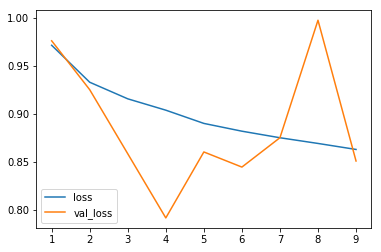

In [45]:
epochs =  range(1,10)
plt.plot(epochs,mod.history['loss'],label='loss')
plt.plot(epochs,mod.history['val_loss'],label='val_loss')
plt.yticks()
plt.legend()
plt.show()